# Data Mining and Machine Learning - Coursework 1

In [1]:
#Importing the necessary libraries and modules to use
from itertools import cycle
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelBinarizer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import BernoulliNB 
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from sklearn import metrics


**Task (1) – Domain Understanding: Classification or Regression**

**1.a)**

In [2]:
#Uploading the dataset
df = pd.read_csv('Raw_Males_VF_Dataset_Coursework1.csv')
df

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres
0,B0011,M,47,46,187.0,152.24,154,133,178.0,52,7,0.0,XNBH,NaN,-0.76
1,B0012,M,52,54,182.0,167.36,139,111,187.0,50,3,0.0,NaN,NaN,-0.59
2,B0013,M,62,28,175.0,82.92,93,118,160.0,58,6,0.0,NaN,NaN,0.59
3,B0014,M,56,26,1.8,76.45,85,91,139.0,151,2,0.0,NaN,NaN,0.50
4,B0015,M,48,25,1.7,65.36,84,76,98.0,257,6,0.0,NaN,NaN,0.39
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2859,B2870,M,69,41,184.0,130.23,125,94,123.0,44,16,0.0,NaN,NaN,14.82
2860,B2871,M,63,32,189.0,110.83,107,94,108.0,46,6,0.0,NaN,NaN,14.91
2861,B2872,M,61,35,180.0,110.32,114,89,130.0,41,5,0.0,NaN,NaN,15.19
2862,B2873,M,75,48,189.0,159.52,127,116,159.0,25,3,0.0,NaN,NaN,16.05


In [3]:
#Checking the column names
df.columns

Index(['SUBJECT_ID', 'SEX', 'AGE_years', 'BMI ', 'HEIGHT_cm', 'WEIGHT_kg',
       'WAIST_CIRCUMFERENCE_cm', 'DIASTOLIC_BLOOD_PRESSURE_mmHg',
       'SYSTOLIC_BLOOD_PRESSURE_mmHg', 'WALK_DURATION_PER_DAY_MINUTES',
       'COMPUTER_USE_TIME_PER_DAY_HOURS', 'SMOKING_STATUS ',
       'DISCONTINUED_NO_', 'CIGARETTES_CONSUMED_PER_DAY',
       'Visceral_Fat_Volume_Litres'],
      dtype='object')

In [4]:
#Removing the spaces from the dataset
df.columns = df.columns.str.replace(' ', '')
df.columns

Index(['SUBJECT_ID', 'SEX', 'AGE_years', 'BMI', 'HEIGHT_cm', 'WEIGHT_kg',
       'WAIST_CIRCUMFERENCE_cm', 'DIASTOLIC_BLOOD_PRESSURE_mmHg',
       'SYSTOLIC_BLOOD_PRESSURE_mmHg', 'WALK_DURATION_PER_DAY_MINUTES',
       'COMPUTER_USE_TIME_PER_DAY_HOURS', 'SMOKING_STATUS', 'DISCONTINUED_NO_',
       'CIGARETTES_CONSUMED_PER_DAY', 'Visceral_Fat_Volume_Litres'],
      dtype='object')

In [5]:
#Target column check
df[df["Visceral_Fat_Volume_Litres"]<0].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)

,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres
0,B0011,0.0,NaN,-0.76
1,B0012,0.0,NaN,-0.59


In [6]:
#Dropping the negative ones with null values, as the visceral fat volume cannot be negative
df = df[df["Visceral_Fat_Volume_Litres"]>0]
df[df["Visceral_Fat_Volume_Litres"]<0].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)

,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres


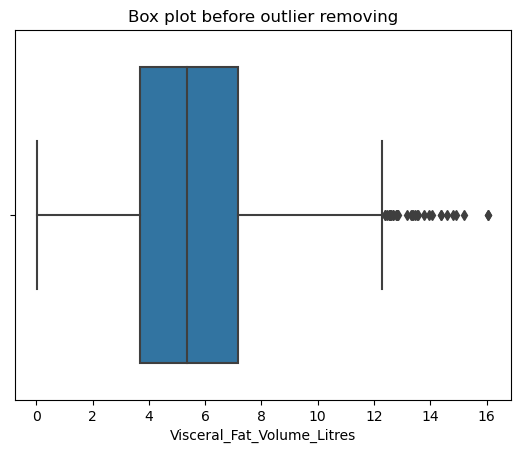

Old Shape:  (2862, 15)
New Shape:  (2821, 15)


/var/folders/_k/_rt6thqx6mj63rxtq_q_l7j00000gn/T/ipykernel_7507/891049041.py:15: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)
  Q1 = np.percentile(df['Visceral_Fat_Volume_Litres'], 25,
/var/folders/_k/_rt6thqx6mj63rxtq_q_l7j00000gn/T/ipykernel_7507/891049041.py:18: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)
  Q3 = np.percentile(df['Visceral_Fat_Volume_Litres'], 75,


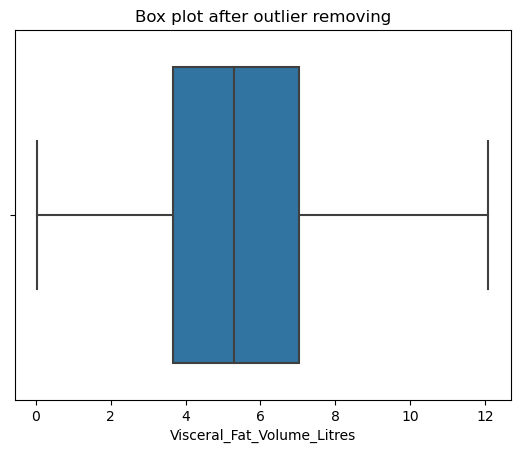

In [7]:
#Outlier check in the Visceral_Fat_Volume_Litres column
df = df.reset_index(drop=True)
sns.boxplot(x = df['Visceral_Fat_Volume_Litres'])
plt.title('Box plot before outlier removing')
plt.show()

old_shape = 0
new_shape = 1

print("Old Shape: ", df.shape)

while old_shape != new_shape:
    ''' Detection '''
    # IQR
    Q1 = np.percentile(df['Visceral_Fat_Volume_Litres'], 25, 
                       interpolation = 'midpoint') 

    Q3 = np.percentile(df['Visceral_Fat_Volume_Litres'], 75,
                       interpolation = 'midpoint') 
    IQR = Q3 - Q1 

    old_shape = df.shape
     

    # Upper bound
    df = df[df['Visceral_Fat_Volume_Litres'] < (Q3+1.5*IQR)]
    # Lower bound
    df = df[df['Visceral_Fat_Volume_Litres'] > (Q1-1.5*IQR)]

    new_shape = df.shape

print("New Shape: ", new_shape)

df = df.reset_index(drop=True)
sns.boxplot(x = df['Visceral_Fat_Volume_Litres'])
plt.title('Box plot after outlier removing')
plt.show()

In [8]:
#Checking the max value for target column
df["Visceral_Fat_Volume_Litres"].max()

12.09

In [9]:
#Setting and appliying the formula to classfiy the target column
def conditions(s):
    if (s['Visceral_Fat_Volume_Litres'] == None):
        return None
    elif (s['Visceral_Fat_Volume_Litres'] <= 3):
        return "Low Risk"
    elif (s['Visceral_Fat_Volume_Litres'] <= 6):
        return "Moderate Risk"
    else:
        return "High Risk"
df['Risk_Level'] = df.apply(conditions, axis=1)
df.head(10)

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
0,B0013,M,62,28,175.0,82.92,93,118,160.0,58,6,0.0,NaN,NaN,0.59,Low Risk
1,B0014,M,56,26,1.8,76.45,85,91,139.0,151,2,0.0,NaN,NaN,0.50,Low Risk
2,B0015,M,48,25,1.7,65.36,84,76,98.0,257,6,0.0,NaN,NaN,0.39,Low Risk
3,B0016,M,70,27,180.0,76.57,95,83,127.0,68,5,0.0,NaN,NaN,0.27,Low Risk
4,B0017,M,65,21,189.0,63.37,76,93,123.0,85,3,0.0,NaN,NaN,0.24,Low Risk
5,B0018,M,54,24,192.0,81.79,87,81,123.0,38,10,0.0,NaN,NaN,0.23,Low Risk
6,B0019,M,49,23,189.0,74.41,80,95,136.0,44,3,0.0,NaN,NaN,0.22,Low Risk
7,B0020,M,57,26,188.0,84.00,91,82,109.0,61,0,0.0,NaN,NaN,0.18,Low Risk
8,B0021,M,61,23,180.0,71.71,85,78,112.0,175,5,0.0,NaN,NaN,0.14,Low Risk
9,B0022,M,52,24,186.0,75.94,81,103,138.0,43,5,0.0,GFTY,NaN,0.07,Low Risk


In [10]:
#Checking the classification column of the target column
print("Low Risk Max: ", df[df['Risk_Level'] == "Low Risk"].Visceral_Fat_Volume_Litres.max())
print("Low Risk Min: ", df[df['Risk_Level'] == "Low Risk"].Visceral_Fat_Volume_Litres.min())
print("Moderate Risk Max: ", df[df['Risk_Level'] == "Moderate Risk"].Visceral_Fat_Volume_Litres.max())
print("Moderate Risk Min: ", df[df['Risk_Level'] == "Moderate Risk"].Visceral_Fat_Volume_Litres.min())
print("High Risk Max: ", df[df['Risk_Level'] == "High Risk"].Visceral_Fat_Volume_Litres.max())
print("High Risk Min: ", df[df['Risk_Level'] == "High Risk"].Visceral_Fat_Volume_Litres.min())

Low Risk Max:  2.99
Low Risk Min:  0.04
Moderate Risk Max:  6.0
Moderate Risk Min:  3.01
High Risk Max:  12.09
High Risk Min:  6.01


In [11]:
#Checking the null values and measurement scale types of df
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2821 entries, 0 to 2820
Data columns (total 16 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   SUBJECT_ID                       2821 non-null   object 
 1   SEX                              2821 non-null   object 
 2   AGE_years                        2821 non-null   int64  
 3   BMI                              2821 non-null   int64  
 4   HEIGHT_cm                        2821 non-null   float64
 5   WEIGHT_kg                        2821 non-null   float64
 6   WAIST_CIRCUMFERENCE_cm           2821 non-null   int64  
 7   DIASTOLIC_BLOOD_PRESSURE_mmHg    2821 non-null   int64  
 8   SYSTOLIC_BLOOD_PRESSURE_mmHg     2817 non-null   float64
 9   WALK_DURATION_PER_DAY_MINUTES    2821 non-null   int64  
 10  COMPUTER_USE_TIME_PER_DAY_HOURS  2821 non-null   int64  
 11  SMOKING_STATUS                   2819 non-null   float64
 12  DISCONTINUED_NO_    

In [12]:
#Producing the statistical description of df
df.describe()

,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres
count,2821.000000,2821.000000,2821.000000,2821.000000,2821.000000,2821.000000,2817.000000,2821.000000,2821.000000,2819.000000,126.000000,2821.000000
mean,62.327189,29.151365,182.901453,90.858614,98.736264,91.545551,133.747959,81.771358,4.509039,0.040085,23.444444,5.446306
std,8.520792,3.706347,8.701322,13.011089,9.771789,10.592741,16.737795,64.301588,4.426268,0.196194,13.404212,2.467363
min,41.000000,20.000000,1.700000,55.410000,70.000000,48.000000,90.000000,1.000000,0.000000,0.000000,2.000000,0.040000
25%,57.000000,27.000000,178.000000,81.770000,92.000000,84.000000,122.000000,47.000000,2.000000,0.000000,12.000000,3.660000
50%,63.000000,29.000000,183.000000,89.520000,98.000000,91.000000,132.000000,67.000000,3.000000,0.000000,21.500000,5.300000
75%,69.000000,31.000000,188.000000,98.110000,104.000000,98.000000,144.000000,92.000000,6.000000,0.000000,34.000000,7.040000
max,190.000000,51.000000,210.000000,162.940000,153.000000,130.000000,192.000000,656.000000,69.000000,1.000000,50.000000,12.090000


In [13]:
#Checking the age column
df[df.AGE_years > 100]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
1304,B1317,M,190,32,161.0,78.56,104,82,135.0,57,3,0.0,NaN,NaN,5.09,Moderate Risk


In [14]:
#Replacing the 190 years old with null values, as it is impossible
df['AGE_years'] = df['AGE_years'].replace([190], None)
df = df[df.AGE_years < 100]
df[df.AGE_years > 100]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


In [15]:
#Checking the age column's range
print("Age Max: ", df.AGE_years.max())
print("Age Min: ", df.AGE_years.min())

Age Max:  80
Age Min:  41


In [16]:
#Checking the height column
df[df.HEIGHT_cm < 50]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
1,B0014,M,56,26,1.8,76.45,85,91,139.0,151,2,0.0,NaN,NaN,0.50,Low Risk
2,B0015,M,48,25,1.7,65.36,84,76,98.0,257,6,0.0,NaN,NaN,0.39,Low Risk


In [17]:
#Dropping the misentered height data by prediction
df = df[df.HEIGHT_cm > 50]
df[df.HEIGHT_cm < 50]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


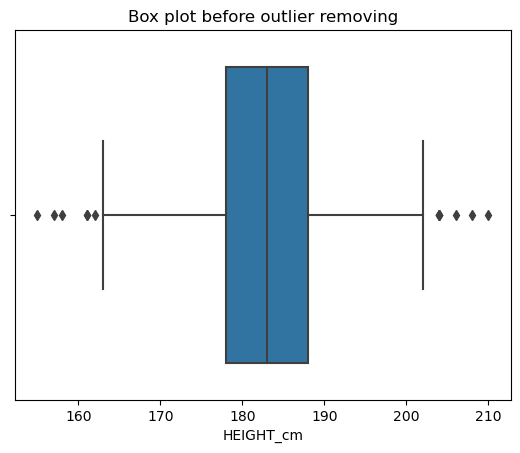

Old Shape:  (2818, 16)
New Shape:  (2804, 16)


/var/folders/_k/_rt6thqx6mj63rxtq_q_l7j00000gn/T/ipykernel_7507/2269151447.py:15: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)
  Q1 = np.percentile(df['HEIGHT_cm'], 25,
/var/folders/_k/_rt6thqx6mj63rxtq_q_l7j00000gn/T/ipykernel_7507/2269151447.py:18: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)
  Q3 = np.percentile(df['HEIGHT_cm'], 75,


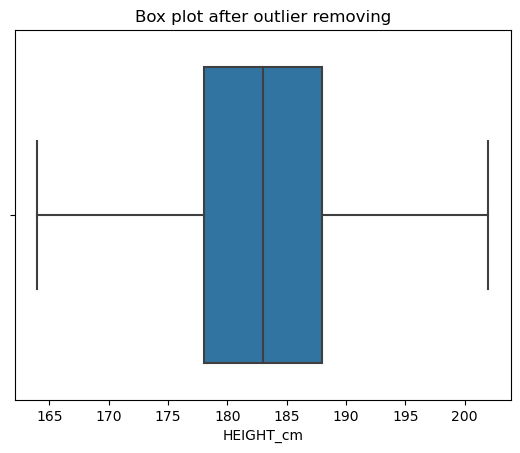

In [18]:
#Checking outliers in the HEIGHT_cm column
df = df.reset_index(drop=True)
sns.boxplot(x = df['HEIGHT_cm'])
plt.title('Box plot before outlier removing')
plt.show()

old_shape = 0
new_shape = 1

print("Old Shape: ", df.shape)

while old_shape != new_shape:
    ''' Detection '''
    # IQR
    Q1 = np.percentile(df['HEIGHT_cm'], 25, 
                       interpolation = 'midpoint') 

    Q3 = np.percentile(df['HEIGHT_cm'], 75,
                       interpolation = 'midpoint') 
    IQR = Q3 - Q1 

    old_shape = df.shape
     

    # Upper bound
    df = df[df['HEIGHT_cm'] < (Q3+1.5*IQR)]
    # Lower bound
    df = df[df['HEIGHT_cm'] > (Q1-1.5*IQR)]

    new_shape = df.shape

print("New Shape: ", new_shape)

df = df.reset_index(drop=True)
sns.boxplot(x = df['HEIGHT_cm'])
plt.title('Box plot after outlier removing')
plt.show()

In [19]:
#Checking the statistics
df.describe()

,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres
count,2804.00000,2804.000000,2804.000000,2804.000000,2804.00000,2800.000000,2804.000000,2804.000000,2802.000000,126.000000,2804.000000
mean,29.14515,183.039765,90.849815,98.730742,91.56669,133.768571,81.703994,4.500000,0.040328,23.444444,5.437817
std,3.70380,7.062372,12.917661,9.745490,10.57158,16.719766,64.127327,4.423004,0.196763,13.404212,2.456753
min,20.00000,164.000000,55.410000,70.000000,48.00000,90.000000,1.000000,0.000000,0.000000,2.000000,0.040000
25%,27.00000,178.000000,81.807500,92.000000,84.00000,122.000000,47.000000,2.000000,0.000000,12.000000,3.650000
50%,29.00000,183.000000,89.525000,98.000000,91.00000,132.000000,67.000000,3.000000,0.000000,21.500000,5.290000
75%,31.00000,188.000000,98.080000,104.000000,98.00000,144.000000,92.000000,6.000000,0.000000,34.000000,7.030000
max,51.00000,202.000000,162.940000,153.000000,130.00000,192.000000,656.000000,69.000000,1.000000,50.000000,12.090000


In [20]:
#Checking the SYSTOLIC_BLOOD_PRESSURE_mmHg variable
df[df['SYSTOLIC_BLOOD_PRESSURE_mmHg'].isnull()].drop(['DIASTOLIC_BLOOD_PRESSURE_mmHg'], axis=1)

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
123,B0138,M,63,26,182.0,82.65,95,NaN,65,0,0.0,NaN,NaN,1.34,Low Risk
1078,B1095,M,62,28,185.0,91.19,97,NaN,77,4,0.0,NaN,NaN,4.57,Moderate Risk
2280,B2302,M,77,31,181.0,90.32,98,NaN,31,9,0.0,NaN,NaN,7.66,High Risk
2718,B2745,M,57,29,181.0,89.24,98,NaN,97,0,0.0,NaN,NaN,10.36,High Risk


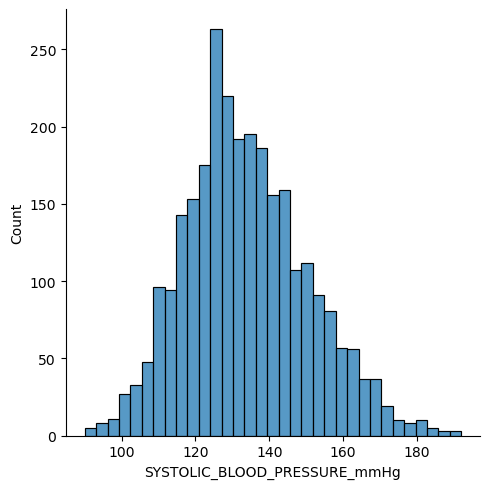

In [21]:
#Checking the distribution
sns.displot(df, x="SYSTOLIC_BLOOD_PRESSURE_mmHg")

In [22]:
#Filling the missing records with the mean for systolic blood pressure variable
df['SYSTOLIC_BLOOD_PRESSURE_mmHg'] = df['SYSTOLIC_BLOOD_PRESSURE_mmHg'].fillna(df['SYSTOLIC_BLOOD_PRESSURE_mmHg'].mean())
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2804 entries, 0 to 2803
Data columns (total 16 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   SUBJECT_ID                       2804 non-null   object 
 1   SEX                              2804 non-null   object 
 2   AGE_years                        2804 non-null   object 
 3   BMI                              2804 non-null   int64  
 4   HEIGHT_cm                        2804 non-null   float64
 5   WEIGHT_kg                        2804 non-null   float64
 6   WAIST_CIRCUMFERENCE_cm           2804 non-null   int64  
 7   DIASTOLIC_BLOOD_PRESSURE_mmHg    2804 non-null   int64  
 8   SYSTOLIC_BLOOD_PRESSURE_mmHg     2804 non-null   float64
 9   WALK_DURATION_PER_DAY_MINUTES    2804 non-null   int64  
 10  COMPUTER_USE_TIME_PER_DAY_HOURS  2804 non-null   int64  
 11  SMOKING_STATUS                   2802 non-null   float64
 12  DISCONTINUED_NO_    

In [23]:
#Checking the SYSTOLIC_BLOOD_PRESSURE_mmHg variable
df[df['SUBJECT_ID'].isin(['B0138','B1095','B2302','B2745','B2844'])].drop(['DIASTOLIC_BLOOD_PRESSURE_mmHg'], axis=1)

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
123,B0138,M,63,26,182.0,82.65,95,133.768571,65,0,0.0,NaN,NaN,1.34,Low Risk
1078,B1095,M,62,28,185.0,91.19,97,133.768571,77,4,0.0,NaN,NaN,4.57,Moderate Risk
2280,B2302,M,77,31,181.0,90.32,98,133.768571,31,9,0.0,NaN,NaN,7.66,High Risk
2718,B2745,M,57,29,181.0,89.24,98,133.768571,97,0,0.0,NaN,NaN,10.36,High Risk


In [24]:
#Checking the computer use time column
df[df.COMPUTER_USE_TIME_PER_DAY_HOURS > 24].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        ], axis=1)

,SUBJECT_ID,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
313,B0328,65,30,0.0,NaN,NaN,2.50,Low Risk
322,B0337,67,32,0.0,NaN,NaN,2.53,Low Risk
710,B0726,48,27,0.0,NaN,NaN,3.68,Moderate Risk
1120,B1137,61,30,0.0,NaN,11.0,4.69,Moderate Risk
1174,B1191,102,69,0.0,NaN,NaN,4.81,Moderate Risk
1243,B1260,86,35,0.0,NaN,NaN,4.98,Moderate Risk
1330,B1349,91,25,0.0,NaN,NaN,5.15,Moderate Risk
1578,B1598,68,46,0.0,NaN,NaN,5.76,Moderate Risk
2315,B2337,80,32,0.0,NaN,NaN,7.79,High Risk
2593,B2617,11,25,0.0,NaN,NaN,9.18,High Risk


In [25]:
#Replacing the computer use time with null
df = df[df.COMPUTER_USE_TIME_PER_DAY_HOURS <= 24]
df[df.COMPUTER_USE_TIME_PER_DAY_HOURS > 24].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        ], axis=1)


,SUBJECT_ID,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


In [26]:
#Checking the computer use time column
df[df.SUBJECT_ID.isin(["B0328","B0337","B0726","B0817","B0892","B1078","B1137","B1191","B1260","B1349","B1598","B2223"
                       ,"B2337","B2617","B2625","B2631","B2819"])].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        ], axis=1)


,SUBJECT_ID,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
801,B0817,80,24,0.0,NaN,NaN,3.92,Moderate Risk
875,B0892,52,24,0.0,NaN,NaN,4.08,Moderate Risk
1061,B1078,104,24,0.0,NaN,NaN,4.54,Moderate Risk
2201,B2223,62,24,0.0,NaN,NaN,7.37,High Risk
2601,B2625,49,24,0.0,NaN,NaN,9.23,High Risk


In [27]:
#Sanity check for smoking
df[(df['CIGARETTES_CONSUMED_PER_DAY']>0) & (df['SMOKING_STATUS']!=1)].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)


,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
243,B0258,NaN,8.0,2.18,Low Risk
436,B0452,NaN,2.0,2.93,Low Risk
471,B0487,0.0,17.0,3.04,Moderate Risk
538,B0554,0.0,9.0,3.26,Moderate Risk
711,B0727,0.0,13.0,3.68,Moderate Risk
1165,B1182,0.0,12.0,4.79,Moderate Risk
1172,B1189,0.0,8.0,4.81,Moderate Risk
1179,B1196,0.0,45.0,4.82,Moderate Risk
1502,B1522,0.0,13.0,5.56,Moderate Risk
1791,B1812,0.0,5.0,6.26,High Risk


In [28]:
#Checking the smoking columns
df[(df['CIGARETTES_CONSUMED_PER_DAY']!=0) & (df['CIGARETTES_CONSUMED_PER_DAY']!=1)].drop(['SEX','AGE_years','BMI',
                                                                                          'HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)

,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
0,B0013,0.0,NaN,0.59,Low Risk
1,B0016,0.0,NaN,0.27,Low Risk
2,B0017,0.0,NaN,0.24,Low Risk
3,B0018,0.0,NaN,0.23,Low Risk
4,B0019,0.0,NaN,0.22,Low Risk
...,...,...,...,...,...
2799,B2828,0.0,NaN,11.88,High Risk
2800,B2830,0.0,NaN,11.92,High Risk
2801,B2831,0.0,NaN,11.99,High Risk
2802,B2832,0.0,NaN,12.00,High Risk


In [29]:
#Setting and appliying the formula to fill the smoking status with 1 for cigarettes consumers
def smoker_conditions(s):
    if (s['CIGARETTES_CONSUMED_PER_DAY'] > 0):
        return 1
    else:
        return s['SMOKING_STATUS']
df['SMOKING_STATUS'] = df.apply(smoker_conditions, axis=1)

In [30]:
#Setting and appliying the formula to fill the smoke consumption with 0 for nonsmokers
def nonsmoker_conditions(s):
    if (s['SMOKING_STATUS'] == 0):
        return 0
    else:
        return s['CIGARETTES_CONSUMED_PER_DAY']
df['CIGARETTES_CONSUMED_PER_DAY'] = df.apply(nonsmoker_conditions, axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2792 entries, 0 to 2803
Data columns (total 16 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   SUBJECT_ID                       2792 non-null   object 
 1   SEX                              2792 non-null   object 
 2   AGE_years                        2792 non-null   object 
 3   BMI                              2792 non-null   int64  
 4   HEIGHT_cm                        2792 non-null   float64
 5   WEIGHT_kg                        2792 non-null   float64
 6   WAIST_CIRCUMFERENCE_cm           2792 non-null   int64  
 7   DIASTOLIC_BLOOD_PRESSURE_mmHg    2792 non-null   int64  
 8   SYSTOLIC_BLOOD_PRESSURE_mmHg     2792 non-null   float64
 9   WALK_DURATION_PER_DAY_MINUTES    2792 non-null   int64  
 10  COMPUTER_USE_TIME_PER_DAY_HOURS  2792 non-null   int64  
 11  SMOKING_STATUS                   2792 non-null   float64
 12  DISCONTINUED_NO_    

In [31]:
#Sanity check for smoking
df[df.SUBJECT_ID.isin(['B0258','B0452','B0487','B0554','B0727','B1137','B1182','B1189','B1196','B1522','B1812','B2375','B2553'])].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)


,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
243,B0258,1.0,8.0,2.18,Low Risk
436,B0452,1.0,2.0,2.93,Low Risk
471,B0487,1.0,17.0,3.04,Moderate Risk
538,B0554,1.0,9.0,3.26,Moderate Risk
711,B0727,1.0,13.0,3.68,Moderate Risk
1165,B1182,1.0,12.0,4.79,Moderate Risk
1172,B1189,1.0,8.0,4.81,Moderate Risk
1179,B1196,1.0,45.0,4.82,Moderate Risk
1502,B1522,1.0,13.0,5.56,Moderate Risk
1791,B1812,1.0,5.0,6.26,High Risk


In [32]:
#Checking the smoking columns
df.drop(['SEX','AGE_years','BMI','HEIGHT_cm','WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)

,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
0,B0013,0.0,0.0,0.59,Low Risk
1,B0016,0.0,0.0,0.27,Low Risk
2,B0017,0.0,0.0,0.24,Low Risk
3,B0018,0.0,0.0,0.23,Low Risk
4,B0019,0.0,0.0,0.22,Low Risk
...,...,...,...,...,...
2799,B2828,0.0,0.0,11.88,High Risk
2800,B2830,0.0,0.0,11.92,High Risk
2801,B2831,0.0,0.0,11.99,High Risk
2802,B2832,0.0,0.0,12.00,High Risk


In [33]:
#Sanity check for smoking
df[(df['SMOKING_STATUS']!=1) & (df['SMOKING_STATUS']!=0)]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


In [34]:
#Sanity check for smoking
df[(df['SMOKING_STATUS']==0) & (df['CIGARETTES_CONSUMED_PER_DAY']>0)]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


In [35]:
#Checking duplications
df = df.drop_duplicates()

**Task (2) – Data Understanding: Producing Your Experimental Designing**

**2.a)**

In [36]:
#Checking the columns
df = df.drop(columns=['DISCONTINUED_NO_','Visceral_Fat_Volume_Litres','SUBJECT_ID','SEX'])
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2792 entries, 0 to 2803
Data columns (total 12 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   AGE_years                        2792 non-null   object 
 1   BMI                              2792 non-null   int64  
 2   HEIGHT_cm                        2792 non-null   float64
 3   WEIGHT_kg                        2792 non-null   float64
 4   WAIST_CIRCUMFERENCE_cm           2792 non-null   int64  
 5   DIASTOLIC_BLOOD_PRESSURE_mmHg    2792 non-null   int64  
 6   SYSTOLIC_BLOOD_PRESSURE_mmHg     2792 non-null   float64
 7   WALK_DURATION_PER_DAY_MINUTES    2792 non-null   int64  
 8   COMPUTER_USE_TIME_PER_DAY_HOURS  2792 non-null   int64  
 9   SMOKING_STATUS                   2792 non-null   float64
 10  CIGARETTES_CONSUMED_PER_DAY      2792 non-null   float64
 11  Risk_Level                       2792 non-null   object 
dtypes: float64(5), int64

In [37]:
#Showing the dataframe
df.head(10)

,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Risk_Level
0,62,28,175.0,82.92,93,118,160.0,58,6,0.0,0.0,Low Risk
1,70,27,180.0,76.57,95,83,127.0,68,5,0.0,0.0,Low Risk
2,65,21,189.0,63.37,76,93,123.0,85,3,0.0,0.0,Low Risk
3,54,24,192.0,81.79,87,81,123.0,38,10,0.0,0.0,Low Risk
4,49,23,189.0,74.41,80,95,136.0,44,3,0.0,0.0,Low Risk
5,57,26,188.0,84.00,91,82,109.0,61,0,0.0,0.0,Low Risk
6,61,23,180.0,71.71,85,78,112.0,175,5,0.0,0.0,Low Risk
7,52,24,186.0,75.94,81,103,138.0,43,5,0.0,0.0,Low Risk
8,54,27,177.0,75.32,91,102,144.0,78,0,0.0,0.0,Low Risk
9,53,24,188.0,82.55,87,78,123.0,46,2,0.0,0.0,Low Risk


In [38]:
#Showing statistical description
df.describe()

,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY
count,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000
mean,29.146848,183.019341,90.843521,98.729226,91.580587,133.809840,81.770415,4.374284,0.044771,1.054083
std,3.706531,7.052057,12.907480,9.737421,10.561313,16.673732,64.238788,3.916171,0.206837,5.630789
min,20.000000,164.000000,55.410000,70.000000,48.000000,90.000000,1.000000,0.000000,0.000000,0.000000
25%,27.000000,178.000000,81.830000,92.000000,84.000000,122.000000,47.000000,2.000000,0.000000,0.000000
50%,29.000000,183.000000,89.525000,98.000000,91.000000,133.000000,67.000000,3.000000,0.000000,0.000000
75%,31.000000,188.000000,98.065000,104.000000,98.000000,144.000000,92.250000,6.000000,0.000000,0.000000
max,51.000000,202.000000,162.940000,153.000000,130.000000,192.000000,656.000000,24.000000,1.000000,50.000000


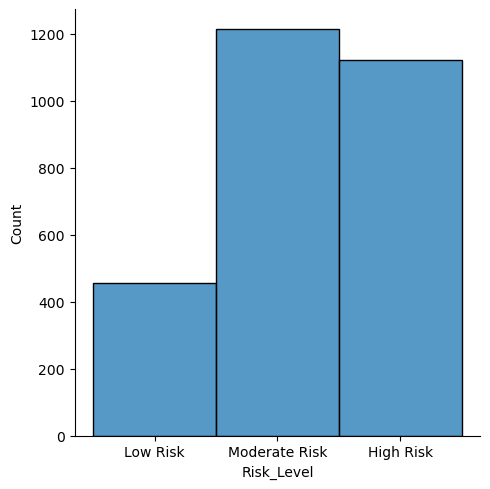

In [39]:
#Showing the distribution of the target column's classes
sns.displot(df, x="Risk_Level")

In [40]:
#Showing the percentages of the target column's classes
df.Risk_Level.value_counts(normalize=True)

Moderate Risk    0.434456
High Risk        0.401862
Low Risk         0.163682
Name: Risk_Level, dtype: float64

In [41]:
#Creating a dataframe with all training data except the target column
X = df.drop(columns=['Risk_Level'])
#Checking that the target variable has been removed
X.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 2792 entries, 0 to 2803
Data columns (total 11 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   AGE_years                        2792 non-null   object 
 1   BMI                              2792 non-null   int64  
 2   HEIGHT_cm                        2792 non-null   float64
 3   WEIGHT_kg                        2792 non-null   float64
 4   WAIST_CIRCUMFERENCE_cm           2792 non-null   int64  
 5   DIASTOLIC_BLOOD_PRESSURE_mmHg    2792 non-null   int64  
 6   SYSTOLIC_BLOOD_PRESSURE_mmHg     2792 non-null   float64
 7   WALK_DURATION_PER_DAY_MINUTES    2792 non-null   int64  
 8   COMPUTER_USE_TIME_PER_DAY_HOURS  2792 non-null   int64  
 9   SMOKING_STATUS                   2792 non-null   float64
 10  CIGARETTES_CONSUMED_PER_DAY      2792 non-null   float64
dtypes: float64(5), int64(5), object(1)
memory usage: 326.3+ KB


In [42]:
#separate target values
y = df['Risk_Level'].values
#view target values
y[0:5]


array(['Low Risk', 'Low Risk', 'Low Risk', 'Low Risk', 'Low Risk'],
      dtype=object)

**Task (4) – Modelling: Create Predictive Classification Models**

**b)**

In [43]:
#Splitting dataset into train and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1, stratify=y)

In [44]:
#Showing the input dataframe
X

,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY
0,62,28,175.0,82.92,93,118,160.0,58,6,0.0,0.0
1,70,27,180.0,76.57,95,83,127.0,68,5,0.0,0.0
2,65,21,189.0,63.37,76,93,123.0,85,3,0.0,0.0
3,54,24,192.0,81.79,87,81,123.0,38,10,0.0,0.0
4,49,23,189.0,74.41,80,95,136.0,44,3,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
2799,65,33,168.0,84.35,97,97,149.0,115,3,0.0,0.0
2800,74,36,175.0,101.25,110,82,109.0,57,11,0.0,0.0
2801,73,32,187.0,108.45,110,89,113.0,63,7,0.0,0.0
2802,66,34,176.0,100.17,104,99,154.0,3,5,0.0,0.0


In [45]:
#Applying standardization to input dataframe with MinMaxScaler
minmax_scale = MinMaxScaler()
X_train_scaled = minmax_scale.fit_transform(X_train)
X_test_scaled = minmax_scale.transform(X_test)
X_scaled = minmax_scale.transform(X)
pd.DataFrame(X_scaled)


,0,1,2,3,4,5,6,7,8,9,10
0,0.538462,0.258065,0.289474,0.255836,0.277108,0.853659,0.686275,0.085627,0.250000,0.0,0.0
1,0.743590,0.225806,0.421053,0.196782,0.301205,0.426829,0.362745,0.100917,0.208333,0.0,0.0
2,0.615385,0.032258,0.657895,0.074026,0.072289,0.548780,0.323529,0.126911,0.125000,0.0,0.0
3,0.333333,0.129032,0.736842,0.245327,0.204819,0.402439,0.323529,0.055046,0.416667,0.0,0.0
4,0.205128,0.096774,0.657895,0.176695,0.120482,0.573171,0.450980,0.064220,0.125000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
2787,0.615385,0.419355,0.105263,0.269134,0.325301,0.597561,0.578431,0.172783,0.125000,0.0,0.0
2788,0.846154,0.516129,0.289474,0.426300,0.481928,0.414634,0.186275,0.084098,0.458333,0.0,0.0
2789,0.820513,0.387097,0.605263,0.493258,0.481928,0.500000,0.225490,0.093272,0.291667,0.0,0.0
2790,0.641026,0.451613,0.315789,0.416256,0.409639,0.621951,0.627451,0.001529,0.208333,0.0,0.0


In [46]:
#Applying standardization to input dataframe with StandardScaler
std_scale = StandardScaler()
X_train_stdscaled = std_scale.fit_transform(X_train)
X_test_stdscaled = std_scale.transform(X_test)
X_stdscaled = std_scale.transform(X)

In [47]:
#Showing the standard scaled input dataframe
pd.DataFrame(X_train_scaled).head()

,0,1,2,3,4,5,6,7,8,9,10
0,0.512821,0.354839,0.578947,0.396262,0.433735,0.646341,0.598039,0.061162,0.166667,0.0,0.0
1,0.743590,0.322581,0.736842,0.439691,0.506024,0.341463,0.568627,0.103976,0.291667,0.0,0.0
2,0.153846,0.225806,0.323684,0.243095,0.240964,0.719512,0.333333,0.058104,0.125000,0.0,0.0
3,0.615385,0.258065,0.526316,0.290524,0.204819,0.402439,0.196078,0.365443,0.250000,0.0,0.0
4,0.205128,0.483871,0.526316,0.525342,0.590361,0.573171,0.254902,0.027523,0.208333,0.0,0.0


In [48]:
#Showing the target dataframe
pd.DataFrame(y_train).head()

,0
0,High Risk
1,High Risk
2,Moderate Risk
3,Low Risk
4,High Risk


In [49]:
#Creating KNN classifier
knn = KNeighborsClassifier()
knn.fit(X_train_scaled,y_train)
knn.score(X_test_scaled, y_test)

0.5599284436493739

In [50]:
#Creating Multinomial Naive Bayes classifier
mnb = MultinomialNB()
mnb.fit(X_train_scaled, y_train)
mnb.score(X_test_scaled, y_test)

0.518783542039356

In [51]:
#Creating Gaussian Naive Bayes classifier
gnb = GaussianNB()
gnb.fit(X_train_scaled, y_train)
gnb.score(X_test_scaled, y_test)

0.627906976744186

In [52]:
#Creating Bernoulli Naive Bayes classifier
bnb = BernoulliNB()
bnb.fit(X_train_scaled, y_train)
bnb.score(X_test_scaled, y_test)

0.4329159212880143

In [53]:
#Creating Decision Tree classifier
dtc = DecisionTreeClassifier()
dtc = dtc.fit(X_train_scaled,y_train)
dtc.score(X_test_scaled, y_test)

0.5062611806797853

In [54]:
#Creating MLP classifier
mlp = MLPClassifier()
mlp = mlp.fit(X_train_scaled,y_train)
mlp.score(X_test_scaled, y_test)

0.6583184257602862

**Task (5) – Evaluation: How good are your models**

**5.a)**

Text(63.53777777777783, 0.5, 'Actual')

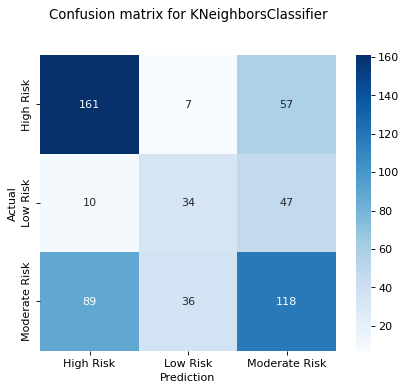

In [55]:
#Creating confusion matrix for KNeighborsClassifier
y_pred_knn = knn.predict(X_test_scaled)

knn_matrix = metrics.confusion_matrix(y_test, y_pred_knn)
plt.figure(dpi=80)
sns.heatmap(knn_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for KNeighborsClassifier', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

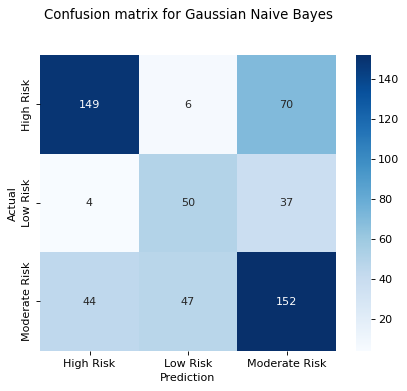

In [56]:
#Creating confusion matrix for Gaussian Naive Bayes
y_pred_gnb = gnb.predict(X_test_scaled)

gnb_matrix = metrics.confusion_matrix(y_test, y_pred_gnb)
plt.figure(dpi=80)
sns.heatmap(gnb_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for Gaussian Naive Bayes', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

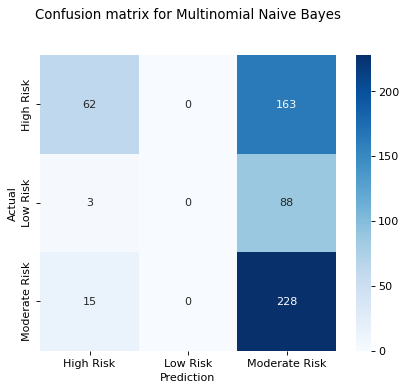

In [57]:
#Creating confusion matrix for Multinomial Naive Bayes
y_pred_mnb = mnb.predict(X_test_scaled)

gnb_matrix = metrics.confusion_matrix(y_test, y_pred_mnb)
plt.figure(dpi=80)
sns.heatmap(gnb_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for Multinomial Naive Bayes', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

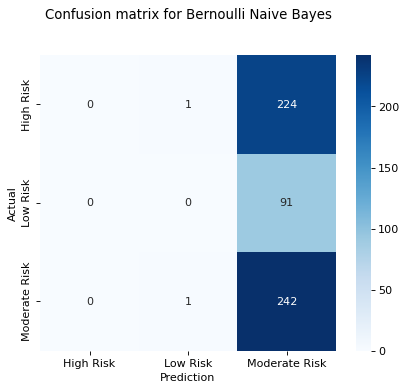

In [58]:
#Creating confusion matrix for Bernoulli Naive Bayes
y_pred_bnb = bnb.predict(X_test_scaled)

gnb_matrix = metrics.confusion_matrix(y_test, y_pred_bnb)
plt.figure(dpi=80)
sns.heatmap(gnb_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for Bernoulli Naive Bayes', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

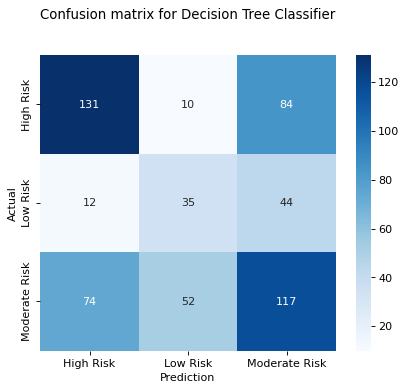

In [59]:
#Creating confusion matrix for Decision Tree Classifier
y_pred_dtc = dtc.predict(X_test_scaled)

dtc_matrix = metrics.confusion_matrix(y_test, y_pred_dtc)
plt.figure(dpi=80)
sns.heatmap(dtc_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for Decision Tree Classifier', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

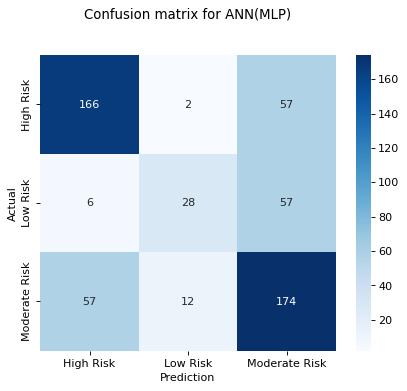

In [60]:
#Creating confusion matrix for ANN(MLP)
y_pred_mlp = mlp.predict(X_test_scaled)


dtc_matrix = metrics.confusion_matrix(y_test, y_pred_mlp)
plt.figure(dpi=80)
sns.heatmap(dtc_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for ANN(MLP)', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

**5.b)**

               precision    recall  f1-score   support

    High Risk       0.62      0.72      0.66       225
     Low Risk       0.44      0.37      0.40        91
Moderate Risk       0.53      0.49      0.51       243

     accuracy                           0.56       559
    macro avg       0.53      0.52      0.53       559
 weighted avg       0.55      0.56      0.55       559



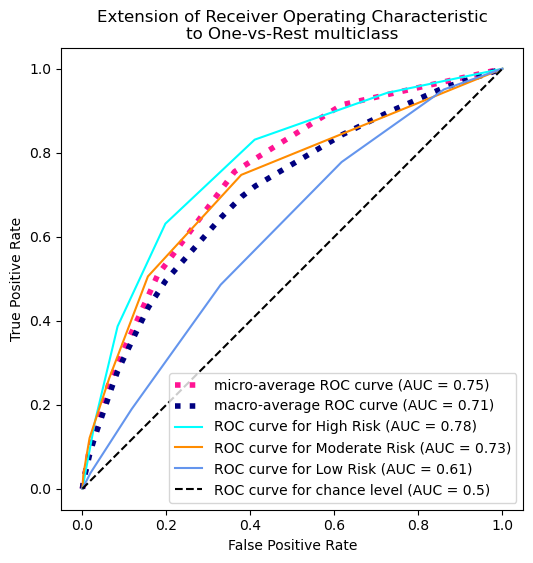

In [75]:
#Showing the KNN Scores
print(classification_report(y_test, y_pred_knn))

y_score = knn.predict_proba(X_test_scaled)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

target_names = ['High Risk', 'Moderate Risk', 'Low Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.78      0.28      0.41       225
     Low Risk       0.00      0.00      0.00        91
Moderate Risk       0.48      0.94      0.63       243

     accuracy                           0.52       559
    macro avg       0.42      0.40      0.35       559
 weighted avg       0.52      0.52      0.44       559



/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(r

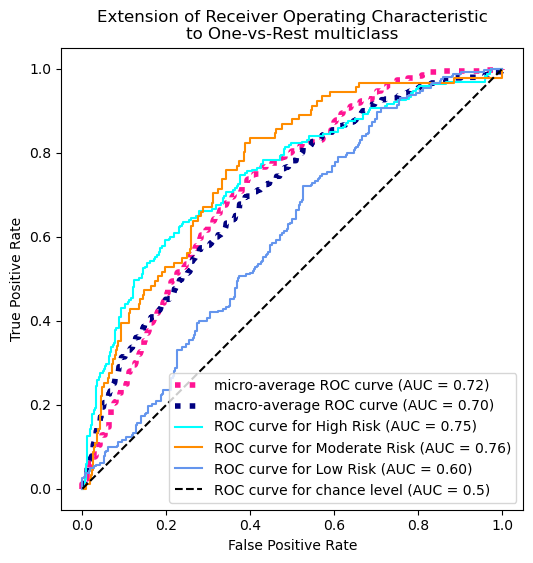

In [76]:
#Showing the MNB Scores
print(classification_report(y_test, y_pred_mnb))

y_score = mnb.predict_proba(X_test_scaled)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

target_names = ['High Risk', 'Moderate Risk', 'Low Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.76      0.66      0.71       225
     Low Risk       0.49      0.55      0.52        91
Moderate Risk       0.59      0.63      0.61       243

     accuracy                           0.63       559
    macro avg       0.61      0.61      0.61       559
 weighted avg       0.64      0.63      0.63       559



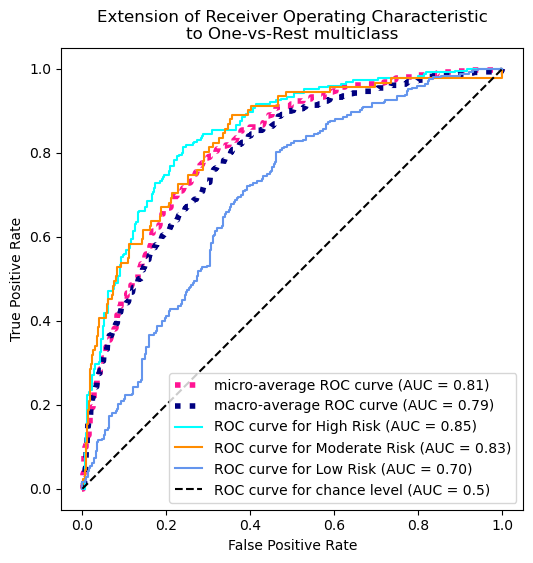

In [67]:
#Showing the GNB Scores
print(classification_report(y_test, y_pred_gnb))

y_score = gnb.predict_proba(X_test_scaled)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)


# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

target_names = ['High Risk', 'Moderate Risk', 'Low Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.00      0.00      0.00       225
     Low Risk       0.00      0.00      0.00        91
Moderate Risk       0.43      1.00      0.61       243

     accuracy                           0.43       559
    macro avg       0.14      0.33      0.20       559
 weighted avg       0.19      0.43      0.26       559



/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(r

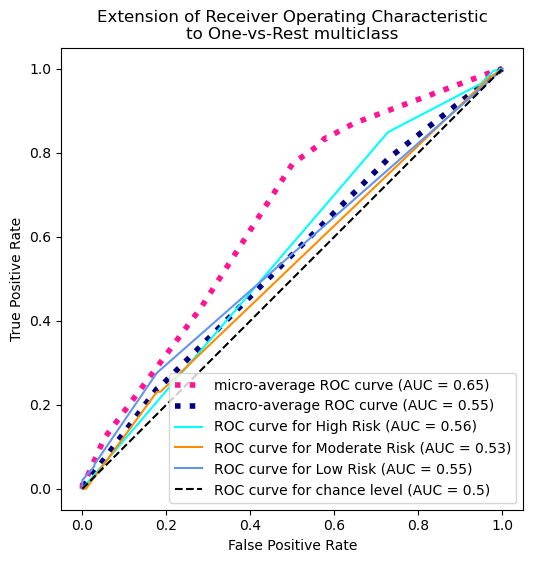

In [77]:
#Showing the BNB Scores
print(classification_report(y_test, y_pred_bnb))

y_score = bnb.predict_proba(X_test_scaled)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

target_names = ['High Risk', 'Moderate Risk', 'Low Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.60      0.58      0.59       225
     Low Risk       0.36      0.38      0.37        91
Moderate Risk       0.48      0.48      0.48       243

     accuracy                           0.51       559
    macro avg       0.48      0.48      0.48       559
 weighted avg       0.51      0.51      0.51       559



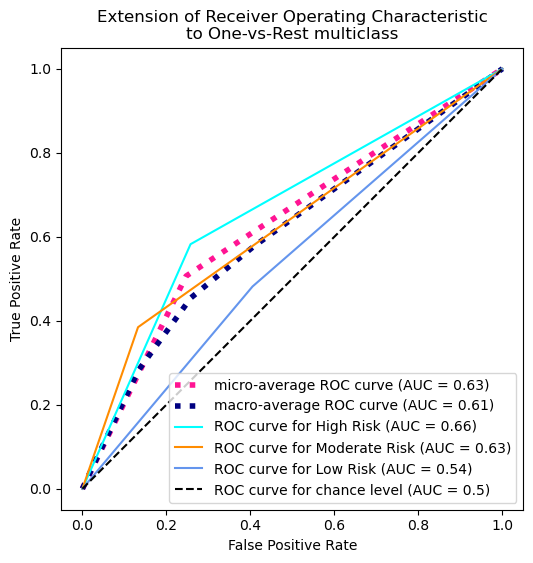

In [79]:
#Showing the DTC Scores
print(classification_report(y_test, y_pred_dtc))

y_score = dtc.predict_proba(X_test_scaled)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

target_names = ['High Risk', 'Moderate Risk', 'Low Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.72      0.74      0.73       225
     Low Risk       0.67      0.31      0.42        91
Moderate Risk       0.60      0.72      0.66       243

     accuracy                           0.66       559
    macro avg       0.67      0.59      0.60       559
 weighted avg       0.66      0.66      0.65       559



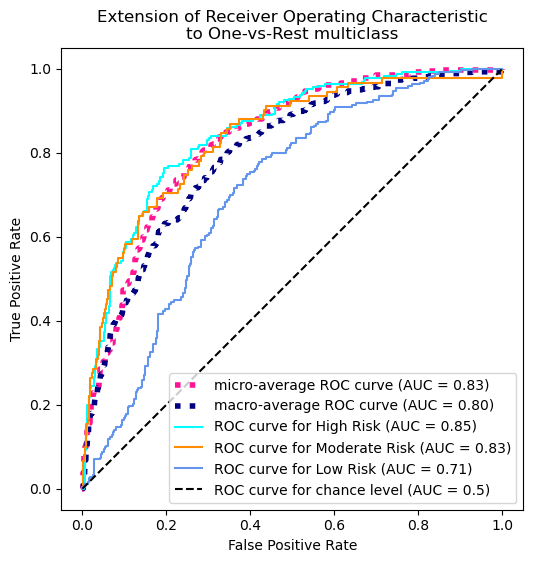

In [78]:
#Showing the MLP Scores
print(classification_report(y_test, y_pred_mlp))


y_score = mlp.predict_proba(X_test_scaled)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

target_names = ['High Risk', 'Moderate Risk', 'Low Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


**5.c)**

1/100
2/100
3/100
4/100
5/100
6/100
7/100
8/100
9/100
10/100
11/100
12/100
13/100
14/100
15/100
16/100
17/100
18/100
19/100
20/100
21/100
22/100
23/100
24/100
25/100
26/100
27/100
28/100
29/100
30/100
31/100
32/100
33/100
34/100
35/100
36/100
37/100
38/100
39/100
40/100
41/100
42/100
43/100
44/100
45/100
46/100
47/100
48/100
49/100
50/100
51/100
52/100
53/100
54/100
55/100
56/100
57/100
58/100
59/100
60/100
61/100
62/100
63/100
64/100
65/100
66/100
67/100
68/100
69/100
70/100
71/100
72/100
73/100
74/100
75/100
76/100
77/100
78/100
79/100
80/100
81/100
82/100
83/100
84/100
85/100
86/100
87/100
88/100
89/100
90/100
91/100
92/100
93/100
94/100
95/100
96/100
97/100
98/100
99/100
100/100
101/100
102/100
103/100
104/100
105/100
106/100
107/100
108/100
109/100
110/100
111/100
112/100
113/100
114/100
115/100
116/100
117/100
118/100
119/100
120/100
121/100
122/100
123/100
124/100
125/100
126/100
127/100
128/100
129/100
130/100
131/100
132/100
133/100
134/100
135/100
136/100
137/100
138/100
139/

Text(0, 0.5, 'Mean Error')

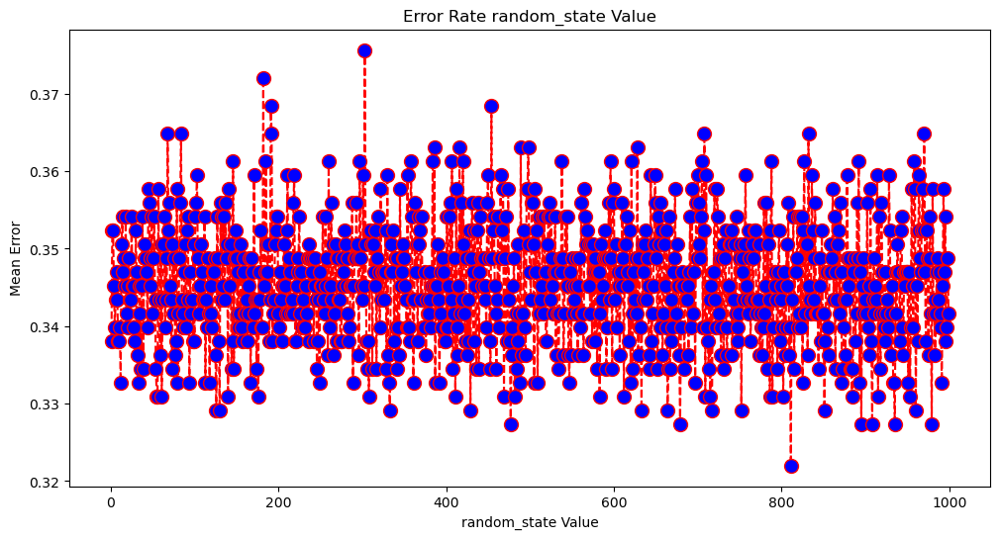

In [67]:
#Calculating error for random_state values between 1 and 1000
error = []

#Calculating error for random_state values between 1 and 1000
for i in range(1, 1000):
    print(str(i) + "/1000")
    mlp_grid = MLPClassifier(random_state=i,max_iter=1000)
    mlp_grid.fit(X_train_scaled, y_train)
    pred_i = mlp_grid.predict(X_test_scaled)
    error.append(np.mean(pred_i != y_test))
plt.figure(figsize=(12, 6))
plt.plot(range(1, 1000), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate random_state Value')
plt.xlabel('random_state Value')
plt.ylabel('Mean Error')

800/100
801/100
802/100
803/100
804/100
805/100
806/100
807/100
808/100
809/100
810/100
811/100
812/100
813/100
814/100
815/100
816/100
817/100
818/100
819/100
820/100
821/100
822/100
823/100
824/100


Text(0, 0.5, 'Mean Error')

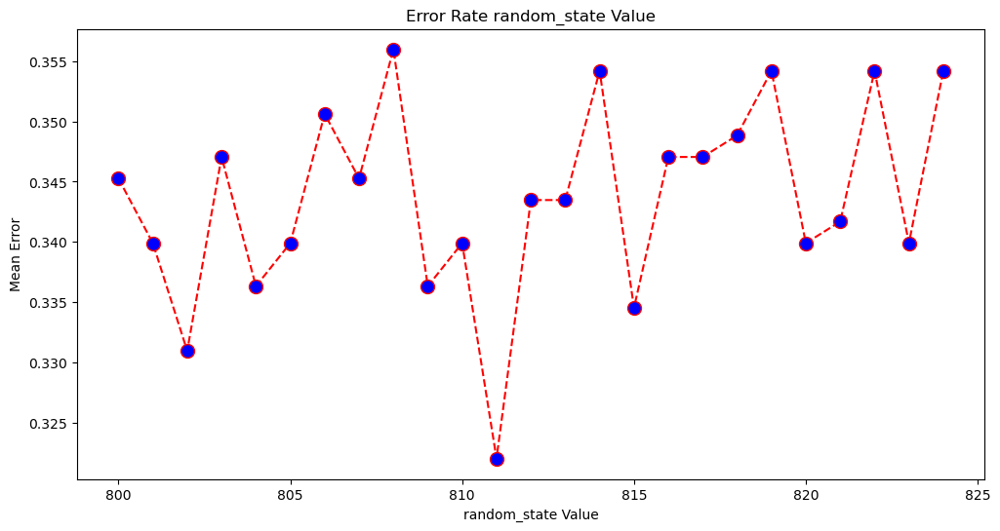

In [68]:
#Calculating error for random_state values between 1 and 1000
error = []

#Calculating error for random_state values between 1 and 1000
for i in range(800,825):
    print(str(i) + "/1000")
    mlp_grid = MLPClassifier(random_state=i,max_iter=1000)
    mlp_grid.fit(X_train_scaled, y_train)
    pred_i = mlp_grid.predict(X_test_scaled)
    error.append(np.mean(pred_i != y_test))
plt.figure(figsize=(12, 6))
plt.plot(range(800,825), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate random_state Value')
plt.xlabel('random_state Value')
plt.ylabel('Mean Error')

In [69]:
#Creating MLP classifier
mlp = MLPClassifier(random_state=811,max_iter=1000)
mlp = mlp.fit(X_train_scaled,y_train)
mlp.score(X_test_scaled, y_test)

0.6779964221824687

In [106]:
#Tuning the MPL classifier
mlp_grid = MLPClassifier(random_state=811,max_iter=1000)

params = {'activation': ['relu', 'tanh', 'logistic', 'identity'],
          'hidden_layer_sizes': [(100,), (50,100,), (50,75,100,)],
          'solver': ['adam', 'sgd', 'lbfgs'],
          'learning_rate' : ['constant', 'adaptive', 'invscaling'],
         }

mlp_grid = GridSearchCV(mlp_grid, param_grid=params, cv=10, scoring='accuracy')

mlp_grid.fit(X_train_scaled, y_train=='High Risk')

print('Best Score:', mlp_grid.best_score_, 'Best Parameters:', mlp_grid.best_params_)

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

Best Score: 0.6821098626716604 Best Parameters: {'activation': 'relu', 'hidden_layer_sizes': (50, 75, 100), 'learning_rate': 'constant', 'solver': 'adam'}


In [72]:
#Creating MLP classifier
mlp = MLPClassifier(random_state=811,max_iter=1000, activation="relu", hidden_layer_sizes=(100,), learning_rate="constant",
                    solver= 'adam')
mlp = mlp.fit(X_train_scaled,y_train)
mlp.score(X_test_scaled, y_test)

0.6779964221824687

In [73]:
#Tuning the MPL classifier
mlp_grid = MLPClassifier(random_state=811,max_iter=1000, activation="relu", hidden_layer_sizes=(100,),
                         learning_rate="constant", solver= 'adam')

params = {'alpha': [0.00001, 0.0001, 0.001],
          'batch_size': [100, 200, 300, 'auto'],
          'shuffle': [True, False],
          'tol': [1e-4, 2e-4,0.0001],
          'early_stopping': [True, False],
         }

mlp_grid = GridSearchCV(mlp_grid, param_grid=params, cv=10, scoring='accuracy')

mlp_grid.fit(X_train_scaled, y_train)

print('Best Score:', mlp_grid.best_score_, 'Best Parameters:', mlp_grid.best_params_)

Best Score: 0.6215486867392697 Best Parameters: {'alpha': 1e-05, 'batch_size': 200, 'early_stopping': False, 'shuffle': True, 'tol': 0.0001}


In [78]:
#Creating MLP classifier
mlp = MLPClassifier(random_state=811, max_iter=1000, activation="relu", hidden_layer_sizes=(100,),
                         learning_rate="constant", solver= 'adam', batch_size=200, alpha=0.0001,
                         early_stopping=False, shuffle= True, tol= 0.0001)
mlp = mlp.fit(X_train_scaled,y_train)
mlp.score(X_test_scaled, y_test)

0.6779964221824687

In [99]:
#Tuning the MPL classifier
mlp_grid = MLPClassifier(random_state=811,max_iter=1000, activation="relu", hidden_layer_sizes=(100,),
                         learning_rate="constant", solver= 'adam', alpha=0.0001, batch_size=200,
                         early_stopping=False, shuffle= True, tol= 0.0001)

params = {'warm_start': [True, False],
          'verbose': [True, False],
          'beta_1': [0, 0.9, 0.99],
          'beta_2': [0.99, 0.999, 0.9999],
          'epsilon': [1e-8, 2e-8],
          'n_iter_no_change': [1, 10, 100],
         }

mlp_grid = GridSearchCV(mlp_grid, param_grid=params, cv=10, scoring='accuracy')

mlp_grid.fit(X_train_scaled, y_train)

print('Best Score:', mlp_grid.best_score_, 'Best Parameters:', mlp_grid.best_params_)

Iteration 1, loss = 1.14149977
Iteration 2, loss = 1.05522835
Iteration 3, loss = 1.01334472
Iteration 4, loss = 0.99565730
Iteration 5, loss = 0.98614465
Iteration 6, loss = 0.97664270
Iteration 7, loss = 0.96840522
Iteration 8, loss = 0.96482024
Iteration 9, loss = 0.95615129
Iteration 10, loss = 0.95091837
Iteration 11, loss = 0.94620047
Iteration 12, loss = 0.93950675
Iteration 13, loss = 0.93221301
Iteration 14, loss = 0.92652866
Iteration 15, loss = 0.92001337
Iteration 16, loss = 0.91261787
Iteration 17, loss = 0.90969378
Iteration 18, loss = 0.90233109
Iteration 19, loss = 0.89620198
Iteration 20, loss = 0.89328583
Iteration 21, loss = 0.88723876
Iteration 22, loss = 0.88383842
Iteration 23, loss = 0.87765204
Iteration 24, loss = 0.87643554
Iteration 25, loss = 0.86990312
Iteration 26, loss = 0.86637879
Iteration 27, loss = 0.86332468
Iteration 28, loss = 0.86036351
Iteration 29, loss = 0.85904987
Iteration 30, loss = 0.85478754
Iteration 31, loss = 0.85293214
Iteration 32, los

Iteration 39, loss = 0.82288341
Iteration 40, loss = 0.82378595
Iteration 41, loss = 0.82253808
Iteration 42, loss = 0.81910595
Iteration 43, loss = 0.81939305
Iteration 44, loss = 0.81873765
Iteration 45, loss = 0.81741476
Iteration 46, loss = 0.81547562
Iteration 47, loss = 0.81419528
Iteration 48, loss = 0.81369330
Iteration 49, loss = 0.81356332
Iteration 50, loss = 0.81305632
Iteration 51, loss = 0.81590130
Iteration 52, loss = 0.81092150
Iteration 53, loss = 0.81162123
Iteration 54, loss = 0.81236859
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13878746
Iteration 2, loss = 1.05561574
Iteration 3, loss = 1.01468998
Iteration 4, loss = 0.99402300
Iteration 5, loss = 0.98381591
Iteration 6, loss = 0.97444149
Iteration 7, loss = 0.96796762
Iteration 8, loss = 0.95785394
Iteration 9, loss = 0.95168836
Iteration 10, loss = 0.94236095
Iteration 11, loss = 0.93487050
Iteration 12, loss = 0.93043800
Iteration 13, loss = 0.9

Iteration 29, loss = 0.84781548
Iteration 30, loss = 0.84423469
Iteration 31, loss = 0.84112801
Iteration 32, loss = 0.84268732
Iteration 33, loss = 0.83598653
Iteration 34, loss = 0.83537455
Iteration 35, loss = 0.83287816
Iteration 36, loss = 0.83013538
Iteration 37, loss = 0.83212160
Iteration 38, loss = 0.82659745
Iteration 39, loss = 0.82572150
Iteration 40, loss = 0.82482649
Iteration 41, loss = 0.82233844
Iteration 42, loss = 0.82048670
Iteration 43, loss = 0.82305937
Iteration 44, loss = 0.82087861
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.14184639
Iteration 2, loss = 1.05522955
Iteration 3, loss = 1.01072967
Iteration 4, loss = 0.99231705
Iteration 5, loss = 0.98318193
Iteration 6, loss = 0.97357301
Iteration 7, loss = 0.96565318
Iteration 8, loss = 0.96017667
Iteration 9, loss = 0.95151432
Iteration 10, loss = 0.94774186
Iteration 11, loss = 0.94172183
Iteration 12, loss = 0.93479464
Iteration 13, loss = 0.9

Iteration 21, loss = 0.86462069
Iteration 22, loss = 0.85585089
Iteration 23, loss = 0.85402438
Iteration 24, loss = 0.85208171
Iteration 25, loss = 0.84623453
Iteration 26, loss = 0.84393130
Iteration 27, loss = 0.83996645
Iteration 28, loss = 0.83695681
Iteration 29, loss = 0.83391801
Iteration 30, loss = 0.83275247
Iteration 31, loss = 0.82984810
Iteration 32, loss = 0.82785528
Iteration 33, loss = 0.82704000
Iteration 34, loss = 0.82507936
Iteration 35, loss = 0.82345385
Iteration 36, loss = 0.82034775
Iteration 37, loss = 0.82056195
Iteration 38, loss = 0.81749698
Iteration 39, loss = 0.81639303
Iteration 40, loss = 0.81580939
Iteration 41, loss = 0.81477604
Iteration 42, loss = 0.81464871
Iteration 43, loss = 0.81293389
Iteration 44, loss = 0.81169717
Iteration 45, loss = 0.81348505
Iteration 46, loss = 0.81570863
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.14132765
Iteration 2, loss = 1.05850197
Iteration 3, loss

Iteration 29, loss = 0.84781548
Iteration 30, loss = 0.84423469
Iteration 31, loss = 0.84112801
Iteration 32, loss = 0.84268732
Iteration 33, loss = 0.83598653
Iteration 34, loss = 0.83537455
Iteration 35, loss = 0.83287816
Iteration 36, loss = 0.83013538
Iteration 37, loss = 0.83212160
Iteration 38, loss = 0.82659745
Iteration 39, loss = 0.82572150
Iteration 40, loss = 0.82482649
Iteration 41, loss = 0.82233844
Iteration 42, loss = 0.82048670
Iteration 43, loss = 0.82305937
Iteration 44, loss = 0.82087861
Iteration 45, loss = 0.81752130
Iteration 46, loss = 0.81628441
Iteration 47, loss = 0.81586005
Iteration 48, loss = 0.81488192
Iteration 49, loss = 0.81502279
Iteration 50, loss = 0.81395673
Iteration 51, loss = 0.81468489
Iteration 52, loss = 0.81468731
Iteration 53, loss = 0.81106812
Iteration 54, loss = 0.81144458
Iteration 55, loss = 0.81626562
Iteration 56, loss = 0.81061075
Iteration 57, loss = 0.80903154
Iteration 58, loss = 0.80901911
Iteration 59, loss = 0.81047913
Iteratio

Iteration 21, loss = 0.86534796
Iteration 22, loss = 0.85964268
Iteration 23, loss = 0.85563465
Iteration 24, loss = 0.85469680
Iteration 25, loss = 0.84810402
Iteration 26, loss = 0.84541596
Iteration 27, loss = 0.84152518
Iteration 28, loss = 0.83878934
Iteration 29, loss = 0.83850997
Iteration 30, loss = 0.83445536
Iteration 31, loss = 0.83078582
Iteration 32, loss = 0.82870707
Iteration 33, loss = 0.82687089
Iteration 34, loss = 0.82491238
Iteration 35, loss = 0.82414933
Iteration 36, loss = 0.82118953
Iteration 37, loss = 0.81996649
Iteration 38, loss = 0.81919685
Iteration 39, loss = 0.81764216
Iteration 40, loss = 0.81882991
Iteration 41, loss = 0.81505689
Iteration 42, loss = 0.81407524
Iteration 43, loss = 0.81418016
Iteration 44, loss = 0.81258733
Iteration 45, loss = 0.81354532
Iteration 46, loss = 0.81180292
Iteration 47, loss = 0.80899639
Iteration 48, loss = 0.80780821
Iteration 49, loss = 0.80819494
Iteration 50, loss = 0.80730815
Iteration 51, loss = 0.80763436
Iteratio

Iteration 115, loss = 0.80109541
Iteration 116, loss = 0.80131009
Iteration 117, loss = 0.80228233
Iteration 118, loss = 0.80164815
Iteration 119, loss = 0.80082864
Iteration 120, loss = 0.80816437
Iteration 121, loss = 0.79984560
Iteration 122, loss = 0.79860248
Iteration 123, loss = 0.79912706
Iteration 124, loss = 0.80006857
Iteration 125, loss = 0.79904536
Iteration 126, loss = 0.79854338
Iteration 127, loss = 0.79935397
Iteration 128, loss = 0.79791428
Iteration 129, loss = 0.79813362
Iteration 130, loss = 0.80172024
Iteration 131, loss = 0.79835717
Iteration 132, loss = 0.79739143
Iteration 133, loss = 0.79816221
Iteration 134, loss = 0.79866718
Iteration 135, loss = 0.80300365
Iteration 136, loss = 0.79783386
Iteration 137, loss = 0.79932827
Iteration 138, loss = 0.79925784
Iteration 139, loss = 0.79777728
Iteration 140, loss = 0.79768305
Iteration 141, loss = 0.79982379
Iteration 142, loss = 0.79718650
Iteration 143, loss = 0.79642590
Iteration 144, loss = 0.79835433
Iteration 

Iteration 103, loss = 0.81232343
Iteration 104, loss = 0.81487627
Iteration 105, loss = 0.81034519
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13968422
Iteration 2, loss = 1.05711596
Iteration 3, loss = 1.01421210
Iteration 4, loss = 0.99257558
Iteration 5, loss = 0.98145006
Iteration 6, loss = 0.97135611
Iteration 7, loss = 0.96496341
Iteration 8, loss = 0.95507077
Iteration 9, loss = 0.94624921
Iteration 10, loss = 0.93694755
Iteration 11, loss = 0.92914875
Iteration 12, loss = 0.92045990
Iteration 13, loss = 0.91437870
Iteration 14, loss = 0.90384177
Iteration 15, loss = 0.89698633
Iteration 16, loss = 0.88913036
Iteration 17, loss = 0.88185486
Iteration 18, loss = 0.87620077
Iteration 19, loss = 0.87061994
Iteration 20, loss = 0.86771988
Iteration 21, loss = 0.86462069
Iteration 22, loss = 0.85585089
Iteration 23, loss = 0.85402438
Iteration 24, loss = 0.85208171
Iteration 25, loss = 0.84623453
Iteration 26, loss =

Iteration 57, loss = 0.80550672
Iteration 58, loss = 0.80437036
Iteration 59, loss = 0.80381259
Iteration 60, loss = 0.80453548
Iteration 61, loss = 0.80272328
Iteration 62, loss = 0.80435982
Iteration 63, loss = 0.80355162
Iteration 64, loss = 0.80322052
Iteration 65, loss = 0.80300435
Iteration 66, loss = 0.80405878
Iteration 67, loss = 0.80155853
Iteration 68, loss = 0.80083819
Iteration 69, loss = 0.80135549
Iteration 70, loss = 0.80268484
Iteration 71, loss = 0.80030495
Iteration 72, loss = 0.80130584
Iteration 73, loss = 0.80049205
Iteration 74, loss = 0.79957245
Iteration 75, loss = 0.79998852
Iteration 76, loss = 0.79895614
Iteration 77, loss = 0.79944924
Iteration 78, loss = 0.80329763
Iteration 79, loss = 0.79949030
Iteration 80, loss = 0.79838711
Iteration 81, loss = 0.79769308
Iteration 82, loss = 0.79829345
Iteration 83, loss = 0.79892041
Iteration 84, loss = 0.79992512
Iteration 85, loss = 0.79708980
Iteration 86, loss = 0.79842012
Iteration 87, loss = 0.79647243
Iteratio

Iteration 46, loss = 0.81628441
Iteration 47, loss = 0.81586005
Iteration 48, loss = 0.81488192
Iteration 49, loss = 0.81502279
Iteration 50, loss = 0.81395673
Iteration 51, loss = 0.81468489
Iteration 52, loss = 0.81468731
Iteration 53, loss = 0.81106812
Iteration 54, loss = 0.81144458
Iteration 55, loss = 0.81626562
Iteration 56, loss = 0.81061075
Iteration 57, loss = 0.80903154
Iteration 58, loss = 0.80901911
Iteration 59, loss = 0.81047913
Iteration 60, loss = 0.80716487
Iteration 61, loss = 0.80656554
Iteration 62, loss = 0.81297153
Iteration 63, loss = 0.81373099
Iteration 64, loss = 0.80488201
Iteration 65, loss = 0.80576241
Iteration 66, loss = 0.80445043
Iteration 67, loss = 0.80567881
Iteration 68, loss = 0.80584377
Iteration 69, loss = 0.80353637
Iteration 70, loss = 0.80299679
Iteration 71, loss = 0.80285511
Iteration 72, loss = 0.80296196
Iteration 73, loss = 0.80283502
Iteration 74, loss = 0.80953797
Iteration 75, loss = 0.80172382
Iteration 76, loss = 0.80258345
Iteratio

Iteration 31, loss = 0.83078582
Iteration 32, loss = 0.82870707
Iteration 33, loss = 0.82687089
Iteration 34, loss = 0.82491238
Iteration 35, loss = 0.82414933
Iteration 36, loss = 0.82118953
Iteration 37, loss = 0.81996649
Iteration 38, loss = 0.81919685
Iteration 39, loss = 0.81764216
Iteration 40, loss = 0.81882991
Iteration 41, loss = 0.81505689
Iteration 42, loss = 0.81407524
Iteration 43, loss = 0.81418016
Iteration 44, loss = 0.81258733
Iteration 45, loss = 0.81354532
Iteration 46, loss = 0.81180292
Iteration 47, loss = 0.80899639
Iteration 48, loss = 0.80780821
Iteration 49, loss = 0.80819494
Iteration 50, loss = 0.80730815
Iteration 51, loss = 0.80763436
Iteration 52, loss = 0.80555225
Iteration 53, loss = 0.80499882
Iteration 54, loss = 0.80790892
Iteration 55, loss = 0.80335188
Iteration 56, loss = 0.80530418
Iteration 57, loss = 0.80907357
Iteration 58, loss = 0.80514252
Iteration 59, loss = 0.80219525
Iteration 60, loss = 0.80272763
Iteration 61, loss = 0.80186778
Iteratio

Iteration 145, loss = 0.79968080
Iteration 146, loss = 0.79823932
Iteration 147, loss = 0.79786558
Iteration 148, loss = 0.79647904
Iteration 149, loss = 0.79959374
Iteration 150, loss = 0.79982790
Iteration 151, loss = 0.79663497
Iteration 152, loss = 0.79575436
Iteration 153, loss = 0.79565835
Iteration 154, loss = 0.79492467
Iteration 155, loss = 0.79704458
Iteration 156, loss = 0.79735796
Iteration 157, loss = 0.79669318
Iteration 158, loss = 0.79732516
Iteration 159, loss = 0.79599805
Iteration 160, loss = 0.79574710
Iteration 161, loss = 0.79564614
Iteration 162, loss = 0.79494965
Iteration 163, loss = 0.79558542
Iteration 164, loss = 0.79751037
Iteration 165, loss = 0.79558024
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13998726
Iteration 2, loss = 1.05602040
Iteration 3, loss = 1.01272890
Iteration 4, loss = 0.99264954
Iteration 5, loss = 0.98233859
Iteration 6, loss = 0.97298069
Iteration 7, loss = 0.96521985


Iteration 38, loss = 0.81749698
Iteration 39, loss = 0.81639303
Iteration 40, loss = 0.81580939
Iteration 41, loss = 0.81477604
Iteration 42, loss = 0.81464871
Iteration 43, loss = 0.81293389
Iteration 44, loss = 0.81169717
Iteration 45, loss = 0.81348505
Iteration 46, loss = 0.81570863
Iteration 47, loss = 0.80936142
Iteration 48, loss = 0.80898216
Iteration 49, loss = 0.80905864
Iteration 50, loss = 0.80759533
Iteration 51, loss = 0.81418898
Iteration 52, loss = 0.80633999
Iteration 53, loss = 0.80606298
Iteration 54, loss = 0.80765414
Iteration 55, loss = 0.80763733
Iteration 56, loss = 0.80558674
Iteration 57, loss = 0.80680158
Iteration 58, loss = 0.80603676
Iteration 59, loss = 0.80327513
Iteration 60, loss = 0.80384817
Iteration 61, loss = 0.80407810
Iteration 62, loss = 0.80298541
Iteration 63, loss = 0.80497652
Iteration 64, loss = 0.80165480
Iteration 65, loss = 0.80155743
Iteration 66, loss = 0.80365962
Iteration 67, loss = 0.80291861
Iteration 68, loss = 0.80343243
Iteratio

Iteration 81, loss = 0.79769308
Iteration 82, loss = 0.79829345
Iteration 83, loss = 0.79892041
Iteration 84, loss = 0.79992512
Iteration 85, loss = 0.79708980
Iteration 86, loss = 0.79842012
Iteration 87, loss = 0.79647243
Iteration 88, loss = 0.79591619
Iteration 89, loss = 0.79915728
Iteration 90, loss = 0.79569496
Iteration 91, loss = 0.79558600
Iteration 92, loss = 0.79846160
Iteration 93, loss = 0.79531008
Iteration 94, loss = 0.79471397
Iteration 95, loss = 0.79461844
Iteration 96, loss = 0.79712481
Iteration 97, loss = 0.79766203
Iteration 98, loss = 0.79477492
Iteration 99, loss = 0.79459847
Iteration 100, loss = 0.79758749
Iteration 101, loss = 0.79494071
Iteration 102, loss = 0.79401115
Iteration 103, loss = 0.79550290
Iteration 104, loss = 0.79801900
Iteration 105, loss = 0.79580671
Iteration 106, loss = 0.79358226
Iteration 107, loss = 0.79518681
Iteration 108, loss = 0.79340536
Iteration 109, loss = 0.79393660
Iteration 110, loss = 0.79253364
Iteration 111, loss = 0.79437

Iteration 252, loss = 0.80350596
Iteration 253, loss = 0.80082868
Iteration 254, loss = 0.80055233
Iteration 255, loss = 0.80166969
Iteration 256, loss = 0.80283388
Iteration 257, loss = 0.80177506
Iteration 258, loss = 0.80249637
Iteration 259, loss = 0.80328859
Iteration 260, loss = 0.80073609
Iteration 261, loss = 0.80012674
Iteration 262, loss = 0.80080098
Iteration 263, loss = 0.80293910
Iteration 264, loss = 0.80042288
Iteration 265, loss = 0.79949559
Iteration 266, loss = 0.79945980
Iteration 267, loss = 0.80023593
Iteration 268, loss = 0.80014225
Iteration 269, loss = 0.80021606
Iteration 270, loss = 0.80376058
Iteration 271, loss = 0.79992761
Iteration 272, loss = 0.80047425
Iteration 273, loss = 0.79952159
Iteration 274, loss = 0.79982005
Iteration 275, loss = 0.79990047
Iteration 276, loss = 0.80556664
Iteration 277, loss = 0.79965391
Iteration 278, loss = 0.80081128
Iteration 279, loss = 0.79909795
Iteration 280, loss = 0.79957862
Iteration 281, loss = 0.80006689
Iteration 

Iteration 504, loss = 0.79251008
Iteration 505, loss = 0.79021174
Iteration 506, loss = 0.78998200
Iteration 507, loss = 0.78976817
Iteration 508, loss = 0.79031601
Iteration 509, loss = 0.78994872
Iteration 510, loss = 0.79231416
Iteration 511, loss = 0.79132950
Iteration 512, loss = 0.79119228
Iteration 513, loss = 0.79050045
Iteration 514, loss = 0.79097582
Iteration 515, loss = 0.79039951
Iteration 516, loss = 0.78959174
Iteration 517, loss = 0.79095334
Iteration 518, loss = 0.78897671
Iteration 519, loss = 0.79041145
Iteration 520, loss = 0.78925090
Iteration 521, loss = 0.79027871
Iteration 522, loss = 0.79196269
Iteration 523, loss = 0.78824063
Iteration 524, loss = 0.79514186
Iteration 525, loss = 0.78998726
Iteration 526, loss = 0.79246080
Iteration 527, loss = 0.79323335
Iteration 528, loss = 0.78845023
Iteration 529, loss = 0.79473856
Iteration 530, loss = 0.78923453
Iteration 531, loss = 0.78993746
Iteration 532, loss = 0.78997431
Iteration 533, loss = 0.79473837
Iteration 

Iteration 803, loss = 0.78210452
Iteration 804, loss = 0.78004624
Iteration 805, loss = 0.78368083
Iteration 806, loss = 0.78141285
Iteration 807, loss = 0.78155310
Iteration 808, loss = 0.78222397
Iteration 809, loss = 0.78516725
Iteration 810, loss = 0.78152518
Iteration 811, loss = 0.78331044
Iteration 812, loss = 0.78032002
Iteration 813, loss = 0.78538451
Iteration 814, loss = 0.77984604
Iteration 815, loss = 0.78587215
Iteration 816, loss = 0.78523544
Iteration 817, loss = 0.78087293
Iteration 818, loss = 0.78202174
Iteration 819, loss = 0.77995165
Iteration 820, loss = 0.78424851
Iteration 821, loss = 0.78546238
Iteration 822, loss = 0.78125404
Iteration 823, loss = 0.78276032
Iteration 824, loss = 0.78391919
Iteration 825, loss = 0.78137928
Iteration 826, loss = 0.77958450
Iteration 827, loss = 0.77967360
Iteration 828, loss = 0.78935729
Iteration 829, loss = 0.78345370
Iteration 830, loss = 0.78529049
Iteration 831, loss = 0.78044302
Iteration 832, loss = 0.77989412
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 51, loss = 0.81468489
Iteration 52, loss = 0.81468731
Iteration 53, loss = 0.81106812
Iteration 54, loss = 0.81144458
Iteration 55, loss = 0.81626562
Iteration 56, loss = 0.81061075
Iteration 57, loss = 0.80903154
Iteration 58, loss = 0.80901911
Iteration 59, loss = 0.81047913
Iteration 60, loss = 0.80716487
Iteration 61, loss = 0.80656554
Iteration 62, loss = 0.81297153
Iteration 63, loss = 0.81373099
Iteration 64, loss = 0.80488201
Iteration 65, loss = 0.80576241
Iteration 66, loss = 0.80445043
Iteration 67, loss = 0.80567881
Iteration 68, loss = 0.80584377
Iteration 69, loss = 0.80353637
Iteration 70, loss = 0.80299679
Iteration 71, loss = 0.80285511
Iteration 72, loss = 0.80296196
Iteration 73, loss = 0.80283502
Iteration 74, loss = 0.80953797
Iteration 75, loss = 0.80172382
Iteration 76, loss = 0.80258345
Iteration 77, loss = 0.80146195
Iteration 78, loss = 0.80120990
Iteration 79, loss = 0.80132832
Iteration 80, loss = 0.80102854
Iteration 81, loss = 0.80345450
Iteratio

Iteration 306, loss = 0.78428650
Iteration 307, loss = 0.78465058
Iteration 308, loss = 0.78486033
Iteration 309, loss = 0.78437837
Iteration 310, loss = 0.78305204
Iteration 311, loss = 0.78335909
Iteration 312, loss = 0.78469598
Iteration 313, loss = 0.78350596
Iteration 314, loss = 0.78561023
Iteration 315, loss = 0.78636740
Iteration 316, loss = 0.78595062
Iteration 317, loss = 0.78436965
Iteration 318, loss = 0.78632808
Iteration 319, loss = 0.78575607
Iteration 320, loss = 0.78540035
Iteration 321, loss = 0.78346871
Iteration 322, loss = 0.78346503
Iteration 323, loss = 0.78403435
Iteration 324, loss = 0.78977036
Iteration 325, loss = 0.78357909
Iteration 326, loss = 0.78377815
Iteration 327, loss = 0.78704551
Iteration 328, loss = 0.78466367
Iteration 329, loss = 0.78342631
Iteration 330, loss = 0.78660593
Iteration 331, loss = 0.78339031
Iteration 332, loss = 0.78560022
Iteration 333, loss = 0.78391129
Iteration 334, loss = 0.78389299
Iteration 335, loss = 0.78318781
Iteration 

Iteration 566, loss = 0.77289010
Iteration 567, loss = 0.77841975
Iteration 568, loss = 0.77414852
Iteration 569, loss = 0.77352206
Iteration 570, loss = 0.77255228
Iteration 571, loss = 0.77529193
Iteration 572, loss = 0.77237576
Iteration 573, loss = 0.77422209
Iteration 574, loss = 0.77417417
Iteration 575, loss = 0.77354688
Iteration 576, loss = 0.77283284
Iteration 577, loss = 0.77545494
Iteration 578, loss = 0.77368768
Iteration 579, loss = 0.77379492
Iteration 580, loss = 0.77466993
Iteration 581, loss = 0.77602057
Iteration 582, loss = 0.77767244
Iteration 583, loss = 0.77517506
Iteration 584, loss = 0.77403240
Iteration 585, loss = 0.77675638
Iteration 586, loss = 0.77255037
Iteration 587, loss = 0.77275386
Iteration 588, loss = 0.77843587
Iteration 589, loss = 0.77154766
Iteration 590, loss = 0.77262920
Iteration 591, loss = 0.77229111
Iteration 592, loss = 0.77296064
Iteration 593, loss = 0.77627639
Iteration 594, loss = 0.77388205
Iteration 595, loss = 0.77574971
Iteration 

Iteration 860, loss = 0.77108327
Iteration 861, loss = 0.76311172
Iteration 862, loss = 0.76232381
Iteration 863, loss = 0.76234512
Iteration 864, loss = 0.76147253
Iteration 865, loss = 0.76319163
Iteration 866, loss = 0.76557977
Iteration 867, loss = 0.76913675
Iteration 868, loss = 0.76447673
Iteration 869, loss = 0.76420876
Iteration 870, loss = 0.76815492
Iteration 871, loss = 0.76237837
Iteration 872, loss = 0.76376862
Iteration 873, loss = 0.76750482
Iteration 874, loss = 0.76456358
Iteration 875, loss = 0.76485613
Iteration 876, loss = 0.76374020
Iteration 877, loss = 0.76363320
Iteration 878, loss = 0.76240219
Iteration 879, loss = 0.76648825
Iteration 880, loss = 0.76336730
Iteration 881, loss = 0.76424179
Iteration 882, loss = 0.76518121
Iteration 883, loss = 0.76798342
Iteration 884, loss = 0.76394049
Iteration 885, loss = 0.76664101
Iteration 886, loss = 0.76254104
Iteration 887, loss = 0.76220703
Iteration 888, loss = 0.76335255
Iteration 889, loss = 0.76950570
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.14184639
Iteration 2, loss = 1.05522955
Iteration 3, loss = 1.01072967
Iteration 4, loss = 0.99231705
Iteration 5, loss = 0.98318193
Iteration 6, loss = 0.97357301
Iteration 7, loss = 0.96565318
Iteration 8, loss = 0.96017667
Iteration 9, loss = 0.95151432
Iteration 10, loss = 0.94774186
Iteration 11, loss = 0.94172183
Iteration 12, loss = 0.93479464
Iteration 13, loss = 0.92697257
Iteration 14, loss = 0.92049122
Iteration 15, loss = 0.91396089
Iteration 16, loss = 0.90684014
Iteration 17, loss = 0.90317465
Iteration 18, loss = 0.89576701
Iteration 19, loss = 0.88984441
Iteration 20, loss = 0.88614770
Iteration 21, loss = 0.88028815
Iteration 22, loss = 0.87715056
Iteration 23, loss = 0.87027044
Iteration 24, loss = 0.86927447
Iteration 25, loss = 0.86314375
Iteration 26, loss = 0.85898549
Iteration 27, loss = 0.85710529
Iteration 28, loss = 0.85583288
Iteration 29, loss = 0.85174198
Iteration 30, loss = 0.84858050
Iteration 31, loss = 0.84534221
Iteration 32, los

Iteration 298, loss = 0.79294338
Iteration 299, loss = 0.79354343
Iteration 300, loss = 0.79237408
Iteration 301, loss = 0.79318433
Iteration 302, loss = 0.79246768
Iteration 303, loss = 0.79259284
Iteration 304, loss = 0.79444015
Iteration 305, loss = 0.79285686
Iteration 306, loss = 0.79177814
Iteration 307, loss = 0.79229503
Iteration 308, loss = 0.79204465
Iteration 309, loss = 0.79245131
Iteration 310, loss = 0.79099592
Iteration 311, loss = 0.79110530
Iteration 312, loss = 0.79193435
Iteration 313, loss = 0.79099300
Iteration 314, loss = 0.79226516
Iteration 315, loss = 0.79416404
Iteration 316, loss = 0.79308388
Iteration 317, loss = 0.79196602
Iteration 318, loss = 0.79347217
Iteration 319, loss = 0.79209078
Iteration 320, loss = 0.79247064
Iteration 321, loss = 0.79079907
Iteration 322, loss = 0.79125791
Iteration 323, loss = 0.79468542
Iteration 324, loss = 0.79598612
Iteration 325, loss = 0.79128380
Iteration 326, loss = 0.79107539
Iteration 327, loss = 0.79605386
Iteration 

Iteration 589, loss = 0.77947107
Iteration 590, loss = 0.78032684
Iteration 591, loss = 0.78006972
Iteration 592, loss = 0.77982917
Iteration 593, loss = 0.78098055
Iteration 594, loss = 0.78190972
Iteration 595, loss = 0.78057401
Iteration 596, loss = 0.77960932
Iteration 597, loss = 0.78219222
Iteration 598, loss = 0.78036223
Iteration 599, loss = 0.78536916
Iteration 600, loss = 0.78130578
Iteration 601, loss = 0.78353280
Iteration 602, loss = 0.78221567
Iteration 603, loss = 0.78130493
Iteration 604, loss = 0.77876760
Iteration 605, loss = 0.78098154
Iteration 606, loss = 0.77970171
Iteration 607, loss = 0.78273009
Iteration 608, loss = 0.77996899
Iteration 609, loss = 0.78052803
Iteration 610, loss = 0.78094948
Iteration 611, loss = 0.78037256
Iteration 612, loss = 0.77932365
Iteration 613, loss = 0.77954259
Iteration 614, loss = 0.78036667
Iteration 615, loss = 0.78071707
Iteration 616, loss = 0.77911874
Iteration 617, loss = 0.78058979
Iteration 618, loss = 0.77873468
Iteration 

Iteration 879, loss = 0.76998289
Iteration 880, loss = 0.77002721
Iteration 881, loss = 0.77050568
Iteration 882, loss = 0.77107213
Iteration 883, loss = 0.77664773
Iteration 884, loss = 0.77171696
Iteration 885, loss = 0.77329357
Iteration 886, loss = 0.76944888
Iteration 887, loss = 0.77109251
Iteration 888, loss = 0.76974965
Iteration 889, loss = 0.77974035
Iteration 890, loss = 0.76891330
Iteration 891, loss = 0.76903349
Iteration 892, loss = 0.76976385
Iteration 893, loss = 0.76876958
Iteration 894, loss = 0.76892214
Iteration 895, loss = 0.77110200
Iteration 896, loss = 0.77266110
Iteration 897, loss = 0.76876229
Iteration 898, loss = 0.77185009
Iteration 899, loss = 0.77015118
Iteration 900, loss = 0.77152296
Iteration 901, loss = 0.76900813
Iteration 902, loss = 0.77172246
Iteration 903, loss = 0.77442878
Iteration 904, loss = 0.76893339
Iteration 905, loss = 0.76901662
Iteration 906, loss = 0.76870694
Iteration 907, loss = 0.76993686
Iteration 908, loss = 0.76858234
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.85469680
Iteration 25, loss = 0.84810402
Iteration 26, loss = 0.84541596
Iteration 27, loss = 0.84152518
Iteration 28, loss = 0.83878934
Iteration 29, loss = 0.83850997
Iteration 30, loss = 0.83445536
Iteration 31, loss = 0.83078582
Iteration 32, loss = 0.82870707
Iteration 33, loss = 0.82687089
Iteration 34, loss = 0.82491238
Iteration 35, loss = 0.82414933
Iteration 36, loss = 0.82118953
Iteration 37, loss = 0.81996649
Iteration 38, loss = 0.81919685
Iteration 39, loss = 0.81764216
Iteration 40, loss = 0.81882991
Iteration 41, loss = 0.81505689
Iteration 42, loss = 0.81407524
Iteration 43, loss = 0.81418016
Iteration 44, loss = 0.81258733
Iteration 45, loss = 0.81354532
Iteration 46, loss = 0.81180292
Iteration 47, loss = 0.80899639
Iteration 48, loss = 0.80780821
Iteration 49, loss = 0.80819494
Iteration 50, loss = 0.80730815
Iteration 51, loss = 0.80763436
Iteration 52, loss = 0.80555225
Iteration 53, loss = 0.80499882
Iteration 54, loss = 0.80790892
Iteratio

Iteration 321, loss = 0.78073104
Iteration 322, loss = 0.77912032
Iteration 323, loss = 0.78039968
Iteration 324, loss = 0.77813695
Iteration 325, loss = 0.78123849
Iteration 326, loss = 0.77915596
Iteration 327, loss = 0.78137133
Iteration 328, loss = 0.77793672
Iteration 329, loss = 0.78174787
Iteration 330, loss = 0.78045683
Iteration 331, loss = 0.77965115
Iteration 332, loss = 0.77983211
Iteration 333, loss = 0.78057647
Iteration 334, loss = 0.77936329
Iteration 335, loss = 0.78035070
Iteration 336, loss = 0.77780119
Iteration 337, loss = 0.78077453
Iteration 338, loss = 0.77810253
Iteration 339, loss = 0.78867590
Iteration 340, loss = 0.77956245
Iteration 341, loss = 0.78054513
Iteration 342, loss = 0.77848806
Iteration 343, loss = 0.77988194
Iteration 344, loss = 0.77890160
Iteration 345, loss = 0.77999421
Iteration 346, loss = 0.77788925
Iteration 347, loss = 0.77782517
Iteration 348, loss = 0.77964314
Iteration 349, loss = 0.77959143
Iteration 350, loss = 0.78103631
Iteration 

Iteration 611, loss = 0.76717663
Iteration 612, loss = 0.76639611
Iteration 613, loss = 0.76971932
Iteration 614, loss = 0.76583753
Iteration 615, loss = 0.77075556
Iteration 616, loss = 0.76900498
Iteration 617, loss = 0.76597096
Iteration 618, loss = 0.76819325
Iteration 619, loss = 0.76869365
Iteration 620, loss = 0.76803794
Iteration 621, loss = 0.76786733
Iteration 622, loss = 0.76542149
Iteration 623, loss = 0.76722439
Iteration 624, loss = 0.76680705
Iteration 625, loss = 0.76628642
Iteration 626, loss = 0.76569728
Iteration 627, loss = 0.76784500
Iteration 628, loss = 0.76692229
Iteration 629, loss = 0.76768590
Iteration 630, loss = 0.76785755
Iteration 631, loss = 0.76585721
Iteration 632, loss = 0.76622415
Iteration 633, loss = 0.76572549
Iteration 634, loss = 0.76740938
Iteration 635, loss = 0.76575911
Iteration 636, loss = 0.77031244
Iteration 637, loss = 0.76776540
Iteration 638, loss = 0.76675197
Iteration 639, loss = 0.76561409
Iteration 640, loss = 0.76615999
Iteration 

Iteration 897, loss = 0.75420934
Iteration 898, loss = 0.75696302
Iteration 899, loss = 0.75439600
Iteration 900, loss = 0.75699984
Iteration 901, loss = 0.75587392
Iteration 902, loss = 0.75953369
Iteration 903, loss = 0.75501325
Iteration 904, loss = 0.75510826
Iteration 905, loss = 0.75597008
Iteration 906, loss = 0.76026547
Iteration 907, loss = 0.75713980
Iteration 908, loss = 0.75529075
Iteration 909, loss = 0.75509010
Iteration 910, loss = 0.75524068
Iteration 911, loss = 0.75709997
Iteration 912, loss = 0.75807975
Iteration 913, loss = 0.75718808
Iteration 914, loss = 0.75449439
Iteration 915, loss = 0.75486959
Iteration 916, loss = 0.75391260
Iteration 917, loss = 0.75445593
Iteration 918, loss = 0.75403788
Iteration 919, loss = 0.75509311
Iteration 920, loss = 0.75421588
Iteration 921, loss = 0.75789290
Iteration 922, loss = 0.75826118
Iteration 923, loss = 0.75881590
Iteration 924, loss = 0.75580227
Iteration 925, loss = 0.75419931
Iteration 926, loss = 0.75600609
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 35, loss = 0.83323081
Iteration 36, loss = 0.83014680
Iteration 37, loss = 0.82907850
Iteration 38, loss = 0.82918138
Iteration 39, loss = 0.82664243
Iteration 40, loss = 0.82619800
Iteration 41, loss = 0.82808223
Iteration 42, loss = 0.82506394
Iteration 43, loss = 0.82413161
Iteration 44, loss = 0.82198505
Iteration 45, loss = 0.82163451
Iteration 46, loss = 0.81948417
Iteration 47, loss = 0.81807000
Iteration 48, loss = 0.81705520
Iteration 49, loss = 0.81742187
Iteration 50, loss = 0.81708516
Iteration 51, loss = 0.81743111
Iteration 52, loss = 0.81437260
Iteration 53, loss = 0.81478578
Iteration 54, loss = 0.81700290
Iteration 55, loss = 0.81244452
Iteration 56, loss = 0.81359775
Iteration 57, loss = 0.81759132
Iteration 58, loss = 0.81397015
Iteration 59, loss = 0.81081047
Iteration 60, loss = 0.81228495
Iteration 61, loss = 0.81124254
Iteration 62, loss = 0.81336326
Iteration 63, loss = 0.81372595
Iteration 64, loss = 0.80867375
Iteration 65, loss = 0.80866617
Iteratio

Iteration 327, loss = 0.78637247
Iteration 328, loss = 0.78611522
Iteration 329, loss = 0.78652060
Iteration 330, loss = 0.78630882
Iteration 331, loss = 0.78542370
Iteration 332, loss = 0.78725261
Iteration 333, loss = 0.78643186
Iteration 334, loss = 0.78686916
Iteration 335, loss = 0.78738498
Iteration 336, loss = 0.78527082
Iteration 337, loss = 0.78847662
Iteration 338, loss = 0.78561943
Iteration 339, loss = 0.78767272
Iteration 340, loss = 0.78755332
Iteration 341, loss = 0.79383662
Iteration 342, loss = 0.78542885
Iteration 343, loss = 0.78706512
Iteration 344, loss = 0.78704491
Iteration 345, loss = 0.78727371
Iteration 346, loss = 0.78528794
Iteration 347, loss = 0.78644056
Iteration 348, loss = 0.78722924
Iteration 349, loss = 0.78660249
Iteration 350, loss = 0.78803480
Iteration 351, loss = 0.78634989
Iteration 352, loss = 0.79148544
Iteration 353, loss = 0.78438622
Iteration 354, loss = 0.78446581
Iteration 355, loss = 0.78628276
Iteration 356, loss = 0.78628225
Iteration 

Iteration 606, loss = 0.77634302
Iteration 607, loss = 0.77807669
Iteration 608, loss = 0.77841723
Iteration 609, loss = 0.77605372
Iteration 610, loss = 0.77855395
Iteration 611, loss = 0.77726384
Iteration 612, loss = 0.77611668
Iteration 613, loss = 0.77759814
Iteration 614, loss = 0.77558927
Iteration 615, loss = 0.78130257
Iteration 616, loss = 0.77922929
Iteration 617, loss = 0.77610729
Iteration 618, loss = 0.78028417
Iteration 619, loss = 0.77847463
Iteration 620, loss = 0.77737029
Iteration 621, loss = 0.77859468
Iteration 622, loss = 0.77576752
Iteration 623, loss = 0.77744103
Iteration 624, loss = 0.77529238
Iteration 625, loss = 0.77576707
Iteration 626, loss = 0.77763782
Iteration 627, loss = 0.77789355
Iteration 628, loss = 0.77638814
Iteration 629, loss = 0.77712387
Iteration 630, loss = 0.77897773
Iteration 631, loss = 0.77628533
Iteration 632, loss = 0.77611105
Iteration 633, loss = 0.77652964
Iteration 634, loss = 0.77620177
Iteration 635, loss = 0.77571610
Iteration 

Iteration 890, loss = 0.76718406
Iteration 891, loss = 0.76936787
Iteration 892, loss = 0.76604301
Iteration 893, loss = 0.77214469
Iteration 894, loss = 0.76958119
Iteration 895, loss = 0.76736523
Iteration 896, loss = 0.76784611
Iteration 897, loss = 0.76568279
Iteration 898, loss = 0.76878215
Iteration 899, loss = 0.76793857
Iteration 900, loss = 0.76825254
Iteration 901, loss = 0.76710486
Iteration 902, loss = 0.76940386
Iteration 903, loss = 0.76694498
Iteration 904, loss = 0.76568169
Iteration 905, loss = 0.76846762
Iteration 906, loss = 0.76860174
Iteration 907, loss = 0.77228871
Iteration 908, loss = 0.76819386
Iteration 909, loss = 0.76578890
Iteration 910, loss = 0.76604468
Iteration 911, loss = 0.76690102
Iteration 912, loss = 0.76979957
Iteration 913, loss = 0.76935297
Iteration 914, loss = 0.76574144
Iteration 915, loss = 0.76762619
Iteration 916, loss = 0.76526502
Iteration 917, loss = 0.76586188
Iteration 918, loss = 0.76550053
Iteration 919, loss = 0.76571011
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.83315864
Iteration 34, loss = 0.83044667
Iteration 35, loss = 0.82895054
Iteration 36, loss = 0.82651300
Iteration 37, loss = 0.82459780
Iteration 38, loss = 0.82348544
Iteration 39, loss = 0.82288341
Iteration 40, loss = 0.82378595
Iteration 41, loss = 0.82253808
Iteration 42, loss = 0.81910595
Iteration 43, loss = 0.81939305
Iteration 44, loss = 0.81873765
Iteration 45, loss = 0.81741476
Iteration 46, loss = 0.81547562
Iteration 47, loss = 0.81419528
Iteration 48, loss = 0.81369330
Iteration 49, loss = 0.81356332
Iteration 50, loss = 0.81305632
Iteration 51, loss = 0.81590130
Iteration 52, loss = 0.81092150
Iteration 53, loss = 0.81162123
Iteration 54, loss = 0.81236859
Iteration 55, loss = 0.80922596
Iteration 56, loss = 0.80972159
Iteration 57, loss = 0.81144426
Iteration 58, loss = 0.80992411
Iteration 59, loss = 0.80780072
Iteration 60, loss = 0.80864463
Iteration 61, loss = 0.80880213
Iteration 62, loss = 0.80853848
Iteration 63, loss = 0.80831008
Iteratio

Iteration 324, loss = 0.78522817
Iteration 325, loss = 0.78872761
Iteration 326, loss = 0.78406886
Iteration 327, loss = 0.78594037
Iteration 328, loss = 0.78501626
Iteration 329, loss = 0.78605695
Iteration 330, loss = 0.78522356
Iteration 331, loss = 0.78698862
Iteration 332, loss = 0.78535733
Iteration 333, loss = 0.78401905
Iteration 334, loss = 0.78488549
Iteration 335, loss = 0.78570955
Iteration 336, loss = 0.78315777
Iteration 337, loss = 0.79118359
Iteration 338, loss = 0.78411309
Iteration 339, loss = 0.78502706
Iteration 340, loss = 0.78448309
Iteration 341, loss = 0.78773718
Iteration 342, loss = 0.78318554
Iteration 343, loss = 0.78616123
Iteration 344, loss = 0.78631866
Iteration 345, loss = 0.78759930
Iteration 346, loss = 0.78380385
Iteration 347, loss = 0.78626447
Iteration 348, loss = 0.78580215
Iteration 349, loss = 0.78408103
Iteration 350, loss = 0.78528106
Iteration 351, loss = 0.78538264
Iteration 352, loss = 0.79155257
Iteration 353, loss = 0.78317102
Iteration 

Iteration 617, loss = 0.77452739
Iteration 618, loss = 0.77500062
Iteration 619, loss = 0.77435241
Iteration 620, loss = 0.77411303
Iteration 621, loss = 0.77612138
Iteration 622, loss = 0.77377962
Iteration 623, loss = 0.77582525
Iteration 624, loss = 0.77364088
Iteration 625, loss = 0.77351336
Iteration 626, loss = 0.77500144
Iteration 627, loss = 0.77635599
Iteration 628, loss = 0.77406163
Iteration 629, loss = 0.77474009
Iteration 630, loss = 0.77400757
Iteration 631, loss = 0.77335110
Iteration 632, loss = 0.77430808
Iteration 633, loss = 0.77391680
Iteration 634, loss = 0.77324675
Iteration 635, loss = 0.77431295
Iteration 636, loss = 0.78019062
Iteration 637, loss = 0.77731475
Iteration 638, loss = 0.77652832
Iteration 639, loss = 0.77412890
Iteration 640, loss = 0.77430056
Iteration 641, loss = 0.77292244
Iteration 642, loss = 0.77263179
Iteration 643, loss = 0.77469711
Iteration 644, loss = 0.77439413
Iteration 645, loss = 0.77321687
Iteration 646, loss = 0.77374973
Iteration 

Iteration 871, loss = 0.76797325
Iteration 872, loss = 0.76610837
Iteration 873, loss = 0.76561432
Iteration 874, loss = 0.76912455
Iteration 875, loss = 0.76742355
Iteration 876, loss = 0.76725638
Iteration 877, loss = 0.76665501
Iteration 878, loss = 0.76492785
Iteration 879, loss = 0.76633969
Iteration 880, loss = 0.76842902
Iteration 881, loss = 0.76884850
Iteration 882, loss = 0.76523556
Iteration 883, loss = 0.76436629
Iteration 884, loss = 0.76608062
Iteration 885, loss = 0.76661743
Iteration 886, loss = 0.76646843
Iteration 887, loss = 0.76782485
Iteration 888, loss = 0.76542036
Iteration 889, loss = 0.76443873
Iteration 890, loss = 0.76462850
Iteration 891, loss = 0.76616286
Iteration 892, loss = 0.76400402
Iteration 893, loss = 0.76852893
Iteration 894, loss = 0.76802187
Iteration 895, loss = 0.76582026
Iteration 896, loss = 0.76599523
Iteration 897, loss = 0.76461138
Iteration 898, loss = 0.76652202
Iteration 899, loss = 0.76624024
Iteration 900, loss = 0.76628508
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.84216086
Iteration 34, loss = 0.83905095
Iteration 35, loss = 0.83815948
Iteration 36, loss = 0.83545832
Iteration 37, loss = 0.83354473
Iteration 38, loss = 0.83207862
Iteration 39, loss = 0.83221641
Iteration 40, loss = 0.83275737
Iteration 41, loss = 0.82959135
Iteration 42, loss = 0.82842092
Iteration 43, loss = 0.82739691
Iteration 44, loss = 0.82727653
Iteration 45, loss = 0.83000684
Iteration 46, loss = 0.82490753
Iteration 47, loss = 0.82430363
Iteration 48, loss = 0.82297735
Iteration 49, loss = 0.82320010
Iteration 50, loss = 0.82198921
Iteration 51, loss = 0.82410061
Iteration 52, loss = 0.82084789
Iteration 53, loss = 0.81994014
Iteration 54, loss = 0.82105890
Iteration 55, loss = 0.81823197
Iteration 56, loss = 0.81941027
Iteration 57, loss = 0.82026511
Iteration 58, loss = 0.81942457
Iteration 59, loss = 0.81630514
Iteration 60, loss = 0.81904205
Iteration 61, loss = 0.81848472
Iteration 62, loss = 0.81725458
Iteration 63, loss = 0.81777329
Iteratio

Iteration 314, loss = 0.79658492
Iteration 315, loss = 0.79524069
Iteration 316, loss = 0.79342394
Iteration 317, loss = 0.79672005
Iteration 318, loss = 0.79540404
Iteration 319, loss = 0.79563124
Iteration 320, loss = 0.79486340
Iteration 321, loss = 0.79588287
Iteration 322, loss = 0.79382848
Iteration 323, loss = 0.79938293
Iteration 324, loss = 0.79581231
Iteration 325, loss = 0.79748717
Iteration 326, loss = 0.79335963
Iteration 327, loss = 0.79298538
Iteration 328, loss = 0.79436985
Iteration 329, loss = 0.79404025
Iteration 330, loss = 0.79379598
Iteration 331, loss = 0.79574830
Iteration 332, loss = 0.79496577
Iteration 333, loss = 0.79417365
Iteration 334, loss = 0.79532142
Iteration 335, loss = 0.79756778
Iteration 336, loss = 0.79297728
Iteration 337, loss = 0.79944590
Iteration 338, loss = 0.79342529
Iteration 339, loss = 0.79480236
Iteration 340, loss = 0.79467102
Iteration 341, loss = 0.79639795
Iteration 342, loss = 0.79287660
Iteration 343, loss = 0.79399390
Iteration 

Iteration 595, loss = 0.78644152
Iteration 596, loss = 0.78237807
Iteration 597, loss = 0.79120005
Iteration 598, loss = 0.78289582
Iteration 599, loss = 0.78205076
Iteration 600, loss = 0.78436845
Iteration 601, loss = 0.78326800
Iteration 602, loss = 0.78446325
Iteration 603, loss = 0.78336645
Iteration 604, loss = 0.78294630
Iteration 605, loss = 0.78539639
Iteration 606, loss = 0.78380381
Iteration 607, loss = 0.78265469
Iteration 608, loss = 0.78454320
Iteration 609, loss = 0.78285817
Iteration 610, loss = 0.78519984
Iteration 611, loss = 0.78314005
Iteration 612, loss = 0.78428934
Iteration 613, loss = 0.78465716
Iteration 614, loss = 0.78182022
Iteration 615, loss = 0.78973849
Iteration 616, loss = 0.78347279
Iteration 617, loss = 0.78157604
Iteration 618, loss = 0.78178217
Iteration 619, loss = 0.78327666
Iteration 620, loss = 0.78291299
Iteration 621, loss = 0.78351145
Iteration 622, loss = 0.78123281
Iteration 623, loss = 0.78247410
Iteration 624, loss = 0.78088590
Iteration 

Iteration 873, loss = 0.77525950
Iteration 874, loss = 0.77676175
Iteration 875, loss = 0.77473733
Iteration 876, loss = 0.77598960
Iteration 877, loss = 0.77443708
Iteration 878, loss = 0.77431259
Iteration 879, loss = 0.77312941
Iteration 880, loss = 0.77507712
Iteration 881, loss = 0.77745102
Iteration 882, loss = 0.77165166
Iteration 883, loss = 0.77360709
Iteration 884, loss = 0.77201337
Iteration 885, loss = 0.77437259
Iteration 886, loss = 0.77313686
Iteration 887, loss = 0.77757281
Iteration 888, loss = 0.77227527
Iteration 889, loss = 0.77148845
Iteration 890, loss = 0.77177491
Iteration 891, loss = 0.77306610
Iteration 892, loss = 0.77102149
Iteration 893, loss = 0.77399772
Iteration 894, loss = 0.77647457
Iteration 895, loss = 0.77495791
Iteration 896, loss = 0.77207017
Iteration 897, loss = 0.77242565
Iteration 898, loss = 0.77318443
Iteration 899, loss = 0.77328889
Iteration 900, loss = 0.77607274
Iteration 901, loss = 0.77261684
Iteration 902, loss = 0.77551773
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.81477604
Iteration 42, loss = 0.81464871
Iteration 43, loss = 0.81293389
Iteration 44, loss = 0.81169717
Iteration 45, loss = 0.81348505
Iteration 46, loss = 0.81570863
Iteration 47, loss = 0.80936142
Iteration 48, loss = 0.80898216
Iteration 49, loss = 0.80905864
Iteration 50, loss = 0.80759533
Iteration 51, loss = 0.81418898
Iteration 52, loss = 0.80633999
Iteration 53, loss = 0.80606298
Iteration 54, loss = 0.80765414
Iteration 55, loss = 0.80763733
Iteration 56, loss = 0.80558674
Iteration 57, loss = 0.80680158
Iteration 58, loss = 0.80603676
Iteration 59, loss = 0.80327513
Iteration 60, loss = 0.80384817
Iteration 61, loss = 0.80407810
Iteration 62, loss = 0.80298541
Iteration 63, loss = 0.80497652
Iteration 64, loss = 0.80165480
Iteration 65, loss = 0.80155743
Iteration 66, loss = 0.80365962
Iteration 67, loss = 0.80291861
Iteration 68, loss = 0.80343243
Iteration 69, loss = 0.80097622
Iteration 70, loss = 0.80468108
Iteration 71, loss = 0.80026298
Iteratio

Iteration 326, loss = 0.78247358
Iteration 327, loss = 0.78328971
Iteration 328, loss = 0.78377937
Iteration 329, loss = 0.78145155
Iteration 330, loss = 0.78307952
Iteration 331, loss = 0.78271203
Iteration 332, loss = 0.78547188
Iteration 333, loss = 0.78308180
Iteration 334, loss = 0.78734324
Iteration 335, loss = 0.78366230
Iteration 336, loss = 0.78314383
Iteration 337, loss = 0.78751358
Iteration 338, loss = 0.78201857
Iteration 339, loss = 0.78331151
Iteration 340, loss = 0.78430754
Iteration 341, loss = 0.78428524
Iteration 342, loss = 0.78202323
Iteration 343, loss = 0.78307314
Iteration 344, loss = 0.78332145
Iteration 345, loss = 0.78207423
Iteration 346, loss = 0.78316389
Iteration 347, loss = 0.78235352
Iteration 348, loss = 0.78316265
Iteration 349, loss = 0.78204603
Iteration 350, loss = 0.78342093
Iteration 351, loss = 0.78268653
Iteration 352, loss = 0.78962919
Iteration 353, loss = 0.78471467
Iteration 354, loss = 0.78135903
Iteration 355, loss = 0.78366848
Iteration 

Iteration 593, loss = 0.77333273
Iteration 594, loss = 0.77078290
Iteration 595, loss = 0.77547324
Iteration 596, loss = 0.77082499
Iteration 597, loss = 0.77953391
Iteration 598, loss = 0.77130565
Iteration 599, loss = 0.76989133
Iteration 600, loss = 0.77172891
Iteration 601, loss = 0.77160757
Iteration 602, loss = 0.77337635
Iteration 603, loss = 0.77112609
Iteration 604, loss = 0.77169932
Iteration 605, loss = 0.77650366
Iteration 606, loss = 0.77107615
Iteration 607, loss = 0.76974749
Iteration 608, loss = 0.77198502
Iteration 609, loss = 0.77089251
Iteration 610, loss = 0.77329859
Iteration 611, loss = 0.77220068
Iteration 612, loss = 0.76972798
Iteration 613, loss = 0.77103357
Iteration 614, loss = 0.77008538
Iteration 615, loss = 0.77892200
Iteration 616, loss = 0.77176315
Iteration 617, loss = 0.77000498
Iteration 618, loss = 0.77008042
Iteration 619, loss = 0.77262451
Iteration 620, loss = 0.77090863
Iteration 621, loss = 0.77119819
Iteration 622, loss = 0.76918271
Iteration 

Iteration 876, loss = 0.76400858
Iteration 877, loss = 0.76160036
Iteration 878, loss = 0.76734670
Iteration 879, loss = 0.76039062
Iteration 880, loss = 0.76206750
Iteration 881, loss = 0.76209723
Iteration 882, loss = 0.76225478
Iteration 883, loss = 0.76120005
Iteration 884, loss = 0.75976571
Iteration 885, loss = 0.76235472
Iteration 886, loss = 0.76047683
Iteration 887, loss = 0.76595056
Iteration 888, loss = 0.75990634
Iteration 889, loss = 0.76111155
Iteration 890, loss = 0.76120674
Iteration 891, loss = 0.76043217
Iteration 892, loss = 0.76046434
Iteration 893, loss = 0.76252058
Iteration 894, loss = 0.76425095
Iteration 895, loss = 0.76258417
Iteration 896, loss = 0.75977975
Iteration 897, loss = 0.76094148
Iteration 898, loss = 0.76039864
Iteration 899, loss = 0.75969192
Iteration 900, loss = 0.76353264
Iteration 901, loss = 0.76037597
Iteration 902, loss = 0.76092319
Iteration 903, loss = 0.76085104
Iteration 904, loss = 0.75876832
Iteration 905, loss = 0.75929536
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.82140707
Iteration 47, loss = 0.81555552
Iteration 48, loss = 0.81541991
Iteration 49, loss = 0.81547073
Iteration 50, loss = 0.81332226
Iteration 51, loss = 0.82114851
Iteration 52, loss = 0.81195775
Iteration 53, loss = 0.81124155
Iteration 54, loss = 0.81402901
Iteration 55, loss = 0.81113796
Iteration 56, loss = 0.81159971
Iteration 57, loss = 0.80861943
Iteration 58, loss = 0.81088841
Iteration 59, loss = 0.80876081
Iteration 60, loss = 0.80948257
Iteration 61, loss = 0.80913726
Iteration 62, loss = 0.80703260
Iteration 63, loss = 0.80910056
Iteration 64, loss = 0.80803890
Iteration 65, loss = 0.80790956
Iteration 66, loss = 0.80799503
Iteration 67, loss = 0.80720082
Iteration 68, loss = 0.80508268
Iteration 69, loss = 0.80644986
Iteration 70, loss = 0.81391774
Iteration 71, loss = 0.80467472
Iteration 72, loss = 0.80615526
Iteration 73, loss = 0.80439952
Iteration 74, loss = 0.80538149
Iteration 75, loss = 0.80679011
Iteration 76, loss = 0.80401264
Iteratio

Iteration 315, loss = 0.78633294
Iteration 316, loss = 0.78487311
Iteration 317, loss = 0.78648676
Iteration 318, loss = 0.78551518
Iteration 319, loss = 0.78512508
Iteration 320, loss = 0.78960687
Iteration 321, loss = 0.78753381
Iteration 322, loss = 0.78534644
Iteration 323, loss = 0.78853787
Iteration 324, loss = 0.78433091
Iteration 325, loss = 0.78415831
Iteration 326, loss = 0.78468731
Iteration 327, loss = 0.78536477
Iteration 328, loss = 0.78504048
Iteration 329, loss = 0.78416785
Iteration 330, loss = 0.78475740
Iteration 331, loss = 0.78416530
Iteration 332, loss = 0.78469730
Iteration 333, loss = 0.78398824
Iteration 334, loss = 0.79140409
Iteration 335, loss = 0.78324768
Iteration 336, loss = 0.78491581
Iteration 337, loss = 0.78410630
Iteration 338, loss = 0.78380066
Iteration 339, loss = 0.78447861
Iteration 340, loss = 0.78515828
Iteration 341, loss = 0.78634727
Iteration 342, loss = 0.78451490
Iteration 343, loss = 0.78417557
Iteration 344, loss = 0.78606402
Iteration 

Iteration 579, loss = 0.77409476
Iteration 580, loss = 0.77844741
Iteration 581, loss = 0.78187960
Iteration 582, loss = 0.77972374
Iteration 583, loss = 0.77618929
Iteration 584, loss = 0.77810177
Iteration 585, loss = 0.77502002
Iteration 586, loss = 0.77557891
Iteration 587, loss = 0.77449404
Iteration 588, loss = 0.77966354
Iteration 589, loss = 0.77634191
Iteration 590, loss = 0.77420605
Iteration 591, loss = 0.77474604
Iteration 592, loss = 0.77576607
Iteration 593, loss = 0.77567699
Iteration 594, loss = 0.77454680
Iteration 595, loss = 0.77784485
Iteration 596, loss = 0.77434503
Iteration 597, loss = 0.78257445
Iteration 598, loss = 0.77444283
Iteration 599, loss = 0.77405862
Iteration 600, loss = 0.77433658
Iteration 601, loss = 0.77469816
Iteration 602, loss = 0.77540818
Iteration 603, loss = 0.77473680
Iteration 604, loss = 0.77478467
Iteration 605, loss = 0.77659039
Iteration 606, loss = 0.77643517
Iteration 607, loss = 0.77323520
Iteration 608, loss = 0.77501419
Iteration 

Iteration 849, loss = 0.76779236
Iteration 850, loss = 0.76879724
Iteration 851, loss = 0.76979062
Iteration 852, loss = 0.76732992
Iteration 853, loss = 0.76645110
Iteration 854, loss = 0.76598354
Iteration 855, loss = 0.76668926
Iteration 856, loss = 0.76623735
Iteration 857, loss = 0.76795931
Iteration 858, loss = 0.76725743
Iteration 859, loss = 0.76625759
Iteration 860, loss = 0.76551142
Iteration 861, loss = 0.76586073
Iteration 862, loss = 0.76746021
Iteration 863, loss = 0.76769213
Iteration 864, loss = 0.76778230
Iteration 865, loss = 0.76599449
Iteration 866, loss = 0.76831656
Iteration 867, loss = 0.77092037
Iteration 868, loss = 0.76702450
Iteration 869, loss = 0.76818098
Iteration 870, loss = 0.76779534
Iteration 871, loss = 0.76895434
Iteration 872, loss = 0.76792272
Iteration 873, loss = 0.76688292
Iteration 874, loss = 0.76526008
Iteration 875, loss = 0.76761230
Iteration 876, loss = 0.76812756
Iteration 877, loss = 0.76660392
Iteration 878, loss = 0.76761580
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 6, loss = 0.97443010
Iteration 7, loss = 0.96573624
Iteration 8, loss = 0.95545958
Iteration 9, loss = 0.94599262
Iteration 10, loss = 0.93680121
Iteration 11, loss = 0.92973509
Iteration 12, loss = 0.92023848
Iteration 13, loss = 0.91459222
Iteration 14, loss = 0.90545110
Iteration 15, loss = 0.89768460
Iteration 16, loss = 0.89148469
Iteration 17, loss = 0.88413821
Iteration 18, loss = 0.87712962
Iteration 19, loss = 0.87190550
Iteration 20, loss = 0.86740807
Iteration 21, loss = 0.86413180
Iteration 22, loss = 0.85766412
Iteration 23, loss = 0.85288703
Iteration 24, loss = 0.85382300
Iteration 25, loss = 0.84614775
Iteration 26, loss = 0.84442619
Iteration 27, loss = 0.84112143
Iteration 28, loss = 0.83695175
Iteration 29, loss = 0.83676905
Iteration 30, loss = 0.83373827
Iteration 31, loss = 0.83330111
Iteration 32, loss = 0.82856866
Iteration 33, loss = 0.82772025
Iteration 34, loss = 0.82561903
Iteration 35, loss = 0.82388223
Iteration 36, loss = 0.82334665
Iteration 37

Iteration 289, loss = 0.78390622
Iteration 290, loss = 0.78232551
Iteration 291, loss = 0.78382422
Iteration 292, loss = 0.78323910
Iteration 293, loss = 0.78300593
Iteration 294, loss = 0.78584707
Iteration 295, loss = 0.78246540
Iteration 296, loss = 0.78586813
Iteration 297, loss = 0.78247282
Iteration 298, loss = 0.78170248
Iteration 299, loss = 0.78193926
Iteration 300, loss = 0.78282459
Iteration 301, loss = 0.78120167
Iteration 302, loss = 0.78188684
Iteration 303, loss = 0.78461218
Iteration 304, loss = 0.78422393
Iteration 305, loss = 0.78338285
Iteration 306, loss = 0.78146064
Iteration 307, loss = 0.78267524
Iteration 308, loss = 0.78070645
Iteration 309, loss = 0.78114088
Iteration 310, loss = 0.78225336
Iteration 311, loss = 0.78235749
Iteration 312, loss = 0.78317311
Iteration 313, loss = 0.78121050
Iteration 314, loss = 0.78165371
Iteration 315, loss = 0.78191479
Iteration 316, loss = 0.78088473
Iteration 317, loss = 0.78295237
Iteration 318, loss = 0.78110950
Iteration 

Iteration 574, loss = 0.77069390
Iteration 575, loss = 0.77079538
Iteration 576, loss = 0.77166422
Iteration 577, loss = 0.77118048
Iteration 578, loss = 0.77165124
Iteration 579, loss = 0.77093714
Iteration 580, loss = 0.77404185
Iteration 581, loss = 0.77135495
Iteration 582, loss = 0.77599141
Iteration 583, loss = 0.77147246
Iteration 584, loss = 0.77257642
Iteration 585, loss = 0.78094211
Iteration 586, loss = 0.77163515
Iteration 587, loss = 0.77020854
Iteration 588, loss = 0.77274293
Iteration 589, loss = 0.77146575
Iteration 590, loss = 0.77063320
Iteration 591, loss = 0.77064018
Iteration 592, loss = 0.77167192
Iteration 593, loss = 0.77195510
Iteration 594, loss = 0.77030135
Iteration 595, loss = 0.77168346
Iteration 596, loss = 0.77068106
Iteration 597, loss = 0.77955328
Iteration 598, loss = 0.76981624
Iteration 599, loss = 0.77036738
Iteration 600, loss = 0.77026535
Iteration 601, loss = 0.77100014
Iteration 602, loss = 0.77072022
Iteration 603, loss = 0.77197454
Iteration 

Iteration 855, loss = 0.76200427
Iteration 856, loss = 0.76258066
Iteration 857, loss = 0.76164746
Iteration 858, loss = 0.76268220
Iteration 859, loss = 0.76081354
Iteration 860, loss = 0.75983195
Iteration 861, loss = 0.76120117
Iteration 862, loss = 0.76082462
Iteration 863, loss = 0.76237661
Iteration 864, loss = 0.76351648
Iteration 865, loss = 0.76071740
Iteration 866, loss = 0.76175695
Iteration 867, loss = 0.76715253
Iteration 868, loss = 0.76169635
Iteration 869, loss = 0.76117842
Iteration 870, loss = 0.76326250
Iteration 871, loss = 0.76233370
Iteration 872, loss = 0.76288564
Iteration 873, loss = 0.76310444
Iteration 874, loss = 0.76207762
Iteration 875, loss = 0.76309281
Iteration 876, loss = 0.76272008
Iteration 877, loss = 0.76236169
Iteration 878, loss = 0.76232820
Iteration 879, loss = 0.76004958
Iteration 880, loss = 0.76570189
Iteration 881, loss = 0.76091400
Iteration 882, loss = 0.76020333
Iteration 883, loss = 0.76109793
Iteration 884, loss = 0.76042865
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.90233109
Iteration 19, loss = 0.89620198
Iteration 20, loss = 0.89328583
Iteration 21, loss = 0.88723876
Iteration 22, loss = 0.88383842
Iteration 23, loss = 0.87765204
Iteration 24, loss = 0.87643554
Iteration 25, loss = 0.86990312
Iteration 26, loss = 0.86637879
Iteration 27, loss = 0.86332468
Iteration 28, loss = 0.86036351
Iteration 29, loss = 0.85904987
Iteration 30, loss = 0.85478754
Iteration 31, loss = 0.85293214
Iteration 32, loss = 0.85399812
Iteration 33, loss = 0.84690859
Iteration 34, loss = 0.84650360
Iteration 35, loss = 0.84442858
Iteration 36, loss = 0.84216691
Iteration 37, loss = 0.84292795
Iteration 38, loss = 0.83861897
Iteration 39, loss = 0.83796444
Iteration 40, loss = 0.83603490
Iteration 41, loss = 0.83498191
Iteration 42, loss = 0.83327860
Iteration 43, loss = 0.83883053
Iteration 44, loss = 0.83739918
Iteration 45, loss = 0.83022672
Iteration 46, loss = 0.83061796
Iteration 47, loss = 0.82904754
Iteration 48, loss = 0.82781377
Iteratio

Iteration 302, loss = 0.80014038
Iteration 303, loss = 0.79996301
Iteration 304, loss = 0.80028691
Iteration 305, loss = 0.79885022
Iteration 306, loss = 0.79888308
Iteration 307, loss = 0.79858561
Iteration 308, loss = 0.79902361
Iteration 309, loss = 0.79973468
Iteration 310, loss = 0.79770696
Iteration 311, loss = 0.79706492
Iteration 312, loss = 0.79895072
Iteration 313, loss = 0.79827595
Iteration 314, loss = 0.79928322
Iteration 315, loss = 0.79843651
Iteration 316, loss = 0.79807884
Iteration 317, loss = 0.79869206
Iteration 318, loss = 0.79815210
Iteration 319, loss = 0.80026250
Iteration 320, loss = 0.79939670
Iteration 321, loss = 0.79836323
Iteration 322, loss = 0.79720919
Iteration 323, loss = 0.79800677
Iteration 324, loss = 0.80310020
Iteration 325, loss = 0.79739031
Iteration 326, loss = 0.79717799
Iteration 327, loss = 0.80124377
Iteration 328, loss = 0.79862022
Iteration 329, loss = 0.79733009
Iteration 330, loss = 0.80057139
Iteration 331, loss = 0.79754823
Iteration 

Iteration 583, loss = 0.78950153
Iteration 584, loss = 0.78745556
Iteration 585, loss = 0.78958893
Iteration 586, loss = 0.78739798
Iteration 587, loss = 0.78896909
Iteration 588, loss = 0.79395984
Iteration 589, loss = 0.78813768
Iteration 590, loss = 0.78799592
Iteration 591, loss = 0.78614747
Iteration 592, loss = 0.78706420
Iteration 593, loss = 0.78882332
Iteration 594, loss = 0.78682612
Iteration 595, loss = 0.78727891
Iteration 596, loss = 0.78615573
Iteration 597, loss = 0.78844575
Iteration 598, loss = 0.78839535
Iteration 599, loss = 0.79194584
Iteration 600, loss = 0.78740522
Iteration 601, loss = 0.78927578
Iteration 602, loss = 0.78791763
Iteration 603, loss = 0.78733089
Iteration 604, loss = 0.78631913
Iteration 605, loss = 0.78906146
Iteration 606, loss = 0.78875731
Iteration 607, loss = 0.78772439
Iteration 608, loss = 0.78779446
Iteration 609, loss = 0.78993134
Iteration 610, loss = 0.78694168
Iteration 611, loss = 0.78668250
Iteration 612, loss = 0.78576228
Iteration 

Iteration 863, loss = 0.77906210
Iteration 864, loss = 0.77991551
Iteration 865, loss = 0.77892659
Iteration 866, loss = 0.78106111
Iteration 867, loss = 0.78471422
Iteration 868, loss = 0.78172229
Iteration 869, loss = 0.78172676
Iteration 870, loss = 0.78431244
Iteration 871, loss = 0.77969337
Iteration 872, loss = 0.78158510
Iteration 873, loss = 0.78341293
Iteration 874, loss = 0.78258613
Iteration 875, loss = 0.77896615
Iteration 876, loss = 0.78280448
Iteration 877, loss = 0.77832581
Iteration 878, loss = 0.77837586
Iteration 879, loss = 0.78220380
Iteration 880, loss = 0.77955207
Iteration 881, loss = 0.77945600
Iteration 882, loss = 0.78122825
Iteration 883, loss = 0.78339314
Iteration 884, loss = 0.77873172
Iteration 885, loss = 0.77874543
Iteration 886, loss = 0.77841942
Iteration 887, loss = 0.77849586
Iteration 888, loss = 0.77962279
Iteration 889, loss = 0.78705535
Iteration 890, loss = 0.77803812
Iteration 891, loss = 0.77844392
Iteration 892, loss = 0.77842001
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.83598653
Iteration 34, loss = 0.83537455
Iteration 35, loss = 0.83287816
Iteration 36, loss = 0.83013538
Iteration 37, loss = 0.83212160
Iteration 38, loss = 0.82659745
Iteration 39, loss = 0.82572150
Iteration 40, loss = 0.82482649
Iteration 41, loss = 0.82233844
Iteration 42, loss = 0.82048670
Iteration 43, loss = 0.82305937
Iteration 44, loss = 0.82087861
Iteration 45, loss = 0.81752130
Iteration 46, loss = 0.81628441
Iteration 47, loss = 0.81586005
Iteration 48, loss = 0.81488192
Iteration 49, loss = 0.81502279
Iteration 50, loss = 0.81395673
Iteration 51, loss = 0.81468489
Iteration 52, loss = 0.81468731
Iteration 53, loss = 0.81106812
Iteration 54, loss = 0.81144458
Iteration 55, loss = 0.81626562
Iteration 56, loss = 0.81061075
Iteration 57, loss = 0.80903154
Iteration 58, loss = 0.80901911
Iteration 59, loss = 0.81047913
Iteration 60, loss = 0.80716487
Iteration 61, loss = 0.80656554
Iteration 62, loss = 0.81297153
Iteration 63, loss = 0.81373099
Iteratio

Iteration 317, loss = 0.78436965
Iteration 318, loss = 0.78632808
Iteration 319, loss = 0.78575607
Iteration 320, loss = 0.78540035
Iteration 321, loss = 0.78346871
Iteration 322, loss = 0.78346503
Iteration 323, loss = 0.78403435
Iteration 324, loss = 0.78977036
Iteration 325, loss = 0.78357909
Iteration 326, loss = 0.78377815
Iteration 327, loss = 0.78704551
Iteration 328, loss = 0.78466367
Iteration 329, loss = 0.78342631
Iteration 330, loss = 0.78660593
Iteration 331, loss = 0.78339031
Iteration 332, loss = 0.78560022
Iteration 333, loss = 0.78391129
Iteration 334, loss = 0.78389299
Iteration 335, loss = 0.78318781
Iteration 336, loss = 0.78185659
Iteration 337, loss = 0.78515492
Iteration 338, loss = 0.78453673
Iteration 339, loss = 0.78283391
Iteration 340, loss = 0.78652802
Iteration 341, loss = 0.78229982
Iteration 342, loss = 0.78325432
Iteration 343, loss = 0.78208109
Iteration 344, loss = 0.78336354
Iteration 345, loss = 0.78250286
Iteration 346, loss = 0.78477151
Iteration 

Iteration 591, loss = 0.77229111
Iteration 592, loss = 0.77296064
Iteration 593, loss = 0.77627639
Iteration 594, loss = 0.77388205
Iteration 595, loss = 0.77574971
Iteration 596, loss = 0.77248282
Iteration 597, loss = 0.77435069
Iteration 598, loss = 0.77363298
Iteration 599, loss = 0.77881215
Iteration 600, loss = 0.77294332
Iteration 601, loss = 0.77617100
Iteration 602, loss = 0.77433922
Iteration 603, loss = 0.77213182
Iteration 604, loss = 0.77170140
Iteration 605, loss = 0.77536986
Iteration 606, loss = 0.77265485
Iteration 607, loss = 0.77292635
Iteration 608, loss = 0.77245462
Iteration 609, loss = 0.77389648
Iteration 610, loss = 0.77366543
Iteration 611, loss = 0.77143320
Iteration 612, loss = 0.77139512
Iteration 613, loss = 0.77193662
Iteration 614, loss = 0.77311979
Iteration 615, loss = 0.77299692
Iteration 616, loss = 0.77186816
Iteration 617, loss = 0.77494309
Iteration 618, loss = 0.77068949
Iteration 619, loss = 0.77149813
Iteration 620, loss = 0.77394909
Iteration 

Iteration 868, loss = 0.76447673
Iteration 869, loss = 0.76420876
Iteration 870, loss = 0.76815492
Iteration 871, loss = 0.76237837
Iteration 872, loss = 0.76376862
Iteration 873, loss = 0.76750482
Iteration 874, loss = 0.76456358
Iteration 875, loss = 0.76485613
Iteration 876, loss = 0.76374020
Iteration 877, loss = 0.76363320
Iteration 878, loss = 0.76240219
Iteration 879, loss = 0.76648825
Iteration 880, loss = 0.76336730
Iteration 881, loss = 0.76424179
Iteration 882, loss = 0.76518121
Iteration 883, loss = 0.76798342
Iteration 884, loss = 0.76394049
Iteration 885, loss = 0.76664101
Iteration 886, loss = 0.76254104
Iteration 887, loss = 0.76220703
Iteration 888, loss = 0.76335255
Iteration 889, loss = 0.76950570
Iteration 890, loss = 0.76247290
Iteration 891, loss = 0.76268016
Iteration 892, loss = 0.76365505
Iteration 893, loss = 0.76179394
Iteration 894, loss = 0.76320708
Iteration 895, loss = 0.76340456
Iteration 896, loss = 0.76468781
Iteration 897, loss = 0.76110420
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 35, loss = 0.83938496
Iteration 36, loss = 0.83654561
Iteration 37, loss = 0.83555297
Iteration 38, loss = 0.83337965
Iteration 39, loss = 0.83232064
Iteration 40, loss = 0.83163383
Iteration 41, loss = 0.82928156
Iteration 42, loss = 0.82762177
Iteration 43, loss = 0.83119910
Iteration 44, loss = 0.82838534
Iteration 45, loss = 0.82764931
Iteration 46, loss = 0.82429285
Iteration 47, loss = 0.82363658
Iteration 48, loss = 0.82207124
Iteration 49, loss = 0.82285629
Iteration 50, loss = 0.82144871
Iteration 51, loss = 0.82338771
Iteration 52, loss = 0.82331613
Iteration 53, loss = 0.82039995
Iteration 54, loss = 0.81941928
Iteration 55, loss = 0.82527316
Iteration 56, loss = 0.81740745
Iteration 57, loss = 0.81652305
Iteration 58, loss = 0.81803132
Iteration 59, loss = 0.81935667
Iteration 60, loss = 0.81531448
Iteration 61, loss = 0.81476989
Iteration 62, loss = 0.82043749
Iteration 63, loss = 0.81899577
Iteration 64, loss = 0.81304648
Iteration 65, loss = 0.81405075
Iteratio

Iteration 322, loss = 0.79125791
Iteration 323, loss = 0.79468542
Iteration 324, loss = 0.79598612
Iteration 325, loss = 0.79128380
Iteration 326, loss = 0.79107539
Iteration 327, loss = 0.79605386
Iteration 328, loss = 0.79168028
Iteration 329, loss = 0.79198384
Iteration 330, loss = 0.79234559
Iteration 331, loss = 0.79056838
Iteration 332, loss = 0.79391305
Iteration 333, loss = 0.79102649
Iteration 334, loss = 0.79101137
Iteration 335, loss = 0.79023929
Iteration 336, loss = 0.78912789
Iteration 337, loss = 0.79339756
Iteration 338, loss = 0.79175344
Iteration 339, loss = 0.79198297
Iteration 340, loss = 0.79177556
Iteration 341, loss = 0.79138584
Iteration 342, loss = 0.79004788
Iteration 343, loss = 0.78934855
Iteration 344, loss = 0.79019922
Iteration 345, loss = 0.79021063
Iteration 346, loss = 0.79396029
Iteration 347, loss = 0.79306091
Iteration 348, loss = 0.79327819
Iteration 349, loss = 0.78982109
Iteration 350, loss = 0.79226292
Iteration 351, loss = 0.78958429
Iteration 

Iteration 592, loss = 0.77982917
Iteration 593, loss = 0.78098055
Iteration 594, loss = 0.78190972
Iteration 595, loss = 0.78057401
Iteration 596, loss = 0.77960932
Iteration 597, loss = 0.78219222
Iteration 598, loss = 0.78036223
Iteration 599, loss = 0.78536916
Iteration 600, loss = 0.78130578
Iteration 601, loss = 0.78353280
Iteration 602, loss = 0.78221567
Iteration 603, loss = 0.78130493
Iteration 604, loss = 0.77876760
Iteration 605, loss = 0.78098154
Iteration 606, loss = 0.77970171
Iteration 607, loss = 0.78273009
Iteration 608, loss = 0.77996899
Iteration 609, loss = 0.78052803
Iteration 610, loss = 0.78094948
Iteration 611, loss = 0.78037256
Iteration 612, loss = 0.77932365
Iteration 613, loss = 0.77954259
Iteration 614, loss = 0.78036667
Iteration 615, loss = 0.78071707
Iteration 616, loss = 0.77911874
Iteration 617, loss = 0.78058979
Iteration 618, loss = 0.77873468
Iteration 619, loss = 0.77901530
Iteration 620, loss = 0.78249531
Iteration 621, loss = 0.77865115
Iteration 

Iteration 863, loss = 0.76950987
Iteration 864, loss = 0.76895447
Iteration 865, loss = 0.77109189
Iteration 866, loss = 0.77114621
Iteration 867, loss = 0.77646965
Iteration 868, loss = 0.77236905
Iteration 869, loss = 0.77219590
Iteration 870, loss = 0.77125994
Iteration 871, loss = 0.77001443
Iteration 872, loss = 0.77131694
Iteration 873, loss = 0.77305633
Iteration 874, loss = 0.77209670
Iteration 875, loss = 0.77029121
Iteration 876, loss = 0.77097974
Iteration 877, loss = 0.77046149
Iteration 878, loss = 0.77393407
Iteration 879, loss = 0.76998289
Iteration 880, loss = 0.77002721
Iteration 881, loss = 0.77050568
Iteration 882, loss = 0.77107213
Iteration 883, loss = 0.77664773
Iteration 884, loss = 0.77171696
Iteration 885, loss = 0.77329357
Iteration 886, loss = 0.76944888
Iteration 887, loss = 0.77109251
Iteration 888, loss = 0.76974965
Iteration 889, loss = 0.77974035
Iteration 890, loss = 0.76891330
Iteration 891, loss = 0.76903349
Iteration 892, loss = 0.76976385
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 28, loss = 0.83878934
Iteration 29, loss = 0.83850997
Iteration 30, loss = 0.83445536
Iteration 31, loss = 0.83078582
Iteration 32, loss = 0.82870707
Iteration 33, loss = 0.82687089
Iteration 34, loss = 0.82491238
Iteration 35, loss = 0.82414933
Iteration 36, loss = 0.82118953
Iteration 37, loss = 0.81996649
Iteration 38, loss = 0.81919685
Iteration 39, loss = 0.81764216
Iteration 40, loss = 0.81882991
Iteration 41, loss = 0.81505689
Iteration 42, loss = 0.81407524
Iteration 43, loss = 0.81418016
Iteration 44, loss = 0.81258733
Iteration 45, loss = 0.81354532
Iteration 46, loss = 0.81180292
Iteration 47, loss = 0.80899639
Iteration 48, loss = 0.80780821
Iteration 49, loss = 0.80819494
Iteration 50, loss = 0.80730815
Iteration 51, loss = 0.80763436
Iteration 52, loss = 0.80555225
Iteration 53, loss = 0.80499882
Iteration 54, loss = 0.80790892
Iteration 55, loss = 0.80335188
Iteration 56, loss = 0.80530418
Iteration 57, loss = 0.80907357
Iteration 58, loss = 0.80514252
Iteratio

Iteration 313, loss = 0.78137511
Iteration 314, loss = 0.78020138
Iteration 315, loss = 0.78006758
Iteration 316, loss = 0.78006264
Iteration 317, loss = 0.78260504
Iteration 318, loss = 0.78525655
Iteration 319, loss = 0.78243831
Iteration 320, loss = 0.78039721
Iteration 321, loss = 0.78073104
Iteration 322, loss = 0.77912032
Iteration 323, loss = 0.78039968
Iteration 324, loss = 0.77813695
Iteration 325, loss = 0.78123849
Iteration 326, loss = 0.77915596
Iteration 327, loss = 0.78137133
Iteration 328, loss = 0.77793672
Iteration 329, loss = 0.78174787
Iteration 330, loss = 0.78045683
Iteration 331, loss = 0.77965115
Iteration 332, loss = 0.77983211
Iteration 333, loss = 0.78057647
Iteration 334, loss = 0.77936329
Iteration 335, loss = 0.78035070
Iteration 336, loss = 0.77780119
Iteration 337, loss = 0.78077453
Iteration 338, loss = 0.77810253
Iteration 339, loss = 0.78867590
Iteration 340, loss = 0.77956245
Iteration 341, loss = 0.78054513
Iteration 342, loss = 0.77848806
Iteration 

Iteration 589, loss = 0.76659236
Iteration 590, loss = 0.76918518
Iteration 591, loss = 0.76821037
Iteration 592, loss = 0.77110555
Iteration 593, loss = 0.76833700
Iteration 594, loss = 0.76841242
Iteration 595, loss = 0.77491659
Iteration 596, loss = 0.76821481
Iteration 597, loss = 0.77195538
Iteration 598, loss = 0.76665860
Iteration 599, loss = 0.77048337
Iteration 600, loss = 0.76849864
Iteration 601, loss = 0.76792345
Iteration 602, loss = 0.77043038
Iteration 603, loss = 0.76720910
Iteration 604, loss = 0.76808917
Iteration 605, loss = 0.76895720
Iteration 606, loss = 0.76708112
Iteration 607, loss = 0.76954997
Iteration 608, loss = 0.76815914
Iteration 609, loss = 0.76593153
Iteration 610, loss = 0.76851993
Iteration 611, loss = 0.76717663
Iteration 612, loss = 0.76639611
Iteration 613, loss = 0.76971932
Iteration 614, loss = 0.76583753
Iteration 615, loss = 0.77075556
Iteration 616, loss = 0.76900498
Iteration 617, loss = 0.76597096
Iteration 618, loss = 0.76819325
Iteration 

Iteration 864, loss = 0.75668349
Iteration 865, loss = 0.75731573
Iteration 866, loss = 0.75901911
Iteration 867, loss = 0.75857235
Iteration 868, loss = 0.75640244
Iteration 869, loss = 0.75855307
Iteration 870, loss = 0.75672964
Iteration 871, loss = 0.75573375
Iteration 872, loss = 0.75598893
Iteration 873, loss = 0.75649962
Iteration 874, loss = 0.75747660
Iteration 875, loss = 0.75961330
Iteration 876, loss = 0.75737203
Iteration 877, loss = 0.75714312
Iteration 878, loss = 0.75722681
Iteration 879, loss = 0.75517133
Iteration 880, loss = 0.75516456
Iteration 881, loss = 0.75827433
Iteration 882, loss = 0.75776350
Iteration 883, loss = 0.75942324
Iteration 884, loss = 0.75491411
Iteration 885, loss = 0.75584157
Iteration 886, loss = 0.75706316
Iteration 887, loss = 0.75913892
Iteration 888, loss = 0.75614217
Iteration 889, loss = 0.75554710
Iteration 890, loss = 0.75554952
Iteration 891, loss = 0.75821394
Iteration 892, loss = 0.75715713
Iteration 893, loss = 0.76110565
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.85405072
Iteration 27, loss = 0.85128485
Iteration 28, loss = 0.84854423
Iteration 29, loss = 0.84652381
Iteration 30, loss = 0.84327000
Iteration 31, loss = 0.84028843
Iteration 32, loss = 0.83791541
Iteration 33, loss = 0.83596673
Iteration 34, loss = 0.83357409
Iteration 35, loss = 0.83323081
Iteration 36, loss = 0.83014680
Iteration 37, loss = 0.82907850
Iteration 38, loss = 0.82918138
Iteration 39, loss = 0.82664243
Iteration 40, loss = 0.82619800
Iteration 41, loss = 0.82808223
Iteration 42, loss = 0.82506394
Iteration 43, loss = 0.82413161
Iteration 44, loss = 0.82198505
Iteration 45, loss = 0.82163451
Iteration 46, loss = 0.81948417
Iteration 47, loss = 0.81807000
Iteration 48, loss = 0.81705520
Iteration 49, loss = 0.81742187
Iteration 50, loss = 0.81708516
Iteration 51, loss = 0.81743111
Iteration 52, loss = 0.81437260
Iteration 53, loss = 0.81478578
Iteration 54, loss = 0.81700290
Iteration 55, loss = 0.81244452
Iteration 56, loss = 0.81359775
Iteratio

Iteration 308, loss = 0.78767651
Iteration 309, loss = 0.78740474
Iteration 310, loss = 0.78712042
Iteration 311, loss = 0.78648875
Iteration 312, loss = 0.78646814
Iteration 313, loss = 0.78774764
Iteration 314, loss = 0.78689200
Iteration 315, loss = 0.78668639
Iteration 316, loss = 0.78648794
Iteration 317, loss = 0.78814127
Iteration 318, loss = 0.78992857
Iteration 319, loss = 0.78850254
Iteration 320, loss = 0.78730990
Iteration 321, loss = 0.78942125
Iteration 322, loss = 0.78631932
Iteration 323, loss = 0.79010924
Iteration 324, loss = 0.78633388
Iteration 325, loss = 0.78932305
Iteration 326, loss = 0.78562870
Iteration 327, loss = 0.78637247
Iteration 328, loss = 0.78611522
Iteration 329, loss = 0.78652060
Iteration 330, loss = 0.78630882
Iteration 331, loss = 0.78542370
Iteration 332, loss = 0.78725261
Iteration 333, loss = 0.78643186
Iteration 334, loss = 0.78686916
Iteration 335, loss = 0.78738498
Iteration 336, loss = 0.78527082
Iteration 337, loss = 0.78847662
Iteration 

Iteration 592, loss = 0.77925345
Iteration 593, loss = 0.77968650
Iteration 594, loss = 0.77740348
Iteration 595, loss = 0.78447320
Iteration 596, loss = 0.77701927
Iteration 597, loss = 0.78087774
Iteration 598, loss = 0.77680156
Iteration 599, loss = 0.77884874
Iteration 600, loss = 0.77745904
Iteration 601, loss = 0.77718578
Iteration 602, loss = 0.78099380
Iteration 603, loss = 0.77615969
Iteration 604, loss = 0.77801281
Iteration 605, loss = 0.77947068
Iteration 606, loss = 0.77634302
Iteration 607, loss = 0.77807669
Iteration 608, loss = 0.77841723
Iteration 609, loss = 0.77605372
Iteration 610, loss = 0.77855395
Iteration 611, loss = 0.77726384
Iteration 612, loss = 0.77611668
Iteration 613, loss = 0.77759814
Iteration 614, loss = 0.77558927
Iteration 615, loss = 0.78130257
Iteration 616, loss = 0.77922929
Iteration 617, loss = 0.77610729
Iteration 618, loss = 0.78028417
Iteration 619, loss = 0.77847463
Iteration 620, loss = 0.77737029
Iteration 621, loss = 0.77859468
Iteration 

Iteration 874, loss = 0.77113579
Iteration 875, loss = 0.76952366
Iteration 876, loss = 0.76824767
Iteration 877, loss = 0.76719763
Iteration 878, loss = 0.76784668
Iteration 879, loss = 0.76721973
Iteration 880, loss = 0.76878666
Iteration 881, loss = 0.77060332
Iteration 882, loss = 0.76890915
Iteration 883, loss = 0.76746370
Iteration 884, loss = 0.76668111
Iteration 885, loss = 0.76835600
Iteration 886, loss = 0.76871197
Iteration 887, loss = 0.77119357
Iteration 888, loss = 0.76733580
Iteration 889, loss = 0.76696367
Iteration 890, loss = 0.76718406
Iteration 891, loss = 0.76936787
Iteration 892, loss = 0.76604301
Iteration 893, loss = 0.77214469
Iteration 894, loss = 0.76958119
Iteration 895, loss = 0.76736523
Iteration 896, loss = 0.76784611
Iteration 897, loss = 0.76568279
Iteration 898, loss = 0.76878215
Iteration 899, loss = 0.76793857
Iteration 900, loss = 0.76825254
Iteration 901, loss = 0.76710486
Iteration 902, loss = 0.76940386
Iteration 903, loss = 0.76694498
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 45, loss = 0.81741476
Iteration 46, loss = 0.81547562
Iteration 47, loss = 0.81419528
Iteration 48, loss = 0.81369330
Iteration 49, loss = 0.81356332
Iteration 50, loss = 0.81305632
Iteration 51, loss = 0.81590130
Iteration 52, loss = 0.81092150
Iteration 53, loss = 0.81162123
Iteration 54, loss = 0.81236859
Iteration 55, loss = 0.80922596
Iteration 56, loss = 0.80972159
Iteration 57, loss = 0.81144426
Iteration 58, loss = 0.80992411
Iteration 59, loss = 0.80780072
Iteration 60, loss = 0.80864463
Iteration 61, loss = 0.80880213
Iteration 62, loss = 0.80853848
Iteration 63, loss = 0.80831008
Iteration 64, loss = 0.80542378
Iteration 65, loss = 0.80512450
Iteration 66, loss = 0.80643672
Iteration 67, loss = 0.80499720
Iteration 68, loss = 0.80741194
Iteration 69, loss = 0.80800364
Iteration 70, loss = 0.80901503
Iteration 71, loss = 0.80626197
Iteration 72, loss = 0.80498117
Iteration 73, loss = 0.80442850
Iteration 74, loss = 0.80821121
Iteration 75, loss = 0.80271500
Iteratio

Iteration 334, loss = 0.78488549
Iteration 335, loss = 0.78570955
Iteration 336, loss = 0.78315777
Iteration 337, loss = 0.79118359
Iteration 338, loss = 0.78411309
Iteration 339, loss = 0.78502706
Iteration 340, loss = 0.78448309
Iteration 341, loss = 0.78773718
Iteration 342, loss = 0.78318554
Iteration 343, loss = 0.78616123
Iteration 344, loss = 0.78631866
Iteration 345, loss = 0.78759930
Iteration 346, loss = 0.78380385
Iteration 347, loss = 0.78626447
Iteration 348, loss = 0.78580215
Iteration 349, loss = 0.78408103
Iteration 350, loss = 0.78528106
Iteration 351, loss = 0.78538264
Iteration 352, loss = 0.79155257
Iteration 353, loss = 0.78317102
Iteration 354, loss = 0.78319376
Iteration 355, loss = 0.78479166
Iteration 356, loss = 0.78419036
Iteration 357, loss = 0.78362878
Iteration 358, loss = 0.78659486
Iteration 359, loss = 0.78447748
Iteration 360, loss = 0.78502300
Iteration 361, loss = 0.78236564
Iteration 362, loss = 0.78510756
Iteration 363, loss = 0.78421099
Iteration 

Iteration 619, loss = 0.77435241
Iteration 620, loss = 0.77411303
Iteration 621, loss = 0.77612138
Iteration 622, loss = 0.77377962
Iteration 623, loss = 0.77582525
Iteration 624, loss = 0.77364088
Iteration 625, loss = 0.77351336
Iteration 626, loss = 0.77500144
Iteration 627, loss = 0.77635599
Iteration 628, loss = 0.77406163
Iteration 629, loss = 0.77474009
Iteration 630, loss = 0.77400757
Iteration 631, loss = 0.77335110
Iteration 632, loss = 0.77430808
Iteration 633, loss = 0.77391680
Iteration 634, loss = 0.77324675
Iteration 635, loss = 0.77431295
Iteration 636, loss = 0.78019062
Iteration 637, loss = 0.77731475
Iteration 638, loss = 0.77652832
Iteration 639, loss = 0.77412890
Iteration 640, loss = 0.77430056
Iteration 641, loss = 0.77292244
Iteration 642, loss = 0.77263179
Iteration 643, loss = 0.77469711
Iteration 644, loss = 0.77439413
Iteration 645, loss = 0.77321687
Iteration 646, loss = 0.77374973
Iteration 647, loss = 0.77531651
Iteration 648, loss = 0.77587378
Iteration 

Iteration 902, loss = 0.76730800
Iteration 903, loss = 0.76578607
Iteration 904, loss = 0.76390250
Iteration 905, loss = 0.76614257
Iteration 906, loss = 0.76863455
Iteration 907, loss = 0.77137765
Iteration 908, loss = 0.76564460
Iteration 909, loss = 0.76408708
Iteration 910, loss = 0.76320654
Iteration 911, loss = 0.76406069
Iteration 912, loss = 0.76826598
Iteration 913, loss = 0.76513451
Iteration 914, loss = 0.76390177
Iteration 915, loss = 0.76465942
Iteration 916, loss = 0.76513581
Iteration 917, loss = 0.76594124
Iteration 918, loss = 0.76270084
Iteration 919, loss = 0.76456405
Iteration 920, loss = 0.76463834
Iteration 921, loss = 0.76491479
Iteration 922, loss = 0.76702985
Iteration 923, loss = 0.77151369
Iteration 924, loss = 0.76341360
Iteration 925, loss = 0.76280700
Iteration 926, loss = 0.76358586
Iteration 927, loss = 0.76738216
Iteration 928, loss = 0.76328456
Iteration 929, loss = 0.76464394
Iteration 930, loss = 0.76380707
Iteration 931, loss = 0.76538073
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.93043800
Iteration 13, loss = 0.92315069
Iteration 14, loss = 0.91384427
Iteration 15, loss = 0.90841880
Iteration 16, loss = 0.90202312
Iteration 17, loss = 0.89456471
Iteration 18, loss = 0.88964485
Iteration 19, loss = 0.88505861
Iteration 20, loss = 0.88217976
Iteration 21, loss = 0.87794189
Iteration 22, loss = 0.86992482
Iteration 23, loss = 0.86804357
Iteration 24, loss = 0.86851289
Iteration 25, loss = 0.86114543
Iteration 26, loss = 0.85869481
Iteration 27, loss = 0.85487682
Iteration 28, loss = 0.85246539
Iteration 29, loss = 0.84934266
Iteration 30, loss = 0.84823597
Iteration 31, loss = 0.84488297
Iteration 32, loss = 0.84341657
Iteration 33, loss = 0.84216086
Iteration 34, loss = 0.83905095
Iteration 35, loss = 0.83815948
Iteration 36, loss = 0.83545832
Iteration 37, loss = 0.83354473
Iteration 38, loss = 0.83207862
Iteration 39, loss = 0.83221641
Iteration 40, loss = 0.83275737
Iteration 41, loss = 0.82959135
Iteration 42, loss = 0.82842092
Iteratio

Iteration 301, loss = 0.79502653
Iteration 302, loss = 0.79700863
Iteration 303, loss = 0.79725131
Iteration 304, loss = 0.79566159
Iteration 305, loss = 0.79878900
Iteration 306, loss = 0.79564335
Iteration 307, loss = 0.79628566
Iteration 308, loss = 0.79475123
Iteration 309, loss = 0.79415102
Iteration 310, loss = 0.79463348
Iteration 311, loss = 0.79494890
Iteration 312, loss = 0.79566025
Iteration 313, loss = 0.79457800
Iteration 314, loss = 0.79658492
Iteration 315, loss = 0.79524069
Iteration 316, loss = 0.79342394
Iteration 317, loss = 0.79672005
Iteration 318, loss = 0.79540404
Iteration 319, loss = 0.79563124
Iteration 320, loss = 0.79486340
Iteration 321, loss = 0.79588287
Iteration 322, loss = 0.79382848
Iteration 323, loss = 0.79938293
Iteration 324, loss = 0.79581231
Iteration 325, loss = 0.79748717
Iteration 326, loss = 0.79335963
Iteration 327, loss = 0.79298538
Iteration 328, loss = 0.79436985
Iteration 329, loss = 0.79404025
Iteration 330, loss = 0.79379598
Iteration 

Iteration 587, loss = 0.78376035
Iteration 588, loss = 0.78738393
Iteration 589, loss = 0.78289391
Iteration 590, loss = 0.78381078
Iteration 591, loss = 0.78418118
Iteration 592, loss = 0.78660406
Iteration 593, loss = 0.78426247
Iteration 594, loss = 0.78353810
Iteration 595, loss = 0.78644152
Iteration 596, loss = 0.78237807
Iteration 597, loss = 0.79120005
Iteration 598, loss = 0.78289582
Iteration 599, loss = 0.78205076
Iteration 600, loss = 0.78436845
Iteration 601, loss = 0.78326800
Iteration 602, loss = 0.78446325
Iteration 603, loss = 0.78336645
Iteration 604, loss = 0.78294630
Iteration 605, loss = 0.78539639
Iteration 606, loss = 0.78380381
Iteration 607, loss = 0.78265469
Iteration 608, loss = 0.78454320
Iteration 609, loss = 0.78285817
Iteration 610, loss = 0.78519984
Iteration 611, loss = 0.78314005
Iteration 612, loss = 0.78428934
Iteration 613, loss = 0.78465716
Iteration 614, loss = 0.78182022
Iteration 615, loss = 0.78973849
Iteration 616, loss = 0.78347279
Iteration 

Iteration 869, loss = 0.77252449
Iteration 870, loss = 0.77443489
Iteration 871, loss = 0.77492746
Iteration 872, loss = 0.77428796
Iteration 873, loss = 0.77525950
Iteration 874, loss = 0.77676175
Iteration 875, loss = 0.77473733
Iteration 876, loss = 0.77598960
Iteration 877, loss = 0.77443708
Iteration 878, loss = 0.77431259
Iteration 879, loss = 0.77312941
Iteration 880, loss = 0.77507712
Iteration 881, loss = 0.77745102
Iteration 882, loss = 0.77165166
Iteration 883, loss = 0.77360709
Iteration 884, loss = 0.77201337
Iteration 885, loss = 0.77437259
Iteration 886, loss = 0.77313686
Iteration 887, loss = 0.77757281
Iteration 888, loss = 0.77227527
Iteration 889, loss = 0.77148845
Iteration 890, loss = 0.77177491
Iteration 891, loss = 0.77306610
Iteration 892, loss = 0.77102149
Iteration 893, loss = 0.77399772
Iteration 894, loss = 0.77647457
Iteration 895, loss = 0.77495791
Iteration 896, loss = 0.77207017
Iteration 897, loss = 0.77242565
Iteration 898, loss = 0.77318443
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.83391801
Iteration 30, loss = 0.83275247
Iteration 31, loss = 0.82984810
Iteration 32, loss = 0.82785528
Iteration 33, loss = 0.82704000
Iteration 34, loss = 0.82507936
Iteration 35, loss = 0.82345385
Iteration 36, loss = 0.82034775
Iteration 37, loss = 0.82056195
Iteration 38, loss = 0.81749698
Iteration 39, loss = 0.81639303
Iteration 40, loss = 0.81580939
Iteration 41, loss = 0.81477604
Iteration 42, loss = 0.81464871
Iteration 43, loss = 0.81293389
Iteration 44, loss = 0.81169717
Iteration 45, loss = 0.81348505
Iteration 46, loss = 0.81570863
Iteration 47, loss = 0.80936142
Iteration 48, loss = 0.80898216
Iteration 49, loss = 0.80905864
Iteration 50, loss = 0.80759533
Iteration 51, loss = 0.81418898
Iteration 52, loss = 0.80633999
Iteration 53, loss = 0.80606298
Iteration 54, loss = 0.80765414
Iteration 55, loss = 0.80763733
Iteration 56, loss = 0.80558674
Iteration 57, loss = 0.80680158
Iteration 58, loss = 0.80603676
Iteration 59, loss = 0.80327513
Iteratio

Iteration 310, loss = 0.78531070
Iteration 311, loss = 0.78380390
Iteration 312, loss = 0.78457048
Iteration 313, loss = 0.78325540
Iteration 314, loss = 0.78486299
Iteration 315, loss = 0.78392251
Iteration 316, loss = 0.78268171
Iteration 317, loss = 0.78570940
Iteration 318, loss = 0.78455935
Iteration 319, loss = 0.78432876
Iteration 320, loss = 0.78727983
Iteration 321, loss = 0.78480246
Iteration 322, loss = 0.78321669
Iteration 323, loss = 0.78871206
Iteration 324, loss = 0.78387267
Iteration 325, loss = 0.78547988
Iteration 326, loss = 0.78247358
Iteration 327, loss = 0.78328971
Iteration 328, loss = 0.78377937
Iteration 329, loss = 0.78145155
Iteration 330, loss = 0.78307952
Iteration 331, loss = 0.78271203
Iteration 332, loss = 0.78547188
Iteration 333, loss = 0.78308180
Iteration 334, loss = 0.78734324
Iteration 335, loss = 0.78366230
Iteration 336, loss = 0.78314383
Iteration 337, loss = 0.78751358
Iteration 338, loss = 0.78201857
Iteration 339, loss = 0.78331151
Iteration 

Iteration 597, loss = 0.77953391
Iteration 598, loss = 0.77130565
Iteration 599, loss = 0.76989133
Iteration 600, loss = 0.77172891
Iteration 601, loss = 0.77160757
Iteration 602, loss = 0.77337635
Iteration 603, loss = 0.77112609
Iteration 604, loss = 0.77169932
Iteration 605, loss = 0.77650366
Iteration 606, loss = 0.77107615
Iteration 607, loss = 0.76974749
Iteration 608, loss = 0.77198502
Iteration 609, loss = 0.77089251
Iteration 610, loss = 0.77329859
Iteration 611, loss = 0.77220068
Iteration 612, loss = 0.76972798
Iteration 613, loss = 0.77103357
Iteration 614, loss = 0.77008538
Iteration 615, loss = 0.77892200
Iteration 616, loss = 0.77176315
Iteration 617, loss = 0.77000498
Iteration 618, loss = 0.77008042
Iteration 619, loss = 0.77262451
Iteration 620, loss = 0.77090863
Iteration 621, loss = 0.77119819
Iteration 622, loss = 0.76918271
Iteration 623, loss = 0.77091593
Iteration 624, loss = 0.76855735
Iteration 625, loss = 0.76976697
Iteration 626, loss = 0.77173619
Iteration 

Iteration 885, loss = 0.76235472
Iteration 886, loss = 0.76047683
Iteration 887, loss = 0.76595056
Iteration 888, loss = 0.75990634
Iteration 889, loss = 0.76111155
Iteration 890, loss = 0.76120674
Iteration 891, loss = 0.76043217
Iteration 892, loss = 0.76046434
Iteration 893, loss = 0.76252058
Iteration 894, loss = 0.76425095
Iteration 895, loss = 0.76258417
Iteration 896, loss = 0.75977975
Iteration 897, loss = 0.76094148
Iteration 898, loss = 0.76039864
Iteration 899, loss = 0.75969192
Iteration 900, loss = 0.76353264
Iteration 901, loss = 0.76037597
Iteration 902, loss = 0.76092319
Iteration 903, loss = 0.76085104
Iteration 904, loss = 0.75876832
Iteration 905, loss = 0.75929536
Iteration 906, loss = 0.76423836
Iteration 907, loss = 0.76918115
Iteration 908, loss = 0.76036710
Iteration 909, loss = 0.75928484
Iteration 910, loss = 0.75943983
Iteration 911, loss = 0.76025068
Iteration 912, loss = 0.76298401
Iteration 913, loss = 0.76024659
Iteration 914, loss = 0.76260016
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 56, loss = 0.81159971
Iteration 57, loss = 0.80861943
Iteration 58, loss = 0.81088841
Iteration 59, loss = 0.80876081
Iteration 60, loss = 0.80948257
Iteration 61, loss = 0.80913726
Iteration 62, loss = 0.80703260
Iteration 63, loss = 0.80910056
Iteration 64, loss = 0.80803890
Iteration 65, loss = 0.80790956
Iteration 66, loss = 0.80799503
Iteration 67, loss = 0.80720082
Iteration 68, loss = 0.80508268
Iteration 69, loss = 0.80644986
Iteration 70, loss = 0.81391774
Iteration 71, loss = 0.80467472
Iteration 72, loss = 0.80615526
Iteration 73, loss = 0.80439952
Iteration 74, loss = 0.80538149
Iteration 75, loss = 0.80679011
Iteration 76, loss = 0.80401264
Iteration 77, loss = 0.80359196
Iteration 78, loss = 0.80650684
Iteration 79, loss = 0.80608383
Iteration 80, loss = 0.80257444
Iteration 81, loss = 0.80236518
Iteration 82, loss = 0.80306004
Iteration 83, loss = 0.80314956
Iteration 84, loss = 0.80754349
Iteration 85, loss = 0.80319735
Iteration 86, loss = 0.80477750
Iteratio

Iteration 343, loss = 0.78417557
Iteration 344, loss = 0.78606402
Iteration 345, loss = 0.78353301
Iteration 346, loss = 0.78337387
Iteration 347, loss = 0.78373511
Iteration 348, loss = 0.78489049
Iteration 349, loss = 0.78327721
Iteration 350, loss = 0.78444709
Iteration 351, loss = 0.78503997
Iteration 352, loss = 0.78748519
Iteration 353, loss = 0.78586268
Iteration 354, loss = 0.78324638
Iteration 355, loss = 0.78738169
Iteration 356, loss = 0.78560038
Iteration 357, loss = 0.78326414
Iteration 358, loss = 0.78391520
Iteration 359, loss = 0.78582967
Iteration 360, loss = 0.78396592
Iteration 361, loss = 0.78208030
Iteration 362, loss = 0.78508408
Iteration 363, loss = 0.78306380
Iteration 364, loss = 0.78484282
Iteration 365, loss = 0.78476587
Iteration 366, loss = 0.78295935
Iteration 367, loss = 0.78458440
Iteration 368, loss = 0.78233230
Iteration 369, loss = 0.78509223
Iteration 370, loss = 0.78362519
Iteration 371, loss = 0.78328864
Iteration 372, loss = 0.78375932
Iteration 

Iteration 625, loss = 0.77360508
Iteration 626, loss = 0.77583270
Iteration 627, loss = 0.77966671
Iteration 628, loss = 0.77326535
Iteration 629, loss = 0.77791486
Iteration 630, loss = 0.77308217
Iteration 631, loss = 0.77244849
Iteration 632, loss = 0.77394808
Iteration 633, loss = 0.77657023
Iteration 634, loss = 0.77332633
Iteration 635, loss = 0.77482590
Iteration 636, loss = 0.77483140
Iteration 637, loss = 0.77604740
Iteration 638, loss = 0.77290909
Iteration 639, loss = 0.77411913
Iteration 640, loss = 0.77554508
Iteration 641, loss = 0.77727162
Iteration 642, loss = 0.77451684
Iteration 643, loss = 0.77800728
Iteration 644, loss = 0.77344471
Iteration 645, loss = 0.77189875
Iteration 646, loss = 0.77331253
Iteration 647, loss = 0.77359590
Iteration 648, loss = 0.77203960
Iteration 649, loss = 0.77134534
Iteration 650, loss = 0.77284845
Iteration 651, loss = 0.77507202
Iteration 652, loss = 0.77328834
Iteration 653, loss = 0.77534093
Iteration 654, loss = 0.77251605
Iteration 

Iteration 908, loss = 0.76536472
Iteration 909, loss = 0.76509900
Iteration 910, loss = 0.76452198
Iteration 911, loss = 0.76481953
Iteration 912, loss = 0.76850709
Iteration 913, loss = 0.76525542
Iteration 914, loss = 0.76860932
Iteration 915, loss = 0.76502560
Iteration 916, loss = 0.76806718
Iteration 917, loss = 0.76474996
Iteration 918, loss = 0.76548656
Iteration 919, loss = 0.76442907
Iteration 920, loss = 0.76585758
Iteration 921, loss = 0.76476369
Iteration 922, loss = 0.76438402
Iteration 923, loss = 0.77103403
Iteration 924, loss = 0.76595296
Iteration 925, loss = 0.76447552
Iteration 926, loss = 0.76405958
Iteration 927, loss = 0.76444230
Iteration 928, loss = 0.76493570
Iteration 929, loss = 0.76720507
Iteration 930, loss = 0.76619487
Iteration 931, loss = 0.76389187
Iteration 932, loss = 0.76675699
Iteration 933, loss = 0.76741657
Iteration 934, loss = 0.76442853
Iteration 935, loss = 0.76462464
Iteration 936, loss = 0.76681648
Iteration 937, loss = 0.76524271
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 21, loss = 0.86413180
Iteration 22, loss = 0.85766412
Iteration 23, loss = 0.85288703
Iteration 24, loss = 0.85382300
Iteration 25, loss = 0.84614775
Iteration 26, loss = 0.84442619
Iteration 27, loss = 0.84112143
Iteration 28, loss = 0.83695175
Iteration 29, loss = 0.83676905
Iteration 30, loss = 0.83373827
Iteration 31, loss = 0.83330111
Iteration 32, loss = 0.82856866
Iteration 33, loss = 0.82772025
Iteration 34, loss = 0.82561903
Iteration 35, loss = 0.82388223
Iteration 36, loss = 0.82334665
Iteration 37, loss = 0.82106286
Iteration 38, loss = 0.81894421
Iteration 39, loss = 0.81855051
Iteration 40, loss = 0.81647401
Iteration 41, loss = 0.81734607
Iteration 42, loss = 0.81539869
Iteration 43, loss = 0.81410295
Iteration 44, loss = 0.81225288
Iteration 45, loss = 0.81251989
Iteration 46, loss = 0.81607198
Iteration 47, loss = 0.81050968
Iteration 48, loss = 0.80963899
Iteration 49, loss = 0.81072351
Iteration 50, loss = 0.80793481
Iteration 51, loss = 0.81867908
Iteratio

Iteration 313, loss = 0.78121050
Iteration 314, loss = 0.78165371
Iteration 315, loss = 0.78191479
Iteration 316, loss = 0.78088473
Iteration 317, loss = 0.78295237
Iteration 318, loss = 0.78110950
Iteration 319, loss = 0.78174384
Iteration 320, loss = 0.78410801
Iteration 321, loss = 0.78775144
Iteration 322, loss = 0.78095418
Iteration 323, loss = 0.78502638
Iteration 324, loss = 0.78025490
Iteration 325, loss = 0.78055731
Iteration 326, loss = 0.78005676
Iteration 327, loss = 0.78147628
Iteration 328, loss = 0.78203854
Iteration 329, loss = 0.78455002
Iteration 330, loss = 0.78064142
Iteration 331, loss = 0.78022326
Iteration 332, loss = 0.78208363
Iteration 333, loss = 0.78057282
Iteration 334, loss = 0.78426237
Iteration 335, loss = 0.77922125
Iteration 336, loss = 0.78100361
Iteration 337, loss = 0.78058128
Iteration 338, loss = 0.78008245
Iteration 339, loss = 0.78114343
Iteration 340, loss = 0.78194936
Iteration 341, loss = 0.78204083
Iteration 342, loss = 0.78199967
Iteration 

Iteration 603, loss = 0.77197454
Iteration 604, loss = 0.77189129
Iteration 605, loss = 0.77038998
Iteration 606, loss = 0.77024901
Iteration 607, loss = 0.76970828
Iteration 608, loss = 0.77034691
Iteration 609, loss = 0.76966767
Iteration 610, loss = 0.77057146
Iteration 611, loss = 0.77055394
Iteration 612, loss = 0.77021619
Iteration 613, loss = 0.77000404
Iteration 614, loss = 0.76973834
Iteration 615, loss = 0.77524330
Iteration 616, loss = 0.77107072
Iteration 617, loss = 0.77020562
Iteration 618, loss = 0.77007185
Iteration 619, loss = 0.77042935
Iteration 620, loss = 0.77067677
Iteration 621, loss = 0.77067115
Iteration 622, loss = 0.76998959
Iteration 623, loss = 0.76818805
Iteration 624, loss = 0.76865858
Iteration 625, loss = 0.76902447
Iteration 626, loss = 0.77058991
Iteration 627, loss = 0.77417008
Iteration 628, loss = 0.76953888
Iteration 629, loss = 0.77346510
Iteration 630, loss = 0.76841115
Iteration 631, loss = 0.76899877
Iteration 632, loss = 0.77013460
Iteration 

Iteration 887, loss = 0.76067023
Iteration 888, loss = 0.75997758
Iteration 889, loss = 0.76219649
Iteration 890, loss = 0.76094964
Iteration 891, loss = 0.76028027
Iteration 892, loss = 0.76155599
Iteration 893, loss = 0.75926670
Iteration 894, loss = 0.76327239
Iteration 895, loss = 0.76088729
Iteration 896, loss = 0.75979847
Iteration 897, loss = 0.75949789
Iteration 898, loss = 0.75951180
Iteration 899, loss = 0.76071457
Iteration 900, loss = 0.76079330
Iteration 901, loss = 0.75982259
Iteration 902, loss = 0.76074931
Iteration 903, loss = 0.76162309
Iteration 904, loss = 0.75955767
Iteration 905, loss = 0.76189979
Iteration 906, loss = 0.76279017
Iteration 907, loss = 0.76241013
Iteration 908, loss = 0.76038222
Iteration 909, loss = 0.76007765
Iteration 910, loss = 0.76229986
Iteration 911, loss = 0.75908497
Iteration 912, loss = 0.76269569
Iteration 913, loss = 0.76111227
Iteration 914, loss = 0.76155045
Iteration 915, loss = 0.75909402
Iteration 916, loss = 0.76066927
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.14150019
Iteration 2, loss = 1.05523317
Iteration 3, loss = 1.01337858
Iteration 4, loss = 0.99567741
Iteration 5, loss = 0.98617954
Iteration 6, loss = 0.97668882
Iteration 7, loss = 0.96846047
Iteration 8, loss = 0.96485864
Iteration 9, loss = 0.95620012
Iteration 10, loss = 0.95096460
Iteration 11, loss = 0.94624976
Iteration 12, loss = 0.93954054
Iteration 13, loss = 0.93233044
Iteration 14, loss = 0.92700909
Iteration 15, loss = 0.92073340
Iteration 16, loss = 0.91297686
Iteration 17, loss = 0.90985377
Iteration 18, loss = 0.90240444
Iteration 19, loss = 0.89622549
Iteration 20, loss = 0.89333545
Iteration 21, loss = 0.88732066
Iteration 22, loss = 0.88384960
Iteration 23, loss = 0.87764838
Iteration 24, loss = 0.87642301
Iteration 25, loss = 0.86986391
Iteration 26, loss = 0.86634411
Iteration 27, loss = 0.86330318
Iteration 28, loss = 0.86034506
Iteration 29, loss = 0.85902728
Iteration 30, loss = 0.85477020
Iteration 31, loss = 0.85291534
Iteration 32, los

Iteration 43, loss = 0.81942886
Iteration 44, loss = 0.81879720
Iteration 45, loss = 0.81744740
Iteration 46, loss = 0.81553610
Iteration 47, loss = 0.81424653
Iteration 48, loss = 0.81374412
Iteration 49, loss = 0.81361262
Iteration 50, loss = 0.81310546
Iteration 51, loss = 0.81595198
Iteration 52, loss = 0.81096545
Iteration 53, loss = 0.81172202
Iteration 54, loss = 0.81242736
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13878750
Iteration 2, loss = 1.05561681
Iteration 3, loss = 1.01469316
Iteration 4, loss = 0.99403046
Iteration 5, loss = 0.98382634
Iteration 6, loss = 0.97445035
Iteration 7, loss = 0.96795135
Iteration 8, loss = 0.95783713
Iteration 9, loss = 0.95166024
Iteration 10, loss = 0.94233495
Iteration 11, loss = 0.93485344
Iteration 12, loss = 0.93042604
Iteration 13, loss = 0.92312788
Iteration 14, loss = 0.91379975
Iteration 15, loss = 0.90827699
Iteration 16, loss = 0.90146300
Iteration 17, loss = 0.8

Iteration 37, loss = 0.83200391
Iteration 38, loss = 0.82649466
Iteration 39, loss = 0.82563599
Iteration 40, loss = 0.82476886
Iteration 41, loss = 0.82225885
Iteration 42, loss = 0.82040457
Iteration 43, loss = 0.82293631
Iteration 44, loss = 0.82078800
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.14184745
Iteration 2, loss = 1.05523470
Iteration 3, loss = 1.01079403
Iteration 4, loss = 0.99239372
Iteration 5, loss = 0.98324893
Iteration 6, loss = 0.97362939
Iteration 7, loss = 0.96569919
Iteration 8, loss = 0.96022048
Iteration 9, loss = 0.95156437
Iteration 10, loss = 0.94778755
Iteration 11, loss = 0.94175685
Iteration 12, loss = 0.93482337
Iteration 13, loss = 0.92699945
Iteration 14, loss = 0.92051622
Iteration 15, loss = 0.91390775
Iteration 16, loss = 0.90682117
Iteration 17, loss = 0.90316659
Iteration 18, loss = 0.89576250
Iteration 19, loss = 0.88983789
Iteration 20, loss = 0.88619617
Iteration 21, loss = 0.8

Iteration 33, loss = 0.82722340
Iteration 34, loss = 0.82521556
Iteration 35, loss = 0.82355620
Iteration 36, loss = 0.82047270
Iteration 37, loss = 0.82065589
Iteration 38, loss = 0.81758286
Iteration 39, loss = 0.81643111
Iteration 40, loss = 0.81581092
Iteration 41, loss = 0.81469095
Iteration 42, loss = 0.81462149
Iteration 43, loss = 0.81281421
Iteration 44, loss = 0.81161989
Iteration 45, loss = 0.81333121
Iteration 46, loss = 0.81563258
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.14132782
Iteration 2, loss = 1.05850290
Iteration 3, loss = 1.01800138
Iteration 4, loss = 0.99537777
Iteration 5, loss = 0.98347900
Iteration 6, loss = 0.97367113
Iteration 7, loss = 0.96604659
Iteration 8, loss = 0.95631229
Iteration 9, loss = 0.94765497
Iteration 10, loss = 0.93897114
Iteration 11, loss = 0.93258146
Iteration 12, loss = 0.92397419
Iteration 13, loss = 0.91772372
Iteration 14, loss = 0.90866073
Iteration 15, loss = 0.9

Iteration 13, loss = 0.92430932
Iteration 14, loss = 0.91854984
Iteration 15, loss = 0.91185331
Iteration 16, loss = 0.90395151
Iteration 17, loss = 0.90214851
Iteration 18, loss = 0.89335978
Iteration 19, loss = 0.88721200
Iteration 20, loss = 0.88370032
Iteration 21, loss = 0.87747788
Iteration 22, loss = 0.87512759
Iteration 23, loss = 0.86672198
Iteration 24, loss = 0.86638938
Iteration 25, loss = 0.85940351
Iteration 26, loss = 0.85569146
Iteration 27, loss = 0.85218492
Iteration 28, loss = 0.85047847
Iteration 29, loss = 0.84770525
Iteration 30, loss = 0.84410779
Iteration 31, loss = 0.84100114
Iteration 32, loss = 0.84252867
Iteration 33, loss = 0.83586424
Iteration 34, loss = 0.83525552
Iteration 35, loss = 0.83277973
Iteration 36, loss = 0.83003035
Iteration 37, loss = 0.83200391
Iteration 38, loss = 0.82649466
Iteration 39, loss = 0.82563599
Iteration 40, loss = 0.82476886
Iteration 41, loss = 0.82225885
Iteration 42, loss = 0.82040457
Iteration 43, loss = 0.82293631
Iteratio

Iteration 21, loss = 0.86534513
Iteration 22, loss = 0.85964148
Iteration 23, loss = 0.85565461
Iteration 24, loss = 0.85469765
Iteration 25, loss = 0.84808695
Iteration 26, loss = 0.84541415
Iteration 27, loss = 0.84152035
Iteration 28, loss = 0.83878896
Iteration 29, loss = 0.83847925
Iteration 30, loss = 0.83446468
Iteration 31, loss = 0.83077901
Iteration 32, loss = 0.82870105
Iteration 33, loss = 0.82685949
Iteration 34, loss = 0.82490924
Iteration 35, loss = 0.82413165
Iteration 36, loss = 0.82119195
Iteration 37, loss = 0.81998946
Iteration 38, loss = 0.81920260
Iteration 39, loss = 0.81765967
Iteration 40, loss = 0.81885992
Iteration 41, loss = 0.81509235
Iteration 42, loss = 0.81411338
Iteration 43, loss = 0.81421485
Iteration 44, loss = 0.81262297
Iteration 45, loss = 0.81357722
Iteration 46, loss = 0.81182024
Iteration 47, loss = 0.80904834
Iteration 48, loss = 0.80786907
Iteration 49, loss = 0.80826363
Iteration 50, loss = 0.80737602
Iteration 51, loss = 0.80770756
Iteratio

Iteration 141, loss = 0.79990541
Iteration 142, loss = 0.79722847
Iteration 143, loss = 0.79644074
Iteration 144, loss = 0.79836368
Iteration 145, loss = 0.79967178
Iteration 146, loss = 0.79825179
Iteration 147, loss = 0.79786581
Iteration 148, loss = 0.79649815
Iteration 149, loss = 0.79952545
Iteration 150, loss = 0.79983237
Iteration 151, loss = 0.79661975
Iteration 152, loss = 0.79572803
Iteration 153, loss = 0.79564193
Iteration 154, loss = 0.79493513
Iteration 155, loss = 0.79710093
Iteration 156, loss = 0.79736688
Iteration 157, loss = 0.79663164
Iteration 158, loss = 0.79727572
Iteration 159, loss = 0.79592708
Iteration 160, loss = 0.79572036
Iteration 161, loss = 0.79558379
Iteration 162, loss = 0.79492163
Iteration 163, loss = 0.79555763
Iteration 164, loss = 0.79746430
Iteration 165, loss = 0.79557298
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13998696
Iteration 2, loss = 1.05601333
Iteration 3, loss = 1.0

Iteration 52, loss = 0.80620397
Iteration 53, loss = 0.80592769
Iteration 54, loss = 0.80752536
Iteration 55, loss = 0.80744874
Iteration 56, loss = 0.80546103
Iteration 57, loss = 0.80675242
Iteration 58, loss = 0.80584894
Iteration 59, loss = 0.80311035
Iteration 60, loss = 0.80369300
Iteration 61, loss = 0.80393985
Iteration 62, loss = 0.80279732
Iteration 63, loss = 0.80482411
Iteration 64, loss = 0.80147501
Iteration 65, loss = 0.80139500
Iteration 66, loss = 0.80353427
Iteration 67, loss = 0.80275330
Iteration 68, loss = 0.80326303
Iteration 69, loss = 0.80079734
Iteration 70, loss = 0.80448339
Iteration 71, loss = 0.80010915
Iteration 72, loss = 0.80234991
Iteration 73, loss = 0.80048337
Iteration 74, loss = 0.80132502
Iteration 75, loss = 0.80064945
Iteration 76, loss = 0.79909689
Iteration 77, loss = 0.79909114
Iteration 78, loss = 0.80170266
Iteration 79, loss = 0.80011986
Iteration 80, loss = 0.79878826
Iteration 81, loss = 0.80043730
Iteration 82, loss = 0.79719797
Iteratio

Iteration 118, loss = 0.79637295
Iteration 119, loss = 0.79365642
Iteration 120, loss = 0.80295016
Iteration 121, loss = 0.79356409
Iteration 122, loss = 0.79433842
Iteration 123, loss = 0.79249238
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.14150019
Iteration 2, loss = 1.05523317
Iteration 3, loss = 1.01337858
Iteration 4, loss = 0.99567741
Iteration 5, loss = 0.98617954
Iteration 6, loss = 0.97668882
Iteration 7, loss = 0.96846047
Iteration 8, loss = 0.96485864
Iteration 9, loss = 0.95620012
Iteration 10, loss = 0.95096460
Iteration 11, loss = 0.94624976
Iteration 12, loss = 0.93954054
Iteration 13, loss = 0.93233044
Iteration 14, loss = 0.92700909
Iteration 15, loss = 0.92073340
Iteration 16, loss = 0.91297686
Iteration 17, loss = 0.90985377
Iteration 18, loss = 0.90240444
Iteration 19, loss = 0.89622549
Iteration 20, loss = 0.89333545
Iteration 21, loss = 0.88732066
Iteration 22, loss = 0.88384960
Iteration 23, los

Iteration 11, loss = 0.94175685
Iteration 12, loss = 0.93482337
Iteration 13, loss = 0.92699945
Iteration 14, loss = 0.92051622
Iteration 15, loss = 0.91390775
Iteration 16, loss = 0.90682117
Iteration 17, loss = 0.90316659
Iteration 18, loss = 0.89576250
Iteration 19, loss = 0.88983789
Iteration 20, loss = 0.88619617
Iteration 21, loss = 0.88046899
Iteration 22, loss = 0.87726920
Iteration 23, loss = 0.87039488
Iteration 24, loss = 0.86937186
Iteration 25, loss = 0.86324350
Iteration 26, loss = 0.85909132
Iteration 27, loss = 0.85719169
Iteration 28, loss = 0.85591163
Iteration 29, loss = 0.85182707
Iteration 30, loss = 0.84866601
Iteration 31, loss = 0.84541436
Iteration 32, loss = 0.84781643
Iteration 33, loss = 0.84188477
Iteration 34, loss = 0.84084700
Iteration 35, loss = 0.83941780
Iteration 36, loss = 0.83656447
Iteration 37, loss = 0.83553949
Iteration 38, loss = 0.83338442
Iteration 39, loss = 0.83234468
Iteration 40, loss = 0.83166544
Iteration 41, loss = 0.82929407
Iteratio

Iteration 161, loss = 0.78856413
Iteration 162, loss = 0.78865638
Iteration 163, loss = 0.78822623
Iteration 164, loss = 0.79086109
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.14057133
Iteration 2, loss = 1.05612105
Iteration 3, loss = 1.01256918
Iteration 4, loss = 0.99276608
Iteration 5, loss = 0.98368836
Iteration 6, loss = 0.97540015
Iteration 7, loss = 0.96762857
Iteration 8, loss = 0.95965872
Iteration 9, loss = 0.95376928
Iteration 10, loss = 0.94502753
Iteration 11, loss = 0.93728253
Iteration 12, loss = 0.93003366
Iteration 13, loss = 0.92336983
Iteration 14, loss = 0.91532697
Iteration 15, loss = 0.90887120
Iteration 16, loss = 0.90048153
Iteration 17, loss = 0.89308994
Iteration 18, loss = 0.88821858
Iteration 19, loss = 0.88326903
Iteration 20, loss = 0.87985614
Iteration 21, loss = 0.87362317
Iteration 22, loss = 0.86736397
Iteration 23, loss = 0.86535784
Iteration 24, loss = 0.86355978
Iteration 25, loss 

Iteration 5, loss = 0.98382634
Iteration 6, loss = 0.97445035
Iteration 7, loss = 0.96795135
Iteration 8, loss = 0.95783713
Iteration 9, loss = 0.95166024
Iteration 10, loss = 0.94233495
Iteration 11, loss = 0.93485344
Iteration 12, loss = 0.93042604
Iteration 13, loss = 0.92312788
Iteration 14, loss = 0.91379975
Iteration 15, loss = 0.90827699
Iteration 16, loss = 0.90146300
Iteration 17, loss = 0.89359313
Iteration 18, loss = 0.88902555
Iteration 19, loss = 0.88499478
Iteration 20, loss = 0.88231730
Iteration 21, loss = 0.87817605
Iteration 22, loss = 0.87021465
Iteration 23, loss = 0.86834200
Iteration 24, loss = 0.86878013
Iteration 25, loss = 0.86144495
Iteration 26, loss = 0.85899223
Iteration 27, loss = 0.85518050
Iteration 28, loss = 0.85275912
Iteration 29, loss = 0.84963306
Iteration 30, loss = 0.84850553
Iteration 31, loss = 0.84514279
Iteration 32, loss = 0.84365403
Iteration 33, loss = 0.84240690
Iteration 34, loss = 0.83928262
Iteration 35, loss = 0.83838154
Iteration 36,

Iteration 64, loss = 0.80806215
Iteration 65, loss = 0.80794004
Iteration 66, loss = 0.80805742
Iteration 67, loss = 0.80724588
Iteration 68, loss = 0.80511858
Iteration 69, loss = 0.80649135
Iteration 70, loss = 0.81400167
Iteration 71, loss = 0.80473691
Iteration 72, loss = 0.80618079
Iteration 73, loss = 0.80445626
Iteration 74, loss = 0.80542283
Iteration 75, loss = 0.80684237
Iteration 76, loss = 0.80403781
Iteration 77, loss = 0.80361625
Iteration 78, loss = 0.80652691
Iteration 79, loss = 0.80610973
Iteration 80, loss = 0.80256780
Iteration 81, loss = 0.80240692
Iteration 82, loss = 0.80310190
Iteration 83, loss = 0.80313819
Iteration 84, loss = 0.80753772
Iteration 85, loss = 0.80320315
Iteration 86, loss = 0.80477315
Iteration 87, loss = 0.80137014
Iteration 88, loss = 0.80179969
Iteration 89, loss = 0.80261732
Iteration 90, loss = 0.80129766
Iteration 91, loss = 0.80190469
Iteration 92, loss = 0.80252931
Iteration 93, loss = 0.80326695
Iteration 94, loss = 0.80059010
Iteratio

Iteration 119, loss = 0.81165099
Iteration 120, loss = 0.81124907
Iteration 121, loss = 0.80933756
Iteration 122, loss = 0.80918545
Iteration 123, loss = 0.81185455
Iteration 124, loss = 0.81343794
Iteration 125, loss = 0.80873691
Iteration 126, loss = 0.80926574
Iteration 127, loss = 0.80979307
Iteration 128, loss = 0.81193255
Iteration 129, loss = 0.81373051
Iteration 130, loss = 0.80987328
Iteration 131, loss = 0.81055331
Iteration 132, loss = 0.81336682
Iteration 133, loss = 0.80780730
Iteration 134, loss = 0.80846374
Iteration 135, loss = 0.80830168
Iteration 136, loss = 0.80882583
Iteration 137, loss = 0.80799113
Iteration 138, loss = 0.80842164
Iteration 139, loss = 0.81014845
Iteration 140, loss = 0.80841261
Iteration 141, loss = 0.81008525
Iteration 142, loss = 0.80991046
Iteration 143, loss = 0.80888614
Iteration 144, loss = 0.81107484
Iteration 145, loss = 0.80976752
Iteration 146, loss = 0.80714660
Iteration 147, loss = 0.80784342
Iteration 148, loss = 0.80723312
Iteration 

Iteration 386, loss = 0.79529740
Iteration 387, loss = 0.79963353
Iteration 388, loss = 0.79518659
Iteration 389, loss = 0.79513155
Iteration 390, loss = 0.79432648
Iteration 391, loss = 0.79492336
Iteration 392, loss = 0.79918461
Iteration 393, loss = 0.79679509
Iteration 394, loss = 0.79732000
Iteration 395, loss = 0.79478113
Iteration 396, loss = 0.79691685
Iteration 397, loss = 0.79499016
Iteration 398, loss = 0.79421165
Iteration 399, loss = 0.79531402
Iteration 400, loss = 0.79506448
Iteration 401, loss = 0.79610408
Iteration 402, loss = 0.79471606
Iteration 403, loss = 0.79842707
Iteration 404, loss = 0.79544769
Iteration 405, loss = 0.79415208
Iteration 406, loss = 0.79529559
Iteration 407, loss = 0.79437231
Iteration 408, loss = 0.79440886
Iteration 409, loss = 0.79459546
Iteration 410, loss = 0.79802841
Iteration 411, loss = 0.79493285
Iteration 412, loss = 0.79650018
Iteration 413, loss = 0.79304554
Iteration 414, loss = 0.79431697
Iteration 415, loss = 0.79522580
Iteration 

Iteration 654, loss = 0.78526432
Iteration 655, loss = 0.78938845
Iteration 656, loss = 0.78709180
Iteration 657, loss = 0.78785260
Iteration 658, loss = 0.78563509
Iteration 659, loss = 0.78705405
Iteration 660, loss = 0.78588882
Iteration 661, loss = 0.78903234
Iteration 662, loss = 0.78887446
Iteration 663, loss = 0.78541742
Iteration 664, loss = 0.78915063
Iteration 665, loss = 0.78644296
Iteration 666, loss = 0.79032547
Iteration 667, loss = 0.78559762
Iteration 668, loss = 0.78810130
Iteration 669, loss = 0.78522599
Iteration 670, loss = 0.78542525
Iteration 671, loss = 0.79064648
Iteration 672, loss = 0.78685571
Iteration 673, loss = 0.78503245
Iteration 674, loss = 0.78650980
Iteration 675, loss = 0.78508080
Iteration 676, loss = 0.78782574
Iteration 677, loss = 0.78507866
Iteration 678, loss = 0.78500270
Iteration 679, loss = 0.78564583
Iteration 680, loss = 0.78905215
Iteration 681, loss = 0.79111606
Iteration 682, loss = 0.78582273
Iteration 683, loss = 0.78710674
Iteration 

Iteration 940, loss = 0.77997307
Iteration 941, loss = 0.77922432
Iteration 942, loss = 0.77859291
Iteration 943, loss = 0.77859233
Iteration 944, loss = 0.78283732
Iteration 945, loss = 0.78165616
Iteration 946, loss = 0.78294997
Iteration 947, loss = 0.78090345
Iteration 948, loss = 0.77856825
Iteration 949, loss = 0.77986438
Iteration 950, loss = 0.78529061
Iteration 951, loss = 0.78073053
Iteration 952, loss = 0.77803308
Iteration 953, loss = 0.77849024
Iteration 954, loss = 0.77966794
Iteration 955, loss = 0.77929223
Iteration 956, loss = 0.77776722
Iteration 957, loss = 0.78044490
Iteration 958, loss = 0.78080305
Iteration 959, loss = 0.77869615
Iteration 960, loss = 0.77924359
Iteration 961, loss = 0.77731427
Iteration 962, loss = 0.78004757
Iteration 963, loss = 0.78239742
Iteration 964, loss = 0.77692038
Iteration 965, loss = 0.77871553
Iteration 966, loss = 0.77845159
Iteration 967, loss = 0.78189503
Iteration 968, loss = 0.77830559
Iteration 969, loss = 0.78176235
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 31, loss = 0.84100114
Iteration 32, loss = 0.84252867
Iteration 33, loss = 0.83586424
Iteration 34, loss = 0.83525552
Iteration 35, loss = 0.83277973
Iteration 36, loss = 0.83003035
Iteration 37, loss = 0.83200391
Iteration 38, loss = 0.82649466
Iteration 39, loss = 0.82563599
Iteration 40, loss = 0.82476886
Iteration 41, loss = 0.82225885
Iteration 42, loss = 0.82040457
Iteration 43, loss = 0.82293631
Iteration 44, loss = 0.82078800
Iteration 45, loss = 0.81743736
Iteration 46, loss = 0.81620911
Iteration 47, loss = 0.81579338
Iteration 48, loss = 0.81481865
Iteration 49, loss = 0.81494376
Iteration 50, loss = 0.81386385
Iteration 51, loss = 0.81460640
Iteration 52, loss = 0.81462695
Iteration 53, loss = 0.81101238
Iteration 54, loss = 0.81137803
Iteration 55, loss = 0.81620369
Iteration 56, loss = 0.81053877
Iteration 57, loss = 0.80897421
Iteration 58, loss = 0.80897330
Iteration 59, loss = 0.81047629
Iteration 60, loss = 0.80712598
Iteration 61, loss = 0.80653778
Iteratio

Iteration 285, loss = 0.78489776
Iteration 286, loss = 0.78914687
Iteration 287, loss = 0.78473002
Iteration 288, loss = 0.78565592
Iteration 289, loss = 0.78613243
Iteration 290, loss = 0.79256972
Iteration 291, loss = 0.78733973
Iteration 292, loss = 0.78460405
Iteration 293, loss = 0.78653886
Iteration 294, loss = 0.78587321
Iteration 295, loss = 0.78878015
Iteration 296, loss = 0.78828078
Iteration 297, loss = 0.78496294
Iteration 298, loss = 0.78425833
Iteration 299, loss = 0.79337922
Iteration 300, loss = 0.78590600
Iteration 301, loss = 0.78444254
Iteration 302, loss = 0.78504966
Iteration 303, loss = 0.78668314
Iteration 304, loss = 0.78669668
Iteration 305, loss = 0.78549019
Iteration 306, loss = 0.78419226
Iteration 307, loss = 0.78463090
Iteration 308, loss = 0.78480039
Iteration 309, loss = 0.78427053
Iteration 310, loss = 0.78291403
Iteration 311, loss = 0.78322766
Iteration 312, loss = 0.78461496
Iteration 313, loss = 0.78342186
Iteration 314, loss = 0.78549156
Iteration 

Iteration 536, loss = 0.77463722
Iteration 537, loss = 0.77505155
Iteration 538, loss = 0.77605849
Iteration 539, loss = 0.77536965
Iteration 540, loss = 0.77452088
Iteration 541, loss = 0.77734838
Iteration 542, loss = 0.77417866
Iteration 543, loss = 0.77742375
Iteration 544, loss = 0.77352691
Iteration 545, loss = 0.77408503
Iteration 546, loss = 0.77507298
Iteration 547, loss = 0.77691348
Iteration 548, loss = 0.77466543
Iteration 549, loss = 0.77592146
Iteration 550, loss = 0.77474278
Iteration 551, loss = 0.77910968
Iteration 552, loss = 0.77493337
Iteration 553, loss = 0.77613688
Iteration 554, loss = 0.77487609
Iteration 555, loss = 0.77580586
Iteration 556, loss = 0.77552246
Iteration 557, loss = 0.77339567
Iteration 558, loss = 0.77909611
Iteration 559, loss = 0.77405933
Iteration 560, loss = 0.77371828
Iteration 561, loss = 0.77686886
Iteration 562, loss = 0.77388704
Iteration 563, loss = 0.77859313
Iteration 564, loss = 0.77298582
Iteration 565, loss = 0.77283604
Iteration 

Iteration 806, loss = 0.76574555
Iteration 807, loss = 0.76598768
Iteration 808, loss = 0.76752578
Iteration 809, loss = 0.76812339
Iteration 810, loss = 0.76469268
Iteration 811, loss = 0.76808957
Iteration 812, loss = 0.76581044
Iteration 813, loss = 0.77164320
Iteration 814, loss = 0.76446603
Iteration 815, loss = 0.76756852
Iteration 816, loss = 0.76761170
Iteration 817, loss = 0.76666610
Iteration 818, loss = 0.76800406
Iteration 819, loss = 0.76440647
Iteration 820, loss = 0.76614243
Iteration 821, loss = 0.76736947
Iteration 822, loss = 0.76527287
Iteration 823, loss = 0.76679303
Iteration 824, loss = 0.76716961
Iteration 825, loss = 0.76563710
Iteration 826, loss = 0.76397753
Iteration 827, loss = 0.76405225
Iteration 828, loss = 0.77207872
Iteration 829, loss = 0.76401015
Iteration 830, loss = 0.76806910
Iteration 831, loss = 0.76561545
Iteration 832, loss = 0.76480070
Iteration 833, loss = 0.76447922
Iteration 834, loss = 0.76632468
Iteration 835, loss = 0.76514355
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.82929407
Iteration 42, loss = 0.82763355
Iteration 43, loss = 0.83113639
Iteration 44, loss = 0.82843128
Iteration 45, loss = 0.82766562
Iteration 46, loss = 0.82430726
Iteration 47, loss = 0.82365016
Iteration 48, loss = 0.82208105
Iteration 49, loss = 0.82287373
Iteration 50, loss = 0.82146082
Iteration 51, loss = 0.82337354
Iteration 52, loss = 0.82334038
Iteration 53, loss = 0.82043241
Iteration 54, loss = 0.81943198
Iteration 55, loss = 0.82529602
Iteration 56, loss = 0.81745258
Iteration 57, loss = 0.81656552
Iteration 58, loss = 0.81805879
Iteration 59, loss = 0.81935599
Iteration 60, loss = 0.81531719
Iteration 61, loss = 0.81478409
Iteration 62, loss = 0.82043178
Iteration 63, loss = 0.81899497
Iteration 64, loss = 0.81307704
Iteration 65, loss = 0.81409507
Iteration 66, loss = 0.81346445
Iteration 67, loss = 0.81301848
Iteration 68, loss = 0.81504649
Iteration 69, loss = 0.81171126
Iteration 70, loss = 0.81186594
Iteration 71, loss = 0.81072447
Iteratio

Iteration 322, loss = 0.79168936
Iteration 323, loss = 0.79506910
Iteration 324, loss = 0.79650840
Iteration 325, loss = 0.79159566
Iteration 326, loss = 0.79143463
Iteration 327, loss = 0.79665814
Iteration 328, loss = 0.79203595
Iteration 329, loss = 0.79240021
Iteration 330, loss = 0.79284807
Iteration 331, loss = 0.79085513
Iteration 332, loss = 0.79422715
Iteration 333, loss = 0.79169180
Iteration 334, loss = 0.79145807
Iteration 335, loss = 0.79058619
Iteration 336, loss = 0.78945851
Iteration 337, loss = 0.79387151
Iteration 338, loss = 0.79219588
Iteration 339, loss = 0.79230342
Iteration 340, loss = 0.79246565
Iteration 341, loss = 0.79178307
Iteration 342, loss = 0.79047910
Iteration 343, loss = 0.78982531
Iteration 344, loss = 0.79061564
Iteration 345, loss = 0.79056570
Iteration 346, loss = 0.79440799
Iteration 347, loss = 0.79347478
Iteration 348, loss = 0.79362709
Iteration 349, loss = 0.79021502
Iteration 350, loss = 0.79254830
Iteration 351, loss = 0.78997290
Iteration 

Iteration 603, loss = 0.78183423
Iteration 604, loss = 0.77927325
Iteration 605, loss = 0.78148894
Iteration 606, loss = 0.78026466
Iteration 607, loss = 0.78340777
Iteration 608, loss = 0.78054534
Iteration 609, loss = 0.78106342
Iteration 610, loss = 0.78165195
Iteration 611, loss = 0.78082680
Iteration 612, loss = 0.77974891
Iteration 613, loss = 0.78004706
Iteration 614, loss = 0.78100910
Iteration 615, loss = 0.78116826
Iteration 616, loss = 0.77952504
Iteration 617, loss = 0.78106416
Iteration 618, loss = 0.77912819
Iteration 619, loss = 0.77944663
Iteration 620, loss = 0.78289516
Iteration 621, loss = 0.77922944
Iteration 622, loss = 0.77916237
Iteration 623, loss = 0.78031333
Iteration 624, loss = 0.78318774
Iteration 625, loss = 0.78244138
Iteration 626, loss = 0.77922093
Iteration 627, loss = 0.78077955
Iteration 628, loss = 0.77874494
Iteration 629, loss = 0.77921316
Iteration 630, loss = 0.77949792
Iteration 631, loss = 0.77974434
Iteration 632, loss = 0.78042662
Iteration 

Iteration 875, loss = 0.77116745
Iteration 876, loss = 0.77176376
Iteration 877, loss = 0.77134075
Iteration 878, loss = 0.77475815
Iteration 879, loss = 0.77055632
Iteration 880, loss = 0.77075318
Iteration 881, loss = 0.77150350
Iteration 882, loss = 0.77181054
Iteration 883, loss = 0.77691079
Iteration 884, loss = 0.77270448
Iteration 885, loss = 0.77409023
Iteration 886, loss = 0.77029355
Iteration 887, loss = 0.77184816
Iteration 888, loss = 0.77055029
Iteration 889, loss = 0.78068442
Iteration 890, loss = 0.76983669
Iteration 891, loss = 0.77003577
Iteration 892, loss = 0.77055075
Iteration 893, loss = 0.76977770
Iteration 894, loss = 0.77001114
Iteration 895, loss = 0.77179792
Iteration 896, loss = 0.77288228
Iteration 897, loss = 0.76972789
Iteration 898, loss = 0.77275023
Iteration 899, loss = 0.77074244
Iteration 900, loss = 0.77251682
Iteration 901, loss = 0.76985800
Iteration 902, loss = 0.77250850
Iteration 903, loss = 0.77517160
Iteration 904, loss = 0.76981759
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 43, loss = 0.81421485
Iteration 44, loss = 0.81262297
Iteration 45, loss = 0.81357722
Iteration 46, loss = 0.81182024
Iteration 47, loss = 0.80904834
Iteration 48, loss = 0.80786907
Iteration 49, loss = 0.80826363
Iteration 50, loss = 0.80737602
Iteration 51, loss = 0.80770756
Iteration 52, loss = 0.80563244
Iteration 53, loss = 0.80506493
Iteration 54, loss = 0.80791915
Iteration 55, loss = 0.80340930
Iteration 56, loss = 0.80541286
Iteration 57, loss = 0.80914118
Iteration 58, loss = 0.80522221
Iteration 59, loss = 0.80227717
Iteration 60, loss = 0.80281471
Iteration 61, loss = 0.80193871
Iteration 62, loss = 0.80540530
Iteration 63, loss = 0.80114156
Iteration 64, loss = 0.80103535
Iteration 65, loss = 0.80022285
Iteration 66, loss = 0.80151439
Iteration 67, loss = 0.79965120
Iteration 68, loss = 0.79991401
Iteration 69, loss = 0.80612554
Iteration 70, loss = 0.79911410
Iteration 71, loss = 0.80083777
Iteration 72, loss = 0.80050751
Iteration 73, loss = 0.80007538
Iteratio

Iteration 326, loss = 0.77950151
Iteration 327, loss = 0.78165349
Iteration 328, loss = 0.77827255
Iteration 329, loss = 0.78199781
Iteration 330, loss = 0.78083325
Iteration 331, loss = 0.77995936
Iteration 332, loss = 0.78023968
Iteration 333, loss = 0.78104828
Iteration 334, loss = 0.77977907
Iteration 335, loss = 0.78070323
Iteration 336, loss = 0.77818707
Iteration 337, loss = 0.78101817
Iteration 338, loss = 0.77847618
Iteration 339, loss = 0.78909344
Iteration 340, loss = 0.78001422
Iteration 341, loss = 0.78074412
Iteration 342, loss = 0.77861656
Iteration 343, loss = 0.78010354
Iteration 344, loss = 0.77922823
Iteration 345, loss = 0.78035529
Iteration 346, loss = 0.77829851
Iteration 347, loss = 0.77828569
Iteration 348, loss = 0.78007075
Iteration 349, loss = 0.77996822
Iteration 350, loss = 0.78151652
Iteration 351, loss = 0.77964031
Iteration 352, loss = 0.78341657
Iteration 353, loss = 0.77757944
Iteration 354, loss = 0.77988684
Iteration 355, loss = 0.77855133
Iteration 

Iteration 609, loss = 0.76683539
Iteration 610, loss = 0.76941076
Iteration 611, loss = 0.76824496
Iteration 612, loss = 0.76714478
Iteration 613, loss = 0.77049044
Iteration 614, loss = 0.76655952
Iteration 615, loss = 0.77162733
Iteration 616, loss = 0.76986799
Iteration 617, loss = 0.76676974
Iteration 618, loss = 0.76909183
Iteration 619, loss = 0.76954584
Iteration 620, loss = 0.76873511
Iteration 621, loss = 0.76890352
Iteration 622, loss = 0.76652939
Iteration 623, loss = 0.76832268
Iteration 624, loss = 0.76774645
Iteration 625, loss = 0.76715648
Iteration 626, loss = 0.76658159
Iteration 627, loss = 0.76859207
Iteration 628, loss = 0.76765544
Iteration 629, loss = 0.76861292
Iteration 630, loss = 0.76857892
Iteration 631, loss = 0.76672401
Iteration 632, loss = 0.76702185
Iteration 633, loss = 0.76654326
Iteration 634, loss = 0.76829196
Iteration 635, loss = 0.76668739
Iteration 636, loss = 0.77115806
Iteration 637, loss = 0.76887182
Iteration 638, loss = 0.76735660
Iteration 

Iteration 883, loss = 0.76068633
Iteration 884, loss = 0.75588998
Iteration 885, loss = 0.75658696
Iteration 886, loss = 0.75780321
Iteration 887, loss = 0.76006338
Iteration 888, loss = 0.75682856
Iteration 889, loss = 0.75618716
Iteration 890, loss = 0.75628997
Iteration 891, loss = 0.75911434
Iteration 892, loss = 0.75796733
Iteration 893, loss = 0.76159412
Iteration 894, loss = 0.75882021
Iteration 895, loss = 0.75676898
Iteration 896, loss = 0.75758697
Iteration 897, loss = 0.75501316
Iteration 898, loss = 0.75757407
Iteration 899, loss = 0.75513302
Iteration 900, loss = 0.75774215
Iteration 901, loss = 0.75659431
Iteration 902, loss = 0.76079540
Iteration 903, loss = 0.75564308
Iteration 904, loss = 0.75581843
Iteration 905, loss = 0.75658459
Iteration 906, loss = 0.76058033
Iteration 907, loss = 0.75796347
Iteration 908, loss = 0.75618320
Iteration 909, loss = 0.75571675
Iteration 910, loss = 0.75592225
Iteration 911, loss = 0.75782419
Iteration 912, loss = 0.75844258
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.81683514
Iteration 49, loss = 0.81723156
Iteration 50, loss = 0.81687778
Iteration 51, loss = 0.81721778
Iteration 52, loss = 0.81414647
Iteration 53, loss = 0.81464372
Iteration 54, loss = 0.81690513
Iteration 55, loss = 0.81230359
Iteration 56, loss = 0.81343548
Iteration 57, loss = 0.81737263
Iteration 58, loss = 0.81382431
Iteration 59, loss = 0.81070610
Iteration 60, loss = 0.81213953
Iteration 61, loss = 0.81114550
Iteration 62, loss = 0.81321512
Iteration 63, loss = 0.81365026
Iteration 64, loss = 0.80855217
Iteration 65, loss = 0.80856630
Iteration 66, loss = 0.81027283
Iteration 67, loss = 0.80783328
Iteration 68, loss = 0.80735662
Iteration 69, loss = 0.81078661
Iteration 70, loss = 0.80778778
Iteration 71, loss = 0.81058488
Iteration 72, loss = 0.80673826
Iteration 73, loss = 0.80819523
Iteration 74, loss = 0.80957144
Iteration 75, loss = 0.81033293
Iteration 76, loss = 0.80706914
Iteration 77, loss = 0.80461995
Iteration 78, loss = 0.80707666
Iteratio

Iteration 325, loss = 0.78914462
Iteration 326, loss = 0.78549521
Iteration 327, loss = 0.78615518
Iteration 328, loss = 0.78594725
Iteration 329, loss = 0.78635953
Iteration 330, loss = 0.78614463
Iteration 331, loss = 0.78530974
Iteration 332, loss = 0.78708275
Iteration 333, loss = 0.78621191
Iteration 334, loss = 0.78665863
Iteration 335, loss = 0.78729313
Iteration 336, loss = 0.78508649
Iteration 337, loss = 0.78838492
Iteration 338, loss = 0.78547040
Iteration 339, loss = 0.78748271
Iteration 340, loss = 0.78738138
Iteration 341, loss = 0.79380983
Iteration 342, loss = 0.78515023
Iteration 343, loss = 0.78690187
Iteration 344, loss = 0.78691597
Iteration 345, loss = 0.78713620
Iteration 346, loss = 0.78512166
Iteration 347, loss = 0.78623637
Iteration 348, loss = 0.78703785
Iteration 349, loss = 0.78645486
Iteration 350, loss = 0.78777900
Iteration 351, loss = 0.78625019
Iteration 352, loss = 0.79145702
Iteration 353, loss = 0.78422816
Iteration 354, loss = 0.78428233
Iteration 

Iteration 614, loss = 0.77499573
Iteration 615, loss = 0.78058247
Iteration 616, loss = 0.77859792
Iteration 617, loss = 0.77562656
Iteration 618, loss = 0.77950292
Iteration 619, loss = 0.77788256
Iteration 620, loss = 0.77665514
Iteration 621, loss = 0.77802008
Iteration 622, loss = 0.77506548
Iteration 623, loss = 0.77699528
Iteration 624, loss = 0.77484252
Iteration 625, loss = 0.77529492
Iteration 626, loss = 0.77725936
Iteration 627, loss = 0.77736914
Iteration 628, loss = 0.77587206
Iteration 629, loss = 0.77637101
Iteration 630, loss = 0.77835535
Iteration 631, loss = 0.77580393
Iteration 632, loss = 0.77544118
Iteration 633, loss = 0.77598915
Iteration 634, loss = 0.77564651
Iteration 635, loss = 0.77506782
Iteration 636, loss = 0.78359719
Iteration 637, loss = 0.77873541
Iteration 638, loss = 0.77793470
Iteration 639, loss = 0.77638422
Iteration 640, loss = 0.77643034
Iteration 641, loss = 0.77505845
Iteration 642, loss = 0.77601325
Iteration 643, loss = 0.77704501
Iteration 

Iteration 904, loss = 0.76648422
Iteration 905, loss = 0.76868300
Iteration 906, loss = 0.76923989
Iteration 907, loss = 0.77286427
Iteration 908, loss = 0.76860171
Iteration 909, loss = 0.76646323
Iteration 910, loss = 0.76671813
Iteration 911, loss = 0.76735152
Iteration 912, loss = 0.77028809
Iteration 913, loss = 0.76983831
Iteration 914, loss = 0.76658301
Iteration 915, loss = 0.76831854
Iteration 916, loss = 0.76606942
Iteration 917, loss = 0.76627290
Iteration 918, loss = 0.76621473
Iteration 919, loss = 0.76642301
Iteration 920, loss = 0.76786090
Iteration 921, loss = 0.76890885
Iteration 922, loss = 0.77081996
Iteration 923, loss = 0.77268395
Iteration 924, loss = 0.76711971
Iteration 925, loss = 0.76630368
Iteration 926, loss = 0.76800813
Iteration 927, loss = 0.76763263
Iteration 928, loss = 0.76676484
Iteration 929, loss = 0.76530565
Iteration 930, loss = 0.76744632
Iteration 931, loss = 0.76874072
Iteration 932, loss = 0.76952072
Iteration 933, loss = 0.76670288
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.93987284
Iteration 11, loss = 0.93246442
Iteration 12, loss = 0.92695131
Iteration 13, loss = 0.91859840
Iteration 14, loss = 0.91020311
Iteration 15, loss = 0.90392305
Iteration 16, loss = 0.89632160
Iteration 17, loss = 0.88892855
Iteration 18, loss = 0.88400058
Iteration 19, loss = 0.87806282
Iteration 20, loss = 0.87536790
Iteration 21, loss = 0.87143423
Iteration 22, loss = 0.86335562
Iteration 23, loss = 0.86210129
Iteration 24, loss = 0.86168322
Iteration 25, loss = 0.85298128
Iteration 26, loss = 0.85042117
Iteration 27, loss = 0.84664703
Iteration 28, loss = 0.84462970
Iteration 29, loss = 0.84298154
Iteration 30, loss = 0.83944646
Iteration 31, loss = 0.83644915
Iteration 32, loss = 0.83475397
Iteration 33, loss = 0.83322142
Iteration 34, loss = 0.83049672
Iteration 35, loss = 0.82902331
Iteration 36, loss = 0.82657334
Iteration 37, loss = 0.82465127
Iteration 38, loss = 0.82352540
Iteration 39, loss = 0.82293525
Iteration 40, loss = 0.82382081
Iteratio

Iteration 289, loss = 0.78704992
Iteration 290, loss = 0.78708438
Iteration 291, loss = 0.78753147
Iteration 292, loss = 0.78603623
Iteration 293, loss = 0.78910861
Iteration 294, loss = 0.79115507
Iteration 295, loss = 0.78748894
Iteration 296, loss = 0.79012597
Iteration 297, loss = 0.78766656
Iteration 298, loss = 0.78533016
Iteration 299, loss = 0.78634916
Iteration 300, loss = 0.79076773
Iteration 301, loss = 0.78737818
Iteration 302, loss = 0.78868576
Iteration 303, loss = 0.78827288
Iteration 304, loss = 0.78554641
Iteration 305, loss = 0.78665019
Iteration 306, loss = 0.78646142
Iteration 307, loss = 0.78604118
Iteration 308, loss = 0.78552490
Iteration 309, loss = 0.78584534
Iteration 310, loss = 0.78524026
Iteration 311, loss = 0.78499119
Iteration 312, loss = 0.78503810
Iteration 313, loss = 0.78540355
Iteration 314, loss = 0.78588491
Iteration 315, loss = 0.78539327
Iteration 316, loss = 0.78647748
Iteration 317, loss = 0.78631719
Iteration 318, loss = 0.78711067
Iteration 

Iteration 551, loss = 0.77758069
Iteration 552, loss = 0.77884992
Iteration 553, loss = 0.77738683
Iteration 554, loss = 0.77589300
Iteration 555, loss = 0.77721349
Iteration 556, loss = 0.77581104
Iteration 557, loss = 0.77771278
Iteration 558, loss = 0.77841797
Iteration 559, loss = 0.77876934
Iteration 560, loss = 0.77721886
Iteration 561, loss = 0.78069850
Iteration 562, loss = 0.77689934
Iteration 563, loss = 0.77901559
Iteration 564, loss = 0.77852131
Iteration 565, loss = 0.77506648
Iteration 566, loss = 0.77636654
Iteration 567, loss = 0.77480140
Iteration 568, loss = 0.77857857
Iteration 569, loss = 0.77726918
Iteration 570, loss = 0.77564206
Iteration 571, loss = 0.77656396
Iteration 572, loss = 0.77678827
Iteration 573, loss = 0.77744102
Iteration 574, loss = 0.77603966
Iteration 575, loss = 0.77500124
Iteration 576, loss = 0.77563321
Iteration 577, loss = 0.77652402
Iteration 578, loss = 0.77752565
Iteration 579, loss = 0.77603683
Iteration 580, loss = 0.77764112
Iteration 

Iteration 826, loss = 0.76708940
Iteration 827, loss = 0.76838043
Iteration 828, loss = 0.76855133
Iteration 829, loss = 0.76629003
Iteration 830, loss = 0.76667435
Iteration 831, loss = 0.76638723
Iteration 832, loss = 0.77484102
Iteration 833, loss = 0.76763364
Iteration 834, loss = 0.76626497
Iteration 835, loss = 0.77122339
Iteration 836, loss = 0.76669652
Iteration 837, loss = 0.76697610
Iteration 838, loss = 0.76778945
Iteration 839, loss = 0.76685197
Iteration 840, loss = 0.76613453
Iteration 841, loss = 0.76941396
Iteration 842, loss = 0.76681280
Iteration 843, loss = 0.76822445
Iteration 844, loss = 0.76749166
Iteration 845, loss = 0.76682800
Iteration 846, loss = 0.76582132
Iteration 847, loss = 0.76640049
Iteration 848, loss = 0.76705433
Iteration 849, loss = 0.77349524
Iteration 850, loss = 0.76731262
Iteration 851, loss = 0.76980056
Iteration 852, loss = 0.76577078
Iteration 853, loss = 0.76704687
Iteration 854, loss = 0.76640325
Iteration 855, loss = 0.76900471
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82210881
Iteration 51, loss = 0.82421117
Iteration 52, loss = 0.82094058
Iteration 53, loss = 0.82005279
Iteration 54, loss = 0.82116629
Iteration 55, loss = 0.81833395
Iteration 56, loss = 0.81949372
Iteration 57, loss = 0.82037516
Iteration 58, loss = 0.81951977
Iteration 59, loss = 0.81637598
Iteration 60, loss = 0.81909202
Iteration 61, loss = 0.81856404
Iteration 62, loss = 0.81733557
Iteration 63, loss = 0.81783178
Iteration 64, loss = 0.81491569
Iteration 65, loss = 0.81446843
Iteration 66, loss = 0.81556149
Iteration 67, loss = 0.81566088
Iteration 68, loss = 0.81619548
Iteration 69, loss = 0.81444931
Iteration 70, loss = 0.81800739
Iteration 71, loss = 0.81265995
Iteration 72, loss = 0.81641211
Iteration 73, loss = 0.81380312
Iteration 74, loss = 0.81541404
Iteration 75, loss = 0.81274263
Iteration 76, loss = 0.81236487
Iteration 77, loss = 0.81258170
Iteration 78, loss = 0.81337235
Iteration 79, loss = 0.81395212
Iteration 80, loss = 0.81161900
Iteratio

Iteration 338, loss = 0.79366677
Iteration 339, loss = 0.79494777
Iteration 340, loss = 0.79496129
Iteration 341, loss = 0.79676320
Iteration 342, loss = 0.79316674
Iteration 343, loss = 0.79423457
Iteration 344, loss = 0.79435923
Iteration 345, loss = 0.79451480
Iteration 346, loss = 0.79257338
Iteration 347, loss = 0.79452573
Iteration 348, loss = 0.79350136
Iteration 349, loss = 0.79320310
Iteration 350, loss = 0.79473507
Iteration 351, loss = 0.79540427
Iteration 352, loss = 0.80178722
Iteration 353, loss = 0.79513646
Iteration 354, loss = 0.79242805
Iteration 355, loss = 0.79360162
Iteration 356, loss = 0.79375838
Iteration 357, loss = 0.79280681
Iteration 358, loss = 0.79235460
Iteration 359, loss = 0.79436650
Iteration 360, loss = 0.79804937
Iteration 361, loss = 0.79303905
Iteration 362, loss = 0.79424252
Iteration 363, loss = 0.79369264
Iteration 364, loss = 0.79696010
Iteration 365, loss = 0.79369729
Iteration 366, loss = 0.79160788
Iteration 367, loss = 0.79390712
Iteration 

Iteration 629, loss = 0.78375691
Iteration 630, loss = 0.78429110
Iteration 631, loss = 0.78151944
Iteration 632, loss = 0.78284966
Iteration 633, loss = 0.78145569
Iteration 634, loss = 0.78120325
Iteration 635, loss = 0.78110505
Iteration 636, loss = 0.78377623
Iteration 637, loss = 0.78454156
Iteration 638, loss = 0.78442494
Iteration 639, loss = 0.78198782
Iteration 640, loss = 0.78151671
Iteration 641, loss = 0.78030641
Iteration 642, loss = 0.77934468
Iteration 643, loss = 0.78172113
Iteration 644, loss = 0.78164536
Iteration 645, loss = 0.77953246
Iteration 646, loss = 0.77978443
Iteration 647, loss = 0.78209104
Iteration 648, loss = 0.78171364
Iteration 649, loss = 0.77976250
Iteration 650, loss = 0.78011157
Iteration 651, loss = 0.78140194
Iteration 652, loss = 0.78011755
Iteration 653, loss = 0.78270640
Iteration 654, loss = 0.77941536
Iteration 655, loss = 0.78098934
Iteration 656, loss = 0.77996733
Iteration 657, loss = 0.77934196
Iteration 658, loss = 0.78072431
Iteration 

Iteration 914, loss = 0.77164929
Iteration 915, loss = 0.77172613
Iteration 916, loss = 0.77158848
Iteration 917, loss = 0.77024737
Iteration 918, loss = 0.76952950
Iteration 919, loss = 0.77009429
Iteration 920, loss = 0.77087957
Iteration 921, loss = 0.77189582
Iteration 922, loss = 0.77282523
Iteration 923, loss = 0.77792628
Iteration 924, loss = 0.76964376
Iteration 925, loss = 0.76939851
Iteration 926, loss = 0.77120998
Iteration 927, loss = 0.77228490
Iteration 928, loss = 0.76989729
Iteration 929, loss = 0.77116452
Iteration 930, loss = 0.76958875
Iteration 931, loss = 0.77011504
Iteration 932, loss = 0.77386014
Iteration 933, loss = 0.77463686
Iteration 934, loss = 0.77284993
Iteration 935, loss = 0.77125640
Iteration 936, loss = 0.76895522
Iteration 937, loss = 0.77528247
Iteration 938, loss = 0.77119312
Iteration 939, loss = 0.76958256
Iteration 940, loss = 0.77195307
Iteration 941, loss = 0.76928599
Iteration 942, loss = 0.77093534
Iteration 943, loss = 0.76948810
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.84030922
Iteration 28, loss = 0.83730909
Iteration 29, loss = 0.83423802
Iteration 30, loss = 0.83301894
Iteration 31, loss = 0.83008116
Iteration 32, loss = 0.82805709
Iteration 33, loss = 0.82722340
Iteration 34, loss = 0.82521556
Iteration 35, loss = 0.82355620
Iteration 36, loss = 0.82047270
Iteration 37, loss = 0.82065589
Iteration 38, loss = 0.81758286
Iteration 39, loss = 0.81643111
Iteration 40, loss = 0.81581092
Iteration 41, loss = 0.81469095
Iteration 42, loss = 0.81462149
Iteration 43, loss = 0.81281421
Iteration 44, loss = 0.81161989
Iteration 45, loss = 0.81333121
Iteration 46, loss = 0.81563258
Iteration 47, loss = 0.80921305
Iteration 48, loss = 0.80883649
Iteration 49, loss = 0.80890371
Iteration 50, loss = 0.80745711
Iteration 51, loss = 0.81399174
Iteration 52, loss = 0.80620397
Iteration 53, loss = 0.80592769
Iteration 54, loss = 0.80752536
Iteration 55, loss = 0.80744874
Iteration 56, loss = 0.80546103
Iteration 57, loss = 0.80675242
Iteratio

Iteration 321, loss = 0.78424765
Iteration 322, loss = 0.78253999
Iteration 323, loss = 0.78806721
Iteration 324, loss = 0.78327909
Iteration 325, loss = 0.78472076
Iteration 326, loss = 0.78197043
Iteration 327, loss = 0.78274306
Iteration 328, loss = 0.78312347
Iteration 329, loss = 0.78085149
Iteration 330, loss = 0.78250447
Iteration 331, loss = 0.78210861
Iteration 332, loss = 0.78485451
Iteration 333, loss = 0.78254726
Iteration 334, loss = 0.78678244
Iteration 335, loss = 0.78315828
Iteration 336, loss = 0.78260282
Iteration 337, loss = 0.78707102
Iteration 338, loss = 0.78147418
Iteration 339, loss = 0.78279940
Iteration 340, loss = 0.78382705
Iteration 341, loss = 0.78371537
Iteration 342, loss = 0.78144290
Iteration 343, loss = 0.78243669
Iteration 344, loss = 0.78274280
Iteration 345, loss = 0.78153526
Iteration 346, loss = 0.78265644
Iteration 347, loss = 0.78176807
Iteration 348, loss = 0.78273465
Iteration 349, loss = 0.78153731
Iteration 350, loss = 0.78299044
Iteration 

Iteration 614, loss = 0.77017273
Iteration 615, loss = 0.77919696
Iteration 616, loss = 0.77179750
Iteration 617, loss = 0.76999260
Iteration 618, loss = 0.77020948
Iteration 619, loss = 0.77247718
Iteration 620, loss = 0.77096055
Iteration 621, loss = 0.77139323
Iteration 622, loss = 0.76913139
Iteration 623, loss = 0.77098967
Iteration 624, loss = 0.76865823
Iteration 625, loss = 0.76975068
Iteration 626, loss = 0.77192916
Iteration 627, loss = 0.77369513
Iteration 628, loss = 0.76952008
Iteration 629, loss = 0.77163681
Iteration 630, loss = 0.76886230
Iteration 631, loss = 0.77067876
Iteration 632, loss = 0.77180318
Iteration 633, loss = 0.77127928
Iteration 634, loss = 0.77064998
Iteration 635, loss = 0.76956564
Iteration 636, loss = 0.77078294
Iteration 637, loss = 0.77135570
Iteration 638, loss = 0.77409375
Iteration 639, loss = 0.77018835
Iteration 640, loss = 0.77146037
Iteration 641, loss = 0.77198066
Iteration 642, loss = 0.76921507
Iteration 643, loss = 0.77163060
Iteration 

Iteration 904, loss = 0.75907730
Iteration 905, loss = 0.75963550
Iteration 906, loss = 0.76443950
Iteration 907, loss = 0.76995169
Iteration 908, loss = 0.76055583
Iteration 909, loss = 0.75941130
Iteration 910, loss = 0.75978585
Iteration 911, loss = 0.76071410
Iteration 912, loss = 0.76316073
Iteration 913, loss = 0.76076111
Iteration 914, loss = 0.76254888
Iteration 915, loss = 0.75965975
Iteration 916, loss = 0.76212181
Iteration 917, loss = 0.76083396
Iteration 918, loss = 0.76165038
Iteration 919, loss = 0.76047444
Iteration 920, loss = 0.76086769
Iteration 921, loss = 0.76133297
Iteration 922, loss = 0.76150451
Iteration 923, loss = 0.76414091
Iteration 924, loss = 0.75887682
Iteration 925, loss = 0.75836626
Iteration 926, loss = 0.75835457
Iteration 927, loss = 0.76157469
Iteration 928, loss = 0.75929265
Iteration 929, loss = 0.76336038
Iteration 930, loss = 0.75998030
Iteration 931, loss = 0.76062650
Iteration 932, loss = 0.76577135
Iteration 933, loss = 0.76585578
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.88398870
Iteration 19, loss = 0.87856411
Iteration 20, loss = 0.87458719
Iteration 21, loss = 0.87186179
Iteration 22, loss = 0.86421201
Iteration 23, loss = 0.86118382
Iteration 24, loss = 0.86014675
Iteration 25, loss = 0.85342941
Iteration 26, loss = 0.84985177
Iteration 27, loss = 0.84805113
Iteration 28, loss = 0.84396633
Iteration 29, loss = 0.84188032
Iteration 30, loss = 0.83952623
Iteration 31, loss = 0.83673157
Iteration 32, loss = 0.83461303
Iteration 33, loss = 0.83272253
Iteration 34, loss = 0.83102907
Iteration 35, loss = 0.82997690
Iteration 36, loss = 0.82928763
Iteration 37, loss = 0.83041723
Iteration 38, loss = 0.82360060
Iteration 39, loss = 0.82435641
Iteration 40, loss = 0.82265227
Iteration 41, loss = 0.82149934
Iteration 42, loss = 0.82119511
Iteration 43, loss = 0.81957073
Iteration 44, loss = 0.81895045
Iteration 45, loss = 0.81786126
Iteration 46, loss = 0.82146650
Iteration 47, loss = 0.81562251
Iteration 48, loss = 0.81548241
Iteratio

Iteration 310, loss = 0.78608121
Iteration 311, loss = 0.78476428
Iteration 312, loss = 0.78713772
Iteration 313, loss = 0.78452896
Iteration 314, loss = 0.78490535
Iteration 315, loss = 0.78598980
Iteration 316, loss = 0.78438654
Iteration 317, loss = 0.78611143
Iteration 318, loss = 0.78498928
Iteration 319, loss = 0.78463129
Iteration 320, loss = 0.78916190
Iteration 321, loss = 0.78706458
Iteration 322, loss = 0.78490242
Iteration 323, loss = 0.78809413
Iteration 324, loss = 0.78388782
Iteration 325, loss = 0.78373724
Iteration 326, loss = 0.78424036
Iteration 327, loss = 0.78489805
Iteration 328, loss = 0.78454387
Iteration 329, loss = 0.78386004
Iteration 330, loss = 0.78438031
Iteration 331, loss = 0.78375542
Iteration 332, loss = 0.78424154
Iteration 333, loss = 0.78357035
Iteration 334, loss = 0.79090851
Iteration 335, loss = 0.78278594
Iteration 336, loss = 0.78444693
Iteration 337, loss = 0.78364721
Iteration 338, loss = 0.78342415
Iteration 339, loss = 0.78402204
Iteration 

Iteration 599, loss = 0.77348035
Iteration 600, loss = 0.77376915
Iteration 601, loss = 0.77415392
Iteration 602, loss = 0.77484549
Iteration 603, loss = 0.77416364
Iteration 604, loss = 0.77416325
Iteration 605, loss = 0.77598262
Iteration 606, loss = 0.77582709
Iteration 607, loss = 0.77258947
Iteration 608, loss = 0.77470935
Iteration 609, loss = 0.77330123
Iteration 610, loss = 0.77382674
Iteration 611, loss = 0.77457652
Iteration 612, loss = 0.77341954
Iteration 613, loss = 0.77377171
Iteration 614, loss = 0.77252192
Iteration 615, loss = 0.77883267
Iteration 616, loss = 0.77291477
Iteration 617, loss = 0.77291200
Iteration 618, loss = 0.77384439
Iteration 619, loss = 0.77440004
Iteration 620, loss = 0.77391856
Iteration 621, loss = 0.77383735
Iteration 622, loss = 0.77317037
Iteration 623, loss = 0.77343433
Iteration 624, loss = 0.77196585
Iteration 625, loss = 0.77296782
Iteration 626, loss = 0.77510128
Iteration 627, loss = 0.77902794
Iteration 628, loss = 0.77255916
Iteration 

Iteration 877, loss = 0.76523256
Iteration 878, loss = 0.76642443
Iteration 879, loss = 0.76760792
Iteration 880, loss = 0.76733746
Iteration 881, loss = 0.76450636
Iteration 882, loss = 0.76369534
Iteration 883, loss = 0.76581178
Iteration 884, loss = 0.76386354
Iteration 885, loss = 0.76850161
Iteration 886, loss = 0.76380388
Iteration 887, loss = 0.76402720
Iteration 888, loss = 0.76352153
Iteration 889, loss = 0.76334367
Iteration 890, loss = 0.76391001
Iteration 891, loss = 0.76455835
Iteration 892, loss = 0.76438121
Iteration 893, loss = 0.76311538
Iteration 894, loss = 0.76749039
Iteration 895, loss = 0.76593293
Iteration 896, loss = 0.76271907
Iteration 897, loss = 0.76374867
Iteration 898, loss = 0.76398315
Iteration 899, loss = 0.76507310
Iteration 900, loss = 0.76452358
Iteration 901, loss = 0.76327878
Iteration 902, loss = 0.76419402
Iteration 903, loss = 0.76521494
Iteration 904, loss = 0.76439341
Iteration 905, loss = 0.76681934
Iteration 906, loss = 0.76486329
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.81756711
Iteration 42, loss = 0.81565758
Iteration 43, loss = 0.81432482
Iteration 44, loss = 0.81249228
Iteration 45, loss = 0.81275127
Iteration 46, loss = 0.81624553
Iteration 47, loss = 0.81074945
Iteration 48, loss = 0.80987229
Iteration 49, loss = 0.81094647
Iteration 50, loss = 0.80815639
Iteration 51, loss = 0.81875025
Iteration 52, loss = 0.80705024
Iteration 53, loss = 0.80578805
Iteration 54, loss = 0.80715712
Iteration 55, loss = 0.80708420
Iteration 56, loss = 0.80577141
Iteration 57, loss = 0.80571746
Iteration 58, loss = 0.80457007
Iteration 59, loss = 0.80402276
Iteration 60, loss = 0.80471382
Iteration 61, loss = 0.80291473
Iteration 62, loss = 0.80454071
Iteration 63, loss = 0.80367873
Iteration 64, loss = 0.80335175
Iteration 65, loss = 0.80314095
Iteration 66, loss = 0.80420720
Iteration 67, loss = 0.80167342
Iteration 68, loss = 0.80097726
Iteration 69, loss = 0.80148027
Iteration 70, loss = 0.80275429
Iteration 71, loss = 0.80044841
Iteratio

Iteration 326, loss = 0.77986462
Iteration 327, loss = 0.78129317
Iteration 328, loss = 0.78184013
Iteration 329, loss = 0.78427591
Iteration 330, loss = 0.78036457
Iteration 331, loss = 0.77983319
Iteration 332, loss = 0.78177130
Iteration 333, loss = 0.78041454
Iteration 334, loss = 0.78400233
Iteration 335, loss = 0.77903238
Iteration 336, loss = 0.78088539
Iteration 337, loss = 0.78037387
Iteration 338, loss = 0.77984543
Iteration 339, loss = 0.78087623
Iteration 340, loss = 0.78170659
Iteration 341, loss = 0.78182414
Iteration 342, loss = 0.78168161
Iteration 343, loss = 0.78048602
Iteration 344, loss = 0.78068657
Iteration 345, loss = 0.77900568
Iteration 346, loss = 0.78027103
Iteration 347, loss = 0.77927069
Iteration 348, loss = 0.78108482
Iteration 349, loss = 0.78243310
Iteration 350, loss = 0.78053692
Iteration 351, loss = 0.77897887
Iteration 352, loss = 0.78385409
Iteration 353, loss = 0.78038967
Iteration 354, loss = 0.77930887
Iteration 355, loss = 0.78231937
Iteration 

Iteration 608, loss = 0.76975097
Iteration 609, loss = 0.76880421
Iteration 610, loss = 0.76976981
Iteration 611, loss = 0.76974672
Iteration 612, loss = 0.76924768
Iteration 613, loss = 0.76912947
Iteration 614, loss = 0.76888468
Iteration 615, loss = 0.77450141
Iteration 616, loss = 0.77002757
Iteration 617, loss = 0.76935148
Iteration 618, loss = 0.76922251
Iteration 619, loss = 0.76953553
Iteration 620, loss = 0.76968950
Iteration 621, loss = 0.76980197
Iteration 622, loss = 0.76899023
Iteration 623, loss = 0.76724081
Iteration 624, loss = 0.76773886
Iteration 625, loss = 0.76808068
Iteration 626, loss = 0.76976783
Iteration 627, loss = 0.77321308
Iteration 628, loss = 0.76885232
Iteration 629, loss = 0.77258308
Iteration 630, loss = 0.76726625
Iteration 631, loss = 0.76800584
Iteration 632, loss = 0.76924658
Iteration 633, loss = 0.77063798
Iteration 634, loss = 0.76745333
Iteration 635, loss = 0.76923262
Iteration 636, loss = 0.77023795
Iteration 637, loss = 0.76993043
Iteration 

Iteration 895, loss = 0.75880431
Iteration 896, loss = 0.75787115
Iteration 897, loss = 0.75763880
Iteration 898, loss = 0.75787705
Iteration 899, loss = 0.75870919
Iteration 900, loss = 0.75887363
Iteration 901, loss = 0.75790585
Iteration 902, loss = 0.75848829
Iteration 903, loss = 0.75978048
Iteration 904, loss = 0.75766869
Iteration 905, loss = 0.76001389
Iteration 906, loss = 0.76156150
Iteration 907, loss = 0.76087622
Iteration 908, loss = 0.75847514
Iteration 909, loss = 0.75828344
Iteration 910, loss = 0.76051751
Iteration 911, loss = 0.75713504
Iteration 912, loss = 0.76068903
Iteration 913, loss = 0.75936770
Iteration 914, loss = 0.75966564
Iteration 915, loss = 0.75711431
Iteration 916, loss = 0.75877700
Iteration 917, loss = 0.75916695
Iteration 918, loss = 0.75643558
Iteration 919, loss = 0.75615552
Iteration 920, loss = 0.75889570
Iteration 921, loss = 0.75739086
Iteration 922, loss = 0.75734381
Iteration 923, loss = 0.76421745
Iteration 924, loss = 0.75739132
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.14150019
Iteration 2, loss = 1.05523317
Iteration 3, loss = 1.01337858
Iteration 4, loss = 0.99567741
Iteration 5, loss = 0.98617954
Iteration 6, loss = 0.97668882
Iteration 7, loss = 0.96846047
Iteration 8, loss = 0.96485864
Iteration 9, loss = 0.95620012
Iteration 10, loss = 0.95096460
Iteration 11, loss = 0.94624976
Iteration 12, loss = 0.93954054
Iteration 13, loss = 0.93233044
Iteration 14, loss = 0.92700909
Iteration 15, loss = 0.92073340
Iteration 16, loss = 0.91297686
Iteration 17, loss = 0.90985377
Iteration 18, loss = 0.90240444
Iteration 19, loss = 0.89622549
Iteration 20, loss = 0.89333545
Iteration 21, loss = 0.88732066
Iteration 22, loss = 0.88384960
Iteration 23, loss = 0.87764838
Iteration 24, loss = 0.87642301
Iteration 25, loss = 0.86986391
Iteration 26, loss = 0.86634411
Iteration 27, loss = 0.86330318
Iteration 28, loss = 0.86034506
Iteration 29, loss = 0.85902728
Iteration 30, loss = 0.85477020
Iteration 31, loss = 0.85291534
Iteration 32, los

Iteration 275, loss = 0.80037313
Iteration 276, loss = 0.80620509
Iteration 277, loss = 0.80014852
Iteration 278, loss = 0.80139541
Iteration 279, loss = 0.79967614
Iteration 280, loss = 0.80009161
Iteration 281, loss = 0.80053468
Iteration 282, loss = 0.79988827
Iteration 283, loss = 0.80228480
Iteration 284, loss = 0.80241968
Iteration 285, loss = 0.79923093
Iteration 286, loss = 0.80337003
Iteration 287, loss = 0.79952825
Iteration 288, loss = 0.79937029
Iteration 289, loss = 0.80031543
Iteration 290, loss = 0.80700832
Iteration 291, loss = 0.79945353
Iteration 292, loss = 0.79902076
Iteration 293, loss = 0.79991020
Iteration 294, loss = 0.79992689
Iteration 295, loss = 0.80323708
Iteration 296, loss = 0.80266601
Iteration 297, loss = 0.79988471
Iteration 298, loss = 0.79936054
Iteration 299, loss = 0.80491446
Iteration 300, loss = 0.80135877
Iteration 301, loss = 0.79850522
Iteration 302, loss = 0.80054565
Iteration 303, loss = 0.80049782
Iteration 304, loss = 0.80083223
Iteration 

Iteration 565, loss = 0.78913186
Iteration 566, loss = 0.78833572
Iteration 567, loss = 0.79076252
Iteration 568, loss = 0.79196280
Iteration 569, loss = 0.78782649
Iteration 570, loss = 0.78890458
Iteration 571, loss = 0.78964335
Iteration 572, loss = 0.78819338
Iteration 573, loss = 0.79048840
Iteration 574, loss = 0.78832237
Iteration 575, loss = 0.78879342
Iteration 576, loss = 0.78937035
Iteration 577, loss = 0.78890366
Iteration 578, loss = 0.78856774
Iteration 579, loss = 0.78774935
Iteration 580, loss = 0.79323364
Iteration 581, loss = 0.79141227
Iteration 582, loss = 0.79348282
Iteration 583, loss = 0.79047192
Iteration 584, loss = 0.78826560
Iteration 585, loss = 0.79027873
Iteration 586, loss = 0.78834914
Iteration 587, loss = 0.79015162
Iteration 588, loss = 0.79515694
Iteration 589, loss = 0.78916028
Iteration 590, loss = 0.78902361
Iteration 591, loss = 0.78699180
Iteration 592, loss = 0.78792961
Iteration 593, loss = 0.78981193
Iteration 594, loss = 0.78763785
Iteration 

Iteration 852, loss = 0.78152775
Iteration 853, loss = 0.78113643
Iteration 854, loss = 0.78459250
Iteration 855, loss = 0.78140339
Iteration 856, loss = 0.78245878
Iteration 857, loss = 0.78130559
Iteration 858, loss = 0.78092488
Iteration 859, loss = 0.78264679
Iteration 860, loss = 0.78705371
Iteration 861, loss = 0.78172904
Iteration 862, loss = 0.78059999
Iteration 863, loss = 0.78005016
Iteration 864, loss = 0.78092677
Iteration 865, loss = 0.78009695
Iteration 866, loss = 0.78249834
Iteration 867, loss = 0.78558095
Iteration 868, loss = 0.78262891
Iteration 869, loss = 0.78276094
Iteration 870, loss = 0.78535735
Iteration 871, loss = 0.78066553
Iteration 872, loss = 0.78259544
Iteration 873, loss = 0.78467882
Iteration 874, loss = 0.78357468
Iteration 875, loss = 0.78001374
Iteration 876, loss = 0.78414774
Iteration 877, loss = 0.77902252
Iteration 878, loss = 0.77927863
Iteration 879, loss = 0.78349590
Iteration 880, loss = 0.78083446
Iteration 881, loss = 0.78078154
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.86638938
Iteration 25, loss = 0.85940351
Iteration 26, loss = 0.85569146
Iteration 27, loss = 0.85218492
Iteration 28, loss = 0.85047847
Iteration 29, loss = 0.84770525
Iteration 30, loss = 0.84410779
Iteration 31, loss = 0.84100114
Iteration 32, loss = 0.84252867
Iteration 33, loss = 0.83586424
Iteration 34, loss = 0.83525552
Iteration 35, loss = 0.83277973
Iteration 36, loss = 0.83003035
Iteration 37, loss = 0.83200391
Iteration 38, loss = 0.82649466
Iteration 39, loss = 0.82563599
Iteration 40, loss = 0.82476886
Iteration 41, loss = 0.82225885
Iteration 42, loss = 0.82040457
Iteration 43, loss = 0.82293631
Iteration 44, loss = 0.82078800
Iteration 45, loss = 0.81743736
Iteration 46, loss = 0.81620911
Iteration 47, loss = 0.81579338
Iteration 48, loss = 0.81481865
Iteration 49, loss = 0.81494376
Iteration 50, loss = 0.81386385
Iteration 51, loss = 0.81460640
Iteration 52, loss = 0.81462695
Iteration 53, loss = 0.81101238
Iteration 54, loss = 0.81137803
Iteratio

Iteration 317, loss = 0.78421268
Iteration 318, loss = 0.78617926
Iteration 319, loss = 0.78564363
Iteration 320, loss = 0.78533517
Iteration 321, loss = 0.78341869
Iteration 322, loss = 0.78341876
Iteration 323, loss = 0.78394217
Iteration 324, loss = 0.78973570
Iteration 325, loss = 0.78344354
Iteration 326, loss = 0.78367450
Iteration 327, loss = 0.78682374
Iteration 328, loss = 0.78469017
Iteration 329, loss = 0.78336242
Iteration 330, loss = 0.78656194
Iteration 331, loss = 0.78328497
Iteration 332, loss = 0.78552627
Iteration 333, loss = 0.78391462
Iteration 334, loss = 0.78379829
Iteration 335, loss = 0.78307019
Iteration 336, loss = 0.78178237
Iteration 337, loss = 0.78506481
Iteration 338, loss = 0.78450094
Iteration 339, loss = 0.78273214
Iteration 340, loss = 0.78639850
Iteration 341, loss = 0.78217720
Iteration 342, loss = 0.78305528
Iteration 343, loss = 0.78186619
Iteration 344, loss = 0.78315595
Iteration 345, loss = 0.78231026
Iteration 346, loss = 0.78456237
Iteration 

Iteration 595, loss = 0.77584835
Iteration 596, loss = 0.77250272
Iteration 597, loss = 0.77425502
Iteration 598, loss = 0.77365003
Iteration 599, loss = 0.77887649
Iteration 600, loss = 0.77283890
Iteration 601, loss = 0.77611361
Iteration 602, loss = 0.77413105
Iteration 603, loss = 0.77218160
Iteration 604, loss = 0.77180683
Iteration 605, loss = 0.77552795
Iteration 606, loss = 0.77270334
Iteration 607, loss = 0.77296229
Iteration 608, loss = 0.77253771
Iteration 609, loss = 0.77392791
Iteration 610, loss = 0.77373949
Iteration 611, loss = 0.77144950
Iteration 612, loss = 0.77146036
Iteration 613, loss = 0.77194265
Iteration 614, loss = 0.77299723
Iteration 615, loss = 0.77294261
Iteration 616, loss = 0.77186702
Iteration 617, loss = 0.77485795
Iteration 618, loss = 0.77068934
Iteration 619, loss = 0.77143654
Iteration 620, loss = 0.77424836
Iteration 621, loss = 0.77220956
Iteration 622, loss = 0.77152836
Iteration 623, loss = 0.77155400
Iteration 624, loss = 0.77224286
Iteration 

Iteration 852, loss = 0.76557994
Iteration 853, loss = 0.76416052
Iteration 854, loss = 0.76765142
Iteration 855, loss = 0.76349931
Iteration 856, loss = 0.76655878
Iteration 857, loss = 0.76413175
Iteration 858, loss = 0.76589027
Iteration 859, loss = 0.76577921
Iteration 860, loss = 0.77105335
Iteration 861, loss = 0.76323516
Iteration 862, loss = 0.76242675
Iteration 863, loss = 0.76245887
Iteration 864, loss = 0.76129649
Iteration 865, loss = 0.76312101
Iteration 866, loss = 0.76581015
Iteration 867, loss = 0.76940360
Iteration 868, loss = 0.76448265
Iteration 869, loss = 0.76437945
Iteration 870, loss = 0.76828615
Iteration 871, loss = 0.76259788
Iteration 872, loss = 0.76395411
Iteration 873, loss = 0.76737490
Iteration 874, loss = 0.76462721
Iteration 875, loss = 0.76494411
Iteration 876, loss = 0.76359589
Iteration 877, loss = 0.76347857
Iteration 878, loss = 0.76241411
Iteration 879, loss = 0.76657273
Iteration 880, loss = 0.76346991
Iteration 881, loss = 0.76453813
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 17, loss = 0.90316659
Iteration 18, loss = 0.89576250
Iteration 19, loss = 0.88983789
Iteration 20, loss = 0.88619617
Iteration 21, loss = 0.88046899
Iteration 22, loss = 0.87726920
Iteration 23, loss = 0.87039488
Iteration 24, loss = 0.86937186
Iteration 25, loss = 0.86324350
Iteration 26, loss = 0.85909132
Iteration 27, loss = 0.85719169
Iteration 28, loss = 0.85591163
Iteration 29, loss = 0.85182707
Iteration 30, loss = 0.84866601
Iteration 31, loss = 0.84541436
Iteration 32, loss = 0.84781643
Iteration 33, loss = 0.84188477
Iteration 34, loss = 0.84084700
Iteration 35, loss = 0.83941780
Iteration 36, loss = 0.83656447
Iteration 37, loss = 0.83553949
Iteration 38, loss = 0.83338442
Iteration 39, loss = 0.83234468
Iteration 40, loss = 0.83166544
Iteration 41, loss = 0.82929407
Iteration 42, loss = 0.82763355
Iteration 43, loss = 0.83113639
Iteration 44, loss = 0.82843128
Iteration 45, loss = 0.82766562
Iteration 46, loss = 0.82430726
Iteration 47, loss = 0.82365016
Iteratio

Iteration 305, loss = 0.79326836
Iteration 306, loss = 0.79214333
Iteration 307, loss = 0.79265984
Iteration 308, loss = 0.79235625
Iteration 309, loss = 0.79286175
Iteration 310, loss = 0.79135201
Iteration 311, loss = 0.79144255
Iteration 312, loss = 0.79228825
Iteration 313, loss = 0.79122773
Iteration 314, loss = 0.79242297
Iteration 315, loss = 0.79452365
Iteration 316, loss = 0.79352343
Iteration 317, loss = 0.79229504
Iteration 318, loss = 0.79374894
Iteration 319, loss = 0.79268113
Iteration 320, loss = 0.79298147
Iteration 321, loss = 0.79123220
Iteration 322, loss = 0.79168936
Iteration 323, loss = 0.79506910
Iteration 324, loss = 0.79650840
Iteration 325, loss = 0.79159566
Iteration 326, loss = 0.79143463
Iteration 327, loss = 0.79665814
Iteration 328, loss = 0.79203595
Iteration 329, loss = 0.79240021
Iteration 330, loss = 0.79284807
Iteration 331, loss = 0.79085513
Iteration 332, loss = 0.79422715
Iteration 333, loss = 0.79169180
Iteration 334, loss = 0.79145807
Iteration 

Iteration 591, loss = 0.78066740
Iteration 592, loss = 0.78031298
Iteration 593, loss = 0.78156003
Iteration 594, loss = 0.78227027
Iteration 595, loss = 0.78101202
Iteration 596, loss = 0.78016896
Iteration 597, loss = 0.78273160
Iteration 598, loss = 0.78095938
Iteration 599, loss = 0.78585532
Iteration 600, loss = 0.78172164
Iteration 601, loss = 0.78402480
Iteration 602, loss = 0.78296336
Iteration 603, loss = 0.78183423
Iteration 604, loss = 0.77927325
Iteration 605, loss = 0.78148894
Iteration 606, loss = 0.78026466
Iteration 607, loss = 0.78340777
Iteration 608, loss = 0.78054534
Iteration 609, loss = 0.78106342
Iteration 610, loss = 0.78165195
Iteration 611, loss = 0.78082680
Iteration 612, loss = 0.77974891
Iteration 613, loss = 0.78004706
Iteration 614, loss = 0.78100910
Iteration 615, loss = 0.78116826
Iteration 616, loss = 0.77952504
Iteration 617, loss = 0.78106416
Iteration 618, loss = 0.77912819
Iteration 619, loss = 0.77944663
Iteration 620, loss = 0.78289516
Iteration 

Iteration 874, loss = 0.77282535
Iteration 875, loss = 0.77116745
Iteration 876, loss = 0.77176376
Iteration 877, loss = 0.77134075
Iteration 878, loss = 0.77475815
Iteration 879, loss = 0.77055632
Iteration 880, loss = 0.77075318
Iteration 881, loss = 0.77150350
Iteration 882, loss = 0.77181054
Iteration 883, loss = 0.77691079
Iteration 884, loss = 0.77270448
Iteration 885, loss = 0.77409023
Iteration 886, loss = 0.77029355
Iteration 887, loss = 0.77184816
Iteration 888, loss = 0.77055029
Iteration 889, loss = 0.78068442
Iteration 890, loss = 0.76983669
Iteration 891, loss = 0.77003577
Iteration 892, loss = 0.77055075
Iteration 893, loss = 0.76977770
Iteration 894, loss = 0.77001114
Iteration 895, loss = 0.77179792
Iteration 896, loss = 0.77288228
Iteration 897, loss = 0.76972789
Iteration 898, loss = 0.77275023
Iteration 899, loss = 0.77074244
Iteration 900, loss = 0.77251682
Iteration 901, loss = 0.76985800
Iteration 902, loss = 0.77250850
Iteration 903, loss = 0.77517160
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.81411338
Iteration 43, loss = 0.81421485
Iteration 44, loss = 0.81262297
Iteration 45, loss = 0.81357722
Iteration 46, loss = 0.81182024
Iteration 47, loss = 0.80904834
Iteration 48, loss = 0.80786907
Iteration 49, loss = 0.80826363
Iteration 50, loss = 0.80737602
Iteration 51, loss = 0.80770756
Iteration 52, loss = 0.80563244
Iteration 53, loss = 0.80506493
Iteration 54, loss = 0.80791915
Iteration 55, loss = 0.80340930
Iteration 56, loss = 0.80541286
Iteration 57, loss = 0.80914118
Iteration 58, loss = 0.80522221
Iteration 59, loss = 0.80227717
Iteration 60, loss = 0.80281471
Iteration 61, loss = 0.80193871
Iteration 62, loss = 0.80540530
Iteration 63, loss = 0.80114156
Iteration 64, loss = 0.80103535
Iteration 65, loss = 0.80022285
Iteration 66, loss = 0.80151439
Iteration 67, loss = 0.79965120
Iteration 68, loss = 0.79991401
Iteration 69, loss = 0.80612554
Iteration 70, loss = 0.79911410
Iteration 71, loss = 0.80083777
Iteration 72, loss = 0.80050751
Iteratio

Iteration 328, loss = 0.77827255
Iteration 329, loss = 0.78199781
Iteration 330, loss = 0.78083325
Iteration 331, loss = 0.77995936
Iteration 332, loss = 0.78023968
Iteration 333, loss = 0.78104828
Iteration 334, loss = 0.77977907
Iteration 335, loss = 0.78070323
Iteration 336, loss = 0.77818707
Iteration 337, loss = 0.78101817
Iteration 338, loss = 0.77847618
Iteration 339, loss = 0.78909344
Iteration 340, loss = 0.78001422
Iteration 341, loss = 0.78074412
Iteration 342, loss = 0.77861656
Iteration 343, loss = 0.78010354
Iteration 344, loss = 0.77922823
Iteration 345, loss = 0.78035529
Iteration 346, loss = 0.77829851
Iteration 347, loss = 0.77828569
Iteration 348, loss = 0.78007075
Iteration 349, loss = 0.77996822
Iteration 350, loss = 0.78151652
Iteration 351, loss = 0.77964031
Iteration 352, loss = 0.78341657
Iteration 353, loss = 0.77757944
Iteration 354, loss = 0.77988684
Iteration 355, loss = 0.77855133
Iteration 356, loss = 0.77970606
Iteration 357, loss = 0.78018374
Iteration 

Iteration 613, loss = 0.77049044
Iteration 614, loss = 0.76655952
Iteration 615, loss = 0.77162733
Iteration 616, loss = 0.76986799
Iteration 617, loss = 0.76676974
Iteration 618, loss = 0.76909183
Iteration 619, loss = 0.76954584
Iteration 620, loss = 0.76873511
Iteration 621, loss = 0.76890352
Iteration 622, loss = 0.76652939
Iteration 623, loss = 0.76832268
Iteration 624, loss = 0.76774645
Iteration 625, loss = 0.76715648
Iteration 626, loss = 0.76658159
Iteration 627, loss = 0.76859207
Iteration 628, loss = 0.76765544
Iteration 629, loss = 0.76861292
Iteration 630, loss = 0.76857892
Iteration 631, loss = 0.76672401
Iteration 632, loss = 0.76702185
Iteration 633, loss = 0.76654326
Iteration 634, loss = 0.76829196
Iteration 635, loss = 0.76668739
Iteration 636, loss = 0.77115806
Iteration 637, loss = 0.76887182
Iteration 638, loss = 0.76735660
Iteration 639, loss = 0.76647928
Iteration 640, loss = 0.76712652
Iteration 641, loss = 0.76646177
Iteration 642, loss = 0.76661702
Iteration 

Iteration 900, loss = 0.75774215
Iteration 901, loss = 0.75659431
Iteration 902, loss = 0.76079540
Iteration 903, loss = 0.75564308
Iteration 904, loss = 0.75581843
Iteration 905, loss = 0.75658459
Iteration 906, loss = 0.76058033
Iteration 907, loss = 0.75796347
Iteration 908, loss = 0.75618320
Iteration 909, loss = 0.75571675
Iteration 910, loss = 0.75592225
Iteration 911, loss = 0.75782419
Iteration 912, loss = 0.75844258
Iteration 913, loss = 0.75784195
Iteration 914, loss = 0.75514437
Iteration 915, loss = 0.75542036
Iteration 916, loss = 0.75463794
Iteration 917, loss = 0.75499720
Iteration 918, loss = 0.75490887
Iteration 919, loss = 0.75571415
Iteration 920, loss = 0.75513556
Iteration 921, loss = 0.75863145
Iteration 922, loss = 0.75923547
Iteration 923, loss = 0.75932324
Iteration 924, loss = 0.75648801
Iteration 925, loss = 0.75478995
Iteration 926, loss = 0.75673798
Iteration 927, loss = 0.75873611
Iteration 928, loss = 0.75456597
Iteration 929, loss = 0.75426603
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.93003366
Iteration 13, loss = 0.92336983
Iteration 14, loss = 0.91532697
Iteration 15, loss = 0.90887120
Iteration 16, loss = 0.90048153
Iteration 17, loss = 0.89308994
Iteration 18, loss = 0.88821858
Iteration 19, loss = 0.88326903
Iteration 20, loss = 0.87985614
Iteration 21, loss = 0.87362317
Iteration 22, loss = 0.86736397
Iteration 23, loss = 0.86535784
Iteration 24, loss = 0.86355978
Iteration 25, loss = 0.85729275
Iteration 26, loss = 0.85398091
Iteration 27, loss = 0.85120246
Iteration 28, loss = 0.84847013
Iteration 29, loss = 0.84643561
Iteration 30, loss = 0.84318900
Iteration 31, loss = 0.84025363
Iteration 32, loss = 0.83794922
Iteration 33, loss = 0.83589632
Iteration 34, loss = 0.83335758
Iteration 35, loss = 0.83301919
Iteration 36, loss = 0.82982352
Iteration 37, loss = 0.82876941
Iteration 38, loss = 0.82891036
Iteration 39, loss = 0.82633387
Iteration 40, loss = 0.82593688
Iteration 41, loss = 0.82783104
Iteration 42, loss = 0.82479399
Iteratio

Iteration 301, loss = 0.78950213
Iteration 302, loss = 0.78754885
Iteration 303, loss = 0.79091917
Iteration 304, loss = 0.78644866
Iteration 305, loss = 0.78817107
Iteration 306, loss = 0.79123264
Iteration 307, loss = 0.78701713
Iteration 308, loss = 0.78752750
Iteration 309, loss = 0.78741025
Iteration 310, loss = 0.78700330
Iteration 311, loss = 0.78639776
Iteration 312, loss = 0.78632185
Iteration 313, loss = 0.78760806
Iteration 314, loss = 0.78689644
Iteration 315, loss = 0.78659122
Iteration 316, loss = 0.78637174
Iteration 317, loss = 0.78801595
Iteration 318, loss = 0.78984721
Iteration 319, loss = 0.78843604
Iteration 320, loss = 0.78709735
Iteration 321, loss = 0.78911979
Iteration 322, loss = 0.78610367
Iteration 323, loss = 0.78990388
Iteration 324, loss = 0.78618886
Iteration 325, loss = 0.78914462
Iteration 326, loss = 0.78549521
Iteration 327, loss = 0.78615518
Iteration 328, loss = 0.78594725
Iteration 329, loss = 0.78635953
Iteration 330, loss = 0.78614463
Iteration 

Iteration 578, loss = 0.78018201
Iteration 579, loss = 0.77776478
Iteration 580, loss = 0.77796387
Iteration 581, loss = 0.78034227
Iteration 582, loss = 0.77643478
Iteration 583, loss = 0.77787751
Iteration 584, loss = 0.78253512
Iteration 585, loss = 0.77863204
Iteration 586, loss = 0.77755993
Iteration 587, loss = 0.77721241
Iteration 588, loss = 0.77935212
Iteration 589, loss = 0.77676913
Iteration 590, loss = 0.77759184
Iteration 591, loss = 0.77752720
Iteration 592, loss = 0.77863676
Iteration 593, loss = 0.77913693
Iteration 594, loss = 0.77700155
Iteration 595, loss = 0.78380051
Iteration 596, loss = 0.77651432
Iteration 597, loss = 0.78035905
Iteration 598, loss = 0.77622789
Iteration 599, loss = 0.77833549
Iteration 600, loss = 0.77688572
Iteration 601, loss = 0.77670291
Iteration 602, loss = 0.78043300
Iteration 603, loss = 0.77552072
Iteration 604, loss = 0.77741259
Iteration 605, loss = 0.77892223
Iteration 606, loss = 0.77576744
Iteration 607, loss = 0.77750181
Iteration 

Iteration 862, loss = 0.77485090
Iteration 863, loss = 0.76788016
Iteration 864, loss = 0.76806191
Iteration 865, loss = 0.76902155
Iteration 866, loss = 0.76894238
Iteration 867, loss = 0.76847473
Iteration 868, loss = 0.76733518
Iteration 869, loss = 0.76846513
Iteration 870, loss = 0.77091514
Iteration 871, loss = 0.76828815
Iteration 872, loss = 0.76805412
Iteration 873, loss = 0.76900073
Iteration 874, loss = 0.77213524
Iteration 875, loss = 0.76985282
Iteration 876, loss = 0.76851124
Iteration 877, loss = 0.76751968
Iteration 878, loss = 0.76837518
Iteration 879, loss = 0.76763426
Iteration 880, loss = 0.76914037
Iteration 881, loss = 0.77094804
Iteration 882, loss = 0.76933302
Iteration 883, loss = 0.76796372
Iteration 884, loss = 0.76729158
Iteration 885, loss = 0.76887076
Iteration 886, loss = 0.76925005
Iteration 887, loss = 0.77141664
Iteration 888, loss = 0.76778931
Iteration 889, loss = 0.76734248
Iteration 890, loss = 0.76769783
Iteration 891, loss = 0.76989069
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.83475397
Iteration 33, loss = 0.83322142
Iteration 34, loss = 0.83049672
Iteration 35, loss = 0.82902331
Iteration 36, loss = 0.82657334
Iteration 37, loss = 0.82465127
Iteration 38, loss = 0.82352540
Iteration 39, loss = 0.82293525
Iteration 40, loss = 0.82382081
Iteration 41, loss = 0.82258592
Iteration 42, loss = 0.81915171
Iteration 43, loss = 0.81942886
Iteration 44, loss = 0.81879720
Iteration 45, loss = 0.81744740
Iteration 46, loss = 0.81553610
Iteration 47, loss = 0.81424653
Iteration 48, loss = 0.81374412
Iteration 49, loss = 0.81361262
Iteration 50, loss = 0.81310546
Iteration 51, loss = 0.81595198
Iteration 52, loss = 0.81096545
Iteration 53, loss = 0.81172202
Iteration 54, loss = 0.81242736
Iteration 55, loss = 0.80930590
Iteration 56, loss = 0.80977500
Iteration 57, loss = 0.81149724
Iteration 58, loss = 0.80997308
Iteration 59, loss = 0.80785163
Iteration 60, loss = 0.80868560
Iteration 61, loss = 0.80885053
Iteration 62, loss = 0.80853181
Iteratio

Iteration 326, loss = 0.78405057
Iteration 327, loss = 0.78596417
Iteration 328, loss = 0.78497593
Iteration 329, loss = 0.78606015
Iteration 330, loss = 0.78515286
Iteration 331, loss = 0.78697790
Iteration 332, loss = 0.78529455
Iteration 333, loss = 0.78400209
Iteration 334, loss = 0.78485363
Iteration 335, loss = 0.78563441
Iteration 336, loss = 0.78313753
Iteration 337, loss = 0.79123110
Iteration 338, loss = 0.78413642
Iteration 339, loss = 0.78504686
Iteration 340, loss = 0.78445742
Iteration 341, loss = 0.78768707
Iteration 342, loss = 0.78318650
Iteration 343, loss = 0.78609915
Iteration 344, loss = 0.78635503
Iteration 345, loss = 0.78764280
Iteration 346, loss = 0.78381716
Iteration 347, loss = 0.78630299
Iteration 348, loss = 0.78579070
Iteration 349, loss = 0.78411372
Iteration 350, loss = 0.78531440
Iteration 351, loss = 0.78540710
Iteration 352, loss = 0.79150393
Iteration 353, loss = 0.78319056
Iteration 354, loss = 0.78322975
Iteration 355, loss = 0.78483648
Iteration 

Iteration 618, loss = 0.77477355
Iteration 619, loss = 0.77433872
Iteration 620, loss = 0.77408236
Iteration 621, loss = 0.77622890
Iteration 622, loss = 0.77384808
Iteration 623, loss = 0.77579352
Iteration 624, loss = 0.77387339
Iteration 625, loss = 0.77359526
Iteration 626, loss = 0.77502433
Iteration 627, loss = 0.77645489
Iteration 628, loss = 0.77410921
Iteration 629, loss = 0.77480470
Iteration 630, loss = 0.77394466
Iteration 631, loss = 0.77336505
Iteration 632, loss = 0.77427110
Iteration 633, loss = 0.77392845
Iteration 634, loss = 0.77324336
Iteration 635, loss = 0.77429426
Iteration 636, loss = 0.78011804
Iteration 637, loss = 0.77734571
Iteration 638, loss = 0.77654337
Iteration 639, loss = 0.77410049
Iteration 640, loss = 0.77456401
Iteration 641, loss = 0.77297544
Iteration 642, loss = 0.77278646
Iteration 643, loss = 0.77459978
Iteration 644, loss = 0.77437061
Iteration 645, loss = 0.77324263
Iteration 646, loss = 0.77392055
Iteration 647, loss = 0.77528157
Iteration 

Iteration 907, loss = 0.77167695
Iteration 908, loss = 0.76568109
Iteration 909, loss = 0.76406994
Iteration 910, loss = 0.76324201
Iteration 911, loss = 0.76418920
Iteration 912, loss = 0.76831240
Iteration 913, loss = 0.76532627
Iteration 914, loss = 0.76391328
Iteration 915, loss = 0.76459535
Iteration 916, loss = 0.76497218
Iteration 917, loss = 0.76598588
Iteration 918, loss = 0.76269204
Iteration 919, loss = 0.76458266
Iteration 920, loss = 0.76439570
Iteration 921, loss = 0.76484554
Iteration 922, loss = 0.76685803
Iteration 923, loss = 0.77154356
Iteration 924, loss = 0.76332180
Iteration 925, loss = 0.76287266
Iteration 926, loss = 0.76360124
Iteration 927, loss = 0.76727730
Iteration 928, loss = 0.76334417
Iteration 929, loss = 0.76467836
Iteration 930, loss = 0.76383171
Iteration 931, loss = 0.76541450
Iteration 932, loss = 0.76599120
Iteration 933, loss = 0.76556711
Iteration 934, loss = 0.76604451
Iteration 935, loss = 0.76535734
Iteration 936, loss = 0.76313019
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 17, loss = 0.89359313
Iteration 18, loss = 0.88902555
Iteration 19, loss = 0.88499478
Iteration 20, loss = 0.88231730
Iteration 21, loss = 0.87817605
Iteration 22, loss = 0.87021465
Iteration 23, loss = 0.86834200
Iteration 24, loss = 0.86878013
Iteration 25, loss = 0.86144495
Iteration 26, loss = 0.85899223
Iteration 27, loss = 0.85518050
Iteration 28, loss = 0.85275912
Iteration 29, loss = 0.84963306
Iteration 30, loss = 0.84850553
Iteration 31, loss = 0.84514279
Iteration 32, loss = 0.84365403
Iteration 33, loss = 0.84240690
Iteration 34, loss = 0.83928262
Iteration 35, loss = 0.83838154
Iteration 36, loss = 0.83567084
Iteration 37, loss = 0.83373978
Iteration 38, loss = 0.83226622
Iteration 39, loss = 0.83236610
Iteration 40, loss = 0.83287135
Iteration 41, loss = 0.82974235
Iteration 42, loss = 0.82857002
Iteration 43, loss = 0.82754112
Iteration 44, loss = 0.82741321
Iteration 45, loss = 0.83015768
Iteration 46, loss = 0.82504605
Iteration 47, loss = 0.82441370
Iteratio

Iteration 310, loss = 0.79484980
Iteration 311, loss = 0.79516687
Iteration 312, loss = 0.79591390
Iteration 313, loss = 0.79488656
Iteration 314, loss = 0.79690455
Iteration 315, loss = 0.79542616
Iteration 316, loss = 0.79354875
Iteration 317, loss = 0.79690871
Iteration 318, loss = 0.79560775
Iteration 319, loss = 0.79585722
Iteration 320, loss = 0.79516267
Iteration 321, loss = 0.79609666
Iteration 322, loss = 0.79407768
Iteration 323, loss = 0.79960546
Iteration 324, loss = 0.79595962
Iteration 325, loss = 0.79755985
Iteration 326, loss = 0.79365543
Iteration 327, loss = 0.79339407
Iteration 328, loss = 0.79468008
Iteration 329, loss = 0.79443380
Iteration 330, loss = 0.79420163
Iteration 331, loss = 0.79609799
Iteration 332, loss = 0.79520625
Iteration 333, loss = 0.79453678
Iteration 334, loss = 0.79551218
Iteration 335, loss = 0.79780438
Iteration 336, loss = 0.79315521
Iteration 337, loss = 0.79951700
Iteration 338, loss = 0.79366677
Iteration 339, loss = 0.79494777
Iteration 

Iteration 597, loss = 0.79080537
Iteration 598, loss = 0.78238621
Iteration 599, loss = 0.78154276
Iteration 600, loss = 0.78374525
Iteration 601, loss = 0.78249900
Iteration 602, loss = 0.78407292
Iteration 603, loss = 0.78284458
Iteration 604, loss = 0.78251082
Iteration 605, loss = 0.78489994
Iteration 606, loss = 0.78324394
Iteration 607, loss = 0.78213569
Iteration 608, loss = 0.78407655
Iteration 609, loss = 0.78228256
Iteration 610, loss = 0.78480734
Iteration 611, loss = 0.78247973
Iteration 612, loss = 0.78391463
Iteration 613, loss = 0.78409569
Iteration 614, loss = 0.78146408
Iteration 615, loss = 0.78882046
Iteration 616, loss = 0.78263561
Iteration 617, loss = 0.78092650
Iteration 618, loss = 0.78102849
Iteration 619, loss = 0.78255082
Iteration 620, loss = 0.78234268
Iteration 621, loss = 0.78295598
Iteration 622, loss = 0.78050513
Iteration 623, loss = 0.78180234
Iteration 624, loss = 0.78047548
Iteration 625, loss = 0.78086792
Iteration 626, loss = 0.78273243
Iteration 

Iteration 887, loss = 0.77649493
Iteration 888, loss = 0.77142423
Iteration 889, loss = 0.77042783
Iteration 890, loss = 0.77083705
Iteration 891, loss = 0.77195015
Iteration 892, loss = 0.77008118
Iteration 893, loss = 0.77304679
Iteration 894, loss = 0.77570954
Iteration 895, loss = 0.77377987
Iteration 896, loss = 0.77077748
Iteration 897, loss = 0.77157834
Iteration 898, loss = 0.77198064
Iteration 899, loss = 0.77225073
Iteration 900, loss = 0.77458675
Iteration 901, loss = 0.77147677
Iteration 902, loss = 0.77394702
Iteration 903, loss = 0.77245259
Iteration 904, loss = 0.76979811
Iteration 905, loss = 0.77119092
Iteration 906, loss = 0.77470986
Iteration 907, loss = 0.77702210
Iteration 908, loss = 0.77160552
Iteration 909, loss = 0.76939974
Iteration 910, loss = 0.76947751
Iteration 911, loss = 0.77128098
Iteration 912, loss = 0.77555025
Iteration 913, loss = 0.77136622
Iteration 914, loss = 0.77164929
Iteration 915, loss = 0.77172613
Iteration 916, loss = 0.77158848
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.05712137
Iteration 3, loss = 1.01422270
Iteration 4, loss = 0.99260556
Iteration 5, loss = 0.98151384
Iteration 6, loss = 0.97141697
Iteration 7, loss = 0.96501983
Iteration 8, loss = 0.95504678
Iteration 9, loss = 0.94627272
Iteration 10, loss = 0.93694648
Iteration 11, loss = 0.92906083
Iteration 12, loss = 0.92013986
Iteration 13, loss = 0.91418989
Iteration 14, loss = 0.90369084
Iteration 15, loss = 0.89692712
Iteration 16, loss = 0.88904006
Iteration 17, loss = 0.88179712
Iteration 18, loss = 0.87615988
Iteration 19, loss = 0.87075840
Iteration 20, loss = 0.86790048
Iteration 21, loss = 0.86486216
Iteration 22, loss = 0.85616182
Iteration 23, loss = 0.85431904
Iteration 24, loss = 0.85240559
Iteration 25, loss = 0.84656416
Iteration 26, loss = 0.84426950
Iteration 27, loss = 0.84030922
Iteration 28, loss = 0.83730909
Iteration 29, loss = 0.83423802
Iteration 30, loss = 0.83301894
Iteration 31, loss = 0.83008116
Iteration 32, loss = 0.82805709
Iteration 33, lo

Iteration 296, loss = 0.78920493
Iteration 297, loss = 0.78518142
Iteration 298, loss = 0.78325550
Iteration 299, loss = 0.78342835
Iteration 300, loss = 0.78612554
Iteration 301, loss = 0.78341745
Iteration 302, loss = 0.78314185
Iteration 303, loss = 0.78401524
Iteration 304, loss = 0.78550273
Iteration 305, loss = 0.78504571
Iteration 306, loss = 0.78344828
Iteration 307, loss = 0.78486722
Iteration 308, loss = 0.78201021
Iteration 309, loss = 0.78384133
Iteration 310, loss = 0.78464918
Iteration 311, loss = 0.78312663
Iteration 312, loss = 0.78405638
Iteration 313, loss = 0.78268347
Iteration 314, loss = 0.78426620
Iteration 315, loss = 0.78338462
Iteration 316, loss = 0.78204446
Iteration 317, loss = 0.78501388
Iteration 318, loss = 0.78403819
Iteration 319, loss = 0.78373833
Iteration 320, loss = 0.78658119
Iteration 321, loss = 0.78424765
Iteration 322, loss = 0.78253999
Iteration 323, loss = 0.78806721
Iteration 324, loss = 0.78327909
Iteration 325, loss = 0.78472076
Iteration 

Iteration 590, loss = 0.77240574
Iteration 591, loss = 0.77202416
Iteration 592, loss = 0.77383699
Iteration 593, loss = 0.77371694
Iteration 594, loss = 0.77079666
Iteration 595, loss = 0.77539782
Iteration 596, loss = 0.77091104
Iteration 597, loss = 0.77988901
Iteration 598, loss = 0.77119614
Iteration 599, loss = 0.76985660
Iteration 600, loss = 0.77163980
Iteration 601, loss = 0.77154582
Iteration 602, loss = 0.77330800
Iteration 603, loss = 0.77117481
Iteration 604, loss = 0.77166497
Iteration 605, loss = 0.77650772
Iteration 606, loss = 0.77104394
Iteration 607, loss = 0.76979007
Iteration 608, loss = 0.77191039
Iteration 609, loss = 0.77099203
Iteration 610, loss = 0.77337061
Iteration 611, loss = 0.77220432
Iteration 612, loss = 0.76972601
Iteration 613, loss = 0.77120619
Iteration 614, loss = 0.77017273
Iteration 615, loss = 0.77919696
Iteration 616, loss = 0.77179750
Iteration 617, loss = 0.76999260
Iteration 618, loss = 0.77020948
Iteration 619, loss = 0.77247718
Iteration 

Iteration 880, loss = 0.76239887
Iteration 881, loss = 0.76235465
Iteration 882, loss = 0.76245529
Iteration 883, loss = 0.76127750
Iteration 884, loss = 0.75995007
Iteration 885, loss = 0.76239246
Iteration 886, loss = 0.76076460
Iteration 887, loss = 0.76602485
Iteration 888, loss = 0.75998642
Iteration 889, loss = 0.76146568
Iteration 890, loss = 0.76153401
Iteration 891, loss = 0.76061842
Iteration 892, loss = 0.76082917
Iteration 893, loss = 0.76284287
Iteration 894, loss = 0.76406345
Iteration 895, loss = 0.76294483
Iteration 896, loss = 0.75997782
Iteration 897, loss = 0.76107558
Iteration 898, loss = 0.76061282
Iteration 899, loss = 0.75968644
Iteration 900, loss = 0.76336476
Iteration 901, loss = 0.76071702
Iteration 902, loss = 0.76129987
Iteration 903, loss = 0.76126805
Iteration 904, loss = 0.75907730
Iteration 905, loss = 0.75963550
Iteration 906, loss = 0.76443950
Iteration 907, loss = 0.76995169
Iteration 908, loss = 0.76055583
Iteration 909, loss = 0.75941130
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 54, loss = 0.81413593
Iteration 55, loss = 0.81118847
Iteration 56, loss = 0.81167185
Iteration 57, loss = 0.80867753
Iteration 58, loss = 0.81094741
Iteration 59, loss = 0.80882880
Iteration 60, loss = 0.80952376
Iteration 61, loss = 0.80919251
Iteration 62, loss = 0.80708138
Iteration 63, loss = 0.80919270
Iteration 64, loss = 0.80806215
Iteration 65, loss = 0.80794004
Iteration 66, loss = 0.80805742
Iteration 67, loss = 0.80724588
Iteration 68, loss = 0.80511858
Iteration 69, loss = 0.80649135
Iteration 70, loss = 0.81400167
Iteration 71, loss = 0.80473691
Iteration 72, loss = 0.80618079
Iteration 73, loss = 0.80445626
Iteration 74, loss = 0.80542283
Iteration 75, loss = 0.80684237
Iteration 76, loss = 0.80403781
Iteration 77, loss = 0.80361625
Iteration 78, loss = 0.80652691
Iteration 79, loss = 0.80610973
Iteration 80, loss = 0.80256780
Iteration 81, loss = 0.80240692
Iteration 82, loss = 0.80310190
Iteration 83, loss = 0.80313819
Iteration 84, loss = 0.80753772
Iteratio

Iteration 347, loss = 0.78329246
Iteration 348, loss = 0.78438631
Iteration 349, loss = 0.78280352
Iteration 350, loss = 0.78393963
Iteration 351, loss = 0.78444322
Iteration 352, loss = 0.78708731
Iteration 353, loss = 0.78525532
Iteration 354, loss = 0.78276739
Iteration 355, loss = 0.78690624
Iteration 356, loss = 0.78520061
Iteration 357, loss = 0.78288240
Iteration 358, loss = 0.78347559
Iteration 359, loss = 0.78530894
Iteration 360, loss = 0.78342888
Iteration 361, loss = 0.78159856
Iteration 362, loss = 0.78454017
Iteration 363, loss = 0.78254088
Iteration 364, loss = 0.78437509
Iteration 365, loss = 0.78430728
Iteration 366, loss = 0.78258781
Iteration 367, loss = 0.78416339
Iteration 368, loss = 0.78190470
Iteration 369, loss = 0.78463704
Iteration 370, loss = 0.78311216
Iteration 371, loss = 0.78276920
Iteration 372, loss = 0.78325986
Iteration 373, loss = 0.78271443
Iteration 374, loss = 0.78151996
Iteration 375, loss = 0.78214860
Iteration 376, loss = 0.78207828
Iteration 

Iteration 637, loss = 0.77529255
Iteration 638, loss = 0.77210311
Iteration 639, loss = 0.77342221
Iteration 640, loss = 0.77456810
Iteration 641, loss = 0.77664185
Iteration 642, loss = 0.77388391
Iteration 643, loss = 0.77748907
Iteration 644, loss = 0.77263680
Iteration 645, loss = 0.77124620
Iteration 646, loss = 0.77244921
Iteration 647, loss = 0.77288984
Iteration 648, loss = 0.77123258
Iteration 649, loss = 0.77065518
Iteration 650, loss = 0.77216655
Iteration 651, loss = 0.77435340
Iteration 652, loss = 0.77257156
Iteration 653, loss = 0.77449240
Iteration 654, loss = 0.77169896
Iteration 655, loss = 0.77619951
Iteration 656, loss = 0.77201633
Iteration 657, loss = 0.77211605
Iteration 658, loss = 0.77273884
Iteration 659, loss = 0.77167654
Iteration 660, loss = 0.77149539
Iteration 661, loss = 0.77170114
Iteration 662, loss = 0.77728045
Iteration 663, loss = 0.77253055
Iteration 664, loss = 0.77741609
Iteration 665, loss = 0.77625744
Iteration 666, loss = 0.77300692
Iteration 

Iteration 921, loss = 0.76309906
Iteration 922, loss = 0.76266458
Iteration 923, loss = 0.76909468
Iteration 924, loss = 0.76436702
Iteration 925, loss = 0.76276244
Iteration 926, loss = 0.76240458
Iteration 927, loss = 0.76277752
Iteration 928, loss = 0.76335119
Iteration 929, loss = 0.76538674
Iteration 930, loss = 0.76480911
Iteration 931, loss = 0.76214219
Iteration 932, loss = 0.76522561
Iteration 933, loss = 0.76573418
Iteration 934, loss = 0.76270407
Iteration 935, loss = 0.76289509
Iteration 936, loss = 0.76514504
Iteration 937, loss = 0.76380976
Iteration 938, loss = 0.76183381
Iteration 939, loss = 0.76218717
Iteration 940, loss = 0.76156494
Iteration 941, loss = 0.76446516
Iteration 942, loss = 0.76174428
Iteration 943, loss = 0.76287178
Iteration 944, loss = 0.76379513
Iteration 945, loss = 0.76607588
Iteration 946, loss = 0.76279804
Iteration 947, loss = 0.76321183
Iteration 948, loss = 0.76366725
Iteration 949, loss = 0.76157721
Iteration 950, loss = 0.76187934
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.84135603
Iteration 28, loss = 0.83721390
Iteration 29, loss = 0.83701208
Iteration 30, loss = 0.83401338
Iteration 31, loss = 0.83356156
Iteration 32, loss = 0.82884483
Iteration 33, loss = 0.82800189
Iteration 34, loss = 0.82588431
Iteration 35, loss = 0.82415779
Iteration 36, loss = 0.82361802
Iteration 37, loss = 0.82131984
Iteration 38, loss = 0.81921694
Iteration 39, loss = 0.81879925
Iteration 40, loss = 0.81673243
Iteration 41, loss = 0.81756711
Iteration 42, loss = 0.81565758
Iteration 43, loss = 0.81432482
Iteration 44, loss = 0.81249228
Iteration 45, loss = 0.81275127
Iteration 46, loss = 0.81624553
Iteration 47, loss = 0.81074945
Iteration 48, loss = 0.80987229
Iteration 49, loss = 0.81094647
Iteration 50, loss = 0.80815639
Iteration 51, loss = 0.81875025
Iteration 52, loss = 0.80705024
Iteration 53, loss = 0.80578805
Iteration 54, loss = 0.80715712
Iteration 55, loss = 0.80708420
Iteration 56, loss = 0.80577141
Iteration 57, loss = 0.80571746
Iteratio

Iteration 313, loss = 0.78100184
Iteration 314, loss = 0.78153396
Iteration 315, loss = 0.78182220
Iteration 316, loss = 0.78070423
Iteration 317, loss = 0.78276575
Iteration 318, loss = 0.78100552
Iteration 319, loss = 0.78168252
Iteration 320, loss = 0.78411582
Iteration 321, loss = 0.78755493
Iteration 322, loss = 0.78081550
Iteration 323, loss = 0.78487878
Iteration 324, loss = 0.78010487
Iteration 325, loss = 0.78036210
Iteration 326, loss = 0.77986462
Iteration 327, loss = 0.78129317
Iteration 328, loss = 0.78184013
Iteration 329, loss = 0.78427591
Iteration 330, loss = 0.78036457
Iteration 331, loss = 0.77983319
Iteration 332, loss = 0.78177130
Iteration 333, loss = 0.78041454
Iteration 334, loss = 0.78400233
Iteration 335, loss = 0.77903238
Iteration 336, loss = 0.78088539
Iteration 337, loss = 0.78037387
Iteration 338, loss = 0.77984543
Iteration 339, loss = 0.78087623
Iteration 340, loss = 0.78170659
Iteration 341, loss = 0.78182414
Iteration 342, loss = 0.78168161
Iteration 

Iteration 597, loss = 0.77831007
Iteration 598, loss = 0.76906253
Iteration 599, loss = 0.76943144
Iteration 600, loss = 0.76950946
Iteration 601, loss = 0.77002264
Iteration 602, loss = 0.77010450
Iteration 603, loss = 0.77114287
Iteration 604, loss = 0.77115664
Iteration 605, loss = 0.76942752
Iteration 606, loss = 0.76945921
Iteration 607, loss = 0.76896340
Iteration 608, loss = 0.76975097
Iteration 609, loss = 0.76880421
Iteration 610, loss = 0.76976981
Iteration 611, loss = 0.76974672
Iteration 612, loss = 0.76924768
Iteration 613, loss = 0.76912947
Iteration 614, loss = 0.76888468
Iteration 615, loss = 0.77450141
Iteration 616, loss = 0.77002757
Iteration 617, loss = 0.76935148
Iteration 618, loss = 0.76922251
Iteration 619, loss = 0.76953553
Iteration 620, loss = 0.76968950
Iteration 621, loss = 0.76980197
Iteration 622, loss = 0.76899023
Iteration 623, loss = 0.76724081
Iteration 624, loss = 0.76773886
Iteration 625, loss = 0.76808068
Iteration 626, loss = 0.76976783
Iteration 

Iteration 883, loss = 0.75922596
Iteration 884, loss = 0.75849708
Iteration 885, loss = 0.76060401
Iteration 886, loss = 0.75866493
Iteration 887, loss = 0.75852693
Iteration 888, loss = 0.75814355
Iteration 889, loss = 0.76033650
Iteration 890, loss = 0.75880469
Iteration 891, loss = 0.75861518
Iteration 892, loss = 0.75962220
Iteration 893, loss = 0.75742624
Iteration 894, loss = 0.76163229
Iteration 895, loss = 0.75880431
Iteration 896, loss = 0.75787115
Iteration 897, loss = 0.75763880
Iteration 898, loss = 0.75787705
Iteration 899, loss = 0.75870919
Iteration 900, loss = 0.75887363
Iteration 901, loss = 0.75790585
Iteration 902, loss = 0.75848829
Iteration 903, loss = 0.75978048
Iteration 904, loss = 0.75766869
Iteration 905, loss = 0.76001389
Iteration 906, loss = 0.76156150
Iteration 907, loss = 0.76087622
Iteration 908, loss = 0.75847514
Iteration 909, loss = 0.75828344
Iteration 910, loss = 0.76051751
Iteration 911, loss = 0.75713504
Iteration 912, loss = 0.76068903
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.14152189
Iteration 2, loss = 1.05519804
Iteration 3, loss = 1.01328988
Iteration 4, loss = 0.99562945
Iteration 5, loss = 0.98601725
Iteration 6, loss = 0.97628195
Iteration 7, loss = 0.96788154
Iteration 8, loss = 0.96441121
Iteration 9, loss = 0.95534212
Iteration 10, loss = 0.95007677
Iteration 11, loss = 0.94541864
Iteration 12, loss = 0.93844665
Iteration 13, loss = 0.93054082
Iteration 14, loss = 0.92479479
Iteration 15, loss = 0.91811861
Iteration 16, loss = 0.91075462
Iteration 17, loss = 0.90804594
Iteration 18, loss = 0.90070836
Iteration 19, loss = 0.89475361
Iteration 20, loss = 0.89219975
Iteration 21, loss = 0.88614884
Iteration 22, loss = 0.88293904
Iteration 23, loss = 0.87682423
Iteration 24, loss = 0.87577823
Iteration 25, loss = 0.86926137
Iteration 26, loss = 0.86560903
Iteration 27, loss = 0.86267579
Iteration 28, loss = 0.85978358
Iteration 29, loss = 0.85844706
Iteration 30, loss = 0.85423990
Iteration 31, loss = 0.85247164
Iteration 32, los

Iteration 16, loss = 0.89876249
Iteration 17, loss = 0.89118892
Iteration 18, loss = 0.88687959
Iteration 19, loss = 0.88302812
Iteration 20, loss = 0.88088019
Iteration 21, loss = 0.87679760
Iteration 22, loss = 0.86848711
Iteration 23, loss = 0.86684134
Iteration 24, loss = 0.86770189
Iteration 25, loss = 0.85950404
Iteration 26, loss = 0.85714243
Iteration 27, loss = 0.85314229
Iteration 28, loss = 0.85080798
Iteration 29, loss = 0.84760205
Iteration 30, loss = 0.84643855
Iteration 31, loss = 0.84311810
Iteration 32, loss = 0.84172891
Iteration 33, loss = 0.84063482
Iteration 34, loss = 0.83753044
Iteration 35, loss = 0.83667372
Iteration 36, loss = 0.83404453
Iteration 37, loss = 0.83224752
Iteration 38, loss = 0.83081654
Iteration 39, loss = 0.83102354
Iteration 40, loss = 0.83165628
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13968387
Iteration 2, loss = 1.05715351
Iteration 3, loss = 1.01413708
Iteration 4, loss 

Iteration 42, loss = 0.82701636
Iteration 43, loss = 0.83088083
Iteration 44, loss = 0.82825721
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13986880
Iteration 2, loss = 1.05262740
Iteration 3, loss = 1.00878154
Iteration 4, loss = 0.99047379
Iteration 5, loss = 0.97991510
Iteration 6, loss = 0.97057942
Iteration 7, loss = 0.96229805
Iteration 8, loss = 0.95360790
Iteration 9, loss = 0.94651013
Iteration 10, loss = 0.94023509
Iteration 11, loss = 0.93089150
Iteration 12, loss = 0.92363558
Iteration 13, loss = 0.91678853
Iteration 14, loss = 0.90909620
Iteration 15, loss = 0.90272255
Iteration 16, loss = 0.89471291
Iteration 17, loss = 0.88704885
Iteration 18, loss = 0.88234824
Iteration 19, loss = 0.87515886
Iteration 20, loss = 0.87196963
Iteration 21, loss = 0.86485553
Iteration 22, loss = 0.85924582
Iteration 23, loss = 0.85526086
Iteration 24, loss = 0.85434633
Iteration 25, loss = 0.84757748
Iteration 26, loss = 0.8

Iteration 8, loss = 0.95448839
Iteration 9, loss = 0.94473519
Iteration 10, loss = 0.93525954
Iteration 11, loss = 0.92810484
Iteration 12, loss = 0.91796404
Iteration 13, loss = 0.91119093
Iteration 14, loss = 0.90154632
Iteration 15, loss = 0.89347422
Iteration 16, loss = 0.88735241
Iteration 17, loss = 0.88017348
Iteration 18, loss = 0.87383352
Iteration 19, loss = 0.86919735
Iteration 20, loss = 0.86524916
Iteration 21, loss = 0.86204653
Iteration 22, loss = 0.85550621
Iteration 23, loss = 0.85088420
Iteration 24, loss = 0.85256018
Iteration 25, loss = 0.84404835
Iteration 26, loss = 0.84269410
Iteration 27, loss = 0.83930279
Iteration 28, loss = 0.83486285
Iteration 29, loss = 0.83497630
Iteration 30, loss = 0.83174981
Iteration 31, loss = 0.83164573
Iteration 32, loss = 0.82667294
Iteration 33, loss = 0.82598292
Iteration 34, loss = 0.82403520
Iteration 35, loss = 0.82221072
Iteration 36, loss = 0.82190504
Iteration 37, loss = 0.81974124
Iteration 38, loss = 0.81751277
Iteration 

Iteration 96, loss = 0.79744836
Iteration 97, loss = 0.79817882
Iteration 98, loss = 0.79882082
Iteration 99, loss = 0.79694691
Iteration 100, loss = 0.79722003
Iteration 101, loss = 0.80108571
Iteration 102, loss = 0.80081625
Iteration 103, loss = 0.79691305
Iteration 104, loss = 0.79733822
Iteration 105, loss = 0.79617498
Iteration 106, loss = 0.79654075
Iteration 107, loss = 0.79527581
Iteration 108, loss = 0.79559839
Iteration 109, loss = 0.79734066
Iteration 110, loss = 0.79697388
Iteration 111, loss = 0.79459093
Iteration 112, loss = 0.79824410
Iteration 113, loss = 0.79442937
Iteration 114, loss = 0.80009178
Iteration 115, loss = 0.79334685
Iteration 116, loss = 0.79526936
Iteration 117, loss = 0.79512447
Iteration 118, loss = 0.80040082
Iteration 119, loss = 0.79602988
Iteration 120, loss = 0.79593070
Iteration 121, loss = 0.79362861
Iteration 122, loss = 0.79579776
Iteration 123, loss = 0.80086745
Iteration 124, loss = 0.79426394
Iteration 125, loss = 0.79521780
Iteration 126,

Iteration 3, loss = 1.01241947
Iteration 4, loss = 0.99252013
Iteration 5, loss = 0.98328295
Iteration 6, loss = 0.97489540
Iteration 7, loss = 0.96679822
Iteration 8, loss = 0.95865620
Iteration 9, loss = 0.95266408
Iteration 10, loss = 0.94371465
Iteration 11, loss = 0.93591471
Iteration 12, loss = 0.92870665
Iteration 13, loss = 0.92204862
Iteration 14, loss = 0.91397759
Iteration 15, loss = 0.90764050
Iteration 16, loss = 0.89919943
Iteration 17, loss = 0.89197192
Iteration 18, loss = 0.88718429
Iteration 19, loss = 0.88246183
Iteration 20, loss = 0.87944465
Iteration 21, loss = 0.87293516
Iteration 22, loss = 0.86664541
Iteration 23, loss = 0.86510188
Iteration 24, loss = 0.86294721
Iteration 25, loss = 0.85605233
Iteration 26, loss = 0.85259892
Iteration 27, loss = 0.84971340
Iteration 28, loss = 0.84672678
Iteration 29, loss = 0.84488428
Iteration 30, loss = 0.84104766
Iteration 31, loss = 0.83808431
Iteration 32, loss = 0.83547539
Iteration 33, loss = 0.83366139
Iteration 34, l

Iteration 10, loss = 0.94092056
Iteration 11, loss = 0.93324374
Iteration 12, loss = 0.92888779
Iteration 13, loss = 0.92113070
Iteration 14, loss = 0.91102683
Iteration 15, loss = 0.90533435
Iteration 16, loss = 0.89876249
Iteration 17, loss = 0.89118892
Iteration 18, loss = 0.88687959
Iteration 19, loss = 0.88302812
Iteration 20, loss = 0.88088019
Iteration 21, loss = 0.87679760
Iteration 22, loss = 0.86848711
Iteration 23, loss = 0.86684134
Iteration 24, loss = 0.86770189
Iteration 25, loss = 0.85950404
Iteration 26, loss = 0.85714243
Iteration 27, loss = 0.85314229
Iteration 28, loss = 0.85080798
Iteration 29, loss = 0.84760205
Iteration 30, loss = 0.84643855
Iteration 31, loss = 0.84311810
Iteration 32, loss = 0.84172891
Iteration 33, loss = 0.84063482
Iteration 34, loss = 0.83753044
Iteration 35, loss = 0.83667372
Iteration 36, loss = 0.83404453
Iteration 37, loss = 0.83224752
Iteration 38, loss = 0.83081654
Iteration 39, loss = 0.83102354
Iteration 40, loss = 0.83165628
Iteratio

Iteration 103, loss = 0.80044928
Iteration 104, loss = 0.80394176
Iteration 105, loss = 0.80009174
Iteration 106, loss = 0.79845392
Iteration 107, loss = 0.80016824
Iteration 108, loss = 0.79794683
Iteration 109, loss = 0.79747861
Iteration 110, loss = 0.79658423
Iteration 111, loss = 0.79932662
Iteration 112, loss = 0.79689821
Iteration 113, loss = 0.79689518
Iteration 114, loss = 0.79774643
Iteration 115, loss = 0.79881673
Iteration 116, loss = 0.79937913
Iteration 117, loss = 0.79728380
Iteration 118, loss = 0.79745665
Iteration 119, loss = 0.79849860
Iteration 120, loss = 0.80390292
Iteration 121, loss = 0.79738826
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.14197695
Iteration 2, loss = 1.05909032
Iteration 3, loss = 1.01705036
Iteration 4, loss = 0.99508782
Iteration 5, loss = 0.98347861
Iteration 6, loss = 0.97387175
Iteration 7, loss = 0.96502255
Iteration 8, loss = 0.95448839
Iteration 9, loss = 0.94473519
Iter

Iteration 13, loss = 0.92217456
Iteration 14, loss = 0.91663443
Iteration 15, loss = 0.90986672
Iteration 16, loss = 0.90200629
Iteration 17, loss = 0.90068168
Iteration 18, loss = 0.89166647
Iteration 19, loss = 0.88561086
Iteration 20, loss = 0.88233582
Iteration 21, loss = 0.87609549
Iteration 22, loss = 0.87435850
Iteration 23, loss = 0.86588030
Iteration 24, loss = 0.86568293
Iteration 25, loss = 0.85848578
Iteration 26, loss = 0.85469932
Iteration 27, loss = 0.85123558
Iteration 28, loss = 0.84950968
Iteration 29, loss = 0.84672001
Iteration 30, loss = 0.84312798
Iteration 31, loss = 0.84015522
Iteration 32, loss = 0.84185433
Iteration 33, loss = 0.83509542
Iteration 34, loss = 0.83449553
Iteration 35, loss = 0.83213780
Iteration 36, loss = 0.82937941
Iteration 37, loss = 0.83118381
Iteration 38, loss = 0.82597808
Iteration 39, loss = 0.82519195
Iteration 40, loss = 0.82439826
Iteration 41, loss = 0.82183659
Iteration 42, loss = 0.81989217
Iteration 43, loss = 0.82311241
Iteratio

Iteration 83, loss = 0.79736995
Iteration 84, loss = 0.79517901
Iteration 85, loss = 0.79606733
Iteration 86, loss = 0.79442478
Iteration 87, loss = 0.79617887
Iteration 88, loss = 0.79531196
Iteration 89, loss = 0.79652728
Iteration 90, loss = 0.79428087
Iteration 91, loss = 0.79755011
Iteration 92, loss = 0.79428096
Iteration 93, loss = 0.79470617
Iteration 94, loss = 0.79363441
Iteration 95, loss = 0.79528816
Iteration 96, loss = 0.79512958
Iteration 97, loss = 0.79489439
Iteration 98, loss = 0.79332337
Iteration 99, loss = 0.79577816
Iteration 100, loss = 0.79630682
Iteration 101, loss = 0.79277905
Iteration 102, loss = 0.79799717
Iteration 103, loss = 0.79473829
Iteration 104, loss = 0.80183772
Iteration 105, loss = 0.79636815
Iteration 106, loss = 0.79168320
Iteration 107, loss = 0.79344620
Iteration 108, loss = 0.79388391
Iteration 109, loss = 0.79436079
Iteration 110, loss = 0.79475847
Iteration 111, loss = 0.79436475
Iteration 112, loss = 0.79273173
Iteration 113, loss = 0.793

Iteration 26, loss = 0.84873405
Iteration 27, loss = 0.84493166
Iteration 28, loss = 0.84295846
Iteration 29, loss = 0.84152453
Iteration 30, loss = 0.83751070
Iteration 31, loss = 0.83460796
Iteration 32, loss = 0.83282445
Iteration 33, loss = 0.83142349
Iteration 34, loss = 0.82867492
Iteration 35, loss = 0.82723606
Iteration 36, loss = 0.82486307
Iteration 37, loss = 0.82301972
Iteration 38, loss = 0.82197811
Iteration 39, loss = 0.82147465
Iteration 40, loss = 0.82248521
Iteration 41, loss = 0.82148638
Iteration 42, loss = 0.81787611
Iteration 43, loss = 0.81824696
Iteration 44, loss = 0.81774490
Iteration 45, loss = 0.81660316
Iteration 46, loss = 0.81440924
Iteration 47, loss = 0.81316668
Iteration 48, loss = 0.81268799
Iteration 49, loss = 0.81266524
Iteration 50, loss = 0.81214359
Iteration 51, loss = 0.81515897
Iteration 52, loss = 0.80997025
Iteration 53, loss = 0.81078914
Iteration 54, loss = 0.81186983
Iteration 55, loss = 0.80847413
Iteration 56, loss = 0.80885554
Iteratio

Iteration 5, loss = 0.98295567
Iteration 6, loss = 0.97312866
Iteration 7, loss = 0.96545125
Iteration 8, loss = 0.95562417
Iteration 9, loss = 0.94680937
Iteration 10, loss = 0.93785065
Iteration 11, loss = 0.93136057
Iteration 12, loss = 0.92241434
Iteration 13, loss = 0.91538882
Iteration 14, loss = 0.90538838
Iteration 15, loss = 0.90141816
Iteration 16, loss = 0.89386411
Iteration 17, loss = 0.88645050
Iteration 18, loss = 0.88109936
Iteration 19, loss = 0.87615751
Iteration 20, loss = 0.87259085
Iteration 21, loss = 0.87013184
Iteration 22, loss = 0.86220920
Iteration 23, loss = 0.85953144
Iteration 24, loss = 0.85872674
Iteration 25, loss = 0.85139177
Iteration 26, loss = 0.84776610
Iteration 27, loss = 0.84616059
Iteration 28, loss = 0.84190094
Iteration 29, loss = 0.83998072
Iteration 30, loss = 0.83761898
Iteration 31, loss = 0.83488316
Iteration 32, loss = 0.83284312
Iteration 33, loss = 0.83107557
Iteration 34, loss = 0.82946974
Iteration 35, loss = 0.82857279
Iteration 36,

Iteration 62, loss = 0.82594477
Iteration 63, loss = 0.82768602
Iteration 64, loss = 0.82036032
Iteration 65, loss = 0.81916418
Iteration 66, loss = 0.81928737
Iteration 67, loss = 0.81875331
Iteration 68, loss = 0.81998235
Iteration 69, loss = 0.81760597
Iteration 70, loss = 0.81753003
Iteration 71, loss = 0.81661496
Iteration 72, loss = 0.81784003
Iteration 73, loss = 0.81784021
Iteration 74, loss = 0.82625689
Iteration 75, loss = 0.81667085
Iteration 76, loss = 0.81629018
Iteration 77, loss = 0.81670951
Iteration 78, loss = 0.81505725
Iteration 79, loss = 0.81707667
Iteration 80, loss = 0.81809645
Iteration 81, loss = 0.81571701
Iteration 82, loss = 0.81505539
Iteration 83, loss = 0.81593378
Iteration 84, loss = 0.81237268
Iteration 85, loss = 0.81545146
Iteration 86, loss = 0.81308940
Iteration 87, loss = 0.81403016
Iteration 88, loss = 0.81312071
Iteration 89, loss = 0.81542704
Iteration 90, loss = 0.81522940
Iteration 91, loss = 0.81406632
Iteration 92, loss = 0.81193491
Iteratio

Iteration 362, loss = 0.79679893
Iteration 363, loss = 0.79905211
Iteration 364, loss = 0.79556339
Iteration 365, loss = 0.79582055
Iteration 366, loss = 0.79361599
Iteration 367, loss = 0.79434870
Iteration 368, loss = 0.79564124
Iteration 369, loss = 0.79486031
Iteration 370, loss = 0.79738078
Iteration 371, loss = 0.79483999
Iteration 372, loss = 0.79608932
Iteration 373, loss = 0.79600267
Iteration 374, loss = 0.79551063
Iteration 375, loss = 0.79517277
Iteration 376, loss = 0.79470441
Iteration 377, loss = 0.79446729
Iteration 378, loss = 0.79383459
Iteration 379, loss = 0.79578378
Iteration 380, loss = 0.79403777
Iteration 381, loss = 0.79832865
Iteration 382, loss = 0.79396942
Iteration 383, loss = 0.79477563
Iteration 384, loss = 0.79316707
Iteration 385, loss = 0.80656239
Iteration 386, loss = 0.79376873
Iteration 387, loss = 0.79884875
Iteration 388, loss = 0.79379221
Iteration 389, loss = 0.79358546
Iteration 390, loss = 0.79270049
Iteration 391, loss = 0.79312408
Iteration 

Iteration 659, loss = 0.78676375
Iteration 660, loss = 0.78494355
Iteration 661, loss = 0.78956038
Iteration 662, loss = 0.78885471
Iteration 663, loss = 0.78462050
Iteration 664, loss = 0.78806663
Iteration 665, loss = 0.78584233
Iteration 666, loss = 0.79022201
Iteration 667, loss = 0.78479155
Iteration 668, loss = 0.78726146
Iteration 669, loss = 0.78437856
Iteration 670, loss = 0.78465025
Iteration 671, loss = 0.79079268
Iteration 672, loss = 0.78594368
Iteration 673, loss = 0.78468848
Iteration 674, loss = 0.78597245
Iteration 675, loss = 0.78437898
Iteration 676, loss = 0.78707933
Iteration 677, loss = 0.78425589
Iteration 678, loss = 0.78418620
Iteration 679, loss = 0.78470160
Iteration 680, loss = 0.78834181
Iteration 681, loss = 0.79069939
Iteration 682, loss = 0.78497321
Iteration 683, loss = 0.78645943
Iteration 684, loss = 0.78421035
Iteration 685, loss = 0.78481420
Iteration 686, loss = 0.78535671
Iteration 687, loss = 0.78548994
Iteration 688, loss = 0.78435268
Iteration 

Iteration 954, loss = 0.77897231
Iteration 955, loss = 0.77751503
Iteration 956, loss = 0.77671831
Iteration 957, loss = 0.78054829
Iteration 958, loss = 0.78094072
Iteration 959, loss = 0.77743499
Iteration 960, loss = 0.77874841
Iteration 961, loss = 0.77636872
Iteration 962, loss = 0.77921671
Iteration 963, loss = 0.78183870
Iteration 964, loss = 0.77608832
Iteration 965, loss = 0.77763660
Iteration 966, loss = 0.77736017
Iteration 967, loss = 0.78095305
Iteration 968, loss = 0.77677146
Iteration 969, loss = 0.78092018
Iteration 970, loss = 0.77784767
Iteration 971, loss = 0.77728430
Iteration 972, loss = 0.77777641
Iteration 973, loss = 0.77662754
Iteration 974, loss = 0.77628927
Iteration 975, loss = 0.77735981
Iteration 976, loss = 0.78025770
Iteration 977, loss = 0.77734609
Iteration 978, loss = 0.77898162
Iteration 979, loss = 0.77780960
Iteration 980, loss = 0.77644247
Iteration 981, loss = 0.77863526
Iteration 982, loss = 0.77889136
Iteration 983, loss = 0.77980514
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 0.93855834
Iteration 12, loss = 0.93040683
Iteration 13, loss = 0.92217456
Iteration 14, loss = 0.91663443
Iteration 15, loss = 0.90986672
Iteration 16, loss = 0.90200629
Iteration 17, loss = 0.90068168
Iteration 18, loss = 0.89166647
Iteration 19, loss = 0.88561086
Iteration 20, loss = 0.88233582
Iteration 21, loss = 0.87609549
Iteration 22, loss = 0.87435850
Iteration 23, loss = 0.86588030
Iteration 24, loss = 0.86568293
Iteration 25, loss = 0.85848578
Iteration 26, loss = 0.85469932
Iteration 27, loss = 0.85123558
Iteration 28, loss = 0.84950968
Iteration 29, loss = 0.84672001
Iteration 30, loss = 0.84312798
Iteration 31, loss = 0.84015522
Iteration 32, loss = 0.84185433
Iteration 33, loss = 0.83509542
Iteration 34, loss = 0.83449553
Iteration 35, loss = 0.83213780
Iteration 36, loss = 0.82937941
Iteration 37, loss = 0.83118381
Iteration 38, loss = 0.82597808
Iteration 39, loss = 0.82519195
Iteration 40, loss = 0.82439826
Iteration 41, loss = 0.82183659
Iteratio

Iteration 311, loss = 0.77992490
Iteration 312, loss = 0.78108602
Iteration 313, loss = 0.78029007
Iteration 314, loss = 0.78185104
Iteration 315, loss = 0.78286141
Iteration 316, loss = 0.78196555
Iteration 317, loss = 0.78105048
Iteration 318, loss = 0.78280979
Iteration 319, loss = 0.78280390
Iteration 320, loss = 0.78217014
Iteration 321, loss = 0.78000818
Iteration 322, loss = 0.78020681
Iteration 323, loss = 0.78047779
Iteration 324, loss = 0.78562565
Iteration 325, loss = 0.78034236
Iteration 326, loss = 0.78022503
Iteration 327, loss = 0.78326891
Iteration 328, loss = 0.78143004
Iteration 329, loss = 0.78001399
Iteration 330, loss = 0.78304984
Iteration 331, loss = 0.78009558
Iteration 332, loss = 0.78250547
Iteration 333, loss = 0.78056421
Iteration 334, loss = 0.78023514
Iteration 335, loss = 0.77967870
Iteration 336, loss = 0.77864764
Iteration 337, loss = 0.78146123
Iteration 338, loss = 0.78104305
Iteration 339, loss = 0.77955352
Iteration 340, loss = 0.78279778
Iteration 

Iteration 609, loss = 0.76821751
Iteration 610, loss = 0.76871070
Iteration 611, loss = 0.76620538
Iteration 612, loss = 0.76571752
Iteration 613, loss = 0.76605494
Iteration 614, loss = 0.76758535
Iteration 615, loss = 0.76699740
Iteration 616, loss = 0.76595424
Iteration 617, loss = 0.76914938
Iteration 618, loss = 0.76487835
Iteration 619, loss = 0.76565370
Iteration 620, loss = 0.76815748
Iteration 621, loss = 0.76617357
Iteration 622, loss = 0.76593711
Iteration 623, loss = 0.76590374
Iteration 624, loss = 0.76621106
Iteration 625, loss = 0.76727864
Iteration 626, loss = 0.76872186
Iteration 627, loss = 0.76649565
Iteration 628, loss = 0.76658996
Iteration 629, loss = 0.76508285
Iteration 630, loss = 0.76606950
Iteration 631, loss = 0.76642252
Iteration 632, loss = 0.76685118
Iteration 633, loss = 0.76692294
Iteration 634, loss = 0.76868343
Iteration 635, loss = 0.76387935
Iteration 636, loss = 0.76989629
Iteration 637, loss = 0.76493071
Iteration 638, loss = 0.76625933
Iteration 

Iteration 904, loss = 0.75438803
Iteration 905, loss = 0.75811488
Iteration 906, loss = 0.75470398
Iteration 907, loss = 0.75460110
Iteration 908, loss = 0.75517890
Iteration 909, loss = 0.75799980
Iteration 910, loss = 0.75361595
Iteration 911, loss = 0.76112585
Iteration 912, loss = 0.75538151
Iteration 913, loss = 0.75378880
Iteration 914, loss = 0.75367372
Iteration 915, loss = 0.75724550
Iteration 916, loss = 0.75448917
Iteration 917, loss = 0.75614498
Iteration 918, loss = 0.76132111
Iteration 919, loss = 0.75513499
Iteration 920, loss = 0.75801520
Iteration 921, loss = 0.76210010
Iteration 922, loss = 0.75478643
Iteration 923, loss = 0.75389929
Iteration 924, loss = 0.75635029
Iteration 925, loss = 0.75656199
Iteration 926, loss = 0.75572406
Iteration 927, loss = 0.75281272
Iteration 928, loss = 0.75637293
Iteration 929, loss = 0.75516656
Iteration 930, loss = 0.75461631
Iteration 931, loss = 0.75467893
Iteration 932, loss = 0.75476526
Iteration 933, loss = 0.75431174
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 21, loss = 0.87885511
Iteration 22, loss = 0.87598754
Iteration 23, loss = 0.86895210
Iteration 24, loss = 0.86822321
Iteration 25, loss = 0.86200161
Iteration 26, loss = 0.85790955
Iteration 27, loss = 0.85617750
Iteration 28, loss = 0.85526164
Iteration 29, loss = 0.85080827
Iteration 30, loss = 0.84763188
Iteration 31, loss = 0.84444050
Iteration 32, loss = 0.84733531
Iteration 33, loss = 0.84096659
Iteration 34, loss = 0.83997676
Iteration 35, loss = 0.83860622
Iteration 36, loss = 0.83565438
Iteration 37, loss = 0.83470034
Iteration 38, loss = 0.83259266
Iteration 39, loss = 0.83174915
Iteration 40, loss = 0.83128076
Iteration 41, loss = 0.82869557
Iteration 42, loss = 0.82701636
Iteration 43, loss = 0.83088083
Iteration 44, loss = 0.82825721
Iteration 45, loss = 0.82741990
Iteration 46, loss = 0.82371160
Iteration 47, loss = 0.82309048
Iteration 48, loss = 0.82139526
Iteration 49, loss = 0.82224385
Iteration 50, loss = 0.82081344
Iteration 51, loss = 0.82281420
Iteratio

Iteration 324, loss = 0.79548273
Iteration 325, loss = 0.79046704
Iteration 326, loss = 0.79008800
Iteration 327, loss = 0.79492872
Iteration 328, loss = 0.79146164
Iteration 329, loss = 0.79126168
Iteration 330, loss = 0.79158399
Iteration 331, loss = 0.78939682
Iteration 332, loss = 0.79300732
Iteration 333, loss = 0.79088861
Iteration 334, loss = 0.79034506
Iteration 335, loss = 0.78942461
Iteration 336, loss = 0.78822759
Iteration 337, loss = 0.79262549
Iteration 338, loss = 0.79059763
Iteration 339, loss = 0.79138340
Iteration 340, loss = 0.79073868
Iteration 341, loss = 0.79041668
Iteration 342, loss = 0.78909073
Iteration 343, loss = 0.78833597
Iteration 344, loss = 0.78900305
Iteration 345, loss = 0.78872523
Iteration 346, loss = 0.79250672
Iteration 347, loss = 0.79176033
Iteration 348, loss = 0.79225295
Iteration 349, loss = 0.78876564
Iteration 350, loss = 0.79171381
Iteration 351, loss = 0.78826718
Iteration 352, loss = 0.78969016
Iteration 353, loss = 0.79132848
Iteration 

Iteration 624, loss = 0.78214250
Iteration 625, loss = 0.78168271
Iteration 626, loss = 0.77759421
Iteration 627, loss = 0.77977852
Iteration 628, loss = 0.77719203
Iteration 629, loss = 0.77776979
Iteration 630, loss = 0.77815867
Iteration 631, loss = 0.77799516
Iteration 632, loss = 0.77863828
Iteration 633, loss = 0.78074273
Iteration 634, loss = 0.78680273
Iteration 635, loss = 0.77740137
Iteration 636, loss = 0.77751931
Iteration 637, loss = 0.77702345
Iteration 638, loss = 0.78099058
Iteration 639, loss = 0.78441947
Iteration 640, loss = 0.77732114
Iteration 641, loss = 0.78121236
Iteration 642, loss = 0.78096346
Iteration 643, loss = 0.77778994
Iteration 644, loss = 0.77693955
Iteration 645, loss = 0.77595388
Iteration 646, loss = 0.78098967
Iteration 647, loss = 0.77696980
Iteration 648, loss = 0.77835164
Iteration 649, loss = 0.77823603
Iteration 650, loss = 0.77756422
Iteration 651, loss = 0.77904846
Iteration 652, loss = 0.77718633
Iteration 653, loss = 0.77876890
Iteration 

Iteration 921, loss = 0.76986549
Iteration 922, loss = 0.77084204
Iteration 923, loss = 0.76918525
Iteration 924, loss = 0.77536340
Iteration 925, loss = 0.77125336
Iteration 926, loss = 0.76919498
Iteration 927, loss = 0.76794011
Iteration 928, loss = 0.77120811
Iteration 929, loss = 0.76918632
Iteration 930, loss = 0.76922662
Iteration 931, loss = 0.77011209
Iteration 932, loss = 0.77005594
Iteration 933, loss = 0.77127685
Iteration 934, loss = 0.76886087
Iteration 935, loss = 0.77101462
Iteration 936, loss = 0.76868951
Iteration 937, loss = 0.77086692
Iteration 938, loss = 0.76976816
Iteration 939, loss = 0.76754309
Iteration 940, loss = 0.76813781
Iteration 941, loss = 0.76810522
Iteration 942, loss = 0.76829323
Iteration 943, loss = 0.76991104
Iteration 944, loss = 0.76909839
Iteration 945, loss = 0.77046841
Iteration 946, loss = 0.76807955
Iteration 947, loss = 0.77692805
Iteration 948, loss = 0.76871940
Iteration 949, loss = 0.76810357
Iteration 950, loss = 0.77247751
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.81713113
Iteration 40, loss = 0.81840905
Iteration 41, loss = 0.81450633
Iteration 42, loss = 0.81356057
Iteration 43, loss = 0.81388002
Iteration 44, loss = 0.81219055
Iteration 45, loss = 0.81369266
Iteration 46, loss = 0.81141771
Iteration 47, loss = 0.80845730
Iteration 48, loss = 0.80715934
Iteration 49, loss = 0.80767213
Iteration 50, loss = 0.80664864
Iteration 51, loss = 0.80704605
Iteration 52, loss = 0.80495990
Iteration 53, loss = 0.80450405
Iteration 54, loss = 0.80780862
Iteration 55, loss = 0.80294321
Iteration 56, loss = 0.80468216
Iteration 57, loss = 0.80946352
Iteration 58, loss = 0.80493679
Iteration 59, loss = 0.80178900
Iteration 60, loss = 0.80243283
Iteration 61, loss = 0.80140723
Iteration 62, loss = 0.80562938
Iteration 63, loss = 0.80077498
Iteration 64, loss = 0.80069130
Iteration 65, loss = 0.79969703
Iteration 66, loss = 0.80140967
Iteration 67, loss = 0.79920905
Iteration 68, loss = 0.79939160
Iteration 69, loss = 0.80679739
Iteratio

Iteration 338, loss = 0.77677347
Iteration 339, loss = 0.78959305
Iteration 340, loss = 0.77882023
Iteration 341, loss = 0.77978047
Iteration 342, loss = 0.77729466
Iteration 343, loss = 0.77893150
Iteration 344, loss = 0.77769101
Iteration 345, loss = 0.77889995
Iteration 346, loss = 0.77664066
Iteration 347, loss = 0.77644109
Iteration 348, loss = 0.77830904
Iteration 349, loss = 0.77890577
Iteration 350, loss = 0.77963759
Iteration 351, loss = 0.77810786
Iteration 352, loss = 0.78265503
Iteration 353, loss = 0.77591810
Iteration 354, loss = 0.77854000
Iteration 355, loss = 0.77713034
Iteration 356, loss = 0.77853522
Iteration 357, loss = 0.77861589
Iteration 358, loss = 0.77741993
Iteration 359, loss = 0.78225803
Iteration 360, loss = 0.77592015
Iteration 361, loss = 0.77583575
Iteration 362, loss = 0.77866329
Iteration 363, loss = 0.77661759
Iteration 364, loss = 0.77963881
Iteration 365, loss = 0.77939747
Iteration 366, loss = 0.77757260
Iteration 367, loss = 0.77986605
Iteration 

Iteration 638, loss = 0.76626975
Iteration 639, loss = 0.76521522
Iteration 640, loss = 0.76557712
Iteration 641, loss = 0.76510987
Iteration 642, loss = 0.76566522
Iteration 643, loss = 0.76792855
Iteration 644, loss = 0.76583120
Iteration 645, loss = 0.76505371
Iteration 646, loss = 0.76559496
Iteration 647, loss = 0.76588613
Iteration 648, loss = 0.76476896
Iteration 649, loss = 0.76440430
Iteration 650, loss = 0.76412183
Iteration 651, loss = 0.76599303
Iteration 652, loss = 0.76501085
Iteration 653, loss = 0.76657510
Iteration 654, loss = 0.76590802
Iteration 655, loss = 0.77026734
Iteration 656, loss = 0.76850451
Iteration 657, loss = 0.76456448
Iteration 658, loss = 0.76448988
Iteration 659, loss = 0.76503032
Iteration 660, loss = 0.76344670
Iteration 661, loss = 0.76720141
Iteration 662, loss = 0.76947974
Iteration 663, loss = 0.76425320
Iteration 664, loss = 0.76409786
Iteration 665, loss = 0.76458591
Iteration 666, loss = 0.76401833
Iteration 667, loss = 0.76319370
Iteration 

Iteration 934, loss = 0.75692829
Iteration 935, loss = 0.75809420
Iteration 936, loss = 0.75438055
Iteration 937, loss = 0.76033164
Iteration 938, loss = 0.76208335
Iteration 939, loss = 0.75667270
Iteration 940, loss = 0.75735691
Iteration 941, loss = 0.75746799
Iteration 942, loss = 0.75667400
Iteration 943, loss = 0.75463478
Iteration 944, loss = 0.75824030
Iteration 945, loss = 0.75369880
Iteration 946, loss = 0.75591715
Iteration 947, loss = 0.75592762
Iteration 948, loss = 0.75504456
Iteration 949, loss = 0.75781606
Iteration 950, loss = 0.75818935
Iteration 951, loss = 0.76228145
Iteration 952, loss = 0.75469816
Iteration 953, loss = 0.75555889
Iteration 954, loss = 0.75531434
Iteration 955, loss = 0.75627843
Iteration 956, loss = 0.76141974
Iteration 957, loss = 0.75746673
Iteration 958, loss = 0.75446110
Iteration 959, loss = 0.75357257
Iteration 960, loss = 0.75476681
Iteration 961, loss = 0.75406766
Iteration 962, loss = 0.75377588
Iteration 963, loss = 0.75364681
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.81541016
Iteration 49, loss = 0.81591696
Iteration 50, loss = 0.81564650
Iteration 51, loss = 0.81600831
Iteration 52, loss = 0.81283596
Iteration 53, loss = 0.81350917
Iteration 54, loss = 0.81612188
Iteration 55, loss = 0.81127570
Iteration 56, loss = 0.81227306
Iteration 57, loss = 0.81710927
Iteration 58, loss = 0.81305295
Iteration 59, loss = 0.80973448
Iteration 60, loss = 0.81127621
Iteration 61, loss = 0.81037447
Iteration 62, loss = 0.81275179
Iteration 63, loss = 0.81335714
Iteration 64, loss = 0.80774863
Iteration 65, loss = 0.80773219
Iteration 66, loss = 0.80983166
Iteration 67, loss = 0.80701633
Iteration 68, loss = 0.80647436
Iteration 69, loss = 0.81024460
Iteration 70, loss = 0.80694305
Iteration 71, loss = 0.81062224
Iteration 72, loss = 0.80588867
Iteration 73, loss = 0.80769599
Iteration 74, loss = 0.80950524
Iteration 75, loss = 0.81026192
Iteration 76, loss = 0.80655206
Iteration 77, loss = 0.80371231
Iteration 78, loss = 0.80630111
Iteratio

Iteration 347, loss = 0.78455223
Iteration 348, loss = 0.78509199
Iteration 349, loss = 0.78484250
Iteration 350, loss = 0.78603497
Iteration 351, loss = 0.78475038
Iteration 352, loss = 0.79088642
Iteration 353, loss = 0.78253560
Iteration 354, loss = 0.78268500
Iteration 355, loss = 0.78449844
Iteration 356, loss = 0.78483967
Iteration 357, loss = 0.78339853
Iteration 358, loss = 0.78559702
Iteration 359, loss = 0.78444593
Iteration 360, loss = 0.78293725
Iteration 361, loss = 0.78295414
Iteration 362, loss = 0.78481635
Iteration 363, loss = 0.78364032
Iteration 364, loss = 0.78642443
Iteration 365, loss = 0.78516658
Iteration 366, loss = 0.78307543
Iteration 367, loss = 0.78609383
Iteration 368, loss = 0.78296414
Iteration 369, loss = 0.78244762
Iteration 370, loss = 0.78295013
Iteration 371, loss = 0.78250464
Iteration 372, loss = 0.78233833
Iteration 373, loss = 0.78337050
Iteration 374, loss = 0.78327278
Iteration 375, loss = 0.78551451
Iteration 376, loss = 0.78653077
Iteration 

Iteration 645, loss = 0.77227151
Iteration 646, loss = 0.77292946
Iteration 647, loss = 0.77318310
Iteration 648, loss = 0.77302786
Iteration 649, loss = 0.77156769
Iteration 650, loss = 0.77280606
Iteration 651, loss = 0.77301330
Iteration 652, loss = 0.77316975
Iteration 653, loss = 0.77656624
Iteration 654, loss = 0.77186854
Iteration 655, loss = 0.77538073
Iteration 656, loss = 0.77370868
Iteration 657, loss = 0.77292699
Iteration 658, loss = 0.77337678
Iteration 659, loss = 0.77296563
Iteration 660, loss = 0.77130235
Iteration 661, loss = 0.77256651
Iteration 662, loss = 0.77505857
Iteration 663, loss = 0.77251911
Iteration 664, loss = 0.77450771
Iteration 665, loss = 0.77304100
Iteration 666, loss = 0.77208168
Iteration 667, loss = 0.77067838
Iteration 668, loss = 0.77344721
Iteration 669, loss = 0.77193245
Iteration 670, loss = 0.77877780
Iteration 671, loss = 0.77253481
Iteration 672, loss = 0.77204598
Iteration 673, loss = 0.77186969
Iteration 674, loss = 0.77054900
Iteration 

Iteration 942, loss = 0.76579030
Iteration 943, loss = 0.76247305
Iteration 944, loss = 0.76473427
Iteration 945, loss = 0.76266425
Iteration 946, loss = 0.76411986
Iteration 947, loss = 0.76353736
Iteration 948, loss = 0.76356646
Iteration 949, loss = 0.76384674
Iteration 950, loss = 0.76500868
Iteration 951, loss = 0.76767880
Iteration 952, loss = 0.76433006
Iteration 953, loss = 0.76307110
Iteration 954, loss = 0.76186360
Iteration 955, loss = 0.76431027
Iteration 956, loss = 0.76649988
Iteration 957, loss = 0.76450361
Iteration 958, loss = 0.76299973
Iteration 959, loss = 0.76341612
Iteration 960, loss = 0.76377098
Iteration 961, loss = 0.76302272
Iteration 962, loss = 0.76358714
Iteration 963, loss = 0.76190334
Iteration 964, loss = 0.76481530
Iteration 965, loss = 0.76304210
Iteration 966, loss = 0.76253781
Iteration 967, loss = 0.76478113
Iteration 968, loss = 0.76665766
Iteration 969, loss = 0.76235191
Iteration 970, loss = 0.76174881
Iteration 971, loss = 0.76239922
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13998901
Iteration 2, loss = 1.05598450
Iteration 3, loss = 1.01255337
Iteration 4, loss = 0.99235287
Iteration 5, loss = 0.98188079
Iteration 6, loss = 0.97232600
Iteration 7, loss = 0.96431673
Iteration 8, loss = 0.95462559
Iteration 9, loss = 0.94796479
Iteration 10, loss = 0.93831607
Iteration 11, loss = 0.93091722
Iteration 12, loss = 0.92550496
Iteration 13, loss = 0.91682340
Iteration 14, loss = 0.90830268
Iteration 15, loss = 0.90203193
Iteration 16, loss = 0.89432817
Iteration 17, loss = 0.88711806
Iteration 18, loss = 0.88230250
Iteration 19, loss = 0.87662272
Iteration 20, loss = 0.87456683
Iteration 21, loss = 0.87063087
Iteration 22, loss = 0.86196503
Iteration 23, loss = 0.86109028
Iteration 24, loss = 0.86125550
Iteration 25, loss = 0.85124422
Iteration 26, loss = 0.84873405
Iteration 27, loss = 0.84493166
Iteration 28, loss = 0.84295846
Iteration 29, loss = 0.84152453
Iteration 30, loss = 0.83751070
Iteration 31, loss = 0.83460796
Iteration 32, los

Iteration 305, loss = 0.78685881
Iteration 306, loss = 0.78674971
Iteration 307, loss = 0.78599250
Iteration 308, loss = 0.78544478
Iteration 309, loss = 0.78574899
Iteration 310, loss = 0.78508196
Iteration 311, loss = 0.78481928
Iteration 312, loss = 0.78481059
Iteration 313, loss = 0.78510635
Iteration 314, loss = 0.78587653
Iteration 315, loss = 0.78534664
Iteration 316, loss = 0.78650396
Iteration 317, loss = 0.78614216
Iteration 318, loss = 0.78682412
Iteration 319, loss = 0.78614457
Iteration 320, loss = 0.78641105
Iteration 321, loss = 0.78712514
Iteration 322, loss = 0.78460245
Iteration 323, loss = 0.78827962
Iteration 324, loss = 0.78522469
Iteration 325, loss = 0.78839264
Iteration 326, loss = 0.78396281
Iteration 327, loss = 0.78588795
Iteration 328, loss = 0.78479132
Iteration 329, loss = 0.78614280
Iteration 330, loss = 0.78512897
Iteration 331, loss = 0.78693137
Iteration 332, loss = 0.78525069
Iteration 333, loss = 0.78408086
Iteration 334, loss = 0.78474434
Iteration 

Iteration 607, loss = 0.77812756
Iteration 608, loss = 0.77707520
Iteration 609, loss = 0.77485831
Iteration 610, loss = 0.77740322
Iteration 611, loss = 0.77541977
Iteration 612, loss = 0.77567029
Iteration 613, loss = 0.77601296
Iteration 614, loss = 0.77458432
Iteration 615, loss = 0.78217097
Iteration 616, loss = 0.77607746
Iteration 617, loss = 0.77482478
Iteration 618, loss = 0.77515082
Iteration 619, loss = 0.77479093
Iteration 620, loss = 0.77447311
Iteration 621, loss = 0.77680223
Iteration 622, loss = 0.77425051
Iteration 623, loss = 0.77666695
Iteration 624, loss = 0.77444267
Iteration 625, loss = 0.77409266
Iteration 626, loss = 0.77558941
Iteration 627, loss = 0.77710791
Iteration 628, loss = 0.77418675
Iteration 629, loss = 0.77494842
Iteration 630, loss = 0.77403740
Iteration 631, loss = 0.77338080
Iteration 632, loss = 0.77418071
Iteration 633, loss = 0.77385226
Iteration 634, loss = 0.77344102
Iteration 635, loss = 0.77419513
Iteration 636, loss = 0.77953341
Iteration 

Iteration 906, loss = 0.76992503
Iteration 907, loss = 0.77472775
Iteration 908, loss = 0.76841397
Iteration 909, loss = 0.76550189
Iteration 910, loss = 0.76472816
Iteration 911, loss = 0.76538886
Iteration 912, loss = 0.77095309
Iteration 913, loss = 0.76667943
Iteration 914, loss = 0.76544201
Iteration 915, loss = 0.76573642
Iteration 916, loss = 0.76653180
Iteration 917, loss = 0.76782817
Iteration 918, loss = 0.76397364
Iteration 919, loss = 0.76623404
Iteration 920, loss = 0.76526000
Iteration 921, loss = 0.76654150
Iteration 922, loss = 0.76813437
Iteration 923, loss = 0.77453406
Iteration 924, loss = 0.76475948
Iteration 925, loss = 0.76408418
Iteration 926, loss = 0.76481900
Iteration 927, loss = 0.76889369
Iteration 928, loss = 0.76464963
Iteration 929, loss = 0.76642554
Iteration 930, loss = 0.76500854
Iteration 931, loss = 0.76666479
Iteration 932, loss = 0.76762478
Iteration 933, loss = 0.76736405
Iteration 934, loss = 0.76800639
Iteration 935, loss = 0.76675370
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.86684134
Iteration 24, loss = 0.86770189
Iteration 25, loss = 0.85950404
Iteration 26, loss = 0.85714243
Iteration 27, loss = 0.85314229
Iteration 28, loss = 0.85080798
Iteration 29, loss = 0.84760205
Iteration 30, loss = 0.84643855
Iteration 31, loss = 0.84311810
Iteration 32, loss = 0.84172891
Iteration 33, loss = 0.84063482
Iteration 34, loss = 0.83753044
Iteration 35, loss = 0.83667372
Iteration 36, loss = 0.83404453
Iteration 37, loss = 0.83224752
Iteration 38, loss = 0.83081654
Iteration 39, loss = 0.83102354
Iteration 40, loss = 0.83165628
Iteration 41, loss = 0.82862905
Iteration 42, loss = 0.82743673
Iteration 43, loss = 0.82656089
Iteration 44, loss = 0.82641268
Iteration 45, loss = 0.83000368
Iteration 46, loss = 0.82425060
Iteration 47, loss = 0.82367202
Iteration 48, loss = 0.82234309
Iteration 49, loss = 0.82258315
Iteration 50, loss = 0.82134896
Iteration 51, loss = 0.82362705
Iteration 52, loss = 0.82019428
Iteration 53, loss = 0.81930056
Iteratio

Iteration 326, loss = 0.79136033
Iteration 327, loss = 0.79103523
Iteration 328, loss = 0.79254102
Iteration 329, loss = 0.79239998
Iteration 330, loss = 0.79197106
Iteration 331, loss = 0.79380908
Iteration 332, loss = 0.79318710
Iteration 333, loss = 0.79206638
Iteration 334, loss = 0.79327886
Iteration 335, loss = 0.79563821
Iteration 336, loss = 0.79097253
Iteration 337, loss = 0.79847998
Iteration 338, loss = 0.79169530
Iteration 339, loss = 0.79323075
Iteration 340, loss = 0.79298109
Iteration 341, loss = 0.79483474
Iteration 342, loss = 0.79115014
Iteration 343, loss = 0.79207221
Iteration 344, loss = 0.79190764
Iteration 345, loss = 0.79242564
Iteration 346, loss = 0.79013535
Iteration 347, loss = 0.79210210
Iteration 348, loss = 0.79087750
Iteration 349, loss = 0.79109834
Iteration 350, loss = 0.79239298
Iteration 351, loss = 0.79323471
Iteration 352, loss = 0.80050838
Iteration 353, loss = 0.79349737
Iteration 354, loss = 0.79055535
Iteration 355, loss = 0.79158327
Iteration 

Iteration 624, loss = 0.77847987
Iteration 625, loss = 0.77880530
Iteration 626, loss = 0.78051907
Iteration 627, loss = 0.78131575
Iteration 628, loss = 0.77863077
Iteration 629, loss = 0.78113511
Iteration 630, loss = 0.78184304
Iteration 631, loss = 0.77901571
Iteration 632, loss = 0.78044748
Iteration 633, loss = 0.77910256
Iteration 634, loss = 0.77860596
Iteration 635, loss = 0.77878586
Iteration 636, loss = 0.78213971
Iteration 637, loss = 0.78259726
Iteration 638, loss = 0.78159978
Iteration 639, loss = 0.77924024
Iteration 640, loss = 0.77929734
Iteration 641, loss = 0.77781834
Iteration 642, loss = 0.77687594
Iteration 643, loss = 0.77958691
Iteration 644, loss = 0.77892048
Iteration 645, loss = 0.77744020
Iteration 646, loss = 0.77741052
Iteration 647, loss = 0.77916544
Iteration 648, loss = 0.77886377
Iteration 649, loss = 0.77746299
Iteration 650, loss = 0.77768233
Iteration 651, loss = 0.77890803
Iteration 652, loss = 0.77744159
Iteration 653, loss = 0.78074964
Iteration 

Iteration 923, loss = 0.78079131
Iteration 924, loss = 0.76872025
Iteration 925, loss = 0.76808218
Iteration 926, loss = 0.77027788
Iteration 927, loss = 0.77231461
Iteration 928, loss = 0.76882041
Iteration 929, loss = 0.77078849
Iteration 930, loss = 0.76794381
Iteration 931, loss = 0.76854756
Iteration 932, loss = 0.77314552
Iteration 933, loss = 0.77565679
Iteration 934, loss = 0.77210014
Iteration 935, loss = 0.77012989
Iteration 936, loss = 0.76768790
Iteration 937, loss = 0.77522776
Iteration 938, loss = 0.77029904
Iteration 939, loss = 0.76873060
Iteration 940, loss = 0.77138536
Iteration 941, loss = 0.76821256
Iteration 942, loss = 0.77003828
Iteration 943, loss = 0.76850948
Iteration 944, loss = 0.76937917
Iteration 945, loss = 0.76807010
Iteration 946, loss = 0.76973478
Iteration 947, loss = 0.76765516
Iteration 948, loss = 0.77031966
Iteration 949, loss = 0.76746838
Iteration 950, loss = 0.76858205
Iteration 951, loss = 0.76881076
Iteration 952, loss = 0.76807480
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.81371188
Iteration 42, loss = 0.81372296
Iteration 43, loss = 0.81216135
Iteration 44, loss = 0.81089441
Iteration 45, loss = 0.81296797
Iteration 46, loss = 0.81584259
Iteration 47, loss = 0.80873083
Iteration 48, loss = 0.80834537
Iteration 49, loss = 0.80845942
Iteration 50, loss = 0.80691231
Iteration 51, loss = 0.81492702
Iteration 52, loss = 0.80569635
Iteration 53, loss = 0.80536957
Iteration 54, loss = 0.80694961
Iteration 55, loss = 0.80735930
Iteration 56, loss = 0.80485635
Iteration 57, loss = 0.80652648
Iteration 58, loss = 0.80554654
Iteration 59, loss = 0.80259987
Iteration 60, loss = 0.80313968
Iteration 61, loss = 0.80359581
Iteration 62, loss = 0.80229661
Iteration 63, loss = 0.80473455
Iteration 64, loss = 0.80107743
Iteration 65, loss = 0.80093444
Iteration 66, loss = 0.80345295
Iteration 67, loss = 0.80276225
Iteration 68, loss = 0.80336079
Iteration 69, loss = 0.80045256
Iteration 70, loss = 0.80528141
Iteration 71, loss = 0.79973214
Iteratio

Iteration 340, loss = 0.78194390
Iteration 341, loss = 0.78188378
Iteration 342, loss = 0.77945312
Iteration 343, loss = 0.78034456
Iteration 344, loss = 0.78088564
Iteration 345, loss = 0.77922966
Iteration 346, loss = 0.77995617
Iteration 347, loss = 0.77905541
Iteration 348, loss = 0.78013604
Iteration 349, loss = 0.77948445
Iteration 350, loss = 0.78048688
Iteration 351, loss = 0.77990726
Iteration 352, loss = 0.78678262
Iteration 353, loss = 0.78222939
Iteration 354, loss = 0.77856806
Iteration 355, loss = 0.78125241
Iteration 356, loss = 0.78051773
Iteration 357, loss = 0.77865354
Iteration 358, loss = 0.77881985
Iteration 359, loss = 0.78047389
Iteration 360, loss = 0.77901686
Iteration 361, loss = 0.77846953
Iteration 362, loss = 0.78000533
Iteration 363, loss = 0.77935083
Iteration 364, loss = 0.78026380
Iteration 365, loss = 0.78235510
Iteration 366, loss = 0.77860591
Iteration 367, loss = 0.78145761
Iteration 368, loss = 0.77729994
Iteration 369, loss = 0.77855332
Iteration 

Iteration 636, loss = 0.76668198
Iteration 637, loss = 0.76736184
Iteration 638, loss = 0.77000268
Iteration 639, loss = 0.76575373
Iteration 640, loss = 0.76732556
Iteration 641, loss = 0.76770342
Iteration 642, loss = 0.76480158
Iteration 643, loss = 0.76742444
Iteration 644, loss = 0.76553772
Iteration 645, loss = 0.76396941
Iteration 646, loss = 0.76570600
Iteration 647, loss = 0.76570170
Iteration 648, loss = 0.76404792
Iteration 649, loss = 0.76447139
Iteration 650, loss = 0.76459091
Iteration 651, loss = 0.76656673
Iteration 652, loss = 0.76465338
Iteration 653, loss = 0.76956591
Iteration 654, loss = 0.76444030
Iteration 655, loss = 0.76796529
Iteration 656, loss = 0.76442282
Iteration 657, loss = 0.76487981
Iteration 658, loss = 0.76554676
Iteration 659, loss = 0.76479575
Iteration 660, loss = 0.76391732
Iteration 661, loss = 0.76401179
Iteration 662, loss = 0.77112970
Iteration 663, loss = 0.76649001
Iteration 664, loss = 0.76910780
Iteration 665, loss = 0.77153865
Iteration 

Iteration 932, loss = 0.76570559
Iteration 933, loss = 0.76481027
Iteration 934, loss = 0.75801749
Iteration 935, loss = 0.75594791
Iteration 936, loss = 0.75613218
Iteration 937, loss = 0.75671071
Iteration 938, loss = 0.75726855
Iteration 939, loss = 0.75444967
Iteration 940, loss = 0.75414783
Iteration 941, loss = 0.75443545
Iteration 942, loss = 0.75461245
Iteration 943, loss = 0.75432855
Iteration 944, loss = 0.75587319
Iteration 945, loss = 0.75390438
Iteration 946, loss = 0.75537018
Iteration 947, loss = 0.75411411
Iteration 948, loss = 0.75801509
Iteration 949, loss = 0.75481032
Iteration 950, loss = 0.75452643
Iteration 951, loss = 0.75387934
Iteration 952, loss = 0.75596710
Iteration 953, loss = 0.75343050
Iteration 954, loss = 0.75280162
Iteration 955, loss = 0.75294126
Iteration 956, loss = 0.75385683
Iteration 957, loss = 0.75646269
Iteration 958, loss = 0.75406728
Iteration 959, loss = 0.75612469
Iteration 960, loss = 0.75604281
Iteration 961, loss = 0.75489117
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 51, loss = 0.82216195
Iteration 52, loss = 0.81110216
Iteration 53, loss = 0.81030350
Iteration 54, loss = 0.81326556
Iteration 55, loss = 0.81026585
Iteration 56, loss = 0.81070139
Iteration 57, loss = 0.80769173
Iteration 58, loss = 0.81013829
Iteration 59, loss = 0.80793054
Iteration 60, loss = 0.80862556
Iteration 61, loss = 0.80837592
Iteration 62, loss = 0.80621091
Iteration 63, loss = 0.80853926
Iteration 64, loss = 0.80746614
Iteration 65, loss = 0.80721383
Iteration 66, loss = 0.80765933
Iteration 67, loss = 0.80687476
Iteration 68, loss = 0.80453836
Iteration 69, loss = 0.80597964
Iteration 70, loss = 0.81558582
Iteration 71, loss = 0.80426927
Iteration 72, loss = 0.80601204
Iteration 73, loss = 0.80392109
Iteration 74, loss = 0.80493642
Iteration 75, loss = 0.80699065
Iteration 76, loss = 0.80352215
Iteration 77, loss = 0.80317224
Iteration 78, loss = 0.80632970
Iteration 79, loss = 0.80612172
Iteration 80, loss = 0.80195026
Iteration 81, loss = 0.80172982
Iteratio

Iteration 353, loss = 0.78434452
Iteration 354, loss = 0.78165760
Iteration 355, loss = 0.78597060
Iteration 356, loss = 0.78431827
Iteration 357, loss = 0.78189525
Iteration 358, loss = 0.78207254
Iteration 359, loss = 0.78434863
Iteration 360, loss = 0.78225775
Iteration 361, loss = 0.78017374
Iteration 362, loss = 0.78357827
Iteration 363, loss = 0.78110287
Iteration 364, loss = 0.78301292
Iteration 365, loss = 0.78291862
Iteration 366, loss = 0.78152586
Iteration 367, loss = 0.78284844
Iteration 368, loss = 0.78044424
Iteration 369, loss = 0.78304306
Iteration 370, loss = 0.78185719
Iteration 371, loss = 0.78125756
Iteration 372, loss = 0.78187807
Iteration 373, loss = 0.78140367
Iteration 374, loss = 0.78021109
Iteration 375, loss = 0.78066520
Iteration 376, loss = 0.78113306
Iteration 377, loss = 0.78119831
Iteration 378, loss = 0.77989118
Iteration 379, loss = 0.77982599
Iteration 380, loss = 0.79061744
Iteration 381, loss = 0.78514316
Iteration 382, loss = 0.78154981
Iteration 

Iteration 647, loss = 0.77044331
Iteration 648, loss = 0.76855977
Iteration 649, loss = 0.76807078
Iteration 650, loss = 0.76922071
Iteration 651, loss = 0.77140869
Iteration 652, loss = 0.76972757
Iteration 653, loss = 0.77154208
Iteration 654, loss = 0.76923058
Iteration 655, loss = 0.77355002
Iteration 656, loss = 0.76922198
Iteration 657, loss = 0.76918409
Iteration 658, loss = 0.76973369
Iteration 659, loss = 0.76866684
Iteration 660, loss = 0.76887645
Iteration 661, loss = 0.76868604
Iteration 662, loss = 0.77514721
Iteration 663, loss = 0.76972067
Iteration 664, loss = 0.77543712
Iteration 665, loss = 0.77519831
Iteration 666, loss = 0.77139721
Iteration 667, loss = 0.76791263
Iteration 668, loss = 0.77089076
Iteration 669, loss = 0.76914675
Iteration 670, loss = 0.76774414
Iteration 671, loss = 0.77076381
Iteration 672, loss = 0.76782694
Iteration 673, loss = 0.76756853
Iteration 674, loss = 0.76791117
Iteration 675, loss = 0.76930587
Iteration 676, loss = 0.76900723
Iteration 

Iteration 937, loss = 0.76158420
Iteration 938, loss = 0.75968393
Iteration 939, loss = 0.76002594
Iteration 940, loss = 0.75948851
Iteration 941, loss = 0.76258918
Iteration 942, loss = 0.75934132
Iteration 943, loss = 0.76045181
Iteration 944, loss = 0.76133042
Iteration 945, loss = 0.76360265
Iteration 946, loss = 0.76075637
Iteration 947, loss = 0.76174072
Iteration 948, loss = 0.76094982
Iteration 949, loss = 0.75931013
Iteration 950, loss = 0.75981410
Iteration 951, loss = 0.76006001
Iteration 952, loss = 0.75978730
Iteration 953, loss = 0.75946704
Iteration 954, loss = 0.75827351
Iteration 955, loss = 0.75818477
Iteration 956, loss = 0.75788780
Iteration 957, loss = 0.76261034
Iteration 958, loss = 0.75957172
Iteration 959, loss = 0.76160948
Iteration 960, loss = 0.76161796
Iteration 961, loss = 0.75919955
Iteration 962, loss = 0.76018132
Iteration 963, loss = 0.75748009
Iteration 964, loss = 0.75791205
Iteration 965, loss = 0.75921674
Iteration 966, loss = 0.76083556
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.80637050
Iteration 56, loss = 0.80483378
Iteration 57, loss = 0.80500500
Iteration 58, loss = 0.80360387
Iteration 59, loss = 0.80308392
Iteration 60, loss = 0.80374831
Iteration 61, loss = 0.80183956
Iteration 62, loss = 0.80369273
Iteration 63, loss = 0.80315811
Iteration 64, loss = 0.80288856
Iteration 65, loss = 0.80269589
Iteration 66, loss = 0.80414391
Iteration 67, loss = 0.80131157
Iteration 68, loss = 0.80040586
Iteration 69, loss = 0.80107449
Iteration 70, loss = 0.80259193
Iteration 71, loss = 0.79996086
Iteration 72, loss = 0.80092740
Iteration 73, loss = 0.80027890
Iteration 74, loss = 0.79912691
Iteration 75, loss = 0.79977023
Iteration 76, loss = 0.79853824
Iteration 77, loss = 0.79916621
Iteration 78, loss = 0.80386070
Iteration 79, loss = 0.79935099
Iteration 80, loss = 0.79823092
Iteration 81, loss = 0.79728284
Iteration 82, loss = 0.79803625
Iteration 83, loss = 0.79902216
Iteration 84, loss = 0.79990592
Iteration 85, loss = 0.79667002
Iteratio

Iteration 358, loss = 0.77618965
Iteration 359, loss = 0.77804902
Iteration 360, loss = 0.77883243
Iteration 361, loss = 0.77603881
Iteration 362, loss = 0.77647320
Iteration 363, loss = 0.77646889
Iteration 364, loss = 0.77898897
Iteration 365, loss = 0.77817677
Iteration 366, loss = 0.77777910
Iteration 367, loss = 0.77715203
Iteration 368, loss = 0.77609559
Iteration 369, loss = 0.77830895
Iteration 370, loss = 0.77664350
Iteration 371, loss = 0.77595476
Iteration 372, loss = 0.77632037
Iteration 373, loss = 0.77607117
Iteration 374, loss = 0.77592125
Iteration 375, loss = 0.77680955
Iteration 376, loss = 0.77733577
Iteration 377, loss = 0.77681693
Iteration 378, loss = 0.77549143
Iteration 379, loss = 0.77707006
Iteration 380, loss = 0.78854710
Iteration 381, loss = 0.77965992
Iteration 382, loss = 0.77837600
Iteration 383, loss = 0.77789044
Iteration 384, loss = 0.77725354
Iteration 385, loss = 0.77538783
Iteration 386, loss = 0.77699952
Iteration 387, loss = 0.77464119
Iteration 

Iteration 655, loss = 0.76806942
Iteration 656, loss = 0.76240692
Iteration 657, loss = 0.76496044
Iteration 658, loss = 0.76300068
Iteration 659, loss = 0.76439386
Iteration 660, loss = 0.76380301
Iteration 661, loss = 0.76337516
Iteration 662, loss = 0.76795475
Iteration 663, loss = 0.76469727
Iteration 664, loss = 0.76859646
Iteration 665, loss = 0.77105111
Iteration 666, loss = 0.76475537
Iteration 667, loss = 0.76227659
Iteration 668, loss = 0.76653605
Iteration 669, loss = 0.76312799
Iteration 670, loss = 0.76248575
Iteration 671, loss = 0.76329640
Iteration 672, loss = 0.76397588
Iteration 673, loss = 0.76318949
Iteration 674, loss = 0.76220537
Iteration 675, loss = 0.76111629
Iteration 676, loss = 0.76553282
Iteration 677, loss = 0.76386504
Iteration 678, loss = 0.76768468
Iteration 679, loss = 0.76246345
Iteration 680, loss = 0.76313151
Iteration 681, loss = 0.76232591
Iteration 682, loss = 0.76129538
Iteration 683, loss = 0.76406821
Iteration 684, loss = 0.76424910
Iteration 

Iteration 952, loss = 0.75483010
Iteration 953, loss = 0.75255019
Iteration 954, loss = 0.75139695
Iteration 955, loss = 0.75016028
Iteration 956, loss = 0.75012482
Iteration 957, loss = 0.75838324
Iteration 958, loss = 0.75090139
Iteration 959, loss = 0.75189922
Iteration 960, loss = 0.75400029
Iteration 961, loss = 0.75300037
Iteration 962, loss = 0.75201089
Iteration 963, loss = 0.75211414
Iteration 964, loss = 0.75041544
Iteration 965, loss = 0.75162046
Iteration 966, loss = 0.75234104
Iteration 967, loss = 0.75304050
Iteration 968, loss = 0.75276791
Iteration 969, loss = 0.74954054
Iteration 970, loss = 0.75611822
Iteration 971, loss = 0.75132444
Iteration 972, loss = 0.75160898
Iteration 973, loss = 0.75504338
Iteration 974, loss = 0.75197432
Iteration 975, loss = 0.75804329
Iteration 976, loss = 0.75454377
Iteration 977, loss = 0.75024966
Iteration 978, loss = 0.75157880
Iteration 979, loss = 0.75012093
Iteration 980, loss = 0.75131793
Iteration 981, loss = 0.75193011
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.95007677
Iteration 11, loss = 0.94541864
Iteration 12, loss = 0.93844665
Iteration 13, loss = 0.93054082
Iteration 14, loss = 0.92479479
Iteration 15, loss = 0.91811861
Iteration 16, loss = 0.91075462
Iteration 17, loss = 0.90804594
Iteration 18, loss = 0.90070836
Iteration 19, loss = 0.89475361
Iteration 20, loss = 0.89219975
Iteration 21, loss = 0.88614884
Iteration 22, loss = 0.88293904
Iteration 23, loss = 0.87682423
Iteration 24, loss = 0.87577823
Iteration 25, loss = 0.86926137
Iteration 26, loss = 0.86560903
Iteration 27, loss = 0.86267579
Iteration 28, loss = 0.85978358
Iteration 29, loss = 0.85844706
Iteration 30, loss = 0.85423990
Iteration 31, loss = 0.85247164
Iteration 32, loss = 0.85390608
Iteration 33, loss = 0.84648736
Iteration 34, loss = 0.84595708
Iteration 35, loss = 0.84403761
Iteration 36, loss = 0.84173871
Iteration 37, loss = 0.84236035
Iteration 38, loss = 0.83804741
Iteration 39, loss = 0.83750551
Iteration 40, loss = 0.83538582
Iteratio

Iteration 312, loss = 0.79785253
Iteration 313, loss = 0.79723732
Iteration 314, loss = 0.79798834
Iteration 315, loss = 0.79765937
Iteration 316, loss = 0.79698439
Iteration 317, loss = 0.79766392
Iteration 318, loss = 0.79707627
Iteration 319, loss = 0.79934276
Iteration 320, loss = 0.79828620
Iteration 321, loss = 0.79733010
Iteration 322, loss = 0.79621476
Iteration 323, loss = 0.79675812
Iteration 324, loss = 0.80187823
Iteration 325, loss = 0.79623086
Iteration 326, loss = 0.79596203
Iteration 327, loss = 0.80018627
Iteration 328, loss = 0.79806576
Iteration 329, loss = 0.79668848
Iteration 330, loss = 0.79949550
Iteration 331, loss = 0.79634862
Iteration 332, loss = 0.79714600
Iteration 333, loss = 0.79662217
Iteration 334, loss = 0.79665195
Iteration 335, loss = 0.79769631
Iteration 336, loss = 0.79519272
Iteration 337, loss = 0.79685323
Iteration 338, loss = 0.79815689
Iteration 339, loss = 0.79633832
Iteration 340, loss = 0.79865734
Iteration 341, loss = 0.79573653
Iteration 

Iteration 608, loss = 0.78757528
Iteration 609, loss = 0.78965249
Iteration 610, loss = 0.78679321
Iteration 611, loss = 0.78673290
Iteration 612, loss = 0.78550455
Iteration 613, loss = 0.78848704
Iteration 614, loss = 0.78841167
Iteration 615, loss = 0.78639653
Iteration 616, loss = 0.78584788
Iteration 617, loss = 0.78931774
Iteration 618, loss = 0.78628593
Iteration 619, loss = 0.78605080
Iteration 620, loss = 0.78813828
Iteration 621, loss = 0.78679815
Iteration 622, loss = 0.78554019
Iteration 623, loss = 0.78598200
Iteration 624, loss = 0.78648519
Iteration 625, loss = 0.78868414
Iteration 626, loss = 0.78913927
Iteration 627, loss = 0.78904244
Iteration 628, loss = 0.78712511
Iteration 629, loss = 0.78580188
Iteration 630, loss = 0.78617563
Iteration 631, loss = 0.78607860
Iteration 632, loss = 0.78533047
Iteration 633, loss = 0.78827271
Iteration 634, loss = 0.78890114
Iteration 635, loss = 0.78542619
Iteration 636, loss = 0.78851638
Iteration 637, loss = 0.78674935
Iteration 

Iteration 903, loss = 0.78299315
Iteration 904, loss = 0.77828914
Iteration 905, loss = 0.78042789
Iteration 906, loss = 0.77860876
Iteration 907, loss = 0.77870937
Iteration 908, loss = 0.77875791
Iteration 909, loss = 0.78078665
Iteration 910, loss = 0.77822582
Iteration 911, loss = 0.78659350
Iteration 912, loss = 0.77949259
Iteration 913, loss = 0.77757612
Iteration 914, loss = 0.77876199
Iteration 915, loss = 0.78185766
Iteration 916, loss = 0.77822528
Iteration 917, loss = 0.77862084
Iteration 918, loss = 0.78012855
Iteration 919, loss = 0.77897415
Iteration 920, loss = 0.78035327
Iteration 921, loss = 0.78375340
Iteration 922, loss = 0.77804823
Iteration 923, loss = 0.77830304
Iteration 924, loss = 0.77964677
Iteration 925, loss = 0.77838901
Iteration 926, loss = 0.78034066
Iteration 927, loss = 0.77788997
Iteration 928, loss = 0.78122368
Iteration 929, loss = 0.77844672
Iteration 930, loss = 0.77895126
Iteration 931, loss = 0.77770029
Iteration 932, loss = 0.77906870
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.88233582
Iteration 21, loss = 0.87609549
Iteration 22, loss = 0.87435850
Iteration 23, loss = 0.86588030
Iteration 24, loss = 0.86568293
Iteration 25, loss = 0.85848578
Iteration 26, loss = 0.85469932
Iteration 27, loss = 0.85123558
Iteration 28, loss = 0.84950968
Iteration 29, loss = 0.84672001
Iteration 30, loss = 0.84312798
Iteration 31, loss = 0.84015522
Iteration 32, loss = 0.84185433
Iteration 33, loss = 0.83509542
Iteration 34, loss = 0.83449553
Iteration 35, loss = 0.83213780
Iteration 36, loss = 0.82937941
Iteration 37, loss = 0.83118381
Iteration 38, loss = 0.82597808
Iteration 39, loss = 0.82519195
Iteration 40, loss = 0.82439826
Iteration 41, loss = 0.82183659
Iteration 42, loss = 0.81989217
Iteration 43, loss = 0.82311241
Iteration 44, loss = 0.82099517
Iteration 45, loss = 0.81677605
Iteration 46, loss = 0.81575396
Iteration 47, loss = 0.81515748
Iteration 48, loss = 0.81417294
Iteration 49, loss = 0.81436489
Iteration 50, loss = 0.81330521
Iteratio

Iteration 323, loss = 0.78047779
Iteration 324, loss = 0.78562565
Iteration 325, loss = 0.78034236
Iteration 326, loss = 0.78022503
Iteration 327, loss = 0.78326891
Iteration 328, loss = 0.78143004
Iteration 329, loss = 0.78001399
Iteration 330, loss = 0.78304984
Iteration 331, loss = 0.78009558
Iteration 332, loss = 0.78250547
Iteration 333, loss = 0.78056421
Iteration 334, loss = 0.78023514
Iteration 335, loss = 0.77967870
Iteration 336, loss = 0.77864764
Iteration 337, loss = 0.78146123
Iteration 338, loss = 0.78104305
Iteration 339, loss = 0.77955352
Iteration 340, loss = 0.78279778
Iteration 341, loss = 0.77892612
Iteration 342, loss = 0.77968491
Iteration 343, loss = 0.77877468
Iteration 344, loss = 0.77978692
Iteration 345, loss = 0.77887672
Iteration 346, loss = 0.78064498
Iteration 347, loss = 0.78226732
Iteration 348, loss = 0.78413363
Iteration 349, loss = 0.77909063
Iteration 350, loss = 0.77807973
Iteration 351, loss = 0.77853252
Iteration 352, loss = 0.78098171
Iteration 

Iteration 623, loss = 0.76590374
Iteration 624, loss = 0.76621106
Iteration 625, loss = 0.76727864
Iteration 626, loss = 0.76872186
Iteration 627, loss = 0.76649565
Iteration 628, loss = 0.76658996
Iteration 629, loss = 0.76508285
Iteration 630, loss = 0.76606950
Iteration 631, loss = 0.76642252
Iteration 632, loss = 0.76685118
Iteration 633, loss = 0.76692294
Iteration 634, loss = 0.76868343
Iteration 635, loss = 0.76387935
Iteration 636, loss = 0.76989629
Iteration 637, loss = 0.76493071
Iteration 638, loss = 0.76625933
Iteration 639, loss = 0.77111224
Iteration 640, loss = 0.76575828
Iteration 641, loss = 0.76843625
Iteration 642, loss = 0.76803627
Iteration 643, loss = 0.76471326
Iteration 644, loss = 0.76740143
Iteration 645, loss = 0.76343602
Iteration 646, loss = 0.76908582
Iteration 647, loss = 0.76610734
Iteration 648, loss = 0.76383997
Iteration 649, loss = 0.76782802
Iteration 650, loss = 0.76599390
Iteration 651, loss = 0.76615057
Iteration 652, loss = 0.76669223
Iteration 

Iteration 915, loss = 0.75724550
Iteration 916, loss = 0.75448917
Iteration 917, loss = 0.75614498
Iteration 918, loss = 0.76132111
Iteration 919, loss = 0.75513499
Iteration 920, loss = 0.75801520
Iteration 921, loss = 0.76210010
Iteration 922, loss = 0.75478643
Iteration 923, loss = 0.75389929
Iteration 924, loss = 0.75635029
Iteration 925, loss = 0.75656199
Iteration 926, loss = 0.75572406
Iteration 927, loss = 0.75281272
Iteration 928, loss = 0.75637293
Iteration 929, loss = 0.75516656
Iteration 930, loss = 0.75461631
Iteration 931, loss = 0.75467893
Iteration 932, loss = 0.75476526
Iteration 933, loss = 0.75431174
Iteration 934, loss = 0.75348656
Iteration 935, loss = 0.75438631
Iteration 936, loss = 0.75743770
Iteration 937, loss = 0.75372468
Iteration 938, loss = 0.75424704
Iteration 939, loss = 0.75299384
Iteration 940, loss = 0.75349022
Iteration 941, loss = 0.75410112
Iteration 942, loss = 0.75298442
Iteration 943, loss = 0.75698064
Iteration 944, loss = 0.75487251
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.84096659
Iteration 34, loss = 0.83997676
Iteration 35, loss = 0.83860622
Iteration 36, loss = 0.83565438
Iteration 37, loss = 0.83470034
Iteration 38, loss = 0.83259266
Iteration 39, loss = 0.83174915
Iteration 40, loss = 0.83128076
Iteration 41, loss = 0.82869557
Iteration 42, loss = 0.82701636
Iteration 43, loss = 0.83088083
Iteration 44, loss = 0.82825721
Iteration 45, loss = 0.82741990
Iteration 46, loss = 0.82371160
Iteration 47, loss = 0.82309048
Iteration 48, loss = 0.82139526
Iteration 49, loss = 0.82224385
Iteration 50, loss = 0.82081344
Iteration 51, loss = 0.82281420
Iteration 52, loss = 0.82317988
Iteration 53, loss = 0.81988633
Iteration 54, loss = 0.81916072
Iteration 55, loss = 0.82642060
Iteration 56, loss = 0.81693370
Iteration 57, loss = 0.81608309
Iteration 58, loss = 0.81766321
Iteration 59, loss = 0.81969597
Iteration 60, loss = 0.81478621
Iteration 61, loss = 0.81424776
Iteration 62, loss = 0.82171253
Iteration 63, loss = 0.81980396
Iteratio

Iteration 336, loss = 0.78822759
Iteration 337, loss = 0.79262549
Iteration 338, loss = 0.79059763
Iteration 339, loss = 0.79138340
Iteration 340, loss = 0.79073868
Iteration 341, loss = 0.79041668
Iteration 342, loss = 0.78909073
Iteration 343, loss = 0.78833597
Iteration 344, loss = 0.78900305
Iteration 345, loss = 0.78872523
Iteration 346, loss = 0.79250672
Iteration 347, loss = 0.79176033
Iteration 348, loss = 0.79225295
Iteration 349, loss = 0.78876564
Iteration 350, loss = 0.79171381
Iteration 351, loss = 0.78826718
Iteration 352, loss = 0.78969016
Iteration 353, loss = 0.79132848
Iteration 354, loss = 0.78996996
Iteration 355, loss = 0.79050648
Iteration 356, loss = 0.78843844
Iteration 357, loss = 0.78929567
Iteration 358, loss = 0.78681438
Iteration 359, loss = 0.79601008
Iteration 360, loss = 0.78757574
Iteration 361, loss = 0.78815357
Iteration 362, loss = 0.79141611
Iteration 363, loss = 0.78681938
Iteration 364, loss = 0.78680153
Iteration 365, loss = 0.78819939
Iteration 

Iteration 637, loss = 0.77702345
Iteration 638, loss = 0.78099058
Iteration 639, loss = 0.78441947
Iteration 640, loss = 0.77732114
Iteration 641, loss = 0.78121236
Iteration 642, loss = 0.78096346
Iteration 643, loss = 0.77778994
Iteration 644, loss = 0.77693955
Iteration 645, loss = 0.77595388
Iteration 646, loss = 0.78098967
Iteration 647, loss = 0.77696980
Iteration 648, loss = 0.77835164
Iteration 649, loss = 0.77823603
Iteration 650, loss = 0.77756422
Iteration 651, loss = 0.77904846
Iteration 652, loss = 0.77718633
Iteration 653, loss = 0.77876890
Iteration 654, loss = 0.77704265
Iteration 655, loss = 0.78091763
Iteration 656, loss = 0.77928229
Iteration 657, loss = 0.78420147
Iteration 658, loss = 0.78086119
Iteration 659, loss = 0.77731312
Iteration 660, loss = 0.77906905
Iteration 661, loss = 0.77716957
Iteration 662, loss = 0.77826557
Iteration 663, loss = 0.77776408
Iteration 664, loss = 0.77756503
Iteration 665, loss = 0.77701766
Iteration 666, loss = 0.77878394
Iteration 

Iteration 934, loss = 0.76886087
Iteration 935, loss = 0.77101462
Iteration 936, loss = 0.76868951
Iteration 937, loss = 0.77086692
Iteration 938, loss = 0.76976816
Iteration 939, loss = 0.76754309
Iteration 940, loss = 0.76813781
Iteration 941, loss = 0.76810522
Iteration 942, loss = 0.76829323
Iteration 943, loss = 0.76991104
Iteration 944, loss = 0.76909839
Iteration 945, loss = 0.77046841
Iteration 946, loss = 0.76807955
Iteration 947, loss = 0.77692805
Iteration 948, loss = 0.76871940
Iteration 949, loss = 0.76810357
Iteration 950, loss = 0.77247751
Iteration 951, loss = 0.77231013
Iteration 952, loss = 0.76784043
Iteration 953, loss = 0.76856812
Iteration 954, loss = 0.76856026
Iteration 955, loss = 0.76886362
Iteration 956, loss = 0.76757424
Iteration 957, loss = 0.77361336
Iteration 958, loss = 0.76912955
Iteration 959, loss = 0.76911086
Iteration 960, loss = 0.77077233
Iteration 961, loss = 0.76701597
Iteration 962, loss = 0.76983323
Iteration 963, loss = 0.77518944
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.80450405
Iteration 54, loss = 0.80780862
Iteration 55, loss = 0.80294321
Iteration 56, loss = 0.80468216
Iteration 57, loss = 0.80946352
Iteration 58, loss = 0.80493679
Iteration 59, loss = 0.80178900
Iteration 60, loss = 0.80243283
Iteration 61, loss = 0.80140723
Iteration 62, loss = 0.80562938
Iteration 63, loss = 0.80077498
Iteration 64, loss = 0.80069130
Iteration 65, loss = 0.79969703
Iteration 66, loss = 0.80140967
Iteration 67, loss = 0.79920905
Iteration 68, loss = 0.79939160
Iteration 69, loss = 0.80679739
Iteration 70, loss = 0.79871323
Iteration 71, loss = 0.80126196
Iteration 72, loss = 0.80054000
Iteration 73, loss = 0.80032882
Iteration 74, loss = 0.80400871
Iteration 75, loss = 0.80255244
Iteration 76, loss = 0.79744637
Iteration 77, loss = 0.79608726
Iteration 78, loss = 0.79920985
Iteration 79, loss = 0.79687189
Iteration 80, loss = 0.79609770
Iteration 81, loss = 0.79789573
Iteration 82, loss = 0.79741209
Iteration 83, loss = 0.79736995
Iteratio

Iteration 351, loss = 0.77810786
Iteration 352, loss = 0.78265503
Iteration 353, loss = 0.77591810
Iteration 354, loss = 0.77854000
Iteration 355, loss = 0.77713034
Iteration 356, loss = 0.77853522
Iteration 357, loss = 0.77861589
Iteration 358, loss = 0.77741993
Iteration 359, loss = 0.78225803
Iteration 360, loss = 0.77592015
Iteration 361, loss = 0.77583575
Iteration 362, loss = 0.77866329
Iteration 363, loss = 0.77661759
Iteration 364, loss = 0.77963881
Iteration 365, loss = 0.77939747
Iteration 366, loss = 0.77757260
Iteration 367, loss = 0.77986605
Iteration 368, loss = 0.77953035
Iteration 369, loss = 0.77607093
Iteration 370, loss = 0.77695500
Iteration 371, loss = 0.77567589
Iteration 372, loss = 0.77611044
Iteration 373, loss = 0.77627107
Iteration 374, loss = 0.77545313
Iteration 375, loss = 0.77751334
Iteration 376, loss = 0.77855094
Iteration 377, loss = 0.78107269
Iteration 378, loss = 0.77826084
Iteration 379, loss = 0.78186875
Iteration 380, loss = 0.77991745
Iteration 

Iteration 648, loss = 0.76476896
Iteration 649, loss = 0.76440430
Iteration 650, loss = 0.76412183
Iteration 651, loss = 0.76599303
Iteration 652, loss = 0.76501085
Iteration 653, loss = 0.76657510
Iteration 654, loss = 0.76590802
Iteration 655, loss = 0.77026734
Iteration 656, loss = 0.76850451
Iteration 657, loss = 0.76456448
Iteration 658, loss = 0.76448988
Iteration 659, loss = 0.76503032
Iteration 660, loss = 0.76344670
Iteration 661, loss = 0.76720141
Iteration 662, loss = 0.76947974
Iteration 663, loss = 0.76425320
Iteration 664, loss = 0.76409786
Iteration 665, loss = 0.76458591
Iteration 666, loss = 0.76401833
Iteration 667, loss = 0.76319370
Iteration 668, loss = 0.76368393
Iteration 669, loss = 0.76407245
Iteration 670, loss = 0.76812410
Iteration 671, loss = 0.76413819
Iteration 672, loss = 0.76472503
Iteration 673, loss = 0.76413605
Iteration 674, loss = 0.76388923
Iteration 675, loss = 0.76735940
Iteration 676, loss = 0.76627921
Iteration 677, loss = 0.76528615
Iteration 

Iteration 944, loss = 0.75824030
Iteration 945, loss = 0.75369880
Iteration 946, loss = 0.75591715
Iteration 947, loss = 0.75592762
Iteration 948, loss = 0.75504456
Iteration 949, loss = 0.75781606
Iteration 950, loss = 0.75818935
Iteration 951, loss = 0.76228145
Iteration 952, loss = 0.75469816
Iteration 953, loss = 0.75555889
Iteration 954, loss = 0.75531434
Iteration 955, loss = 0.75627843
Iteration 956, loss = 0.76141974
Iteration 957, loss = 0.75746673
Iteration 958, loss = 0.75446110
Iteration 959, loss = 0.75357257
Iteration 960, loss = 0.75476681
Iteration 961, loss = 0.75406766
Iteration 962, loss = 0.75377588
Iteration 963, loss = 0.75364681
Iteration 964, loss = 0.75828432
Iteration 965, loss = 0.75455861
Iteration 966, loss = 0.75442961
Iteration 967, loss = 0.75420743
Iteration 968, loss = 0.75758191
Iteration 969, loss = 0.75358185
Iteration 970, loss = 0.75507728
Iteration 971, loss = 0.75325137
Iteration 972, loss = 0.75384787
Iteration 973, loss = 0.75338784
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.05614588
Iteration 3, loss = 1.01241947
Iteration 4, loss = 0.99252013
Iteration 5, loss = 0.98328295
Iteration 6, loss = 0.97489540
Iteration 7, loss = 0.96679822
Iteration 8, loss = 0.95865620
Iteration 9, loss = 0.95266408
Iteration 10, loss = 0.94371465
Iteration 11, loss = 0.93591471
Iteration 12, loss = 0.92870665
Iteration 13, loss = 0.92204862
Iteration 14, loss = 0.91397759
Iteration 15, loss = 0.90764050
Iteration 16, loss = 0.89919943
Iteration 17, loss = 0.89197192
Iteration 18, loss = 0.88718429
Iteration 19, loss = 0.88246183
Iteration 20, loss = 0.87944465
Iteration 21, loss = 0.87293516
Iteration 22, loss = 0.86664541
Iteration 23, loss = 0.86510188
Iteration 24, loss = 0.86294721
Iteration 25, loss = 0.85605233
Iteration 26, loss = 0.85259892
Iteration 27, loss = 0.84971340
Iteration 28, loss = 0.84672678
Iteration 29, loss = 0.84488428
Iteration 30, loss = 0.84104766
Iteration 31, loss = 0.83808431
Iteration 32, loss = 0.83547539
Iteration 33, lo

Iteration 292, loss = 0.78549990
Iteration 293, loss = 0.78868265
Iteration 294, loss = 0.78854435
Iteration 295, loss = 0.78599560
Iteration 296, loss = 0.78661293
Iteration 297, loss = 0.79054733
Iteration 298, loss = 0.78576607
Iteration 299, loss = 0.78678449
Iteration 300, loss = 0.79015125
Iteration 301, loss = 0.78783320
Iteration 302, loss = 0.78588416
Iteration 303, loss = 0.78974004
Iteration 304, loss = 0.78473244
Iteration 305, loss = 0.78662595
Iteration 306, loss = 0.79013905
Iteration 307, loss = 0.78531677
Iteration 308, loss = 0.78610388
Iteration 309, loss = 0.78566574
Iteration 310, loss = 0.78521789
Iteration 311, loss = 0.78461935
Iteration 312, loss = 0.78461101
Iteration 313, loss = 0.78583260
Iteration 314, loss = 0.78522136
Iteration 315, loss = 0.78485713
Iteration 316, loss = 0.78471319
Iteration 317, loss = 0.78598515
Iteration 318, loss = 0.78799886
Iteration 319, loss = 0.78666170
Iteration 320, loss = 0.78527774
Iteration 321, loss = 0.78717932
Iteration 

Iteration 591, loss = 0.77586058
Iteration 592, loss = 0.77679439
Iteration 593, loss = 0.77769447
Iteration 594, loss = 0.77472013
Iteration 595, loss = 0.78238420
Iteration 596, loss = 0.77451406
Iteration 597, loss = 0.77887345
Iteration 598, loss = 0.77434012
Iteration 599, loss = 0.77680872
Iteration 600, loss = 0.77455478
Iteration 601, loss = 0.77470780
Iteration 602, loss = 0.77870725
Iteration 603, loss = 0.77331960
Iteration 604, loss = 0.77552990
Iteration 605, loss = 0.77764990
Iteration 606, loss = 0.77374949
Iteration 607, loss = 0.77575142
Iteration 608, loss = 0.77697590
Iteration 609, loss = 0.77308856
Iteration 610, loss = 0.77580752
Iteration 611, loss = 0.77458612
Iteration 612, loss = 0.77357097
Iteration 613, loss = 0.77509266
Iteration 614, loss = 0.77278184
Iteration 615, loss = 0.77930231
Iteration 616, loss = 0.77652818
Iteration 617, loss = 0.77355776
Iteration 618, loss = 0.77743358
Iteration 619, loss = 0.77563266
Iteration 620, loss = 0.77464295
Iteration 

Iteration 881, loss = 0.76879347
Iteration 882, loss = 0.76662125
Iteration 883, loss = 0.76547653
Iteration 884, loss = 0.76492648
Iteration 885, loss = 0.76650081
Iteration 886, loss = 0.76723403
Iteration 887, loss = 0.76915887
Iteration 888, loss = 0.76528943
Iteration 889, loss = 0.76470391
Iteration 890, loss = 0.76521049
Iteration 891, loss = 0.76727807
Iteration 892, loss = 0.76402129
Iteration 893, loss = 0.76978521
Iteration 894, loss = 0.76851006
Iteration 895, loss = 0.76568070
Iteration 896, loss = 0.76595572
Iteration 897, loss = 0.76366350
Iteration 898, loss = 0.76663428
Iteration 899, loss = 0.76644169
Iteration 900, loss = 0.76628631
Iteration 901, loss = 0.76490882
Iteration 902, loss = 0.76793779
Iteration 903, loss = 0.76530273
Iteration 904, loss = 0.76379467
Iteration 905, loss = 0.76609213
Iteration 906, loss = 0.76718323
Iteration 907, loss = 0.77053890
Iteration 908, loss = 0.76617967
Iteration 909, loss = 0.76408173
Iteration 910, loss = 0.76451471
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 56, loss = 0.80885554
Iteration 57, loss = 0.81096387
Iteration 58, loss = 0.80932540
Iteration 59, loss = 0.80726071
Iteration 60, loss = 0.80808478
Iteration 61, loss = 0.80867205
Iteration 62, loss = 0.80818165
Iteration 63, loss = 0.80812789
Iteration 64, loss = 0.80502188
Iteration 65, loss = 0.80463415
Iteration 66, loss = 0.80619563
Iteration 67, loss = 0.80468569
Iteration 68, loss = 0.80776886
Iteration 69, loss = 0.80871676
Iteration 70, loss = 0.81061828
Iteration 71, loss = 0.80690161
Iteration 72, loss = 0.80539883
Iteration 73, loss = 0.80456087
Iteration 74, loss = 0.81076509
Iteration 75, loss = 0.80246544
Iteration 76, loss = 0.80232779
Iteration 77, loss = 0.80107296
Iteration 78, loss = 0.80362616
Iteration 79, loss = 0.80243803
Iteration 80, loss = 0.80112145
Iteration 81, loss = 0.80259346
Iteration 82, loss = 0.80285067
Iteration 83, loss = 0.80096908
Iteration 84, loss = 0.80423321
Iteration 85, loss = 0.80121286
Iteration 86, loss = 0.79992493
Iteratio

Iteration 361, loss = 0.78226697
Iteration 362, loss = 0.78494539
Iteration 363, loss = 0.78392408
Iteration 364, loss = 0.78559303
Iteration 365, loss = 0.78356628
Iteration 366, loss = 0.78334538
Iteration 367, loss = 0.78536911
Iteration 368, loss = 0.78313428
Iteration 369, loss = 0.78321898
Iteration 370, loss = 0.78334975
Iteration 371, loss = 0.78322301
Iteration 372, loss = 0.78208338
Iteration 373, loss = 0.78383276
Iteration 374, loss = 0.78575032
Iteration 375, loss = 0.78474455
Iteration 376, loss = 0.78601236
Iteration 377, loss = 0.78633814
Iteration 378, loss = 0.78480872
Iteration 379, loss = 0.78695042
Iteration 380, loss = 0.78577054
Iteration 381, loss = 0.79064304
Iteration 382, loss = 0.78465934
Iteration 383, loss = 0.78443753
Iteration 384, loss = 0.78299111
Iteration 385, loss = 0.78306630
Iteration 386, loss = 0.78229915
Iteration 387, loss = 0.78257504
Iteration 388, loss = 0.78327289
Iteration 389, loss = 0.78195616
Iteration 390, loss = 0.78194682
Iteration 

Iteration 660, loss = 0.77283255
Iteration 661, loss = 0.77386518
Iteration 662, loss = 0.77779879
Iteration 663, loss = 0.77359027
Iteration 664, loss = 0.77582369
Iteration 665, loss = 0.77315066
Iteration 666, loss = 0.77203992
Iteration 667, loss = 0.77180976
Iteration 668, loss = 0.77414045
Iteration 669, loss = 0.77296684
Iteration 670, loss = 0.77442941
Iteration 671, loss = 0.77430305
Iteration 672, loss = 0.77223237
Iteration 673, loss = 0.77346729
Iteration 674, loss = 0.77215559
Iteration 675, loss = 0.77320756
Iteration 676, loss = 0.77232930
Iteration 677, loss = 0.77308596
Iteration 678, loss = 0.77345392
Iteration 679, loss = 0.77452320
Iteration 680, loss = 0.77255417
Iteration 681, loss = 0.77250018
Iteration 682, loss = 0.77258115
Iteration 683, loss = 0.77536448
Iteration 684, loss = 0.77343211
Iteration 685, loss = 0.77264880
Iteration 686, loss = 0.77228028
Iteration 687, loss = 0.77233936
Iteration 688, loss = 0.77428521
Iteration 689, loss = 0.77213754
Iteration 

Iteration 957, loss = 0.76857763
Iteration 958, loss = 0.76445273
Iteration 959, loss = 0.76488299
Iteration 960, loss = 0.76558119
Iteration 961, loss = 0.76345833
Iteration 962, loss = 0.76497911
Iteration 963, loss = 0.76273592
Iteration 964, loss = 0.76680708
Iteration 965, loss = 0.76602723
Iteration 966, loss = 0.76407763
Iteration 967, loss = 0.76486250
Iteration 968, loss = 0.76689271
Iteration 969, loss = 0.76332910
Iteration 970, loss = 0.76365228
Iteration 971, loss = 0.76421144
Iteration 972, loss = 0.76401476
Iteration 973, loss = 0.76393095
Iteration 974, loss = 0.76502437
Iteration 975, loss = 0.76437563
Iteration 976, loss = 0.76719351
Iteration 977, loss = 0.76383547
Iteration 978, loss = 0.76276708
Iteration 979, loss = 0.76326717
Iteration 980, loss = 0.76374981
Iteration 981, loss = 0.76361273
Iteration 982, loss = 0.76386325
Iteration 983, loss = 0.76345190
Iteration 984, loss = 0.76359580
Iteration 985, loss = 0.76378945
Iteration 986, loss = 0.76256787
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.90533435
Iteration 16, loss = 0.89876249
Iteration 17, loss = 0.89118892
Iteration 18, loss = 0.88687959
Iteration 19, loss = 0.88302812
Iteration 20, loss = 0.88088019
Iteration 21, loss = 0.87679760
Iteration 22, loss = 0.86848711
Iteration 23, loss = 0.86684134
Iteration 24, loss = 0.86770189
Iteration 25, loss = 0.85950404
Iteration 26, loss = 0.85714243
Iteration 27, loss = 0.85314229
Iteration 28, loss = 0.85080798
Iteration 29, loss = 0.84760205
Iteration 30, loss = 0.84643855
Iteration 31, loss = 0.84311810
Iteration 32, loss = 0.84172891
Iteration 33, loss = 0.84063482
Iteration 34, loss = 0.83753044
Iteration 35, loss = 0.83667372
Iteration 36, loss = 0.83404453
Iteration 37, loss = 0.83224752
Iteration 38, loss = 0.83081654
Iteration 39, loss = 0.83102354
Iteration 40, loss = 0.83165628
Iteration 41, loss = 0.82862905
Iteration 42, loss = 0.82743673
Iteration 43, loss = 0.82656089
Iteration 44, loss = 0.82641268
Iteration 45, loss = 0.83000368
Iteratio

Iteration 316, loss = 0.79165165
Iteration 317, loss = 0.79489964
Iteration 318, loss = 0.79402780
Iteration 319, loss = 0.79388762
Iteration 320, loss = 0.79355138
Iteration 321, loss = 0.79405305
Iteration 322, loss = 0.79197087
Iteration 323, loss = 0.79759864
Iteration 324, loss = 0.79413334
Iteration 325, loss = 0.79547473
Iteration 326, loss = 0.79136033
Iteration 327, loss = 0.79103523
Iteration 328, loss = 0.79254102
Iteration 329, loss = 0.79239998
Iteration 330, loss = 0.79197106
Iteration 331, loss = 0.79380908
Iteration 332, loss = 0.79318710
Iteration 333, loss = 0.79206638
Iteration 334, loss = 0.79327886
Iteration 335, loss = 0.79563821
Iteration 336, loss = 0.79097253
Iteration 337, loss = 0.79847998
Iteration 338, loss = 0.79169530
Iteration 339, loss = 0.79323075
Iteration 340, loss = 0.79298109
Iteration 341, loss = 0.79483474
Iteration 342, loss = 0.79115014
Iteration 343, loss = 0.79207221
Iteration 344, loss = 0.79190764
Iteration 345, loss = 0.79242564
Iteration 

Iteration 615, loss = 0.78832454
Iteration 616, loss = 0.78092072
Iteration 617, loss = 0.77887147
Iteration 618, loss = 0.77863389
Iteration 619, loss = 0.78068441
Iteration 620, loss = 0.78005277
Iteration 621, loss = 0.78077207
Iteration 622, loss = 0.77810721
Iteration 623, loss = 0.77957767
Iteration 624, loss = 0.77847987
Iteration 625, loss = 0.77880530
Iteration 626, loss = 0.78051907
Iteration 627, loss = 0.78131575
Iteration 628, loss = 0.77863077
Iteration 629, loss = 0.78113511
Iteration 630, loss = 0.78184304
Iteration 631, loss = 0.77901571
Iteration 632, loss = 0.78044748
Iteration 633, loss = 0.77910256
Iteration 634, loss = 0.77860596
Iteration 635, loss = 0.77878586
Iteration 636, loss = 0.78213971
Iteration 637, loss = 0.78259726
Iteration 638, loss = 0.78159978
Iteration 639, loss = 0.77924024
Iteration 640, loss = 0.77929734
Iteration 641, loss = 0.77781834
Iteration 642, loss = 0.77687594
Iteration 643, loss = 0.77958691
Iteration 644, loss = 0.77892048
Iteration 

Iteration 910, loss = 0.76833820
Iteration 911, loss = 0.77032135
Iteration 912, loss = 0.77532542
Iteration 913, loss = 0.77039830
Iteration 914, loss = 0.77046808
Iteration 915, loss = 0.77081213
Iteration 916, loss = 0.77124635
Iteration 917, loss = 0.76903983
Iteration 918, loss = 0.76798761
Iteration 919, loss = 0.76919951
Iteration 920, loss = 0.76949246
Iteration 921, loss = 0.77169098
Iteration 922, loss = 0.77253732
Iteration 923, loss = 0.78079131
Iteration 924, loss = 0.76872025
Iteration 925, loss = 0.76808218
Iteration 926, loss = 0.77027788
Iteration 927, loss = 0.77231461
Iteration 928, loss = 0.76882041
Iteration 929, loss = 0.77078849
Iteration 930, loss = 0.76794381
Iteration 931, loss = 0.76854756
Iteration 932, loss = 0.77314552
Iteration 933, loss = 0.77565679
Iteration 934, loss = 0.77210014
Iteration 935, loss = 0.77012989
Iteration 936, loss = 0.76768790
Iteration 937, loss = 0.77522776
Iteration 938, loss = 0.77029904
Iteration 939, loss = 0.76873060
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.83824864
Iteration 28, loss = 0.83521030
Iteration 29, loss = 0.83211085
Iteration 30, loss = 0.83099877
Iteration 31, loss = 0.82814861
Iteration 32, loss = 0.82624530
Iteration 33, loss = 0.82566596
Iteration 34, loss = 0.82364853
Iteration 35, loss = 0.82210597
Iteration 36, loss = 0.81902872
Iteration 37, loss = 0.81937296
Iteration 38, loss = 0.81628003
Iteration 39, loss = 0.81533568
Iteration 40, loss = 0.81477072
Iteration 41, loss = 0.81371188
Iteration 42, loss = 0.81372296
Iteration 43, loss = 0.81216135
Iteration 44, loss = 0.81089441
Iteration 45, loss = 0.81296797
Iteration 46, loss = 0.81584259
Iteration 47, loss = 0.80873083
Iteration 48, loss = 0.80834537
Iteration 49, loss = 0.80845942
Iteration 50, loss = 0.80691231
Iteration 51, loss = 0.81492702
Iteration 52, loss = 0.80569635
Iteration 53, loss = 0.80536957
Iteration 54, loss = 0.80694961
Iteration 55, loss = 0.80735930
Iteration 56, loss = 0.80485635
Iteration 57, loss = 0.80652648
Iteratio

Iteration 326, loss = 0.77964098
Iteration 327, loss = 0.78041185
Iteration 328, loss = 0.78094041
Iteration 329, loss = 0.77862209
Iteration 330, loss = 0.78017884
Iteration 331, loss = 0.77977458
Iteration 332, loss = 0.78272669
Iteration 333, loss = 0.77998259
Iteration 334, loss = 0.78464619
Iteration 335, loss = 0.78095847
Iteration 336, loss = 0.78037231
Iteration 337, loss = 0.78539172
Iteration 338, loss = 0.77957996
Iteration 339, loss = 0.78093930
Iteration 340, loss = 0.78194390
Iteration 341, loss = 0.78188378
Iteration 342, loss = 0.77945312
Iteration 343, loss = 0.78034456
Iteration 344, loss = 0.78088564
Iteration 345, loss = 0.77922966
Iteration 346, loss = 0.77995617
Iteration 347, loss = 0.77905541
Iteration 348, loss = 0.78013604
Iteration 349, loss = 0.77948445
Iteration 350, loss = 0.78048688
Iteration 351, loss = 0.77990726
Iteration 352, loss = 0.78678262
Iteration 353, loss = 0.78222939
Iteration 354, loss = 0.77856806
Iteration 355, loss = 0.78125241
Iteration 

Iteration 622, loss = 0.76511533
Iteration 623, loss = 0.76693133
Iteration 624, loss = 0.76507921
Iteration 625, loss = 0.76572095
Iteration 626, loss = 0.76735951
Iteration 627, loss = 0.76914831
Iteration 628, loss = 0.76543353
Iteration 629, loss = 0.76724672
Iteration 630, loss = 0.76486146
Iteration 631, loss = 0.76634472
Iteration 632, loss = 0.76741847
Iteration 633, loss = 0.76661323
Iteration 634, loss = 0.76642749
Iteration 635, loss = 0.76559015
Iteration 636, loss = 0.76668198
Iteration 637, loss = 0.76736184
Iteration 638, loss = 0.77000268
Iteration 639, loss = 0.76575373
Iteration 640, loss = 0.76732556
Iteration 641, loss = 0.76770342
Iteration 642, loss = 0.76480158
Iteration 643, loss = 0.76742444
Iteration 644, loss = 0.76553772
Iteration 645, loss = 0.76396941
Iteration 646, loss = 0.76570600
Iteration 647, loss = 0.76570170
Iteration 648, loss = 0.76404792
Iteration 649, loss = 0.76447139
Iteration 650, loss = 0.76459091
Iteration 651, loss = 0.76656673
Iteration 

Iteration 898, loss = 0.75605308
Iteration 899, loss = 0.75534156
Iteration 900, loss = 0.75889829
Iteration 901, loss = 0.75584486
Iteration 902, loss = 0.75643596
Iteration 903, loss = 0.75681798
Iteration 904, loss = 0.75434856
Iteration 905, loss = 0.75528785
Iteration 906, loss = 0.76028442
Iteration 907, loss = 0.76522523
Iteration 908, loss = 0.75601334
Iteration 909, loss = 0.75504333
Iteration 910, loss = 0.75529433
Iteration 911, loss = 0.75649726
Iteration 912, loss = 0.75901504
Iteration 913, loss = 0.75572620
Iteration 914, loss = 0.75757611
Iteration 915, loss = 0.75493422
Iteration 916, loss = 0.75776933
Iteration 917, loss = 0.75653460
Iteration 918, loss = 0.75652990
Iteration 919, loss = 0.75642999
Iteration 920, loss = 0.75619015
Iteration 921, loss = 0.75804064
Iteration 922, loss = 0.75768576
Iteration 923, loss = 0.76181784
Iteration 924, loss = 0.75466685
Iteration 925, loss = 0.75353212
Iteration 926, loss = 0.75376287
Iteration 927, loss = 0.75813916
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.81026585
Iteration 56, loss = 0.81070139
Iteration 57, loss = 0.80769173
Iteration 58, loss = 0.81013829
Iteration 59, loss = 0.80793054
Iteration 60, loss = 0.80862556
Iteration 61, loss = 0.80837592
Iteration 62, loss = 0.80621091
Iteration 63, loss = 0.80853926
Iteration 64, loss = 0.80746614
Iteration 65, loss = 0.80721383
Iteration 66, loss = 0.80765933
Iteration 67, loss = 0.80687476
Iteration 68, loss = 0.80453836
Iteration 69, loss = 0.80597964
Iteration 70, loss = 0.81558582
Iteration 71, loss = 0.80426927
Iteration 72, loss = 0.80601204
Iteration 73, loss = 0.80392109
Iteration 74, loss = 0.80493642
Iteration 75, loss = 0.80699065
Iteration 76, loss = 0.80352215
Iteration 77, loss = 0.80317224
Iteration 78, loss = 0.80632970
Iteration 79, loss = 0.80612172
Iteration 80, loss = 0.80195026
Iteration 81, loss = 0.80172982
Iteration 82, loss = 0.80245444
Iteration 83, loss = 0.80279207
Iteration 84, loss = 0.80770132
Iteration 85, loss = 0.80267230
Iteratio

Iteration 348, loss = 0.78299351
Iteration 349, loss = 0.78134722
Iteration 350, loss = 0.78234017
Iteration 351, loss = 0.78289100
Iteration 352, loss = 0.78563438
Iteration 353, loss = 0.78434452
Iteration 354, loss = 0.78165760
Iteration 355, loss = 0.78597060
Iteration 356, loss = 0.78431827
Iteration 357, loss = 0.78189525
Iteration 358, loss = 0.78207254
Iteration 359, loss = 0.78434863
Iteration 360, loss = 0.78225775
Iteration 361, loss = 0.78017374
Iteration 362, loss = 0.78357827
Iteration 363, loss = 0.78110287
Iteration 364, loss = 0.78301292
Iteration 365, loss = 0.78291862
Iteration 366, loss = 0.78152586
Iteration 367, loss = 0.78284844
Iteration 368, loss = 0.78044424
Iteration 369, loss = 0.78304306
Iteration 370, loss = 0.78185719
Iteration 371, loss = 0.78125756
Iteration 372, loss = 0.78187807
Iteration 373, loss = 0.78140367
Iteration 374, loss = 0.78021109
Iteration 375, loss = 0.78066520
Iteration 376, loss = 0.78113306
Iteration 377, loss = 0.78119831
Iteration 

Iteration 644, loss = 0.76987780
Iteration 645, loss = 0.76859221
Iteration 646, loss = 0.77022978
Iteration 647, loss = 0.77044331
Iteration 648, loss = 0.76855977
Iteration 649, loss = 0.76807078
Iteration 650, loss = 0.76922071
Iteration 651, loss = 0.77140869
Iteration 652, loss = 0.76972757
Iteration 653, loss = 0.77154208
Iteration 654, loss = 0.76923058
Iteration 655, loss = 0.77355002
Iteration 656, loss = 0.76922198
Iteration 657, loss = 0.76918409
Iteration 658, loss = 0.76973369
Iteration 659, loss = 0.76866684
Iteration 660, loss = 0.76887645
Iteration 661, loss = 0.76868604
Iteration 662, loss = 0.77514721
Iteration 663, loss = 0.76972067
Iteration 664, loss = 0.77543712
Iteration 665, loss = 0.77519831
Iteration 666, loss = 0.77139721
Iteration 667, loss = 0.76791263
Iteration 668, loss = 0.77089076
Iteration 669, loss = 0.76914675
Iteration 670, loss = 0.76774414
Iteration 671, loss = 0.77076381
Iteration 672, loss = 0.76782694
Iteration 673, loss = 0.76756853
Iteration 

Iteration 936, loss = 0.76350701
Iteration 937, loss = 0.76158420
Iteration 938, loss = 0.75968393
Iteration 939, loss = 0.76002594
Iteration 940, loss = 0.75948851
Iteration 941, loss = 0.76258918
Iteration 942, loss = 0.75934132
Iteration 943, loss = 0.76045181
Iteration 944, loss = 0.76133042
Iteration 945, loss = 0.76360265
Iteration 946, loss = 0.76075637
Iteration 947, loss = 0.76174072
Iteration 948, loss = 0.76094982
Iteration 949, loss = 0.75931013
Iteration 950, loss = 0.75981410
Iteration 951, loss = 0.76006001
Iteration 952, loss = 0.75978730
Iteration 953, loss = 0.75946704
Iteration 954, loss = 0.75827351
Iteration 955, loss = 0.75818477
Iteration 956, loss = 0.75788780
Iteration 957, loss = 0.76261034
Iteration 958, loss = 0.75957172
Iteration 959, loss = 0.76160948
Iteration 960, loss = 0.76161796
Iteration 961, loss = 0.75919955
Iteration 962, loss = 0.76018132
Iteration 963, loss = 0.75748009
Iteration 964, loss = 0.75791205
Iteration 965, loss = 0.75921674
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.80480111
Iteration 54, loss = 0.80622689
Iteration 55, loss = 0.80637050
Iteration 56, loss = 0.80483378
Iteration 57, loss = 0.80500500
Iteration 58, loss = 0.80360387
Iteration 59, loss = 0.80308392
Iteration 60, loss = 0.80374831
Iteration 61, loss = 0.80183956
Iteration 62, loss = 0.80369273
Iteration 63, loss = 0.80315811
Iteration 64, loss = 0.80288856
Iteration 65, loss = 0.80269589
Iteration 66, loss = 0.80414391
Iteration 67, loss = 0.80131157
Iteration 68, loss = 0.80040586
Iteration 69, loss = 0.80107449
Iteration 70, loss = 0.80259193
Iteration 71, loss = 0.79996086
Iteration 72, loss = 0.80092740
Iteration 73, loss = 0.80027890
Iteration 74, loss = 0.79912691
Iteration 75, loss = 0.79977023
Iteration 76, loss = 0.79853824
Iteration 77, loss = 0.79916621
Iteration 78, loss = 0.80386070
Iteration 79, loss = 0.79935099
Iteration 80, loss = 0.79823092
Iteration 81, loss = 0.79728284
Iteration 82, loss = 0.79803625
Iteration 83, loss = 0.79902216
Iteratio

Iteration 353, loss = 0.77867781
Iteration 354, loss = 0.77760617
Iteration 355, loss = 0.78058748
Iteration 356, loss = 0.77999994
Iteration 357, loss = 0.77646116
Iteration 358, loss = 0.77618965
Iteration 359, loss = 0.77804902
Iteration 360, loss = 0.77883243
Iteration 361, loss = 0.77603881
Iteration 362, loss = 0.77647320
Iteration 363, loss = 0.77646889
Iteration 364, loss = 0.77898897
Iteration 365, loss = 0.77817677
Iteration 366, loss = 0.77777910
Iteration 367, loss = 0.77715203
Iteration 368, loss = 0.77609559
Iteration 369, loss = 0.77830895
Iteration 370, loss = 0.77664350
Iteration 371, loss = 0.77595476
Iteration 372, loss = 0.77632037
Iteration 373, loss = 0.77607117
Iteration 374, loss = 0.77592125
Iteration 375, loss = 0.77680955
Iteration 376, loss = 0.77733577
Iteration 377, loss = 0.77681693
Iteration 378, loss = 0.77549143
Iteration 379, loss = 0.77707006
Iteration 380, loss = 0.78854710
Iteration 381, loss = 0.77965992
Iteration 382, loss = 0.77837600
Iteration 

Iteration 650, loss = 0.76410323
Iteration 651, loss = 0.76482668
Iteration 652, loss = 0.76302696
Iteration 653, loss = 0.76622314
Iteration 654, loss = 0.76263794
Iteration 655, loss = 0.76806942
Iteration 656, loss = 0.76240692
Iteration 657, loss = 0.76496044
Iteration 658, loss = 0.76300068
Iteration 659, loss = 0.76439386
Iteration 660, loss = 0.76380301
Iteration 661, loss = 0.76337516
Iteration 662, loss = 0.76795475
Iteration 663, loss = 0.76469727
Iteration 664, loss = 0.76859646
Iteration 665, loss = 0.77105111
Iteration 666, loss = 0.76475537
Iteration 667, loss = 0.76227659
Iteration 668, loss = 0.76653605
Iteration 669, loss = 0.76312799
Iteration 670, loss = 0.76248575
Iteration 671, loss = 0.76329640
Iteration 672, loss = 0.76397588
Iteration 673, loss = 0.76318949
Iteration 674, loss = 0.76220537
Iteration 675, loss = 0.76111629
Iteration 676, loss = 0.76553282
Iteration 677, loss = 0.76386504
Iteration 678, loss = 0.76768468
Iteration 679, loss = 0.76246345
Iteration 

Iteration 944, loss = 0.75313398
Iteration 945, loss = 0.75166189
Iteration 946, loss = 0.75379530
Iteration 947, loss = 0.75292528
Iteration 948, loss = 0.75433099
Iteration 949, loss = 0.75184500
Iteration 950, loss = 0.75284678
Iteration 951, loss = 0.75113574
Iteration 952, loss = 0.75483010
Iteration 953, loss = 0.75255019
Iteration 954, loss = 0.75139695
Iteration 955, loss = 0.75016028
Iteration 956, loss = 0.75012482
Iteration 957, loss = 0.75838324
Iteration 958, loss = 0.75090139
Iteration 959, loss = 0.75189922
Iteration 960, loss = 0.75400029
Iteration 961, loss = 0.75300037
Iteration 962, loss = 0.75201089
Iteration 963, loss = 0.75211414
Iteration 964, loss = 0.75041544
Iteration 965, loss = 0.75162046
Iteration 966, loss = 0.75234104
Iteration 967, loss = 0.75304050
Iteration 968, loss = 0.75276791
Iteration 969, loss = 0.74954054
Iteration 970, loss = 0.75611822
Iteration 971, loss = 0.75132444
Iteration 972, loss = 0.75160898
Iteration 973, loss = 0.75504338
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.14152255
Iteration 2, loss = 1.05519789
Iteration 3, loss = 1.01329545
Iteration 4, loss = 0.99564044
Iteration 5, loss = 0.98601930
Iteration 6, loss = 0.97628512
Iteration 7, loss = 0.96788463
Iteration 8, loss = 0.96441141
Iteration 9, loss = 0.95534194
Iteration 10, loss = 0.95007398
Iteration 11, loss = 0.94542052
Iteration 12, loss = 0.93841777
Iteration 13, loss = 0.93055548
Iteration 14, loss = 0.92481135
Iteration 15, loss = 0.91814534
Iteration 16, loss = 0.91078200
Iteration 17, loss = 0.90806246
Iteration 18, loss = 0.90071052
Iteration 19, loss = 0.89473543
Iteration 20, loss = 0.89217967
Iteration 21, loss = 0.88614367
Iteration 22, loss = 0.88293027
Iteration 23, loss = 0.87681389
Iteration 24, loss = 0.87577040
Iteration 25, loss = 0.86924802
Iteration 26, loss = 0.86559205
Iteration 27, loss = 0.86266578
Iteration 28, loss = 0.85976388
Iteration 29, loss = 0.85844580
Iteration 30, loss = 0.85421969
Iteration 31, loss = 0.85243353
Iteration 32, los

Iteration 16, loss = 0.89879027
Iteration 17, loss = 0.89119707
Iteration 18, loss = 0.88687764
Iteration 19, loss = 0.88302889
Iteration 20, loss = 0.88085805
Iteration 21, loss = 0.87686955
Iteration 22, loss = 0.86861651
Iteration 23, loss = 0.86701374
Iteration 24, loss = 0.86784780
Iteration 25, loss = 0.85974941
Iteration 26, loss = 0.85737438
Iteration 27, loss = 0.85341684
Iteration 28, loss = 0.85113808
Iteration 29, loss = 0.84798350
Iteration 30, loss = 0.84681172
Iteration 31, loss = 0.84348988
Iteration 32, loss = 0.84210953
Iteration 33, loss = 0.84101013
Iteration 34, loss = 0.83794045
Iteration 35, loss = 0.83708749
Iteration 36, loss = 0.83446410
Iteration 37, loss = 0.83267497
Iteration 38, loss = 0.83126270
Iteration 39, loss = 0.83144046
Iteration 40, loss = 0.83205189
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13968428
Iteration 2, loss = 1.05715805
Iteration 3, loss = 1.01415159
Iteration 4, loss 

Iteration 37, loss = 0.83435908
Iteration 38, loss = 0.83225346
Iteration 39, loss = 0.83144031
Iteration 40, loss = 0.83066734
Iteration 41, loss = 0.82841148
Iteration 42, loss = 0.82666971
Iteration 43, loss = 0.83064237
Iteration 44, loss = 0.82802379
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13986898
Iteration 2, loss = 1.05263204
Iteration 3, loss = 1.00878766
Iteration 4, loss = 0.99048217
Iteration 5, loss = 0.97992822
Iteration 6, loss = 0.97061970
Iteration 7, loss = 0.96234248
Iteration 8, loss = 0.95366450
Iteration 9, loss = 0.94658578
Iteration 10, loss = 0.94032619
Iteration 11, loss = 0.93099553
Iteration 12, loss = 0.92375318
Iteration 13, loss = 0.91688738
Iteration 14, loss = 0.90919645
Iteration 15, loss = 0.90281823
Iteration 16, loss = 0.89480910
Iteration 17, loss = 0.88723663
Iteration 18, loss = 0.88243878
Iteration 19, loss = 0.87520265
Iteration 20, loss = 0.87199776
Iteration 21, loss = 0.8

Iteration 52, loss = 0.81146131
Iteration 53, loss = 0.81069085
Iteration 54, loss = 0.81360079
Iteration 55, loss = 0.81059266
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.14197768
Iteration 2, loss = 1.05909443
Iteration 3, loss = 1.01705571
Iteration 4, loss = 0.99504905
Iteration 5, loss = 0.98342632
Iteration 6, loss = 0.97381330
Iteration 7, loss = 0.96497226
Iteration 8, loss = 0.95441024
Iteration 9, loss = 0.94469312
Iteration 10, loss = 0.93522729
Iteration 11, loss = 0.92808627
Iteration 12, loss = 0.91816559
Iteration 13, loss = 0.91171680
Iteration 14, loss = 0.90175823
Iteration 15, loss = 0.89358829
Iteration 16, loss = 0.88740869
Iteration 17, loss = 0.88018681
Iteration 18, loss = 0.87382676
Iteration 19, loss = 0.86916787
Iteration 20, loss = 0.86526469
Iteration 21, loss = 0.86213162
Iteration 22, loss = 0.85571295
Iteration 23, loss = 0.85113067
Iteration 24, loss = 0.85274311
Iteration 25, loss = 0.8

Iteration 97, loss = 0.79825532
Iteration 98, loss = 0.79885519
Iteration 99, loss = 0.79699218
Iteration 100, loss = 0.79723279
Iteration 101, loss = 0.80088404
Iteration 102, loss = 0.80099099
Iteration 103, loss = 0.79697148
Iteration 104, loss = 0.79742663
Iteration 105, loss = 0.79625108
Iteration 106, loss = 0.79665986
Iteration 107, loss = 0.79535522
Iteration 108, loss = 0.79555509
Iteration 109, loss = 0.79734029
Iteration 110, loss = 0.79706557
Iteration 111, loss = 0.79477581
Iteration 112, loss = 0.79828365
Iteration 113, loss = 0.79455312
Iteration 114, loss = 0.80024009
Iteration 115, loss = 0.79343087
Iteration 116, loss = 0.79525576
Iteration 117, loss = 0.79515395
Iteration 118, loss = 0.80060776
Iteration 119, loss = 0.79600603
Iteration 120, loss = 0.79596308
Iteration 121, loss = 0.79383450
Iteration 122, loss = 0.79584392
Iteration 123, loss = 0.80119992
Iteration 124, loss = 0.79441019
Iteration 125, loss = 0.79527889
Iteration 126, loss = 0.79356091
Training loss

Iteration 2, loss = 1.05614861
Iteration 3, loss = 1.01243065
Iteration 4, loss = 0.99254730
Iteration 5, loss = 0.98332840
Iteration 6, loss = 0.97487598
Iteration 7, loss = 0.96675847
Iteration 8, loss = 0.95864373
Iteration 9, loss = 0.95261334
Iteration 10, loss = 0.94362644
Iteration 11, loss = 0.93581264
Iteration 12, loss = 0.92860139
Iteration 13, loss = 0.92192435
Iteration 14, loss = 0.91381410
Iteration 15, loss = 0.90751271
Iteration 16, loss = 0.89906647
Iteration 17, loss = 0.89184243
Iteration 18, loss = 0.88705762
Iteration 19, loss = 0.88234052
Iteration 20, loss = 0.87929063
Iteration 21, loss = 0.87290891
Iteration 22, loss = 0.86661282
Iteration 23, loss = 0.86471223
Iteration 24, loss = 0.86258563
Iteration 25, loss = 0.85570023
Iteration 26, loss = 0.85240165
Iteration 27, loss = 0.84945387
Iteration 28, loss = 0.84666476
Iteration 29, loss = 0.84482837
Iteration 30, loss = 0.84105717
Iteration 31, loss = 0.83811167
Iteration 32, loss = 0.83556323
Iteration 33, lo

Iteration 6, loss = 0.97400621
Iteration 7, loss = 0.96739414
Iteration 8, loss = 0.95695947
Iteration 9, loss = 0.95052716
Iteration 10, loss = 0.94093224
Iteration 11, loss = 0.93326529
Iteration 12, loss = 0.92891652
Iteration 13, loss = 0.92116689
Iteration 14, loss = 0.91106724
Iteration 15, loss = 0.90536552
Iteration 16, loss = 0.89879027
Iteration 17, loss = 0.89119707
Iteration 18, loss = 0.88687764
Iteration 19, loss = 0.88302889
Iteration 20, loss = 0.88085805
Iteration 21, loss = 0.87686955
Iteration 22, loss = 0.86861651
Iteration 23, loss = 0.86701374
Iteration 24, loss = 0.86784780
Iteration 25, loss = 0.85974941
Iteration 26, loss = 0.85737438
Iteration 27, loss = 0.85341684
Iteration 28, loss = 0.85113808
Iteration 29, loss = 0.84798350
Iteration 30, loss = 0.84681172
Iteration 31, loss = 0.84348988
Iteration 32, loss = 0.84210953
Iteration 33, loss = 0.84101013
Iteration 34, loss = 0.83794045
Iteration 35, loss = 0.83708749
Iteration 36, loss = 0.83446410
Iteration 37

Iteration 96, loss = 0.80146033
Iteration 97, loss = 0.80187480
Iteration 98, loss = 0.79955539
Iteration 99, loss = 0.79965079
Iteration 100, loss = 0.79982559
Iteration 101, loss = 0.79860448
Iteration 102, loss = 0.79958873
Iteration 103, loss = 0.80047933
Iteration 104, loss = 0.80382351
Iteration 105, loss = 0.80012292
Iteration 106, loss = 0.79853422
Iteration 107, loss = 0.80025802
Iteration 108, loss = 0.79804162
Iteration 109, loss = 0.79755759
Iteration 110, loss = 0.79664107
Iteration 111, loss = 0.79941397
Iteration 112, loss = 0.79700979
Iteration 113, loss = 0.79699482
Iteration 114, loss = 0.79779575
Iteration 115, loss = 0.79887094
Iteration 116, loss = 0.79933362
Iteration 117, loss = 0.79731887
Iteration 118, loss = 0.79745991
Iteration 119, loss = 0.79845743
Iteration 120, loss = 0.80379265
Iteration 121, loss = 0.79739414
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.14197768
Iteration 2, loss = 1.059

Iteration 5, loss = 0.98282195
Iteration 6, loss = 0.97244783
Iteration 7, loss = 0.96375023
Iteration 8, loss = 0.95854673
Iteration 9, loss = 0.94972446
Iteration 10, loss = 0.94534215
Iteration 11, loss = 0.93856474
Iteration 12, loss = 0.93041223
Iteration 13, loss = 0.92218411
Iteration 14, loss = 0.91664404
Iteration 15, loss = 0.90988320
Iteration 16, loss = 0.90202076
Iteration 17, loss = 0.90068891
Iteration 18, loss = 0.89167623
Iteration 19, loss = 0.88562016
Iteration 20, loss = 0.88233415
Iteration 21, loss = 0.87610999
Iteration 22, loss = 0.87434147
Iteration 23, loss = 0.86587357
Iteration 24, loss = 0.86567978
Iteration 25, loss = 0.85845636
Iteration 26, loss = 0.85453429
Iteration 27, loss = 0.85100769
Iteration 28, loss = 0.84921885
Iteration 29, loss = 0.84632465
Iteration 30, loss = 0.84264646
Iteration 31, loss = 0.83963632
Iteration 32, loss = 0.84137120
Iteration 33, loss = 0.83448411
Iteration 34, loss = 0.83391297
Iteration 35, loss = 0.83154778
Iteration 36,

Iteration 77, loss = 0.79628455
Iteration 78, loss = 0.79929495
Iteration 79, loss = 0.79698555
Iteration 80, loss = 0.79627519
Iteration 81, loss = 0.79801911
Iteration 82, loss = 0.79757668
Iteration 83, loss = 0.79758086
Iteration 84, loss = 0.79538737
Iteration 85, loss = 0.79625469
Iteration 86, loss = 0.79465428
Iteration 87, loss = 0.79635758
Iteration 88, loss = 0.79550631
Iteration 89, loss = 0.79668639
Iteration 90, loss = 0.79446711
Iteration 91, loss = 0.79771967
Iteration 92, loss = 0.79448198
Iteration 93, loss = 0.79495862
Iteration 94, loss = 0.79384069
Iteration 95, loss = 0.79548091
Iteration 96, loss = 0.79530035
Iteration 97, loss = 0.79504643
Iteration 98, loss = 0.79352612
Iteration 99, loss = 0.79596689
Iteration 100, loss = 0.79649269
Iteration 101, loss = 0.79299931
Iteration 102, loss = 0.79812257
Iteration 103, loss = 0.79491750
Iteration 104, loss = 0.80173756
Iteration 105, loss = 0.79652513
Iteration 106, loss = 0.79185418
Iteration 107, loss = 0.79363628


Iteration 23, loss = 0.86012281
Iteration 24, loss = 0.86047161
Iteration 25, loss = 0.85067891
Iteration 26, loss = 0.84826754
Iteration 27, loss = 0.84452209
Iteration 28, loss = 0.84251443
Iteration 29, loss = 0.84119540
Iteration 30, loss = 0.83714732
Iteration 31, loss = 0.83430612
Iteration 32, loss = 0.83254336
Iteration 33, loss = 0.83116121
Iteration 34, loss = 0.82846966
Iteration 35, loss = 0.82704364
Iteration 36, loss = 0.82469127
Iteration 37, loss = 0.82287478
Iteration 38, loss = 0.82185944
Iteration 39, loss = 0.82136360
Iteration 40, loss = 0.82236381
Iteration 41, loss = 0.82137859
Iteration 42, loss = 0.81778402
Iteration 43, loss = 0.81814035
Iteration 44, loss = 0.81769538
Iteration 45, loss = 0.81653654
Iteration 46, loss = 0.81433023
Iteration 47, loss = 0.81307685
Iteration 48, loss = 0.81259165
Iteration 49, loss = 0.81256693
Iteration 50, loss = 0.81203803
Iteration 51, loss = 0.81509532
Iteration 52, loss = 0.80995101
Iteration 53, loss = 0.81076505
Iteratio

Iteration 5, loss = 0.98293981
Iteration 6, loss = 0.97310042
Iteration 7, loss = 0.96542159
Iteration 8, loss = 0.95558928
Iteration 9, loss = 0.94677404
Iteration 10, loss = 0.93780437
Iteration 11, loss = 0.93131479
Iteration 12, loss = 0.92238148
Iteration 13, loss = 0.91544958
Iteration 14, loss = 0.90548022
Iteration 15, loss = 0.90148304
Iteration 16, loss = 0.89394815
Iteration 17, loss = 0.88654421
Iteration 18, loss = 0.88116582
Iteration 19, loss = 0.87622754
Iteration 20, loss = 0.87266049
Iteration 21, loss = 0.87031389
Iteration 22, loss = 0.86251570
Iteration 23, loss = 0.85984799
Iteration 24, loss = 0.85901235
Iteration 25, loss = 0.85177100
Iteration 26, loss = 0.84816418
Iteration 27, loss = 0.84656455
Iteration 28, loss = 0.84234553
Iteration 29, loss = 0.84044688
Iteration 30, loss = 0.83806178
Iteration 31, loss = 0.83534507
Iteration 32, loss = 0.83331751
Iteration 33, loss = 0.83155663
Iteration 34, loss = 0.82995329
Iteration 35, loss = 0.82904923
Iteration 36,

Iteration 60, loss = 0.82257454
Iteration 61, loss = 0.82253395
Iteration 62, loss = 0.82600537
Iteration 63, loss = 0.82786924
Iteration 64, loss = 0.82042805
Iteration 65, loss = 0.81923463
Iteration 66, loss = 0.81934163
Iteration 67, loss = 0.81884428
Iteration 68, loss = 0.82001140
Iteration 69, loss = 0.81770993
Iteration 70, loss = 0.81762457
Iteration 71, loss = 0.81670638
Iteration 72, loss = 0.81814338
Iteration 73, loss = 0.81795975
Iteration 74, loss = 0.82636764
Iteration 75, loss = 0.81679439
Iteration 76, loss = 0.81640672
Iteration 77, loss = 0.81683474
Iteration 78, loss = 0.81522870
Iteration 79, loss = 0.81722469
Iteration 80, loss = 0.81813602
Iteration 81, loss = 0.81589686
Iteration 82, loss = 0.81518195
Iteration 83, loss = 0.81610764
Iteration 84, loss = 0.81260088
Iteration 85, loss = 0.81565359
Iteration 86, loss = 0.81332593
Iteration 87, loss = 0.81429333
Iteration 88, loss = 0.81331774
Iteration 89, loss = 0.81563169
Iteration 90, loss = 0.81532262
Iteratio

Iteration 360, loss = 0.79493058
Iteration 361, loss = 0.80000775
Iteration 362, loss = 0.79681708
Iteration 363, loss = 0.79888870
Iteration 364, loss = 0.79549568
Iteration 365, loss = 0.79569823
Iteration 366, loss = 0.79356866
Iteration 367, loss = 0.79426552
Iteration 368, loss = 0.79544209
Iteration 369, loss = 0.79466210
Iteration 370, loss = 0.79725131
Iteration 371, loss = 0.79472337
Iteration 372, loss = 0.79587547
Iteration 373, loss = 0.79605333
Iteration 374, loss = 0.79542624
Iteration 375, loss = 0.79511650
Iteration 376, loss = 0.79468440
Iteration 377, loss = 0.79432362
Iteration 378, loss = 0.79374660
Iteration 379, loss = 0.79570807
Iteration 380, loss = 0.79395016
Iteration 381, loss = 0.79835646
Iteration 382, loss = 0.79399288
Iteration 383, loss = 0.79474229
Iteration 384, loss = 0.79298416
Iteration 385, loss = 0.80610354
Iteration 386, loss = 0.79368522
Iteration 387, loss = 0.79880167
Iteration 388, loss = 0.79381651
Iteration 389, loss = 0.79362018
Iteration 

Iteration 659, loss = 0.78658965
Iteration 660, loss = 0.78475285
Iteration 661, loss = 0.78940088
Iteration 662, loss = 0.78855781
Iteration 663, loss = 0.78443445
Iteration 664, loss = 0.78806670
Iteration 665, loss = 0.78569303
Iteration 666, loss = 0.79012867
Iteration 667, loss = 0.78467211
Iteration 668, loss = 0.78708682
Iteration 669, loss = 0.78427005
Iteration 670, loss = 0.78446981
Iteration 671, loss = 0.79067242
Iteration 672, loss = 0.78579943
Iteration 673, loss = 0.78449953
Iteration 674, loss = 0.78579841
Iteration 675, loss = 0.78421668
Iteration 676, loss = 0.78697051
Iteration 677, loss = 0.78407567
Iteration 678, loss = 0.78406547
Iteration 679, loss = 0.78477089
Iteration 680, loss = 0.78822745
Iteration 681, loss = 0.79066396
Iteration 682, loss = 0.78492796
Iteration 683, loss = 0.78612043
Iteration 684, loss = 0.78402113
Iteration 685, loss = 0.78461586
Iteration 686, loss = 0.78515512
Iteration 687, loss = 0.78512513
Iteration 688, loss = 0.78417673
Iteration 

Iteration 954, loss = 0.77886231
Iteration 955, loss = 0.77750619
Iteration 956, loss = 0.77655864
Iteration 957, loss = 0.78013188
Iteration 958, loss = 0.78065218
Iteration 959, loss = 0.77738179
Iteration 960, loss = 0.77910727
Iteration 961, loss = 0.77637775
Iteration 962, loss = 0.77960287
Iteration 963, loss = 0.78219910
Iteration 964, loss = 0.77599296
Iteration 965, loss = 0.77754589
Iteration 966, loss = 0.77716901
Iteration 967, loss = 0.78084208
Iteration 968, loss = 0.77685179
Iteration 969, loss = 0.78104713
Iteration 970, loss = 0.77793658
Iteration 971, loss = 0.77752722
Iteration 972, loss = 0.77771456
Iteration 973, loss = 0.77667336
Iteration 974, loss = 0.77629960
Iteration 975, loss = 0.77744324
Iteration 976, loss = 0.77995306
Iteration 977, loss = 0.77722785
Iteration 978, loss = 0.77858092
Iteration 979, loss = 0.77766867
Iteration 980, loss = 0.77619718
Iteration 981, loss = 0.77831000
Iteration 982, loss = 0.77888146
Iteration 983, loss = 0.77952106
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 0.93856474
Iteration 12, loss = 0.93041223
Iteration 13, loss = 0.92218411
Iteration 14, loss = 0.91664404
Iteration 15, loss = 0.90988320
Iteration 16, loss = 0.90202076
Iteration 17, loss = 0.90068891
Iteration 18, loss = 0.89167623
Iteration 19, loss = 0.88562016
Iteration 20, loss = 0.88233415
Iteration 21, loss = 0.87610999
Iteration 22, loss = 0.87434147
Iteration 23, loss = 0.86587357
Iteration 24, loss = 0.86567978
Iteration 25, loss = 0.85845636
Iteration 26, loss = 0.85453429
Iteration 27, loss = 0.85100769
Iteration 28, loss = 0.84921885
Iteration 29, loss = 0.84632465
Iteration 30, loss = 0.84264646
Iteration 31, loss = 0.83963632
Iteration 32, loss = 0.84137120
Iteration 33, loss = 0.83448411
Iteration 34, loss = 0.83391297
Iteration 35, loss = 0.83154778
Iteration 36, loss = 0.82876234
Iteration 37, loss = 0.83064972
Iteration 38, loss = 0.82534636
Iteration 39, loss = 0.82460349
Iteration 40, loss = 0.82386947
Iteration 41, loss = 0.82121681
Iteratio

Iteration 312, loss = 0.78222576
Iteration 313, loss = 0.78143465
Iteration 314, loss = 0.78290116
Iteration 315, loss = 0.78414790
Iteration 316, loss = 0.78336894
Iteration 317, loss = 0.78187582
Iteration 318, loss = 0.78405364
Iteration 319, loss = 0.78353237
Iteration 320, loss = 0.78311939
Iteration 321, loss = 0.78105797
Iteration 322, loss = 0.78131248
Iteration 323, loss = 0.78151868
Iteration 324, loss = 0.78695786
Iteration 325, loss = 0.78156514
Iteration 326, loss = 0.78136611
Iteration 327, loss = 0.78419100
Iteration 328, loss = 0.78268584
Iteration 329, loss = 0.78118888
Iteration 330, loss = 0.78433054
Iteration 331, loss = 0.78116975
Iteration 332, loss = 0.78320997
Iteration 333, loss = 0.78191427
Iteration 334, loss = 0.78145372
Iteration 335, loss = 0.78083613
Iteration 336, loss = 0.77967921
Iteration 337, loss = 0.78263480
Iteration 338, loss = 0.78226619
Iteration 339, loss = 0.78067124
Iteration 340, loss = 0.78407088
Iteration 341, loss = 0.78011240
Iteration 

Iteration 610, loss = 0.77114840
Iteration 611, loss = 0.76860506
Iteration 612, loss = 0.76814280
Iteration 613, loss = 0.76854804
Iteration 614, loss = 0.77007189
Iteration 615, loss = 0.76974644
Iteration 616, loss = 0.76857049
Iteration 617, loss = 0.77179915
Iteration 618, loss = 0.76738464
Iteration 619, loss = 0.76794493
Iteration 620, loss = 0.77057850
Iteration 621, loss = 0.76874252
Iteration 622, loss = 0.76845511
Iteration 623, loss = 0.76851621
Iteration 624, loss = 0.76865175
Iteration 625, loss = 0.77001590
Iteration 626, loss = 0.77133486
Iteration 627, loss = 0.76933089
Iteration 628, loss = 0.76924746
Iteration 629, loss = 0.76803735
Iteration 630, loss = 0.76890768
Iteration 631, loss = 0.76923388
Iteration 632, loss = 0.76940515
Iteration 633, loss = 0.76976445
Iteration 634, loss = 0.77155455
Iteration 635, loss = 0.76659817
Iteration 636, loss = 0.77254360
Iteration 637, loss = 0.76765003
Iteration 638, loss = 0.76893918
Iteration 639, loss = 0.77385140
Iteration 

Iteration 905, loss = 0.76077969
Iteration 906, loss = 0.75774680
Iteration 907, loss = 0.75799097
Iteration 908, loss = 0.75820757
Iteration 909, loss = 0.76094332
Iteration 910, loss = 0.75801181
Iteration 911, loss = 0.76436711
Iteration 912, loss = 0.75901224
Iteration 913, loss = 0.75743302
Iteration 914, loss = 0.75711152
Iteration 915, loss = 0.76073877
Iteration 916, loss = 0.75776862
Iteration 917, loss = 0.75905697
Iteration 918, loss = 0.76543535
Iteration 919, loss = 0.75856226
Iteration 920, loss = 0.76138842
Iteration 921, loss = 0.76497333
Iteration 922, loss = 0.75802462
Iteration 923, loss = 0.75749339
Iteration 924, loss = 0.75973972
Iteration 925, loss = 0.75963903
Iteration 926, loss = 0.75921023
Iteration 927, loss = 0.75627742
Iteration 928, loss = 0.75981764
Iteration 929, loss = 0.75830165
Iteration 930, loss = 0.75811301
Iteration 931, loss = 0.75778029
Iteration 932, loss = 0.75735752
Iteration 933, loss = 0.75757620
Iteration 934, loss = 0.75673986
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.88482885
Iteration 21, loss = 0.87889764
Iteration 22, loss = 0.87604083
Iteration 23, loss = 0.86899912
Iteration 24, loss = 0.86827137
Iteration 25, loss = 0.86203790
Iteration 26, loss = 0.85789400
Iteration 27, loss = 0.85613815
Iteration 28, loss = 0.85528374
Iteration 29, loss = 0.85060119
Iteration 30, loss = 0.84740439
Iteration 31, loss = 0.84418751
Iteration 32, loss = 0.84715910
Iteration 33, loss = 0.84067865
Iteration 34, loss = 0.83968287
Iteration 35, loss = 0.83831923
Iteration 36, loss = 0.83533051
Iteration 37, loss = 0.83435908
Iteration 38, loss = 0.83225346
Iteration 39, loss = 0.83144031
Iteration 40, loss = 0.83066734
Iteration 41, loss = 0.82841148
Iteration 42, loss = 0.82666971
Iteration 43, loss = 0.83064237
Iteration 44, loss = 0.82802379
Iteration 45, loss = 0.82677332
Iteration 46, loss = 0.82346638
Iteration 47, loss = 0.82274543
Iteration 48, loss = 0.82103003
Iteration 49, loss = 0.82189084
Iteration 50, loss = 0.82035289
Iteratio

Iteration 315, loss = 0.79305639
Iteration 316, loss = 0.79204792
Iteration 317, loss = 0.79135892
Iteration 318, loss = 0.79305930
Iteration 319, loss = 0.79163373
Iteration 320, loss = 0.79192765
Iteration 321, loss = 0.79021557
Iteration 322, loss = 0.79073235
Iteration 323, loss = 0.79427673
Iteration 324, loss = 0.79613038
Iteration 325, loss = 0.79119676
Iteration 326, loss = 0.79064635
Iteration 327, loss = 0.79549038
Iteration 328, loss = 0.79157573
Iteration 329, loss = 0.79173975
Iteration 330, loss = 0.79203618
Iteration 331, loss = 0.78991515
Iteration 332, loss = 0.79373792
Iteration 333, loss = 0.79095070
Iteration 334, loss = 0.79092722
Iteration 335, loss = 0.79003066
Iteration 336, loss = 0.78894333
Iteration 337, loss = 0.79296012
Iteration 338, loss = 0.79162760
Iteration 339, loss = 0.79192140
Iteration 340, loss = 0.79133253
Iteration 341, loss = 0.79108674
Iteration 342, loss = 0.78973719
Iteration 343, loss = 0.78897824
Iteration 344, loss = 0.78968742
Iteration 

Iteration 613, loss = 0.77910343
Iteration 614, loss = 0.78024930
Iteration 615, loss = 0.78061595
Iteration 616, loss = 0.77877914
Iteration 617, loss = 0.78026063
Iteration 618, loss = 0.77828027
Iteration 619, loss = 0.77876418
Iteration 620, loss = 0.78172113
Iteration 621, loss = 0.77813871
Iteration 622, loss = 0.77867737
Iteration 623, loss = 0.77918306
Iteration 624, loss = 0.78265259
Iteration 625, loss = 0.78281032
Iteration 626, loss = 0.77864742
Iteration 627, loss = 0.78043444
Iteration 628, loss = 0.77815877
Iteration 629, loss = 0.77838053
Iteration 630, loss = 0.77860266
Iteration 631, loss = 0.77879517
Iteration 632, loss = 0.77973754
Iteration 633, loss = 0.78135049
Iteration 634, loss = 0.78734633
Iteration 635, loss = 0.77830764
Iteration 636, loss = 0.77826232
Iteration 637, loss = 0.77778888
Iteration 638, loss = 0.78163719
Iteration 639, loss = 0.78521766
Iteration 640, loss = 0.77786403
Iteration 641, loss = 0.78167882
Iteration 642, loss = 0.78161993
Iteration 

Iteration 907, loss = 0.77003782
Iteration 908, loss = 0.76844313
Iteration 909, loss = 0.77109875
Iteration 910, loss = 0.77988777
Iteration 911, loss = 0.77594421
Iteration 912, loss = 0.77080487
Iteration 913, loss = 0.76903450
Iteration 914, loss = 0.76976567
Iteration 915, loss = 0.77349512
Iteration 916, loss = 0.76804663
Iteration 917, loss = 0.77027554
Iteration 918, loss = 0.77142629
Iteration 919, loss = 0.76891521
Iteration 920, loss = 0.77175560
Iteration 921, loss = 0.76960302
Iteration 922, loss = 0.77092512
Iteration 923, loss = 0.76921810
Iteration 924, loss = 0.77600812
Iteration 925, loss = 0.77173375
Iteration 926, loss = 0.76926268
Iteration 927, loss = 0.76821369
Iteration 928, loss = 0.77169193
Iteration 929, loss = 0.76957806
Iteration 930, loss = 0.76947368
Iteration 931, loss = 0.77102735
Iteration 932, loss = 0.77156007
Iteration 933, loss = 0.77141071
Iteration 934, loss = 0.76912336
Iteration 935, loss = 0.77098796
Iteration 936, loss = 0.76863943
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.85526775
Iteration 24, loss = 0.85436642
Iteration 25, loss = 0.84759001
Iteration 26, loss = 0.84493748
Iteration 27, loss = 0.84103848
Iteration 28, loss = 0.83825519
Iteration 29, loss = 0.83833523
Iteration 30, loss = 0.83374020
Iteration 31, loss = 0.83003846
Iteration 32, loss = 0.82783677
Iteration 33, loss = 0.82596542
Iteration 34, loss = 0.82405417
Iteration 35, loss = 0.82343863
Iteration 36, loss = 0.82037227
Iteration 37, loss = 0.81928468
Iteration 38, loss = 0.81855744
Iteration 39, loss = 0.81709340
Iteration 40, loss = 0.81841697
Iteration 41, loss = 0.81452940
Iteration 42, loss = 0.81353676
Iteration 43, loss = 0.81390376
Iteration 44, loss = 0.81222551
Iteration 45, loss = 0.81374486
Iteration 46, loss = 0.81150557
Iteration 47, loss = 0.80847990
Iteration 48, loss = 0.80718888
Iteration 49, loss = 0.80768560
Iteration 50, loss = 0.80669902
Iteration 51, loss = 0.80709903
Iteration 52, loss = 0.80500048
Iteration 53, loss = 0.80456751
Iteratio

Iteration 323, loss = 0.77971303
Iteration 324, loss = 0.77756226
Iteration 325, loss = 0.78059469
Iteration 326, loss = 0.77832689
Iteration 327, loss = 0.78044142
Iteration 328, loss = 0.77747292
Iteration 329, loss = 0.78123429
Iteration 330, loss = 0.77983194
Iteration 331, loss = 0.77896310
Iteration 332, loss = 0.77919519
Iteration 333, loss = 0.77992644
Iteration 334, loss = 0.77865664
Iteration 335, loss = 0.77961904
Iteration 336, loss = 0.77726773
Iteration 337, loss = 0.78015130
Iteration 338, loss = 0.77758587
Iteration 339, loss = 0.79038420
Iteration 340, loss = 0.77960264
Iteration 341, loss = 0.78055829
Iteration 342, loss = 0.77796114
Iteration 343, loss = 0.77973455
Iteration 344, loss = 0.77853601
Iteration 345, loss = 0.77977522
Iteration 346, loss = 0.77741694
Iteration 347, loss = 0.77727803
Iteration 348, loss = 0.77914328
Iteration 349, loss = 0.77950016
Iteration 350, loss = 0.78047180
Iteration 351, loss = 0.77876797
Iteration 352, loss = 0.78345187
Iteration 

Iteration 611, loss = 0.76818218
Iteration 612, loss = 0.76707653
Iteration 613, loss = 0.77058336
Iteration 614, loss = 0.76680938
Iteration 615, loss = 0.77206700
Iteration 616, loss = 0.76982470
Iteration 617, loss = 0.76702295
Iteration 618, loss = 0.76893305
Iteration 619, loss = 0.76960645
Iteration 620, loss = 0.76900982
Iteration 621, loss = 0.76928370
Iteration 622, loss = 0.76652737
Iteration 623, loss = 0.76832863
Iteration 624, loss = 0.76867967
Iteration 625, loss = 0.76774028
Iteration 626, loss = 0.76678331
Iteration 627, loss = 0.76875202
Iteration 628, loss = 0.76769192
Iteration 629, loss = 0.76860430
Iteration 630, loss = 0.76855255
Iteration 631, loss = 0.76674326
Iteration 632, loss = 0.76729017
Iteration 633, loss = 0.76676777
Iteration 634, loss = 0.76845700
Iteration 635, loss = 0.76672199
Iteration 636, loss = 0.77036867
Iteration 637, loss = 0.76920968
Iteration 638, loss = 0.76731408
Iteration 639, loss = 0.76649349
Iteration 640, loss = 0.76676626
Iteration 

Iteration 900, loss = 0.75896950
Iteration 901, loss = 0.75842272
Iteration 902, loss = 0.76203503
Iteration 903, loss = 0.75742732
Iteration 904, loss = 0.75779161
Iteration 905, loss = 0.75842431
Iteration 906, loss = 0.76193512
Iteration 907, loss = 0.75981535
Iteration 908, loss = 0.75799363
Iteration 909, loss = 0.75762914
Iteration 910, loss = 0.75772616
Iteration 911, loss = 0.75976599
Iteration 912, loss = 0.76067891
Iteration 913, loss = 0.76036269
Iteration 914, loss = 0.75711175
Iteration 915, loss = 0.75767621
Iteration 916, loss = 0.75641610
Iteration 917, loss = 0.75687305
Iteration 918, loss = 0.75687277
Iteration 919, loss = 0.75802232
Iteration 920, loss = 0.75701491
Iteration 921, loss = 0.76053351
Iteration 922, loss = 0.76079660
Iteration 923, loss = 0.76292873
Iteration 924, loss = 0.75766020
Iteration 925, loss = 0.75676266
Iteration 926, loss = 0.75831485
Iteration 927, loss = 0.76137798
Iteration 928, loss = 0.75684211
Iteration 929, loss = 0.75637571
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 17, loss = 0.89184243
Iteration 18, loss = 0.88705762
Iteration 19, loss = 0.88234052
Iteration 20, loss = 0.87929063
Iteration 21, loss = 0.87290891
Iteration 22, loss = 0.86661282
Iteration 23, loss = 0.86471223
Iteration 24, loss = 0.86258563
Iteration 25, loss = 0.85570023
Iteration 26, loss = 0.85240165
Iteration 27, loss = 0.84945387
Iteration 28, loss = 0.84666476
Iteration 29, loss = 0.84482837
Iteration 30, loss = 0.84105717
Iteration 31, loss = 0.83811167
Iteration 32, loss = 0.83556323
Iteration 33, loss = 0.83371033
Iteration 34, loss = 0.83133903
Iteration 35, loss = 0.83112270
Iteration 36, loss = 0.82797142
Iteration 37, loss = 0.82703928
Iteration 38, loss = 0.82741276
Iteration 39, loss = 0.82482723
Iteration 40, loss = 0.82445770
Iteration 41, loss = 0.82695449
Iteration 42, loss = 0.82377059
Iteration 43, loss = 0.82279528
Iteration 44, loss = 0.82048746
Iteration 45, loss = 0.82054067
Iteration 46, loss = 0.81792148
Iteration 47, loss = 0.81643068
Iteratio

Iteration 312, loss = 0.78461701
Iteration 313, loss = 0.78584551
Iteration 314, loss = 0.78532255
Iteration 315, loss = 0.78460213
Iteration 316, loss = 0.78472635
Iteration 317, loss = 0.78569933
Iteration 318, loss = 0.78788604
Iteration 319, loss = 0.78672040
Iteration 320, loss = 0.78524828
Iteration 321, loss = 0.78715902
Iteration 322, loss = 0.78432620
Iteration 323, loss = 0.78796450
Iteration 324, loss = 0.78437016
Iteration 325, loss = 0.78738548
Iteration 326, loss = 0.78363963
Iteration 327, loss = 0.78425147
Iteration 328, loss = 0.78436338
Iteration 329, loss = 0.78447151
Iteration 330, loss = 0.78427559
Iteration 331, loss = 0.78342397
Iteration 332, loss = 0.78504805
Iteration 333, loss = 0.78464008
Iteration 334, loss = 0.78444756
Iteration 335, loss = 0.78550129
Iteration 336, loss = 0.78326224
Iteration 337, loss = 0.78666724
Iteration 338, loss = 0.78372989
Iteration 339, loss = 0.78554645
Iteration 340, loss = 0.78544991
Iteration 341, loss = 0.79257184
Iteration 

Iteration 609, loss = 0.77365370
Iteration 610, loss = 0.77640575
Iteration 611, loss = 0.77516867
Iteration 612, loss = 0.77416613
Iteration 613, loss = 0.77561919
Iteration 614, loss = 0.77341928
Iteration 615, loss = 0.78005403
Iteration 616, loss = 0.77728529
Iteration 617, loss = 0.77424135
Iteration 618, loss = 0.77781174
Iteration 619, loss = 0.77604020
Iteration 620, loss = 0.77515213
Iteration 621, loss = 0.77685358
Iteration 622, loss = 0.77346737
Iteration 623, loss = 0.77544576
Iteration 624, loss = 0.77319201
Iteration 625, loss = 0.77342292
Iteration 626, loss = 0.77543758
Iteration 627, loss = 0.77552307
Iteration 628, loss = 0.77416520
Iteration 629, loss = 0.77454642
Iteration 630, loss = 0.77626239
Iteration 631, loss = 0.77402315
Iteration 632, loss = 0.77345738
Iteration 633, loss = 0.77389223
Iteration 634, loss = 0.77357482
Iteration 635, loss = 0.77345999
Iteration 636, loss = 0.78187055
Iteration 637, loss = 0.77730683
Iteration 638, loss = 0.77650056
Iteration 

Iteration 905, loss = 0.76788241
Iteration 906, loss = 0.76882504
Iteration 907, loss = 0.77201390
Iteration 908, loss = 0.76763345
Iteration 909, loss = 0.76559824
Iteration 910, loss = 0.76603963
Iteration 911, loss = 0.76689704
Iteration 912, loss = 0.77053977
Iteration 913, loss = 0.76991956
Iteration 914, loss = 0.76583349
Iteration 915, loss = 0.76771516
Iteration 916, loss = 0.76536037
Iteration 917, loss = 0.76565058
Iteration 918, loss = 0.76528433
Iteration 919, loss = 0.76683432
Iteration 920, loss = 0.76672484
Iteration 921, loss = 0.76743262
Iteration 922, loss = 0.77017377
Iteration 923, loss = 0.77491006
Iteration 924, loss = 0.76638187
Iteration 925, loss = 0.76547994
Iteration 926, loss = 0.76745866
Iteration 927, loss = 0.76727696
Iteration 928, loss = 0.76580165
Iteration 929, loss = 0.76464415
Iteration 930, loss = 0.76628552
Iteration 931, loss = 0.76771224
Iteration 932, loss = 0.76870134
Iteration 933, loss = 0.76655089
Iteration 934, loss = 0.76638140
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.87315513
Iteration 21, loss = 0.86934446
Iteration 22, loss = 0.86075973
Iteration 23, loss = 0.86012281
Iteration 24, loss = 0.86047161
Iteration 25, loss = 0.85067891
Iteration 26, loss = 0.84826754
Iteration 27, loss = 0.84452209
Iteration 28, loss = 0.84251443
Iteration 29, loss = 0.84119540
Iteration 30, loss = 0.83714732
Iteration 31, loss = 0.83430612
Iteration 32, loss = 0.83254336
Iteration 33, loss = 0.83116121
Iteration 34, loss = 0.82846966
Iteration 35, loss = 0.82704364
Iteration 36, loss = 0.82469127
Iteration 37, loss = 0.82287478
Iteration 38, loss = 0.82185944
Iteration 39, loss = 0.82136360
Iteration 40, loss = 0.82236381
Iteration 41, loss = 0.82137859
Iteration 42, loss = 0.81778402
Iteration 43, loss = 0.81814035
Iteration 44, loss = 0.81769538
Iteration 45, loss = 0.81653654
Iteration 46, loss = 0.81433023
Iteration 47, loss = 0.81307685
Iteration 48, loss = 0.81259165
Iteration 49, loss = 0.81256693
Iteration 50, loss = 0.81203803
Iteratio

Iteration 323, loss = 0.78832954
Iteration 324, loss = 0.78521260
Iteration 325, loss = 0.78838445
Iteration 326, loss = 0.78397339
Iteration 327, loss = 0.78575031
Iteration 328, loss = 0.78476649
Iteration 329, loss = 0.78615467
Iteration 330, loss = 0.78514949
Iteration 331, loss = 0.78680561
Iteration 332, loss = 0.78520936
Iteration 333, loss = 0.78410179
Iteration 334, loss = 0.78466188
Iteration 335, loss = 0.78558013
Iteration 336, loss = 0.78309371
Iteration 337, loss = 0.79128843
Iteration 338, loss = 0.78429756
Iteration 339, loss = 0.78517800
Iteration 340, loss = 0.78448695
Iteration 341, loss = 0.78786246
Iteration 342, loss = 0.78318121
Iteration 343, loss = 0.78587337
Iteration 344, loss = 0.78604006
Iteration 345, loss = 0.78721674
Iteration 346, loss = 0.78354961
Iteration 347, loss = 0.78608384
Iteration 348, loss = 0.78562315
Iteration 349, loss = 0.78413338
Iteration 350, loss = 0.78539828
Iteration 351, loss = 0.78535467
Iteration 352, loss = 0.79321280
Iteration 

Iteration 621, loss = 0.77639311
Iteration 622, loss = 0.77412428
Iteration 623, loss = 0.77650569
Iteration 624, loss = 0.77457004
Iteration 625, loss = 0.77407567
Iteration 626, loss = 0.77545613
Iteration 627, loss = 0.77689970
Iteration 628, loss = 0.77414328
Iteration 629, loss = 0.77478420
Iteration 630, loss = 0.77415353
Iteration 631, loss = 0.77332158
Iteration 632, loss = 0.77398922
Iteration 633, loss = 0.77370343
Iteration 634, loss = 0.77336651
Iteration 635, loss = 0.77432326
Iteration 636, loss = 0.77962612
Iteration 637, loss = 0.77807343
Iteration 638, loss = 0.77645245
Iteration 639, loss = 0.77440639
Iteration 640, loss = 0.77454452
Iteration 641, loss = 0.77316241
Iteration 642, loss = 0.77292715
Iteration 643, loss = 0.77490507
Iteration 644, loss = 0.77450978
Iteration 645, loss = 0.77341266
Iteration 646, loss = 0.77435482
Iteration 647, loss = 0.77489994
Iteration 648, loss = 0.77595309
Iteration 649, loss = 0.77274212
Iteration 650, loss = 0.77390213
Iteration 

Iteration 918, loss = 0.76430618
Iteration 919, loss = 0.76591597
Iteration 920, loss = 0.76554811
Iteration 921, loss = 0.76715434
Iteration 922, loss = 0.76865831
Iteration 923, loss = 0.77462627
Iteration 924, loss = 0.76512804
Iteration 925, loss = 0.76452780
Iteration 926, loss = 0.76517199
Iteration 927, loss = 0.76918744
Iteration 928, loss = 0.76496484
Iteration 929, loss = 0.76683619
Iteration 930, loss = 0.76563723
Iteration 931, loss = 0.76707696
Iteration 932, loss = 0.76779221
Iteration 933, loss = 0.76780669
Iteration 934, loss = 0.76829105
Iteration 935, loss = 0.76719783
Iteration 936, loss = 0.76508337
Iteration 937, loss = 0.77066646
Iteration 938, loss = 0.76687868
Iteration 939, loss = 0.76639234
Iteration 940, loss = 0.76607321
Iteration 941, loss = 0.76448526
Iteration 942, loss = 0.76694709
Iteration 943, loss = 0.76487828
Iteration 944, loss = 0.76595242
Iteration 945, loss = 0.76489136
Iteration 946, loss = 0.76651217
Iteration 947, loss = 0.76546698
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 35, loss = 0.83708749
Iteration 36, loss = 0.83446410
Iteration 37, loss = 0.83267497
Iteration 38, loss = 0.83126270
Iteration 39, loss = 0.83144046
Iteration 40, loss = 0.83205189
Iteration 41, loss = 0.82905549
Iteration 42, loss = 0.82787383
Iteration 43, loss = 0.82700697
Iteration 44, loss = 0.82685097
Iteration 45, loss = 0.83030348
Iteration 46, loss = 0.82469098
Iteration 47, loss = 0.82411009
Iteration 48, loss = 0.82275722
Iteration 49, loss = 0.82300373
Iteration 50, loss = 0.82174679
Iteration 51, loss = 0.82399581
Iteration 52, loss = 0.82059572
Iteration 53, loss = 0.81967843
Iteration 54, loss = 0.82079032
Iteration 55, loss = 0.81793346
Iteration 56, loss = 0.81896398
Iteration 57, loss = 0.82021007
Iteration 58, loss = 0.81924948
Iteration 59, loss = 0.81602825
Iteration 60, loss = 0.81873402
Iteration 61, loss = 0.81871233
Iteration 62, loss = 0.81712951
Iteration 63, loss = 0.81796066
Iteration 64, loss = 0.81481381
Iteration 65, loss = 0.81430549
Iteratio

Iteration 334, loss = 0.79285043
Iteration 335, loss = 0.79531580
Iteration 336, loss = 0.79083164
Iteration 337, loss = 0.79806096
Iteration 338, loss = 0.79151286
Iteration 339, loss = 0.79308403
Iteration 340, loss = 0.79279949
Iteration 341, loss = 0.79474181
Iteration 342, loss = 0.79084934
Iteration 343, loss = 0.79193337
Iteration 344, loss = 0.79181940
Iteration 345, loss = 0.79186113
Iteration 346, loss = 0.78997501
Iteration 347, loss = 0.79178167
Iteration 348, loss = 0.79063437
Iteration 349, loss = 0.79079830
Iteration 350, loss = 0.79248764
Iteration 351, loss = 0.79302079
Iteration 352, loss = 0.79984709
Iteration 353, loss = 0.79317835
Iteration 354, loss = 0.79007574
Iteration 355, loss = 0.79118262
Iteration 356, loss = 0.79172431
Iteration 357, loss = 0.79024176
Iteration 358, loss = 0.78967875
Iteration 359, loss = 0.79176665
Iteration 360, loss = 0.79629720
Iteration 361, loss = 0.79050815
Iteration 362, loss = 0.79174763
Iteration 363, loss = 0.79105800
Iteration 

Iteration 631, loss = 0.77725861
Iteration 632, loss = 0.77852364
Iteration 633, loss = 0.77756904
Iteration 634, loss = 0.77695176
Iteration 635, loss = 0.77711058
Iteration 636, loss = 0.78044204
Iteration 637, loss = 0.78078513
Iteration 638, loss = 0.77953588
Iteration 639, loss = 0.77770906
Iteration 640, loss = 0.77736420
Iteration 641, loss = 0.77606571
Iteration 642, loss = 0.77514086
Iteration 643, loss = 0.77762979
Iteration 644, loss = 0.77751588
Iteration 645, loss = 0.77571268
Iteration 646, loss = 0.77582981
Iteration 647, loss = 0.77767226
Iteration 648, loss = 0.77731089
Iteration 649, loss = 0.77576583
Iteration 650, loss = 0.77591642
Iteration 651, loss = 0.77701373
Iteration 652, loss = 0.77572579
Iteration 653, loss = 0.77889857
Iteration 654, loss = 0.77554840
Iteration 655, loss = 0.77710592
Iteration 656, loss = 0.77575316
Iteration 657, loss = 0.77537711
Iteration 658, loss = 0.77662814
Iteration 659, loss = 0.77571876
Iteration 660, loss = 0.77543411
Iteration 

Iteration 927, loss = 0.76989286
Iteration 928, loss = 0.76569961
Iteration 929, loss = 0.76752734
Iteration 930, loss = 0.76512440
Iteration 931, loss = 0.76560534
Iteration 932, loss = 0.77026201
Iteration 933, loss = 0.77248521
Iteration 934, loss = 0.76931929
Iteration 935, loss = 0.76693280
Iteration 936, loss = 0.76481792
Iteration 937, loss = 0.77172678
Iteration 938, loss = 0.76742391
Iteration 939, loss = 0.76598687
Iteration 940, loss = 0.76776036
Iteration 941, loss = 0.76488798
Iteration 942, loss = 0.76689713
Iteration 943, loss = 0.76542272
Iteration 944, loss = 0.76711206
Iteration 945, loss = 0.76554300
Iteration 946, loss = 0.76711232
Iteration 947, loss = 0.76490194
Iteration 948, loss = 0.76722145
Iteration 949, loss = 0.76490906
Iteration 950, loss = 0.76591326
Iteration 951, loss = 0.76574978
Iteration 952, loss = 0.76522687
Iteration 953, loss = 0.76407730
Iteration 954, loss = 0.76388770
Iteration 955, loss = 0.76484764
Iteration 956, loss = 0.76339824
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.81407582
Iteration 43, loss = 0.81252370
Iteration 44, loss = 0.81124521
Iteration 45, loss = 0.81324404
Iteration 46, loss = 0.81607496
Iteration 47, loss = 0.80907428
Iteration 48, loss = 0.80867609
Iteration 49, loss = 0.80876312
Iteration 50, loss = 0.80722384
Iteration 51, loss = 0.81507115
Iteration 52, loss = 0.80599476
Iteration 53, loss = 0.80568210
Iteration 54, loss = 0.80723113
Iteration 55, loss = 0.80763750
Iteration 56, loss = 0.80513395
Iteration 57, loss = 0.80678904
Iteration 58, loss = 0.80578808
Iteration 59, loss = 0.80284479
Iteration 60, loss = 0.80337873
Iteration 61, loss = 0.80376909
Iteration 62, loss = 0.80251775
Iteration 63, loss = 0.80489153
Iteration 64, loss = 0.80129874
Iteration 65, loss = 0.80111407
Iteration 66, loss = 0.80361580
Iteration 67, loss = 0.80283146
Iteration 68, loss = 0.80355590
Iteration 69, loss = 0.80072811
Iteration 70, loss = 0.80538106
Iteration 71, loss = 0.79993959
Iteration 72, loss = 0.80267197
Iteratio

Iteration 344, loss = 0.78035985
Iteration 345, loss = 0.77876317
Iteration 346, loss = 0.77943951
Iteration 347, loss = 0.77859364
Iteration 348, loss = 0.77969971
Iteration 349, loss = 0.77896669
Iteration 350, loss = 0.77996318
Iteration 351, loss = 0.77943452
Iteration 352, loss = 0.78630267
Iteration 353, loss = 0.78172998
Iteration 354, loss = 0.77805310
Iteration 355, loss = 0.78074120
Iteration 356, loss = 0.77991268
Iteration 357, loss = 0.77814910
Iteration 358, loss = 0.77829566
Iteration 359, loss = 0.77993515
Iteration 360, loss = 0.77853621
Iteration 361, loss = 0.77792597
Iteration 362, loss = 0.77951743
Iteration 363, loss = 0.77879391
Iteration 364, loss = 0.77976844
Iteration 365, loss = 0.78164316
Iteration 366, loss = 0.77808056
Iteration 367, loss = 0.78105060
Iteration 368, loss = 0.77683908
Iteration 369, loss = 0.77802589
Iteration 370, loss = 0.77716258
Iteration 371, loss = 0.77757261
Iteration 372, loss = 0.77704403
Iteration 373, loss = 0.77870600
Iteration 

Iteration 643, loss = 0.76576461
Iteration 644, loss = 0.76396437
Iteration 645, loss = 0.76253922
Iteration 646, loss = 0.76386182
Iteration 647, loss = 0.76415916
Iteration 648, loss = 0.76246103
Iteration 649, loss = 0.76294963
Iteration 650, loss = 0.76311267
Iteration 651, loss = 0.76510928
Iteration 652, loss = 0.76325518
Iteration 653, loss = 0.76811067
Iteration 654, loss = 0.76297213
Iteration 655, loss = 0.76644129
Iteration 656, loss = 0.76284970
Iteration 657, loss = 0.76333301
Iteration 658, loss = 0.76390046
Iteration 659, loss = 0.76309960
Iteration 660, loss = 0.76235116
Iteration 661, loss = 0.76235550
Iteration 662, loss = 0.76964710
Iteration 663, loss = 0.76483296
Iteration 664, loss = 0.76738246
Iteration 665, loss = 0.76979124
Iteration 666, loss = 0.76583812
Iteration 667, loss = 0.76193181
Iteration 668, loss = 0.76440596
Iteration 669, loss = 0.76992186
Iteration 670, loss = 0.76328553
Iteration 671, loss = 0.76560295
Iteration 672, loss = 0.76214831
Iteration 

Iteration 940, loss = 0.75192841
Iteration 941, loss = 0.75224123
Iteration 942, loss = 0.75244459
Iteration 943, loss = 0.75224439
Iteration 944, loss = 0.75365594
Iteration 945, loss = 0.75173187
Iteration 946, loss = 0.75328738
Iteration 947, loss = 0.75194541
Iteration 948, loss = 0.75599692
Iteration 949, loss = 0.75304860
Iteration 950, loss = 0.75256422
Iteration 951, loss = 0.75185548
Iteration 952, loss = 0.75376775
Iteration 953, loss = 0.75148416
Iteration 954, loss = 0.75072060
Iteration 955, loss = 0.75093520
Iteration 956, loss = 0.75166161
Iteration 957, loss = 0.75424243
Iteration 958, loss = 0.75174529
Iteration 959, loss = 0.75385178
Iteration 960, loss = 0.75377546
Iteration 961, loss = 0.75265151
Iteration 962, loss = 0.75239676
Iteration 963, loss = 0.75240593
Iteration 964, loss = 0.75234717
Iteration 965, loss = 0.75238291
Iteration 966, loss = 0.75226982
Iteration 967, loss = 0.75182726
Iteration 968, loss = 0.76512278
Iteration 969, loss = 0.74939574
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.81042797
Iteration 59, loss = 0.80823258
Iteration 60, loss = 0.80889987
Iteration 61, loss = 0.80863677
Iteration 62, loss = 0.80646615
Iteration 63, loss = 0.80878043
Iteration 64, loss = 0.80766420
Iteration 65, loss = 0.80743709
Iteration 66, loss = 0.80787487
Iteration 67, loss = 0.80706498
Iteration 68, loss = 0.80476856
Iteration 69, loss = 0.80617192
Iteration 70, loss = 0.81561800
Iteration 71, loss = 0.80445934
Iteration 72, loss = 0.80618758
Iteration 73, loss = 0.80412252
Iteration 74, loss = 0.80511622
Iteration 75, loss = 0.80714449
Iteration 76, loss = 0.80372119
Iteration 77, loss = 0.80333223
Iteration 78, loss = 0.80641546
Iteration 79, loss = 0.80632835
Iteration 80, loss = 0.80216718
Iteration 81, loss = 0.80197775
Iteration 82, loss = 0.80268987
Iteration 83, loss = 0.80298945
Iteration 84, loss = 0.80782966
Iteration 85, loss = 0.80284738
Iteration 86, loss = 0.80469916
Iteration 87, loss = 0.80089449
Iteration 88, loss = 0.80127595
Iteratio

Iteration 341, loss = 0.78374486
Iteration 342, loss = 0.78209967
Iteration 343, loss = 0.78159275
Iteration 344, loss = 0.78338824
Iteration 345, loss = 0.78093152
Iteration 346, loss = 0.78080339
Iteration 347, loss = 0.78112945
Iteration 348, loss = 0.78232772
Iteration 349, loss = 0.78062481
Iteration 350, loss = 0.78171565
Iteration 351, loss = 0.78220492
Iteration 352, loss = 0.78496060
Iteration 353, loss = 0.78384849
Iteration 354, loss = 0.78095747
Iteration 355, loss = 0.78522125
Iteration 356, loss = 0.78355364
Iteration 357, loss = 0.78109271
Iteration 358, loss = 0.78139327
Iteration 359, loss = 0.78362192
Iteration 360, loss = 0.78154774
Iteration 361, loss = 0.77941490
Iteration 362, loss = 0.78275621
Iteration 363, loss = 0.78044334
Iteration 364, loss = 0.78223905
Iteration 365, loss = 0.78229201
Iteration 366, loss = 0.78082169
Iteration 367, loss = 0.78223110
Iteration 368, loss = 0.77973902
Iteration 369, loss = 0.78221550
Iteration 370, loss = 0.78105626
Iteration 

Iteration 633, loss = 0.77216047
Iteration 634, loss = 0.76862613
Iteration 635, loss = 0.77043620
Iteration 636, loss = 0.76983435
Iteration 637, loss = 0.77088931
Iteration 638, loss = 0.76823920
Iteration 639, loss = 0.76936081
Iteration 640, loss = 0.77088542
Iteration 641, loss = 0.77180137
Iteration 642, loss = 0.77031913
Iteration 643, loss = 0.77411518
Iteration 644, loss = 0.76836715
Iteration 645, loss = 0.76726369
Iteration 646, loss = 0.76880010
Iteration 647, loss = 0.76885275
Iteration 648, loss = 0.76715744
Iteration 649, loss = 0.76659452
Iteration 650, loss = 0.76761948
Iteration 651, loss = 0.76994472
Iteration 652, loss = 0.76820186
Iteration 653, loss = 0.77002630
Iteration 654, loss = 0.76763491
Iteration 655, loss = 0.77226681
Iteration 656, loss = 0.76776462
Iteration 657, loss = 0.76760289
Iteration 658, loss = 0.76815669
Iteration 659, loss = 0.76708352
Iteration 660, loss = 0.76718302
Iteration 661, loss = 0.76710764
Iteration 662, loss = 0.77350448
Iteration 

Iteration 927, loss = 0.75848207
Iteration 928, loss = 0.75817188
Iteration 929, loss = 0.76122963
Iteration 930, loss = 0.76098089
Iteration 931, loss = 0.75713445
Iteration 932, loss = 0.76134833
Iteration 933, loss = 0.76199709
Iteration 934, loss = 0.75850297
Iteration 935, loss = 0.75795392
Iteration 936, loss = 0.76089045
Iteration 937, loss = 0.75874519
Iteration 938, loss = 0.75697214
Iteration 939, loss = 0.75717293
Iteration 940, loss = 0.75676029
Iteration 941, loss = 0.76051365
Iteration 942, loss = 0.75664828
Iteration 943, loss = 0.75758267
Iteration 944, loss = 0.75890882
Iteration 945, loss = 0.76088767
Iteration 946, loss = 0.75804659
Iteration 947, loss = 0.75867854
Iteration 948, loss = 0.75809601
Iteration 949, loss = 0.75659309
Iteration 950, loss = 0.75705498
Iteration 951, loss = 0.75731301
Iteration 952, loss = 0.75708471
Iteration 953, loss = 0.75666360
Iteration 954, loss = 0.75545388
Iteration 955, loss = 0.75540438
Iteration 956, loss = 0.75520206
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 44, loss = 0.81133547
Iteration 45, loss = 0.81175308
Iteration 46, loss = 0.81563796
Iteration 47, loss = 0.80995894
Iteration 48, loss = 0.80903031
Iteration 49, loss = 0.81018130
Iteration 50, loss = 0.80750536
Iteration 51, loss = 0.82056481
Iteration 52, loss = 0.80631431
Iteration 53, loss = 0.80489525
Iteration 54, loss = 0.80631824
Iteration 55, loss = 0.80650253
Iteration 56, loss = 0.80491377
Iteration 57, loss = 0.80507593
Iteration 58, loss = 0.80369340
Iteration 59, loss = 0.80321630
Iteration 60, loss = 0.80390681
Iteration 61, loss = 0.80197150
Iteration 62, loss = 0.80383919
Iteration 63, loss = 0.80322929
Iteration 64, loss = 0.80300760
Iteration 65, loss = 0.80285896
Iteration 66, loss = 0.80422382
Iteration 67, loss = 0.80137629
Iteration 68, loss = 0.80050730
Iteration 69, loss = 0.80116185
Iteration 70, loss = 0.80264558
Iteration 71, loss = 0.79995929
Iteration 72, loss = 0.80096717
Iteration 73, loss = 0.80035017
Iteration 74, loss = 0.79915577
Iteratio

Iteration 345, loss = 0.77768330
Iteration 346, loss = 0.77921909
Iteration 347, loss = 0.77809899
Iteration 348, loss = 0.77971142
Iteration 349, loss = 0.78144598
Iteration 350, loss = 0.77924060
Iteration 351, loss = 0.77773094
Iteration 352, loss = 0.78246700
Iteration 353, loss = 0.77934856
Iteration 354, loss = 0.77820044
Iteration 355, loss = 0.78153992
Iteration 356, loss = 0.78072027
Iteration 357, loss = 0.77722373
Iteration 358, loss = 0.77701880
Iteration 359, loss = 0.77866144
Iteration 360, loss = 0.77965782
Iteration 361, loss = 0.77682171
Iteration 362, loss = 0.77713039
Iteration 363, loss = 0.77718036
Iteration 364, loss = 0.77963975
Iteration 365, loss = 0.77872044
Iteration 366, loss = 0.77852699
Iteration 367, loss = 0.77790184
Iteration 368, loss = 0.77683425
Iteration 369, loss = 0.77896712
Iteration 370, loss = 0.77732165
Iteration 371, loss = 0.77651538
Iteration 372, loss = 0.77708250
Iteration 373, loss = 0.77682033
Iteration 374, loss = 0.77665377
Iteration 

Iteration 646, loss = 0.76456465
Iteration 647, loss = 0.76360683
Iteration 648, loss = 0.76269410
Iteration 649, loss = 0.76465727
Iteration 650, loss = 0.76416363
Iteration 651, loss = 0.76488762
Iteration 652, loss = 0.76305755
Iteration 653, loss = 0.76629357
Iteration 654, loss = 0.76272014
Iteration 655, loss = 0.76795298
Iteration 656, loss = 0.76263990
Iteration 657, loss = 0.76478532
Iteration 658, loss = 0.76313092
Iteration 659, loss = 0.76438577
Iteration 660, loss = 0.76396509
Iteration 661, loss = 0.76380761
Iteration 662, loss = 0.76812493
Iteration 663, loss = 0.76548760
Iteration 664, loss = 0.76926711
Iteration 665, loss = 0.77150456
Iteration 666, loss = 0.76490149
Iteration 667, loss = 0.76232057
Iteration 668, loss = 0.76635166
Iteration 669, loss = 0.76310944
Iteration 670, loss = 0.76241472
Iteration 671, loss = 0.76306099
Iteration 672, loss = 0.76399833
Iteration 673, loss = 0.76328405
Iteration 674, loss = 0.76215820
Iteration 675, loss = 0.76096828
Iteration 

Iteration 938, loss = 0.75081339
Iteration 939, loss = 0.75081007
Iteration 940, loss = 0.75102363
Iteration 941, loss = 0.75277262
Iteration 942, loss = 0.75111730
Iteration 943, loss = 0.75181137
Iteration 944, loss = 0.75268687
Iteration 945, loss = 0.75083635
Iteration 946, loss = 0.75241589
Iteration 947, loss = 0.75180101
Iteration 948, loss = 0.75307377
Iteration 949, loss = 0.75050674
Iteration 950, loss = 0.75181380
Iteration 951, loss = 0.75050473
Iteration 952, loss = 0.75427262
Iteration 953, loss = 0.75125876
Iteration 954, loss = 0.75049713
Iteration 955, loss = 0.74908689
Iteration 956, loss = 0.74921211
Iteration 957, loss = 0.75724972
Iteration 958, loss = 0.74984241
Iteration 959, loss = 0.75075044
Iteration 960, loss = 0.75286084
Iteration 961, loss = 0.75153172
Iteration 962, loss = 0.75063310
Iteration 963, loss = 0.75048096
Iteration 964, loss = 0.74919714
Iteration 965, loss = 0.75036609
Iteration 966, loss = 0.75102101
Iteration 967, loss = 0.75167204
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.82955984
Iteration 56, loss = 0.82385480
Iteration 57, loss = 0.82239320
Iteration 58, loss = 0.82222002
Iteration 59, loss = 0.82211641
Iteration 60, loss = 0.82257454
Iteration 61, loss = 0.82253395
Iteration 62, loss = 0.82600537
Iteration 63, loss = 0.82786924
Iteration 64, loss = 0.82042805
Iteration 65, loss = 0.81923463
Iteration 66, loss = 0.81934163
Iteration 67, loss = 0.81884428
Iteration 68, loss = 0.82001140
Iteration 69, loss = 0.81770993
Iteration 70, loss = 0.81762457
Iteration 71, loss = 0.81670638
Iteration 72, loss = 0.81814338
Iteration 73, loss = 0.81795975
Iteration 74, loss = 0.82636764
Iteration 75, loss = 0.81679439
Iteration 76, loss = 0.81640672
Iteration 77, loss = 0.81683474
Iteration 78, loss = 0.81522870
Iteration 79, loss = 0.81722469
Iteration 80, loss = 0.81813602
Iteration 81, loss = 0.81589686
Iteration 82, loss = 0.81518195
Iteration 83, loss = 0.81610764
Iteration 84, loss = 0.81260088
Iteration 85, loss = 0.81565359
Iteratio

Iteration 355, loss = 0.79549067
Iteration 356, loss = 0.79378971
Iteration 357, loss = 0.79563539
Iteration 358, loss = 0.79438832
Iteration 359, loss = 0.80070599
Iteration 360, loss = 0.79493058
Iteration 361, loss = 0.80000775
Iteration 362, loss = 0.79681708
Iteration 363, loss = 0.79888870
Iteration 364, loss = 0.79549568
Iteration 365, loss = 0.79569823
Iteration 366, loss = 0.79356866
Iteration 367, loss = 0.79426552
Iteration 368, loss = 0.79544209
Iteration 369, loss = 0.79466210
Iteration 370, loss = 0.79725131
Iteration 371, loss = 0.79472337
Iteration 372, loss = 0.79587547
Iteration 373, loss = 0.79605333
Iteration 374, loss = 0.79542624
Iteration 375, loss = 0.79511650
Iteration 376, loss = 0.79468440
Iteration 377, loss = 0.79432362
Iteration 378, loss = 0.79374660
Iteration 379, loss = 0.79570807
Iteration 380, loss = 0.79395016
Iteration 381, loss = 0.79835646
Iteration 382, loss = 0.79399288
Iteration 383, loss = 0.79474229
Iteration 384, loss = 0.79298416
Iteration 

Iteration 653, loss = 0.79144513
Iteration 654, loss = 0.78441941
Iteration 655, loss = 0.78969483
Iteration 656, loss = 0.78603755
Iteration 657, loss = 0.78754543
Iteration 658, loss = 0.78480803
Iteration 659, loss = 0.78658965
Iteration 660, loss = 0.78475285
Iteration 661, loss = 0.78940088
Iteration 662, loss = 0.78855781
Iteration 663, loss = 0.78443445
Iteration 664, loss = 0.78806670
Iteration 665, loss = 0.78569303
Iteration 666, loss = 0.79012867
Iteration 667, loss = 0.78467211
Iteration 668, loss = 0.78708682
Iteration 669, loss = 0.78427005
Iteration 670, loss = 0.78446981
Iteration 671, loss = 0.79067242
Iteration 672, loss = 0.78579943
Iteration 673, loss = 0.78449953
Iteration 674, loss = 0.78579841
Iteration 675, loss = 0.78421668
Iteration 676, loss = 0.78697051
Iteration 677, loss = 0.78407567
Iteration 678, loss = 0.78406547
Iteration 679, loss = 0.78477089
Iteration 680, loss = 0.78822745
Iteration 681, loss = 0.79066396
Iteration 682, loss = 0.78492796
Iteration 

Iteration 947, loss = 0.78052629
Iteration 948, loss = 0.77708179
Iteration 949, loss = 0.77842502
Iteration 950, loss = 0.78479652
Iteration 951, loss = 0.77925075
Iteration 952, loss = 0.77674461
Iteration 953, loss = 0.77695116
Iteration 954, loss = 0.77886231
Iteration 955, loss = 0.77750619
Iteration 956, loss = 0.77655864
Iteration 957, loss = 0.78013188
Iteration 958, loss = 0.78065218
Iteration 959, loss = 0.77738179
Iteration 960, loss = 0.77910727
Iteration 961, loss = 0.77637775
Iteration 962, loss = 0.77960287
Iteration 963, loss = 0.78219910
Iteration 964, loss = 0.77599296
Iteration 965, loss = 0.77754589
Iteration 966, loss = 0.77716901
Iteration 967, loss = 0.78084208
Iteration 968, loss = 0.77685179
Iteration 969, loss = 0.78104713
Iteration 970, loss = 0.77793658
Iteration 971, loss = 0.77752722
Iteration 972, loss = 0.77771456
Iteration 973, loss = 0.77667336
Iteration 974, loss = 0.77629960
Iteration 975, loss = 0.77744324
Iteration 976, loss = 0.77995306
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 4, loss = 0.99278254
Iteration 5, loss = 0.98282195
Iteration 6, loss = 0.97244783
Iteration 7, loss = 0.96375023
Iteration 8, loss = 0.95854673
Iteration 9, loss = 0.94972446
Iteration 10, loss = 0.94534215
Iteration 11, loss = 0.93856474
Iteration 12, loss = 0.93041223
Iteration 13, loss = 0.92218411
Iteration 14, loss = 0.91664404
Iteration 15, loss = 0.90988320
Iteration 16, loss = 0.90202076
Iteration 17, loss = 0.90068891
Iteration 18, loss = 0.89167623
Iteration 19, loss = 0.88562016
Iteration 20, loss = 0.88233415
Iteration 21, loss = 0.87610999
Iteration 22, loss = 0.87434147
Iteration 23, loss = 0.86587357
Iteration 24, loss = 0.86567978
Iteration 25, loss = 0.85845636
Iteration 26, loss = 0.85453429
Iteration 27, loss = 0.85100769
Iteration 28, loss = 0.84921885
Iteration 29, loss = 0.84632465
Iteration 30, loss = 0.84264646
Iteration 31, loss = 0.83963632
Iteration 32, loss = 0.84137120
Iteration 33, loss = 0.83448411
Iteration 34, loss = 0.83391297
Iteration 35, 

Iteration 305, loss = 0.78347802
Iteration 306, loss = 0.78211610
Iteration 307, loss = 0.78246802
Iteration 308, loss = 0.78233109
Iteration 309, loss = 0.78217682
Iteration 310, loss = 0.78077348
Iteration 311, loss = 0.78100684
Iteration 312, loss = 0.78222576
Iteration 313, loss = 0.78143465
Iteration 314, loss = 0.78290116
Iteration 315, loss = 0.78414790
Iteration 316, loss = 0.78336894
Iteration 317, loss = 0.78187582
Iteration 318, loss = 0.78405364
Iteration 319, loss = 0.78353237
Iteration 320, loss = 0.78311939
Iteration 321, loss = 0.78105797
Iteration 322, loss = 0.78131248
Iteration 323, loss = 0.78151868
Iteration 324, loss = 0.78695786
Iteration 325, loss = 0.78156514
Iteration 326, loss = 0.78136611
Iteration 327, loss = 0.78419100
Iteration 328, loss = 0.78268584
Iteration 329, loss = 0.78118888
Iteration 330, loss = 0.78433054
Iteration 331, loss = 0.78116975
Iteration 332, loss = 0.78320997
Iteration 333, loss = 0.78191427
Iteration 334, loss = 0.78145372
Iteration 

Iteration 601, loss = 0.77456306
Iteration 602, loss = 0.77121206
Iteration 603, loss = 0.76905646
Iteration 604, loss = 0.76889276
Iteration 605, loss = 0.77300749
Iteration 606, loss = 0.76954668
Iteration 607, loss = 0.77018665
Iteration 608, loss = 0.76962314
Iteration 609, loss = 0.77082556
Iteration 610, loss = 0.77114840
Iteration 611, loss = 0.76860506
Iteration 612, loss = 0.76814280
Iteration 613, loss = 0.76854804
Iteration 614, loss = 0.77007189
Iteration 615, loss = 0.76974644
Iteration 616, loss = 0.76857049
Iteration 617, loss = 0.77179915
Iteration 618, loss = 0.76738464
Iteration 619, loss = 0.76794493
Iteration 620, loss = 0.77057850
Iteration 621, loss = 0.76874252
Iteration 622, loss = 0.76845511
Iteration 623, loss = 0.76851621
Iteration 624, loss = 0.76865175
Iteration 625, loss = 0.77001590
Iteration 626, loss = 0.77133486
Iteration 627, loss = 0.76933089
Iteration 628, loss = 0.76924746
Iteration 629, loss = 0.76803735
Iteration 630, loss = 0.76890768
Iteration 

Iteration 897, loss = 0.75686233
Iteration 898, loss = 0.75891634
Iteration 899, loss = 0.75922155
Iteration 900, loss = 0.76255612
Iteration 901, loss = 0.75784149
Iteration 902, loss = 0.75978232
Iteration 903, loss = 0.76387297
Iteration 904, loss = 0.75767846
Iteration 905, loss = 0.76077969
Iteration 906, loss = 0.75774680
Iteration 907, loss = 0.75799097
Iteration 908, loss = 0.75820757
Iteration 909, loss = 0.76094332
Iteration 910, loss = 0.75801181
Iteration 911, loss = 0.76436711
Iteration 912, loss = 0.75901224
Iteration 913, loss = 0.75743302
Iteration 914, loss = 0.75711152
Iteration 915, loss = 0.76073877
Iteration 916, loss = 0.75776862
Iteration 917, loss = 0.75905697
Iteration 918, loss = 0.76543535
Iteration 919, loss = 0.75856226
Iteration 920, loss = 0.76138842
Iteration 921, loss = 0.76497333
Iteration 922, loss = 0.75802462
Iteration 923, loss = 0.75749339
Iteration 924, loss = 0.75973972
Iteration 925, loss = 0.75963903
Iteration 926, loss = 0.75921023
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.91919013
Iteration 15, loss = 0.91252147
Iteration 16, loss = 0.90524663
Iteration 17, loss = 0.90184642
Iteration 18, loss = 0.89427339
Iteration 19, loss = 0.88833182
Iteration 20, loss = 0.88482885
Iteration 21, loss = 0.87889764
Iteration 22, loss = 0.87604083
Iteration 23, loss = 0.86899912
Iteration 24, loss = 0.86827137
Iteration 25, loss = 0.86203790
Iteration 26, loss = 0.85789400
Iteration 27, loss = 0.85613815
Iteration 28, loss = 0.85528374
Iteration 29, loss = 0.85060119
Iteration 30, loss = 0.84740439
Iteration 31, loss = 0.84418751
Iteration 32, loss = 0.84715910
Iteration 33, loss = 0.84067865
Iteration 34, loss = 0.83968287
Iteration 35, loss = 0.83831923
Iteration 36, loss = 0.83533051
Iteration 37, loss = 0.83435908
Iteration 38, loss = 0.83225346
Iteration 39, loss = 0.83144031
Iteration 40, loss = 0.83066734
Iteration 41, loss = 0.82841148
Iteration 42, loss = 0.82666971
Iteration 43, loss = 0.83064237
Iteration 44, loss = 0.82802379
Iteratio

Iteration 313, loss = 0.79033230
Iteration 314, loss = 0.79146634
Iteration 315, loss = 0.79305639
Iteration 316, loss = 0.79204792
Iteration 317, loss = 0.79135892
Iteration 318, loss = 0.79305930
Iteration 319, loss = 0.79163373
Iteration 320, loss = 0.79192765
Iteration 321, loss = 0.79021557
Iteration 322, loss = 0.79073235
Iteration 323, loss = 0.79427673
Iteration 324, loss = 0.79613038
Iteration 325, loss = 0.79119676
Iteration 326, loss = 0.79064635
Iteration 327, loss = 0.79549038
Iteration 328, loss = 0.79157573
Iteration 329, loss = 0.79173975
Iteration 330, loss = 0.79203618
Iteration 331, loss = 0.78991515
Iteration 332, loss = 0.79373792
Iteration 333, loss = 0.79095070
Iteration 334, loss = 0.79092722
Iteration 335, loss = 0.79003066
Iteration 336, loss = 0.78894333
Iteration 337, loss = 0.79296012
Iteration 338, loss = 0.79162760
Iteration 339, loss = 0.79192140
Iteration 340, loss = 0.79133253
Iteration 341, loss = 0.79108674
Iteration 342, loss = 0.78973719
Iteration 

Iteration 612, loss = 0.77913368
Iteration 613, loss = 0.77910343
Iteration 614, loss = 0.78024930
Iteration 615, loss = 0.78061595
Iteration 616, loss = 0.77877914
Iteration 617, loss = 0.78026063
Iteration 618, loss = 0.77828027
Iteration 619, loss = 0.77876418
Iteration 620, loss = 0.78172113
Iteration 621, loss = 0.77813871
Iteration 622, loss = 0.77867737
Iteration 623, loss = 0.77918306
Iteration 624, loss = 0.78265259
Iteration 625, loss = 0.78281032
Iteration 626, loss = 0.77864742
Iteration 627, loss = 0.78043444
Iteration 628, loss = 0.77815877
Iteration 629, loss = 0.77838053
Iteration 630, loss = 0.77860266
Iteration 631, loss = 0.77879517
Iteration 632, loss = 0.77973754
Iteration 633, loss = 0.78135049
Iteration 634, loss = 0.78734633
Iteration 635, loss = 0.77830764
Iteration 636, loss = 0.77826232
Iteration 637, loss = 0.77778888
Iteration 638, loss = 0.78163719
Iteration 639, loss = 0.78521766
Iteration 640, loss = 0.77786403
Iteration 641, loss = 0.78167882
Iteration 

Iteration 899, loss = 0.76987240
Iteration 900, loss = 0.77161416
Iteration 901, loss = 0.76930983
Iteration 902, loss = 0.77241220
Iteration 903, loss = 0.77464829
Iteration 904, loss = 0.76909532
Iteration 905, loss = 0.76907794
Iteration 906, loss = 0.76883832
Iteration 907, loss = 0.77003782
Iteration 908, loss = 0.76844313
Iteration 909, loss = 0.77109875
Iteration 910, loss = 0.77988777
Iteration 911, loss = 0.77594421
Iteration 912, loss = 0.77080487
Iteration 913, loss = 0.76903450
Iteration 914, loss = 0.76976567
Iteration 915, loss = 0.77349512
Iteration 916, loss = 0.76804663
Iteration 917, loss = 0.77027554
Iteration 918, loss = 0.77142629
Iteration 919, loss = 0.76891521
Iteration 920, loss = 0.77175560
Iteration 921, loss = 0.76960302
Iteration 922, loss = 0.77092512
Iteration 923, loss = 0.76921810
Iteration 924, loss = 0.77600812
Iteration 925, loss = 0.77173375
Iteration 926, loss = 0.76926268
Iteration 927, loss = 0.76821369
Iteration 928, loss = 0.77169193
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 4, loss = 0.99048217
Iteration 5, loss = 0.97992822
Iteration 6, loss = 0.97061970
Iteration 7, loss = 0.96234248
Iteration 8, loss = 0.95366450
Iteration 9, loss = 0.94658578
Iteration 10, loss = 0.94032619
Iteration 11, loss = 0.93099553
Iteration 12, loss = 0.92375318
Iteration 13, loss = 0.91688738
Iteration 14, loss = 0.90919645
Iteration 15, loss = 0.90281823
Iteration 16, loss = 0.89480910
Iteration 17, loss = 0.88723663
Iteration 18, loss = 0.88243878
Iteration 19, loss = 0.87520265
Iteration 20, loss = 0.87199776
Iteration 21, loss = 0.86488788
Iteration 22, loss = 0.85924201
Iteration 23, loss = 0.85526775
Iteration 24, loss = 0.85436642
Iteration 25, loss = 0.84759001
Iteration 26, loss = 0.84493748
Iteration 27, loss = 0.84103848
Iteration 28, loss = 0.83825519
Iteration 29, loss = 0.83833523
Iteration 30, loss = 0.83374020
Iteration 31, loss = 0.83003846
Iteration 32, loss = 0.82783677
Iteration 33, loss = 0.82596542
Iteration 34, loss = 0.82405417
Iteration 35, 

Iteration 302, loss = 0.77973776
Iteration 303, loss = 0.78287907
Iteration 304, loss = 0.77874894
Iteration 305, loss = 0.78044737
Iteration 306, loss = 0.78350478
Iteration 307, loss = 0.77985361
Iteration 308, loss = 0.77877793
Iteration 309, loss = 0.78127159
Iteration 310, loss = 0.77932027
Iteration 311, loss = 0.77882951
Iteration 312, loss = 0.77918059
Iteration 313, loss = 0.78025419
Iteration 314, loss = 0.77961839
Iteration 315, loss = 0.77964532
Iteration 316, loss = 0.77963177
Iteration 317, loss = 0.78224175
Iteration 318, loss = 0.78499646
Iteration 319, loss = 0.78261859
Iteration 320, loss = 0.78049302
Iteration 321, loss = 0.78037065
Iteration 322, loss = 0.77872064
Iteration 323, loss = 0.77971303
Iteration 324, loss = 0.77756226
Iteration 325, loss = 0.78059469
Iteration 326, loss = 0.77832689
Iteration 327, loss = 0.78044142
Iteration 328, loss = 0.77747292
Iteration 329, loss = 0.78123429
Iteration 330, loss = 0.77983194
Iteration 331, loss = 0.77896310
Iteration 

Iteration 600, loss = 0.76955016
Iteration 601, loss = 0.76879025
Iteration 602, loss = 0.77176688
Iteration 603, loss = 0.76827507
Iteration 604, loss = 0.76926135
Iteration 605, loss = 0.77031058
Iteration 606, loss = 0.76796877
Iteration 607, loss = 0.77060585
Iteration 608, loss = 0.76940461
Iteration 609, loss = 0.76694148
Iteration 610, loss = 0.76981667
Iteration 611, loss = 0.76818218
Iteration 612, loss = 0.76707653
Iteration 613, loss = 0.77058336
Iteration 614, loss = 0.76680938
Iteration 615, loss = 0.77206700
Iteration 616, loss = 0.76982470
Iteration 617, loss = 0.76702295
Iteration 618, loss = 0.76893305
Iteration 619, loss = 0.76960645
Iteration 620, loss = 0.76900982
Iteration 621, loss = 0.76928370
Iteration 622, loss = 0.76652737
Iteration 623, loss = 0.76832863
Iteration 624, loss = 0.76867967
Iteration 625, loss = 0.76774028
Iteration 626, loss = 0.76678331
Iteration 627, loss = 0.76875202
Iteration 628, loss = 0.76769192
Iteration 629, loss = 0.76860430
Iteration 

Iteration 896, loss = 0.75849189
Iteration 897, loss = 0.75648410
Iteration 898, loss = 0.75893922
Iteration 899, loss = 0.75665037
Iteration 900, loss = 0.75896950
Iteration 901, loss = 0.75842272
Iteration 902, loss = 0.76203503
Iteration 903, loss = 0.75742732
Iteration 904, loss = 0.75779161
Iteration 905, loss = 0.75842431
Iteration 906, loss = 0.76193512
Iteration 907, loss = 0.75981535
Iteration 908, loss = 0.75799363
Iteration 909, loss = 0.75762914
Iteration 910, loss = 0.75772616
Iteration 911, loss = 0.75976599
Iteration 912, loss = 0.76067891
Iteration 913, loss = 0.76036269
Iteration 914, loss = 0.75711175
Iteration 915, loss = 0.75767621
Iteration 916, loss = 0.75641610
Iteration 917, loss = 0.75687305
Iteration 918, loss = 0.75687277
Iteration 919, loss = 0.75802232
Iteration 920, loss = 0.75701491
Iteration 921, loss = 0.76053351
Iteration 922, loss = 0.76079660
Iteration 923, loss = 0.76292873
Iteration 924, loss = 0.75766020
Iteration 925, loss = 0.75676266
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.92192435
Iteration 14, loss = 0.91381410
Iteration 15, loss = 0.90751271
Iteration 16, loss = 0.89906647
Iteration 17, loss = 0.89184243
Iteration 18, loss = 0.88705762
Iteration 19, loss = 0.88234052
Iteration 20, loss = 0.87929063
Iteration 21, loss = 0.87290891
Iteration 22, loss = 0.86661282
Iteration 23, loss = 0.86471223
Iteration 24, loss = 0.86258563
Iteration 25, loss = 0.85570023
Iteration 26, loss = 0.85240165
Iteration 27, loss = 0.84945387
Iteration 28, loss = 0.84666476
Iteration 29, loss = 0.84482837
Iteration 30, loss = 0.84105717
Iteration 31, loss = 0.83811167
Iteration 32, loss = 0.83556323
Iteration 33, loss = 0.83371033
Iteration 34, loss = 0.83133903
Iteration 35, loss = 0.83112270
Iteration 36, loss = 0.82797142
Iteration 37, loss = 0.82703928
Iteration 38, loss = 0.82741276
Iteration 39, loss = 0.82482723
Iteration 40, loss = 0.82445770
Iteration 41, loss = 0.82695449
Iteration 42, loss = 0.82377059
Iteration 43, loss = 0.82279528
Iteratio

Iteration 315, loss = 0.78460213
Iteration 316, loss = 0.78472635
Iteration 317, loss = 0.78569933
Iteration 318, loss = 0.78788604
Iteration 319, loss = 0.78672040
Iteration 320, loss = 0.78524828
Iteration 321, loss = 0.78715902
Iteration 322, loss = 0.78432620
Iteration 323, loss = 0.78796450
Iteration 324, loss = 0.78437016
Iteration 325, loss = 0.78738548
Iteration 326, loss = 0.78363963
Iteration 327, loss = 0.78425147
Iteration 328, loss = 0.78436338
Iteration 329, loss = 0.78447151
Iteration 330, loss = 0.78427559
Iteration 331, loss = 0.78342397
Iteration 332, loss = 0.78504805
Iteration 333, loss = 0.78464008
Iteration 334, loss = 0.78444756
Iteration 335, loss = 0.78550129
Iteration 336, loss = 0.78326224
Iteration 337, loss = 0.78666724
Iteration 338, loss = 0.78372989
Iteration 339, loss = 0.78554645
Iteration 340, loss = 0.78544991
Iteration 341, loss = 0.79257184
Iteration 342, loss = 0.78371630
Iteration 343, loss = 0.78528358
Iteration 344, loss = 0.78532777
Iteration 

Iteration 609, loss = 0.77365370
Iteration 610, loss = 0.77640575
Iteration 611, loss = 0.77516867
Iteration 612, loss = 0.77416613
Iteration 613, loss = 0.77561919
Iteration 614, loss = 0.77341928
Iteration 615, loss = 0.78005403
Iteration 616, loss = 0.77728529
Iteration 617, loss = 0.77424135
Iteration 618, loss = 0.77781174
Iteration 619, loss = 0.77604020
Iteration 620, loss = 0.77515213
Iteration 621, loss = 0.77685358
Iteration 622, loss = 0.77346737
Iteration 623, loss = 0.77544576
Iteration 624, loss = 0.77319201
Iteration 625, loss = 0.77342292
Iteration 626, loss = 0.77543758
Iteration 627, loss = 0.77552307
Iteration 628, loss = 0.77416520
Iteration 629, loss = 0.77454642
Iteration 630, loss = 0.77626239
Iteration 631, loss = 0.77402315
Iteration 632, loss = 0.77345738
Iteration 633, loss = 0.77389223
Iteration 634, loss = 0.77357482
Iteration 635, loss = 0.77345999
Iteration 636, loss = 0.78187055
Iteration 637, loss = 0.77730683
Iteration 638, loss = 0.77650056
Iteration 

Iteration 901, loss = 0.76662217
Iteration 902, loss = 0.76949323
Iteration 903, loss = 0.76698335
Iteration 904, loss = 0.76533960
Iteration 905, loss = 0.76788241
Iteration 906, loss = 0.76882504
Iteration 907, loss = 0.77201390
Iteration 908, loss = 0.76763345
Iteration 909, loss = 0.76559824
Iteration 910, loss = 0.76603963
Iteration 911, loss = 0.76689704
Iteration 912, loss = 0.77053977
Iteration 913, loss = 0.76991956
Iteration 914, loss = 0.76583349
Iteration 915, loss = 0.76771516
Iteration 916, loss = 0.76536037
Iteration 917, loss = 0.76565058
Iteration 918, loss = 0.76528433
Iteration 919, loss = 0.76683432
Iteration 920, loss = 0.76672484
Iteration 921, loss = 0.76743262
Iteration 922, loss = 0.77017377
Iteration 923, loss = 0.77491006
Iteration 924, loss = 0.76638187
Iteration 925, loss = 0.76547994
Iteration 926, loss = 0.76745866
Iteration 927, loss = 0.76727696
Iteration 928, loss = 0.76580165
Iteration 929, loss = 0.76464415
Iteration 930, loss = 0.76628552
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.88191446
Iteration 19, loss = 0.87548129
Iteration 20, loss = 0.87315513
Iteration 21, loss = 0.86934446
Iteration 22, loss = 0.86075973
Iteration 23, loss = 0.86012281
Iteration 24, loss = 0.86047161
Iteration 25, loss = 0.85067891
Iteration 26, loss = 0.84826754
Iteration 27, loss = 0.84452209
Iteration 28, loss = 0.84251443
Iteration 29, loss = 0.84119540
Iteration 30, loss = 0.83714732
Iteration 31, loss = 0.83430612
Iteration 32, loss = 0.83254336
Iteration 33, loss = 0.83116121
Iteration 34, loss = 0.82846966
Iteration 35, loss = 0.82704364
Iteration 36, loss = 0.82469127
Iteration 37, loss = 0.82287478
Iteration 38, loss = 0.82185944
Iteration 39, loss = 0.82136360
Iteration 40, loss = 0.82236381
Iteration 41, loss = 0.82137859
Iteration 42, loss = 0.81778402
Iteration 43, loss = 0.81814035
Iteration 44, loss = 0.81769538
Iteration 45, loss = 0.81653654
Iteration 46, loss = 0.81433023
Iteration 47, loss = 0.81307685
Iteration 48, loss = 0.81259165
Iteratio

Iteration 317, loss = 0.78620302
Iteration 318, loss = 0.78687105
Iteration 319, loss = 0.78612104
Iteration 320, loss = 0.78675694
Iteration 321, loss = 0.78733598
Iteration 322, loss = 0.78469177
Iteration 323, loss = 0.78832954
Iteration 324, loss = 0.78521260
Iteration 325, loss = 0.78838445
Iteration 326, loss = 0.78397339
Iteration 327, loss = 0.78575031
Iteration 328, loss = 0.78476649
Iteration 329, loss = 0.78615467
Iteration 330, loss = 0.78514949
Iteration 331, loss = 0.78680561
Iteration 332, loss = 0.78520936
Iteration 333, loss = 0.78410179
Iteration 334, loss = 0.78466188
Iteration 335, loss = 0.78558013
Iteration 336, loss = 0.78309371
Iteration 337, loss = 0.79128843
Iteration 338, loss = 0.78429756
Iteration 339, loss = 0.78517800
Iteration 340, loss = 0.78448695
Iteration 341, loss = 0.78786246
Iteration 342, loss = 0.78318121
Iteration 343, loss = 0.78587337
Iteration 344, loss = 0.78604006
Iteration 345, loss = 0.78721674
Iteration 346, loss = 0.78354961
Iteration 

Iteration 619, loss = 0.77461067
Iteration 620, loss = 0.77434702
Iteration 621, loss = 0.77639311
Iteration 622, loss = 0.77412428
Iteration 623, loss = 0.77650569
Iteration 624, loss = 0.77457004
Iteration 625, loss = 0.77407567
Iteration 626, loss = 0.77545613
Iteration 627, loss = 0.77689970
Iteration 628, loss = 0.77414328
Iteration 629, loss = 0.77478420
Iteration 630, loss = 0.77415353
Iteration 631, loss = 0.77332158
Iteration 632, loss = 0.77398922
Iteration 633, loss = 0.77370343
Iteration 634, loss = 0.77336651
Iteration 635, loss = 0.77432326
Iteration 636, loss = 0.77962612
Iteration 637, loss = 0.77807343
Iteration 638, loss = 0.77645245
Iteration 639, loss = 0.77440639
Iteration 640, loss = 0.77454452
Iteration 641, loss = 0.77316241
Iteration 642, loss = 0.77292715
Iteration 643, loss = 0.77490507
Iteration 644, loss = 0.77450978
Iteration 645, loss = 0.77341266
Iteration 646, loss = 0.77435482
Iteration 647, loss = 0.77489994
Iteration 648, loss = 0.77595309
Iteration 

Iteration 917, loss = 0.76792228
Iteration 918, loss = 0.76430618
Iteration 919, loss = 0.76591597
Iteration 920, loss = 0.76554811
Iteration 921, loss = 0.76715434
Iteration 922, loss = 0.76865831
Iteration 923, loss = 0.77462627
Iteration 924, loss = 0.76512804
Iteration 925, loss = 0.76452780
Iteration 926, loss = 0.76517199
Iteration 927, loss = 0.76918744
Iteration 928, loss = 0.76496484
Iteration 929, loss = 0.76683619
Iteration 930, loss = 0.76563723
Iteration 931, loss = 0.76707696
Iteration 932, loss = 0.76779221
Iteration 933, loss = 0.76780669
Iteration 934, loss = 0.76829105
Iteration 935, loss = 0.76719783
Iteration 936, loss = 0.76508337
Iteration 937, loss = 0.77066646
Iteration 938, loss = 0.76687868
Iteration 939, loss = 0.76639234
Iteration 940, loss = 0.76607321
Iteration 941, loss = 0.76448526
Iteration 942, loss = 0.76694709
Iteration 943, loss = 0.76487828
Iteration 944, loss = 0.76595242
Iteration 945, loss = 0.76489136
Iteration 946, loss = 0.76651217
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 35, loss = 0.83708749
Iteration 36, loss = 0.83446410
Iteration 37, loss = 0.83267497
Iteration 38, loss = 0.83126270
Iteration 39, loss = 0.83144046
Iteration 40, loss = 0.83205189
Iteration 41, loss = 0.82905549
Iteration 42, loss = 0.82787383
Iteration 43, loss = 0.82700697
Iteration 44, loss = 0.82685097
Iteration 45, loss = 0.83030348
Iteration 46, loss = 0.82469098
Iteration 47, loss = 0.82411009
Iteration 48, loss = 0.82275722
Iteration 49, loss = 0.82300373
Iteration 50, loss = 0.82174679
Iteration 51, loss = 0.82399581
Iteration 52, loss = 0.82059572
Iteration 53, loss = 0.81967843
Iteration 54, loss = 0.82079032
Iteration 55, loss = 0.81793346
Iteration 56, loss = 0.81896398
Iteration 57, loss = 0.82021007
Iteration 58, loss = 0.81924948
Iteration 59, loss = 0.81602825
Iteration 60, loss = 0.81873402
Iteration 61, loss = 0.81871233
Iteration 62, loss = 0.81712951
Iteration 63, loss = 0.81796066
Iteration 64, loss = 0.81481381
Iteration 65, loss = 0.81430549
Iteratio

Iteration 336, loss = 0.79083164
Iteration 337, loss = 0.79806096
Iteration 338, loss = 0.79151286
Iteration 339, loss = 0.79308403
Iteration 340, loss = 0.79279949
Iteration 341, loss = 0.79474181
Iteration 342, loss = 0.79084934
Iteration 343, loss = 0.79193337
Iteration 344, loss = 0.79181940
Iteration 345, loss = 0.79186113
Iteration 346, loss = 0.78997501
Iteration 347, loss = 0.79178167
Iteration 348, loss = 0.79063437
Iteration 349, loss = 0.79079830
Iteration 350, loss = 0.79248764
Iteration 351, loss = 0.79302079
Iteration 352, loss = 0.79984709
Iteration 353, loss = 0.79317835
Iteration 354, loss = 0.79007574
Iteration 355, loss = 0.79118262
Iteration 356, loss = 0.79172431
Iteration 357, loss = 0.79024176
Iteration 358, loss = 0.78967875
Iteration 359, loss = 0.79176665
Iteration 360, loss = 0.79629720
Iteration 361, loss = 0.79050815
Iteration 362, loss = 0.79174763
Iteration 363, loss = 0.79105800
Iteration 364, loss = 0.79466024
Iteration 365, loss = 0.79121655
Iteration 

Iteration 633, loss = 0.77756904
Iteration 634, loss = 0.77695176
Iteration 635, loss = 0.77711058
Iteration 636, loss = 0.78044204
Iteration 637, loss = 0.78078513
Iteration 638, loss = 0.77953588
Iteration 639, loss = 0.77770906
Iteration 640, loss = 0.77736420
Iteration 641, loss = 0.77606571
Iteration 642, loss = 0.77514086
Iteration 643, loss = 0.77762979
Iteration 644, loss = 0.77751588
Iteration 645, loss = 0.77571268
Iteration 646, loss = 0.77582981
Iteration 647, loss = 0.77767226
Iteration 648, loss = 0.77731089
Iteration 649, loss = 0.77576583
Iteration 650, loss = 0.77591642
Iteration 651, loss = 0.77701373
Iteration 652, loss = 0.77572579
Iteration 653, loss = 0.77889857
Iteration 654, loss = 0.77554840
Iteration 655, loss = 0.77710592
Iteration 656, loss = 0.77575316
Iteration 657, loss = 0.77537711
Iteration 658, loss = 0.77662814
Iteration 659, loss = 0.77571876
Iteration 660, loss = 0.77543411
Iteration 661, loss = 0.77618672
Iteration 662, loss = 0.78310322
Iteration 

Iteration 928, loss = 0.76569961
Iteration 929, loss = 0.76752734
Iteration 930, loss = 0.76512440
Iteration 931, loss = 0.76560534
Iteration 932, loss = 0.77026201
Iteration 933, loss = 0.77248521
Iteration 934, loss = 0.76931929
Iteration 935, loss = 0.76693280
Iteration 936, loss = 0.76481792
Iteration 937, loss = 0.77172678
Iteration 938, loss = 0.76742391
Iteration 939, loss = 0.76598687
Iteration 940, loss = 0.76776036
Iteration 941, loss = 0.76488798
Iteration 942, loss = 0.76689713
Iteration 943, loss = 0.76542272
Iteration 944, loss = 0.76711206
Iteration 945, loss = 0.76554300
Iteration 946, loss = 0.76711232
Iteration 947, loss = 0.76490194
Iteration 948, loss = 0.76722145
Iteration 949, loss = 0.76490906
Iteration 950, loss = 0.76591326
Iteration 951, loss = 0.76574978
Iteration 952, loss = 0.76522687
Iteration 953, loss = 0.76407730
Iteration 954, loss = 0.76388770
Iteration 955, loss = 0.76484764
Iteration 956, loss = 0.76339824
Iteration 957, loss = 0.76881552
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.81607496
Iteration 47, loss = 0.80907428
Iteration 48, loss = 0.80867609
Iteration 49, loss = 0.80876312
Iteration 50, loss = 0.80722384
Iteration 51, loss = 0.81507115
Iteration 52, loss = 0.80599476
Iteration 53, loss = 0.80568210
Iteration 54, loss = 0.80723113
Iteration 55, loss = 0.80763750
Iteration 56, loss = 0.80513395
Iteration 57, loss = 0.80678904
Iteration 58, loss = 0.80578808
Iteration 59, loss = 0.80284479
Iteration 60, loss = 0.80337873
Iteration 61, loss = 0.80376909
Iteration 62, loss = 0.80251775
Iteration 63, loss = 0.80489153
Iteration 64, loss = 0.80129874
Iteration 65, loss = 0.80111407
Iteration 66, loss = 0.80361580
Iteration 67, loss = 0.80283146
Iteration 68, loss = 0.80355590
Iteration 69, loss = 0.80072811
Iteration 70, loss = 0.80538106
Iteration 71, loss = 0.79993959
Iteration 72, loss = 0.80267197
Iteration 73, loss = 0.80065444
Iteration 74, loss = 0.80154304
Iteration 75, loss = 0.80080356
Iteration 76, loss = 0.79899631
Iteratio

Iteration 344, loss = 0.78035985
Iteration 345, loss = 0.77876317
Iteration 346, loss = 0.77943951
Iteration 347, loss = 0.77859364
Iteration 348, loss = 0.77969971
Iteration 349, loss = 0.77896669
Iteration 350, loss = 0.77996318
Iteration 351, loss = 0.77943452
Iteration 352, loss = 0.78630267
Iteration 353, loss = 0.78172998
Iteration 354, loss = 0.77805310
Iteration 355, loss = 0.78074120
Iteration 356, loss = 0.77991268
Iteration 357, loss = 0.77814910
Iteration 358, loss = 0.77829566
Iteration 359, loss = 0.77993515
Iteration 360, loss = 0.77853621
Iteration 361, loss = 0.77792597
Iteration 362, loss = 0.77951743
Iteration 363, loss = 0.77879391
Iteration 364, loss = 0.77976844
Iteration 365, loss = 0.78164316
Iteration 366, loss = 0.77808056
Iteration 367, loss = 0.78105060
Iteration 368, loss = 0.77683908
Iteration 369, loss = 0.77802589
Iteration 370, loss = 0.77716258
Iteration 371, loss = 0.77757261
Iteration 372, loss = 0.77704403
Iteration 373, loss = 0.77870600
Iteration 

Iteration 628, loss = 0.76398160
Iteration 629, loss = 0.76575982
Iteration 630, loss = 0.76337805
Iteration 631, loss = 0.76483816
Iteration 632, loss = 0.76597198
Iteration 633, loss = 0.76516061
Iteration 634, loss = 0.76500074
Iteration 635, loss = 0.76422605
Iteration 636, loss = 0.76504848
Iteration 637, loss = 0.76577850
Iteration 638, loss = 0.76858830
Iteration 639, loss = 0.76424931
Iteration 640, loss = 0.76585775
Iteration 641, loss = 0.76621681
Iteration 642, loss = 0.76327900
Iteration 643, loss = 0.76576461
Iteration 644, loss = 0.76396437
Iteration 645, loss = 0.76253922
Iteration 646, loss = 0.76386182
Iteration 647, loss = 0.76415916
Iteration 648, loss = 0.76246103
Iteration 649, loss = 0.76294963
Iteration 650, loss = 0.76311267
Iteration 651, loss = 0.76510928
Iteration 652, loss = 0.76325518
Iteration 653, loss = 0.76811067
Iteration 654, loss = 0.76297213
Iteration 655, loss = 0.76644129
Iteration 656, loss = 0.76284970
Iteration 657, loss = 0.76333301
Iteration 

Iteration 921, loss = 0.75617441
Iteration 922, loss = 0.75571949
Iteration 923, loss = 0.76019372
Iteration 924, loss = 0.75278304
Iteration 925, loss = 0.75152145
Iteration 926, loss = 0.75170529
Iteration 927, loss = 0.75592500
Iteration 928, loss = 0.75287939
Iteration 929, loss = 0.75751295
Iteration 930, loss = 0.75308922
Iteration 931, loss = 0.75386961
Iteration 932, loss = 0.76356177
Iteration 933, loss = 0.76329518
Iteration 934, loss = 0.75597406
Iteration 935, loss = 0.75399979
Iteration 936, loss = 0.75403546
Iteration 937, loss = 0.75446475
Iteration 938, loss = 0.75516590
Iteration 939, loss = 0.75226833
Iteration 940, loss = 0.75192841
Iteration 941, loss = 0.75224123
Iteration 942, loss = 0.75244459
Iteration 943, loss = 0.75224439
Iteration 944, loss = 0.75365594
Iteration 945, loss = 0.75173187
Iteration 946, loss = 0.75328738
Iteration 947, loss = 0.75194541
Iteration 948, loss = 0.75599692
Iteration 949, loss = 0.75304860
Iteration 950, loss = 0.75256422
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 38, loss = 0.82271972
Iteration 39, loss = 0.82372555
Iteration 40, loss = 0.82185377
Iteration 41, loss = 0.82059391
Iteration 42, loss = 0.82036405
Iteration 43, loss = 0.81878325
Iteration 44, loss = 0.81821780
Iteration 45, loss = 0.81711611
Iteration 46, loss = 0.82113260
Iteration 47, loss = 0.81497996
Iteration 48, loss = 0.81485389
Iteration 49, loss = 0.81502752
Iteration 50, loss = 0.81280268
Iteration 51, loss = 0.82236712
Iteration 52, loss = 0.81146131
Iteration 53, loss = 0.81069085
Iteration 54, loss = 0.81360079
Iteration 55, loss = 0.81059266
Iteration 56, loss = 0.81101947
Iteration 57, loss = 0.80803115
Iteration 58, loss = 0.81042797
Iteration 59, loss = 0.80823258
Iteration 60, loss = 0.80889987
Iteration 61, loss = 0.80863677
Iteration 62, loss = 0.80646615
Iteration 63, loss = 0.80878043
Iteration 64, loss = 0.80766420
Iteration 65, loss = 0.80743709
Iteration 66, loss = 0.80787487
Iteration 67, loss = 0.80706498
Iteration 68, loss = 0.80476856
Iteratio

Iteration 341, loss = 0.78374486
Iteration 342, loss = 0.78209967
Iteration 343, loss = 0.78159275
Iteration 344, loss = 0.78338824
Iteration 345, loss = 0.78093152
Iteration 346, loss = 0.78080339
Iteration 347, loss = 0.78112945
Iteration 348, loss = 0.78232772
Iteration 349, loss = 0.78062481
Iteration 350, loss = 0.78171565
Iteration 351, loss = 0.78220492
Iteration 352, loss = 0.78496060
Iteration 353, loss = 0.78384849
Iteration 354, loss = 0.78095747
Iteration 355, loss = 0.78522125
Iteration 356, loss = 0.78355364
Iteration 357, loss = 0.78109271
Iteration 358, loss = 0.78139327
Iteration 359, loss = 0.78362192
Iteration 360, loss = 0.78154774
Iteration 361, loss = 0.77941490
Iteration 362, loss = 0.78275621
Iteration 363, loss = 0.78044334
Iteration 364, loss = 0.78223905
Iteration 365, loss = 0.78229201
Iteration 366, loss = 0.78082169
Iteration 367, loss = 0.78223110
Iteration 368, loss = 0.77973902
Iteration 369, loss = 0.78221550
Iteration 370, loss = 0.78105626
Iteration 

Iteration 639, loss = 0.76936081
Iteration 640, loss = 0.77088542
Iteration 641, loss = 0.77180137
Iteration 642, loss = 0.77031913
Iteration 643, loss = 0.77411518
Iteration 644, loss = 0.76836715
Iteration 645, loss = 0.76726369
Iteration 646, loss = 0.76880010
Iteration 647, loss = 0.76885275
Iteration 648, loss = 0.76715744
Iteration 649, loss = 0.76659452
Iteration 650, loss = 0.76761948
Iteration 651, loss = 0.76994472
Iteration 652, loss = 0.76820186
Iteration 653, loss = 0.77002630
Iteration 654, loss = 0.76763491
Iteration 655, loss = 0.77226681
Iteration 656, loss = 0.76776462
Iteration 657, loss = 0.76760289
Iteration 658, loss = 0.76815669
Iteration 659, loss = 0.76708352
Iteration 660, loss = 0.76718302
Iteration 661, loss = 0.76710764
Iteration 662, loss = 0.77350448
Iteration 663, loss = 0.76810332
Iteration 664, loss = 0.77351373
Iteration 665, loss = 0.77341365
Iteration 666, loss = 0.76955336
Iteration 667, loss = 0.76625113
Iteration 668, loss = 0.76915709
Iteration 

Iteration 934, loss = 0.75850297
Iteration 935, loss = 0.75795392
Iteration 936, loss = 0.76089045
Iteration 937, loss = 0.75874519
Iteration 938, loss = 0.75697214
Iteration 939, loss = 0.75717293
Iteration 940, loss = 0.75676029
Iteration 941, loss = 0.76051365
Iteration 942, loss = 0.75664828
Iteration 943, loss = 0.75758267
Iteration 944, loss = 0.75890882
Iteration 945, loss = 0.76088767
Iteration 946, loss = 0.75804659
Iteration 947, loss = 0.75867854
Iteration 948, loss = 0.75809601
Iteration 949, loss = 0.75659309
Iteration 950, loss = 0.75705498
Iteration 951, loss = 0.75731301
Iteration 952, loss = 0.75708471
Iteration 953, loss = 0.75666360
Iteration 954, loss = 0.75545388
Iteration 955, loss = 0.75540438
Iteration 956, loss = 0.75520206
Iteration 957, loss = 0.75956164
Iteration 958, loss = 0.75708943
Iteration 959, loss = 0.75892347
Iteration 960, loss = 0.75821275
Iteration 961, loss = 0.75602723
Iteration 962, loss = 0.75729040
Iteration 963, loss = 0.75457001
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 52, loss = 0.80631431
Iteration 53, loss = 0.80489525
Iteration 54, loss = 0.80631824
Iteration 55, loss = 0.80650253
Iteration 56, loss = 0.80491377
Iteration 57, loss = 0.80507593
Iteration 58, loss = 0.80369340
Iteration 59, loss = 0.80321630
Iteration 60, loss = 0.80390681
Iteration 61, loss = 0.80197150
Iteration 62, loss = 0.80383919
Iteration 63, loss = 0.80322929
Iteration 64, loss = 0.80300760
Iteration 65, loss = 0.80285896
Iteration 66, loss = 0.80422382
Iteration 67, loss = 0.80137629
Iteration 68, loss = 0.80050730
Iteration 69, loss = 0.80116185
Iteration 70, loss = 0.80264558
Iteration 71, loss = 0.79995929
Iteration 72, loss = 0.80096717
Iteration 73, loss = 0.80035017
Iteration 74, loss = 0.79915577
Iteration 75, loss = 0.79977185
Iteration 76, loss = 0.79859685
Iteration 77, loss = 0.79924086
Iteration 78, loss = 0.80386133
Iteration 79, loss = 0.79950683
Iteration 80, loss = 0.79830468
Iteration 81, loss = 0.79735349
Iteration 82, loss = 0.79822206
Iteratio

Iteration 356, loss = 0.78072027
Iteration 357, loss = 0.77722373
Iteration 358, loss = 0.77701880
Iteration 359, loss = 0.77866144
Iteration 360, loss = 0.77965782
Iteration 361, loss = 0.77682171
Iteration 362, loss = 0.77713039
Iteration 363, loss = 0.77718036
Iteration 364, loss = 0.77963975
Iteration 365, loss = 0.77872044
Iteration 366, loss = 0.77852699
Iteration 367, loss = 0.77790184
Iteration 368, loss = 0.77683425
Iteration 369, loss = 0.77896712
Iteration 370, loss = 0.77732165
Iteration 371, loss = 0.77651538
Iteration 372, loss = 0.77708250
Iteration 373, loss = 0.77682033
Iteration 374, loss = 0.77665377
Iteration 375, loss = 0.77769985
Iteration 376, loss = 0.77806970
Iteration 377, loss = 0.77745555
Iteration 378, loss = 0.77605022
Iteration 379, loss = 0.77753619
Iteration 380, loss = 0.78850319
Iteration 381, loss = 0.78024951
Iteration 382, loss = 0.77903173
Iteration 383, loss = 0.77851329
Iteration 384, loss = 0.77761023
Iteration 385, loss = 0.77605871
Iteration 

Iteration 655, loss = 0.76795298
Iteration 656, loss = 0.76263990
Iteration 657, loss = 0.76478532
Iteration 658, loss = 0.76313092
Iteration 659, loss = 0.76438577
Iteration 660, loss = 0.76396509
Iteration 661, loss = 0.76380761
Iteration 662, loss = 0.76812493
Iteration 663, loss = 0.76548760
Iteration 664, loss = 0.76926711
Iteration 665, loss = 0.77150456
Iteration 666, loss = 0.76490149
Iteration 667, loss = 0.76232057
Iteration 668, loss = 0.76635166
Iteration 669, loss = 0.76310944
Iteration 670, loss = 0.76241472
Iteration 671, loss = 0.76306099
Iteration 672, loss = 0.76399833
Iteration 673, loss = 0.76328405
Iteration 674, loss = 0.76215820
Iteration 675, loss = 0.76096828
Iteration 676, loss = 0.76655171
Iteration 677, loss = 0.76377975
Iteration 678, loss = 0.76767100
Iteration 679, loss = 0.76265334
Iteration 680, loss = 0.76341145
Iteration 681, loss = 0.76233776
Iteration 682, loss = 0.76158090
Iteration 683, loss = 0.76419852
Iteration 684, loss = 0.76427905
Iteration 

Iteration 948, loss = 0.75307377
Iteration 949, loss = 0.75050674
Iteration 950, loss = 0.75181380
Iteration 951, loss = 0.75050473
Iteration 952, loss = 0.75427262
Iteration 953, loss = 0.75125876
Iteration 954, loss = 0.75049713
Iteration 955, loss = 0.74908689
Iteration 956, loss = 0.74921211
Iteration 957, loss = 0.75724972
Iteration 958, loss = 0.74984241
Iteration 959, loss = 0.75075044
Iteration 960, loss = 0.75286084
Iteration 961, loss = 0.75153172
Iteration 962, loss = 0.75063310
Iteration 963, loss = 0.75048096
Iteration 964, loss = 0.74919714
Iteration 965, loss = 0.75036609
Iteration 966, loss = 0.75102101
Iteration 967, loss = 0.75167204
Iteration 968, loss = 0.75097085
Iteration 969, loss = 0.74803292
Iteration 970, loss = 0.75425444
Iteration 971, loss = 0.75016815
Iteration 972, loss = 0.75035373
Iteration 973, loss = 0.75386189
Iteration 974, loss = 0.75085543
Iteration 975, loss = 0.75589473
Iteration 976, loss = 0.75268306
Iteration 977, loss = 0.74888959
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.14152616
Iteration 2, loss = 1.05518731
Iteration 3, loss = 1.01325422
Iteration 4, loss = 0.99561008
Iteration 5, loss = 0.98596448
Iteration 6, loss = 0.97624137
Iteration 7, loss = 0.96781484
Iteration 8, loss = 0.96434732
Iteration 9, loss = 0.95523213
Iteration 10, loss = 0.94996100
Iteration 11, loss = 0.94530781
Iteration 12, loss = 0.93829444
Iteration 13, loss = 0.93048530
Iteration 14, loss = 0.92469827
Iteration 15, loss = 0.91797848
Iteration 16, loss = 0.91058666
Iteration 17, loss = 0.90788408
Iteration 18, loss = 0.90049244
Iteration 19, loss = 0.89453581
Iteration 20, loss = 0.89202604
Iteration 21, loss = 0.88594168
Iteration 22, loss = 0.88278052
Iteration 23, loss = 0.87669835
Iteration 24, loss = 0.87564523
Iteration 25, loss = 0.86919241
Iteration 26, loss = 0.86553918
Iteration 27, loss = 0.86255134
Iteration 28, loss = 0.85963108
Iteration 29, loss = 0.85830179
Iteration 30, loss = 0.85406033
Iteration 31, loss = 0.85230468
Iteration 32, los

Iteration 15, loss = 0.90506771
Iteration 16, loss = 0.89844315
Iteration 17, loss = 0.89082937
Iteration 18, loss = 0.88652752
Iteration 19, loss = 0.88266152
Iteration 20, loss = 0.88055411
Iteration 21, loss = 0.87658411
Iteration 22, loss = 0.86832317
Iteration 23, loss = 0.86676594
Iteration 24, loss = 0.86767431
Iteration 25, loss = 0.85944186
Iteration 26, loss = 0.85709690
Iteration 27, loss = 0.85310961
Iteration 28, loss = 0.85084061
Iteration 29, loss = 0.84765579
Iteration 30, loss = 0.84650602
Iteration 31, loss = 0.84317472
Iteration 32, loss = 0.84180440
Iteration 33, loss = 0.84072049
Iteration 34, loss = 0.83764848
Iteration 35, loss = 0.83679979
Iteration 36, loss = 0.83420283
Iteration 37, loss = 0.83240555
Iteration 38, loss = 0.83099773
Iteration 39, loss = 0.83120387
Iteration 40, loss = 0.83183334
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13968504
Iteration 2, loss = 1.05716071
Iteration 3, loss

Iteration 37, loss = 0.83453011
Iteration 38, loss = 0.83241748
Iteration 39, loss = 0.83158653
Iteration 40, loss = 0.83123379
Iteration 41, loss = 0.82854300
Iteration 42, loss = 0.82683016
Iteration 43, loss = 0.83076649
Iteration 44, loss = 0.82824083
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13987019
Iteration 2, loss = 1.05261383
Iteration 3, loss = 1.00877164
Iteration 4, loss = 0.99044307
Iteration 5, loss = 0.97986210
Iteration 6, loss = 0.97051457
Iteration 7, loss = 0.96219591
Iteration 8, loss = 0.95348701
Iteration 9, loss = 0.94638270
Iteration 10, loss = 0.94011066
Iteration 11, loss = 0.93076528
Iteration 12, loss = 0.92350944
Iteration 13, loss = 0.91664373
Iteration 14, loss = 0.90893929
Iteration 15, loss = 0.90256239
Iteration 16, loss = 0.89452186
Iteration 17, loss = 0.88683520
Iteration 18, loss = 0.88212818
Iteration 19, loss = 0.87492870
Iteration 20, loss = 0.87176126
Iteration 21, loss = 0.8

Iteration 47, loss = 0.81476366
Iteration 48, loss = 0.81466332
Iteration 49, loss = 0.81481864
Iteration 50, loss = 0.81261262
Iteration 51, loss = 0.82235663
Iteration 52, loss = 0.81127282
Iteration 53, loss = 0.81044182
Iteration 54, loss = 0.81342754
Iteration 55, loss = 0.81042034
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.14197862
Iteration 2, loss = 1.05909882
Iteration 3, loss = 1.01705622
Iteration 4, loss = 0.99509305
Iteration 5, loss = 0.98345820
Iteration 6, loss = 0.97382032
Iteration 7, loss = 0.96497408
Iteration 8, loss = 0.95442435
Iteration 9, loss = 0.94468556
Iteration 10, loss = 0.93516375
Iteration 11, loss = 0.92800220
Iteration 12, loss = 0.91802922
Iteration 13, loss = 0.91160301
Iteration 14, loss = 0.90157660
Iteration 15, loss = 0.89334219
Iteration 16, loss = 0.88715989
Iteration 17, loss = 0.87992301
Iteration 18, loss = 0.87354479
Iteration 19, loss = 0.86888881
Iteration 20, loss = 0.8

Iteration 97, loss = 0.79813096
Iteration 98, loss = 0.79876763
Iteration 99, loss = 0.79688149
Iteration 100, loss = 0.79704326
Iteration 101, loss = 0.80131203
Iteration 102, loss = 0.80079940
Iteration 103, loss = 0.79689588
Iteration 104, loss = 0.79737412
Iteration 105, loss = 0.79595273
Iteration 106, loss = 0.79637441
Iteration 107, loss = 0.79502340
Iteration 108, loss = 0.79530873
Iteration 109, loss = 0.79730796
Iteration 110, loss = 0.79672881
Iteration 111, loss = 0.79436990
Iteration 112, loss = 0.79809249
Iteration 113, loss = 0.79419083
Iteration 114, loss = 0.80011942
Iteration 115, loss = 0.79311021
Iteration 116, loss = 0.79496202
Iteration 117, loss = 0.79488745
Iteration 118, loss = 0.80032598
Iteration 119, loss = 0.79571166
Iteration 120, loss = 0.79600217
Iteration 121, loss = 0.79335592
Iteration 122, loss = 0.79568228
Iteration 123, loss = 0.80076934
Iteration 124, loss = 0.79408820
Iteration 125, loss = 0.79492944
Iteration 126, loss = 0.79325543
Training loss

Iteration 1, loss = 1.14057872
Iteration 2, loss = 1.05616108
Iteration 3, loss = 1.01244098
Iteration 4, loss = 0.99252031
Iteration 5, loss = 0.98329302
Iteration 6, loss = 0.97480710
Iteration 7, loss = 0.96680944
Iteration 8, loss = 0.95860068
Iteration 9, loss = 0.95251273
Iteration 10, loss = 0.94348639
Iteration 11, loss = 0.93562297
Iteration 12, loss = 0.92838116
Iteration 13, loss = 0.92166291
Iteration 14, loss = 0.91356392
Iteration 15, loss = 0.90722868
Iteration 16, loss = 0.89875641
Iteration 17, loss = 0.89154755
Iteration 18, loss = 0.88678031
Iteration 19, loss = 0.88210964
Iteration 20, loss = 0.87910005
Iteration 21, loss = 0.87270501
Iteration 22, loss = 0.86647633
Iteration 23, loss = 0.86505940
Iteration 24, loss = 0.86285911
Iteration 25, loss = 0.85623216
Iteration 26, loss = 0.85270546
Iteration 27, loss = 0.84972599
Iteration 28, loss = 0.84666659
Iteration 29, loss = 0.84490564
Iteration 30, loss = 0.84109526
Iteration 31, loss = 0.83807231
Iteration 32, los

Iteration 8, loss = 0.95687041
Iteration 9, loss = 0.95040984
Iteration 10, loss = 0.94075370
Iteration 11, loss = 0.93303444
Iteration 12, loss = 0.92868683
Iteration 13, loss = 0.92088034
Iteration 14, loss = 0.91073963
Iteration 15, loss = 0.90506771
Iteration 16, loss = 0.89844315
Iteration 17, loss = 0.89082937
Iteration 18, loss = 0.88652752
Iteration 19, loss = 0.88266152
Iteration 20, loss = 0.88055411
Iteration 21, loss = 0.87658411
Iteration 22, loss = 0.86832317
Iteration 23, loss = 0.86676594
Iteration 24, loss = 0.86767431
Iteration 25, loss = 0.85944186
Iteration 26, loss = 0.85709690
Iteration 27, loss = 0.85310961
Iteration 28, loss = 0.85084061
Iteration 29, loss = 0.84765579
Iteration 30, loss = 0.84650602
Iteration 31, loss = 0.84317472
Iteration 32, loss = 0.84180440
Iteration 33, loss = 0.84072049
Iteration 34, loss = 0.83764848
Iteration 35, loss = 0.83679979
Iteration 36, loss = 0.83420283
Iteration 37, loss = 0.83240555
Iteration 38, loss = 0.83099773
Iteration 

Iteration 100, loss = 0.79975975
Iteration 101, loss = 0.79851291
Iteration 102, loss = 0.79952608
Iteration 103, loss = 0.80049034
Iteration 104, loss = 0.80395415
Iteration 105, loss = 0.80021081
Iteration 106, loss = 0.79846638
Iteration 107, loss = 0.80026466
Iteration 108, loss = 0.79797249
Iteration 109, loss = 0.79751932
Iteration 110, loss = 0.79666845
Iteration 111, loss = 0.79938016
Iteration 112, loss = 0.79693650
Iteration 113, loss = 0.79692733
Iteration 114, loss = 0.79771513
Iteration 115, loss = 0.79881488
Iteration 116, loss = 0.79937045
Iteration 117, loss = 0.79727716
Iteration 118, loss = 0.79749518
Iteration 119, loss = 0.79848228
Iteration 120, loss = 0.80397290
Iteration 121, loss = 0.79737280
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.14197862
Iteration 2, loss = 1.05909882
Iteration 3, loss = 1.01705622
Iteration 4, loss = 0.99509305
Iteration 5, loss = 0.98345820
Iteration 6, loss = 0.9738203

Iteration 8, loss = 0.95845542
Iteration 9, loss = 0.94960188
Iteration 10, loss = 0.94522883
Iteration 11, loss = 0.93884274
Iteration 12, loss = 0.93075796
Iteration 13, loss = 0.92232302
Iteration 14, loss = 0.91664907
Iteration 15, loss = 0.90976541
Iteration 16, loss = 0.90180673
Iteration 17, loss = 0.90047917
Iteration 18, loss = 0.89138058
Iteration 19, loss = 0.88528440
Iteration 20, loss = 0.88201001
Iteration 21, loss = 0.87574726
Iteration 22, loss = 0.87404034
Iteration 23, loss = 0.86551254
Iteration 24, loss = 0.86538992
Iteration 25, loss = 0.85819722
Iteration 26, loss = 0.85439619
Iteration 27, loss = 0.85091923
Iteration 28, loss = 0.84915528
Iteration 29, loss = 0.84639799
Iteration 30, loss = 0.84279658
Iteration 31, loss = 0.83984546
Iteration 32, loss = 0.84160046
Iteration 33, loss = 0.83473980
Iteration 34, loss = 0.83419778
Iteration 35, loss = 0.83185455
Iteration 36, loss = 0.82910834
Iteration 37, loss = 0.83093804
Iteration 38, loss = 0.82570859
Iteration 

Iteration 78, loss = 0.79905394
Iteration 79, loss = 0.79670865
Iteration 80, loss = 0.79593320
Iteration 81, loss = 0.79775224
Iteration 82, loss = 0.79724218
Iteration 83, loss = 0.79729642
Iteration 84, loss = 0.79503261
Iteration 85, loss = 0.79590406
Iteration 86, loss = 0.79415581
Iteration 87, loss = 0.79601482
Iteration 88, loss = 0.79507899
Iteration 89, loss = 0.79643614
Iteration 90, loss = 0.79401710
Iteration 91, loss = 0.79736848
Iteration 92, loss = 0.79407522
Iteration 93, loss = 0.79446690
Iteration 94, loss = 0.79342011
Iteration 95, loss = 0.79517365
Iteration 96, loss = 0.79498066
Iteration 97, loss = 0.79476975
Iteration 98, loss = 0.79304093
Iteration 99, loss = 0.79563542
Iteration 100, loss = 0.79614083
Iteration 101, loss = 0.79252034
Iteration 102, loss = 0.79799455
Iteration 103, loss = 0.79457113
Iteration 104, loss = 0.80201173
Iteration 105, loss = 0.79644787
Iteration 106, loss = 0.79145227
Iteration 107, loss = 0.79337733
Iteration 108, loss = 0.79374860

Iteration 14, loss = 0.90763291
Iteration 15, loss = 0.90140286
Iteration 16, loss = 0.89372627
Iteration 17, loss = 0.88655580
Iteration 18, loss = 0.88173958
Iteration 19, loss = 0.87608359
Iteration 20, loss = 0.87368684
Iteration 21, loss = 0.86969624
Iteration 22, loss = 0.86097400
Iteration 23, loss = 0.86033950
Iteration 24, loss = 0.86068649
Iteration 25, loss = 0.85065379
Iteration 26, loss = 0.84824731
Iteration 27, loss = 0.84457289
Iteration 28, loss = 0.84261672
Iteration 29, loss = 0.84129447
Iteration 30, loss = 0.83729616
Iteration 31, loss = 0.83439134
Iteration 32, loss = 0.83257448
Iteration 33, loss = 0.83122746
Iteration 34, loss = 0.82845327
Iteration 35, loss = 0.82703518
Iteration 36, loss = 0.82464689
Iteration 37, loss = 0.82281722
Iteration 38, loss = 0.82178614
Iteration 39, loss = 0.82129641
Iteration 40, loss = 0.82233568
Iteration 41, loss = 0.82129944
Iteration 42, loss = 0.81768202
Iteration 43, loss = 0.81807830
Iteration 44, loss = 0.81759445
Iteratio

Iteration 105, loss = 0.79955719
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.14133109
Iteration 2, loss = 1.05854636
Iteration 3, loss = 1.01797820
Iteration 4, loss = 0.99497230
Iteration 5, loss = 0.98291032
Iteration 6, loss = 0.97305690
Iteration 7, loss = 0.96535425
Iteration 8, loss = 0.95548149
Iteration 9, loss = 0.94662679
Iteration 10, loss = 0.93764166
Iteration 11, loss = 0.93112821
Iteration 12, loss = 0.92217222
Iteration 13, loss = 0.91575239
Iteration 14, loss = 0.90654804
Iteration 15, loss = 0.90269151
Iteration 16, loss = 0.89518800
Iteration 17, loss = 0.88723711
Iteration 18, loss = 0.88148166
Iteration 19, loss = 0.87633129
Iteration 20, loss = 0.87265177
Iteration 21, loss = 0.87021166
Iteration 22, loss = 0.86232292
Iteration 23, loss = 0.85967183
Iteration 24, loss = 0.85886311
Iteration 25, loss = 0.85147696
Iteration 26, loss = 0.84785468
Iteration 27, loss = 0.84626087
Iteration 28, loss = 0

Iteration 61, loss = 0.82246880
Iteration 62, loss = 0.82625588
Iteration 63, loss = 0.82809107
Iteration 64, loss = 0.82037259
Iteration 65, loss = 0.81915874
Iteration 66, loss = 0.81930064
Iteration 67, loss = 0.81879929
Iteration 68, loss = 0.82005059
Iteration 69, loss = 0.81766812
Iteration 70, loss = 0.81760600
Iteration 71, loss = 0.81667180
Iteration 72, loss = 0.81786988
Iteration 73, loss = 0.81787376
Iteration 74, loss = 0.82641688
Iteration 75, loss = 0.81673868
Iteration 76, loss = 0.81637559
Iteration 77, loss = 0.81677940
Iteration 78, loss = 0.81512309
Iteration 79, loss = 0.81724223
Iteration 80, loss = 0.81818314
Iteration 81, loss = 0.81571948
Iteration 82, loss = 0.81508229
Iteration 83, loss = 0.81603127
Iteration 84, loss = 0.81243509
Iteration 85, loss = 0.81548295
Iteration 86, loss = 0.81311499
Iteration 87, loss = 0.81402121
Iteration 88, loss = 0.81313661
Iteration 89, loss = 0.81548241
Iteration 90, loss = 0.81511986
Iteration 91, loss = 0.81407812
Iteratio

Iteration 357, loss = 0.79516261
Iteration 358, loss = 0.79400345
Iteration 359, loss = 0.80052204
Iteration 360, loss = 0.79450472
Iteration 361, loss = 0.79995414
Iteration 362, loss = 0.79666563
Iteration 363, loss = 0.79855029
Iteration 364, loss = 0.79533230
Iteration 365, loss = 0.79534577
Iteration 366, loss = 0.79318683
Iteration 367, loss = 0.79376689
Iteration 368, loss = 0.79497090
Iteration 369, loss = 0.79420201
Iteration 370, loss = 0.79688028
Iteration 371, loss = 0.79416180
Iteration 372, loss = 0.79550276
Iteration 373, loss = 0.79542778
Iteration 374, loss = 0.79500123
Iteration 375, loss = 0.79483968
Iteration 376, loss = 0.79393576
Iteration 377, loss = 0.79393669
Iteration 378, loss = 0.79323597
Iteration 379, loss = 0.79524091
Iteration 380, loss = 0.79334465
Iteration 381, loss = 0.79792019
Iteration 382, loss = 0.79337254
Iteration 383, loss = 0.79447999
Iteration 384, loss = 0.79243639
Iteration 385, loss = 0.80574470
Iteration 386, loss = 0.79315738
Iteration 

Iteration 656, loss = 0.78545812
Iteration 657, loss = 0.78688290
Iteration 658, loss = 0.78357458
Iteration 659, loss = 0.78527206
Iteration 660, loss = 0.78354332
Iteration 661, loss = 0.78954112
Iteration 662, loss = 0.78782140
Iteration 663, loss = 0.78326480
Iteration 664, loss = 0.78726216
Iteration 665, loss = 0.78462896
Iteration 666, loss = 0.78952909
Iteration 667, loss = 0.78335487
Iteration 668, loss = 0.78611406
Iteration 669, loss = 0.78318215
Iteration 670, loss = 0.78369709
Iteration 671, loss = 0.79021057
Iteration 672, loss = 0.78472124
Iteration 673, loss = 0.78395815
Iteration 674, loss = 0.78502210
Iteration 675, loss = 0.78292721
Iteration 676, loss = 0.78585607
Iteration 677, loss = 0.78256605
Iteration 678, loss = 0.78279086
Iteration 679, loss = 0.78322424
Iteration 680, loss = 0.78717952
Iteration 681, loss = 0.78984497
Iteration 682, loss = 0.78363135
Iteration 683, loss = 0.78544179
Iteration 684, loss = 0.78270606
Iteration 685, loss = 0.78326684
Iteration 

Iteration 948, loss = 0.77547956
Iteration 949, loss = 0.77680867
Iteration 950, loss = 0.78276129
Iteration 951, loss = 0.77771527
Iteration 952, loss = 0.77527792
Iteration 953, loss = 0.77558569
Iteration 954, loss = 0.77748654
Iteration 955, loss = 0.77562502
Iteration 956, loss = 0.77467404
Iteration 957, loss = 0.77840264
Iteration 958, loss = 0.77852428
Iteration 959, loss = 0.77562074
Iteration 960, loss = 0.77847183
Iteration 961, loss = 0.77523644
Iteration 962, loss = 0.77804509
Iteration 963, loss = 0.78043949
Iteration 964, loss = 0.77449387
Iteration 965, loss = 0.77596834
Iteration 966, loss = 0.77544430
Iteration 967, loss = 0.77883548
Iteration 968, loss = 0.77517217
Iteration 969, loss = 0.77916898
Iteration 970, loss = 0.77624505
Iteration 971, loss = 0.77550782
Iteration 972, loss = 0.77575149
Iteration 973, loss = 0.77475744
Iteration 974, loss = 0.77436547
Iteration 975, loss = 0.77562230
Iteration 976, loss = 0.77843821
Iteration 977, loss = 0.77548414
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 4, loss = 0.99278183
Iteration 5, loss = 0.98279285
Iteration 6, loss = 0.97238525
Iteration 7, loss = 0.96365999
Iteration 8, loss = 0.95845542
Iteration 9, loss = 0.94960188
Iteration 10, loss = 0.94522883
Iteration 11, loss = 0.93884274
Iteration 12, loss = 0.93075796
Iteration 13, loss = 0.92232302
Iteration 14, loss = 0.91664907
Iteration 15, loss = 0.90976541
Iteration 16, loss = 0.90180673
Iteration 17, loss = 0.90047917
Iteration 18, loss = 0.89138058
Iteration 19, loss = 0.88528440
Iteration 20, loss = 0.88201001
Iteration 21, loss = 0.87574726
Iteration 22, loss = 0.87404034
Iteration 23, loss = 0.86551254
Iteration 24, loss = 0.86538992
Iteration 25, loss = 0.85819722
Iteration 26, loss = 0.85439619
Iteration 27, loss = 0.85091923
Iteration 28, loss = 0.84915528
Iteration 29, loss = 0.84639799
Iteration 30, loss = 0.84279658
Iteration 31, loss = 0.83984546
Iteration 32, loss = 0.84160046
Iteration 33, loss = 0.83473980
Iteration 34, loss = 0.83419778
Iteration 35, 

Iteration 300, loss = 0.78327230
Iteration 301, loss = 0.78113111
Iteration 302, loss = 0.78207832
Iteration 303, loss = 0.78332060
Iteration 304, loss = 0.78365630
Iteration 305, loss = 0.78207033
Iteration 306, loss = 0.78093331
Iteration 307, loss = 0.78133354
Iteration 308, loss = 0.78106094
Iteration 309, loss = 0.78069746
Iteration 310, loss = 0.77931359
Iteration 311, loss = 0.77963550
Iteration 312, loss = 0.78081260
Iteration 313, loss = 0.77999387
Iteration 314, loss = 0.78146778
Iteration 315, loss = 0.78269811
Iteration 316, loss = 0.78174372
Iteration 317, loss = 0.78051757
Iteration 318, loss = 0.78262268
Iteration 319, loss = 0.78251751
Iteration 320, loss = 0.78184721
Iteration 321, loss = 0.77965009
Iteration 322, loss = 0.77995741
Iteration 323, loss = 0.78003059
Iteration 324, loss = 0.78577853
Iteration 325, loss = 0.78025230
Iteration 326, loss = 0.77994336
Iteration 327, loss = 0.78316662
Iteration 328, loss = 0.78163605
Iteration 329, loss = 0.77993882
Iteration 

Iteration 598, loss = 0.76855580
Iteration 599, loss = 0.77584502
Iteration 600, loss = 0.76832299
Iteration 601, loss = 0.77347090
Iteration 602, loss = 0.77005223
Iteration 603, loss = 0.76751997
Iteration 604, loss = 0.76754077
Iteration 605, loss = 0.77168126
Iteration 606, loss = 0.76812205
Iteration 607, loss = 0.76869130
Iteration 608, loss = 0.76801419
Iteration 609, loss = 0.76917307
Iteration 610, loss = 0.76933105
Iteration 611, loss = 0.76708769
Iteration 612, loss = 0.76632564
Iteration 613, loss = 0.76747439
Iteration 614, loss = 0.76866728
Iteration 615, loss = 0.76800451
Iteration 616, loss = 0.76667731
Iteration 617, loss = 0.77052953
Iteration 618, loss = 0.76589206
Iteration 619, loss = 0.76700253
Iteration 620, loss = 0.76916486
Iteration 621, loss = 0.76766117
Iteration 622, loss = 0.76671353
Iteration 623, loss = 0.76648927
Iteration 624, loss = 0.76723650
Iteration 625, loss = 0.76957368
Iteration 626, loss = 0.76978284
Iteration 627, loss = 0.76823969
Iteration 

Iteration 895, loss = 0.75872033
Iteration 896, loss = 0.76058688
Iteration 897, loss = 0.75537764
Iteration 898, loss = 0.75842345
Iteration 899, loss = 0.75826475
Iteration 900, loss = 0.76194874
Iteration 901, loss = 0.75782479
Iteration 902, loss = 0.75899525
Iteration 903, loss = 0.76317309
Iteration 904, loss = 0.75635081
Iteration 905, loss = 0.75962916
Iteration 906, loss = 0.75676304
Iteration 907, loss = 0.75631931
Iteration 908, loss = 0.75733076
Iteration 909, loss = 0.76300938
Iteration 910, loss = 0.75675859
Iteration 911, loss = 0.76466909
Iteration 912, loss = 0.75746220
Iteration 913, loss = 0.75636244
Iteration 914, loss = 0.75619940
Iteration 915, loss = 0.75976195
Iteration 916, loss = 0.75647345
Iteration 917, loss = 0.75867269
Iteration 918, loss = 0.76365311
Iteration 919, loss = 0.75753886
Iteration 920, loss = 0.75969525
Iteration 921, loss = 0.76458982
Iteration 922, loss = 0.75688464
Iteration 923, loss = 0.75652976
Iteration 924, loss = 0.75889954
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.93357047
Iteration 13, loss = 0.92534964
Iteration 14, loss = 0.91901929
Iteration 15, loss = 0.91227452
Iteration 16, loss = 0.90498539
Iteration 17, loss = 0.90162067
Iteration 18, loss = 0.89403145
Iteration 19, loss = 0.88811613
Iteration 20, loss = 0.88463680
Iteration 21, loss = 0.87869647
Iteration 22, loss = 0.87589347
Iteration 23, loss = 0.86879842
Iteration 24, loss = 0.86807224
Iteration 25, loss = 0.86183037
Iteration 26, loss = 0.85773667
Iteration 27, loss = 0.85599955
Iteration 28, loss = 0.85521490
Iteration 29, loss = 0.85059219
Iteration 30, loss = 0.84747700
Iteration 31, loss = 0.84430538
Iteration 32, loss = 0.84733962
Iteration 33, loss = 0.84083067
Iteration 34, loss = 0.83980138
Iteration 35, loss = 0.83846223
Iteration 36, loss = 0.83548569
Iteration 37, loss = 0.83453011
Iteration 38, loss = 0.83241748
Iteration 39, loss = 0.83158653
Iteration 40, loss = 0.83123379
Iteration 41, loss = 0.82854300
Iteration 42, loss = 0.82683016
Iteratio

Iteration 315, loss = 0.79259691
Iteration 316, loss = 0.79112935
Iteration 317, loss = 0.79018259
Iteration 318, loss = 0.79236622
Iteration 319, loss = 0.79058737
Iteration 320, loss = 0.79082247
Iteration 321, loss = 0.78904343
Iteration 322, loss = 0.78985737
Iteration 323, loss = 0.79318263
Iteration 324, loss = 0.79526593
Iteration 325, loss = 0.79018820
Iteration 326, loss = 0.78964989
Iteration 327, loss = 0.79501123
Iteration 328, loss = 0.79096836
Iteration 329, loss = 0.79048348
Iteration 330, loss = 0.79120441
Iteration 331, loss = 0.78906296
Iteration 332, loss = 0.79286926
Iteration 333, loss = 0.79100725
Iteration 334, loss = 0.79033474
Iteration 335, loss = 0.78949064
Iteration 336, loss = 0.78824754
Iteration 337, loss = 0.79271312
Iteration 338, loss = 0.79039633
Iteration 339, loss = 0.79146644
Iteration 340, loss = 0.79039729
Iteration 341, loss = 0.79029445
Iteration 342, loss = 0.78872880
Iteration 343, loss = 0.78789518
Iteration 344, loss = 0.78862802
Iteration 

Iteration 616, loss = 0.77668088
Iteration 617, loss = 0.77891684
Iteration 618, loss = 0.77625759
Iteration 619, loss = 0.77686055
Iteration 620, loss = 0.77954600
Iteration 621, loss = 0.77627325
Iteration 622, loss = 0.77645079
Iteration 623, loss = 0.77730912
Iteration 624, loss = 0.78084427
Iteration 625, loss = 0.78149386
Iteration 626, loss = 0.77632629
Iteration 627, loss = 0.77919123
Iteration 628, loss = 0.77603561
Iteration 629, loss = 0.77663420
Iteration 630, loss = 0.77666143
Iteration 631, loss = 0.77661946
Iteration 632, loss = 0.77747257
Iteration 633, loss = 0.77945569
Iteration 634, loss = 0.78598219
Iteration 635, loss = 0.77626536
Iteration 636, loss = 0.77610779
Iteration 637, loss = 0.77572552
Iteration 638, loss = 0.78009271
Iteration 639, loss = 0.78380284
Iteration 640, loss = 0.77597197
Iteration 641, loss = 0.77995857
Iteration 642, loss = 0.77985517
Iteration 643, loss = 0.77668655
Iteration 644, loss = 0.77566250
Iteration 645, loss = 0.77462911
Iteration 

Iteration 910, loss = 0.77818799
Iteration 911, loss = 0.77607095
Iteration 912, loss = 0.76859484
Iteration 913, loss = 0.76641908
Iteration 914, loss = 0.76718875
Iteration 915, loss = 0.77171439
Iteration 916, loss = 0.76549603
Iteration 917, loss = 0.76793573
Iteration 918, loss = 0.76906474
Iteration 919, loss = 0.76648621
Iteration 920, loss = 0.76942539
Iteration 921, loss = 0.76784908
Iteration 922, loss = 0.76892557
Iteration 923, loss = 0.76700395
Iteration 924, loss = 0.77319833
Iteration 925, loss = 0.76931537
Iteration 926, loss = 0.76718183
Iteration 927, loss = 0.76578266
Iteration 928, loss = 0.76956003
Iteration 929, loss = 0.76713155
Iteration 930, loss = 0.76717852
Iteration 931, loss = 0.76831601
Iteration 932, loss = 0.76834090
Iteration 933, loss = 0.76961621
Iteration 934, loss = 0.76746605
Iteration 935, loss = 0.76961418
Iteration 936, loss = 0.76661953
Iteration 937, loss = 0.76859868
Iteration 938, loss = 0.76800428
Iteration 939, loss = 0.76527143
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.84086678
Iteration 28, loss = 0.83805432
Iteration 29, loss = 0.83816023
Iteration 30, loss = 0.83354973
Iteration 31, loss = 0.82985406
Iteration 32, loss = 0.82762783
Iteration 33, loss = 0.82575718
Iteration 34, loss = 0.82384383
Iteration 35, loss = 0.82325516
Iteration 36, loss = 0.82016944
Iteration 37, loss = 0.81909759
Iteration 38, loss = 0.81837421
Iteration 39, loss = 0.81693387
Iteration 40, loss = 0.81828793
Iteration 41, loss = 0.81436853
Iteration 42, loss = 0.81334370
Iteration 43, loss = 0.81376942
Iteration 44, loss = 0.81209769
Iteration 45, loss = 0.81366228
Iteration 46, loss = 0.81134092
Iteration 47, loss = 0.80835128
Iteration 48, loss = 0.80706578
Iteration 49, loss = 0.80757456
Iteration 50, loss = 0.80654223
Iteration 51, loss = 0.80695387
Iteration 52, loss = 0.80479813
Iteration 53, loss = 0.80442164
Iteration 54, loss = 0.80786318
Iteration 55, loss = 0.80282487
Iteration 56, loss = 0.80452693
Iteration 57, loss = 0.80934679
Iteratio

Iteration 320, loss = 0.78033817
Iteration 321, loss = 0.77979697
Iteration 322, loss = 0.77819087
Iteration 323, loss = 0.77931335
Iteration 324, loss = 0.77705789
Iteration 325, loss = 0.78023600
Iteration 326, loss = 0.77783786
Iteration 327, loss = 0.77989027
Iteration 328, loss = 0.77711095
Iteration 329, loss = 0.78097885
Iteration 330, loss = 0.77943190
Iteration 331, loss = 0.77848319
Iteration 332, loss = 0.77873130
Iteration 333, loss = 0.77944937
Iteration 334, loss = 0.77819648
Iteration 335, loss = 0.77903686
Iteration 336, loss = 0.77657322
Iteration 337, loss = 0.77972239
Iteration 338, loss = 0.77707860
Iteration 339, loss = 0.79055037
Iteration 340, loss = 0.77929494
Iteration 341, loss = 0.78029969
Iteration 342, loss = 0.77779537
Iteration 343, loss = 0.77944035
Iteration 344, loss = 0.77810431
Iteration 345, loss = 0.77942483
Iteration 346, loss = 0.77679716
Iteration 347, loss = 0.77674150
Iteration 348, loss = 0.77868573
Iteration 349, loss = 0.77934385
Iteration 

Iteration 608, loss = 0.76933468
Iteration 609, loss = 0.76661590
Iteration 610, loss = 0.76989634
Iteration 611, loss = 0.76812852
Iteration 612, loss = 0.76668877
Iteration 613, loss = 0.77043886
Iteration 614, loss = 0.76626242
Iteration 615, loss = 0.77188873
Iteration 616, loss = 0.76956599
Iteration 617, loss = 0.76662522
Iteration 618, loss = 0.76882318
Iteration 619, loss = 0.76931136
Iteration 620, loss = 0.76869056
Iteration 621, loss = 0.76885934
Iteration 622, loss = 0.76607236
Iteration 623, loss = 0.76796594
Iteration 624, loss = 0.76912741
Iteration 625, loss = 0.76752748
Iteration 626, loss = 0.76634414
Iteration 627, loss = 0.76864754
Iteration 628, loss = 0.76740332
Iteration 629, loss = 0.76826660
Iteration 630, loss = 0.76828998
Iteration 631, loss = 0.76644828
Iteration 632, loss = 0.76710533
Iteration 633, loss = 0.76610211
Iteration 634, loss = 0.76795541
Iteration 635, loss = 0.76606398
Iteration 636, loss = 0.77012595
Iteration 637, loss = 0.76873959
Iteration 

Iteration 903, loss = 0.75653448
Iteration 904, loss = 0.75681214
Iteration 905, loss = 0.75736810
Iteration 906, loss = 0.76088147
Iteration 907, loss = 0.75884148
Iteration 908, loss = 0.75712410
Iteration 909, loss = 0.75653237
Iteration 910, loss = 0.75678821
Iteration 911, loss = 0.75952961
Iteration 912, loss = 0.75991501
Iteration 913, loss = 0.76004536
Iteration 914, loss = 0.75595151
Iteration 915, loss = 0.75670653
Iteration 916, loss = 0.75527760
Iteration 917, loss = 0.75597903
Iteration 918, loss = 0.75571001
Iteration 919, loss = 0.75705983
Iteration 920, loss = 0.75629835
Iteration 921, loss = 0.76090007
Iteration 922, loss = 0.75995401
Iteration 923, loss = 0.76286309
Iteration 924, loss = 0.75623614
Iteration 925, loss = 0.75577024
Iteration 926, loss = 0.75748133
Iteration 927, loss = 0.76149799
Iteration 928, loss = 0.75571594
Iteration 929, loss = 0.75527134
Iteration 930, loss = 0.75591385
Iteration 931, loss = 0.76352461
Iteration 932, loss = 0.76043480
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.87910005
Iteration 21, loss = 0.87270501
Iteration 22, loss = 0.86647633
Iteration 23, loss = 0.86505940
Iteration 24, loss = 0.86285911
Iteration 25, loss = 0.85623216
Iteration 26, loss = 0.85270546
Iteration 27, loss = 0.84972599
Iteration 28, loss = 0.84666659
Iteration 29, loss = 0.84490564
Iteration 30, loss = 0.84109526
Iteration 31, loss = 0.83807231
Iteration 32, loss = 0.83562917
Iteration 33, loss = 0.83366786
Iteration 34, loss = 0.83124706
Iteration 35, loss = 0.83107456
Iteration 36, loss = 0.82785307
Iteration 37, loss = 0.82693964
Iteration 38, loss = 0.82741623
Iteration 39, loss = 0.82475650
Iteration 40, loss = 0.82436551
Iteration 41, loss = 0.82690541
Iteration 42, loss = 0.82374361
Iteration 43, loss = 0.82273450
Iteration 44, loss = 0.82036473
Iteration 45, loss = 0.82050250
Iteration 46, loss = 0.81783252
Iteration 47, loss = 0.81630670
Iteration 48, loss = 0.81529953
Iteration 49, loss = 0.81581086
Iteration 50, loss = 0.81549986
Iteratio

Iteration 321, loss = 0.78794378
Iteration 322, loss = 0.78502673
Iteration 323, loss = 0.78880669
Iteration 324, loss = 0.78506684
Iteration 325, loss = 0.78775926
Iteration 326, loss = 0.78422502
Iteration 327, loss = 0.78491240
Iteration 328, loss = 0.78487186
Iteration 329, loss = 0.78495269
Iteration 330, loss = 0.78480876
Iteration 331, loss = 0.78406264
Iteration 332, loss = 0.78578903
Iteration 333, loss = 0.78538366
Iteration 334, loss = 0.78511018
Iteration 335, loss = 0.78604152
Iteration 336, loss = 0.78390719
Iteration 337, loss = 0.78718894
Iteration 338, loss = 0.78420935
Iteration 339, loss = 0.78608565
Iteration 340, loss = 0.78625439
Iteration 341, loss = 0.79382988
Iteration 342, loss = 0.78414859
Iteration 343, loss = 0.78598285
Iteration 344, loss = 0.78602080
Iteration 345, loss = 0.78622968
Iteration 346, loss = 0.78398165
Iteration 347, loss = 0.78502636
Iteration 348, loss = 0.78594460
Iteration 349, loss = 0.78529957
Iteration 350, loss = 0.78686035
Iteration 

Iteration 621, loss = 0.77623997
Iteration 622, loss = 0.77276592
Iteration 623, loss = 0.77492040
Iteration 624, loss = 0.77290663
Iteration 625, loss = 0.77320845
Iteration 626, loss = 0.77497622
Iteration 627, loss = 0.77502062
Iteration 628, loss = 0.77357624
Iteration 629, loss = 0.77395868
Iteration 630, loss = 0.77611016
Iteration 631, loss = 0.77329029
Iteration 632, loss = 0.77283986
Iteration 633, loss = 0.77310230
Iteration 634, loss = 0.77261621
Iteration 635, loss = 0.77243336
Iteration 636, loss = 0.78103626
Iteration 637, loss = 0.77673478
Iteration 638, loss = 0.77613490
Iteration 639, loss = 0.77434557
Iteration 640, loss = 0.77404816
Iteration 641, loss = 0.77264119
Iteration 642, loss = 0.77330160
Iteration 643, loss = 0.77512250
Iteration 644, loss = 0.77337827
Iteration 645, loss = 0.77194601
Iteration 646, loss = 0.77257632
Iteration 647, loss = 0.77276496
Iteration 648, loss = 0.77263103
Iteration 649, loss = 0.77127967
Iteration 650, loss = 0.77270202
Iteration 

Iteration 918, loss = 0.76173883
Iteration 919, loss = 0.76395814
Iteration 920, loss = 0.76426757
Iteration 921, loss = 0.76471422
Iteration 922, loss = 0.76764533
Iteration 923, loss = 0.77321174
Iteration 924, loss = 0.76337041
Iteration 925, loss = 0.76221346
Iteration 926, loss = 0.76370256
Iteration 927, loss = 0.76410554
Iteration 928, loss = 0.76247541
Iteration 929, loss = 0.76114822
Iteration 930, loss = 0.76268165
Iteration 931, loss = 0.76468056
Iteration 932, loss = 0.76609039
Iteration 933, loss = 0.76261637
Iteration 934, loss = 0.76299364
Iteration 935, loss = 0.76429993
Iteration 936, loss = 0.76103052
Iteration 937, loss = 0.76719872
Iteration 938, loss = 0.76498543
Iteration 939, loss = 0.76258574
Iteration 940, loss = 0.76186490
Iteration 941, loss = 0.76152947
Iteration 942, loss = 0.76341064
Iteration 943, loss = 0.76013074
Iteration 944, loss = 0.76363381
Iteration 945, loss = 0.76077837
Iteration 946, loss = 0.76213298
Iteration 947, loss = 0.76301938
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.82845327
Iteration 35, loss = 0.82703518
Iteration 36, loss = 0.82464689
Iteration 37, loss = 0.82281722
Iteration 38, loss = 0.82178614
Iteration 39, loss = 0.82129641
Iteration 40, loss = 0.82233568
Iteration 41, loss = 0.82129944
Iteration 42, loss = 0.81768202
Iteration 43, loss = 0.81807830
Iteration 44, loss = 0.81759445
Iteration 45, loss = 0.81647534
Iteration 46, loss = 0.81424194
Iteration 47, loss = 0.81300130
Iteration 48, loss = 0.81246759
Iteration 49, loss = 0.81247060
Iteration 50, loss = 0.81193165
Iteration 51, loss = 0.81504670
Iteration 52, loss = 0.80979716
Iteration 53, loss = 0.81065964
Iteration 54, loss = 0.81179838
Iteration 55, loss = 0.80832822
Iteration 56, loss = 0.80866833
Iteration 57, loss = 0.81081288
Iteration 58, loss = 0.80918715
Iteration 59, loss = 0.80713104
Iteration 60, loss = 0.80794626
Iteration 61, loss = 0.80854579
Iteration 62, loss = 0.80808305
Iteration 63, loss = 0.80800905
Iteration 64, loss = 0.80489743
Iteratio

Iteration 336, loss = 0.78232673
Iteration 337, loss = 0.79092191
Iteration 338, loss = 0.78342762
Iteration 339, loss = 0.78441912
Iteration 340, loss = 0.78383237
Iteration 341, loss = 0.78713210
Iteration 342, loss = 0.78268193
Iteration 343, loss = 0.78526542
Iteration 344, loss = 0.78529507
Iteration 345, loss = 0.78651457
Iteration 346, loss = 0.78295292
Iteration 347, loss = 0.78534686
Iteration 348, loss = 0.78487783
Iteration 349, loss = 0.78357982
Iteration 350, loss = 0.78448648
Iteration 351, loss = 0.78472505
Iteration 352, loss = 0.79292573
Iteration 353, loss = 0.78260623
Iteration 354, loss = 0.78289152
Iteration 355, loss = 0.78432958
Iteration 356, loss = 0.78381352
Iteration 357, loss = 0.78292567
Iteration 358, loss = 0.78609138
Iteration 359, loss = 0.78378634
Iteration 360, loss = 0.78448731
Iteration 361, loss = 0.78147286
Iteration 362, loss = 0.78438112
Iteration 363, loss = 0.78314968
Iteration 364, loss = 0.78480515
Iteration 365, loss = 0.78288166
Iteration 

Iteration 637, loss = 0.77575475
Iteration 638, loss = 0.77365075
Iteration 639, loss = 0.77199528
Iteration 640, loss = 0.77225997
Iteration 641, loss = 0.77041982
Iteration 642, loss = 0.77014765
Iteration 643, loss = 0.77213670
Iteration 644, loss = 0.77184713
Iteration 645, loss = 0.77033192
Iteration 646, loss = 0.77135113
Iteration 647, loss = 0.77202585
Iteration 648, loss = 0.77330955
Iteration 649, loss = 0.77002549
Iteration 650, loss = 0.77098596
Iteration 651, loss = 0.77122195
Iteration 652, loss = 0.77002089
Iteration 653, loss = 0.77421174
Iteration 654, loss = 0.77034637
Iteration 655, loss = 0.77304871
Iteration 656, loss = 0.77103068
Iteration 657, loss = 0.76999579
Iteration 658, loss = 0.77062672
Iteration 659, loss = 0.76964288
Iteration 660, loss = 0.76955677
Iteration 661, loss = 0.77071701
Iteration 662, loss = 0.77473103
Iteration 663, loss = 0.77055015
Iteration 664, loss = 0.77267394
Iteration 665, loss = 0.77022133
Iteration 666, loss = 0.76901426
Iteration 

Iteration 934, loss = 0.76502136
Iteration 935, loss = 0.76234475
Iteration 936, loss = 0.75972126
Iteration 937, loss = 0.76620859
Iteration 938, loss = 0.76229757
Iteration 939, loss = 0.76114978
Iteration 940, loss = 0.76119588
Iteration 941, loss = 0.75934879
Iteration 942, loss = 0.76209121
Iteration 943, loss = 0.76000250
Iteration 944, loss = 0.76076030
Iteration 945, loss = 0.75979737
Iteration 946, loss = 0.76136303
Iteration 947, loss = 0.75997963
Iteration 948, loss = 0.76039040
Iteration 949, loss = 0.76132703
Iteration 950, loss = 0.76072505
Iteration 951, loss = 0.76142021
Iteration 952, loss = 0.76123123
Iteration 953, loss = 0.75898189
Iteration 954, loss = 0.75802660
Iteration 955, loss = 0.76043578
Iteration 956, loss = 0.75950154
Iteration 957, loss = 0.76275494
Iteration 958, loss = 0.75943221
Iteration 959, loss = 0.75984240
Iteration 960, loss = 0.76063271
Iteration 961, loss = 0.75840829
Iteration 962, loss = 0.76002161
Iteration 963, loss = 0.75760587
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.81952227
Iteration 54, loss = 0.82062795
Iteration 55, loss = 0.81777557
Iteration 56, loss = 0.81882794
Iteration 57, loss = 0.82005855
Iteration 58, loss = 0.81915958
Iteration 59, loss = 0.81591170
Iteration 60, loss = 0.81862448
Iteration 61, loss = 0.81864906
Iteration 62, loss = 0.81709028
Iteration 63, loss = 0.81794545
Iteration 64, loss = 0.81471732
Iteration 65, loss = 0.81417175
Iteration 66, loss = 0.81567421
Iteration 67, loss = 0.81603007
Iteration 68, loss = 0.81654286
Iteration 69, loss = 0.81445448
Iteration 70, loss = 0.81902924
Iteration 71, loss = 0.81244504
Iteration 72, loss = 0.81748359
Iteration 73, loss = 0.81399051
Iteration 74, loss = 0.81685759
Iteration 75, loss = 0.81305220
Iteration 76, loss = 0.81245356
Iteration 77, loss = 0.81264377
Iteration 78, loss = 0.81336596
Iteration 79, loss = 0.81455939
Iteration 80, loss = 0.81152135
Iteration 81, loss = 0.81049144
Iteration 82, loss = 0.81173101
Iteration 83, loss = 0.81028074
Iteratio

Iteration 354, loss = 0.79067285
Iteration 355, loss = 0.79167270
Iteration 356, loss = 0.79236367
Iteration 357, loss = 0.79069881
Iteration 358, loss = 0.79001706
Iteration 359, loss = 0.79225553
Iteration 360, loss = 0.79738853
Iteration 361, loss = 0.79092238
Iteration 362, loss = 0.79211036
Iteration 363, loss = 0.79139349
Iteration 364, loss = 0.79515265
Iteration 365, loss = 0.79168629
Iteration 366, loss = 0.78963929
Iteration 367, loss = 0.79196449
Iteration 368, loss = 0.78997490
Iteration 369, loss = 0.79006229
Iteration 370, loss = 0.78958025
Iteration 371, loss = 0.78991224
Iteration 372, loss = 0.78949096
Iteration 373, loss = 0.79101431
Iteration 374, loss = 0.79382654
Iteration 375, loss = 0.79477191
Iteration 376, loss = 0.79344706
Iteration 377, loss = 0.79330233
Iteration 378, loss = 0.79082544
Iteration 379, loss = 0.79225412
Iteration 380, loss = 0.79448575
Iteration 381, loss = 0.79997580
Iteration 382, loss = 0.79130365
Iteration 383, loss = 0.79166060
Iteration 

Iteration 653, loss = 0.78102395
Iteration 654, loss = 0.77741695
Iteration 655, loss = 0.77914053
Iteration 656, loss = 0.77760419
Iteration 657, loss = 0.77710864
Iteration 658, loss = 0.77835012
Iteration 659, loss = 0.77771817
Iteration 660, loss = 0.77698961
Iteration 661, loss = 0.77795916
Iteration 662, loss = 0.78469714
Iteration 663, loss = 0.77754211
Iteration 664, loss = 0.78315250
Iteration 665, loss = 0.77900900
Iteration 666, loss = 0.77871478
Iteration 667, loss = 0.77639661
Iteration 668, loss = 0.77937517
Iteration 669, loss = 0.77774608
Iteration 670, loss = 0.77662419
Iteration 671, loss = 0.78019073
Iteration 672, loss = 0.77660726
Iteration 673, loss = 0.77706838
Iteration 674, loss = 0.77646123
Iteration 675, loss = 0.77818534
Iteration 676, loss = 0.77875532
Iteration 677, loss = 0.77651685
Iteration 678, loss = 0.78687111
Iteration 679, loss = 0.77909340
Iteration 680, loss = 0.77672309
Iteration 681, loss = 0.77732149
Iteration 682, loss = 0.77696456
Iteration 

Iteration 942, loss = 0.76929562
Iteration 943, loss = 0.76799409
Iteration 944, loss = 0.76925171
Iteration 945, loss = 0.76748900
Iteration 946, loss = 0.76942072
Iteration 947, loss = 0.76726680
Iteration 948, loss = 0.76950839
Iteration 949, loss = 0.76704058
Iteration 950, loss = 0.76826162
Iteration 951, loss = 0.76836057
Iteration 952, loss = 0.76801323
Iteration 953, loss = 0.76611631
Iteration 954, loss = 0.76621450
Iteration 955, loss = 0.76731981
Iteration 956, loss = 0.76580111
Iteration 957, loss = 0.77128132
Iteration 958, loss = 0.76749783
Iteration 959, loss = 0.76758818
Iteration 960, loss = 0.76869170
Iteration 961, loss = 0.76805358
Iteration 962, loss = 0.77005184
Iteration 963, loss = 0.76779836
Iteration 964, loss = 0.76902991
Iteration 965, loss = 0.76962915
Iteration 966, loss = 0.77012888
Iteration 967, loss = 0.76886497
Iteration 968, loss = 0.77024279
Iteration 969, loss = 0.76509427
Iteration 970, loss = 0.76938246
Iteration 971, loss = 0.76768196
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13968504
Iteration 2, loss = 1.05716071
Iteration 3, loss = 1.01415152
Iteration 4, loss = 0.99225076
Iteration 5, loss = 0.98102800
Iteration 6, loss = 0.97082312
Iteration 7, loss = 0.96438303
Iteration 8, loss = 0.95391448
Iteration 9, loss = 0.94483034
Iteration 10, loss = 0.93519514
Iteration 11, loss = 0.92698819
Iteration 12, loss = 0.91768246
Iteration 13, loss = 0.91184489
Iteration 14, loss = 0.90105682
Iteration 15, loss = 0.89398906
Iteration 16, loss = 0.88617990
Iteration 17, loss = 0.87920744
Iteration 18, loss = 0.87378115
Iteration 19, loss = 0.86858927
Iteration 20, loss = 0.86612131
Iteration 21, loss = 0.86338973
Iteration 22, loss = 0.85419253
Iteration 23, loss = 0.85297771
Iteration 24, loss = 0.85089456
Iteration 25, loss = 0.84448743
Iteration 26, loss = 0.84233493
Iteration 27, loss = 0.83821366
Iteration 28, loss = 0.83516860
Iteration 29, loss = 0.83211323
Iteration 30, loss = 0.83098563
Iteration 31, loss = 0.82813287
Iteration 32, los

Iteration 303, loss = 0.78148216
Iteration 304, loss = 0.78316037
Iteration 305, loss = 0.78295575
Iteration 306, loss = 0.78133083
Iteration 307, loss = 0.78230328
Iteration 308, loss = 0.77959674
Iteration 309, loss = 0.78182972
Iteration 310, loss = 0.78190241
Iteration 311, loss = 0.78058831
Iteration 312, loss = 0.78134168
Iteration 313, loss = 0.78028803
Iteration 314, loss = 0.78210068
Iteration 315, loss = 0.78065153
Iteration 316, loss = 0.77920262
Iteration 317, loss = 0.78229030
Iteration 318, loss = 0.78198599
Iteration 319, loss = 0.78121428
Iteration 320, loss = 0.78497295
Iteration 321, loss = 0.78185222
Iteration 322, loss = 0.78021964
Iteration 323, loss = 0.78618535
Iteration 324, loss = 0.78058051
Iteration 325, loss = 0.78227527
Iteration 326, loss = 0.77912203
Iteration 327, loss = 0.77979681
Iteration 328, loss = 0.78047401
Iteration 329, loss = 0.77809320
Iteration 330, loss = 0.77955130
Iteration 331, loss = 0.77924257
Iteration 332, loss = 0.78212879
Iteration 

Iteration 601, loss = 0.76853424
Iteration 602, loss = 0.77095074
Iteration 603, loss = 0.76741225
Iteration 604, loss = 0.76781754
Iteration 605, loss = 0.77549036
Iteration 606, loss = 0.76746258
Iteration 607, loss = 0.76582842
Iteration 608, loss = 0.76947856
Iteration 609, loss = 0.76744332
Iteration 610, loss = 0.77051102
Iteration 611, loss = 0.76966511
Iteration 612, loss = 0.76574281
Iteration 613, loss = 0.76727172
Iteration 614, loss = 0.76598000
Iteration 615, loss = 0.77984782
Iteration 616, loss = 0.76810568
Iteration 617, loss = 0.76584990
Iteration 618, loss = 0.76622362
Iteration 619, loss = 0.76918656
Iteration 620, loss = 0.76726566
Iteration 621, loss = 0.76737570
Iteration 622, loss = 0.76484178
Iteration 623, loss = 0.76702403
Iteration 624, loss = 0.76490997
Iteration 625, loss = 0.76558626
Iteration 626, loss = 0.76735495
Iteration 627, loss = 0.76907015
Iteration 628, loss = 0.76523211
Iteration 629, loss = 0.76702058
Iteration 630, loss = 0.76453449
Iteration 

Iteration 891, loss = 0.75574620
Iteration 892, loss = 0.75577706
Iteration 893, loss = 0.75854616
Iteration 894, loss = 0.75964647
Iteration 895, loss = 0.75821526
Iteration 896, loss = 0.75503520
Iteration 897, loss = 0.75581900
Iteration 898, loss = 0.75560870
Iteration 899, loss = 0.75474172
Iteration 900, loss = 0.75888796
Iteration 901, loss = 0.75529736
Iteration 902, loss = 0.75602266
Iteration 903, loss = 0.75619635
Iteration 904, loss = 0.75392459
Iteration 905, loss = 0.75447830
Iteration 906, loss = 0.76017095
Iteration 907, loss = 0.76502585
Iteration 908, loss = 0.75560875
Iteration 909, loss = 0.75425554
Iteration 910, loss = 0.75482873
Iteration 911, loss = 0.75597775
Iteration 912, loss = 0.75842602
Iteration 913, loss = 0.75527879
Iteration 914, loss = 0.75695547
Iteration 915, loss = 0.75455081
Iteration 916, loss = 0.75757529
Iteration 917, loss = 0.75619511
Iteration 918, loss = 0.75602562
Iteration 919, loss = 0.75574328
Iteration 920, loss = 0.75532694
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.05854636
Iteration 3, loss = 1.01797820
Iteration 4, loss = 0.99497230
Iteration 5, loss = 0.98291032
Iteration 6, loss = 0.97305690
Iteration 7, loss = 0.96535425
Iteration 8, loss = 0.95548149
Iteration 9, loss = 0.94662679
Iteration 10, loss = 0.93764166
Iteration 11, loss = 0.93112821
Iteration 12, loss = 0.92217222
Iteration 13, loss = 0.91575239
Iteration 14, loss = 0.90654804
Iteration 15, loss = 0.90269151
Iteration 16, loss = 0.89518800
Iteration 17, loss = 0.88723711
Iteration 18, loss = 0.88148166
Iteration 19, loss = 0.87633129
Iteration 20, loss = 0.87265177
Iteration 21, loss = 0.87021166
Iteration 22, loss = 0.86232292
Iteration 23, loss = 0.85967183
Iteration 24, loss = 0.85886311
Iteration 25, loss = 0.85147696
Iteration 26, loss = 0.84785468
Iteration 27, loss = 0.84626087
Iteration 28, loss = 0.84198907
Iteration 29, loss = 0.84009818
Iteration 30, loss = 0.83772083
Iteration 31, loss = 0.83499673
Iteration 32, loss = 0.83297725
Iteration 33, lo

Iteration 296, loss = 0.78998160
Iteration 297, loss = 0.78370892
Iteration 298, loss = 0.78338634
Iteration 299, loss = 0.78422637
Iteration 300, loss = 0.78730667
Iteration 301, loss = 0.78365279
Iteration 302, loss = 0.78406937
Iteration 303, loss = 0.78406059
Iteration 304, loss = 0.78570775
Iteration 305, loss = 0.78598768
Iteration 306, loss = 0.78291839
Iteration 307, loss = 0.78390971
Iteration 308, loss = 0.78287783
Iteration 309, loss = 0.78391290
Iteration 310, loss = 0.78414459
Iteration 311, loss = 0.78282288
Iteration 312, loss = 0.78533196
Iteration 313, loss = 0.78263923
Iteration 314, loss = 0.78307241
Iteration 315, loss = 0.78378450
Iteration 316, loss = 0.78236396
Iteration 317, loss = 0.78373293
Iteration 318, loss = 0.78356224
Iteration 319, loss = 0.78289301
Iteration 320, loss = 0.78768378
Iteration 321, loss = 0.78502080
Iteration 322, loss = 0.78286943
Iteration 323, loss = 0.78613839
Iteration 324, loss = 0.78197559
Iteration 325, loss = 0.78164505
Iteration 

Iteration 595, loss = 0.77520145
Iteration 596, loss = 0.77040200
Iteration 597, loss = 0.78206543
Iteration 598, loss = 0.77081794
Iteration 599, loss = 0.77017019
Iteration 600, loss = 0.77056786
Iteration 601, loss = 0.77101461
Iteration 602, loss = 0.77172048
Iteration 603, loss = 0.77101028
Iteration 604, loss = 0.77091883
Iteration 605, loss = 0.77312852
Iteration 606, loss = 0.77306281
Iteration 607, loss = 0.76874880
Iteration 608, loss = 0.77178353
Iteration 609, loss = 0.76967082
Iteration 610, loss = 0.77013106
Iteration 611, loss = 0.77110773
Iteration 612, loss = 0.76956424
Iteration 613, loss = 0.77002843
Iteration 614, loss = 0.76880213
Iteration 615, loss = 0.77610849
Iteration 616, loss = 0.76900846
Iteration 617, loss = 0.76918177
Iteration 618, loss = 0.77013365
Iteration 619, loss = 0.77111517
Iteration 620, loss = 0.77067670
Iteration 621, loss = 0.77026592
Iteration 622, loss = 0.76933924
Iteration 623, loss = 0.76999909
Iteration 624, loss = 0.76807325
Iteration 

Iteration 889, loss = 0.75955662
Iteration 890, loss = 0.76050711
Iteration 891, loss = 0.76067241
Iteration 892, loss = 0.76013608
Iteration 893, loss = 0.75892485
Iteration 894, loss = 0.76521184
Iteration 895, loss = 0.76336871
Iteration 896, loss = 0.75919840
Iteration 897, loss = 0.75992265
Iteration 898, loss = 0.75981487
Iteration 899, loss = 0.76026304
Iteration 900, loss = 0.75995492
Iteration 901, loss = 0.75886429
Iteration 902, loss = 0.75967227
Iteration 903, loss = 0.76093071
Iteration 904, loss = 0.75984119
Iteration 905, loss = 0.76410512
Iteration 906, loss = 0.76118973
Iteration 907, loss = 0.76350292
Iteration 908, loss = 0.76004476
Iteration 909, loss = 0.75990967
Iteration 910, loss = 0.75883395
Iteration 911, loss = 0.75903132
Iteration 912, loss = 0.76306724
Iteration 913, loss = 0.75931534
Iteration 914, loss = 0.76209236
Iteration 915, loss = 0.75918266
Iteration 916, loss = 0.76350272
Iteration 917, loss = 0.75889027
Iteration 918, loss = 0.75912663
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.14197862
Iteration 2, loss = 1.05909882
Iteration 3, loss = 1.01705622
Iteration 4, loss = 0.99509305
Iteration 5, loss = 0.98345820
Iteration 6, loss = 0.97382032
Iteration 7, loss = 0.96497408
Iteration 8, loss = 0.95442435
Iteration 9, loss = 0.94468556
Iteration 10, loss = 0.93516375
Iteration 11, loss = 0.92800220
Iteration 12, loss = 0.91802922
Iteration 13, loss = 0.91160301
Iteration 14, loss = 0.90157660
Iteration 15, loss = 0.89334219
Iteration 16, loss = 0.88715989
Iteration 17, loss = 0.87992301
Iteration 18, loss = 0.87354479
Iteration 19, loss = 0.86888881
Iteration 20, loss = 0.86501416
Iteration 21, loss = 0.86186835
Iteration 22, loss = 0.85550446
Iteration 23, loss = 0.85093725
Iteration 24, loss = 0.85262911
Iteration 25, loss = 0.84409364
Iteration 26, loss = 0.84275180
Iteration 27, loss = 0.83936581
Iteration 28, loss = 0.83491125
Iteration 29, loss = 0.83504633
Iteration 30, loss = 0.83178962
Iteration 31, loss = 0.83172290
Iteration 32, los

Iteration 300, loss = 0.77944505
Iteration 301, loss = 0.77805515
Iteration 302, loss = 0.77854605
Iteration 303, loss = 0.78115629
Iteration 304, loss = 0.78081900
Iteration 305, loss = 0.78076256
Iteration 306, loss = 0.77833538
Iteration 307, loss = 0.77928850
Iteration 308, loss = 0.77746464
Iteration 309, loss = 0.77780551
Iteration 310, loss = 0.77858206
Iteration 311, loss = 0.77879302
Iteration 312, loss = 0.77966253
Iteration 313, loss = 0.77771213
Iteration 314, loss = 0.77811990
Iteration 315, loss = 0.77839011
Iteration 316, loss = 0.77729077
Iteration 317, loss = 0.77889643
Iteration 318, loss = 0.77726164
Iteration 319, loss = 0.77799070
Iteration 320, loss = 0.78075946
Iteration 321, loss = 0.78436589
Iteration 322, loss = 0.77736221
Iteration 323, loss = 0.78224203
Iteration 324, loss = 0.77659071
Iteration 325, loss = 0.77684080
Iteration 326, loss = 0.77643671
Iteration 327, loss = 0.77779473
Iteration 328, loss = 0.77830665
Iteration 329, loss = 0.78181609
Iteration 

Iteration 598, loss = 0.76201691
Iteration 599, loss = 0.76229326
Iteration 600, loss = 0.76247025
Iteration 601, loss = 0.76342833
Iteration 602, loss = 0.76304974
Iteration 603, loss = 0.76437583
Iteration 604, loss = 0.76367577
Iteration 605, loss = 0.76296602
Iteration 606, loss = 0.76188710
Iteration 607, loss = 0.76104850
Iteration 608, loss = 0.76170546
Iteration 609, loss = 0.76062956
Iteration 610, loss = 0.76132563
Iteration 611, loss = 0.76203791
Iteration 612, loss = 0.76146397
Iteration 613, loss = 0.76154955
Iteration 614, loss = 0.76077670
Iteration 615, loss = 0.76713389
Iteration 616, loss = 0.76281829
Iteration 617, loss = 0.76174624
Iteration 618, loss = 0.76113440
Iteration 619, loss = 0.76194067
Iteration 620, loss = 0.76243737
Iteration 621, loss = 0.76214953
Iteration 622, loss = 0.76063899
Iteration 623, loss = 0.75927991
Iteration 624, loss = 0.75981081
Iteration 625, loss = 0.75959128
Iteration 626, loss = 0.76102336
Iteration 627, loss = 0.76455719
Iteration 

Iteration 894, loss = 0.75166533
Iteration 895, loss = 0.74784475
Iteration 896, loss = 0.74690708
Iteration 897, loss = 0.74594980
Iteration 898, loss = 0.74668968
Iteration 899, loss = 0.74682981
Iteration 900, loss = 0.74713632
Iteration 901, loss = 0.74631347
Iteration 902, loss = 0.74663109
Iteration 903, loss = 0.74778556
Iteration 904, loss = 0.74529986
Iteration 905, loss = 0.74727461
Iteration 906, loss = 0.75049753
Iteration 907, loss = 0.74921459
Iteration 908, loss = 0.74756559
Iteration 909, loss = 0.74643457
Iteration 910, loss = 0.74859066
Iteration 911, loss = 0.74548137
Iteration 912, loss = 0.74834003
Iteration 913, loss = 0.74713210
Iteration 914, loss = 0.74757742
Iteration 915, loss = 0.74566566
Iteration 916, loss = 0.74642984
Iteration 917, loss = 0.74659004
Iteration 918, loss = 0.74400839
Iteration 919, loss = 0.74411729
Iteration 920, loss = 0.74632975
Iteration 921, loss = 0.74535135
Iteration 922, loss = 0.74518324
Iteration 923, loss = 0.75641714
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.96434732
Iteration 9, loss = 0.95523213
Iteration 10, loss = 0.94996100
Iteration 11, loss = 0.94530781
Iteration 12, loss = 0.93829444
Iteration 13, loss = 0.93048530
Iteration 14, loss = 0.92469827
Iteration 15, loss = 0.91797848
Iteration 16, loss = 0.91058666
Iteration 17, loss = 0.90788408
Iteration 18, loss = 0.90049244
Iteration 19, loss = 0.89453581
Iteration 20, loss = 0.89202604
Iteration 21, loss = 0.88594168
Iteration 22, loss = 0.88278052
Iteration 23, loss = 0.87669835
Iteration 24, loss = 0.87564523
Iteration 25, loss = 0.86919241
Iteration 26, loss = 0.86553918
Iteration 27, loss = 0.86255134
Iteration 28, loss = 0.85963108
Iteration 29, loss = 0.85830179
Iteration 30, loss = 0.85406033
Iteration 31, loss = 0.85230468
Iteration 32, loss = 0.85375945
Iteration 33, loss = 0.84631857
Iteration 34, loss = 0.84575666
Iteration 35, loss = 0.84382964
Iteration 36, loss = 0.84149881
Iteration 37, loss = 0.84222029
Iteration 38, loss = 0.83790148
Iteration 

Iteration 309, loss = 0.79873591
Iteration 310, loss = 0.79655523
Iteration 311, loss = 0.79563485
Iteration 312, loss = 0.79749605
Iteration 313, loss = 0.79684429
Iteration 314, loss = 0.79753365
Iteration 315, loss = 0.79770838
Iteration 316, loss = 0.79687953
Iteration 317, loss = 0.79725457
Iteration 318, loss = 0.79663528
Iteration 319, loss = 0.79889198
Iteration 320, loss = 0.79772694
Iteration 321, loss = 0.79662613
Iteration 322, loss = 0.79585138
Iteration 323, loss = 0.79631775
Iteration 324, loss = 0.80157645
Iteration 325, loss = 0.79567147
Iteration 326, loss = 0.79532814
Iteration 327, loss = 0.79949109
Iteration 328, loss = 0.79772065
Iteration 329, loss = 0.79619654
Iteration 330, loss = 0.79901537
Iteration 331, loss = 0.79572146
Iteration 332, loss = 0.79658449
Iteration 333, loss = 0.79641717
Iteration 334, loss = 0.79610737
Iteration 335, loss = 0.79727631
Iteration 336, loss = 0.79473931
Iteration 337, loss = 0.79638549
Iteration 338, loss = 0.79755477
Iteration 

Iteration 608, loss = 0.78653706
Iteration 609, loss = 0.78862820
Iteration 610, loss = 0.78545837
Iteration 611, loss = 0.78533685
Iteration 612, loss = 0.78422723
Iteration 613, loss = 0.78752525
Iteration 614, loss = 0.78726337
Iteration 615, loss = 0.78513597
Iteration 616, loss = 0.78441997
Iteration 617, loss = 0.78853930
Iteration 618, loss = 0.78497628
Iteration 619, loss = 0.78496124
Iteration 620, loss = 0.78688922
Iteration 621, loss = 0.78550765
Iteration 622, loss = 0.78412582
Iteration 623, loss = 0.78455927
Iteration 624, loss = 0.78525865
Iteration 625, loss = 0.78773841
Iteration 626, loss = 0.78807912
Iteration 627, loss = 0.78892024
Iteration 628, loss = 0.78609939
Iteration 629, loss = 0.78454972
Iteration 630, loss = 0.78478269
Iteration 631, loss = 0.78456383
Iteration 632, loss = 0.78382693
Iteration 633, loss = 0.78694188
Iteration 634, loss = 0.78787292
Iteration 635, loss = 0.78388343
Iteration 636, loss = 0.78719631
Iteration 637, loss = 0.78513109
Iteration 

Iteration 902, loss = 0.77891351
Iteration 903, loss = 0.78124151
Iteration 904, loss = 0.77662231
Iteration 905, loss = 0.77861627
Iteration 906, loss = 0.77684917
Iteration 907, loss = 0.77697968
Iteration 908, loss = 0.77695787
Iteration 909, loss = 0.77938438
Iteration 910, loss = 0.77632394
Iteration 911, loss = 0.78655007
Iteration 912, loss = 0.77855618
Iteration 913, loss = 0.77584877
Iteration 914, loss = 0.77711122
Iteration 915, loss = 0.78089005
Iteration 916, loss = 0.77624053
Iteration 917, loss = 0.77690463
Iteration 918, loss = 0.77837027
Iteration 919, loss = 0.77724330
Iteration 920, loss = 0.77901583
Iteration 921, loss = 0.78197518
Iteration 922, loss = 0.77627318
Iteration 923, loss = 0.77674025
Iteration 924, loss = 0.77895430
Iteration 925, loss = 0.77705681
Iteration 926, loss = 0.77844985
Iteration 927, loss = 0.77618367
Iteration 928, loss = 0.77938030
Iteration 929, loss = 0.77707866
Iteration 930, loss = 0.77718014
Iteration 931, loss = 0.77609002
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 17, loss = 0.90047917
Iteration 18, loss = 0.89138058
Iteration 19, loss = 0.88528440
Iteration 20, loss = 0.88201001
Iteration 21, loss = 0.87574726
Iteration 22, loss = 0.87404034
Iteration 23, loss = 0.86551254
Iteration 24, loss = 0.86538992
Iteration 25, loss = 0.85819722
Iteration 26, loss = 0.85439619
Iteration 27, loss = 0.85091923
Iteration 28, loss = 0.84915528
Iteration 29, loss = 0.84639799
Iteration 30, loss = 0.84279658
Iteration 31, loss = 0.83984546
Iteration 32, loss = 0.84160046
Iteration 33, loss = 0.83473980
Iteration 34, loss = 0.83419778
Iteration 35, loss = 0.83185455
Iteration 36, loss = 0.82910834
Iteration 37, loss = 0.83093804
Iteration 38, loss = 0.82570859
Iteration 39, loss = 0.82494970
Iteration 40, loss = 0.82420250
Iteration 41, loss = 0.82155289
Iteration 42, loss = 0.81962803
Iteration 43, loss = 0.82295141
Iteration 44, loss = 0.82081540
Iteration 45, loss = 0.81671818
Iteration 46, loss = 0.81561705
Iteration 47, loss = 0.81505169
Iteratio

Iteration 318, loss = 0.78262268
Iteration 319, loss = 0.78251751
Iteration 320, loss = 0.78184721
Iteration 321, loss = 0.77965009
Iteration 322, loss = 0.77995741
Iteration 323, loss = 0.78003059
Iteration 324, loss = 0.78577853
Iteration 325, loss = 0.78025230
Iteration 326, loss = 0.77994336
Iteration 327, loss = 0.78316662
Iteration 328, loss = 0.78163605
Iteration 329, loss = 0.77993882
Iteration 330, loss = 0.78302825
Iteration 331, loss = 0.78011771
Iteration 332, loss = 0.78210710
Iteration 333, loss = 0.78082660
Iteration 334, loss = 0.78030703
Iteration 335, loss = 0.77957250
Iteration 336, loss = 0.77842203
Iteration 337, loss = 0.78095737
Iteration 338, loss = 0.78059187
Iteration 339, loss = 0.77958481
Iteration 340, loss = 0.78279357
Iteration 341, loss = 0.77884921
Iteration 342, loss = 0.77974108
Iteration 343, loss = 0.77846853
Iteration 344, loss = 0.77950014
Iteration 345, loss = 0.77852560
Iteration 346, loss = 0.78066384
Iteration 347, loss = 0.78206631
Iteration 

Iteration 617, loss = 0.77052953
Iteration 618, loss = 0.76589206
Iteration 619, loss = 0.76700253
Iteration 620, loss = 0.76916486
Iteration 621, loss = 0.76766117
Iteration 622, loss = 0.76671353
Iteration 623, loss = 0.76648927
Iteration 624, loss = 0.76723650
Iteration 625, loss = 0.76957368
Iteration 626, loss = 0.76978284
Iteration 627, loss = 0.76823969
Iteration 628, loss = 0.76778490
Iteration 629, loss = 0.76641927
Iteration 630, loss = 0.76732360
Iteration 631, loss = 0.76746361
Iteration 632, loss = 0.76797539
Iteration 633, loss = 0.76769990
Iteration 634, loss = 0.77014413
Iteration 635, loss = 0.76483958
Iteration 636, loss = 0.77177712
Iteration 637, loss = 0.76612835
Iteration 638, loss = 0.76753004
Iteration 639, loss = 0.77282115
Iteration 640, loss = 0.76686433
Iteration 641, loss = 0.76976945
Iteration 642, loss = 0.76922909
Iteration 643, loss = 0.76622264
Iteration 644, loss = 0.76939968
Iteration 645, loss = 0.76490702
Iteration 646, loss = 0.77052062
Iteration 

Iteration 914, loss = 0.75619940
Iteration 915, loss = 0.75976195
Iteration 916, loss = 0.75647345
Iteration 917, loss = 0.75867269
Iteration 918, loss = 0.76365311
Iteration 919, loss = 0.75753886
Iteration 920, loss = 0.75969525
Iteration 921, loss = 0.76458982
Iteration 922, loss = 0.75688464
Iteration 923, loss = 0.75652976
Iteration 924, loss = 0.75889954
Iteration 925, loss = 0.75878251
Iteration 926, loss = 0.75847942
Iteration 927, loss = 0.75533551
Iteration 928, loss = 0.75924360
Iteration 929, loss = 0.75689763
Iteration 930, loss = 0.75721337
Iteration 931, loss = 0.75656230
Iteration 932, loss = 0.75678961
Iteration 933, loss = 0.75587782
Iteration 934, loss = 0.75578527
Iteration 935, loss = 0.75786243
Iteration 936, loss = 0.76035350
Iteration 937, loss = 0.75593838
Iteration 938, loss = 0.75741251
Iteration 939, loss = 0.75527641
Iteration 940, loss = 0.75607277
Iteration 941, loss = 0.75659369
Iteration 942, loss = 0.75542997
Iteration 943, loss = 0.75963720
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.84747700
Iteration 31, loss = 0.84430538
Iteration 32, loss = 0.84733962
Iteration 33, loss = 0.84083067
Iteration 34, loss = 0.83980138
Iteration 35, loss = 0.83846223
Iteration 36, loss = 0.83548569
Iteration 37, loss = 0.83453011
Iteration 38, loss = 0.83241748
Iteration 39, loss = 0.83158653
Iteration 40, loss = 0.83123379
Iteration 41, loss = 0.82854300
Iteration 42, loss = 0.82683016
Iteration 43, loss = 0.83076649
Iteration 44, loss = 0.82824083
Iteration 45, loss = 0.82733572
Iteration 46, loss = 0.82360972
Iteration 47, loss = 0.82292678
Iteration 48, loss = 0.82123077
Iteration 49, loss = 0.82210414
Iteration 50, loss = 0.82065512
Iteration 51, loss = 0.82263419
Iteration 52, loss = 0.82301371
Iteration 53, loss = 0.81971798
Iteration 54, loss = 0.81900955
Iteration 55, loss = 0.82655053
Iteration 56, loss = 0.81679511
Iteration 57, loss = 0.81594706
Iteration 58, loss = 0.81759042
Iteration 59, loss = 0.81970273
Iteration 60, loss = 0.81468755
Iteratio

Iteration 331, loss = 0.78906296
Iteration 332, loss = 0.79286926
Iteration 333, loss = 0.79100725
Iteration 334, loss = 0.79033474
Iteration 335, loss = 0.78949064
Iteration 336, loss = 0.78824754
Iteration 337, loss = 0.79271312
Iteration 338, loss = 0.79039633
Iteration 339, loss = 0.79146644
Iteration 340, loss = 0.79039729
Iteration 341, loss = 0.79029445
Iteration 342, loss = 0.78872880
Iteration 343, loss = 0.78789518
Iteration 344, loss = 0.78862802
Iteration 345, loss = 0.78839157
Iteration 346, loss = 0.79221130
Iteration 347, loss = 0.79158570
Iteration 348, loss = 0.79192367
Iteration 349, loss = 0.78835070
Iteration 350, loss = 0.79146925
Iteration 351, loss = 0.78783475
Iteration 352, loss = 0.78914320
Iteration 353, loss = 0.79112833
Iteration 354, loss = 0.78967840
Iteration 355, loss = 0.79045331
Iteration 356, loss = 0.78829343
Iteration 357, loss = 0.78899158
Iteration 358, loss = 0.78654058
Iteration 359, loss = 0.79595701
Iteration 360, loss = 0.78726675
Iteration 

Iteration 626, loss = 0.77632629
Iteration 627, loss = 0.77919123
Iteration 628, loss = 0.77603561
Iteration 629, loss = 0.77663420
Iteration 630, loss = 0.77666143
Iteration 631, loss = 0.77661946
Iteration 632, loss = 0.77747257
Iteration 633, loss = 0.77945569
Iteration 634, loss = 0.78598219
Iteration 635, loss = 0.77626536
Iteration 636, loss = 0.77610779
Iteration 637, loss = 0.77572552
Iteration 638, loss = 0.78009271
Iteration 639, loss = 0.78380284
Iteration 640, loss = 0.77597197
Iteration 641, loss = 0.77995857
Iteration 642, loss = 0.77985517
Iteration 643, loss = 0.77668655
Iteration 644, loss = 0.77566250
Iteration 645, loss = 0.77462911
Iteration 646, loss = 0.77979614
Iteration 647, loss = 0.77559524
Iteration 648, loss = 0.77734101
Iteration 649, loss = 0.77722868
Iteration 650, loss = 0.77619646
Iteration 651, loss = 0.77790874
Iteration 652, loss = 0.77583759
Iteration 653, loss = 0.77785536
Iteration 654, loss = 0.77583176
Iteration 655, loss = 0.78027590
Iteration 

Iteration 917, loss = 0.76793573
Iteration 918, loss = 0.76906474
Iteration 919, loss = 0.76648621
Iteration 920, loss = 0.76942539
Iteration 921, loss = 0.76784908
Iteration 922, loss = 0.76892557
Iteration 923, loss = 0.76700395
Iteration 924, loss = 0.77319833
Iteration 925, loss = 0.76931537
Iteration 926, loss = 0.76718183
Iteration 927, loss = 0.76578266
Iteration 928, loss = 0.76956003
Iteration 929, loss = 0.76713155
Iteration 930, loss = 0.76717852
Iteration 931, loss = 0.76831601
Iteration 932, loss = 0.76834090
Iteration 933, loss = 0.76961621
Iteration 934, loss = 0.76746605
Iteration 935, loss = 0.76961418
Iteration 936, loss = 0.76661953
Iteration 937, loss = 0.76859868
Iteration 938, loss = 0.76800428
Iteration 939, loss = 0.76527143
Iteration 940, loss = 0.76595048
Iteration 941, loss = 0.76551860
Iteration 942, loss = 0.76584686
Iteration 943, loss = 0.76805011
Iteration 944, loss = 0.76719436
Iteration 945, loss = 0.76864650
Iteration 946, loss = 0.76606267
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.82016944
Iteration 37, loss = 0.81909759
Iteration 38, loss = 0.81837421
Iteration 39, loss = 0.81693387
Iteration 40, loss = 0.81828793
Iteration 41, loss = 0.81436853
Iteration 42, loss = 0.81334370
Iteration 43, loss = 0.81376942
Iteration 44, loss = 0.81209769
Iteration 45, loss = 0.81366228
Iteration 46, loss = 0.81134092
Iteration 47, loss = 0.80835128
Iteration 48, loss = 0.80706578
Iteration 49, loss = 0.80757456
Iteration 50, loss = 0.80654223
Iteration 51, loss = 0.80695387
Iteration 52, loss = 0.80479813
Iteration 53, loss = 0.80442164
Iteration 54, loss = 0.80786318
Iteration 55, loss = 0.80282487
Iteration 56, loss = 0.80452693
Iteration 57, loss = 0.80934679
Iteration 58, loss = 0.80482391
Iteration 59, loss = 0.80165403
Iteration 60, loss = 0.80227007
Iteration 61, loss = 0.80127958
Iteration 62, loss = 0.80561530
Iteration 63, loss = 0.80065798
Iteration 64, loss = 0.80061858
Iteration 65, loss = 0.79956447
Iteration 66, loss = 0.80132073
Iteratio

Iteration 341, loss = 0.78029969
Iteration 342, loss = 0.77779537
Iteration 343, loss = 0.77944035
Iteration 344, loss = 0.77810431
Iteration 345, loss = 0.77942483
Iteration 346, loss = 0.77679716
Iteration 347, loss = 0.77674150
Iteration 348, loss = 0.77868573
Iteration 349, loss = 0.77934385
Iteration 350, loss = 0.77997141
Iteration 351, loss = 0.77834248
Iteration 352, loss = 0.78337668
Iteration 353, loss = 0.77640541
Iteration 354, loss = 0.77941879
Iteration 355, loss = 0.77759291
Iteration 356, loss = 0.77906926
Iteration 357, loss = 0.77912152
Iteration 358, loss = 0.77780673
Iteration 359, loss = 0.78300526
Iteration 360, loss = 0.77633724
Iteration 361, loss = 0.77608605
Iteration 362, loss = 0.77921829
Iteration 363, loss = 0.77706321
Iteration 364, loss = 0.78033366
Iteration 365, loss = 0.77976867
Iteration 366, loss = 0.77811342
Iteration 367, loss = 0.78041624
Iteration 368, loss = 0.78045746
Iteration 369, loss = 0.77627421
Iteration 370, loss = 0.77738688
Iteration 

Iteration 638, loss = 0.76682445
Iteration 639, loss = 0.76598783
Iteration 640, loss = 0.76633740
Iteration 641, loss = 0.76588798
Iteration 642, loss = 0.76624113
Iteration 643, loss = 0.76864585
Iteration 644, loss = 0.76627544
Iteration 645, loss = 0.76556329
Iteration 646, loss = 0.76610636
Iteration 647, loss = 0.76679338
Iteration 648, loss = 0.76523704
Iteration 649, loss = 0.76482214
Iteration 650, loss = 0.76454569
Iteration 651, loss = 0.76666556
Iteration 652, loss = 0.76547106
Iteration 653, loss = 0.76731002
Iteration 654, loss = 0.76663102
Iteration 655, loss = 0.77178740
Iteration 656, loss = 0.76895463
Iteration 657, loss = 0.76523749
Iteration 658, loss = 0.76501911
Iteration 659, loss = 0.76554297
Iteration 660, loss = 0.76410408
Iteration 661, loss = 0.76801149
Iteration 662, loss = 0.77027352
Iteration 663, loss = 0.76477346
Iteration 664, loss = 0.76457085
Iteration 665, loss = 0.76507316
Iteration 666, loss = 0.76444433
Iteration 667, loss = 0.76347910
Iteration 

Iteration 935, loss = 0.75852982
Iteration 936, loss = 0.75420523
Iteration 937, loss = 0.76129896
Iteration 938, loss = 0.76295100
Iteration 939, loss = 0.75726923
Iteration 940, loss = 0.75790477
Iteration 941, loss = 0.75766840
Iteration 942, loss = 0.75686315
Iteration 943, loss = 0.75426683
Iteration 944, loss = 0.75888129
Iteration 945, loss = 0.75366702
Iteration 946, loss = 0.75620359
Iteration 947, loss = 0.75607392
Iteration 948, loss = 0.75495299
Iteration 949, loss = 0.75816654
Iteration 950, loss = 0.75836391
Iteration 951, loss = 0.76304532
Iteration 952, loss = 0.75500069
Iteration 953, loss = 0.75602677
Iteration 954, loss = 0.75563569
Iteration 955, loss = 0.75631436
Iteration 956, loss = 0.76259664
Iteration 957, loss = 0.75766784
Iteration 958, loss = 0.75473716
Iteration 959, loss = 0.75317879
Iteration 960, loss = 0.75479096
Iteration 961, loss = 0.75374764
Iteration 962, loss = 0.75369303
Iteration 963, loss = 0.75367276
Iteration 964, loss = 0.75804690
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.81341880
Iteration 54, loss = 0.81616978
Iteration 55, loss = 0.81114402
Iteration 56, loss = 0.81215989
Iteration 57, loss = 0.81711207
Iteration 58, loss = 0.81297102
Iteration 59, loss = 0.80962824
Iteration 60, loss = 0.81123998
Iteration 61, loss = 0.81024533
Iteration 62, loss = 0.81289654
Iteration 63, loss = 0.81348404
Iteration 64, loss = 0.80766582
Iteration 65, loss = 0.80764128
Iteration 66, loss = 0.80995398
Iteration 67, loss = 0.80701925
Iteration 68, loss = 0.80639060
Iteration 69, loss = 0.81024624
Iteration 70, loss = 0.80687984
Iteration 71, loss = 0.81055965
Iteration 72, loss = 0.80579916
Iteration 73, loss = 0.80767750
Iteration 74, loss = 0.80964504
Iteration 75, loss = 0.81051599
Iteration 76, loss = 0.80658582
Iteration 77, loss = 0.80364092
Iteration 78, loss = 0.80626400
Iteration 79, loss = 0.80547392
Iteration 80, loss = 0.80551188
Iteration 81, loss = 0.80596098
Iteration 82, loss = 0.80457419
Iteration 83, loss = 0.80759539
Iteratio

Iteration 355, loss = 0.78527357
Iteration 356, loss = 0.78544229
Iteration 357, loss = 0.78401816
Iteration 358, loss = 0.78635130
Iteration 359, loss = 0.78506472
Iteration 360, loss = 0.78360181
Iteration 361, loss = 0.78374012
Iteration 362, loss = 0.78571884
Iteration 363, loss = 0.78439739
Iteration 364, loss = 0.78722752
Iteration 365, loss = 0.78579261
Iteration 366, loss = 0.78370842
Iteration 367, loss = 0.78673992
Iteration 368, loss = 0.78380761
Iteration 369, loss = 0.78317618
Iteration 370, loss = 0.78366296
Iteration 371, loss = 0.78315957
Iteration 372, loss = 0.78292380
Iteration 373, loss = 0.78408796
Iteration 374, loss = 0.78365552
Iteration 375, loss = 0.78607995
Iteration 376, loss = 0.78707638
Iteration 377, loss = 0.78777166
Iteration 378, loss = 0.78473645
Iteration 379, loss = 0.78630492
Iteration 380, loss = 0.78530728
Iteration 381, loss = 0.78668778
Iteration 382, loss = 0.78726435
Iteration 383, loss = 0.78369579
Iteration 384, loss = 0.78434992
Iteration 

Iteration 655, loss = 0.77519066
Iteration 656, loss = 0.77373577
Iteration 657, loss = 0.77254352
Iteration 658, loss = 0.77311392
Iteration 659, loss = 0.77299204
Iteration 660, loss = 0.77062536
Iteration 661, loss = 0.77216626
Iteration 662, loss = 0.77456762
Iteration 663, loss = 0.77218088
Iteration 664, loss = 0.77404853
Iteration 665, loss = 0.77245503
Iteration 666, loss = 0.77150971
Iteration 667, loss = 0.77008138
Iteration 668, loss = 0.77287018
Iteration 669, loss = 0.77167814
Iteration 670, loss = 0.77791764
Iteration 671, loss = 0.77162960
Iteration 672, loss = 0.77166684
Iteration 673, loss = 0.77152795
Iteration 674, loss = 0.77010534
Iteration 675, loss = 0.77143630
Iteration 676, loss = 0.77186825
Iteration 677, loss = 0.77148906
Iteration 678, loss = 0.77630856
Iteration 679, loss = 0.77205447
Iteration 680, loss = 0.77238631
Iteration 681, loss = 0.77041465
Iteration 682, loss = 0.77155251
Iteration 683, loss = 0.77499605
Iteration 684, loss = 0.77277385
Iteration 

Iteration 953, loss = 0.76188064
Iteration 954, loss = 0.76008291
Iteration 955, loss = 0.76192362
Iteration 956, loss = 0.76455990
Iteration 957, loss = 0.76344495
Iteration 958, loss = 0.76091288
Iteration 959, loss = 0.76132589
Iteration 960, loss = 0.76215865
Iteration 961, loss = 0.76105984
Iteration 962, loss = 0.76109789
Iteration 963, loss = 0.75971779
Iteration 964, loss = 0.76292899
Iteration 965, loss = 0.76094464
Iteration 966, loss = 0.76046343
Iteration 967, loss = 0.76212444
Iteration 968, loss = 0.76538875
Iteration 969, loss = 0.76027302
Iteration 970, loss = 0.75956387
Iteration 971, loss = 0.76079240
Iteration 972, loss = 0.76129992
Iteration 973, loss = 0.76000625
Iteration 974, loss = 0.76017529
Iteration 975, loss = 0.76327276
Iteration 976, loss = 0.76647982
Iteration 977, loss = 0.76179632
Iteration 978, loss = 0.76118306
Iteration 979, loss = 0.76345716
Iteration 980, loss = 0.76064153
Iteration 981, loss = 0.76116683
Iteration 982, loss = 0.76022609
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 0.93041763
Iteration 12, loss = 0.92481799
Iteration 13, loss = 0.91609280
Iteration 14, loss = 0.90763291
Iteration 15, loss = 0.90140286
Iteration 16, loss = 0.89372627
Iteration 17, loss = 0.88655580
Iteration 18, loss = 0.88173958
Iteration 19, loss = 0.87608359
Iteration 20, loss = 0.87368684
Iteration 21, loss = 0.86969624
Iteration 22, loss = 0.86097400
Iteration 23, loss = 0.86033950
Iteration 24, loss = 0.86068649
Iteration 25, loss = 0.85065379
Iteration 26, loss = 0.84824731
Iteration 27, loss = 0.84457289
Iteration 28, loss = 0.84261672
Iteration 29, loss = 0.84129447
Iteration 30, loss = 0.83729616
Iteration 31, loss = 0.83439134
Iteration 32, loss = 0.83257448
Iteration 33, loss = 0.83122746
Iteration 34, loss = 0.82845327
Iteration 35, loss = 0.82703518
Iteration 36, loss = 0.82464689
Iteration 37, loss = 0.82281722
Iteration 38, loss = 0.82178614
Iteration 39, loss = 0.82129641
Iteration 40, loss = 0.82233568
Iteration 41, loss = 0.82129944
Iteratio

Iteration 314, loss = 0.78545647
Iteration 315, loss = 0.78464998
Iteration 316, loss = 0.78606117
Iteration 317, loss = 0.78572567
Iteration 318, loss = 0.78662747
Iteration 319, loss = 0.78586699
Iteration 320, loss = 0.78640685
Iteration 321, loss = 0.78681579
Iteration 322, loss = 0.78410885
Iteration 323, loss = 0.78779053
Iteration 324, loss = 0.78460190
Iteration 325, loss = 0.78765742
Iteration 326, loss = 0.78319653
Iteration 327, loss = 0.78533718
Iteration 328, loss = 0.78426262
Iteration 329, loss = 0.78558639
Iteration 330, loss = 0.78447453
Iteration 331, loss = 0.78616380
Iteration 332, loss = 0.78451057
Iteration 333, loss = 0.78349618
Iteration 334, loss = 0.78396643
Iteration 335, loss = 0.78480882
Iteration 336, loss = 0.78232673
Iteration 337, loss = 0.79092191
Iteration 338, loss = 0.78342762
Iteration 339, loss = 0.78441912
Iteration 340, loss = 0.78383237
Iteration 341, loss = 0.78713210
Iteration 342, loss = 0.78268193
Iteration 343, loss = 0.78526542
Iteration 

Iteration 606, loss = 0.77358205
Iteration 607, loss = 0.77571752
Iteration 608, loss = 0.77501685
Iteration 609, loss = 0.77269659
Iteration 610, loss = 0.77506301
Iteration 611, loss = 0.77291440
Iteration 612, loss = 0.77345427
Iteration 613, loss = 0.77360034
Iteration 614, loss = 0.77242584
Iteration 615, loss = 0.78016708
Iteration 616, loss = 0.77379385
Iteration 617, loss = 0.77238234
Iteration 618, loss = 0.77282113
Iteration 619, loss = 0.77230027
Iteration 620, loss = 0.77179348
Iteration 621, loss = 0.77438170
Iteration 622, loss = 0.77181922
Iteration 623, loss = 0.77430688
Iteration 624, loss = 0.77237070
Iteration 625, loss = 0.77155276
Iteration 626, loss = 0.77291274
Iteration 627, loss = 0.77459599
Iteration 628, loss = 0.77161341
Iteration 629, loss = 0.77234310
Iteration 630, loss = 0.77161502
Iteration 631, loss = 0.77080905
Iteration 632, loss = 0.77158014
Iteration 633, loss = 0.77098594
Iteration 634, loss = 0.77085237
Iteration 635, loss = 0.77158264
Iteration 

Iteration 906, loss = 0.76642647
Iteration 907, loss = 0.77140761
Iteration 908, loss = 0.76441611
Iteration 909, loss = 0.76091688
Iteration 910, loss = 0.76006896
Iteration 911, loss = 0.76097258
Iteration 912, loss = 0.76702958
Iteration 913, loss = 0.76232259
Iteration 914, loss = 0.76066489
Iteration 915, loss = 0.76227206
Iteration 916, loss = 0.76208653
Iteration 917, loss = 0.76335875
Iteration 918, loss = 0.75904268
Iteration 919, loss = 0.76116170
Iteration 920, loss = 0.76066565
Iteration 921, loss = 0.76195307
Iteration 922, loss = 0.76375795
Iteration 923, loss = 0.77116253
Iteration 924, loss = 0.75989172
Iteration 925, loss = 0.75943147
Iteration 926, loss = 0.76013268
Iteration 927, loss = 0.76475440
Iteration 928, loss = 0.75997111
Iteration 929, loss = 0.76229661
Iteration 930, loss = 0.76049656
Iteration 931, loss = 0.76189513
Iteration 932, loss = 0.76308706
Iteration 933, loss = 0.76266066
Iteration 934, loss = 0.76502136
Iteration 935, loss = 0.76234475
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 25, loss = 0.85944186
Iteration 26, loss = 0.85709690
Iteration 27, loss = 0.85310961
Iteration 28, loss = 0.85084061
Iteration 29, loss = 0.84765579
Iteration 30, loss = 0.84650602
Iteration 31, loss = 0.84317472
Iteration 32, loss = 0.84180440
Iteration 33, loss = 0.84072049
Iteration 34, loss = 0.83764848
Iteration 35, loss = 0.83679979
Iteration 36, loss = 0.83420283
Iteration 37, loss = 0.83240555
Iteration 38, loss = 0.83099773
Iteration 39, loss = 0.83120387
Iteration 40, loss = 0.83183334
Iteration 41, loss = 0.82882910
Iteration 42, loss = 0.82764213
Iteration 43, loss = 0.82678147
Iteration 44, loss = 0.82660668
Iteration 45, loss = 0.83017767
Iteration 46, loss = 0.82447695
Iteration 47, loss = 0.82392005
Iteration 48, loss = 0.82256270
Iteration 49, loss = 0.82279640
Iteration 50, loss = 0.82155648
Iteration 51, loss = 0.82381417
Iteration 52, loss = 0.82041626
Iteration 53, loss = 0.81952227
Iteration 54, loss = 0.82062795
Iteration 55, loss = 0.81777557
Iteratio

Iteration 330, loss = 0.79199227
Iteration 331, loss = 0.79394509
Iteration 332, loss = 0.79347311
Iteration 333, loss = 0.79224793
Iteration 334, loss = 0.79346291
Iteration 335, loss = 0.79583246
Iteration 336, loss = 0.79117204
Iteration 337, loss = 0.79859003
Iteration 338, loss = 0.79186499
Iteration 339, loss = 0.79342168
Iteration 340, loss = 0.79310460
Iteration 341, loss = 0.79513900
Iteration 342, loss = 0.79146190
Iteration 343, loss = 0.79217969
Iteration 344, loss = 0.79203824
Iteration 345, loss = 0.79219747
Iteration 346, loss = 0.79002565
Iteration 347, loss = 0.79206750
Iteration 348, loss = 0.79097886
Iteration 349, loss = 0.79156919
Iteration 350, loss = 0.79259843
Iteration 351, loss = 0.79343273
Iteration 352, loss = 0.80060078
Iteration 353, loss = 0.79372950
Iteration 354, loss = 0.79067285
Iteration 355, loss = 0.79167270
Iteration 356, loss = 0.79236367
Iteration 357, loss = 0.79069881
Iteration 358, loss = 0.79001706
Iteration 359, loss = 0.79225553
Iteration 

Iteration 631, loss = 0.77885826
Iteration 632, loss = 0.78027652
Iteration 633, loss = 0.77937996
Iteration 634, loss = 0.77880214
Iteration 635, loss = 0.77881665
Iteration 636, loss = 0.78199826
Iteration 637, loss = 0.78253689
Iteration 638, loss = 0.78184707
Iteration 639, loss = 0.77948926
Iteration 640, loss = 0.77935316
Iteration 641, loss = 0.77802042
Iteration 642, loss = 0.77683816
Iteration 643, loss = 0.77958605
Iteration 644, loss = 0.77911245
Iteration 645, loss = 0.77751116
Iteration 646, loss = 0.77748814
Iteration 647, loss = 0.77915571
Iteration 648, loss = 0.77892142
Iteration 649, loss = 0.77748649
Iteration 650, loss = 0.77780630
Iteration 651, loss = 0.77879196
Iteration 652, loss = 0.77762557
Iteration 653, loss = 0.78102395
Iteration 654, loss = 0.77741695
Iteration 655, loss = 0.77914053
Iteration 656, loss = 0.77760419
Iteration 657, loss = 0.77710864
Iteration 658, loss = 0.77835012
Iteration 659, loss = 0.77771817
Iteration 660, loss = 0.77698961
Iteration 

Iteration 925, loss = 0.76726288
Iteration 926, loss = 0.76950043
Iteration 927, loss = 0.77224065
Iteration 928, loss = 0.76823127
Iteration 929, loss = 0.77055680
Iteration 930, loss = 0.76783409
Iteration 931, loss = 0.76818945
Iteration 932, loss = 0.77434124
Iteration 933, loss = 0.77530832
Iteration 934, loss = 0.77277190
Iteration 935, loss = 0.76968312
Iteration 936, loss = 0.76726261
Iteration 937, loss = 0.77461688
Iteration 938, loss = 0.77000314
Iteration 939, loss = 0.76810996
Iteration 940, loss = 0.77088160
Iteration 941, loss = 0.76717940
Iteration 942, loss = 0.76929562
Iteration 943, loss = 0.76799409
Iteration 944, loss = 0.76925171
Iteration 945, loss = 0.76748900
Iteration 946, loss = 0.76942072
Iteration 947, loss = 0.76726680
Iteration 948, loss = 0.76950839
Iteration 949, loss = 0.76704058
Iteration 950, loss = 0.76826162
Iteration 951, loss = 0.76836057
Iteration 952, loss = 0.76801323
Iteration 953, loss = 0.76611631
Iteration 954, loss = 0.76621450
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.81380446
Iteration 42, loss = 0.81385784
Iteration 43, loss = 0.81230918
Iteration 44, loss = 0.81101809
Iteration 45, loss = 0.81308752
Iteration 46, loss = 0.81601852
Iteration 47, loss = 0.80890736
Iteration 48, loss = 0.80856773
Iteration 49, loss = 0.80865658
Iteration 50, loss = 0.80715354
Iteration 51, loss = 0.81520601
Iteration 52, loss = 0.80592889
Iteration 53, loss = 0.80563181
Iteration 54, loss = 0.80722942
Iteration 55, loss = 0.80755580
Iteration 56, loss = 0.80505662
Iteration 57, loss = 0.80679142
Iteration 58, loss = 0.80579519
Iteration 59, loss = 0.80274734
Iteration 60, loss = 0.80326309
Iteration 61, loss = 0.80379038
Iteration 62, loss = 0.80252291
Iteration 63, loss = 0.80488483
Iteration 64, loss = 0.80126564
Iteration 65, loss = 0.80109591
Iteration 66, loss = 0.80368453
Iteration 67, loss = 0.80290311
Iteration 68, loss = 0.80361245
Iteration 69, loss = 0.80069492
Iteration 70, loss = 0.80554842
Iteration 71, loss = 0.79990963
Iteratio

Iteration 329, loss = 0.77809320
Iteration 330, loss = 0.77955130
Iteration 331, loss = 0.77924257
Iteration 332, loss = 0.78212879
Iteration 333, loss = 0.77940000
Iteration 334, loss = 0.78413470
Iteration 335, loss = 0.78035790
Iteration 336, loss = 0.77970939
Iteration 337, loss = 0.78493456
Iteration 338, loss = 0.77908130
Iteration 339, loss = 0.78032968
Iteration 340, loss = 0.78183917
Iteration 341, loss = 0.78130169
Iteration 342, loss = 0.77902319
Iteration 343, loss = 0.77997960
Iteration 344, loss = 0.78039182
Iteration 345, loss = 0.77867365
Iteration 346, loss = 0.77934534
Iteration 347, loss = 0.77842847
Iteration 348, loss = 0.77965158
Iteration 349, loss = 0.77906096
Iteration 350, loss = 0.78005103
Iteration 351, loss = 0.77951068
Iteration 352, loss = 0.78645252
Iteration 353, loss = 0.78182771
Iteration 354, loss = 0.77810877
Iteration 355, loss = 0.78086029
Iteration 356, loss = 0.78003432
Iteration 357, loss = 0.77807501
Iteration 358, loss = 0.77825414
Iteration 

Iteration 623, loss = 0.76702403
Iteration 624, loss = 0.76490997
Iteration 625, loss = 0.76558626
Iteration 626, loss = 0.76735495
Iteration 627, loss = 0.76907015
Iteration 628, loss = 0.76523211
Iteration 629, loss = 0.76702058
Iteration 630, loss = 0.76453449
Iteration 631, loss = 0.76626663
Iteration 632, loss = 0.76730753
Iteration 633, loss = 0.76654875
Iteration 634, loss = 0.76640906
Iteration 635, loss = 0.76517396
Iteration 636, loss = 0.76684339
Iteration 637, loss = 0.76802536
Iteration 638, loss = 0.77092749
Iteration 639, loss = 0.76585855
Iteration 640, loss = 0.76727723
Iteration 641, loss = 0.76803305
Iteration 642, loss = 0.76508774
Iteration 643, loss = 0.76775333
Iteration 644, loss = 0.76549609
Iteration 645, loss = 0.76411313
Iteration 646, loss = 0.76596935
Iteration 647, loss = 0.76571270
Iteration 648, loss = 0.76381302
Iteration 649, loss = 0.76439173
Iteration 650, loss = 0.76449138
Iteration 651, loss = 0.76705564
Iteration 652, loss = 0.76460730
Iteration 

Iteration 921, loss = 0.75824569
Iteration 922, loss = 0.75722278
Iteration 923, loss = 0.76197476
Iteration 924, loss = 0.75358483
Iteration 925, loss = 0.75325250
Iteration 926, loss = 0.75307231
Iteration 927, loss = 0.75794695
Iteration 928, loss = 0.75459909
Iteration 929, loss = 0.75965458
Iteration 930, loss = 0.75478638
Iteration 931, loss = 0.75539389
Iteration 932, loss = 0.76527554
Iteration 933, loss = 0.76594574
Iteration 934, loss = 0.75788893
Iteration 935, loss = 0.75535920
Iteration 936, loss = 0.75627847
Iteration 937, loss = 0.75634516
Iteration 938, loss = 0.75662664
Iteration 939, loss = 0.75359092
Iteration 940, loss = 0.75347003
Iteration 941, loss = 0.75366542
Iteration 942, loss = 0.75404196
Iteration 943, loss = 0.75369342
Iteration 944, loss = 0.75558624
Iteration 945, loss = 0.75322462
Iteration 946, loss = 0.75485346
Iteration 947, loss = 0.75336478
Iteration 948, loss = 0.75769263
Iteration 949, loss = 0.75416787
Iteration 950, loss = 0.75394411
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.82347428
Iteration 40, loss = 0.82158948
Iteration 41, loss = 0.82032932
Iteration 42, loss = 0.82008949
Iteration 43, loss = 0.81854316
Iteration 44, loss = 0.81796265
Iteration 45, loss = 0.81685317
Iteration 46, loss = 0.82098027
Iteration 47, loss = 0.81476366
Iteration 48, loss = 0.81466332
Iteration 49, loss = 0.81481864
Iteration 50, loss = 0.81261262
Iteration 51, loss = 0.82235663
Iteration 52, loss = 0.81127282
Iteration 53, loss = 0.81044182
Iteration 54, loss = 0.81342754
Iteration 55, loss = 0.81042034
Iteration 56, loss = 0.81081583
Iteration 57, loss = 0.80782605
Iteration 58, loss = 0.81024870
Iteration 59, loss = 0.80804261
Iteration 60, loss = 0.80871859
Iteration 61, loss = 0.80848777
Iteration 62, loss = 0.80630887
Iteration 63, loss = 0.80866835
Iteration 64, loss = 0.80755513
Iteration 65, loss = 0.80731651
Iteration 66, loss = 0.80780095
Iteration 67, loss = 0.80700134
Iteration 68, loss = 0.80462985
Iteration 69, loss = 0.80608919
Iteratio

Iteration 340, loss = 0.78263893
Iteration 341, loss = 0.78401620
Iteration 342, loss = 0.78231973
Iteration 343, loss = 0.78173814
Iteration 344, loss = 0.78355237
Iteration 345, loss = 0.78091708
Iteration 346, loss = 0.78093359
Iteration 347, loss = 0.78104557
Iteration 348, loss = 0.78252014
Iteration 349, loss = 0.78063056
Iteration 350, loss = 0.78179027
Iteration 351, loss = 0.78219593
Iteration 352, loss = 0.78532053
Iteration 353, loss = 0.78411194
Iteration 354, loss = 0.78121778
Iteration 355, loss = 0.78582471
Iteration 356, loss = 0.78367650
Iteration 357, loss = 0.78148781
Iteration 358, loss = 0.78148660
Iteration 359, loss = 0.78372401
Iteration 360, loss = 0.78154967
Iteration 361, loss = 0.77940388
Iteration 362, loss = 0.78295509
Iteration 363, loss = 0.78049142
Iteration 364, loss = 0.78217216
Iteration 365, loss = 0.78232858
Iteration 366, loss = 0.78111820
Iteration 367, loss = 0.78215116
Iteration 368, loss = 0.77961275
Iteration 369, loss = 0.78217285
Iteration 

Iteration 635, loss = 0.77059331
Iteration 636, loss = 0.77024040
Iteration 637, loss = 0.77141804
Iteration 638, loss = 0.76849416
Iteration 639, loss = 0.76953938
Iteration 640, loss = 0.77124786
Iteration 641, loss = 0.77257951
Iteration 642, loss = 0.77077245
Iteration 643, loss = 0.77443876
Iteration 644, loss = 0.76844435
Iteration 645, loss = 0.76737825
Iteration 646, loss = 0.76911021
Iteration 647, loss = 0.76920188
Iteration 648, loss = 0.76718729
Iteration 649, loss = 0.76669016
Iteration 650, loss = 0.76775945
Iteration 651, loss = 0.77071860
Iteration 652, loss = 0.76853598
Iteration 653, loss = 0.77071623
Iteration 654, loss = 0.76797315
Iteration 655, loss = 0.77253737
Iteration 656, loss = 0.76809637
Iteration 657, loss = 0.76788151
Iteration 658, loss = 0.76847187
Iteration 659, loss = 0.76738727
Iteration 660, loss = 0.76771920
Iteration 661, loss = 0.76738140
Iteration 662, loss = 0.77484444
Iteration 663, loss = 0.76835445
Iteration 664, loss = 0.77451653
Iteration 

Iteration 932, loss = 0.76210733
Iteration 933, loss = 0.76381247
Iteration 934, loss = 0.75930421
Iteration 935, loss = 0.75905612
Iteration 936, loss = 0.76244199
Iteration 937, loss = 0.76060479
Iteration 938, loss = 0.75819094
Iteration 939, loss = 0.75859141
Iteration 940, loss = 0.75799700
Iteration 941, loss = 0.76126487
Iteration 942, loss = 0.75806644
Iteration 943, loss = 0.75891191
Iteration 944, loss = 0.76021249
Iteration 945, loss = 0.76247654
Iteration 946, loss = 0.75987368
Iteration 947, loss = 0.76150810
Iteration 948, loss = 0.75991747
Iteration 949, loss = 0.75805298
Iteration 950, loss = 0.75859448
Iteration 951, loss = 0.75886729
Iteration 952, loss = 0.75852762
Iteration 953, loss = 0.75818099
Iteration 954, loss = 0.75687069
Iteration 955, loss = 0.75662815
Iteration 956, loss = 0.75645069
Iteration 957, loss = 0.76169452
Iteration 958, loss = 0.75824604
Iteration 959, loss = 0.76056405
Iteration 960, loss = 0.76050840
Iteration 961, loss = 0.75827645
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.80752013
Iteration 51, loss = 0.82084430
Iteration 52, loss = 0.80627127
Iteration 53, loss = 0.80485408
Iteration 54, loss = 0.80629365
Iteration 55, loss = 0.80647543
Iteration 56, loss = 0.80491973
Iteration 57, loss = 0.80511393
Iteration 58, loss = 0.80368743
Iteration 59, loss = 0.80319436
Iteration 60, loss = 0.80386049
Iteration 61, loss = 0.80193544
Iteration 62, loss = 0.80380545
Iteration 63, loss = 0.80322042
Iteration 64, loss = 0.80297150
Iteration 65, loss = 0.80274932
Iteration 66, loss = 0.80421402
Iteration 67, loss = 0.80134373
Iteration 68, loss = 0.80046748
Iteration 69, loss = 0.80111770
Iteration 70, loss = 0.80265938
Iteration 71, loss = 0.79996445
Iteration 72, loss = 0.80096744
Iteration 73, loss = 0.80033588
Iteration 74, loss = 0.79915844
Iteration 75, loss = 0.79983543
Iteration 76, loss = 0.79864515
Iteration 77, loss = 0.79921635
Iteration 78, loss = 0.80397280
Iteration 79, loss = 0.79944175
Iteration 80, loss = 0.79825947
Iteratio

Iteration 355, loss = 0.77895326
Iteration 356, loss = 0.77829281
Iteration 357, loss = 0.77451792
Iteration 358, loss = 0.77411882
Iteration 359, loss = 0.77601373
Iteration 360, loss = 0.77693226
Iteration 361, loss = 0.77401695
Iteration 362, loss = 0.77437914
Iteration 363, loss = 0.77437949
Iteration 364, loss = 0.77673135
Iteration 365, loss = 0.77609358
Iteration 366, loss = 0.77603929
Iteration 367, loss = 0.77492710
Iteration 368, loss = 0.77395960
Iteration 369, loss = 0.77606238
Iteration 370, loss = 0.77459200
Iteration 371, loss = 0.77388859
Iteration 372, loss = 0.77418905
Iteration 373, loss = 0.77413280
Iteration 374, loss = 0.77401087
Iteration 375, loss = 0.77502512
Iteration 376, loss = 0.77566668
Iteration 377, loss = 0.77484947
Iteration 378, loss = 0.77320927
Iteration 379, loss = 0.77500182
Iteration 380, loss = 0.78699567
Iteration 381, loss = 0.77750188
Iteration 382, loss = 0.77711532
Iteration 383, loss = 0.77577211
Iteration 384, loss = 0.77477174
Iteration 

Iteration 646, loss = 0.75963909
Iteration 647, loss = 0.75861462
Iteration 648, loss = 0.75752604
Iteration 649, loss = 0.76000989
Iteration 650, loss = 0.75932758
Iteration 651, loss = 0.75987100
Iteration 652, loss = 0.75793587
Iteration 653, loss = 0.76169032
Iteration 654, loss = 0.75744541
Iteration 655, loss = 0.76268387
Iteration 656, loss = 0.75706397
Iteration 657, loss = 0.75971036
Iteration 658, loss = 0.75756050
Iteration 659, loss = 0.75905292
Iteration 660, loss = 0.75916415
Iteration 661, loss = 0.75855861
Iteration 662, loss = 0.76260947
Iteration 663, loss = 0.75946433
Iteration 664, loss = 0.76331149
Iteration 665, loss = 0.76649340
Iteration 666, loss = 0.75949367
Iteration 667, loss = 0.75686749
Iteration 668, loss = 0.76213111
Iteration 669, loss = 0.75790542
Iteration 670, loss = 0.75680156
Iteration 671, loss = 0.75844463
Iteration 672, loss = 0.75885176
Iteration 673, loss = 0.75825226
Iteration 674, loss = 0.75675848
Iteration 675, loss = 0.75537606
Iteration 

Iteration 940, loss = 0.74406275
Iteration 941, loss = 0.74618883
Iteration 942, loss = 0.74402844
Iteration 943, loss = 0.74421246
Iteration 944, loss = 0.74551335
Iteration 945, loss = 0.74352125
Iteration 946, loss = 0.74562443
Iteration 947, loss = 0.74501672
Iteration 948, loss = 0.74585657
Iteration 949, loss = 0.74374917
Iteration 950, loss = 0.74466639
Iteration 951, loss = 0.74383707
Iteration 952, loss = 0.74736392
Iteration 953, loss = 0.74496695
Iteration 954, loss = 0.74310280
Iteration 955, loss = 0.74152755
Iteration 956, loss = 0.74159253
Iteration 957, loss = 0.75365124
Iteration 958, loss = 0.74408693
Iteration 959, loss = 0.74320106
Iteration 960, loss = 0.74589160
Iteration 961, loss = 0.74380020
Iteration 962, loss = 0.74345620
Iteration 963, loss = 0.74251483
Iteration 964, loss = 0.74172057
Iteration 965, loss = 0.74345463
Iteration 966, loss = 0.74538661
Iteration 967, loss = 0.74535032
Iteration 968, loss = 0.74400793
Iteration 969, loss = 0.74080882
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.14152821
Iteration 2, loss = 1.05519244
Iteration 3, loss = 1.01325180
Iteration 4, loss = 0.99558131
Iteration 5, loss = 0.98595925
Iteration 6, loss = 0.97624342
Iteration 7, loss = 0.96784597
Iteration 8, loss = 0.96438878
Iteration 9, loss = 0.95528885
Iteration 10, loss = 0.95000520
Iteration 11, loss = 0.94534918
Iteration 12, loss = 0.93833075
Iteration 13, loss = 0.93046755
Iteration 14, loss = 0.92468785
Iteration 15, loss = 0.91797531
Iteration 16, loss = 0.91059348
Iteration 17, loss = 0.90789888
Iteration 18, loss = 0.90050700
Iteration 19, loss = 0.89453339
Iteration 20, loss = 0.89202719
Iteration 21, loss = 0.88593997
Iteration 22, loss = 0.88273844
Iteration 23, loss = 0.87666926
Iteration 24, loss = 0.87560961
Iteration 25, loss = 0.86915418
Iteration 26, loss = 0.86548247
Iteration 27, loss = 0.86248716
Iteration 28, loss = 0.85959548
Iteration 29, loss = 0.85826662
Iteration 30, loss = 0.85402972
Iteration 31, loss = 0.85226818
Iteration 32, los

Iteration 20, loss = 0.88074379
Iteration 21, loss = 0.87670885
Iteration 22, loss = 0.86839318
Iteration 23, loss = 0.86681478
Iteration 24, loss = 0.86768260
Iteration 25, loss = 0.85945161
Iteration 26, loss = 0.85710217
Iteration 27, loss = 0.85311313
Iteration 28, loss = 0.85082205
Iteration 29, loss = 0.84763394
Iteration 30, loss = 0.84647098
Iteration 31, loss = 0.84316011
Iteration 32, loss = 0.84178552
Iteration 33, loss = 0.84070919
Iteration 34, loss = 0.83763244
Iteration 35, loss = 0.83678343
Iteration 36, loss = 0.83418077
Iteration 37, loss = 0.83239802
Iteration 38, loss = 0.83098711
Iteration 39, loss = 0.83119280
Iteration 40, loss = 0.83182543
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13968807
Iteration 2, loss = 1.05716325
Iteration 3, loss = 1.01415343
Iteration 4, loss = 0.99226495
Iteration 5, loss = 0.98102881
Iteration 6, loss = 0.97081340
Iteration 7, loss = 0.96438323
Iteration 8, loss = 0.

Iteration 41, loss = 0.82857826
Iteration 42, loss = 0.82686833
Iteration 43, loss = 0.83081951
Iteration 44, loss = 0.82826888
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13987248
Iteration 2, loss = 1.05262104
Iteration 3, loss = 1.00878821
Iteration 4, loss = 0.99047224
Iteration 5, loss = 0.97988117
Iteration 6, loss = 0.97053712
Iteration 7, loss = 0.96221873
Iteration 8, loss = 0.95350703
Iteration 9, loss = 0.94640280
Iteration 10, loss = 0.94012952
Iteration 11, loss = 0.93078725
Iteration 12, loss = 0.92352962
Iteration 13, loss = 0.91667032
Iteration 14, loss = 0.90897110
Iteration 15, loss = 0.90259810
Iteration 16, loss = 0.89455429
Iteration 17, loss = 0.88686843
Iteration 18, loss = 0.88218400
Iteration 19, loss = 0.87499996
Iteration 20, loss = 0.87185914
Iteration 21, loss = 0.86472828
Iteration 22, loss = 0.85908160
Iteration 23, loss = 0.85511008
Iteration 24, loss = 0.85420315
Iteration 25, loss = 0.8

Iteration 45, loss = 0.81686885
Iteration 46, loss = 0.82099436
Iteration 47, loss = 0.81477234
Iteration 48, loss = 0.81467910
Iteration 49, loss = 0.81483457
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.14198123
Iteration 2, loss = 1.05910274
Iteration 3, loss = 1.01705982
Iteration 4, loss = 0.99510083
Iteration 5, loss = 0.98346983
Iteration 6, loss = 0.97383821
Iteration 7, loss = 0.96496932
Iteration 8, loss = 0.95441286
Iteration 9, loss = 0.94463532
Iteration 10, loss = 0.93510525
Iteration 11, loss = 0.92795031
Iteration 12, loss = 0.91799604
Iteration 13, loss = 0.91167922
Iteration 14, loss = 0.90166331
Iteration 15, loss = 0.89343661
Iteration 16, loss = 0.88725324
Iteration 17, loss = 0.88001340
Iteration 18, loss = 0.87362413
Iteration 19, loss = 0.86895519
Iteration 20, loss = 0.86507519
Iteration 21, loss = 0.86196452
Iteration 22, loss = 0.85554782
Iteration 23, loss = 0.85099777
Iteration 24, loss = 0.8

Iteration 97, loss = 0.79823657
Iteration 98, loss = 0.79896635
Iteration 99, loss = 0.79696348
Iteration 100, loss = 0.79725275
Iteration 101, loss = 0.80121502
Iteration 102, loss = 0.80107394
Iteration 103, loss = 0.79695897
Iteration 104, loss = 0.79740280
Iteration 105, loss = 0.79632492
Iteration 106, loss = 0.79667760
Iteration 107, loss = 0.79540297
Iteration 108, loss = 0.79555000
Iteration 109, loss = 0.79742662
Iteration 110, loss = 0.79706635
Iteration 111, loss = 0.79472380
Iteration 112, loss = 0.79831378
Iteration 113, loss = 0.79445512
Iteration 114, loss = 0.80036849
Iteration 115, loss = 0.79341913
Iteration 116, loss = 0.79530475
Iteration 117, loss = 0.79518070
Iteration 118, loss = 0.80079467
Iteration 119, loss = 0.79602426
Iteration 120, loss = 0.79600177
Iteration 121, loss = 0.79373365
Iteration 122, loss = 0.79576203
Iteration 123, loss = 0.80119827
Iteration 124, loss = 0.79438477
Iteration 125, loss = 0.79520374
Iteration 126, loss = 0.79349962
Training loss

Iteration 1, loss = 1.14057919
Iteration 2, loss = 1.05616328
Iteration 3, loss = 1.01245678
Iteration 4, loss = 0.99253498
Iteration 5, loss = 0.98330545
Iteration 6, loss = 0.97480434
Iteration 7, loss = 0.96668372
Iteration 8, loss = 0.95849983
Iteration 9, loss = 0.95243912
Iteration 10, loss = 0.94339881
Iteration 11, loss = 0.93556241
Iteration 12, loss = 0.92832777
Iteration 13, loss = 0.92161526
Iteration 14, loss = 0.91348950
Iteration 15, loss = 0.90717222
Iteration 16, loss = 0.89871072
Iteration 17, loss = 0.89148897
Iteration 18, loss = 0.88670608
Iteration 19, loss = 0.88202201
Iteration 20, loss = 0.87904806
Iteration 21, loss = 0.87259721
Iteration 22, loss = 0.86639709
Iteration 23, loss = 0.86494448
Iteration 24, loss = 0.86275586
Iteration 25, loss = 0.85613503
Iteration 26, loss = 0.85281635
Iteration 27, loss = 0.85009130
Iteration 28, loss = 0.84736314
Iteration 29, loss = 0.84554858
Iteration 30, loss = 0.84176306
Iteration 31, loss = 0.83874657
Iteration 32, los

Iteration 7, loss = 0.96734255
Iteration 8, loss = 0.95688106
Iteration 9, loss = 0.95040076
Iteration 10, loss = 0.94074555
Iteration 11, loss = 0.93303401
Iteration 12, loss = 0.92869622
Iteration 13, loss = 0.92112148
Iteration 14, loss = 0.91148166
Iteration 15, loss = 0.90594406
Iteration 16, loss = 0.89914842
Iteration 17, loss = 0.89128015
Iteration 18, loss = 0.88684664
Iteration 19, loss = 0.88288262
Iteration 20, loss = 0.88074379
Iteration 21, loss = 0.87670885
Iteration 22, loss = 0.86839318
Iteration 23, loss = 0.86681478
Iteration 24, loss = 0.86768260
Iteration 25, loss = 0.85945161
Iteration 26, loss = 0.85710217
Iteration 27, loss = 0.85311313
Iteration 28, loss = 0.85082205
Iteration 29, loss = 0.84763394
Iteration 30, loss = 0.84647098
Iteration 31, loss = 0.84316011
Iteration 32, loss = 0.84178552
Iteration 33, loss = 0.84070919
Iteration 34, loss = 0.83763244
Iteration 35, loss = 0.83678343
Iteration 36, loss = 0.83418077
Iteration 37, loss = 0.83239802
Iteration 3

Iteration 98, loss = 0.79951626
Iteration 99, loss = 0.79965134
Iteration 100, loss = 0.79980102
Iteration 101, loss = 0.79853198
Iteration 102, loss = 0.79957215
Iteration 103, loss = 0.80044874
Iteration 104, loss = 0.80397264
Iteration 105, loss = 0.80019257
Iteration 106, loss = 0.79850555
Iteration 107, loss = 0.80026241
Iteration 108, loss = 0.79797991
Iteration 109, loss = 0.79751437
Iteration 110, loss = 0.79669360
Iteration 111, loss = 0.79941677
Iteration 112, loss = 0.79696260
Iteration 113, loss = 0.79695825
Iteration 114, loss = 0.79773033
Iteration 115, loss = 0.79883143
Iteration 116, loss = 0.79936032
Iteration 117, loss = 0.79726851
Iteration 118, loss = 0.79740102
Iteration 119, loss = 0.79848259
Iteration 120, loss = 0.80388588
Iteration 121, loss = 0.79735313
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.14198123
Iteration 2, loss = 1.05910274
Iteration 3, loss = 1.01705982
Iteration 4, loss = 0.99510

Iteration 9, loss = 0.94960913
Iteration 10, loss = 0.94522810
Iteration 11, loss = 0.93884405
Iteration 12, loss = 0.93079179
Iteration 13, loss = 0.92234240
Iteration 14, loss = 0.91666467
Iteration 15, loss = 0.90978282
Iteration 16, loss = 0.90181967
Iteration 17, loss = 0.90050337
Iteration 18, loss = 0.89140374
Iteration 19, loss = 0.88532453
Iteration 20, loss = 0.88205905
Iteration 21, loss = 0.87579602
Iteration 22, loss = 0.87407523
Iteration 23, loss = 0.86553537
Iteration 24, loss = 0.86541027
Iteration 25, loss = 0.85821577
Iteration 26, loss = 0.85439998
Iteration 27, loss = 0.85091818
Iteration 28, loss = 0.84915622
Iteration 29, loss = 0.84639694
Iteration 30, loss = 0.84279656
Iteration 31, loss = 0.83984057
Iteration 32, loss = 0.84158247
Iteration 33, loss = 0.83475294
Iteration 34, loss = 0.83421556
Iteration 35, loss = 0.83186079
Iteration 36, loss = 0.82910942
Iteration 37, loss = 0.83093400
Iteration 38, loss = 0.82571176
Iteration 39, loss = 0.82495712
Iteration

Iteration 75, loss = 0.80267290
Iteration 76, loss = 0.79738782
Iteration 77, loss = 0.79597328
Iteration 78, loss = 0.79916760
Iteration 79, loss = 0.79682422
Iteration 80, loss = 0.79603262
Iteration 81, loss = 0.79788777
Iteration 82, loss = 0.79737931
Iteration 83, loss = 0.79738388
Iteration 84, loss = 0.79513254
Iteration 85, loss = 0.79600240
Iteration 86, loss = 0.79429264
Iteration 87, loss = 0.79610204
Iteration 88, loss = 0.79520903
Iteration 89, loss = 0.79649858
Iteration 90, loss = 0.79415430
Iteration 91, loss = 0.79752822
Iteration 92, loss = 0.79417412
Iteration 93, loss = 0.79459217
Iteration 94, loss = 0.79351590
Iteration 95, loss = 0.79525032
Iteration 96, loss = 0.79501411
Iteration 97, loss = 0.79484766
Iteration 98, loss = 0.79319582
Iteration 99, loss = 0.79574281
Iteration 100, loss = 0.79631329
Iteration 101, loss = 0.79267634
Iteration 102, loss = 0.79807398
Iteration 103, loss = 0.79468782
Iteration 104, loss = 0.80182065
Iteration 105, loss = 0.79654650
It

Iteration 20, loss = 0.87293020
Iteration 21, loss = 0.86915406
Iteration 22, loss = 0.86053973
Iteration 23, loss = 0.86001212
Iteration 24, loss = 0.86038522
Iteration 25, loss = 0.85041881
Iteration 26, loss = 0.84804732
Iteration 27, loss = 0.84441454
Iteration 28, loss = 0.84247808
Iteration 29, loss = 0.84118726
Iteration 30, loss = 0.83722233
Iteration 31, loss = 0.83438751
Iteration 32, loss = 0.83264257
Iteration 33, loss = 0.83128663
Iteration 34, loss = 0.82859815
Iteration 35, loss = 0.82718731
Iteration 36, loss = 0.82484485
Iteration 37, loss = 0.82304739
Iteration 38, loss = 0.82203414
Iteration 39, loss = 0.82155425
Iteration 40, loss = 0.82250124
Iteration 41, loss = 0.82152037
Iteration 42, loss = 0.81801462
Iteration 43, loss = 0.81838388
Iteration 44, loss = 0.81789771
Iteration 45, loss = 0.81676768
Iteration 46, loss = 0.81455794
Iteration 47, loss = 0.81331505
Iteration 48, loss = 0.81277245
Iteration 49, loss = 0.81275491
Iteration 50, loss = 0.81222311
Iteratio

Iteration 6, loss = 0.97307747
Iteration 7, loss = 0.96536792
Iteration 8, loss = 0.95551000
Iteration 9, loss = 0.94666967
Iteration 10, loss = 0.93769717
Iteration 11, loss = 0.93123526
Iteration 12, loss = 0.92226973
Iteration 13, loss = 0.91583883
Iteration 14, loss = 0.90659075
Iteration 15, loss = 0.90271701
Iteration 16, loss = 0.89529118
Iteration 17, loss = 0.88748575
Iteration 18, loss = 0.88156226
Iteration 19, loss = 0.87635620
Iteration 20, loss = 0.87264018
Iteration 21, loss = 0.87021677
Iteration 22, loss = 0.86228352
Iteration 23, loss = 0.85963786
Iteration 24, loss = 0.85883785
Iteration 25, loss = 0.85144017
Iteration 26, loss = 0.84781908
Iteration 27, loss = 0.84622125
Iteration 28, loss = 0.84197268
Iteration 29, loss = 0.84008714
Iteration 30, loss = 0.83771283
Iteration 31, loss = 0.83499792
Iteration 32, loss = 0.83298806
Iteration 33, loss = 0.83124382
Iteration 34, loss = 0.82962228
Iteration 35, loss = 0.82874270
Iteration 36, loss = 0.82820454
Iteration 37

Iteration 60, loss = 0.82259676
Iteration 61, loss = 0.82242570
Iteration 62, loss = 0.82620782
Iteration 63, loss = 0.82811905
Iteration 64, loss = 0.82046177
Iteration 65, loss = 0.81924159
Iteration 66, loss = 0.81939603
Iteration 67, loss = 0.81892573
Iteration 68, loss = 0.82031598
Iteration 69, loss = 0.81779269
Iteration 70, loss = 0.81767510
Iteration 71, loss = 0.81676064
Iteration 72, loss = 0.81794640
Iteration 73, loss = 0.81800601
Iteration 74, loss = 0.82646905
Iteration 75, loss = 0.81678131
Iteration 76, loss = 0.81644677
Iteration 77, loss = 0.81686924
Iteration 78, loss = 0.81516318
Iteration 79, loss = 0.81728655
Iteration 80, loss = 0.81822956
Iteration 81, loss = 0.81582739
Iteration 82, loss = 0.81513879
Iteration 83, loss = 0.81605662
Iteration 84, loss = 0.81250686
Iteration 85, loss = 0.81551266
Iteration 86, loss = 0.81322065
Iteration 87, loss = 0.81409059
Iteration 88, loss = 0.81322849
Iteration 89, loss = 0.81553454
Iteration 90, loss = 0.81524901
Iteratio

Iteration 361, loss = 0.80018851
Iteration 362, loss = 0.79665023
Iteration 363, loss = 0.79878553
Iteration 364, loss = 0.79548798
Iteration 365, loss = 0.79569576
Iteration 366, loss = 0.79338002
Iteration 367, loss = 0.79403994
Iteration 368, loss = 0.79510804
Iteration 369, loss = 0.79430882
Iteration 370, loss = 0.79701402
Iteration 371, loss = 0.79434587
Iteration 372, loss = 0.79570309
Iteration 373, loss = 0.79564469
Iteration 374, loss = 0.79520445
Iteration 375, loss = 0.79506088
Iteration 376, loss = 0.79444405
Iteration 377, loss = 0.79429140
Iteration 378, loss = 0.79352684
Iteration 379, loss = 0.79550628
Iteration 380, loss = 0.79365870
Iteration 381, loss = 0.79796876
Iteration 382, loss = 0.79356673
Iteration 383, loss = 0.79489324
Iteration 384, loss = 0.79282200
Iteration 385, loss = 0.80613909
Iteration 386, loss = 0.79351709
Iteration 387, loss = 0.79876359
Iteration 388, loss = 0.79366205
Iteration 389, loss = 0.79343929
Iteration 390, loss = 0.79234645
Iteration 

Iteration 658, loss = 0.78341693
Iteration 659, loss = 0.78536902
Iteration 660, loss = 0.78336015
Iteration 661, loss = 0.78885364
Iteration 662, loss = 0.78759284
Iteration 663, loss = 0.78298464
Iteration 664, loss = 0.78669430
Iteration 665, loss = 0.78421234
Iteration 666, loss = 0.78920881
Iteration 667, loss = 0.78313848
Iteration 668, loss = 0.78577974
Iteration 669, loss = 0.78313087
Iteration 670, loss = 0.78325416
Iteration 671, loss = 0.79006425
Iteration 672, loss = 0.78442952
Iteration 673, loss = 0.78319647
Iteration 674, loss = 0.78484598
Iteration 675, loss = 0.78251026
Iteration 676, loss = 0.78554457
Iteration 677, loss = 0.78245368
Iteration 678, loss = 0.78268984
Iteration 679, loss = 0.78319816
Iteration 680, loss = 0.78687206
Iteration 681, loss = 0.78956009
Iteration 682, loss = 0.78333499
Iteration 683, loss = 0.78499180
Iteration 684, loss = 0.78239353
Iteration 685, loss = 0.78290976
Iteration 686, loss = 0.78371957
Iteration 687, loss = 0.78386812
Iteration 

Iteration 955, loss = 0.77448930
Iteration 956, loss = 0.77366899
Iteration 957, loss = 0.77723543
Iteration 958, loss = 0.77814633
Iteration 959, loss = 0.77493284
Iteration 960, loss = 0.77706464
Iteration 961, loss = 0.77392599
Iteration 962, loss = 0.77736026
Iteration 963, loss = 0.77923950
Iteration 964, loss = 0.77353356
Iteration 965, loss = 0.77470146
Iteration 966, loss = 0.77445561
Iteration 967, loss = 0.77831615
Iteration 968, loss = 0.77414569
Iteration 969, loss = 0.77835269
Iteration 970, loss = 0.77500078
Iteration 971, loss = 0.77447776
Iteration 972, loss = 0.77449818
Iteration 973, loss = 0.77397291
Iteration 974, loss = 0.77331196
Iteration 975, loss = 0.77453084
Iteration 976, loss = 0.77737724
Iteration 977, loss = 0.77461329
Iteration 978, loss = 0.77563548
Iteration 979, loss = 0.77461531
Iteration 980, loss = 0.77323724
Iteration 981, loss = 0.77552777
Iteration 982, loss = 0.77577281
Iteration 983, loss = 0.77647672
Iteration 984, loss = 0.77404385
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.94522810
Iteration 11, loss = 0.93884405
Iteration 12, loss = 0.93079179
Iteration 13, loss = 0.92234240
Iteration 14, loss = 0.91666467
Iteration 15, loss = 0.90978282
Iteration 16, loss = 0.90181967
Iteration 17, loss = 0.90050337
Iteration 18, loss = 0.89140374
Iteration 19, loss = 0.88532453
Iteration 20, loss = 0.88205905
Iteration 21, loss = 0.87579602
Iteration 22, loss = 0.87407523
Iteration 23, loss = 0.86553537
Iteration 24, loss = 0.86541027
Iteration 25, loss = 0.85821577
Iteration 26, loss = 0.85439998
Iteration 27, loss = 0.85091818
Iteration 28, loss = 0.84915622
Iteration 29, loss = 0.84639694
Iteration 30, loss = 0.84279656
Iteration 31, loss = 0.83984057
Iteration 32, loss = 0.84158247
Iteration 33, loss = 0.83475294
Iteration 34, loss = 0.83421556
Iteration 35, loss = 0.83186079
Iteration 36, loss = 0.82910942
Iteration 37, loss = 0.83093400
Iteration 38, loss = 0.82571176
Iteration 39, loss = 0.82495712
Iteration 40, loss = 0.82421973
Iteratio

Iteration 310, loss = 0.77987369
Iteration 311, loss = 0.78012232
Iteration 312, loss = 0.78123066
Iteration 313, loss = 0.78031144
Iteration 314, loss = 0.78186578
Iteration 315, loss = 0.78363828
Iteration 316, loss = 0.78220918
Iteration 317, loss = 0.78098754
Iteration 318, loss = 0.78324119
Iteration 319, loss = 0.78248389
Iteration 320, loss = 0.78213263
Iteration 321, loss = 0.77990975
Iteration 322, loss = 0.78031007
Iteration 323, loss = 0.78043193
Iteration 324, loss = 0.78622845
Iteration 325, loss = 0.78063073
Iteration 326, loss = 0.78035690
Iteration 327, loss = 0.78344213
Iteration 328, loss = 0.78190611
Iteration 329, loss = 0.78024164
Iteration 330, loss = 0.78349823
Iteration 331, loss = 0.78056191
Iteration 332, loss = 0.78252832
Iteration 333, loss = 0.78138395
Iteration 334, loss = 0.78072691
Iteration 335, loss = 0.78001670
Iteration 336, loss = 0.77864398
Iteration 337, loss = 0.78147242
Iteration 338, loss = 0.78118298
Iteration 339, loss = 0.78006081
Iteration 

Iteration 609, loss = 0.76858698
Iteration 610, loss = 0.76887712
Iteration 611, loss = 0.76633593
Iteration 612, loss = 0.76573146
Iteration 613, loss = 0.76672233
Iteration 614, loss = 0.76837778
Iteration 615, loss = 0.76746235
Iteration 616, loss = 0.76628488
Iteration 617, loss = 0.76955677
Iteration 618, loss = 0.76522912
Iteration 619, loss = 0.76608726
Iteration 620, loss = 0.76848182
Iteration 621, loss = 0.76689759
Iteration 622, loss = 0.76619312
Iteration 623, loss = 0.76617786
Iteration 624, loss = 0.76659387
Iteration 625, loss = 0.76812238
Iteration 626, loss = 0.76923572
Iteration 627, loss = 0.76713087
Iteration 628, loss = 0.76693876
Iteration 629, loss = 0.76572719
Iteration 630, loss = 0.76666980
Iteration 631, loss = 0.76671298
Iteration 632, loss = 0.76738706
Iteration 633, loss = 0.76734827
Iteration 634, loss = 0.76941376
Iteration 635, loss = 0.76441040
Iteration 636, loss = 0.77046417
Iteration 637, loss = 0.76535711
Iteration 638, loss = 0.76667075
Iteration 

Iteration 908, loss = 0.75611901
Iteration 909, loss = 0.76072715
Iteration 910, loss = 0.75608537
Iteration 911, loss = 0.76303800
Iteration 912, loss = 0.75681942
Iteration 913, loss = 0.75540281
Iteration 914, loss = 0.75505567
Iteration 915, loss = 0.75849535
Iteration 916, loss = 0.75544478
Iteration 917, loss = 0.75697351
Iteration 918, loss = 0.76282992
Iteration 919, loss = 0.75619806
Iteration 920, loss = 0.75922393
Iteration 921, loss = 0.76303737
Iteration 922, loss = 0.75604675
Iteration 923, loss = 0.75494191
Iteration 924, loss = 0.75735777
Iteration 925, loss = 0.75717503
Iteration 926, loss = 0.75716996
Iteration 927, loss = 0.75402222
Iteration 928, loss = 0.75782998
Iteration 929, loss = 0.75609097
Iteration 930, loss = 0.75616797
Iteration 931, loss = 0.75548980
Iteration 932, loss = 0.75553701
Iteration 933, loss = 0.75521536
Iteration 934, loss = 0.75469519
Iteration 935, loss = 0.75597914
Iteration 936, loss = 0.75913790
Iteration 937, loss = 0.75491079
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.85779921
Iteration 27, loss = 0.85609073
Iteration 28, loss = 0.85529360
Iteration 29, loss = 0.85067720
Iteration 30, loss = 0.84753230
Iteration 31, loss = 0.84438160
Iteration 32, loss = 0.84740047
Iteration 33, loss = 0.84089919
Iteration 34, loss = 0.83987784
Iteration 35, loss = 0.83850532
Iteration 36, loss = 0.83554364
Iteration 37, loss = 0.83457319
Iteration 38, loss = 0.83245337
Iteration 39, loss = 0.83164863
Iteration 40, loss = 0.83089226
Iteration 41, loss = 0.82857826
Iteration 42, loss = 0.82686833
Iteration 43, loss = 0.83081951
Iteration 44, loss = 0.82826888
Iteration 45, loss = 0.82728852
Iteration 46, loss = 0.82368093
Iteration 47, loss = 0.82295198
Iteration 48, loss = 0.82129990
Iteration 49, loss = 0.82217264
Iteration 50, loss = 0.82075993
Iteration 51, loss = 0.82273809
Iteration 52, loss = 0.82298312
Iteration 53, loss = 0.81980708
Iteration 54, loss = 0.81903809
Iteration 55, loss = 0.82653880
Iteration 56, loss = 0.81688990
Iteratio

Iteration 329, loss = 0.79069861
Iteration 330, loss = 0.79139864
Iteration 331, loss = 0.78919742
Iteration 332, loss = 0.79259162
Iteration 333, loss = 0.79089526
Iteration 334, loss = 0.79031795
Iteration 335, loss = 0.78937540
Iteration 336, loss = 0.78829545
Iteration 337, loss = 0.79277242
Iteration 338, loss = 0.79062204
Iteration 339, loss = 0.79166865
Iteration 340, loss = 0.79085020
Iteration 341, loss = 0.79059086
Iteration 342, loss = 0.78883182
Iteration 343, loss = 0.78812247
Iteration 344, loss = 0.78887918
Iteration 345, loss = 0.78865273
Iteration 346, loss = 0.79240737
Iteration 347, loss = 0.79180660
Iteration 348, loss = 0.79220429
Iteration 349, loss = 0.78858019
Iteration 350, loss = 0.79154623
Iteration 351, loss = 0.78807758
Iteration 352, loss = 0.78934033
Iteration 353, loss = 0.79136892
Iteration 354, loss = 0.78996851
Iteration 355, loss = 0.79069491
Iteration 356, loss = 0.78842913
Iteration 357, loss = 0.78924094
Iteration 358, loss = 0.78678932
Iteration 

Iteration 630, loss = 0.77752252
Iteration 631, loss = 0.77746633
Iteration 632, loss = 0.77831737
Iteration 633, loss = 0.78030403
Iteration 634, loss = 0.78659984
Iteration 635, loss = 0.77702569
Iteration 636, loss = 0.77694880
Iteration 637, loss = 0.77621758
Iteration 638, loss = 0.78051940
Iteration 639, loss = 0.78427404
Iteration 640, loss = 0.77684572
Iteration 641, loss = 0.78076095
Iteration 642, loss = 0.78071139
Iteration 643, loss = 0.77716109
Iteration 644, loss = 0.77644266
Iteration 645, loss = 0.77541037
Iteration 646, loss = 0.78040720
Iteration 647, loss = 0.77662312
Iteration 648, loss = 0.77817707
Iteration 649, loss = 0.77820531
Iteration 650, loss = 0.77725034
Iteration 651, loss = 0.77858008
Iteration 652, loss = 0.77657174
Iteration 653, loss = 0.77871641
Iteration 654, loss = 0.77658614
Iteration 655, loss = 0.78071843
Iteration 656, loss = 0.77884513
Iteration 657, loss = 0.78409183
Iteration 658, loss = 0.78086946
Iteration 659, loss = 0.77678260
Iteration 

Iteration 926, loss = 0.76842871
Iteration 927, loss = 0.76686485
Iteration 928, loss = 0.77038763
Iteration 929, loss = 0.76839405
Iteration 930, loss = 0.76830307
Iteration 931, loss = 0.76945264
Iteration 932, loss = 0.76925414
Iteration 933, loss = 0.77068160
Iteration 934, loss = 0.76786532
Iteration 935, loss = 0.77077276
Iteration 936, loss = 0.76780247
Iteration 937, loss = 0.76996660
Iteration 938, loss = 0.76926320
Iteration 939, loss = 0.76650866
Iteration 940, loss = 0.76696288
Iteration 941, loss = 0.76688793
Iteration 942, loss = 0.76712035
Iteration 943, loss = 0.76924505
Iteration 944, loss = 0.76825880
Iteration 945, loss = 0.76980192
Iteration 946, loss = 0.76736586
Iteration 947, loss = 0.77738069
Iteration 948, loss = 0.76808205
Iteration 949, loss = 0.76738264
Iteration 950, loss = 0.77185969
Iteration 951, loss = 0.77191712
Iteration 952, loss = 0.76702770
Iteration 953, loss = 0.76766372
Iteration 954, loss = 0.76826137
Iteration 955, loss = 0.76831459
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.81910078
Iteration 38, loss = 0.81838545
Iteration 39, loss = 0.81691411
Iteration 40, loss = 0.81826399
Iteration 41, loss = 0.81436456
Iteration 42, loss = 0.81335840
Iteration 43, loss = 0.81376878
Iteration 44, loss = 0.81208594
Iteration 45, loss = 0.81365841
Iteration 46, loss = 0.81134915
Iteration 47, loss = 0.80838239
Iteration 48, loss = 0.80707352
Iteration 49, loss = 0.80758511
Iteration 50, loss = 0.80655352
Iteration 51, loss = 0.80695174
Iteration 52, loss = 0.80483242
Iteration 53, loss = 0.80443448
Iteration 54, loss = 0.80776019
Iteration 55, loss = 0.80283581
Iteration 56, loss = 0.80452692
Iteration 57, loss = 0.80931084
Iteration 58, loss = 0.80481377
Iteration 59, loss = 0.80167544
Iteration 60, loss = 0.80230188
Iteration 61, loss = 0.80128906
Iteration 62, loss = 0.80557376
Iteration 63, loss = 0.80070968
Iteration 64, loss = 0.80067537
Iteration 65, loss = 0.79962919
Iteration 66, loss = 0.80137501
Iteration 67, loss = 0.79915316
Iteratio

Iteration 336, loss = 0.77572731
Iteration 337, loss = 0.77871804
Iteration 338, loss = 0.77602496
Iteration 339, loss = 0.78925524
Iteration 340, loss = 0.77816112
Iteration 341, loss = 0.77931218
Iteration 342, loss = 0.77696490
Iteration 343, loss = 0.77833653
Iteration 344, loss = 0.77710603
Iteration 345, loss = 0.77835741
Iteration 346, loss = 0.77587610
Iteration 347, loss = 0.77564486
Iteration 348, loss = 0.77750743
Iteration 349, loss = 0.77817753
Iteration 350, loss = 0.77881396
Iteration 351, loss = 0.77747277
Iteration 352, loss = 0.78199410
Iteration 353, loss = 0.77536230
Iteration 354, loss = 0.77791811
Iteration 355, loss = 0.77645348
Iteration 356, loss = 0.77809018
Iteration 357, loss = 0.77789439
Iteration 358, loss = 0.77671740
Iteration 359, loss = 0.78184684
Iteration 360, loss = 0.77526026
Iteration 361, loss = 0.77506489
Iteration 362, loss = 0.77807013
Iteration 363, loss = 0.77588194
Iteration 364, loss = 0.77913457
Iteration 365, loss = 0.77860326
Iteration 

Iteration 636, loss = 0.76719758
Iteration 637, loss = 0.76647788
Iteration 638, loss = 0.76428890
Iteration 639, loss = 0.76345549
Iteration 640, loss = 0.76376179
Iteration 641, loss = 0.76310378
Iteration 642, loss = 0.76384821
Iteration 643, loss = 0.76635332
Iteration 644, loss = 0.76377258
Iteration 645, loss = 0.76309620
Iteration 646, loss = 0.76339068
Iteration 647, loss = 0.76388875
Iteration 648, loss = 0.76232871
Iteration 649, loss = 0.76215928
Iteration 650, loss = 0.76169578
Iteration 651, loss = 0.76435126
Iteration 652, loss = 0.76280091
Iteration 653, loss = 0.76437618
Iteration 654, loss = 0.76418867
Iteration 655, loss = 0.76856795
Iteration 656, loss = 0.76617670
Iteration 657, loss = 0.76271412
Iteration 658, loss = 0.76216740
Iteration 659, loss = 0.76321592
Iteration 660, loss = 0.76135631
Iteration 661, loss = 0.76619782
Iteration 662, loss = 0.76707573
Iteration 663, loss = 0.76200302
Iteration 664, loss = 0.76176267
Iteration 665, loss = 0.76242691
Iteration 

Iteration 935, loss = 0.75563887
Iteration 936, loss = 0.75155205
Iteration 937, loss = 0.75672736
Iteration 938, loss = 0.75982821
Iteration 939, loss = 0.75368228
Iteration 940, loss = 0.75471349
Iteration 941, loss = 0.75484190
Iteration 942, loss = 0.75399089
Iteration 943, loss = 0.75097899
Iteration 944, loss = 0.75597050
Iteration 945, loss = 0.75046825
Iteration 946, loss = 0.75283131
Iteration 947, loss = 0.75259721
Iteration 948, loss = 0.75222371
Iteration 949, loss = 0.75529644
Iteration 950, loss = 0.75531618
Iteration 951, loss = 0.75958620
Iteration 952, loss = 0.75191600
Iteration 953, loss = 0.75313478
Iteration 954, loss = 0.75218928
Iteration 955, loss = 0.75280162
Iteration 956, loss = 0.75933979
Iteration 957, loss = 0.75438378
Iteration 958, loss = 0.75142969
Iteration 959, loss = 0.75022615
Iteration 960, loss = 0.75170343
Iteration 961, loss = 0.75137072
Iteration 962, loss = 0.75077827
Iteration 963, loss = 0.75041082
Iteration 964, loss = 0.75584577
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.81133477
Iteration 56, loss = 0.81231279
Iteration 57, loss = 0.81729517
Iteration 58, loss = 0.81313716
Iteration 59, loss = 0.80981545
Iteration 60, loss = 0.81141522
Iteration 61, loss = 0.81041186
Iteration 62, loss = 0.81284322
Iteration 63, loss = 0.81368612
Iteration 64, loss = 0.80785031
Iteration 65, loss = 0.80779672
Iteration 66, loss = 0.81009737
Iteration 67, loss = 0.80721083
Iteration 68, loss = 0.80657082
Iteration 69, loss = 0.81030265
Iteration 70, loss = 0.80702711
Iteration 71, loss = 0.81087293
Iteration 72, loss = 0.80596754
Iteration 73, loss = 0.80783753
Iteration 74, loss = 0.80971398
Iteration 75, loss = 0.81050996
Iteration 76, loss = 0.80665529
Iteration 77, loss = 0.80372819
Iteration 78, loss = 0.80633920
Iteration 79, loss = 0.80561039
Iteration 80, loss = 0.80558260
Iteration 81, loss = 0.80606214
Iteration 82, loss = 0.80469769
Iteration 83, loss = 0.80770249
Iteration 84, loss = 0.80379705
Iteration 85, loss = 0.80387471
Iteratio

Iteration 357, loss = 0.78435958
Iteration 358, loss = 0.78663679
Iteration 359, loss = 0.78527067
Iteration 360, loss = 0.78376939
Iteration 361, loss = 0.78389173
Iteration 362, loss = 0.78582909
Iteration 363, loss = 0.78474234
Iteration 364, loss = 0.78746352
Iteration 365, loss = 0.78601653
Iteration 366, loss = 0.78387616
Iteration 367, loss = 0.78696194
Iteration 368, loss = 0.78373517
Iteration 369, loss = 0.78330069
Iteration 370, loss = 0.78383112
Iteration 371, loss = 0.78336276
Iteration 372, loss = 0.78316504
Iteration 373, loss = 0.78433316
Iteration 374, loss = 0.78391265
Iteration 375, loss = 0.78608602
Iteration 376, loss = 0.78676592
Iteration 377, loss = 0.78808815
Iteration 378, loss = 0.78495542
Iteration 379, loss = 0.78620563
Iteration 380, loss = 0.78559610
Iteration 381, loss = 0.78707607
Iteration 382, loss = 0.78744869
Iteration 383, loss = 0.78390033
Iteration 384, loss = 0.78462463
Iteration 385, loss = 0.78275324
Iteration 386, loss = 0.78333268
Iteration 

Iteration 656, loss = 0.77386029
Iteration 657, loss = 0.77313134
Iteration 658, loss = 0.77355101
Iteration 659, loss = 0.77337042
Iteration 660, loss = 0.77103174
Iteration 661, loss = 0.77266333
Iteration 662, loss = 0.77535131
Iteration 663, loss = 0.77259619
Iteration 664, loss = 0.77486334
Iteration 665, loss = 0.77298807
Iteration 666, loss = 0.77208865
Iteration 667, loss = 0.77076371
Iteration 668, loss = 0.77364074
Iteration 669, loss = 0.77216871
Iteration 670, loss = 0.77837409
Iteration 671, loss = 0.77221335
Iteration 672, loss = 0.77186325
Iteration 673, loss = 0.77218725
Iteration 674, loss = 0.77070167
Iteration 675, loss = 0.77207588
Iteration 676, loss = 0.77261932
Iteration 677, loss = 0.77221829
Iteration 678, loss = 0.77714729
Iteration 679, loss = 0.77253829
Iteration 680, loss = 0.77315645
Iteration 681, loss = 0.77093772
Iteration 682, loss = 0.77211162
Iteration 683, loss = 0.77548015
Iteration 684, loss = 0.77329180
Iteration 685, loss = 0.77098697
Iteration 

Iteration 955, loss = 0.76324436
Iteration 956, loss = 0.76694353
Iteration 957, loss = 0.76468583
Iteration 958, loss = 0.76253495
Iteration 959, loss = 0.76273192
Iteration 960, loss = 0.76363973
Iteration 961, loss = 0.76234514
Iteration 962, loss = 0.76279371
Iteration 963, loss = 0.76125541
Iteration 964, loss = 0.76456371
Iteration 965, loss = 0.76271982
Iteration 966, loss = 0.76191575
Iteration 967, loss = 0.76365399
Iteration 968, loss = 0.76676940
Iteration 969, loss = 0.76189078
Iteration 970, loss = 0.76109016
Iteration 971, loss = 0.76224696
Iteration 972, loss = 0.76232848
Iteration 973, loss = 0.76123182
Iteration 974, loss = 0.76172022
Iteration 975, loss = 0.76439292
Iteration 976, loss = 0.76852730
Iteration 977, loss = 0.76293316
Iteration 978, loss = 0.76215251
Iteration 979, loss = 0.76449350
Iteration 980, loss = 0.76213275
Iteration 981, loss = 0.76335515
Iteration 982, loss = 0.76136463
Iteration 983, loss = 0.76249618
Iteration 984, loss = 0.76181148
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.90770815
Iteration 15, loss = 0.90147627
Iteration 16, loss = 0.89379863
Iteration 17, loss = 0.88660182
Iteration 18, loss = 0.88158002
Iteration 19, loss = 0.87518441
Iteration 20, loss = 0.87293020
Iteration 21, loss = 0.86915406
Iteration 22, loss = 0.86053973
Iteration 23, loss = 0.86001212
Iteration 24, loss = 0.86038522
Iteration 25, loss = 0.85041881
Iteration 26, loss = 0.84804732
Iteration 27, loss = 0.84441454
Iteration 28, loss = 0.84247808
Iteration 29, loss = 0.84118726
Iteration 30, loss = 0.83722233
Iteration 31, loss = 0.83438751
Iteration 32, loss = 0.83264257
Iteration 33, loss = 0.83128663
Iteration 34, loss = 0.82859815
Iteration 35, loss = 0.82718731
Iteration 36, loss = 0.82484485
Iteration 37, loss = 0.82304739
Iteration 38, loss = 0.82203414
Iteration 39, loss = 0.82155425
Iteration 40, loss = 0.82250124
Iteration 41, loss = 0.82152037
Iteration 42, loss = 0.81801462
Iteration 43, loss = 0.81838388
Iteration 44, loss = 0.81789771
Iteratio

Iteration 317, loss = 0.78579049
Iteration 318, loss = 0.78652541
Iteration 319, loss = 0.78581723
Iteration 320, loss = 0.78634763
Iteration 321, loss = 0.78675050
Iteration 322, loss = 0.78423046
Iteration 323, loss = 0.78776392
Iteration 324, loss = 0.78460194
Iteration 325, loss = 0.78771549
Iteration 326, loss = 0.78318616
Iteration 327, loss = 0.78515178
Iteration 328, loss = 0.78423974
Iteration 329, loss = 0.78560675
Iteration 330, loss = 0.78440149
Iteration 331, loss = 0.78611967
Iteration 332, loss = 0.78448131
Iteration 333, loss = 0.78346621
Iteration 334, loss = 0.78394760
Iteration 335, loss = 0.78480908
Iteration 336, loss = 0.78234092
Iteration 337, loss = 0.79094391
Iteration 338, loss = 0.78350744
Iteration 339, loss = 0.78450251
Iteration 340, loss = 0.78383775
Iteration 341, loss = 0.78713470
Iteration 342, loss = 0.78259973
Iteration 343, loss = 0.78519249
Iteration 344, loss = 0.78529104
Iteration 345, loss = 0.78648416
Iteration 346, loss = 0.78291806
Iteration 

Iteration 621, loss = 0.77528506
Iteration 622, loss = 0.77297180
Iteration 623, loss = 0.77517220
Iteration 624, loss = 0.77345915
Iteration 625, loss = 0.77252996
Iteration 626, loss = 0.77405752
Iteration 627, loss = 0.77584814
Iteration 628, loss = 0.77275812
Iteration 629, loss = 0.77357027
Iteration 630, loss = 0.77280083
Iteration 631, loss = 0.77192732
Iteration 632, loss = 0.77251157
Iteration 633, loss = 0.77220592
Iteration 634, loss = 0.77171704
Iteration 635, loss = 0.77268551
Iteration 636, loss = 0.77808601
Iteration 637, loss = 0.77720178
Iteration 638, loss = 0.77472455
Iteration 639, loss = 0.77318551
Iteration 640, loss = 0.77292285
Iteration 641, loss = 0.77145658
Iteration 642, loss = 0.77135614
Iteration 643, loss = 0.77331662
Iteration 644, loss = 0.77309832
Iteration 645, loss = 0.77173966
Iteration 646, loss = 0.77282147
Iteration 647, loss = 0.77328191
Iteration 648, loss = 0.77435492
Iteration 649, loss = 0.77130299
Iteration 650, loss = 0.77235774
Iteration 

Iteration 921, loss = 0.76457426
Iteration 922, loss = 0.76607222
Iteration 923, loss = 0.77258897
Iteration 924, loss = 0.76243639
Iteration 925, loss = 0.76191511
Iteration 926, loss = 0.76251855
Iteration 927, loss = 0.76719130
Iteration 928, loss = 0.76240949
Iteration 929, loss = 0.76486895
Iteration 930, loss = 0.76310261
Iteration 931, loss = 0.76458786
Iteration 932, loss = 0.76518801
Iteration 933, loss = 0.76502145
Iteration 934, loss = 0.76621630
Iteration 935, loss = 0.76441120
Iteration 936, loss = 0.76205683
Iteration 937, loss = 0.76828327
Iteration 938, loss = 0.76506998
Iteration 939, loss = 0.76413525
Iteration 940, loss = 0.76369375
Iteration 941, loss = 0.76181171
Iteration 942, loss = 0.76444022
Iteration 943, loss = 0.76218593
Iteration 944, loss = 0.76362492
Iteration 945, loss = 0.76229261
Iteration 946, loss = 0.76395050
Iteration 947, loss = 0.76249591
Iteration 948, loss = 0.76296625
Iteration 949, loss = 0.76404263
Iteration 950, loss = 0.76309861
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 40, loss = 0.83182543
Iteration 41, loss = 0.82881178
Iteration 42, loss = 0.82762884
Iteration 43, loss = 0.82676199
Iteration 44, loss = 0.82660900
Iteration 45, loss = 0.83014828
Iteration 46, loss = 0.82444226
Iteration 47, loss = 0.82389274
Iteration 48, loss = 0.82253970
Iteration 49, loss = 0.82276991
Iteration 50, loss = 0.82153634
Iteration 51, loss = 0.82378721
Iteration 52, loss = 0.82039609
Iteration 53, loss = 0.81948745
Iteration 54, loss = 0.82061812
Iteration 55, loss = 0.81774408
Iteration 56, loss = 0.81882825
Iteration 57, loss = 0.82004525
Iteration 58, loss = 0.81913362
Iteration 59, loss = 0.81590109
Iteration 60, loss = 0.81862739
Iteration 61, loss = 0.81871176
Iteration 62, loss = 0.81704805
Iteration 63, loss = 0.81789974
Iteration 64, loss = 0.81470432
Iteration 65, loss = 0.81417554
Iteration 66, loss = 0.81567454
Iteration 67, loss = 0.81599601
Iteration 68, loss = 0.81652915
Iteration 69, loss = 0.81442403
Iteration 70, loss = 0.81900949
Iteratio

Iteration 342, loss = 0.79134159
Iteration 343, loss = 0.79202240
Iteration 344, loss = 0.79205842
Iteration 345, loss = 0.79226998
Iteration 346, loss = 0.78986928
Iteration 347, loss = 0.79193307
Iteration 348, loss = 0.79094139
Iteration 349, loss = 0.79149965
Iteration 350, loss = 0.79263220
Iteration 351, loss = 0.79339403
Iteration 352, loss = 0.80051480
Iteration 353, loss = 0.79358714
Iteration 354, loss = 0.79041991
Iteration 355, loss = 0.79143063
Iteration 356, loss = 0.79232332
Iteration 357, loss = 0.79062018
Iteration 358, loss = 0.78997411
Iteration 359, loss = 0.79213180
Iteration 360, loss = 0.79698198
Iteration 361, loss = 0.79077408
Iteration 362, loss = 0.79206514
Iteration 363, loss = 0.79132434
Iteration 364, loss = 0.79507185
Iteration 365, loss = 0.79170739
Iteration 366, loss = 0.78955563
Iteration 367, loss = 0.79174910
Iteration 368, loss = 0.78983873
Iteration 369, loss = 0.79001489
Iteration 370, loss = 0.78950622
Iteration 371, loss = 0.78993204
Iteration 

Iteration 644, loss = 0.77854389
Iteration 645, loss = 0.77689481
Iteration 646, loss = 0.77682657
Iteration 647, loss = 0.77830308
Iteration 648, loss = 0.77840075
Iteration 649, loss = 0.77687302
Iteration 650, loss = 0.77733702
Iteration 651, loss = 0.77831465
Iteration 652, loss = 0.77680494
Iteration 653, loss = 0.78043808
Iteration 654, loss = 0.77689213
Iteration 655, loss = 0.77850048
Iteration 656, loss = 0.77709622
Iteration 657, loss = 0.77634107
Iteration 658, loss = 0.77770817
Iteration 659, loss = 0.77721580
Iteration 660, loss = 0.77644515
Iteration 661, loss = 0.77719685
Iteration 662, loss = 0.78403673
Iteration 663, loss = 0.77698398
Iteration 664, loss = 0.78250263
Iteration 665, loss = 0.77844367
Iteration 666, loss = 0.77794453
Iteration 667, loss = 0.77584280
Iteration 668, loss = 0.77856937
Iteration 669, loss = 0.77719423
Iteration 670, loss = 0.77608948
Iteration 671, loss = 0.77918442
Iteration 672, loss = 0.77603776
Iteration 673, loss = 0.77655641
Iteration 

Iteration 941, loss = 0.76670924
Iteration 942, loss = 0.76879000
Iteration 943, loss = 0.76744845
Iteration 944, loss = 0.76905719
Iteration 945, loss = 0.76727258
Iteration 946, loss = 0.76899434
Iteration 947, loss = 0.76693581
Iteration 948, loss = 0.76891687
Iteration 949, loss = 0.76642605
Iteration 950, loss = 0.76795514
Iteration 951, loss = 0.76790977
Iteration 952, loss = 0.76756134
Iteration 953, loss = 0.76573064
Iteration 954, loss = 0.76582584
Iteration 955, loss = 0.76680762
Iteration 956, loss = 0.76522953
Iteration 957, loss = 0.77081305
Iteration 958, loss = 0.76692613
Iteration 959, loss = 0.76692374
Iteration 960, loss = 0.76791400
Iteration 961, loss = 0.76766775
Iteration 962, loss = 0.76953847
Iteration 963, loss = 0.76725096
Iteration 964, loss = 0.76834765
Iteration 965, loss = 0.76887794
Iteration 966, loss = 0.76955757
Iteration 967, loss = 0.76800418
Iteration 968, loss = 0.76955626
Iteration 969, loss = 0.76446276
Iteration 970, loss = 0.76895631
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13968807
Iteration 2, loss = 1.05716325
Iteration 3, loss = 1.01415343
Iteration 4, loss = 0.99226495
Iteration 5, loss = 0.98102881
Iteration 6, loss = 0.97081340
Iteration 7, loss = 0.96438323
Iteration 8, loss = 0.95400219
Iteration 9, loss = 0.94487226
Iteration 10, loss = 0.93520983
Iteration 11, loss = 0.92703272
Iteration 12, loss = 0.91770246
Iteration 13, loss = 0.91183448
Iteration 14, loss = 0.90081805
Iteration 15, loss = 0.89375868
Iteration 16, loss = 0.88609747
Iteration 17, loss = 0.87917339
Iteration 18, loss = 0.87376891
Iteration 19, loss = 0.86859355
Iteration 20, loss = 0.86612948
Iteration 21, loss = 0.86335278
Iteration 22, loss = 0.85422044
Iteration 23, loss = 0.85302449
Iteration 24, loss = 0.85090289
Iteration 25, loss = 0.84453587
Iteration 26, loss = 0.84237786
Iteration 27, loss = 0.83824685
Iteration 28, loss = 0.83520965
Iteration 29, loss = 0.83214712
Iteration 30, loss = 0.83102213
Iteration 31, loss = 0.82816615
Iteration 32, los

Iteration 305, loss = 0.78328335
Iteration 306, loss = 0.78147974
Iteration 307, loss = 0.78246719
Iteration 308, loss = 0.77982637
Iteration 309, loss = 0.78196453
Iteration 310, loss = 0.78206923
Iteration 311, loss = 0.78085865
Iteration 312, loss = 0.78151352
Iteration 313, loss = 0.78038340
Iteration 314, loss = 0.78234698
Iteration 315, loss = 0.78084989
Iteration 316, loss = 0.77932333
Iteration 317, loss = 0.78244833
Iteration 318, loss = 0.78222691
Iteration 319, loss = 0.78122273
Iteration 320, loss = 0.78514944
Iteration 321, loss = 0.78197947
Iteration 322, loss = 0.78045842
Iteration 323, loss = 0.78625762
Iteration 324, loss = 0.78072731
Iteration 325, loss = 0.78238944
Iteration 326, loss = 0.77922984
Iteration 327, loss = 0.77992558
Iteration 328, loss = 0.78058324
Iteration 329, loss = 0.77816591
Iteration 330, loss = 0.77970471
Iteration 331, loss = 0.77931268
Iteration 332, loss = 0.78222453
Iteration 333, loss = 0.77953924
Iteration 334, loss = 0.78426828
Iteration 

Iteration 603, loss = 0.76773883
Iteration 604, loss = 0.76811640
Iteration 605, loss = 0.77580728
Iteration 606, loss = 0.76770299
Iteration 607, loss = 0.76608888
Iteration 608, loss = 0.76963736
Iteration 609, loss = 0.76769705
Iteration 610, loss = 0.77036804
Iteration 611, loss = 0.76972171
Iteration 612, loss = 0.76592385
Iteration 613, loss = 0.76745167
Iteration 614, loss = 0.76611948
Iteration 615, loss = 0.78008449
Iteration 616, loss = 0.76832014
Iteration 617, loss = 0.76612134
Iteration 618, loss = 0.76645846
Iteration 619, loss = 0.76949044
Iteration 620, loss = 0.76753113
Iteration 621, loss = 0.76760897
Iteration 622, loss = 0.76506065
Iteration 623, loss = 0.76721318
Iteration 624, loss = 0.76517753
Iteration 625, loss = 0.76574255
Iteration 626, loss = 0.76747042
Iteration 627, loss = 0.76923257
Iteration 628, loss = 0.76542875
Iteration 629, loss = 0.76737570
Iteration 630, loss = 0.76477152
Iteration 631, loss = 0.76656553
Iteration 632, loss = 0.76763717
Iteration 

Iteration 895, loss = 0.75844642
Iteration 896, loss = 0.75534758
Iteration 897, loss = 0.75606099
Iteration 898, loss = 0.75590607
Iteration 899, loss = 0.75516718
Iteration 900, loss = 0.75908270
Iteration 901, loss = 0.75547045
Iteration 902, loss = 0.75623854
Iteration 903, loss = 0.75644600
Iteration 904, loss = 0.75405390
Iteration 905, loss = 0.75474827
Iteration 906, loss = 0.76054671
Iteration 907, loss = 0.76531607
Iteration 908, loss = 0.75610202
Iteration 909, loss = 0.75447302
Iteration 910, loss = 0.75504500
Iteration 911, loss = 0.75622263
Iteration 912, loss = 0.75867094
Iteration 913, loss = 0.75553298
Iteration 914, loss = 0.75725279
Iteration 915, loss = 0.75478446
Iteration 916, loss = 0.75765230
Iteration 917, loss = 0.75657626
Iteration 918, loss = 0.75648187
Iteration 919, loss = 0.75652449
Iteration 920, loss = 0.75593345
Iteration 921, loss = 0.75859990
Iteration 922, loss = 0.75727997
Iteration 923, loss = 0.76257896
Iteration 924, loss = 0.75406095
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.90659075
Iteration 15, loss = 0.90271701
Iteration 16, loss = 0.89529118
Iteration 17, loss = 0.88748575
Iteration 18, loss = 0.88156226
Iteration 19, loss = 0.87635620
Iteration 20, loss = 0.87264018
Iteration 21, loss = 0.87021677
Iteration 22, loss = 0.86228352
Iteration 23, loss = 0.85963786
Iteration 24, loss = 0.85883785
Iteration 25, loss = 0.85144017
Iteration 26, loss = 0.84781908
Iteration 27, loss = 0.84622125
Iteration 28, loss = 0.84197268
Iteration 29, loss = 0.84008714
Iteration 30, loss = 0.83771283
Iteration 31, loss = 0.83499792
Iteration 32, loss = 0.83298806
Iteration 33, loss = 0.83124382
Iteration 34, loss = 0.82962228
Iteration 35, loss = 0.82874270
Iteration 36, loss = 0.82820454
Iteration 37, loss = 0.83040886
Iteration 38, loss = 0.82246367
Iteration 39, loss = 0.82348586
Iteration 40, loss = 0.82161829
Iteration 41, loss = 0.82034053
Iteration 42, loss = 0.82010698
Iteration 43, loss = 0.81857138
Iteration 44, loss = 0.81796452
Iteratio

Iteration 319, loss = 0.78329020
Iteration 320, loss = 0.78807311
Iteration 321, loss = 0.78535647
Iteration 322, loss = 0.78319747
Iteration 323, loss = 0.78654867
Iteration 324, loss = 0.78232044
Iteration 325, loss = 0.78194537
Iteration 326, loss = 0.78249002
Iteration 327, loss = 0.78307602
Iteration 328, loss = 0.78309515
Iteration 329, loss = 0.78215416
Iteration 330, loss = 0.78272914
Iteration 331, loss = 0.78203117
Iteration 332, loss = 0.78279519
Iteration 333, loss = 0.78185662
Iteration 334, loss = 0.78905260
Iteration 335, loss = 0.78128719
Iteration 336, loss = 0.78316749
Iteration 337, loss = 0.78199510
Iteration 338, loss = 0.78201836
Iteration 339, loss = 0.78261664
Iteration 340, loss = 0.78291909
Iteration 341, loss = 0.78423760
Iteration 342, loss = 0.78249037
Iteration 343, loss = 0.78203665
Iteration 344, loss = 0.78387853
Iteration 345, loss = 0.78126502
Iteration 346, loss = 0.78120996
Iteration 347, loss = 0.78137577
Iteration 348, loss = 0.78285332
Iteration 

Iteration 617, loss = 0.76992899
Iteration 618, loss = 0.77099991
Iteration 619, loss = 0.77186515
Iteration 620, loss = 0.77146885
Iteration 621, loss = 0.77099991
Iteration 622, loss = 0.77028569
Iteration 623, loss = 0.77063070
Iteration 624, loss = 0.76889815
Iteration 625, loss = 0.76951274
Iteration 626, loss = 0.77186647
Iteration 627, loss = 0.77514780
Iteration 628, loss = 0.76951228
Iteration 629, loss = 0.77411041
Iteration 630, loss = 0.76943803
Iteration 631, loss = 0.76858153
Iteration 632, loss = 0.77015656
Iteration 633, loss = 0.77329552
Iteration 634, loss = 0.76971799
Iteration 635, loss = 0.77135113
Iteration 636, loss = 0.77108735
Iteration 637, loss = 0.77232589
Iteration 638, loss = 0.76930114
Iteration 639, loss = 0.77029825
Iteration 640, loss = 0.77210758
Iteration 641, loss = 0.77323212
Iteration 642, loss = 0.77160014
Iteration 643, loss = 0.77572365
Iteration 644, loss = 0.76933871
Iteration 645, loss = 0.76819217
Iteration 646, loss = 0.76985796
Iteration 

Iteration 915, loss = 0.76027211
Iteration 916, loss = 0.76447545
Iteration 917, loss = 0.75993319
Iteration 918, loss = 0.76015655
Iteration 919, loss = 0.75951526
Iteration 920, loss = 0.76071861
Iteration 921, loss = 0.76025187
Iteration 922, loss = 0.76011079
Iteration 923, loss = 0.76762344
Iteration 924, loss = 0.76184633
Iteration 925, loss = 0.75986413
Iteration 926, loss = 0.75938092
Iteration 927, loss = 0.76051532
Iteration 928, loss = 0.76022432
Iteration 929, loss = 0.76382488
Iteration 930, loss = 0.76330696
Iteration 931, loss = 0.75928842
Iteration 932, loss = 0.76356829
Iteration 933, loss = 0.76502809
Iteration 934, loss = 0.76051233
Iteration 935, loss = 0.76011054
Iteration 936, loss = 0.76331998
Iteration 937, loss = 0.76155510
Iteration 938, loss = 0.75933942
Iteration 939, loss = 0.75965984
Iteration 940, loss = 0.75916807
Iteration 941, loss = 0.76235284
Iteration 942, loss = 0.75888545
Iteration 943, loss = 0.75984410
Iteration 944, loss = 0.76090080
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.82613146
Iteration 34, loss = 0.82417305
Iteration 35, loss = 0.82226990
Iteration 36, loss = 0.82198924
Iteration 37, loss = 0.81980508
Iteration 38, loss = 0.81753559
Iteration 39, loss = 0.81727158
Iteration 40, loss = 0.81512722
Iteration 41, loss = 0.81617252
Iteration 42, loss = 0.81424154
Iteration 43, loss = 0.81305933
Iteration 44, loss = 0.81117090
Iteration 45, loss = 0.81155419
Iteration 46, loss = 0.81550878
Iteration 47, loss = 0.80973592
Iteration 48, loss = 0.80883513
Iteration 49, loss = 0.81002838
Iteration 50, loss = 0.80737317
Iteration 51, loss = 0.82088046
Iteration 52, loss = 0.80611587
Iteration 53, loss = 0.80468942
Iteration 54, loss = 0.80612672
Iteration 55, loss = 0.80634398
Iteration 56, loss = 0.80473247
Iteration 57, loss = 0.80494906
Iteration 58, loss = 0.80353686
Iteration 59, loss = 0.80302528
Iteration 60, loss = 0.80374380
Iteration 61, loss = 0.80177148
Iteration 62, loss = 0.80365653
Iteration 63, loss = 0.80310135
Iteratio

Iteration 337, loss = 0.77763173
Iteration 338, loss = 0.77741842
Iteration 339, loss = 0.77849127
Iteration 340, loss = 0.77898242
Iteration 341, loss = 0.77912606
Iteration 342, loss = 0.77916394
Iteration 343, loss = 0.77805461
Iteration 344, loss = 0.77802781
Iteration 345, loss = 0.77600115
Iteration 346, loss = 0.77759522
Iteration 347, loss = 0.77645424
Iteration 348, loss = 0.77812257
Iteration 349, loss = 0.77960415
Iteration 350, loss = 0.77780143
Iteration 351, loss = 0.77592485
Iteration 352, loss = 0.78056282
Iteration 353, loss = 0.77791705
Iteration 354, loss = 0.77665253
Iteration 355, loss = 0.78009920
Iteration 356, loss = 0.77929682
Iteration 357, loss = 0.77570561
Iteration 358, loss = 0.77511470
Iteration 359, loss = 0.77720298
Iteration 360, loss = 0.77785673
Iteration 361, loss = 0.77484625
Iteration 362, loss = 0.77557510
Iteration 363, loss = 0.77537684
Iteration 364, loss = 0.77799843
Iteration 365, loss = 0.77738371
Iteration 366, loss = 0.77738593
Iteration 

Iteration 639, loss = 0.76419526
Iteration 640, loss = 0.77374268
Iteration 641, loss = 0.76528277
Iteration 642, loss = 0.76406820
Iteration 643, loss = 0.76646782
Iteration 644, loss = 0.76223936
Iteration 645, loss = 0.76180447
Iteration 646, loss = 0.76299881
Iteration 647, loss = 0.76182448
Iteration 648, loss = 0.76089950
Iteration 649, loss = 0.76335202
Iteration 650, loss = 0.76219270
Iteration 651, loss = 0.76326035
Iteration 652, loss = 0.76125727
Iteration 653, loss = 0.76468508
Iteration 654, loss = 0.76077309
Iteration 655, loss = 0.76590205
Iteration 656, loss = 0.76045569
Iteration 657, loss = 0.76299956
Iteration 658, loss = 0.76125536
Iteration 659, loss = 0.76274203
Iteration 660, loss = 0.76298104
Iteration 661, loss = 0.76203198
Iteration 662, loss = 0.76730006
Iteration 663, loss = 0.76408177
Iteration 664, loss = 0.76688290
Iteration 665, loss = 0.77025175
Iteration 666, loss = 0.76338574
Iteration 667, loss = 0.76066435
Iteration 668, loss = 0.76610691
Iteration 

Iteration 937, loss = 0.75398955
Iteration 938, loss = 0.74973452
Iteration 939, loss = 0.74979924
Iteration 940, loss = 0.75011249
Iteration 941, loss = 0.75231064
Iteration 942, loss = 0.74970635
Iteration 943, loss = 0.75049722
Iteration 944, loss = 0.75144051
Iteration 945, loss = 0.74993928
Iteration 946, loss = 0.75243390
Iteration 947, loss = 0.75011422
Iteration 948, loss = 0.75244790
Iteration 949, loss = 0.74988271
Iteration 950, loss = 0.75035156
Iteration 951, loss = 0.74949945
Iteration 952, loss = 0.75353350
Iteration 953, loss = 0.75080865
Iteration 954, loss = 0.74931414
Iteration 955, loss = 0.74761579
Iteration 956, loss = 0.74762562
Iteration 957, loss = 0.75866546
Iteration 958, loss = 0.74896807
Iteration 959, loss = 0.74948509
Iteration 960, loss = 0.75182997
Iteration 961, loss = 0.75005025
Iteration 962, loss = 0.74972565
Iteration 963, loss = 0.74938298
Iteration 964, loss = 0.74773586
Iteration 965, loss = 0.74916030
Iteration 966, loss = 0.75027550
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 56, loss = 0.82383021
Iteration 57, loss = 0.82236506
Iteration 58, loss = 0.82219185
Iteration 59, loss = 0.82209152
Iteration 60, loss = 0.82259676
Iteration 61, loss = 0.82242570
Iteration 62, loss = 0.82620782
Iteration 63, loss = 0.82811905
Iteration 64, loss = 0.82046177
Iteration 65, loss = 0.81924159
Iteration 66, loss = 0.81939603
Iteration 67, loss = 0.81892573
Iteration 68, loss = 0.82031598
Iteration 69, loss = 0.81779269
Iteration 70, loss = 0.81767510
Iteration 71, loss = 0.81676064
Iteration 72, loss = 0.81794640
Iteration 73, loss = 0.81800601
Iteration 74, loss = 0.82646905
Iteration 75, loss = 0.81678131
Iteration 76, loss = 0.81644677
Iteration 77, loss = 0.81686924
Iteration 78, loss = 0.81516318
Iteration 79, loss = 0.81728655
Iteration 80, loss = 0.81822956
Iteration 81, loss = 0.81582739
Iteration 82, loss = 0.81513879
Iteration 83, loss = 0.81605662
Iteration 84, loss = 0.81250686
Iteration 85, loss = 0.81551266
Iteration 86, loss = 0.81322065
Iteratio

Iteration 358, loss = 0.79419681
Iteration 359, loss = 0.80065503
Iteration 360, loss = 0.79477899
Iteration 361, loss = 0.80018851
Iteration 362, loss = 0.79665023
Iteration 363, loss = 0.79878553
Iteration 364, loss = 0.79548798
Iteration 365, loss = 0.79569576
Iteration 366, loss = 0.79338002
Iteration 367, loss = 0.79403994
Iteration 368, loss = 0.79510804
Iteration 369, loss = 0.79430882
Iteration 370, loss = 0.79701402
Iteration 371, loss = 0.79434587
Iteration 372, loss = 0.79570309
Iteration 373, loss = 0.79564469
Iteration 374, loss = 0.79520445
Iteration 375, loss = 0.79506088
Iteration 376, loss = 0.79444405
Iteration 377, loss = 0.79429140
Iteration 378, loss = 0.79352684
Iteration 379, loss = 0.79550628
Iteration 380, loss = 0.79365870
Iteration 381, loss = 0.79796876
Iteration 382, loss = 0.79356673
Iteration 383, loss = 0.79489324
Iteration 384, loss = 0.79282200
Iteration 385, loss = 0.80613909
Iteration 386, loss = 0.79351709
Iteration 387, loss = 0.79876359
Iteration 

Iteration 657, loss = 0.78675642
Iteration 658, loss = 0.78341693
Iteration 659, loss = 0.78536902
Iteration 660, loss = 0.78336015
Iteration 661, loss = 0.78885364
Iteration 662, loss = 0.78759284
Iteration 663, loss = 0.78298464
Iteration 664, loss = 0.78669430
Iteration 665, loss = 0.78421234
Iteration 666, loss = 0.78920881
Iteration 667, loss = 0.78313848
Iteration 668, loss = 0.78577974
Iteration 669, loss = 0.78313087
Iteration 670, loss = 0.78325416
Iteration 671, loss = 0.79006425
Iteration 672, loss = 0.78442952
Iteration 673, loss = 0.78319647
Iteration 674, loss = 0.78484598
Iteration 675, loss = 0.78251026
Iteration 676, loss = 0.78554457
Iteration 677, loss = 0.78245368
Iteration 678, loss = 0.78268984
Iteration 679, loss = 0.78319816
Iteration 680, loss = 0.78687206
Iteration 681, loss = 0.78956009
Iteration 682, loss = 0.78333499
Iteration 683, loss = 0.78499180
Iteration 684, loss = 0.78239353
Iteration 685, loss = 0.78290976
Iteration 686, loss = 0.78371957
Iteration 

Iteration 951, loss = 0.77650398
Iteration 952, loss = 0.77400826
Iteration 953, loss = 0.77426137
Iteration 954, loss = 0.77621458
Iteration 955, loss = 0.77448930
Iteration 956, loss = 0.77366899
Iteration 957, loss = 0.77723543
Iteration 958, loss = 0.77814633
Iteration 959, loss = 0.77493284
Iteration 960, loss = 0.77706464
Iteration 961, loss = 0.77392599
Iteration 962, loss = 0.77736026
Iteration 963, loss = 0.77923950
Iteration 964, loss = 0.77353356
Iteration 965, loss = 0.77470146
Iteration 966, loss = 0.77445561
Iteration 967, loss = 0.77831615
Iteration 968, loss = 0.77414569
Iteration 969, loss = 0.77835269
Iteration 970, loss = 0.77500078
Iteration 971, loss = 0.77447776
Iteration 972, loss = 0.77449818
Iteration 973, loss = 0.77397291
Iteration 974, loss = 0.77331196
Iteration 975, loss = 0.77453084
Iteration 976, loss = 0.77737724
Iteration 977, loss = 0.77461329
Iteration 978, loss = 0.77563548
Iteration 979, loss = 0.77461531
Iteration 980, loss = 0.77323724
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 0.96367111
Iteration 8, loss = 0.95845925
Iteration 9, loss = 0.94960913
Iteration 10, loss = 0.94522810
Iteration 11, loss = 0.93884405
Iteration 12, loss = 0.93079179
Iteration 13, loss = 0.92234240
Iteration 14, loss = 0.91666467
Iteration 15, loss = 0.90978282
Iteration 16, loss = 0.90181967
Iteration 17, loss = 0.90050337
Iteration 18, loss = 0.89140374
Iteration 19, loss = 0.88532453
Iteration 20, loss = 0.88205905
Iteration 21, loss = 0.87579602
Iteration 22, loss = 0.87407523
Iteration 23, loss = 0.86553537
Iteration 24, loss = 0.86541027
Iteration 25, loss = 0.85821577
Iteration 26, loss = 0.85439998
Iteration 27, loss = 0.85091818
Iteration 28, loss = 0.84915622
Iteration 29, loss = 0.84639694
Iteration 30, loss = 0.84279656
Iteration 31, loss = 0.83984057
Iteration 32, loss = 0.84158247
Iteration 33, loss = 0.83475294
Iteration 34, loss = 0.83421556
Iteration 35, loss = 0.83186079
Iteration 36, loss = 0.82910942
Iteration 37, loss = 0.83093400
Iteration 3

Iteration 309, loss = 0.78147079
Iteration 310, loss = 0.77987369
Iteration 311, loss = 0.78012232
Iteration 312, loss = 0.78123066
Iteration 313, loss = 0.78031144
Iteration 314, loss = 0.78186578
Iteration 315, loss = 0.78363828
Iteration 316, loss = 0.78220918
Iteration 317, loss = 0.78098754
Iteration 318, loss = 0.78324119
Iteration 319, loss = 0.78248389
Iteration 320, loss = 0.78213263
Iteration 321, loss = 0.77990975
Iteration 322, loss = 0.78031007
Iteration 323, loss = 0.78043193
Iteration 324, loss = 0.78622845
Iteration 325, loss = 0.78063073
Iteration 326, loss = 0.78035690
Iteration 327, loss = 0.78344213
Iteration 328, loss = 0.78190611
Iteration 329, loss = 0.78024164
Iteration 330, loss = 0.78349823
Iteration 331, loss = 0.78056191
Iteration 332, loss = 0.78252832
Iteration 333, loss = 0.78138395
Iteration 334, loss = 0.78072691
Iteration 335, loss = 0.78001670
Iteration 336, loss = 0.77864398
Iteration 337, loss = 0.78147242
Iteration 338, loss = 0.78118298
Iteration 

Iteration 610, loss = 0.76887712
Iteration 611, loss = 0.76633593
Iteration 612, loss = 0.76573146
Iteration 613, loss = 0.76672233
Iteration 614, loss = 0.76837778
Iteration 615, loss = 0.76746235
Iteration 616, loss = 0.76628488
Iteration 617, loss = 0.76955677
Iteration 618, loss = 0.76522912
Iteration 619, loss = 0.76608726
Iteration 620, loss = 0.76848182
Iteration 621, loss = 0.76689759
Iteration 622, loss = 0.76619312
Iteration 623, loss = 0.76617786
Iteration 624, loss = 0.76659387
Iteration 625, loss = 0.76812238
Iteration 626, loss = 0.76923572
Iteration 627, loss = 0.76713087
Iteration 628, loss = 0.76693876
Iteration 629, loss = 0.76572719
Iteration 630, loss = 0.76666980
Iteration 631, loss = 0.76671298
Iteration 632, loss = 0.76738706
Iteration 633, loss = 0.76734827
Iteration 634, loss = 0.76941376
Iteration 635, loss = 0.76441040
Iteration 636, loss = 0.77046417
Iteration 637, loss = 0.76535711
Iteration 638, loss = 0.76667075
Iteration 639, loss = 0.77233331
Iteration 

Iteration 908, loss = 0.75611901
Iteration 909, loss = 0.76072715
Iteration 910, loss = 0.75608537
Iteration 911, loss = 0.76303800
Iteration 912, loss = 0.75681942
Iteration 913, loss = 0.75540281
Iteration 914, loss = 0.75505567
Iteration 915, loss = 0.75849535
Iteration 916, loss = 0.75544478
Iteration 917, loss = 0.75697351
Iteration 918, loss = 0.76282992
Iteration 919, loss = 0.75619806
Iteration 920, loss = 0.75922393
Iteration 921, loss = 0.76303737
Iteration 922, loss = 0.75604675
Iteration 923, loss = 0.75494191
Iteration 924, loss = 0.75735777
Iteration 925, loss = 0.75717503
Iteration 926, loss = 0.75716996
Iteration 927, loss = 0.75402222
Iteration 928, loss = 0.75782998
Iteration 929, loss = 0.75609097
Iteration 930, loss = 0.75616797
Iteration 931, loss = 0.75548980
Iteration 932, loss = 0.75553701
Iteration 933, loss = 0.75521536
Iteration 934, loss = 0.75469519
Iteration 935, loss = 0.75597914
Iteration 936, loss = 0.75913790
Iteration 937, loss = 0.75491079
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.85779921
Iteration 27, loss = 0.85609073
Iteration 28, loss = 0.85529360
Iteration 29, loss = 0.85067720
Iteration 30, loss = 0.84753230
Iteration 31, loss = 0.84438160
Iteration 32, loss = 0.84740047
Iteration 33, loss = 0.84089919
Iteration 34, loss = 0.83987784
Iteration 35, loss = 0.83850532
Iteration 36, loss = 0.83554364
Iteration 37, loss = 0.83457319
Iteration 38, loss = 0.83245337
Iteration 39, loss = 0.83164863
Iteration 40, loss = 0.83089226
Iteration 41, loss = 0.82857826
Iteration 42, loss = 0.82686833
Iteration 43, loss = 0.83081951
Iteration 44, loss = 0.82826888
Iteration 45, loss = 0.82728852
Iteration 46, loss = 0.82368093
Iteration 47, loss = 0.82295198
Iteration 48, loss = 0.82129990
Iteration 49, loss = 0.82217264
Iteration 50, loss = 0.82075993
Iteration 51, loss = 0.82273809
Iteration 52, loss = 0.82298312
Iteration 53, loss = 0.81980708
Iteration 54, loss = 0.81903809
Iteration 55, loss = 0.82653880
Iteration 56, loss = 0.81688990
Iteratio

Iteration 323, loss = 0.79345470
Iteration 324, loss = 0.79563046
Iteration 325, loss = 0.79046396
Iteration 326, loss = 0.78993157
Iteration 327, loss = 0.79485138
Iteration 328, loss = 0.79123186
Iteration 329, loss = 0.79069861
Iteration 330, loss = 0.79139864
Iteration 331, loss = 0.78919742
Iteration 332, loss = 0.79259162
Iteration 333, loss = 0.79089526
Iteration 334, loss = 0.79031795
Iteration 335, loss = 0.78937540
Iteration 336, loss = 0.78829545
Iteration 337, loss = 0.79277242
Iteration 338, loss = 0.79062204
Iteration 339, loss = 0.79166865
Iteration 340, loss = 0.79085020
Iteration 341, loss = 0.79059086
Iteration 342, loss = 0.78883182
Iteration 343, loss = 0.78812247
Iteration 344, loss = 0.78887918
Iteration 345, loss = 0.78865273
Iteration 346, loss = 0.79240737
Iteration 347, loss = 0.79180660
Iteration 348, loss = 0.79220429
Iteration 349, loss = 0.78858019
Iteration 350, loss = 0.79154623
Iteration 351, loss = 0.78807758
Iteration 352, loss = 0.78934033
Iteration 

Iteration 614, loss = 0.77894630
Iteration 615, loss = 0.77901813
Iteration 616, loss = 0.77748331
Iteration 617, loss = 0.77966392
Iteration 618, loss = 0.77701265
Iteration 619, loss = 0.77762905
Iteration 620, loss = 0.78046908
Iteration 621, loss = 0.77701880
Iteration 622, loss = 0.77712167
Iteration 623, loss = 0.77804044
Iteration 624, loss = 0.78174821
Iteration 625, loss = 0.78258336
Iteration 626, loss = 0.77682778
Iteration 627, loss = 0.77970515
Iteration 628, loss = 0.77667192
Iteration 629, loss = 0.77737397
Iteration 630, loss = 0.77752252
Iteration 631, loss = 0.77746633
Iteration 632, loss = 0.77831737
Iteration 633, loss = 0.78030403
Iteration 634, loss = 0.78659984
Iteration 635, loss = 0.77702569
Iteration 636, loss = 0.77694880
Iteration 637, loss = 0.77621758
Iteration 638, loss = 0.78051940
Iteration 639, loss = 0.78427404
Iteration 640, loss = 0.77684572
Iteration 641, loss = 0.78076095
Iteration 642, loss = 0.78071139
Iteration 643, loss = 0.77716109
Iteration 

Iteration 914, loss = 0.76823268
Iteration 915, loss = 0.77271619
Iteration 916, loss = 0.76657026
Iteration 917, loss = 0.76889558
Iteration 918, loss = 0.77027937
Iteration 919, loss = 0.76773654
Iteration 920, loss = 0.77076062
Iteration 921, loss = 0.76898176
Iteration 922, loss = 0.77033388
Iteration 923, loss = 0.76825692
Iteration 924, loss = 0.77465597
Iteration 925, loss = 0.77049104
Iteration 926, loss = 0.76842871
Iteration 927, loss = 0.76686485
Iteration 928, loss = 0.77038763
Iteration 929, loss = 0.76839405
Iteration 930, loss = 0.76830307
Iteration 931, loss = 0.76945264
Iteration 932, loss = 0.76925414
Iteration 933, loss = 0.77068160
Iteration 934, loss = 0.76786532
Iteration 935, loss = 0.77077276
Iteration 936, loss = 0.76780247
Iteration 937, loss = 0.76996660
Iteration 938, loss = 0.76926320
Iteration 939, loss = 0.76650866
Iteration 940, loss = 0.76696288
Iteration 941, loss = 0.76688793
Iteration 942, loss = 0.76712035
Iteration 943, loss = 0.76924505
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.82575985
Iteration 34, loss = 0.82385441
Iteration 35, loss = 0.82325409
Iteration 36, loss = 0.82016859
Iteration 37, loss = 0.81910078
Iteration 38, loss = 0.81838545
Iteration 39, loss = 0.81691411
Iteration 40, loss = 0.81826399
Iteration 41, loss = 0.81436456
Iteration 42, loss = 0.81335840
Iteration 43, loss = 0.81376878
Iteration 44, loss = 0.81208594
Iteration 45, loss = 0.81365841
Iteration 46, loss = 0.81134915
Iteration 47, loss = 0.80838239
Iteration 48, loss = 0.80707352
Iteration 49, loss = 0.80758511
Iteration 50, loss = 0.80655352
Iteration 51, loss = 0.80695174
Iteration 52, loss = 0.80483242
Iteration 53, loss = 0.80443448
Iteration 54, loss = 0.80776019
Iteration 55, loss = 0.80283581
Iteration 56, loss = 0.80452692
Iteration 57, loss = 0.80931084
Iteration 58, loss = 0.80481377
Iteration 59, loss = 0.80167544
Iteration 60, loss = 0.80230188
Iteration 61, loss = 0.80128906
Iteration 62, loss = 0.80557376
Iteration 63, loss = 0.80070968
Iteratio

Iteration 327, loss = 0.77926064
Iteration 328, loss = 0.77612269
Iteration 329, loss = 0.78068119
Iteration 330, loss = 0.77830470
Iteration 331, loss = 0.77752880
Iteration 332, loss = 0.77787580
Iteration 333, loss = 0.77860213
Iteration 334, loss = 0.77721329
Iteration 335, loss = 0.77788356
Iteration 336, loss = 0.77572731
Iteration 337, loss = 0.77871804
Iteration 338, loss = 0.77602496
Iteration 339, loss = 0.78925524
Iteration 340, loss = 0.77816112
Iteration 341, loss = 0.77931218
Iteration 342, loss = 0.77696490
Iteration 343, loss = 0.77833653
Iteration 344, loss = 0.77710603
Iteration 345, loss = 0.77835741
Iteration 346, loss = 0.77587610
Iteration 347, loss = 0.77564486
Iteration 348, loss = 0.77750743
Iteration 349, loss = 0.77817753
Iteration 350, loss = 0.77881396
Iteration 351, loss = 0.77747277
Iteration 352, loss = 0.78199410
Iteration 353, loss = 0.77536230
Iteration 354, loss = 0.77791811
Iteration 355, loss = 0.77645348
Iteration 356, loss = 0.77809018
Iteration 

Iteration 630, loss = 0.76572018
Iteration 631, loss = 0.76381945
Iteration 632, loss = 0.76462351
Iteration 633, loss = 0.76323990
Iteration 634, loss = 0.76503260
Iteration 635, loss = 0.76353010
Iteration 636, loss = 0.76719758
Iteration 637, loss = 0.76647788
Iteration 638, loss = 0.76428890
Iteration 639, loss = 0.76345549
Iteration 640, loss = 0.76376179
Iteration 641, loss = 0.76310378
Iteration 642, loss = 0.76384821
Iteration 643, loss = 0.76635332
Iteration 644, loss = 0.76377258
Iteration 645, loss = 0.76309620
Iteration 646, loss = 0.76339068
Iteration 647, loss = 0.76388875
Iteration 648, loss = 0.76232871
Iteration 649, loss = 0.76215928
Iteration 650, loss = 0.76169578
Iteration 651, loss = 0.76435126
Iteration 652, loss = 0.76280091
Iteration 653, loss = 0.76437618
Iteration 654, loss = 0.76418867
Iteration 655, loss = 0.76856795
Iteration 656, loss = 0.76617670
Iteration 657, loss = 0.76271412
Iteration 658, loss = 0.76216740
Iteration 659, loss = 0.76321592
Iteration 

Iteration 927, loss = 0.75716958
Iteration 928, loss = 0.75253177
Iteration 929, loss = 0.75185280
Iteration 930, loss = 0.75245569
Iteration 931, loss = 0.76077621
Iteration 932, loss = 0.75710591
Iteration 933, loss = 0.75500658
Iteration 934, loss = 0.75408293
Iteration 935, loss = 0.75563887
Iteration 936, loss = 0.75155205
Iteration 937, loss = 0.75672736
Iteration 938, loss = 0.75982821
Iteration 939, loss = 0.75368228
Iteration 940, loss = 0.75471349
Iteration 941, loss = 0.75484190
Iteration 942, loss = 0.75399089
Iteration 943, loss = 0.75097899
Iteration 944, loss = 0.75597050
Iteration 945, loss = 0.75046825
Iteration 946, loss = 0.75283131
Iteration 947, loss = 0.75259721
Iteration 948, loss = 0.75222371
Iteration 949, loss = 0.75529644
Iteration 950, loss = 0.75531618
Iteration 951, loss = 0.75958620
Iteration 952, loss = 0.75191600
Iteration 953, loss = 0.75313478
Iteration 954, loss = 0.75218928
Iteration 955, loss = 0.75280162
Iteration 956, loss = 0.75933979
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 47, loss = 0.81650165
Iteration 48, loss = 0.81549633
Iteration 49, loss = 0.81598749
Iteration 50, loss = 0.81567918
Iteration 51, loss = 0.81606898
Iteration 52, loss = 0.81291432
Iteration 53, loss = 0.81354960
Iteration 54, loss = 0.81622111
Iteration 55, loss = 0.81133477
Iteration 56, loss = 0.81231279
Iteration 57, loss = 0.81729517
Iteration 58, loss = 0.81313716
Iteration 59, loss = 0.80981545
Iteration 60, loss = 0.81141522
Iteration 61, loss = 0.81041186
Iteration 62, loss = 0.81284322
Iteration 63, loss = 0.81368612
Iteration 64, loss = 0.80785031
Iteration 65, loss = 0.80779672
Iteration 66, loss = 0.81009737
Iteration 67, loss = 0.80721083
Iteration 68, loss = 0.80657082
Iteration 69, loss = 0.81030265
Iteration 70, loss = 0.80702711
Iteration 71, loss = 0.81087293
Iteration 72, loss = 0.80596754
Iteration 73, loss = 0.80783753
Iteration 74, loss = 0.80971398
Iteration 75, loss = 0.81050996
Iteration 76, loss = 0.80665529
Iteration 77, loss = 0.80372819
Iteratio

Iteration 350, loss = 0.78716815
Iteration 351, loss = 0.78562720
Iteration 352, loss = 0.79212349
Iteration 353, loss = 0.78349272
Iteration 354, loss = 0.78361327
Iteration 355, loss = 0.78530769
Iteration 356, loss = 0.78565450
Iteration 357, loss = 0.78435958
Iteration 358, loss = 0.78663679
Iteration 359, loss = 0.78527067
Iteration 360, loss = 0.78376939
Iteration 361, loss = 0.78389173
Iteration 362, loss = 0.78582909
Iteration 363, loss = 0.78474234
Iteration 364, loss = 0.78746352
Iteration 365, loss = 0.78601653
Iteration 366, loss = 0.78387616
Iteration 367, loss = 0.78696194
Iteration 368, loss = 0.78373517
Iteration 369, loss = 0.78330069
Iteration 370, loss = 0.78383112
Iteration 371, loss = 0.78336276
Iteration 372, loss = 0.78316504
Iteration 373, loss = 0.78433316
Iteration 374, loss = 0.78391265
Iteration 375, loss = 0.78608602
Iteration 376, loss = 0.78676592
Iteration 377, loss = 0.78808815
Iteration 378, loss = 0.78495542
Iteration 379, loss = 0.78620563
Iteration 

Iteration 650, loss = 0.77327535
Iteration 651, loss = 0.77318782
Iteration 652, loss = 0.77337285
Iteration 653, loss = 0.77711180
Iteration 654, loss = 0.77175699
Iteration 655, loss = 0.77567838
Iteration 656, loss = 0.77386029
Iteration 657, loss = 0.77313134
Iteration 658, loss = 0.77355101
Iteration 659, loss = 0.77337042
Iteration 660, loss = 0.77103174
Iteration 661, loss = 0.77266333
Iteration 662, loss = 0.77535131
Iteration 663, loss = 0.77259619
Iteration 664, loss = 0.77486334
Iteration 665, loss = 0.77298807
Iteration 666, loss = 0.77208865
Iteration 667, loss = 0.77076371
Iteration 668, loss = 0.77364074
Iteration 669, loss = 0.77216871
Iteration 670, loss = 0.77837409
Iteration 671, loss = 0.77221335
Iteration 672, loss = 0.77186325
Iteration 673, loss = 0.77218725
Iteration 674, loss = 0.77070167
Iteration 675, loss = 0.77207588
Iteration 676, loss = 0.77261932
Iteration 677, loss = 0.77221829
Iteration 678, loss = 0.77714729
Iteration 679, loss = 0.77253829
Iteration 

Iteration 949, loss = 0.76352438
Iteration 950, loss = 0.76471134
Iteration 951, loss = 0.76740893
Iteration 952, loss = 0.76390966
Iteration 953, loss = 0.76284846
Iteration 954, loss = 0.76148176
Iteration 955, loss = 0.76324436
Iteration 956, loss = 0.76694353
Iteration 957, loss = 0.76468583
Iteration 958, loss = 0.76253495
Iteration 959, loss = 0.76273192
Iteration 960, loss = 0.76363973
Iteration 961, loss = 0.76234514
Iteration 962, loss = 0.76279371
Iteration 963, loss = 0.76125541
Iteration 964, loss = 0.76456371
Iteration 965, loss = 0.76271982
Iteration 966, loss = 0.76191575
Iteration 967, loss = 0.76365399
Iteration 968, loss = 0.76676940
Iteration 969, loss = 0.76189078
Iteration 970, loss = 0.76109016
Iteration 971, loss = 0.76224696
Iteration 972, loss = 0.76232848
Iteration 973, loss = 0.76123182
Iteration 974, loss = 0.76172022
Iteration 975, loss = 0.76439292
Iteration 976, loss = 0.76852730
Iteration 977, loss = 0.76293316
Iteration 978, loss = 0.76215251
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 0.98192449
Iteration 6, loss = 0.97231450
Iteration 7, loss = 0.96425220
Iteration 8, loss = 0.95477531
Iteration 9, loss = 0.94805496
Iteration 10, loss = 0.93810455
Iteration 11, loss = 0.93047537
Iteration 12, loss = 0.92489218
Iteration 13, loss = 0.91617024
Iteration 14, loss = 0.90770815
Iteration 15, loss = 0.90147627
Iteration 16, loss = 0.89379863
Iteration 17, loss = 0.88660182
Iteration 18, loss = 0.88158002
Iteration 19, loss = 0.87518441
Iteration 20, loss = 0.87293020
Iteration 21, loss = 0.86915406
Iteration 22, loss = 0.86053973
Iteration 23, loss = 0.86001212
Iteration 24, loss = 0.86038522
Iteration 25, loss = 0.85041881
Iteration 26, loss = 0.84804732
Iteration 27, loss = 0.84441454
Iteration 28, loss = 0.84247808
Iteration 29, loss = 0.84118726
Iteration 30, loss = 0.83722233
Iteration 31, loss = 0.83438751
Iteration 32, loss = 0.83264257
Iteration 33, loss = 0.83128663
Iteration 34, loss = 0.82859815
Iteration 35, loss = 0.82718731
Iteration 36,

Iteration 310, loss = 0.78451831
Iteration 311, loss = 0.78430476
Iteration 312, loss = 0.78426691
Iteration 313, loss = 0.78454640
Iteration 314, loss = 0.78540380
Iteration 315, loss = 0.78467227
Iteration 316, loss = 0.78606013
Iteration 317, loss = 0.78579049
Iteration 318, loss = 0.78652541
Iteration 319, loss = 0.78581723
Iteration 320, loss = 0.78634763
Iteration 321, loss = 0.78675050
Iteration 322, loss = 0.78423046
Iteration 323, loss = 0.78776392
Iteration 324, loss = 0.78460194
Iteration 325, loss = 0.78771549
Iteration 326, loss = 0.78318616
Iteration 327, loss = 0.78515178
Iteration 328, loss = 0.78423974
Iteration 329, loss = 0.78560675
Iteration 330, loss = 0.78440149
Iteration 331, loss = 0.78611967
Iteration 332, loss = 0.78448131
Iteration 333, loss = 0.78346621
Iteration 334, loss = 0.78394760
Iteration 335, loss = 0.78480908
Iteration 336, loss = 0.78234092
Iteration 337, loss = 0.79094391
Iteration 338, loss = 0.78350744
Iteration 339, loss = 0.78450251
Iteration 

Iteration 609, loss = 0.77361335
Iteration 610, loss = 0.77595266
Iteration 611, loss = 0.77378378
Iteration 612, loss = 0.77455498
Iteration 613, loss = 0.77439634
Iteration 614, loss = 0.77322099
Iteration 615, loss = 0.78108041
Iteration 616, loss = 0.77463870
Iteration 617, loss = 0.77339114
Iteration 618, loss = 0.77382966
Iteration 619, loss = 0.77345346
Iteration 620, loss = 0.77316721
Iteration 621, loss = 0.77528506
Iteration 622, loss = 0.77297180
Iteration 623, loss = 0.77517220
Iteration 624, loss = 0.77345915
Iteration 625, loss = 0.77252996
Iteration 626, loss = 0.77405752
Iteration 627, loss = 0.77584814
Iteration 628, loss = 0.77275812
Iteration 629, loss = 0.77357027
Iteration 630, loss = 0.77280083
Iteration 631, loss = 0.77192732
Iteration 632, loss = 0.77251157
Iteration 633, loss = 0.77220592
Iteration 634, loss = 0.77171704
Iteration 635, loss = 0.77268551
Iteration 636, loss = 0.77808601
Iteration 637, loss = 0.77720178
Iteration 638, loss = 0.77472455
Iteration 

Iteration 903, loss = 0.76475472
Iteration 904, loss = 0.76275035
Iteration 905, loss = 0.76438894
Iteration 906, loss = 0.76815882
Iteration 907, loss = 0.77289375
Iteration 908, loss = 0.76702073
Iteration 909, loss = 0.76341563
Iteration 910, loss = 0.76262432
Iteration 911, loss = 0.76324429
Iteration 912, loss = 0.76927463
Iteration 913, loss = 0.76466513
Iteration 914, loss = 0.76313946
Iteration 915, loss = 0.76424674
Iteration 916, loss = 0.76482049
Iteration 917, loss = 0.76593762
Iteration 918, loss = 0.76184439
Iteration 919, loss = 0.76362265
Iteration 920, loss = 0.76311094
Iteration 921, loss = 0.76457426
Iteration 922, loss = 0.76607222
Iteration 923, loss = 0.77258897
Iteration 924, loss = 0.76243639
Iteration 925, loss = 0.76191511
Iteration 926, loss = 0.76251855
Iteration 927, loss = 0.76719130
Iteration 928, loss = 0.76240949
Iteration 929, loss = 0.76486895
Iteration 930, loss = 0.76310261
Iteration 931, loss = 0.76458786
Iteration 932, loss = 0.76518801
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.88684664
Iteration 19, loss = 0.88288262
Iteration 20, loss = 0.88074379
Iteration 21, loss = 0.87670885
Iteration 22, loss = 0.86839318
Iteration 23, loss = 0.86681478
Iteration 24, loss = 0.86768260
Iteration 25, loss = 0.85945161
Iteration 26, loss = 0.85710217
Iteration 27, loss = 0.85311313
Iteration 28, loss = 0.85082205
Iteration 29, loss = 0.84763394
Iteration 30, loss = 0.84647098
Iteration 31, loss = 0.84316011
Iteration 32, loss = 0.84178552
Iteration 33, loss = 0.84070919
Iteration 34, loss = 0.83763244
Iteration 35, loss = 0.83678343
Iteration 36, loss = 0.83418077
Iteration 37, loss = 0.83239802
Iteration 38, loss = 0.83098711
Iteration 39, loss = 0.83119280
Iteration 40, loss = 0.83182543
Iteration 41, loss = 0.82881178
Iteration 42, loss = 0.82762884
Iteration 43, loss = 0.82676199
Iteration 44, loss = 0.82660900
Iteration 45, loss = 0.83014828
Iteration 46, loss = 0.82444226
Iteration 47, loss = 0.82389274
Iteration 48, loss = 0.82253970
Iteratio

Iteration 319, loss = 0.79426904
Iteration 320, loss = 0.79369965
Iteration 321, loss = 0.79413062
Iteration 322, loss = 0.79199458
Iteration 323, loss = 0.79764163
Iteration 324, loss = 0.79412892
Iteration 325, loss = 0.79525520
Iteration 326, loss = 0.79145091
Iteration 327, loss = 0.79105408
Iteration 328, loss = 0.79255763
Iteration 329, loss = 0.79258814
Iteration 330, loss = 0.79190929
Iteration 331, loss = 0.79389966
Iteration 332, loss = 0.79340433
Iteration 333, loss = 0.79219726
Iteration 334, loss = 0.79325303
Iteration 335, loss = 0.79567587
Iteration 336, loss = 0.79109378
Iteration 337, loss = 0.79860212
Iteration 338, loss = 0.79174982
Iteration 339, loss = 0.79321314
Iteration 340, loss = 0.79309217
Iteration 341, loss = 0.79504283
Iteration 342, loss = 0.79134159
Iteration 343, loss = 0.79202240
Iteration 344, loss = 0.79205842
Iteration 345, loss = 0.79226998
Iteration 346, loss = 0.78986928
Iteration 347, loss = 0.79193307
Iteration 348, loss = 0.79094139
Iteration 

Iteration 620, loss = 0.77986998
Iteration 621, loss = 0.78081192
Iteration 622, loss = 0.77764326
Iteration 623, loss = 0.77914965
Iteration 624, loss = 0.77754016
Iteration 625, loss = 0.77819385
Iteration 626, loss = 0.78010073
Iteration 627, loss = 0.78090474
Iteration 628, loss = 0.77840189
Iteration 629, loss = 0.78060950
Iteration 630, loss = 0.78216177
Iteration 631, loss = 0.77837302
Iteration 632, loss = 0.77964413
Iteration 633, loss = 0.77879170
Iteration 634, loss = 0.77831135
Iteration 635, loss = 0.77860826
Iteration 636, loss = 0.78153554
Iteration 637, loss = 0.78188368
Iteration 638, loss = 0.78108850
Iteration 639, loss = 0.77903268
Iteration 640, loss = 0.77846280
Iteration 641, loss = 0.77740859
Iteration 642, loss = 0.77622574
Iteration 643, loss = 0.77882896
Iteration 644, loss = 0.77854389
Iteration 645, loss = 0.77689481
Iteration 646, loss = 0.77682657
Iteration 647, loss = 0.77830308
Iteration 648, loss = 0.77840075
Iteration 649, loss = 0.77687302
Iteration 

Iteration 914, loss = 0.76966033
Iteration 915, loss = 0.77047143
Iteration 916, loss = 0.77080619
Iteration 917, loss = 0.76827911
Iteration 918, loss = 0.76699198
Iteration 919, loss = 0.76857667
Iteration 920, loss = 0.76884611
Iteration 921, loss = 0.77152848
Iteration 922, loss = 0.77198118
Iteration 923, loss = 0.78093677
Iteration 924, loss = 0.76758279
Iteration 925, loss = 0.76695945
Iteration 926, loss = 0.76898878
Iteration 927, loss = 0.77191879
Iteration 928, loss = 0.76763947
Iteration 929, loss = 0.77015472
Iteration 930, loss = 0.76747667
Iteration 931, loss = 0.76765831
Iteration 932, loss = 0.77346664
Iteration 933, loss = 0.77483198
Iteration 934, loss = 0.77206929
Iteration 935, loss = 0.76915533
Iteration 936, loss = 0.76679550
Iteration 937, loss = 0.77421296
Iteration 938, loss = 0.76944665
Iteration 939, loss = 0.76781018
Iteration 940, loss = 0.77074826
Iteration 941, loss = 0.76670924
Iteration 942, loss = 0.76879000
Iteration 943, loss = 0.76744845
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 25, loss = 0.84453587
Iteration 26, loss = 0.84237786
Iteration 27, loss = 0.83824685
Iteration 28, loss = 0.83520965
Iteration 29, loss = 0.83214712
Iteration 30, loss = 0.83102213
Iteration 31, loss = 0.82816615
Iteration 32, loss = 0.82628077
Iteration 33, loss = 0.82570818
Iteration 34, loss = 0.82379605
Iteration 35, loss = 0.82216630
Iteration 36, loss = 0.81910421
Iteration 37, loss = 0.81948411
Iteration 38, loss = 0.81637536
Iteration 39, loss = 0.81545018
Iteration 40, loss = 0.81480831
Iteration 41, loss = 0.81375467
Iteration 42, loss = 0.81378571
Iteration 43, loss = 0.81226221
Iteration 44, loss = 0.81094987
Iteration 45, loss = 0.81301933
Iteration 46, loss = 0.81594642
Iteration 47, loss = 0.80883693
Iteration 48, loss = 0.80851635
Iteration 49, loss = 0.80859694
Iteration 50, loss = 0.80706043
Iteration 51, loss = 0.81509748
Iteration 52, loss = 0.80585836
Iteration 53, loss = 0.80555319
Iteration 54, loss = 0.80716076
Iteration 55, loss = 0.80754834
Iteratio

Iteration 319, loss = 0.78122273
Iteration 320, loss = 0.78514944
Iteration 321, loss = 0.78197947
Iteration 322, loss = 0.78045842
Iteration 323, loss = 0.78625762
Iteration 324, loss = 0.78072731
Iteration 325, loss = 0.78238944
Iteration 326, loss = 0.77922984
Iteration 327, loss = 0.77992558
Iteration 328, loss = 0.78058324
Iteration 329, loss = 0.77816591
Iteration 330, loss = 0.77970471
Iteration 331, loss = 0.77931268
Iteration 332, loss = 0.78222453
Iteration 333, loss = 0.77953924
Iteration 334, loss = 0.78426828
Iteration 335, loss = 0.78042851
Iteration 336, loss = 0.77990108
Iteration 337, loss = 0.78514349
Iteration 338, loss = 0.77918722
Iteration 339, loss = 0.78051719
Iteration 340, loss = 0.78198541
Iteration 341, loss = 0.78149083
Iteration 342, loss = 0.77918305
Iteration 343, loss = 0.78010731
Iteration 344, loss = 0.78049244
Iteration 345, loss = 0.77884848
Iteration 346, loss = 0.77952286
Iteration 347, loss = 0.77857604
Iteration 348, loss = 0.77989981
Iteration 

Iteration 620, loss = 0.76753113
Iteration 621, loss = 0.76760897
Iteration 622, loss = 0.76506065
Iteration 623, loss = 0.76721318
Iteration 624, loss = 0.76517753
Iteration 625, loss = 0.76574255
Iteration 626, loss = 0.76747042
Iteration 627, loss = 0.76923257
Iteration 628, loss = 0.76542875
Iteration 629, loss = 0.76737570
Iteration 630, loss = 0.76477152
Iteration 631, loss = 0.76656553
Iteration 632, loss = 0.76763717
Iteration 633, loss = 0.76670821
Iteration 634, loss = 0.76665701
Iteration 635, loss = 0.76546329
Iteration 636, loss = 0.76671830
Iteration 637, loss = 0.76811545
Iteration 638, loss = 0.77086779
Iteration 639, loss = 0.76607980
Iteration 640, loss = 0.76732821
Iteration 641, loss = 0.76802704
Iteration 642, loss = 0.76509583
Iteration 643, loss = 0.76755243
Iteration 644, loss = 0.76559453
Iteration 645, loss = 0.76412089
Iteration 646, loss = 0.76617592
Iteration 647, loss = 0.76577582
Iteration 648, loss = 0.76396737
Iteration 649, loss = 0.76457532
Iteration 

Iteration 917, loss = 0.75657626
Iteration 918, loss = 0.75648187
Iteration 919, loss = 0.75652449
Iteration 920, loss = 0.75593345
Iteration 921, loss = 0.75859990
Iteration 922, loss = 0.75727997
Iteration 923, loss = 0.76257896
Iteration 924, loss = 0.75406095
Iteration 925, loss = 0.75351137
Iteration 926, loss = 0.75341239
Iteration 927, loss = 0.75838501
Iteration 928, loss = 0.75517094
Iteration 929, loss = 0.75986781
Iteration 930, loss = 0.75515754
Iteration 931, loss = 0.75580040
Iteration 932, loss = 0.76666452
Iteration 933, loss = 0.76763972
Iteration 934, loss = 0.75860618
Iteration 935, loss = 0.75578378
Iteration 936, loss = 0.75648318
Iteration 937, loss = 0.75698485
Iteration 938, loss = 0.75702950
Iteration 939, loss = 0.75402441
Iteration 940, loss = 0.75385730
Iteration 941, loss = 0.75385873
Iteration 942, loss = 0.75432190
Iteration 943, loss = 0.75394736
Iteration 944, loss = 0.75610442
Iteration 945, loss = 0.75339891
Iteration 946, loss = 0.75540486
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 35, loss = 0.82874270
Iteration 36, loss = 0.82820454
Iteration 37, loss = 0.83040886
Iteration 38, loss = 0.82246367
Iteration 39, loss = 0.82348586
Iteration 40, loss = 0.82161829
Iteration 41, loss = 0.82034053
Iteration 42, loss = 0.82010698
Iteration 43, loss = 0.81857138
Iteration 44, loss = 0.81796452
Iteration 45, loss = 0.81686885
Iteration 46, loss = 0.82099436
Iteration 47, loss = 0.81477234
Iteration 48, loss = 0.81467910
Iteration 49, loss = 0.81483457
Iteration 50, loss = 0.81261721
Iteration 51, loss = 0.82239900
Iteration 52, loss = 0.81126734
Iteration 53, loss = 0.81043859
Iteration 54, loss = 0.81343202
Iteration 55, loss = 0.81043576
Iteration 56, loss = 0.81085351
Iteration 57, loss = 0.80784993
Iteration 58, loss = 0.81026591
Iteration 59, loss = 0.80805540
Iteration 60, loss = 0.80875226
Iteration 61, loss = 0.80852252
Iteration 62, loss = 0.80633290
Iteration 63, loss = 0.80868444
Iteration 64, loss = 0.80758000
Iteration 65, loss = 0.80733035
Iteratio

Iteration 333, loss = 0.78185662
Iteration 334, loss = 0.78905260
Iteration 335, loss = 0.78128719
Iteration 336, loss = 0.78316749
Iteration 337, loss = 0.78199510
Iteration 338, loss = 0.78201836
Iteration 339, loss = 0.78261664
Iteration 340, loss = 0.78291909
Iteration 341, loss = 0.78423760
Iteration 342, loss = 0.78249037
Iteration 343, loss = 0.78203665
Iteration 344, loss = 0.78387853
Iteration 345, loss = 0.78126502
Iteration 346, loss = 0.78120996
Iteration 347, loss = 0.78137577
Iteration 348, loss = 0.78285332
Iteration 349, loss = 0.78100373
Iteration 350, loss = 0.78239248
Iteration 351, loss = 0.78255800
Iteration 352, loss = 0.78560858
Iteration 353, loss = 0.78453710
Iteration 354, loss = 0.78151649
Iteration 355, loss = 0.78602266
Iteration 356, loss = 0.78403605
Iteration 357, loss = 0.78169922
Iteration 358, loss = 0.78169355
Iteration 359, loss = 0.78416012
Iteration 360, loss = 0.78193413
Iteration 361, loss = 0.77979194
Iteration 362, loss = 0.78341083
Iteration 

Iteration 631, loss = 0.76858153
Iteration 632, loss = 0.77015656
Iteration 633, loss = 0.77329552
Iteration 634, loss = 0.76971799
Iteration 635, loss = 0.77135113
Iteration 636, loss = 0.77108735
Iteration 637, loss = 0.77232589
Iteration 638, loss = 0.76930114
Iteration 639, loss = 0.77029825
Iteration 640, loss = 0.77210758
Iteration 641, loss = 0.77323212
Iteration 642, loss = 0.77160014
Iteration 643, loss = 0.77572365
Iteration 644, loss = 0.76933871
Iteration 645, loss = 0.76819217
Iteration 646, loss = 0.76985796
Iteration 647, loss = 0.77002643
Iteration 648, loss = 0.76802455
Iteration 649, loss = 0.76745134
Iteration 650, loss = 0.76860933
Iteration 651, loss = 0.77132553
Iteration 652, loss = 0.76927327
Iteration 653, loss = 0.77147896
Iteration 654, loss = 0.76871875
Iteration 655, loss = 0.77337876
Iteration 656, loss = 0.76879172
Iteration 657, loss = 0.76868459
Iteration 658, loss = 0.76917712
Iteration 659, loss = 0.76823740
Iteration 660, loss = 0.76847190
Iteration 

Iteration 927, loss = 0.76051532
Iteration 928, loss = 0.76022432
Iteration 929, loss = 0.76382488
Iteration 930, loss = 0.76330696
Iteration 931, loss = 0.75928842
Iteration 932, loss = 0.76356829
Iteration 933, loss = 0.76502809
Iteration 934, loss = 0.76051233
Iteration 935, loss = 0.76011054
Iteration 936, loss = 0.76331998
Iteration 937, loss = 0.76155510
Iteration 938, loss = 0.75933942
Iteration 939, loss = 0.75965984
Iteration 940, loss = 0.75916807
Iteration 941, loss = 0.76235284
Iteration 942, loss = 0.75888545
Iteration 943, loss = 0.75984410
Iteration 944, loss = 0.76090080
Iteration 945, loss = 0.76354279
Iteration 946, loss = 0.76074874
Iteration 947, loss = 0.76229580
Iteration 948, loss = 0.76064014
Iteration 949, loss = 0.75904217
Iteration 950, loss = 0.75927650
Iteration 951, loss = 0.75968894
Iteration 952, loss = 0.75940490
Iteration 953, loss = 0.75908646
Iteration 954, loss = 0.75788012
Iteration 955, loss = 0.75769298
Iteration 956, loss = 0.75746128
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 44, loss = 0.81117090
Iteration 45, loss = 0.81155419
Iteration 46, loss = 0.81550878
Iteration 47, loss = 0.80973592
Iteration 48, loss = 0.80883513
Iteration 49, loss = 0.81002838
Iteration 50, loss = 0.80737317
Iteration 51, loss = 0.82088046
Iteration 52, loss = 0.80611587
Iteration 53, loss = 0.80468942
Iteration 54, loss = 0.80612672
Iteration 55, loss = 0.80634398
Iteration 56, loss = 0.80473247
Iteration 57, loss = 0.80494906
Iteration 58, loss = 0.80353686
Iteration 59, loss = 0.80302528
Iteration 60, loss = 0.80374380
Iteration 61, loss = 0.80177148
Iteration 62, loss = 0.80365653
Iteration 63, loss = 0.80310135
Iteration 64, loss = 0.80286239
Iteration 65, loss = 0.80266271
Iteration 66, loss = 0.80411741
Iteration 67, loss = 0.80126615
Iteration 68, loss = 0.80036608
Iteration 69, loss = 0.80100912
Iteration 70, loss = 0.80269032
Iteration 71, loss = 0.79987846
Iteration 72, loss = 0.80094715
Iteration 73, loss = 0.80024360
Iteration 74, loss = 0.79905638
Iteratio

Iteration 345, loss = 0.77600115
Iteration 346, loss = 0.77759522
Iteration 347, loss = 0.77645424
Iteration 348, loss = 0.77812257
Iteration 349, loss = 0.77960415
Iteration 350, loss = 0.77780143
Iteration 351, loss = 0.77592485
Iteration 352, loss = 0.78056282
Iteration 353, loss = 0.77791705
Iteration 354, loss = 0.77665253
Iteration 355, loss = 0.78009920
Iteration 356, loss = 0.77929682
Iteration 357, loss = 0.77570561
Iteration 358, loss = 0.77511470
Iteration 359, loss = 0.77720298
Iteration 360, loss = 0.77785673
Iteration 361, loss = 0.77484625
Iteration 362, loss = 0.77557510
Iteration 363, loss = 0.77537684
Iteration 364, loss = 0.77799843
Iteration 365, loss = 0.77738371
Iteration 366, loss = 0.77738593
Iteration 367, loss = 0.77595632
Iteration 368, loss = 0.77531338
Iteration 369, loss = 0.77696504
Iteration 370, loss = 0.77578189
Iteration 371, loss = 0.77477803
Iteration 372, loss = 0.77524237
Iteration 373, loss = 0.77512143
Iteration 374, loss = 0.77498898
Iteration 

Iteration 644, loss = 0.76223936
Iteration 645, loss = 0.76180447
Iteration 646, loss = 0.76299881
Iteration 647, loss = 0.76182448
Iteration 648, loss = 0.76089950
Iteration 649, loss = 0.76335202
Iteration 650, loss = 0.76219270
Iteration 651, loss = 0.76326035
Iteration 652, loss = 0.76125727
Iteration 653, loss = 0.76468508
Iteration 654, loss = 0.76077309
Iteration 655, loss = 0.76590205
Iteration 656, loss = 0.76045569
Iteration 657, loss = 0.76299956
Iteration 658, loss = 0.76125536
Iteration 659, loss = 0.76274203
Iteration 660, loss = 0.76298104
Iteration 661, loss = 0.76203198
Iteration 662, loss = 0.76730006
Iteration 663, loss = 0.76408177
Iteration 664, loss = 0.76688290
Iteration 665, loss = 0.77025175
Iteration 666, loss = 0.76338574
Iteration 667, loss = 0.76066435
Iteration 668, loss = 0.76610691
Iteration 669, loss = 0.76162817
Iteration 670, loss = 0.76064518
Iteration 671, loss = 0.76222662
Iteration 672, loss = 0.76297865
Iteration 673, loss = 0.76135239
Iteration 

Iteration 943, loss = 0.75049722
Iteration 944, loss = 0.75144051
Iteration 945, loss = 0.74993928
Iteration 946, loss = 0.75243390
Iteration 947, loss = 0.75011422
Iteration 948, loss = 0.75244790
Iteration 949, loss = 0.74988271
Iteration 950, loss = 0.75035156
Iteration 951, loss = 0.74949945
Iteration 952, loss = 0.75353350
Iteration 953, loss = 0.75080865
Iteration 954, loss = 0.74931414
Iteration 955, loss = 0.74761579
Iteration 956, loss = 0.74762562
Iteration 957, loss = 0.75866546
Iteration 958, loss = 0.74896807
Iteration 959, loss = 0.74948509
Iteration 960, loss = 0.75182997
Iteration 961, loss = 0.75005025
Iteration 962, loss = 0.74972565
Iteration 963, loss = 0.74938298
Iteration 964, loss = 0.74773586
Iteration 965, loss = 0.74916030
Iteration 966, loss = 0.75027550
Iteration 967, loss = 0.75148442
Iteration 968, loss = 0.75060551
Iteration 969, loss = 0.74673116
Iteration 970, loss = 0.75298278
Iteration 971, loss = 0.74898176
Iteration 972, loss = 0.75004168
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13854251
Iteration 2, loss = 1.04952238
Iteration 3, loss = 1.01050237
Iteration 4, loss = 0.99802472
Iteration 5, loss = 0.98948673
Iteration 6, loss = 0.98140287
Iteration 7, loss = 0.97330718
Iteration 8, loss = 0.96698299
Iteration 9, loss = 0.96226447
Iteration 10, loss = 0.95441487
Iteration 11, loss = 0.94843066
Iteration 12, loss = 0.94387135
Iteration 13, loss = 0.93689921
Iteration 14, loss = 0.93143128
Iteration 15, loss = 0.92480294
Iteration 16, loss = 0.91834971
Iteration 17, loss = 0.91232045
Iteration 18, loss = 0.90699344
Iteration 19, loss = 0.90101015
Iteration 20, loss = 0.89609257
Iteration 21, loss = 0.89205817
Iteration 22, loss = 0.88885339
Iteration 23, loss = 0.88138739
Iteration 24, loss = 0.87877990
Iteration 25, loss = 0.87466391
Iteration 26, loss = 0.86957821
Iteration 27, loss = 0.86577921
Iteration 28, loss = 0.86235671
Iteration 29, loss = 0.86078531
Iteration 30, loss = 0.85747178
Iteration 31, loss = 0.85469958
Iteration 32, los

Iteration 1, loss = 1.13776454
Iteration 2, loss = 1.04944367
Iteration 3, loss = 1.01038335
Iteration 4, loss = 0.99710116
Iteration 5, loss = 0.98856854
Iteration 6, loss = 0.97964270
Iteration 7, loss = 0.97171422
Iteration 8, loss = 0.96428771
Iteration 9, loss = 0.95549817
Iteration 10, loss = 0.95013159
Iteration 11, loss = 0.94119041
Iteration 12, loss = 0.93429254
Iteration 13, loss = 0.92864681
Iteration 14, loss = 0.92133489
Iteration 15, loss = 0.91482702
Iteration 16, loss = 0.90720094
Iteration 17, loss = 0.90190819
Iteration 18, loss = 0.89457462
Iteration 19, loss = 0.88969392
Iteration 20, loss = 0.88581705
Iteration 21, loss = 0.88184695
Iteration 22, loss = 0.87387674
Iteration 23, loss = 0.87105294
Iteration 24, loss = 0.86837162
Iteration 25, loss = 0.86490616
Iteration 26, loss = 0.86130970
Iteration 27, loss = 0.85666187
Iteration 28, loss = 0.85424566
Iteration 29, loss = 0.85016397
Iteration 30, loss = 0.84965790
Iteration 31, loss = 0.84721006
Iteration 32, los

Iteration 8, loss = 0.96372413
Iteration 9, loss = 0.95736993
Iteration 10, loss = 0.95005671
Iteration 11, loss = 0.94344582
Iteration 12, loss = 0.93891188
Iteration 13, loss = 0.93225345
Iteration 14, loss = 0.92604095
Iteration 15, loss = 0.91874095
Iteration 16, loss = 0.91242348
Iteration 17, loss = 0.90754846
Iteration 18, loss = 0.90087338
Iteration 19, loss = 0.89497843
Iteration 20, loss = 0.89088070
Iteration 21, loss = 0.88524067
Iteration 22, loss = 0.88309932
Iteration 23, loss = 0.87496735
Iteration 24, loss = 0.87255930
Iteration 25, loss = 0.86733133
Iteration 26, loss = 0.86281696
Iteration 27, loss = 0.85975734
Iteration 28, loss = 0.85711383
Iteration 29, loss = 0.85399644
Iteration 30, loss = 0.85149112
Iteration 31, loss = 0.84779919
Iteration 32, loss = 0.84767581
Iteration 33, loss = 0.84282876
Iteration 34, loss = 0.84395927
Iteration 35, loss = 0.84210156
Iteration 36, loss = 0.83732594
Iteration 37, loss = 0.83726431
Iteration 38, loss = 0.83433891
Iteration 

Iteration 54, loss = 0.80679025
Iteration 55, loss = 0.80540176
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13954589
Iteration 2, loss = 1.05062081
Iteration 3, loss = 1.01219205
Iteration 4, loss = 0.99725366
Iteration 5, loss = 0.98784962
Iteration 6, loss = 0.97925294
Iteration 7, loss = 0.97030220
Iteration 8, loss = 0.96222633
Iteration 9, loss = 0.95373192
Iteration 10, loss = 0.94633187
Iteration 11, loss = 0.93895744
Iteration 12, loss = 0.93000326
Iteration 13, loss = 0.92233590
Iteration 14, loss = 0.91512257
Iteration 15, loss = 0.90855657
Iteration 16, loss = 0.90162815
Iteration 17, loss = 0.89508990
Iteration 18, loss = 0.88828839
Iteration 19, loss = 0.88277980
Iteration 20, loss = 0.87781258
Iteration 21, loss = 0.87443371
Iteration 22, loss = 0.86642138
Iteration 23, loss = 0.86327141
Iteration 24, loss = 0.85992505
Iteration 25, loss = 0.85679047
Iteration 26, loss = 0.85148458
Iteration 27, loss = 0.8

Iteration 184, loss = 0.80501447
Iteration 185, loss = 0.80589071
Iteration 186, loss = 0.80545027
Iteration 187, loss = 0.80404827
Iteration 188, loss = 0.80436685
Iteration 189, loss = 0.80465589
Iteration 190, loss = 0.80329038
Iteration 191, loss = 0.80605417
Iteration 192, loss = 0.80399531
Iteration 193, loss = 0.80284996
Iteration 194, loss = 0.80455793
Iteration 195, loss = 0.80464601
Iteration 196, loss = 0.80676352
Iteration 197, loss = 0.80353359
Iteration 198, loss = 0.80299827
Iteration 199, loss = 0.80315537
Iteration 200, loss = 0.80315434
Iteration 201, loss = 0.80340442
Iteration 202, loss = 0.80308217
Iteration 203, loss = 0.80292900
Iteration 204, loss = 0.80414589
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13904441
Iteration 2, loss = 1.04802005
Iteration 3, loss = 1.00856805
Iteration 4, loss = 0.99589909
Iteration 5, loss = 0.98708856
Iteration 6, loss = 0.97833186
Iteration 7, loss = 0.96945742


Iteration 151, loss = 0.79965527
Iteration 152, loss = 0.80189944
Iteration 153, loss = 0.80006338
Iteration 154, loss = 0.79876172
Iteration 155, loss = 0.79906832
Iteration 156, loss = 0.80349458
Iteration 157, loss = 0.79854964
Iteration 158, loss = 0.79965979
Iteration 159, loss = 0.79999895
Iteration 160, loss = 0.79880745
Iteration 161, loss = 0.79813085
Iteration 162, loss = 0.79911650
Iteration 163, loss = 0.79795837
Iteration 164, loss = 0.79913602
Iteration 165, loss = 0.79898898
Iteration 166, loss = 0.79867832
Iteration 167, loss = 0.79994627
Iteration 168, loss = 0.79891690
Iteration 169, loss = 0.79785923
Iteration 170, loss = 0.79920363
Iteration 171, loss = 0.79784661
Iteration 172, loss = 0.80165938
Iteration 173, loss = 0.79696966
Iteration 174, loss = 0.79908442
Iteration 175, loss = 0.79873048
Iteration 176, loss = 0.79908624
Iteration 177, loss = 0.79753601
Iteration 178, loss = 0.79689034
Iteration 179, loss = 0.79789773
Iteration 180, loss = 0.79747008
Iteration 

Iteration 10, loss = 0.94738581
Iteration 11, loss = 0.93879666
Iteration 12, loss = 0.93148988
Iteration 13, loss = 0.92440468
Iteration 14, loss = 0.91647057
Iteration 15, loss = 0.90890989
Iteration 16, loss = 0.90183896
Iteration 17, loss = 0.89517650
Iteration 18, loss = 0.88835955
Iteration 19, loss = 0.88237602
Iteration 20, loss = 0.87716968
Iteration 21, loss = 0.87254805
Iteration 22, loss = 0.86513103
Iteration 23, loss = 0.86163133
Iteration 24, loss = 0.85806143
Iteration 25, loss = 0.85516586
Iteration 26, loss = 0.85080789
Iteration 27, loss = 0.84720526
Iteration 28, loss = 0.84435591
Iteration 29, loss = 0.84103048
Iteration 30, loss = 0.84103930
Iteration 31, loss = 0.83864365
Iteration 32, loss = 0.83467490
Iteration 33, loss = 0.83373003
Iteration 34, loss = 0.83011175
Iteration 35, loss = 0.82876926
Iteration 36, loss = 0.82697967
Iteration 37, loss = 0.82530206
Iteration 38, loss = 0.82322706
Iteration 39, loss = 0.82173718
Iteration 40, loss = 0.82278901
Iteratio

Iteration 37, loss = 0.81910529
Iteration 38, loss = 0.81728991
Iteration 39, loss = 0.81606782
Iteration 40, loss = 0.81462069
Iteration 41, loss = 0.81322524
Iteration 42, loss = 0.81352550
Iteration 43, loss = 0.81305742
Iteration 44, loss = 0.81267878
Iteration 45, loss = 0.81600362
Iteration 46, loss = 0.81028558
Iteration 47, loss = 0.81001094
Iteration 48, loss = 0.80832572
Iteration 49, loss = 0.80923937
Iteration 50, loss = 0.80772178
Iteration 51, loss = 0.80860646
Iteration 52, loss = 0.80561422
Iteration 53, loss = 0.80474235
Iteration 54, loss = 0.80679025
Iteration 55, loss = 0.80540176
Iteration 56, loss = 0.80358555
Iteration 57, loss = 0.80658809
Iteration 58, loss = 0.80483690
Iteration 59, loss = 0.80269858
Iteration 60, loss = 0.80230608
Iteration 61, loss = 0.80160189
Iteration 62, loss = 0.80301832
Iteration 63, loss = 0.80318136
Iteration 64, loss = 0.80093304
Iteration 65, loss = 0.80107813
Iteration 66, loss = 0.80096882
Iteration 67, loss = 0.80068414
Iteratio

Iteration 203, loss = 0.79352758
Iteration 204, loss = 0.78911509
Iteration 205, loss = 0.78958317
Iteration 206, loss = 0.79011498
Iteration 207, loss = 0.78958334
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.14002831
Iteration 2, loss = 1.05079183
Iteration 3, loss = 1.01098599
Iteration 4, loss = 0.99632992
Iteration 5, loss = 0.98851274
Iteration 6, loss = 0.97967946
Iteration 7, loss = 0.97010050
Iteration 8, loss = 0.96198438
Iteration 9, loss = 0.95296385
Iteration 10, loss = 0.94500828
Iteration 11, loss = 0.93642507
Iteration 12, loss = 0.92709821
Iteration 13, loss = 0.91929189
Iteration 14, loss = 0.91141686
Iteration 15, loss = 0.90368906
Iteration 16, loss = 0.89583223
Iteration 17, loss = 0.88836521
Iteration 18, loss = 0.88181905
Iteration 19, loss = 0.87607498
Iteration 20, loss = 0.87082560
Iteration 21, loss = 0.86711881
Iteration 22, loss = 0.86007566
Iteration 23, loss = 0.85547047
Iteration 24, loss

Iteration 146, loss = 0.80745269
Iteration 147, loss = 0.80777579
Iteration 148, loss = 0.80605562
Iteration 149, loss = 0.80662762
Iteration 150, loss = 0.80696879
Iteration 151, loss = 0.80616158
Iteration 152, loss = 0.80912133
Iteration 153, loss = 0.80634014
Iteration 154, loss = 0.80586761
Iteration 155, loss = 0.80655707
Iteration 156, loss = 0.80860634
Iteration 157, loss = 0.80577339
Iteration 158, loss = 0.80758027
Iteration 159, loss = 0.80808400
Iteration 160, loss = 0.80583191
Iteration 161, loss = 0.80523545
Iteration 162, loss = 0.80617321
Iteration 163, loss = 0.80466181
Iteration 164, loss = 0.80539890
Iteration 165, loss = 0.80594100
Iteration 166, loss = 0.80534138
Iteration 167, loss = 0.80555285
Iteration 168, loss = 0.81004127
Iteration 169, loss = 0.80520043
Iteration 170, loss = 0.80655314
Iteration 171, loss = 0.80492397
Iteration 172, loss = 0.80603142
Iteration 173, loss = 0.80445873
Iteration 174, loss = 0.80515623
Iteration 175, loss = 0.80490655
Iteration 

Iteration 113, loss = 0.80326233
Iteration 114, loss = 0.80403189
Iteration 115, loss = 0.80518588
Iteration 116, loss = 0.80231459
Iteration 117, loss = 0.80246764
Iteration 118, loss = 0.80507242
Iteration 119, loss = 0.80322606
Iteration 120, loss = 0.80228241
Iteration 121, loss = 0.80140044
Iteration 122, loss = 0.80398161
Iteration 123, loss = 0.80256152
Iteration 124, loss = 0.80193910
Iteration 125, loss = 0.80266234
Iteration 126, loss = 0.80186191
Iteration 127, loss = 0.80342396
Iteration 128, loss = 0.80334946
Iteration 129, loss = 0.80306921
Iteration 130, loss = 0.80166131
Iteration 131, loss = 0.80118232
Iteration 132, loss = 0.80244547
Iteration 133, loss = 0.80208055
Iteration 134, loss = 0.80200855
Iteration 135, loss = 0.80184353
Iteration 136, loss = 0.80230711
Iteration 137, loss = 0.80308902
Iteration 138, loss = 0.80134187
Iteration 139, loss = 0.80089116
Iteration 140, loss = 0.80117634
Iteration 141, loss = 0.80192253
Iteration 142, loss = 0.80103523
Iteration 

Iteration 116, loss = 0.79969941
Iteration 117, loss = 0.80092581
Iteration 118, loss = 0.80026566
Iteration 119, loss = 0.80178496
Iteration 120, loss = 0.80129479
Iteration 121, loss = 0.79875074
Iteration 122, loss = 0.79814698
Iteration 123, loss = 0.79931799
Iteration 124, loss = 0.79713096
Iteration 125, loss = 0.79782174
Iteration 126, loss = 0.79742361
Iteration 127, loss = 0.79851535
Iteration 128, loss = 0.79709516
Iteration 129, loss = 0.79686112
Iteration 130, loss = 0.80021087
Iteration 131, loss = 0.79741511
Iteration 132, loss = 0.79698940
Iteration 133, loss = 0.79768510
Iteration 134, loss = 0.79681538
Iteration 135, loss = 0.80181844
Iteration 136, loss = 0.79681142
Iteration 137, loss = 0.79698454
Iteration 138, loss = 0.79750810
Iteration 139, loss = 0.79817253
Iteration 140, loss = 0.79921947
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13813219
Iteration 2, loss = 1.04916217
Iteration 3, loss = 1.0

Iteration 1, loss = 1.13842522
Iteration 2, loss = 1.04957366
Iteration 3, loss = 1.01072585
Iteration 4, loss = 0.99540910
Iteration 5, loss = 0.98630735
Iteration 6, loss = 0.97752713
Iteration 7, loss = 0.96868780
Iteration 8, loss = 0.96080496
Iteration 9, loss = 0.95223763
Iteration 10, loss = 0.94412369
Iteration 11, loss = 0.93531664
Iteration 12, loss = 0.92652414
Iteration 13, loss = 0.91953722
Iteration 14, loss = 0.91122481
Iteration 15, loss = 0.90368439
Iteration 16, loss = 0.89565208
Iteration 17, loss = 0.88856664
Iteration 18, loss = 0.88114314
Iteration 19, loss = 0.87490841
Iteration 20, loss = 0.86958093
Iteration 21, loss = 0.86719150
Iteration 22, loss = 0.85797871
Iteration 23, loss = 0.85571324
Iteration 24, loss = 0.85177818
Iteration 25, loss = 0.84857725
Iteration 26, loss = 0.84546241
Iteration 27, loss = 0.84128529
Iteration 28, loss = 0.83839385
Iteration 29, loss = 0.83490056
Iteration 30, loss = 0.83352588
Iteration 31, loss = 0.83096644
Iteration 32, los

Iteration 166, loss = 0.79228894
Iteration 167, loss = 0.79185652
Iteration 168, loss = 0.79359995
Iteration 169, loss = 0.79113816
Iteration 170, loss = 0.79241686
Iteration 171, loss = 0.79043231
Iteration 172, loss = 0.79347989
Iteration 173, loss = 0.79227718
Iteration 174, loss = 0.79087009
Iteration 175, loss = 0.79046376
Iteration 176, loss = 0.79038231
Iteration 177, loss = 0.79144274
Iteration 178, loss = 0.79090756
Iteration 179, loss = 0.78987319
Iteration 180, loss = 0.78968837
Iteration 181, loss = 0.79179166
Iteration 182, loss = 0.78992051
Iteration 183, loss = 0.79005844
Iteration 184, loss = 0.79065374
Iteration 185, loss = 0.79103091
Iteration 186, loss = 0.78963893
Iteration 187, loss = 0.79036528
Iteration 188, loss = 0.78937653
Iteration 189, loss = 0.78894188
Iteration 190, loss = 0.78966586
Iteration 191, loss = 0.78967198
Iteration 192, loss = 0.79135947
Iteration 193, loss = 0.78927761
Iteration 194, loss = 0.79019140
Iteration 195, loss = 0.79144483
Iteration 

Iteration 61, loss = 0.82221068
Iteration 62, loss = 0.82404741
Iteration 63, loss = 0.82063615
Iteration 64, loss = 0.82197455
Iteration 65, loss = 0.81936084
Iteration 66, loss = 0.82027143
Iteration 67, loss = 0.81822146
Iteration 68, loss = 0.81886251
Iteration 69, loss = 0.81867495
Iteration 70, loss = 0.81728754
Iteration 71, loss = 0.81753031
Iteration 72, loss = 0.81711294
Iteration 73, loss = 0.81659331
Iteration 74, loss = 0.81897759
Iteration 75, loss = 0.81772657
Iteration 76, loss = 0.81577841
Iteration 77, loss = 0.81743429
Iteration 78, loss = 0.81708934
Iteration 79, loss = 0.81587961
Iteration 80, loss = 0.81574951
Iteration 81, loss = 0.81481989
Iteration 82, loss = 0.81436947
Iteration 83, loss = 0.81365739
Iteration 84, loss = 0.81539341
Iteration 85, loss = 0.81501305
Iteration 86, loss = 0.81321959
Iteration 87, loss = 0.81309199
Iteration 88, loss = 0.81426514
Iteration 89, loss = 0.81326452
Iteration 90, loss = 0.81305223
Iteration 91, loss = 0.81252869
Iteratio

Iteration 351, loss = 0.79730705
Iteration 352, loss = 0.79831562
Iteration 353, loss = 0.79623249
Iteration 354, loss = 0.79763378
Iteration 355, loss = 0.79486180
Iteration 356, loss = 0.79573229
Iteration 357, loss = 0.79447183
Iteration 358, loss = 0.79507876
Iteration 359, loss = 0.79682197
Iteration 360, loss = 0.79570813
Iteration 361, loss = 0.79538869
Iteration 362, loss = 0.79419819
Iteration 363, loss = 0.79452899
Iteration 364, loss = 0.79474931
Iteration 365, loss = 0.79470579
Iteration 366, loss = 0.79420746
Iteration 367, loss = 0.79458961
Iteration 368, loss = 0.79481681
Iteration 369, loss = 0.79422888
Iteration 370, loss = 0.79600688
Iteration 371, loss = 0.79486504
Iteration 372, loss = 0.79619125
Iteration 373, loss = 0.79670667
Iteration 374, loss = 0.79404120
Iteration 375, loss = 0.79501536
Iteration 376, loss = 0.79674815
Iteration 377, loss = 0.79492443
Iteration 378, loss = 0.79422306
Iteration 379, loss = 0.79543280
Iteration 380, loss = 0.79528305
Iteration 

Iteration 652, loss = 0.78309982
Iteration 653, loss = 0.78605614
Iteration 654, loss = 0.78504000
Iteration 655, loss = 0.78372628
Iteration 656, loss = 0.78518105
Iteration 657, loss = 0.78683502
Iteration 658, loss = 0.78455204
Iteration 659, loss = 0.78482860
Iteration 660, loss = 0.78490364
Iteration 661, loss = 0.78435002
Iteration 662, loss = 0.78600557
Iteration 663, loss = 0.78328666
Iteration 664, loss = 0.78485594
Iteration 665, loss = 0.78407800
Iteration 666, loss = 0.78418737
Iteration 667, loss = 0.78379992
Iteration 668, loss = 0.78637854
Iteration 669, loss = 0.78200042
Iteration 670, loss = 0.78298635
Iteration 671, loss = 0.78530846
Iteration 672, loss = 0.78293774
Iteration 673, loss = 0.78447485
Iteration 674, loss = 0.78425564
Iteration 675, loss = 0.78393079
Iteration 676, loss = 0.78551630
Iteration 677, loss = 0.78262693
Iteration 678, loss = 0.78362573
Iteration 679, loss = 0.78167541
Iteration 680, loss = 0.78250276
Iteration 681, loss = 0.78681364
Iteration 

Iteration 953, loss = 0.77492511
Iteration 954, loss = 0.77610861
Iteration 955, loss = 0.77521362
Iteration 956, loss = 0.77507291
Iteration 957, loss = 0.77575441
Iteration 958, loss = 0.77615329
Iteration 959, loss = 0.77620029
Iteration 960, loss = 0.77999883
Iteration 961, loss = 0.77523403
Iteration 962, loss = 0.77943925
Iteration 963, loss = 0.77647378
Iteration 964, loss = 0.77400575
Iteration 965, loss = 0.77532927
Iteration 966, loss = 0.77440385
Iteration 967, loss = 0.77786733
Iteration 968, loss = 0.77479102
Iteration 969, loss = 0.77803511
Iteration 970, loss = 0.77464684
Iteration 971, loss = 0.77535873
Iteration 972, loss = 0.77428436
Iteration 973, loss = 0.77378040
Iteration 974, loss = 0.77484227
Iteration 975, loss = 0.77550987
Iteration 976, loss = 0.77485020
Iteration 977, loss = 0.77683681
Iteration 978, loss = 0.77507944
Iteration 979, loss = 0.77672876
Iteration 980, loss = 0.77667608
Iteration 981, loss = 0.77826335
Iteration 982, loss = 0.77620020
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.93706092
Iteration 13, loss = 0.92967728
Iteration 14, loss = 0.92369123
Iteration 15, loss = 0.91695853
Iteration 16, loss = 0.91058161
Iteration 17, loss = 0.90504323
Iteration 18, loss = 0.89919354
Iteration 19, loss = 0.89287839
Iteration 20, loss = 0.88775253
Iteration 21, loss = 0.88274439
Iteration 22, loss = 0.87962693
Iteration 23, loss = 0.87228898
Iteration 24, loss = 0.86975420
Iteration 25, loss = 0.86500656
Iteration 26, loss = 0.85984115
Iteration 27, loss = 0.85567221
Iteration 28, loss = 0.85178775
Iteration 29, loss = 0.84968482
Iteration 30, loss = 0.84723060
Iteration 31, loss = 0.84293101
Iteration 32, loss = 0.84196702
Iteration 33, loss = 0.83714164
Iteration 34, loss = 0.83743184
Iteration 35, loss = 0.83575149
Iteration 36, loss = 0.83136422
Iteration 37, loss = 0.83267318
Iteration 38, loss = 0.82799795
Iteration 39, loss = 0.82794565
Iteration 40, loss = 0.82550237
Iteration 41, loss = 0.82284022
Iteration 42, loss = 0.82101673
Iteratio

Iteration 321, loss = 0.78233767
Iteration 322, loss = 0.78152346
Iteration 323, loss = 0.78131456
Iteration 324, loss = 0.78239618
Iteration 325, loss = 0.78253446
Iteration 326, loss = 0.78134805
Iteration 327, loss = 0.78108973
Iteration 328, loss = 0.78085279
Iteration 329, loss = 0.78225578
Iteration 330, loss = 0.78214163
Iteration 331, loss = 0.78248556
Iteration 332, loss = 0.78275639
Iteration 333, loss = 0.78082949
Iteration 334, loss = 0.78103733
Iteration 335, loss = 0.78066227
Iteration 336, loss = 0.78140419
Iteration 337, loss = 0.78298850
Iteration 338, loss = 0.78287172
Iteration 339, loss = 0.78126061
Iteration 340, loss = 0.78349296
Iteration 341, loss = 0.78277653
Iteration 342, loss = 0.78144341
Iteration 343, loss = 0.78106931
Iteration 344, loss = 0.78007808
Iteration 345, loss = 0.78128513
Iteration 346, loss = 0.78033816
Iteration 347, loss = 0.78111507
Iteration 348, loss = 0.78136423
Iteration 349, loss = 0.77999640
Iteration 350, loss = 0.78088876
Iteration 

Iteration 619, loss = 0.76963057
Iteration 620, loss = 0.77108620
Iteration 621, loss = 0.77092756
Iteration 622, loss = 0.77078576
Iteration 623, loss = 0.77045382
Iteration 624, loss = 0.77055320
Iteration 625, loss = 0.77177637
Iteration 626, loss = 0.77106467
Iteration 627, loss = 0.77079514
Iteration 628, loss = 0.77287420
Iteration 629, loss = 0.76956451
Iteration 630, loss = 0.77274052
Iteration 631, loss = 0.77028077
Iteration 632, loss = 0.77049742
Iteration 633, loss = 0.76907524
Iteration 634, loss = 0.77076533
Iteration 635, loss = 0.76877638
Iteration 636, loss = 0.77182153
Iteration 637, loss = 0.76956598
Iteration 638, loss = 0.77022445
Iteration 639, loss = 0.77104648
Iteration 640, loss = 0.76928082
Iteration 641, loss = 0.77007650
Iteration 642, loss = 0.77253433
Iteration 643, loss = 0.76819061
Iteration 644, loss = 0.77100124
Iteration 645, loss = 0.77050158
Iteration 646, loss = 0.77277639
Iteration 647, loss = 0.77015316
Iteration 648, loss = 0.76908096
Iteration 

Iteration 907, loss = 0.76038279
Iteration 908, loss = 0.76031812
Iteration 909, loss = 0.76084213
Iteration 910, loss = 0.76117318
Iteration 911, loss = 0.76367063
Iteration 912, loss = 0.76422621
Iteration 913, loss = 0.76166050
Iteration 914, loss = 0.76257198
Iteration 915, loss = 0.76153950
Iteration 916, loss = 0.76041634
Iteration 917, loss = 0.76290347
Iteration 918, loss = 0.76453198
Iteration 919, loss = 0.76038259
Iteration 920, loss = 0.75981370
Iteration 921, loss = 0.76070942
Iteration 922, loss = 0.76147607
Iteration 923, loss = 0.76110867
Iteration 924, loss = 0.76573155
Iteration 925, loss = 0.76055151
Iteration 926, loss = 0.76205962
Iteration 927, loss = 0.76086366
Iteration 928, loss = 0.76313046
Iteration 929, loss = 0.76108267
Iteration 930, loss = 0.76049701
Iteration 931, loss = 0.76350358
Iteration 932, loss = 0.76011097
Iteration 933, loss = 0.76116168
Iteration 934, loss = 0.76058429
Iteration 935, loss = 0.76240506
Iteration 936, loss = 0.75952587
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.86281696
Iteration 27, loss = 0.85975734
Iteration 28, loss = 0.85711383
Iteration 29, loss = 0.85399644
Iteration 30, loss = 0.85149112
Iteration 31, loss = 0.84779919
Iteration 32, loss = 0.84767581
Iteration 33, loss = 0.84282876
Iteration 34, loss = 0.84395927
Iteration 35, loss = 0.84210156
Iteration 36, loss = 0.83732594
Iteration 37, loss = 0.83726431
Iteration 38, loss = 0.83433891
Iteration 39, loss = 0.83556180
Iteration 40, loss = 0.83168964
Iteration 41, loss = 0.82965174
Iteration 42, loss = 0.82792613
Iteration 43, loss = 0.82961073
Iteration 44, loss = 0.82851280
Iteration 45, loss = 0.82541105
Iteration 46, loss = 0.82352314
Iteration 47, loss = 0.82309084
Iteration 48, loss = 0.82215398
Iteration 49, loss = 0.82110316
Iteration 50, loss = 0.82099302
Iteration 51, loss = 0.82057469
Iteration 52, loss = 0.82085673
Iteration 53, loss = 0.82227747
Iteration 54, loss = 0.81829935
Iteration 55, loss = 0.81917403
Iteration 56, loss = 0.81863834
Iteratio

Iteration 332, loss = 0.79029027
Iteration 333, loss = 0.78875832
Iteration 334, loss = 0.78866835
Iteration 335, loss = 0.78825362
Iteration 336, loss = 0.78886460
Iteration 337, loss = 0.79246601
Iteration 338, loss = 0.79183226
Iteration 339, loss = 0.79089403
Iteration 340, loss = 0.78926196
Iteration 341, loss = 0.79054080
Iteration 342, loss = 0.78873052
Iteration 343, loss = 0.78895135
Iteration 344, loss = 0.78782426
Iteration 345, loss = 0.78821948
Iteration 346, loss = 0.78946419
Iteration 347, loss = 0.78875265
Iteration 348, loss = 0.78874976
Iteration 349, loss = 0.78811501
Iteration 350, loss = 0.78831355
Iteration 351, loss = 0.78929905
Iteration 352, loss = 0.79238586
Iteration 353, loss = 0.79015342
Iteration 354, loss = 0.78944208
Iteration 355, loss = 0.78820263
Iteration 356, loss = 0.78765322
Iteration 357, loss = 0.78896125
Iteration 358, loss = 0.78789210
Iteration 359, loss = 0.79032837
Iteration 360, loss = 0.78764112
Iteration 361, loss = 0.78815891
Iteration 

Iteration 636, loss = 0.77752022
Iteration 637, loss = 0.77613948
Iteration 638, loss = 0.77855315
Iteration 639, loss = 0.77851438
Iteration 640, loss = 0.77583223
Iteration 641, loss = 0.77622374
Iteration 642, loss = 0.77883202
Iteration 643, loss = 0.77719235
Iteration 644, loss = 0.77797928
Iteration 645, loss = 0.77741275
Iteration 646, loss = 0.78140749
Iteration 647, loss = 0.77748868
Iteration 648, loss = 0.77661994
Iteration 649, loss = 0.77742449
Iteration 650, loss = 0.77770813
Iteration 651, loss = 0.77636600
Iteration 652, loss = 0.77584726
Iteration 653, loss = 0.77663064
Iteration 654, loss = 0.77694059
Iteration 655, loss = 0.77514584
Iteration 656, loss = 0.77821949
Iteration 657, loss = 0.78145560
Iteration 658, loss = 0.77901661
Iteration 659, loss = 0.77938819
Iteration 660, loss = 0.77712032
Iteration 661, loss = 0.77540303
Iteration 662, loss = 0.77631316
Iteration 663, loss = 0.77591160
Iteration 664, loss = 0.77516144
Iteration 665, loss = 0.77554328
Iteration 

Iteration 935, loss = 0.76830919
Iteration 936, loss = 0.76498901
Iteration 937, loss = 0.76828960
Iteration 938, loss = 0.76578528
Iteration 939, loss = 0.76546888
Iteration 940, loss = 0.76587038
Iteration 941, loss = 0.76550659
Iteration 942, loss = 0.76404731
Iteration 943, loss = 0.76692862
Iteration 944, loss = 0.76483545
Iteration 945, loss = 0.76889491
Iteration 946, loss = 0.76603092
Iteration 947, loss = 0.76649230
Iteration 948, loss = 0.76660395
Iteration 949, loss = 0.76405545
Iteration 950, loss = 0.76389503
Iteration 951, loss = 0.77023059
Iteration 952, loss = 0.76561269
Iteration 953, loss = 0.76355348
Iteration 954, loss = 0.76398128
Iteration 955, loss = 0.76445468
Iteration 956, loss = 0.76407982
Iteration 957, loss = 0.76780940
Iteration 958, loss = 0.76605993
Iteration 959, loss = 0.76571906
Iteration 960, loss = 0.76680986
Iteration 961, loss = 0.76599651
Iteration 962, loss = 0.77086736
Iteration 963, loss = 0.76742672
Iteration 964, loss = 0.76480097
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.80674758
Iteration 56, loss = 0.80293649
Iteration 57, loss = 0.80950999
Iteration 58, loss = 0.80525208
Iteration 59, loss = 0.80334535
Iteration 60, loss = 0.80166029
Iteration 61, loss = 0.80090193
Iteration 62, loss = 0.80242475
Iteration 63, loss = 0.80012540
Iteration 64, loss = 0.80004302
Iteration 65, loss = 0.79952024
Iteration 66, loss = 0.79982852
Iteration 67, loss = 0.80030754
Iteration 68, loss = 0.79989190
Iteration 69, loss = 0.80014673
Iteration 70, loss = 0.79808968
Iteration 71, loss = 0.80012948
Iteration 72, loss = 0.79951821
Iteration 73, loss = 0.80100092
Iteration 74, loss = 0.80177515
Iteration 75, loss = 0.79798462
Iteration 76, loss = 0.79685170
Iteration 77, loss = 0.79768166
Iteration 78, loss = 0.79779044
Iteration 79, loss = 0.79606937
Iteration 80, loss = 0.79597521
Iteration 81, loss = 0.79605182
Iteration 82, loss = 0.79635368
Iteration 83, loss = 0.80075323
Iteration 84, loss = 0.79464213
Iteration 85, loss = 0.79576404
Iteratio

Iteration 361, loss = 0.77590873
Iteration 362, loss = 0.77581927
Iteration 363, loss = 0.77595513
Iteration 364, loss = 0.77883042
Iteration 365, loss = 0.77666042
Iteration 366, loss = 0.77545946
Iteration 367, loss = 0.77574657
Iteration 368, loss = 0.77969508
Iteration 369, loss = 0.77624051
Iteration 370, loss = 0.77523100
Iteration 371, loss = 0.77488012
Iteration 372, loss = 0.77507805
Iteration 373, loss = 0.77577814
Iteration 374, loss = 0.77575952
Iteration 375, loss = 0.77657260
Iteration 376, loss = 0.77663993
Iteration 377, loss = 0.77620368
Iteration 378, loss = 0.77550067
Iteration 379, loss = 0.77832481
Iteration 380, loss = 0.77768289
Iteration 381, loss = 0.77568037
Iteration 382, loss = 0.77673396
Iteration 383, loss = 0.77478344
Iteration 384, loss = 0.78008540
Iteration 385, loss = 0.77415859
Iteration 386, loss = 0.77561270
Iteration 387, loss = 0.77580362
Iteration 388, loss = 0.77454313
Iteration 389, loss = 0.77423191
Iteration 390, loss = 0.77474660
Iteration 

Iteration 666, loss = 0.76403681
Iteration 667, loss = 0.76204924
Iteration 668, loss = 0.76160041
Iteration 669, loss = 0.76253776
Iteration 670, loss = 0.76408783
Iteration 671, loss = 0.76391935
Iteration 672, loss = 0.76130251
Iteration 673, loss = 0.76162742
Iteration 674, loss = 0.76168587
Iteration 675, loss = 0.76263056
Iteration 676, loss = 0.76340848
Iteration 677, loss = 0.76271844
Iteration 678, loss = 0.76164453
Iteration 679, loss = 0.76163725
Iteration 680, loss = 0.76198653
Iteration 681, loss = 0.76097412
Iteration 682, loss = 0.76182146
Iteration 683, loss = 0.76428653
Iteration 684, loss = 0.76136149
Iteration 685, loss = 0.76192307
Iteration 686, loss = 0.76133244
Iteration 687, loss = 0.76164705
Iteration 688, loss = 0.76155504
Iteration 689, loss = 0.76014130
Iteration 690, loss = 0.76113615
Iteration 691, loss = 0.76189882
Iteration 692, loss = 0.76086085
Iteration 693, loss = 0.76276642
Iteration 694, loss = 0.76127931
Iteration 695, loss = 0.76153242
Iteration 

Iteration 968, loss = 0.74959758
Iteration 969, loss = 0.74977411
Iteration 970, loss = 0.74984715
Iteration 971, loss = 0.75068865
Iteration 972, loss = 0.74870802
Iteration 973, loss = 0.74860063
Iteration 974, loss = 0.74888282
Iteration 975, loss = 0.75067596
Iteration 976, loss = 0.75133469
Iteration 977, loss = 0.75041484
Iteration 978, loss = 0.75004291
Iteration 979, loss = 0.75361670
Iteration 980, loss = 0.74826808
Iteration 981, loss = 0.74714617
Iteration 982, loss = 0.75105523
Iteration 983, loss = 0.75264340
Iteration 984, loss = 0.74865436
Iteration 985, loss = 0.75026115
Iteration 986, loss = 0.74934599
Iteration 987, loss = 0.74859671
Iteration 988, loss = 0.74796528
Iteration 989, loss = 0.74956355
Iteration 990, loss = 0.74922817
Iteration 991, loss = 0.74888225
Iteration 992, loss = 0.75206855
Iteration 993, loss = 0.74927037
Iteration 994, loss = 0.75003020
Iteration 995, loss = 0.74805250
Iteration 996, loss = 0.74820519
Iteration 997, loss = 0.74895961
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 28, loss = 0.84875641
Iteration 29, loss = 0.84536438
Iteration 30, loss = 0.84529755
Iteration 31, loss = 0.84316394
Iteration 32, loss = 0.83864702
Iteration 33, loss = 0.83718701
Iteration 34, loss = 0.83444174
Iteration 35, loss = 0.83271608
Iteration 36, loss = 0.83049806
Iteration 37, loss = 0.82881607
Iteration 38, loss = 0.82799010
Iteration 39, loss = 0.82618870
Iteration 40, loss = 0.82535047
Iteration 41, loss = 0.82598600
Iteration 42, loss = 0.82333804
Iteration 43, loss = 0.82797965
Iteration 44, loss = 0.82204753
Iteration 45, loss = 0.82108628
Iteration 46, loss = 0.81937385
Iteration 47, loss = 0.81831488
Iteration 48, loss = 0.81790809
Iteration 49, loss = 0.81718693
Iteration 50, loss = 0.81557941
Iteration 51, loss = 0.81453931
Iteration 52, loss = 0.81402497
Iteration 53, loss = 0.81348408
Iteration 54, loss = 0.81514609
Iteration 55, loss = 0.81576834
Iteration 56, loss = 0.81155503
Iteration 57, loss = 0.81823221
Iteration 58, loss = 0.81361935
Iteratio

Iteration 332, loss = 0.78418819
Iteration 333, loss = 0.78439700
Iteration 334, loss = 0.78785916
Iteration 335, loss = 0.78484173
Iteration 336, loss = 0.78546571
Iteration 337, loss = 0.78414863
Iteration 338, loss = 0.78322757
Iteration 339, loss = 0.78429661
Iteration 340, loss = 0.78380744
Iteration 341, loss = 0.78619434
Iteration 342, loss = 0.78419017
Iteration 343, loss = 0.78466921
Iteration 344, loss = 0.78358417
Iteration 345, loss = 0.78354993
Iteration 346, loss = 0.78305421
Iteration 347, loss = 0.78358324
Iteration 348, loss = 0.78325591
Iteration 349, loss = 0.78360744
Iteration 350, loss = 0.78343798
Iteration 351, loss = 0.78446754
Iteration 352, loss = 0.78802386
Iteration 353, loss = 0.78327520
Iteration 354, loss = 0.78272789
Iteration 355, loss = 0.78421151
Iteration 356, loss = 0.78381673
Iteration 357, loss = 0.78244398
Iteration 358, loss = 0.78284982
Iteration 359, loss = 0.78363221
Iteration 360, loss = 0.78313450
Iteration 361, loss = 0.78252155
Iteration 

Iteration 636, loss = 0.77444452
Iteration 637, loss = 0.77158804
Iteration 638, loss = 0.77580917
Iteration 639, loss = 0.77269972
Iteration 640, loss = 0.77385147
Iteration 641, loss = 0.77128925
Iteration 642, loss = 0.77162212
Iteration 643, loss = 0.77129546
Iteration 644, loss = 0.77183615
Iteration 645, loss = 0.77071954
Iteration 646, loss = 0.77354499
Iteration 647, loss = 0.77166228
Iteration 648, loss = 0.77212956
Iteration 649, loss = 0.77135888
Iteration 650, loss = 0.77100452
Iteration 651, loss = 0.77145649
Iteration 652, loss = 0.77044778
Iteration 653, loss = 0.77076265
Iteration 654, loss = 0.77194092
Iteration 655, loss = 0.77305049
Iteration 656, loss = 0.77319955
Iteration 657, loss = 0.77091963
Iteration 658, loss = 0.77040464
Iteration 659, loss = 0.77140192
Iteration 660, loss = 0.77068074
Iteration 661, loss = 0.77003332
Iteration 662, loss = 0.77464075
Iteration 663, loss = 0.77349967
Iteration 664, loss = 0.77439046
Iteration 665, loss = 0.77115137
Iteration 

Iteration 939, loss = 0.76115137
Iteration 940, loss = 0.76060871
Iteration 941, loss = 0.76042249
Iteration 942, loss = 0.76135288
Iteration 943, loss = 0.76154700
Iteration 944, loss = 0.76118596
Iteration 945, loss = 0.76023047
Iteration 946, loss = 0.76135061
Iteration 947, loss = 0.76139973
Iteration 948, loss = 0.76341854
Iteration 949, loss = 0.76184193
Iteration 950, loss = 0.76225748
Iteration 951, loss = 0.76146207
Iteration 952, loss = 0.76178517
Iteration 953, loss = 0.76258409
Iteration 954, loss = 0.76219256
Iteration 955, loss = 0.76165039
Iteration 956, loss = 0.76571514
Iteration 957, loss = 0.76479373
Iteration 958, loss = 0.76372702
Iteration 959, loss = 0.76201248
Iteration 960, loss = 0.76232220
Iteration 961, loss = 0.76046507
Iteration 962, loss = 0.76109489
Iteration 963, loss = 0.76420567
Iteration 964, loss = 0.76130899
Iteration 965, loss = 0.76010330
Iteration 966, loss = 0.76029438
Iteration 967, loss = 0.76185932
Iteration 968, loss = 0.76096915
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 61, loss = 0.80635061
Iteration 62, loss = 0.80964629
Iteration 63, loss = 0.80653873
Iteration 64, loss = 0.80477793
Iteration 65, loss = 0.80491465
Iteration 66, loss = 0.80396915
Iteration 67, loss = 0.80424958
Iteration 68, loss = 0.80482865
Iteration 69, loss = 0.80471181
Iteration 70, loss = 0.80766131
Iteration 71, loss = 0.80609672
Iteration 72, loss = 0.80692488
Iteration 73, loss = 0.80758716
Iteration 74, loss = 0.80901836
Iteration 75, loss = 0.80234801
Iteration 76, loss = 0.80170158
Iteration 77, loss = 0.80407704
Iteration 78, loss = 0.80146694
Iteration 79, loss = 0.80216287
Iteration 80, loss = 0.80141333
Iteration 81, loss = 0.80069652
Iteration 82, loss = 0.80315546
Iteration 83, loss = 0.80226811
Iteration 84, loss = 0.80012634
Iteration 85, loss = 0.80077063
Iteration 86, loss = 0.79991722
Iteration 87, loss = 0.79931701
Iteration 88, loss = 0.79978172
Iteration 89, loss = 0.79898828
Iteration 90, loss = 0.79916735
Iteration 91, loss = 0.79905351
Iteratio

Iteration 369, loss = 0.78046511
Iteration 370, loss = 0.78018191
Iteration 371, loss = 0.78064759
Iteration 372, loss = 0.78052875
Iteration 373, loss = 0.78018700
Iteration 374, loss = 0.78315961
Iteration 375, loss = 0.78224897
Iteration 376, loss = 0.78252639
Iteration 377, loss = 0.78153919
Iteration 378, loss = 0.78094139
Iteration 379, loss = 0.78409694
Iteration 380, loss = 0.78171720
Iteration 381, loss = 0.78286274
Iteration 382, loss = 0.78156618
Iteration 383, loss = 0.78138617
Iteration 384, loss = 0.78158012
Iteration 385, loss = 0.78091437
Iteration 386, loss = 0.78028178
Iteration 387, loss = 0.78077974
Iteration 388, loss = 0.78030827
Iteration 389, loss = 0.78048184
Iteration 390, loss = 0.77964398
Iteration 391, loss = 0.77987487
Iteration 392, loss = 0.78112353
Iteration 393, loss = 0.77909006
Iteration 394, loss = 0.78062626
Iteration 395, loss = 0.78244358
Iteration 396, loss = 0.78015849
Iteration 397, loss = 0.78172188
Iteration 398, loss = 0.78239273
Iteration 

Iteration 671, loss = 0.77146127
Iteration 672, loss = 0.76794072
Iteration 673, loss = 0.76841664
Iteration 674, loss = 0.76908046
Iteration 675, loss = 0.77076996
Iteration 676, loss = 0.77047740
Iteration 677, loss = 0.76854185
Iteration 678, loss = 0.76861012
Iteration 679, loss = 0.76853648
Iteration 680, loss = 0.76988262
Iteration 681, loss = 0.76860081
Iteration 682, loss = 0.76941333
Iteration 683, loss = 0.76986444
Iteration 684, loss = 0.76885130
Iteration 685, loss = 0.76834846
Iteration 686, loss = 0.76856105
Iteration 687, loss = 0.76861085
Iteration 688, loss = 0.76924914
Iteration 689, loss = 0.76774502
Iteration 690, loss = 0.76952431
Iteration 691, loss = 0.76823979
Iteration 692, loss = 0.76874936
Iteration 693, loss = 0.76960961
Iteration 694, loss = 0.76998437
Iteration 695, loss = 0.77038880
Iteration 696, loss = 0.76808148
Iteration 697, loss = 0.76802747
Iteration 698, loss = 0.76895998
Iteration 699, loss = 0.76797440
Iteration 700, loss = 0.76819353
Iteration 

Iteration 970, loss = 0.76018593
Iteration 971, loss = 0.75917022
Iteration 972, loss = 0.75895744
Iteration 973, loss = 0.75917219
Iteration 974, loss = 0.76051580
Iteration 975, loss = 0.75906550
Iteration 976, loss = 0.76077110
Iteration 977, loss = 0.75928530
Iteration 978, loss = 0.75932559
Iteration 979, loss = 0.75907107
Iteration 980, loss = 0.75782061
Iteration 981, loss = 0.75826126
Iteration 982, loss = 0.76082164
Iteration 983, loss = 0.76086728
Iteration 984, loss = 0.75851761
Iteration 985, loss = 0.75829077
Iteration 986, loss = 0.75975563
Iteration 987, loss = 0.75904626
Iteration 988, loss = 0.75873974
Iteration 989, loss = 0.75954805
Iteration 990, loss = 0.75758993
Iteration 991, loss = 0.75871565
Iteration 992, loss = 0.76019056
Iteration 993, loss = 0.75891366
Iteration 994, loss = 0.76008533
Iteration 995, loss = 0.75855635
Iteration 996, loss = 0.76176954
Iteration 997, loss = 0.76259633
Iteration 998, loss = 0.75926046
Iteration 999, loss = 0.75950191
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.85016397
Iteration 30, loss = 0.84965790
Iteration 31, loss = 0.84721006
Iteration 32, loss = 0.84396866
Iteration 33, loss = 0.84272758
Iteration 34, loss = 0.83950753
Iteration 35, loss = 0.83851448
Iteration 36, loss = 0.83617375
Iteration 37, loss = 0.83434114
Iteration 38, loss = 0.83228002
Iteration 39, loss = 0.83092895
Iteration 40, loss = 0.83123089
Iteration 41, loss = 0.82877609
Iteration 42, loss = 0.82768429
Iteration 43, loss = 0.82973979
Iteration 44, loss = 0.82946223
Iteration 45, loss = 0.83187014
Iteration 46, loss = 0.82490746
Iteration 47, loss = 0.82474955
Iteration 48, loss = 0.82378198
Iteration 49, loss = 0.82310521
Iteration 50, loss = 0.82174556
Iteration 51, loss = 0.82087230
Iteration 52, loss = 0.81975403
Iteration 53, loss = 0.81922842
Iteration 54, loss = 0.81996155
Iteration 55, loss = 0.81938112
Iteration 56, loss = 0.81772240
Iteration 57, loss = 0.82053034
Iteration 58, loss = 0.81858513
Iteration 59, loss = 0.81619939
Iteratio

Iteration 330, loss = 0.79153832
Iteration 331, loss = 0.79361753
Iteration 332, loss = 0.79166867
Iteration 333, loss = 0.79149668
Iteration 334, loss = 0.79172492
Iteration 335, loss = 0.79419393
Iteration 336, loss = 0.79091307
Iteration 337, loss = 0.79363324
Iteration 338, loss = 0.79122604
Iteration 339, loss = 0.79039596
Iteration 340, loss = 0.79100113
Iteration 341, loss = 0.79193808
Iteration 342, loss = 0.79115162
Iteration 343, loss = 0.79107284
Iteration 344, loss = 0.79194967
Iteration 345, loss = 0.79118500
Iteration 346, loss = 0.79123860
Iteration 347, loss = 0.79083472
Iteration 348, loss = 0.79060652
Iteration 349, loss = 0.79016753
Iteration 350, loss = 0.79088583
Iteration 351, loss = 0.79220445
Iteration 352, loss = 0.79702627
Iteration 353, loss = 0.79305321
Iteration 354, loss = 0.79049288
Iteration 355, loss = 0.79022285
Iteration 356, loss = 0.79193661
Iteration 357, loss = 0.78974839
Iteration 358, loss = 0.78991006
Iteration 359, loss = 0.79004134
Iteration 

Iteration 621, loss = 0.77848140
Iteration 622, loss = 0.77745582
Iteration 623, loss = 0.77720165
Iteration 624, loss = 0.77829822
Iteration 625, loss = 0.77803647
Iteration 626, loss = 0.77768544
Iteration 627, loss = 0.77794810
Iteration 628, loss = 0.77747627
Iteration 629, loss = 0.77755183
Iteration 630, loss = 0.77878392
Iteration 631, loss = 0.77670090
Iteration 632, loss = 0.77868616
Iteration 633, loss = 0.77709650
Iteration 634, loss = 0.77685448
Iteration 635, loss = 0.77721806
Iteration 636, loss = 0.77775929
Iteration 637, loss = 0.77633089
Iteration 638, loss = 0.78078509
Iteration 639, loss = 0.77850372
Iteration 640, loss = 0.78033467
Iteration 641, loss = 0.77750567
Iteration 642, loss = 0.77691833
Iteration 643, loss = 0.77634173
Iteration 644, loss = 0.77754683
Iteration 645, loss = 0.77638300
Iteration 646, loss = 0.77702971
Iteration 647, loss = 0.77687200
Iteration 648, loss = 0.77750226
Iteration 649, loss = 0.77721765
Iteration 650, loss = 0.77579409
Iteration 

Iteration 921, loss = 0.76701969
Iteration 922, loss = 0.77021424
Iteration 923, loss = 0.76913206
Iteration 924, loss = 0.76623693
Iteration 925, loss = 0.76638670
Iteration 926, loss = 0.76595134
Iteration 927, loss = 0.76853887
Iteration 928, loss = 0.76612124
Iteration 929, loss = 0.76840557
Iteration 930, loss = 0.76628053
Iteration 931, loss = 0.76695376
Iteration 932, loss = 0.76899130
Iteration 933, loss = 0.77335496
Iteration 934, loss = 0.76697530
Iteration 935, loss = 0.76928824
Iteration 936, loss = 0.76697346
Iteration 937, loss = 0.77102651
Iteration 938, loss = 0.76986344
Iteration 939, loss = 0.76657919
Iteration 940, loss = 0.76606388
Iteration 941, loss = 0.76539224
Iteration 942, loss = 0.76657370
Iteration 943, loss = 0.76529274
Iteration 944, loss = 0.76691982
Iteration 945, loss = 0.76562946
Iteration 946, loss = 0.76773972
Iteration 947, loss = 0.76553051
Iteration 948, loss = 0.76738062
Iteration 949, loss = 0.76679484
Iteration 950, loss = 0.76932964
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.81322524
Iteration 42, loss = 0.81352550
Iteration 43, loss = 0.81305742
Iteration 44, loss = 0.81267878
Iteration 45, loss = 0.81600362
Iteration 46, loss = 0.81028558
Iteration 47, loss = 0.81001094
Iteration 48, loss = 0.80832572
Iteration 49, loss = 0.80923937
Iteration 50, loss = 0.80772178
Iteration 51, loss = 0.80860646
Iteration 52, loss = 0.80561422
Iteration 53, loss = 0.80474235
Iteration 54, loss = 0.80679025
Iteration 55, loss = 0.80540176
Iteration 56, loss = 0.80358555
Iteration 57, loss = 0.80658809
Iteration 58, loss = 0.80483690
Iteration 59, loss = 0.80269858
Iteration 60, loss = 0.80230608
Iteration 61, loss = 0.80160189
Iteration 62, loss = 0.80301832
Iteration 63, loss = 0.80318136
Iteration 64, loss = 0.80093304
Iteration 65, loss = 0.80107813
Iteration 66, loss = 0.80096882
Iteration 67, loss = 0.80068414
Iteration 68, loss = 0.80184844
Iteration 69, loss = 0.80009969
Iteration 70, loss = 0.80328298
Iteration 71, loss = 0.79994650
Iteratio

Iteration 345, loss = 0.77955866
Iteration 346, loss = 0.78018533
Iteration 347, loss = 0.77966280
Iteration 348, loss = 0.78118538
Iteration 349, loss = 0.77918233
Iteration 350, loss = 0.78014771
Iteration 351, loss = 0.78120056
Iteration 352, loss = 0.78230178
Iteration 353, loss = 0.78214387
Iteration 354, loss = 0.77912990
Iteration 355, loss = 0.77921006
Iteration 356, loss = 0.78125854
Iteration 357, loss = 0.77976922
Iteration 358, loss = 0.77977374
Iteration 359, loss = 0.77968968
Iteration 360, loss = 0.78050532
Iteration 361, loss = 0.77953912
Iteration 362, loss = 0.77978820
Iteration 363, loss = 0.77816514
Iteration 364, loss = 0.77962874
Iteration 365, loss = 0.77876669
Iteration 366, loss = 0.78039194
Iteration 367, loss = 0.77942298
Iteration 368, loss = 0.77873267
Iteration 369, loss = 0.77852401
Iteration 370, loss = 0.77798887
Iteration 371, loss = 0.77852183
Iteration 372, loss = 0.77764695
Iteration 373, loss = 0.77805441
Iteration 374, loss = 0.77749810
Iteration 

Iteration 648, loss = 0.76487081
Iteration 649, loss = 0.76459221
Iteration 650, loss = 0.76530541
Iteration 651, loss = 0.76491382
Iteration 652, loss = 0.76514269
Iteration 653, loss = 0.76533035
Iteration 654, loss = 0.76638337
Iteration 655, loss = 0.76730657
Iteration 656, loss = 0.76623585
Iteration 657, loss = 0.76423279
Iteration 658, loss = 0.76470063
Iteration 659, loss = 0.76643825
Iteration 660, loss = 0.76507105
Iteration 661, loss = 0.76325396
Iteration 662, loss = 0.76698898
Iteration 663, loss = 0.76507589
Iteration 664, loss = 0.76795388
Iteration 665, loss = 0.77430860
Iteration 666, loss = 0.76646906
Iteration 667, loss = 0.76497662
Iteration 668, loss = 0.76511466
Iteration 669, loss = 0.76565082
Iteration 670, loss = 0.76590020
Iteration 671, loss = 0.76825738
Iteration 672, loss = 0.76359007
Iteration 673, loss = 0.76360749
Iteration 674, loss = 0.76348877
Iteration 675, loss = 0.76466685
Iteration 676, loss = 0.76712619
Iteration 677, loss = 0.76421080
Iteration 

Iteration 950, loss = 0.75497711
Iteration 951, loss = 0.75393115
Iteration 952, loss = 0.75202131
Iteration 953, loss = 0.75346720
Iteration 954, loss = 0.75404404
Iteration 955, loss = 0.75187731
Iteration 956, loss = 0.75325455
Iteration 957, loss = 0.75342148
Iteration 958, loss = 0.75484052
Iteration 959, loss = 0.75438093
Iteration 960, loss = 0.75295852
Iteration 961, loss = 0.75423908
Iteration 962, loss = 0.75415989
Iteration 963, loss = 0.75642749
Iteration 964, loss = 0.75260006
Iteration 965, loss = 0.75143250
Iteration 966, loss = 0.75315548
Iteration 967, loss = 0.75138707
Iteration 968, loss = 0.76197941
Iteration 969, loss = 0.75457430
Iteration 970, loss = 0.75414194
Iteration 971, loss = 0.75331734
Iteration 972, loss = 0.75555426
Iteration 973, loss = 0.75200099
Iteration 974, loss = 0.75327076
Iteration 975, loss = 0.75557418
Iteration 976, loss = 0.75316298
Iteration 977, loss = 0.75239586
Iteration 978, loss = 0.75148360
Iteration 979, loss = 0.75136719
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 9, loss = 0.95373192
Iteration 10, loss = 0.94633187
Iteration 11, loss = 0.93895744
Iteration 12, loss = 0.93000326
Iteration 13, loss = 0.92233590
Iteration 14, loss = 0.91512257
Iteration 15, loss = 0.90855657
Iteration 16, loss = 0.90162815
Iteration 17, loss = 0.89508990
Iteration 18, loss = 0.88828839
Iteration 19, loss = 0.88277980
Iteration 20, loss = 0.87781258
Iteration 21, loss = 0.87443371
Iteration 22, loss = 0.86642138
Iteration 23, loss = 0.86327141
Iteration 24, loss = 0.85992505
Iteration 25, loss = 0.85679047
Iteration 26, loss = 0.85148458
Iteration 27, loss = 0.84821873
Iteration 28, loss = 0.84540252
Iteration 29, loss = 0.84160945
Iteration 30, loss = 0.84102238
Iteration 31, loss = 0.83782990
Iteration 32, loss = 0.83471554
Iteration 33, loss = 0.83354396
Iteration 34, loss = 0.83063731
Iteration 35, loss = 0.83001176
Iteration 36, loss = 0.82865373
Iteration 37, loss = 0.82819104
Iteration 38, loss = 0.82390416
Iteration 39, loss = 0.82461575
Iteration

Iteration 315, loss = 0.78310012
Iteration 316, loss = 0.78128112
Iteration 317, loss = 0.78152319
Iteration 318, loss = 0.78141573
Iteration 319, loss = 0.78186340
Iteration 320, loss = 0.78398883
Iteration 321, loss = 0.78269923
Iteration 322, loss = 0.78242151
Iteration 323, loss = 0.78241892
Iteration 324, loss = 0.78271095
Iteration 325, loss = 0.78262010
Iteration 326, loss = 0.78041343
Iteration 327, loss = 0.78091459
Iteration 328, loss = 0.78098822
Iteration 329, loss = 0.78307459
Iteration 330, loss = 0.78186784
Iteration 331, loss = 0.78135105
Iteration 332, loss = 0.78139652
Iteration 333, loss = 0.78068035
Iteration 334, loss = 0.78180004
Iteration 335, loss = 0.78016933
Iteration 336, loss = 0.78143207
Iteration 337, loss = 0.78116508
Iteration 338, loss = 0.78013759
Iteration 339, loss = 0.78049892
Iteration 340, loss = 0.78152266
Iteration 341, loss = 0.78300356
Iteration 342, loss = 0.78196258
Iteration 343, loss = 0.78176641
Iteration 344, loss = 0.78098661
Iteration 

Iteration 619, loss = 0.76937755
Iteration 620, loss = 0.76771643
Iteration 621, loss = 0.76726236
Iteration 622, loss = 0.76798659
Iteration 623, loss = 0.76737169
Iteration 624, loss = 0.76832132
Iteration 625, loss = 0.76643726
Iteration 626, loss = 0.76612238
Iteration 627, loss = 0.76827676
Iteration 628, loss = 0.76641154
Iteration 629, loss = 0.76822104
Iteration 630, loss = 0.76887696
Iteration 631, loss = 0.76672125
Iteration 632, loss = 0.76588922
Iteration 633, loss = 0.76934769
Iteration 634, loss = 0.76726047
Iteration 635, loss = 0.76636716
Iteration 636, loss = 0.76629957
Iteration 637, loss = 0.76670189
Iteration 638, loss = 0.76716917
Iteration 639, loss = 0.76829942
Iteration 640, loss = 0.76948941
Iteration 641, loss = 0.76612765
Iteration 642, loss = 0.76774750
Iteration 643, loss = 0.76796991
Iteration 644, loss = 0.76682318
Iteration 645, loss = 0.76687281
Iteration 646, loss = 0.76630262
Iteration 647, loss = 0.76724997
Iteration 648, loss = 0.76659427
Iteration 

Iteration 917, loss = 0.75527204
Iteration 918, loss = 0.75758538
Iteration 919, loss = 0.75535794
Iteration 920, loss = 0.75611840
Iteration 921, loss = 0.75711940
Iteration 922, loss = 0.75608571
Iteration 923, loss = 0.75581953
Iteration 924, loss = 0.75687888
Iteration 925, loss = 0.75580021
Iteration 926, loss = 0.75592226
Iteration 927, loss = 0.75684863
Iteration 928, loss = 0.75639076
Iteration 929, loss = 0.75772085
Iteration 930, loss = 0.75781227
Iteration 931, loss = 0.75741894
Iteration 932, loss = 0.75747409
Iteration 933, loss = 0.76123284
Iteration 934, loss = 0.75619882
Iteration 935, loss = 0.75706260
Iteration 936, loss = 0.75564092
Iteration 937, loss = 0.75659227
Iteration 938, loss = 0.75563544
Iteration 939, loss = 0.75465592
Iteration 940, loss = 0.75438276
Iteration 941, loss = 0.75501359
Iteration 942, loss = 0.75564630
Iteration 943, loss = 0.75544734
Iteration 944, loss = 0.75710428
Iteration 945, loss = 0.75834396
Iteration 946, loss = 0.75852259
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.82268091
Iteration 37, loss = 0.82059360
Iteration 38, loss = 0.81836165
Iteration 39, loss = 0.81808082
Iteration 40, loss = 0.81598775
Iteration 41, loss = 0.81544728
Iteration 42, loss = 0.81430882
Iteration 43, loss = 0.81263863
Iteration 44, loss = 0.81355604
Iteration 45, loss = 0.81575163
Iteration 46, loss = 0.81253527
Iteration 47, loss = 0.81087621
Iteration 48, loss = 0.80871131
Iteration 49, loss = 0.80832280
Iteration 50, loss = 0.81012807
Iteration 51, loss = 0.81004264
Iteration 52, loss = 0.80705126
Iteration 53, loss = 0.80609128
Iteration 54, loss = 0.80586621
Iteration 55, loss = 0.80622047
Iteration 56, loss = 0.80383547
Iteration 57, loss = 0.80593332
Iteration 58, loss = 0.80380895
Iteration 59, loss = 0.80289756
Iteration 60, loss = 0.80196615
Iteration 61, loss = 0.80177871
Iteration 62, loss = 0.80341061
Iteration 63, loss = 0.80408864
Iteration 64, loss = 0.80148907
Iteration 65, loss = 0.80211014
Iteration 66, loss = 0.80241562
Iteratio

Iteration 341, loss = 0.78009862
Iteration 342, loss = 0.78017424
Iteration 343, loss = 0.78057932
Iteration 344, loss = 0.77887068
Iteration 345, loss = 0.77826208
Iteration 346, loss = 0.77779098
Iteration 347, loss = 0.77875252
Iteration 348, loss = 0.77997027
Iteration 349, loss = 0.77904405
Iteration 350, loss = 0.77854443
Iteration 351, loss = 0.77946169
Iteration 352, loss = 0.78245581
Iteration 353, loss = 0.78046073
Iteration 354, loss = 0.77882789
Iteration 355, loss = 0.77713892
Iteration 356, loss = 0.77762158
Iteration 357, loss = 0.77706187
Iteration 358, loss = 0.77736905
Iteration 359, loss = 0.77823735
Iteration 360, loss = 0.77901897
Iteration 361, loss = 0.77812273
Iteration 362, loss = 0.77732603
Iteration 363, loss = 0.77688637
Iteration 364, loss = 0.77792385
Iteration 365, loss = 0.77681505
Iteration 366, loss = 0.78053108
Iteration 367, loss = 0.77856704
Iteration 368, loss = 0.77650879
Iteration 369, loss = 0.77695032
Iteration 370, loss = 0.77703837
Iteration 

Iteration 644, loss = 0.76652578
Iteration 645, loss = 0.76674305
Iteration 646, loss = 0.76536970
Iteration 647, loss = 0.76614776
Iteration 648, loss = 0.76633328
Iteration 649, loss = 0.76495456
Iteration 650, loss = 0.76637622
Iteration 651, loss = 0.76512459
Iteration 652, loss = 0.76542074
Iteration 653, loss = 0.76580398
Iteration 654, loss = 0.76768728
Iteration 655, loss = 0.76851421
Iteration 656, loss = 0.76480534
Iteration 657, loss = 0.76702368
Iteration 658, loss = 0.76581054
Iteration 659, loss = 0.76459492
Iteration 660, loss = 0.76526648
Iteration 661, loss = 0.76518809
Iteration 662, loss = 0.76657392
Iteration 663, loss = 0.76857163
Iteration 664, loss = 0.77120244
Iteration 665, loss = 0.77173016
Iteration 666, loss = 0.76995914
Iteration 667, loss = 0.76588972
Iteration 668, loss = 0.76705356
Iteration 669, loss = 0.76596376
Iteration 670, loss = 0.76601141
Iteration 671, loss = 0.76673835
Iteration 672, loss = 0.76334932
Iteration 673, loss = 0.76439427
Iteration 

Iteration 947, loss = 0.75658436
Iteration 948, loss = 0.75418892
Iteration 949, loss = 0.75551515
Iteration 950, loss = 0.75452771
Iteration 951, loss = 0.75473584
Iteration 952, loss = 0.75706451
Iteration 953, loss = 0.75560585
Iteration 954, loss = 0.75467658
Iteration 955, loss = 0.75432063
Iteration 956, loss = 0.75624349
Iteration 957, loss = 0.76130652
Iteration 958, loss = 0.75854898
Iteration 959, loss = 0.75513822
Iteration 960, loss = 0.75824385
Iteration 961, loss = 0.75718491
Iteration 962, loss = 0.75522599
Iteration 963, loss = 0.75586066
Iteration 964, loss = 0.75445194
Iteration 965, loss = 0.75465081
Iteration 966, loss = 0.75477831
Iteration 967, loss = 0.75485318
Iteration 968, loss = 0.75511407
Iteration 969, loss = 0.75541182
Iteration 970, loss = 0.75712660
Iteration 971, loss = 0.75700749
Iteration 972, loss = 0.75438133
Iteration 973, loss = 0.75335656
Iteration 974, loss = 0.75572478
Iteration 975, loss = 0.76094128
Iteration 976, loss = 0.75763313
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 0.97330718
Iteration 8, loss = 0.96698299
Iteration 9, loss = 0.96226447
Iteration 10, loss = 0.95441487
Iteration 11, loss = 0.94843066
Iteration 12, loss = 0.94387135
Iteration 13, loss = 0.93689921
Iteration 14, loss = 0.93143128
Iteration 15, loss = 0.92480294
Iteration 16, loss = 0.91834971
Iteration 17, loss = 0.91232045
Iteration 18, loss = 0.90699344
Iteration 19, loss = 0.90101015
Iteration 20, loss = 0.89609257
Iteration 21, loss = 0.89205817
Iteration 22, loss = 0.88885339
Iteration 23, loss = 0.88138739
Iteration 24, loss = 0.87877990
Iteration 25, loss = 0.87466391
Iteration 26, loss = 0.86957821
Iteration 27, loss = 0.86577921
Iteration 28, loss = 0.86235671
Iteration 29, loss = 0.86078531
Iteration 30, loss = 0.85747178
Iteration 31, loss = 0.85469958
Iteration 32, loss = 0.85315728
Iteration 33, loss = 0.84904283
Iteration 34, loss = 0.84791065
Iteration 35, loss = 0.84485646
Iteration 36, loss = 0.84443766
Iteration 37, loss = 0.84329730
Iteration 3

Iteration 310, loss = 0.79739786
Iteration 311, loss = 0.79742932
Iteration 312, loss = 0.79715755
Iteration 313, loss = 0.79964513
Iteration 314, loss = 0.79879975
Iteration 315, loss = 0.79969669
Iteration 316, loss = 0.80023575
Iteration 317, loss = 0.79874441
Iteration 318, loss = 0.79683657
Iteration 319, loss = 0.79750108
Iteration 320, loss = 0.80041057
Iteration 321, loss = 0.79745520
Iteration 322, loss = 0.79759838
Iteration 323, loss = 0.79637003
Iteration 324, loss = 0.79659995
Iteration 325, loss = 0.79726938
Iteration 326, loss = 0.79641911
Iteration 327, loss = 0.79635944
Iteration 328, loss = 0.79599131
Iteration 329, loss = 0.79697421
Iteration 330, loss = 0.79696851
Iteration 331, loss = 0.79728326
Iteration 332, loss = 0.79718155
Iteration 333, loss = 0.79618400
Iteration 334, loss = 0.79692590
Iteration 335, loss = 0.79580590
Iteration 336, loss = 0.79652895
Iteration 337, loss = 0.79756847
Iteration 338, loss = 0.79847065
Iteration 339, loss = 0.79682445
Iteration 

Iteration 611, loss = 0.78562873
Iteration 612, loss = 0.78537624
Iteration 613, loss = 0.78593934
Iteration 614, loss = 0.78536334
Iteration 615, loss = 0.78597533
Iteration 616, loss = 0.78469034
Iteration 617, loss = 0.78733970
Iteration 618, loss = 0.78540601
Iteration 619, loss = 0.78490030
Iteration 620, loss = 0.78548273
Iteration 621, loss = 0.78597018
Iteration 622, loss = 0.78550317
Iteration 623, loss = 0.78485334
Iteration 624, loss = 0.78544249
Iteration 625, loss = 0.79090376
Iteration 626, loss = 0.78661435
Iteration 627, loss = 0.78534577
Iteration 628, loss = 0.78691755
Iteration 629, loss = 0.78422738
Iteration 630, loss = 0.78698570
Iteration 631, loss = 0.78521382
Iteration 632, loss = 0.78485170
Iteration 633, loss = 0.78407083
Iteration 634, loss = 0.78546329
Iteration 635, loss = 0.78412738
Iteration 636, loss = 0.78600872
Iteration 637, loss = 0.78539478
Iteration 638, loss = 0.78531496
Iteration 639, loss = 0.78548515
Iteration 640, loss = 0.78595016
Iteration 

Iteration 910, loss = 0.77676542
Iteration 911, loss = 0.78026656
Iteration 912, loss = 0.78026993
Iteration 913, loss = 0.77807055
Iteration 914, loss = 0.77805656
Iteration 915, loss = 0.77786028
Iteration 916, loss = 0.77570406
Iteration 917, loss = 0.77712791
Iteration 918, loss = 0.77791954
Iteration 919, loss = 0.77522899
Iteration 920, loss = 0.77521780
Iteration 921, loss = 0.77723779
Iteration 922, loss = 0.77689944
Iteration 923, loss = 0.77766847
Iteration 924, loss = 0.78016961
Iteration 925, loss = 0.77572557
Iteration 926, loss = 0.77812412
Iteration 927, loss = 0.77558680
Iteration 928, loss = 0.77750738
Iteration 929, loss = 0.77625132
Iteration 930, loss = 0.77615287
Iteration 931, loss = 0.77712419
Iteration 932, loss = 0.77559390
Iteration 933, loss = 0.77572361
Iteration 934, loss = 0.77555318
Iteration 935, loss = 0.77854493
Iteration 936, loss = 0.77594942
Iteration 937, loss = 0.77814611
Iteration 938, loss = 0.77572826
Iteration 939, loss = 0.77474729
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 25, loss = 0.86500656
Iteration 26, loss = 0.85984115
Iteration 27, loss = 0.85567221
Iteration 28, loss = 0.85178775
Iteration 29, loss = 0.84968482
Iteration 30, loss = 0.84723060
Iteration 31, loss = 0.84293101
Iteration 32, loss = 0.84196702
Iteration 33, loss = 0.83714164
Iteration 34, loss = 0.83743184
Iteration 35, loss = 0.83575149
Iteration 36, loss = 0.83136422
Iteration 37, loss = 0.83267318
Iteration 38, loss = 0.82799795
Iteration 39, loss = 0.82794565
Iteration 40, loss = 0.82550237
Iteration 41, loss = 0.82284022
Iteration 42, loss = 0.82101673
Iteration 43, loss = 0.82265062
Iteration 44, loss = 0.82106431
Iteration 45, loss = 0.81840071
Iteration 46, loss = 0.81794658
Iteration 47, loss = 0.81631142
Iteration 48, loss = 0.81486799
Iteration 49, loss = 0.81368970
Iteration 50, loss = 0.81319053
Iteration 51, loss = 0.81212702
Iteration 52, loss = 0.81297148
Iteration 53, loss = 0.81237095
Iteration 54, loss = 0.80972206
Iteration 55, loss = 0.81011481
Iteratio

Iteration 320, loss = 0.78426344
Iteration 321, loss = 0.78233767
Iteration 322, loss = 0.78152346
Iteration 323, loss = 0.78131456
Iteration 324, loss = 0.78239618
Iteration 325, loss = 0.78253446
Iteration 326, loss = 0.78134805
Iteration 327, loss = 0.78108973
Iteration 328, loss = 0.78085279
Iteration 329, loss = 0.78225578
Iteration 330, loss = 0.78214163
Iteration 331, loss = 0.78248556
Iteration 332, loss = 0.78275639
Iteration 333, loss = 0.78082949
Iteration 334, loss = 0.78103733
Iteration 335, loss = 0.78066227
Iteration 336, loss = 0.78140419
Iteration 337, loss = 0.78298850
Iteration 338, loss = 0.78287172
Iteration 339, loss = 0.78126061
Iteration 340, loss = 0.78349296
Iteration 341, loss = 0.78277653
Iteration 342, loss = 0.78144341
Iteration 343, loss = 0.78106931
Iteration 344, loss = 0.78007808
Iteration 345, loss = 0.78128513
Iteration 346, loss = 0.78033816
Iteration 347, loss = 0.78111507
Iteration 348, loss = 0.78136423
Iteration 349, loss = 0.77999640
Iteration 

Iteration 624, loss = 0.77055320
Iteration 625, loss = 0.77177637
Iteration 626, loss = 0.77106467
Iteration 627, loss = 0.77079514
Iteration 628, loss = 0.77287420
Iteration 629, loss = 0.76956451
Iteration 630, loss = 0.77274052
Iteration 631, loss = 0.77028077
Iteration 632, loss = 0.77049742
Iteration 633, loss = 0.76907524
Iteration 634, loss = 0.77076533
Iteration 635, loss = 0.76877638
Iteration 636, loss = 0.77182153
Iteration 637, loss = 0.76956598
Iteration 638, loss = 0.77022445
Iteration 639, loss = 0.77104648
Iteration 640, loss = 0.76928082
Iteration 641, loss = 0.77007650
Iteration 642, loss = 0.77253433
Iteration 643, loss = 0.76819061
Iteration 644, loss = 0.77100124
Iteration 645, loss = 0.77050158
Iteration 646, loss = 0.77277639
Iteration 647, loss = 0.77015316
Iteration 648, loss = 0.76908096
Iteration 649, loss = 0.76817367
Iteration 650, loss = 0.77040135
Iteration 651, loss = 0.76887776
Iteration 652, loss = 0.76836246
Iteration 653, loss = 0.77005491
Iteration 

Iteration 924, loss = 0.76573155
Iteration 925, loss = 0.76055151
Iteration 926, loss = 0.76205962
Iteration 927, loss = 0.76086366
Iteration 928, loss = 0.76313046
Iteration 929, loss = 0.76108267
Iteration 930, loss = 0.76049701
Iteration 931, loss = 0.76350358
Iteration 932, loss = 0.76011097
Iteration 933, loss = 0.76116168
Iteration 934, loss = 0.76058429
Iteration 935, loss = 0.76240506
Iteration 936, loss = 0.75952587
Iteration 937, loss = 0.76246871
Iteration 938, loss = 0.76085338
Iteration 939, loss = 0.76037054
Iteration 940, loss = 0.76029982
Iteration 941, loss = 0.75994334
Iteration 942, loss = 0.75903437
Iteration 943, loss = 0.76336056
Iteration 944, loss = 0.75946926
Iteration 945, loss = 0.76392043
Iteration 946, loss = 0.76366228
Iteration 947, loss = 0.76078254
Iteration 948, loss = 0.76309693
Iteration 949, loss = 0.75918750
Iteration 950, loss = 0.76000220
Iteration 951, loss = 0.76190395
Iteration 952, loss = 0.76020573
Iteration 953, loss = 0.75924232
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 43, loss = 0.82961073
Iteration 44, loss = 0.82851280
Iteration 45, loss = 0.82541105
Iteration 46, loss = 0.82352314
Iteration 47, loss = 0.82309084
Iteration 48, loss = 0.82215398
Iteration 49, loss = 0.82110316
Iteration 50, loss = 0.82099302
Iteration 51, loss = 0.82057469
Iteration 52, loss = 0.82085673
Iteration 53, loss = 0.82227747
Iteration 54, loss = 0.81829935
Iteration 55, loss = 0.81917403
Iteration 56, loss = 0.81863834
Iteration 57, loss = 0.81739971
Iteration 58, loss = 0.81626205
Iteration 59, loss = 0.81690133
Iteration 60, loss = 0.81559886
Iteration 61, loss = 0.81486395
Iteration 62, loss = 0.81589199
Iteration 63, loss = 0.81586045
Iteration 64, loss = 0.81447813
Iteration 65, loss = 0.81340686
Iteration 66, loss = 0.81370534
Iteration 67, loss = 0.81201114
Iteration 68, loss = 0.81184755
Iteration 69, loss = 0.81257905
Iteration 70, loss = 0.81222534
Iteration 71, loss = 0.81070941
Iteration 72, loss = 0.81025255
Iteration 73, loss = 0.81080271
Iteratio

Iteration 345, loss = 0.78821948
Iteration 346, loss = 0.78946419
Iteration 347, loss = 0.78875265
Iteration 348, loss = 0.78874976
Iteration 349, loss = 0.78811501
Iteration 350, loss = 0.78831355
Iteration 351, loss = 0.78929905
Iteration 352, loss = 0.79238586
Iteration 353, loss = 0.79015342
Iteration 354, loss = 0.78944208
Iteration 355, loss = 0.78820263
Iteration 356, loss = 0.78765322
Iteration 357, loss = 0.78896125
Iteration 358, loss = 0.78789210
Iteration 359, loss = 0.79032837
Iteration 360, loss = 0.78764112
Iteration 361, loss = 0.78815891
Iteration 362, loss = 0.78793740
Iteration 363, loss = 0.78753014
Iteration 364, loss = 0.78853436
Iteration 365, loss = 0.78755752
Iteration 366, loss = 0.78711418
Iteration 367, loss = 0.78732703
Iteration 368, loss = 0.78769885
Iteration 369, loss = 0.78717736
Iteration 370, loss = 0.78932889
Iteration 371, loss = 0.78741884
Iteration 372, loss = 0.78902916
Iteration 373, loss = 0.79129256
Iteration 374, loss = 0.78655507
Iteration 

Iteration 648, loss = 0.77661994
Iteration 649, loss = 0.77742449
Iteration 650, loss = 0.77770813
Iteration 651, loss = 0.77636600
Iteration 652, loss = 0.77584726
Iteration 653, loss = 0.77663064
Iteration 654, loss = 0.77694059
Iteration 655, loss = 0.77514584
Iteration 656, loss = 0.77821949
Iteration 657, loss = 0.78145560
Iteration 658, loss = 0.77901661
Iteration 659, loss = 0.77938819
Iteration 660, loss = 0.77712032
Iteration 661, loss = 0.77540303
Iteration 662, loss = 0.77631316
Iteration 663, loss = 0.77591160
Iteration 664, loss = 0.77516144
Iteration 665, loss = 0.77554328
Iteration 666, loss = 0.77557331
Iteration 667, loss = 0.77524093
Iteration 668, loss = 0.77530631
Iteration 669, loss = 0.77428033
Iteration 670, loss = 0.77533554
Iteration 671, loss = 0.77578888
Iteration 672, loss = 0.77468000
Iteration 673, loss = 0.77671360
Iteration 674, loss = 0.77589825
Iteration 675, loss = 0.77612793
Iteration 676, loss = 0.77717980
Iteration 677, loss = 0.77469399
Iteration 

Iteration 949, loss = 0.76405545
Iteration 950, loss = 0.76389503
Iteration 951, loss = 0.77023059
Iteration 952, loss = 0.76561269
Iteration 953, loss = 0.76355348
Iteration 954, loss = 0.76398128
Iteration 955, loss = 0.76445468
Iteration 956, loss = 0.76407982
Iteration 957, loss = 0.76780940
Iteration 958, loss = 0.76605993
Iteration 959, loss = 0.76571906
Iteration 960, loss = 0.76680986
Iteration 961, loss = 0.76599651
Iteration 962, loss = 0.77086736
Iteration 963, loss = 0.76742672
Iteration 964, loss = 0.76480097
Iteration 965, loss = 0.76513018
Iteration 966, loss = 0.76373106
Iteration 967, loss = 0.76379104
Iteration 968, loss = 0.76373832
Iteration 969, loss = 0.76458809
Iteration 970, loss = 0.76526242
Iteration 971, loss = 0.76290489
Iteration 972, loss = 0.76506323
Iteration 973, loss = 0.76426586
Iteration 974, loss = 0.76395869
Iteration 975, loss = 0.76286846
Iteration 976, loss = 0.76599279
Iteration 977, loss = 0.76637587
Iteration 978, loss = 0.76542549
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.96100950
Iteration 9, loss = 0.95318078
Iteration 10, loss = 0.94482149
Iteration 11, loss = 0.93868165
Iteration 12, loss = 0.93092990
Iteration 13, loss = 0.92247236
Iteration 14, loss = 0.91488608
Iteration 15, loss = 0.90818348
Iteration 16, loss = 0.89998187
Iteration 17, loss = 0.89424372
Iteration 18, loss = 0.88826624
Iteration 19, loss = 0.88046833
Iteration 20, loss = 0.87792095
Iteration 21, loss = 0.86887786
Iteration 22, loss = 0.86342156
Iteration 23, loss = 0.85819926
Iteration 24, loss = 0.85410677
Iteration 25, loss = 0.85022291
Iteration 26, loss = 0.84652403
Iteration 27, loss = 0.84256135
Iteration 28, loss = 0.84017657
Iteration 29, loss = 0.83643679
Iteration 30, loss = 0.83593620
Iteration 31, loss = 0.83388297
Iteration 32, loss = 0.82899639
Iteration 33, loss = 0.82797654
Iteration 34, loss = 0.82460318
Iteration 35, loss = 0.82317717
Iteration 36, loss = 0.82130169
Iteration 37, loss = 0.81963984
Iteration 38, loss = 0.81894818
Iteration 

Iteration 314, loss = 0.77919860
Iteration 315, loss = 0.77762841
Iteration 316, loss = 0.77895703
Iteration 317, loss = 0.77935982
Iteration 318, loss = 0.78422489
Iteration 319, loss = 0.78358562
Iteration 320, loss = 0.77990301
Iteration 321, loss = 0.77794859
Iteration 322, loss = 0.77736207
Iteration 323, loss = 0.77805837
Iteration 324, loss = 0.77914152
Iteration 325, loss = 0.77678905
Iteration 326, loss = 0.77737687
Iteration 327, loss = 0.77810788
Iteration 328, loss = 0.77918797
Iteration 329, loss = 0.77738427
Iteration 330, loss = 0.77714805
Iteration 331, loss = 0.77766411
Iteration 332, loss = 0.77763388
Iteration 333, loss = 0.77844627
Iteration 334, loss = 0.78018039
Iteration 335, loss = 0.77841169
Iteration 336, loss = 0.77869906
Iteration 337, loss = 0.77730306
Iteration 338, loss = 0.77646175
Iteration 339, loss = 0.78215642
Iteration 340, loss = 0.77942973
Iteration 341, loss = 0.77803394
Iteration 342, loss = 0.77716929
Iteration 343, loss = 0.77842412
Iteration 

Iteration 618, loss = 0.76554734
Iteration 619, loss = 0.76483282
Iteration 620, loss = 0.76624063
Iteration 621, loss = 0.76665170
Iteration 622, loss = 0.76520793
Iteration 623, loss = 0.76413941
Iteration 624, loss = 0.76737085
Iteration 625, loss = 0.76462028
Iteration 626, loss = 0.76435535
Iteration 627, loss = 0.76407336
Iteration 628, loss = 0.76510233
Iteration 629, loss = 0.76426391
Iteration 630, loss = 0.76498633
Iteration 631, loss = 0.76422925
Iteration 632, loss = 0.76684686
Iteration 633, loss = 0.76289634
Iteration 634, loss = 0.76473236
Iteration 635, loss = 0.76352443
Iteration 636, loss = 0.76524794
Iteration 637, loss = 0.76372735
Iteration 638, loss = 0.76558441
Iteration 639, loss = 0.76515283
Iteration 640, loss = 0.76333111
Iteration 641, loss = 0.76417606
Iteration 642, loss = 0.76316775
Iteration 643, loss = 0.76352004
Iteration 644, loss = 0.76370705
Iteration 645, loss = 0.76305105
Iteration 646, loss = 0.76396490
Iteration 647, loss = 0.76274305
Iteration 

Iteration 917, loss = 0.75101370
Iteration 918, loss = 0.75312087
Iteration 919, loss = 0.75168079
Iteration 920, loss = 0.75057959
Iteration 921, loss = 0.75053407
Iteration 922, loss = 0.75347161
Iteration 923, loss = 0.75214845
Iteration 924, loss = 0.75123983
Iteration 925, loss = 0.75068487
Iteration 926, loss = 0.75012772
Iteration 927, loss = 0.75246800
Iteration 928, loss = 0.75081650
Iteration 929, loss = 0.75165770
Iteration 930, loss = 0.75117566
Iteration 931, loss = 0.75165138
Iteration 932, loss = 0.75385388
Iteration 933, loss = 0.75300149
Iteration 934, loss = 0.75029662
Iteration 935, loss = 0.75253722
Iteration 936, loss = 0.75113332
Iteration 937, loss = 0.75545218
Iteration 938, loss = 0.75192950
Iteration 939, loss = 0.75037882
Iteration 940, loss = 0.74977472
Iteration 941, loss = 0.75101101
Iteration 942, loss = 0.74978057
Iteration 943, loss = 0.75038617
Iteration 944, loss = 0.75250992
Iteration 945, loss = 0.74922405
Iteration 946, loss = 0.75212619
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.83049806
Iteration 37, loss = 0.82881607
Iteration 38, loss = 0.82799010
Iteration 39, loss = 0.82618870
Iteration 40, loss = 0.82535047
Iteration 41, loss = 0.82598600
Iteration 42, loss = 0.82333804
Iteration 43, loss = 0.82797965
Iteration 44, loss = 0.82204753
Iteration 45, loss = 0.82108628
Iteration 46, loss = 0.81937385
Iteration 47, loss = 0.81831488
Iteration 48, loss = 0.81790809
Iteration 49, loss = 0.81718693
Iteration 50, loss = 0.81557941
Iteration 51, loss = 0.81453931
Iteration 52, loss = 0.81402497
Iteration 53, loss = 0.81348408
Iteration 54, loss = 0.81514609
Iteration 55, loss = 0.81576834
Iteration 56, loss = 0.81155503
Iteration 57, loss = 0.81823221
Iteration 58, loss = 0.81361935
Iteration 59, loss = 0.81126794
Iteration 60, loss = 0.80992119
Iteration 61, loss = 0.80945815
Iteration 62, loss = 0.81217345
Iteration 63, loss = 0.80928149
Iteration 64, loss = 0.80844624
Iteration 65, loss = 0.80804288
Iteration 66, loss = 0.80797367
Iteratio

Iteration 344, loss = 0.78358417
Iteration 345, loss = 0.78354993
Iteration 346, loss = 0.78305421
Iteration 347, loss = 0.78358324
Iteration 348, loss = 0.78325591
Iteration 349, loss = 0.78360744
Iteration 350, loss = 0.78343798
Iteration 351, loss = 0.78446754
Iteration 352, loss = 0.78802386
Iteration 353, loss = 0.78327520
Iteration 354, loss = 0.78272789
Iteration 355, loss = 0.78421151
Iteration 356, loss = 0.78381673
Iteration 357, loss = 0.78244398
Iteration 358, loss = 0.78284982
Iteration 359, loss = 0.78363221
Iteration 360, loss = 0.78313450
Iteration 361, loss = 0.78252155
Iteration 362, loss = 0.78191696
Iteration 363, loss = 0.78217930
Iteration 364, loss = 0.78500681
Iteration 365, loss = 0.78300762
Iteration 366, loss = 0.78166771
Iteration 367, loss = 0.78252590
Iteration 368, loss = 0.78430065
Iteration 369, loss = 0.78246786
Iteration 370, loss = 0.78208997
Iteration 371, loss = 0.78182564
Iteration 372, loss = 0.78207150
Iteration 373, loss = 0.78204686
Iteration 

Iteration 650, loss = 0.77100452
Iteration 651, loss = 0.77145649
Iteration 652, loss = 0.77044778
Iteration 653, loss = 0.77076265
Iteration 654, loss = 0.77194092
Iteration 655, loss = 0.77305049
Iteration 656, loss = 0.77319955
Iteration 657, loss = 0.77091963
Iteration 658, loss = 0.77040464
Iteration 659, loss = 0.77140192
Iteration 660, loss = 0.77068074
Iteration 661, loss = 0.77003332
Iteration 662, loss = 0.77464075
Iteration 663, loss = 0.77349967
Iteration 664, loss = 0.77439046
Iteration 665, loss = 0.77115137
Iteration 666, loss = 0.77217134
Iteration 667, loss = 0.77005606
Iteration 668, loss = 0.77139638
Iteration 669, loss = 0.77014780
Iteration 670, loss = 0.77401896
Iteration 671, loss = 0.77285260
Iteration 672, loss = 0.76914217
Iteration 673, loss = 0.76949326
Iteration 674, loss = 0.77021201
Iteration 675, loss = 0.77113032
Iteration 676, loss = 0.77199057
Iteration 677, loss = 0.77004920
Iteration 678, loss = 0.77188058
Iteration 679, loss = 0.77031419
Iteration 

Iteration 954, loss = 0.76219256
Iteration 955, loss = 0.76165039
Iteration 956, loss = 0.76571514
Iteration 957, loss = 0.76479373
Iteration 958, loss = 0.76372702
Iteration 959, loss = 0.76201248
Iteration 960, loss = 0.76232220
Iteration 961, loss = 0.76046507
Iteration 962, loss = 0.76109489
Iteration 963, loss = 0.76420567
Iteration 964, loss = 0.76130899
Iteration 965, loss = 0.76010330
Iteration 966, loss = 0.76029438
Iteration 967, loss = 0.76185932
Iteration 968, loss = 0.76096915
Iteration 969, loss = 0.75994640
Iteration 970, loss = 0.76046924
Iteration 971, loss = 0.76075940
Iteration 972, loss = 0.76064341
Iteration 973, loss = 0.75977795
Iteration 974, loss = 0.76003049
Iteration 975, loss = 0.76212464
Iteration 976, loss = 0.76263160
Iteration 977, loss = 0.76198837
Iteration 978, loss = 0.76045269
Iteration 979, loss = 0.76357872
Iteration 980, loss = 0.75993809
Iteration 981, loss = 0.75958261
Iteration 982, loss = 0.76290048
Iteration 983, loss = 0.76218678
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.92440468
Iteration 14, loss = 0.91647057
Iteration 15, loss = 0.90890989
Iteration 16, loss = 0.90183896
Iteration 17, loss = 0.89517650
Iteration 18, loss = 0.88835955
Iteration 19, loss = 0.88237602
Iteration 20, loss = 0.87716968
Iteration 21, loss = 0.87254805
Iteration 22, loss = 0.86513103
Iteration 23, loss = 0.86163133
Iteration 24, loss = 0.85806143
Iteration 25, loss = 0.85516586
Iteration 26, loss = 0.85080789
Iteration 27, loss = 0.84720526
Iteration 28, loss = 0.84435591
Iteration 29, loss = 0.84103048
Iteration 30, loss = 0.84103930
Iteration 31, loss = 0.83864365
Iteration 32, loss = 0.83467490
Iteration 33, loss = 0.83373003
Iteration 34, loss = 0.83011175
Iteration 35, loss = 0.82876926
Iteration 36, loss = 0.82697967
Iteration 37, loss = 0.82530206
Iteration 38, loss = 0.82322706
Iteration 39, loss = 0.82173718
Iteration 40, loss = 0.82278901
Iteration 41, loss = 0.82126866
Iteration 42, loss = 0.81883801
Iteration 43, loss = 0.82314280
Iteratio

Iteration 321, loss = 0.78539055
Iteration 322, loss = 0.78257868
Iteration 323, loss = 0.78515484
Iteration 324, loss = 0.78361837
Iteration 325, loss = 0.78247243
Iteration 326, loss = 0.78468502
Iteration 327, loss = 0.78252342
Iteration 328, loss = 0.78249518
Iteration 329, loss = 0.78660499
Iteration 330, loss = 0.78350277
Iteration 331, loss = 0.78439954
Iteration 332, loss = 0.78296910
Iteration 333, loss = 0.78308525
Iteration 334, loss = 0.78520473
Iteration 335, loss = 0.78313130
Iteration 336, loss = 0.78341277
Iteration 337, loss = 0.78306843
Iteration 338, loss = 0.78169985
Iteration 339, loss = 0.78214128
Iteration 340, loss = 0.78211473
Iteration 341, loss = 0.78235810
Iteration 342, loss = 0.78230420
Iteration 343, loss = 0.78521836
Iteration 344, loss = 0.78216607
Iteration 345, loss = 0.78450074
Iteration 346, loss = 0.78230754
Iteration 347, loss = 0.78272874
Iteration 348, loss = 0.78124005
Iteration 349, loss = 0.78187973
Iteration 350, loss = 0.78201772
Iteration 

Iteration 625, loss = 0.77069215
Iteration 626, loss = 0.77110687
Iteration 627, loss = 0.77104393
Iteration 628, loss = 0.77097392
Iteration 629, loss = 0.77036966
Iteration 630, loss = 0.77074711
Iteration 631, loss = 0.76993638
Iteration 632, loss = 0.77038748
Iteration 633, loss = 0.77028448
Iteration 634, loss = 0.77004896
Iteration 635, loss = 0.77123669
Iteration 636, loss = 0.77151790
Iteration 637, loss = 0.76989076
Iteration 638, loss = 0.77459822
Iteration 639, loss = 0.77046941
Iteration 640, loss = 0.77306778
Iteration 641, loss = 0.77064629
Iteration 642, loss = 0.77050730
Iteration 643, loss = 0.76973282
Iteration 644, loss = 0.77089577
Iteration 645, loss = 0.77003093
Iteration 646, loss = 0.77113727
Iteration 647, loss = 0.77029773
Iteration 648, loss = 0.77114759
Iteration 649, loss = 0.77082512
Iteration 650, loss = 0.77023703
Iteration 651, loss = 0.77042493
Iteration 652, loss = 0.76912617
Iteration 653, loss = 0.76991063
Iteration 654, loss = 0.77230720
Iteration 

Iteration 914, loss = 0.76031180
Iteration 915, loss = 0.76044092
Iteration 916, loss = 0.76063183
Iteration 917, loss = 0.76068203
Iteration 918, loss = 0.76285831
Iteration 919, loss = 0.76004261
Iteration 920, loss = 0.76129330
Iteration 921, loss = 0.76120216
Iteration 922, loss = 0.76315424
Iteration 923, loss = 0.76263548
Iteration 924, loss = 0.76061898
Iteration 925, loss = 0.76016618
Iteration 926, loss = 0.75954152
Iteration 927, loss = 0.76090750
Iteration 928, loss = 0.75984520
Iteration 929, loss = 0.76186669
Iteration 930, loss = 0.76042013
Iteration 931, loss = 0.76081813
Iteration 932, loss = 0.76410797
Iteration 933, loss = 0.76334097
Iteration 934, loss = 0.76075504
Iteration 935, loss = 0.76146169
Iteration 936, loss = 0.76088729
Iteration 937, loss = 0.76575899
Iteration 938, loss = 0.76102750
Iteration 939, loss = 0.75943758
Iteration 940, loss = 0.75924483
Iteration 941, loss = 0.75929260
Iteration 942, loss = 0.76033525
Iteration 943, loss = 0.75903060
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 31, loss = 0.84721006
Iteration 32, loss = 0.84396866
Iteration 33, loss = 0.84272758
Iteration 34, loss = 0.83950753
Iteration 35, loss = 0.83851448
Iteration 36, loss = 0.83617375
Iteration 37, loss = 0.83434114
Iteration 38, loss = 0.83228002
Iteration 39, loss = 0.83092895
Iteration 40, loss = 0.83123089
Iteration 41, loss = 0.82877609
Iteration 42, loss = 0.82768429
Iteration 43, loss = 0.82973979
Iteration 44, loss = 0.82946223
Iteration 45, loss = 0.83187014
Iteration 46, loss = 0.82490746
Iteration 47, loss = 0.82474955
Iteration 48, loss = 0.82378198
Iteration 49, loss = 0.82310521
Iteration 50, loss = 0.82174556
Iteration 51, loss = 0.82087230
Iteration 52, loss = 0.81975403
Iteration 53, loss = 0.81922842
Iteration 54, loss = 0.81996155
Iteration 55, loss = 0.81938112
Iteration 56, loss = 0.81772240
Iteration 57, loss = 0.82053034
Iteration 58, loss = 0.81858513
Iteration 59, loss = 0.81619939
Iteration 60, loss = 0.81632387
Iteration 61, loss = 0.81635992
Iteratio

Iteration 336, loss = 0.79091307
Iteration 337, loss = 0.79363324
Iteration 338, loss = 0.79122604
Iteration 339, loss = 0.79039596
Iteration 340, loss = 0.79100113
Iteration 341, loss = 0.79193808
Iteration 342, loss = 0.79115162
Iteration 343, loss = 0.79107284
Iteration 344, loss = 0.79194967
Iteration 345, loss = 0.79118500
Iteration 346, loss = 0.79123860
Iteration 347, loss = 0.79083472
Iteration 348, loss = 0.79060652
Iteration 349, loss = 0.79016753
Iteration 350, loss = 0.79088583
Iteration 351, loss = 0.79220445
Iteration 352, loss = 0.79702627
Iteration 353, loss = 0.79305321
Iteration 354, loss = 0.79049288
Iteration 355, loss = 0.79022285
Iteration 356, loss = 0.79193661
Iteration 357, loss = 0.78974839
Iteration 358, loss = 0.78991006
Iteration 359, loss = 0.79004134
Iteration 360, loss = 0.79596119
Iteration 361, loss = 0.79371686
Iteration 362, loss = 0.78959826
Iteration 363, loss = 0.78990828
Iteration 364, loss = 0.79286506
Iteration 365, loss = 0.79063933
Iteration 

Iteration 639, loss = 0.77850372
Iteration 640, loss = 0.78033467
Iteration 641, loss = 0.77750567
Iteration 642, loss = 0.77691833
Iteration 643, loss = 0.77634173
Iteration 644, loss = 0.77754683
Iteration 645, loss = 0.77638300
Iteration 646, loss = 0.77702971
Iteration 647, loss = 0.77687200
Iteration 648, loss = 0.77750226
Iteration 649, loss = 0.77721765
Iteration 650, loss = 0.77579409
Iteration 651, loss = 0.77631412
Iteration 652, loss = 0.77621792
Iteration 653, loss = 0.77650240
Iteration 654, loss = 0.77787902
Iteration 655, loss = 0.77856047
Iteration 656, loss = 0.77739552
Iteration 657, loss = 0.77657009
Iteration 658, loss = 0.77665301
Iteration 659, loss = 0.77851975
Iteration 660, loss = 0.77635949
Iteration 661, loss = 0.77477137
Iteration 662, loss = 0.78234880
Iteration 663, loss = 0.77714522
Iteration 664, loss = 0.77989989
Iteration 665, loss = 0.78031964
Iteration 666, loss = 0.77721095
Iteration 667, loss = 0.77638790
Iteration 668, loss = 0.77715402
Iteration 

Iteration 939, loss = 0.76657919
Iteration 940, loss = 0.76606388
Iteration 941, loss = 0.76539224
Iteration 942, loss = 0.76657370
Iteration 943, loss = 0.76529274
Iteration 944, loss = 0.76691982
Iteration 945, loss = 0.76562946
Iteration 946, loss = 0.76773972
Iteration 947, loss = 0.76553051
Iteration 948, loss = 0.76738062
Iteration 949, loss = 0.76679484
Iteration 950, loss = 0.76932964
Iteration 951, loss = 0.76601788
Iteration 952, loss = 0.76520809
Iteration 953, loss = 0.76643965
Iteration 954, loss = 0.76631309
Iteration 955, loss = 0.76485099
Iteration 956, loss = 0.76713133
Iteration 957, loss = 0.76785687
Iteration 958, loss = 0.76866858
Iteration 959, loss = 0.76648627
Iteration 960, loss = 0.76619826
Iteration 961, loss = 0.76655289
Iteration 962, loss = 0.76965303
Iteration 963, loss = 0.77202729
Iteration 964, loss = 0.76641647
Iteration 965, loss = 0.76469086
Iteration 966, loss = 0.76749507
Iteration 967, loss = 0.76696342
Iteration 968, loss = 0.76597228
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 60, loss = 0.80230608
Iteration 61, loss = 0.80160189
Iteration 62, loss = 0.80301832
Iteration 63, loss = 0.80318136
Iteration 64, loss = 0.80093304
Iteration 65, loss = 0.80107813
Iteration 66, loss = 0.80096882
Iteration 67, loss = 0.80068414
Iteration 68, loss = 0.80184844
Iteration 69, loss = 0.80009969
Iteration 70, loss = 0.80328298
Iteration 71, loss = 0.79994650
Iteration 72, loss = 0.80161546
Iteration 73, loss = 0.80237152
Iteration 74, loss = 0.80039869
Iteration 75, loss = 0.79844701
Iteration 76, loss = 0.79787860
Iteration 77, loss = 0.79967159
Iteration 78, loss = 0.79972297
Iteration 79, loss = 0.80013469
Iteration 80, loss = 0.79845574
Iteration 81, loss = 0.79769725
Iteration 82, loss = 0.79694273
Iteration 83, loss = 0.79757999
Iteration 84, loss = 0.79767290
Iteration 85, loss = 0.79732008
Iteration 86, loss = 0.79737464
Iteration 87, loss = 0.79600335
Iteration 88, loss = 0.79647430
Iteration 89, loss = 0.79659410
Iteration 90, loss = 0.79658502
Iteratio

Iteration 368, loss = 0.77873267
Iteration 369, loss = 0.77852401
Iteration 370, loss = 0.77798887
Iteration 371, loss = 0.77852183
Iteration 372, loss = 0.77764695
Iteration 373, loss = 0.77805441
Iteration 374, loss = 0.77749810
Iteration 375, loss = 0.77766500
Iteration 376, loss = 0.78020841
Iteration 377, loss = 0.77981624
Iteration 378, loss = 0.77784955
Iteration 379, loss = 0.78003557
Iteration 380, loss = 0.77789419
Iteration 381, loss = 0.78270616
Iteration 382, loss = 0.77905166
Iteration 383, loss = 0.77966284
Iteration 384, loss = 0.77879630
Iteration 385, loss = 0.77816554
Iteration 386, loss = 0.77764299
Iteration 387, loss = 0.77759091
Iteration 388, loss = 0.77745975
Iteration 389, loss = 0.77823224
Iteration 390, loss = 0.77667123
Iteration 391, loss = 0.77912941
Iteration 392, loss = 0.77877312
Iteration 393, loss = 0.77711923
Iteration 394, loss = 0.77667345
Iteration 395, loss = 0.77755797
Iteration 396, loss = 0.77732451
Iteration 397, loss = 0.78162985
Iteration 

Iteration 672, loss = 0.76359007
Iteration 673, loss = 0.76360749
Iteration 674, loss = 0.76348877
Iteration 675, loss = 0.76466685
Iteration 676, loss = 0.76712619
Iteration 677, loss = 0.76421080
Iteration 678, loss = 0.76714248
Iteration 679, loss = 0.76383592
Iteration 680, loss = 0.76313726
Iteration 681, loss = 0.76514295
Iteration 682, loss = 0.76274648
Iteration 683, loss = 0.76491961
Iteration 684, loss = 0.76737664
Iteration 685, loss = 0.76461537
Iteration 686, loss = 0.76400169
Iteration 687, loss = 0.76179126
Iteration 688, loss = 0.76375357
Iteration 689, loss = 0.76255497
Iteration 690, loss = 0.76404845
Iteration 691, loss = 0.76336650
Iteration 692, loss = 0.76466127
Iteration 693, loss = 0.76344997
Iteration 694, loss = 0.76400293
Iteration 695, loss = 0.76434690
Iteration 696, loss = 0.76302754
Iteration 697, loss = 0.76271727
Iteration 698, loss = 0.76429163
Iteration 699, loss = 0.76225099
Iteration 700, loss = 0.76522254
Iteration 701, loss = 0.76378601
Iteration 

Iteration 976, loss = 0.75316298
Iteration 977, loss = 0.75239586
Iteration 978, loss = 0.75148360
Iteration 979, loss = 0.75136719
Iteration 980, loss = 0.75064379
Iteration 981, loss = 0.75137256
Iteration 982, loss = 0.75243885
Iteration 983, loss = 0.75263624
Iteration 984, loss = 0.75225764
Iteration 985, loss = 0.75146332
Iteration 986, loss = 0.75164011
Iteration 987, loss = 0.75104828
Iteration 988, loss = 0.75375961
Iteration 989, loss = 0.75390361
Iteration 990, loss = 0.75084656
Iteration 991, loss = 0.75365546
Iteration 992, loss = 0.75226285
Iteration 993, loss = 0.75145918
Iteration 994, loss = 0.75381241
Iteration 995, loss = 0.75092222
Iteration 996, loss = 0.75415099
Iteration 997, loss = 0.75676364
Iteration 998, loss = 0.75161754
Iteration 999, loss = 0.75271378
Iteration 1000, loss = 0.75208798
Iteration 1, loss = 1.13954589
Iteration 2, loss = 1.05062081
Iteration 3, loss = 1.01219205
Iteration 4, loss = 0.99725366
Iteration 5, loss = 0.98784962
Iteration 6, loss =

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.82865373
Iteration 37, loss = 0.82819104
Iteration 38, loss = 0.82390416
Iteration 39, loss = 0.82461575
Iteration 40, loss = 0.82248202
Iteration 41, loss = 0.82033915
Iteration 42, loss = 0.82027314
Iteration 43, loss = 0.81881223
Iteration 44, loss = 0.81870728
Iteration 45, loss = 0.82094808
Iteration 46, loss = 0.81797951
Iteration 47, loss = 0.81548885
Iteration 48, loss = 0.81445278
Iteration 49, loss = 0.81468453
Iteration 50, loss = 0.81441593
Iteration 51, loss = 0.81547130
Iteration 52, loss = 0.81237653
Iteration 53, loss = 0.81070245
Iteration 54, loss = 0.81307713
Iteration 55, loss = 0.81168327
Iteration 56, loss = 0.80953928
Iteration 57, loss = 0.81004906
Iteration 58, loss = 0.80867315
Iteration 59, loss = 0.80816830
Iteration 60, loss = 0.80739598
Iteration 61, loss = 0.80764643
Iteration 62, loss = 0.80849585
Iteration 63, loss = 0.81016259
Iteration 64, loss = 0.80697256
Iteration 65, loss = 0.80740314
Iteration 66, loss = 0.80686793
Iteratio

Iteration 342, loss = 0.78196258
Iteration 343, loss = 0.78176641
Iteration 344, loss = 0.78098661
Iteration 345, loss = 0.78042132
Iteration 346, loss = 0.77985943
Iteration 347, loss = 0.78055629
Iteration 348, loss = 0.78173167
Iteration 349, loss = 0.78008913
Iteration 350, loss = 0.78145363
Iteration 351, loss = 0.78101747
Iteration 352, loss = 0.78360410
Iteration 353, loss = 0.78202694
Iteration 354, loss = 0.78054077
Iteration 355, loss = 0.77939532
Iteration 356, loss = 0.78189444
Iteration 357, loss = 0.78174128
Iteration 358, loss = 0.78126678
Iteration 359, loss = 0.77942464
Iteration 360, loss = 0.78212327
Iteration 361, loss = 0.78113270
Iteration 362, loss = 0.77990350
Iteration 363, loss = 0.77898587
Iteration 364, loss = 0.78121599
Iteration 365, loss = 0.77916860
Iteration 366, loss = 0.78092327
Iteration 367, loss = 0.78000855
Iteration 368, loss = 0.77865832
Iteration 369, loss = 0.77906479
Iteration 370, loss = 0.77950157
Iteration 371, loss = 0.77887160
Iteration 

Iteration 646, loss = 0.76630262
Iteration 647, loss = 0.76724997
Iteration 648, loss = 0.76659427
Iteration 649, loss = 0.76543275
Iteration 650, loss = 0.76683331
Iteration 651, loss = 0.76634040
Iteration 652, loss = 0.76636849
Iteration 653, loss = 0.76609930
Iteration 654, loss = 0.76703876
Iteration 655, loss = 0.77045946
Iteration 656, loss = 0.76661641
Iteration 657, loss = 0.76563987
Iteration 658, loss = 0.76588883
Iteration 659, loss = 0.76585295
Iteration 660, loss = 0.76546574
Iteration 661, loss = 0.76571252
Iteration 662, loss = 0.76706482
Iteration 663, loss = 0.76776696
Iteration 664, loss = 0.76807740
Iteration 665, loss = 0.77240274
Iteration 666, loss = 0.76910445
Iteration 667, loss = 0.76615883
Iteration 668, loss = 0.76722488
Iteration 669, loss = 0.76530191
Iteration 670, loss = 0.76525139
Iteration 671, loss = 0.76791958
Iteration 672, loss = 0.76434014
Iteration 673, loss = 0.76498096
Iteration 674, loss = 0.76499693
Iteration 675, loss = 0.76758334
Iteration 

Iteration 948, loss = 0.75529157
Iteration 949, loss = 0.75639443
Iteration 950, loss = 0.75583215
Iteration 951, loss = 0.75442285
Iteration 952, loss = 0.75406825
Iteration 953, loss = 0.75474697
Iteration 954, loss = 0.75510482
Iteration 955, loss = 0.75413377
Iteration 956, loss = 0.75489225
Iteration 957, loss = 0.75707014
Iteration 958, loss = 0.75759571
Iteration 959, loss = 0.75532855
Iteration 960, loss = 0.75522680
Iteration 961, loss = 0.75610501
Iteration 962, loss = 0.75684622
Iteration 963, loss = 0.75762153
Iteration 964, loss = 0.75351794
Iteration 965, loss = 0.75527433
Iteration 966, loss = 0.75586403
Iteration 967, loss = 0.75446275
Iteration 968, loss = 0.75737634
Iteration 969, loss = 0.75569648
Iteration 970, loss = 0.75614089
Iteration 971, loss = 0.75556194
Iteration 972, loss = 0.75412591
Iteration 973, loss = 0.75372882
Iteration 974, loss = 0.75687455
Iteration 975, loss = 0.76060297
Iteration 976, loss = 0.75683572
Iteration 977, loss = 0.75543152
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 0.97010050
Iteration 8, loss = 0.96198438
Iteration 9, loss = 0.95296385
Iteration 10, loss = 0.94500828
Iteration 11, loss = 0.93642507
Iteration 12, loss = 0.92709821
Iteration 13, loss = 0.91929189
Iteration 14, loss = 0.91141686
Iteration 15, loss = 0.90368906
Iteration 16, loss = 0.89583223
Iteration 17, loss = 0.88836521
Iteration 18, loss = 0.88181905
Iteration 19, loss = 0.87607498
Iteration 20, loss = 0.87082560
Iteration 21, loss = 0.86711881
Iteration 22, loss = 0.86007566
Iteration 23, loss = 0.85547047
Iteration 24, loss = 0.85266651
Iteration 25, loss = 0.84962891
Iteration 26, loss = 0.84641271
Iteration 27, loss = 0.84157304
Iteration 28, loss = 0.83919700
Iteration 29, loss = 0.83640236
Iteration 30, loss = 0.83505850
Iteration 31, loss = 0.83137962
Iteration 32, loss = 0.82885414
Iteration 33, loss = 0.82768467
Iteration 34, loss = 0.82553608
Iteration 35, loss = 0.82349161
Iteration 36, loss = 0.82268091
Iteration 37, loss = 0.82059360
Iteration 3

Iteration 317, loss = 0.77946364
Iteration 318, loss = 0.77993221
Iteration 319, loss = 0.78026842
Iteration 320, loss = 0.77927732
Iteration 321, loss = 0.78389925
Iteration 322, loss = 0.78068426
Iteration 323, loss = 0.78257986
Iteration 324, loss = 0.78009955
Iteration 325, loss = 0.78008269
Iteration 326, loss = 0.77892193
Iteration 327, loss = 0.77892002
Iteration 328, loss = 0.77954791
Iteration 329, loss = 0.78533758
Iteration 330, loss = 0.78037370
Iteration 331, loss = 0.77906628
Iteration 332, loss = 0.78092230
Iteration 333, loss = 0.77809063
Iteration 334, loss = 0.77881806
Iteration 335, loss = 0.77876785
Iteration 336, loss = 0.77858249
Iteration 337, loss = 0.77915498
Iteration 338, loss = 0.77886152
Iteration 339, loss = 0.77771635
Iteration 340, loss = 0.78016040
Iteration 341, loss = 0.78009862
Iteration 342, loss = 0.78017424
Iteration 343, loss = 0.78057932
Iteration 344, loss = 0.77887068
Iteration 345, loss = 0.77826208
Iteration 346, loss = 0.77779098
Iteration 

Iteration 625, loss = 0.76678670
Iteration 626, loss = 0.76638747
Iteration 627, loss = 0.76666766
Iteration 628, loss = 0.76626430
Iteration 629, loss = 0.76810662
Iteration 630, loss = 0.76812427
Iteration 631, loss = 0.76623603
Iteration 632, loss = 0.76596283
Iteration 633, loss = 0.76796384
Iteration 634, loss = 0.76632974
Iteration 635, loss = 0.76627090
Iteration 636, loss = 0.76521936
Iteration 637, loss = 0.76552000
Iteration 638, loss = 0.76605982
Iteration 639, loss = 0.76787615
Iteration 640, loss = 0.77778401
Iteration 641, loss = 0.76704809
Iteration 642, loss = 0.76869711
Iteration 643, loss = 0.76683440
Iteration 644, loss = 0.76652578
Iteration 645, loss = 0.76674305
Iteration 646, loss = 0.76536970
Iteration 647, loss = 0.76614776
Iteration 648, loss = 0.76633328
Iteration 649, loss = 0.76495456
Iteration 650, loss = 0.76637622
Iteration 651, loss = 0.76512459
Iteration 652, loss = 0.76542074
Iteration 653, loss = 0.76580398
Iteration 654, loss = 0.76768728
Iteration 

Iteration 929, loss = 0.76045263
Iteration 930, loss = 0.75531625
Iteration 931, loss = 0.75684924
Iteration 932, loss = 0.75548892
Iteration 933, loss = 0.75829659
Iteration 934, loss = 0.75564883
Iteration 935, loss = 0.75592705
Iteration 936, loss = 0.75493297
Iteration 937, loss = 0.75709062
Iteration 938, loss = 0.75562808
Iteration 939, loss = 0.75476256
Iteration 940, loss = 0.75440008
Iteration 941, loss = 0.75497966
Iteration 942, loss = 0.75476719
Iteration 943, loss = 0.75505455
Iteration 944, loss = 0.75595042
Iteration 945, loss = 0.75421922
Iteration 946, loss = 0.75547911
Iteration 947, loss = 0.75658436
Iteration 948, loss = 0.75418892
Iteration 949, loss = 0.75551515
Iteration 950, loss = 0.75452771
Iteration 951, loss = 0.75473584
Iteration 952, loss = 0.75706451
Iteration 953, loss = 0.75560585
Iteration 954, loss = 0.75467658
Iteration 955, loss = 0.75432063
Iteration 956, loss = 0.75624349
Iteration 957, loss = 0.76130652
Iteration 958, loss = 0.75854898
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13854281
Iteration 2, loss = 1.04952309
Iteration 3, loss = 1.01050485
Iteration 4, loss = 0.99802773
Iteration 5, loss = 0.98949225
Iteration 6, loss = 0.98140520
Iteration 7, loss = 0.97330297
Iteration 8, loss = 0.96697039
Iteration 9, loss = 0.96224408
Iteration 10, loss = 0.95439490
Iteration 11, loss = 0.94842116
Iteration 12, loss = 0.94386529
Iteration 13, loss = 0.93689431
Iteration 14, loss = 0.93143416
Iteration 15, loss = 0.92480803
Iteration 16, loss = 0.91835464
Iteration 17, loss = 0.91231728
Iteration 18, loss = 0.90698246
Iteration 19, loss = 0.90095744
Iteration 20, loss = 0.89609535
Iteration 21, loss = 0.89201976
Iteration 22, loss = 0.88884298
Iteration 23, loss = 0.88148942
Iteration 24, loss = 0.87884230
Iteration 25, loss = 0.87481512
Iteration 26, loss = 0.86971002
Iteration 27, loss = 0.86595284
Iteration 28, loss = 0.86253360
Iteration 29, loss = 0.86096969
Iteration 30, loss = 0.85769383
Iteration 31, loss = 0.85491857
Iteration 32, los

Iteration 5, loss = 0.98856990
Iteration 6, loss = 0.97963810
Iteration 7, loss = 0.97167784
Iteration 8, loss = 0.96427532
Iteration 9, loss = 0.95546345
Iteration 10, loss = 0.95010403
Iteration 11, loss = 0.94115439
Iteration 12, loss = 0.93421770
Iteration 13, loss = 0.92853711
Iteration 14, loss = 0.92121861
Iteration 15, loss = 0.91467627
Iteration 16, loss = 0.90704266
Iteration 17, loss = 0.90174824
Iteration 18, loss = 0.89440453
Iteration 19, loss = 0.88953406
Iteration 20, loss = 0.88565914
Iteration 21, loss = 0.88172268
Iteration 22, loss = 0.87375193
Iteration 23, loss = 0.87099312
Iteration 24, loss = 0.86837162
Iteration 25, loss = 0.86502457
Iteration 26, loss = 0.86147993
Iteration 27, loss = 0.85687021
Iteration 28, loss = 0.85437188
Iteration 29, loss = 0.85030900
Iteration 30, loss = 0.84978315
Iteration 31, loss = 0.84735465
Iteration 32, loss = 0.84416665
Iteration 33, loss = 0.84285996
Iteration 34, loss = 0.83966732
Iteration 35, loss = 0.83868992
Iteration 36,

Iteration 28, loss = 0.85714811
Iteration 29, loss = 0.85402375
Iteration 30, loss = 0.85150035
Iteration 31, loss = 0.84780161
Iteration 32, loss = 0.84765221
Iteration 33, loss = 0.84280711
Iteration 34, loss = 0.84394835
Iteration 35, loss = 0.84212781
Iteration 36, loss = 0.83731531
Iteration 37, loss = 0.83726866
Iteration 38, loss = 0.83433273
Iteration 39, loss = 0.83554963
Iteration 40, loss = 0.83168472
Iteration 41, loss = 0.82965316
Iteration 42, loss = 0.82792266
Iteration 43, loss = 0.82960547
Iteration 44, loss = 0.82848874
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13808169
Iteration 2, loss = 1.04697630
Iteration 3, loss = 1.00662452
Iteration 4, loss = 0.99342908
Iteration 5, loss = 0.98528224
Iteration 6, loss = 0.97695521
Iteration 7, loss = 0.96858311
Iteration 8, loss = 0.96101697
Iteration 9, loss = 0.95318408
Iteration 10, loss = 0.94481875
Iteration 11, loss = 0.93865886
Iteration 12, loss = 0.9

Iteration 21, loss = 0.87443244
Iteration 22, loss = 0.86652392
Iteration 23, loss = 0.86340897
Iteration 24, loss = 0.86005837
Iteration 25, loss = 0.85697529
Iteration 26, loss = 0.85169624
Iteration 27, loss = 0.84847462
Iteration 28, loss = 0.84564252
Iteration 29, loss = 0.84188313
Iteration 30, loss = 0.84128255
Iteration 31, loss = 0.83811929
Iteration 32, loss = 0.83501118
Iteration 33, loss = 0.83383732
Iteration 34, loss = 0.83092100
Iteration 35, loss = 0.83030660
Iteration 36, loss = 0.82896210
Iteration 37, loss = 0.82846081
Iteration 38, loss = 0.82425056
Iteration 39, loss = 0.82493920
Iteration 40, loss = 0.82278209
Iteration 41, loss = 0.82061786
Iteration 42, loss = 0.82057461
Iteration 43, loss = 0.81906858
Iteration 44, loss = 0.81903925
Iteration 45, loss = 0.82119363
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.14002851
Iteration 2, loss = 1.05079230
Iteration 3, loss = 1.01099013
Iteration 4, loss 

Iteration 183, loss = 0.80452664
Iteration 184, loss = 0.80503872
Iteration 185, loss = 0.80594577
Iteration 186, loss = 0.80546255
Iteration 187, loss = 0.80407097
Iteration 188, loss = 0.80440657
Iteration 189, loss = 0.80470122
Iteration 190, loss = 0.80334189
Iteration 191, loss = 0.80612138
Iteration 192, loss = 0.80399494
Iteration 193, loss = 0.80287157
Iteration 194, loss = 0.80451443
Iteration 195, loss = 0.80464567
Iteration 196, loss = 0.80685676
Iteration 197, loss = 0.80351332
Iteration 198, loss = 0.80304127
Iteration 199, loss = 0.80318799
Iteration 200, loss = 0.80315739
Iteration 201, loss = 0.80345590
Iteration 202, loss = 0.80311326
Iteration 203, loss = 0.80287188
Iteration 204, loss = 0.80422538
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13904940
Iteration 2, loss = 1.04803222
Iteration 3, loss = 1.00859551
Iteration 4, loss = 0.99593768
Iteration 5, loss = 0.98711174
Iteration 6, loss = 0.9783401

Iteration 147, loss = 0.80075568
Iteration 148, loss = 0.79930262
Iteration 149, loss = 0.79928410
Iteration 150, loss = 0.79988050
Iteration 151, loss = 0.79949284
Iteration 152, loss = 0.80178014
Iteration 153, loss = 0.79997484
Iteration 154, loss = 0.79867583
Iteration 155, loss = 0.79889111
Iteration 156, loss = 0.80316453
Iteration 157, loss = 0.79848961
Iteration 158, loss = 0.79961208
Iteration 159, loss = 0.79995357
Iteration 160, loss = 0.79877446
Iteration 161, loss = 0.79809613
Iteration 162, loss = 0.79909366
Iteration 163, loss = 0.79789244
Iteration 164, loss = 0.79903478
Iteration 165, loss = 0.79890311
Iteration 166, loss = 0.79855713
Iteration 167, loss = 0.79985401
Iteration 168, loss = 0.79877881
Iteration 169, loss = 0.79769532
Iteration 170, loss = 0.79901029
Iteration 171, loss = 0.79772251
Iteration 172, loss = 0.80165732
Iteration 173, loss = 0.79693738
Iteration 174, loss = 0.79903269
Iteration 175, loss = 0.79864003
Iteration 176, loss = 0.79892549
Iteration 

Iteration 107, loss = 0.80283180
Iteration 108, loss = 0.80054087
Iteration 109, loss = 0.80126688
Iteration 110, loss = 0.79986524
Iteration 111, loss = 0.80090058
Iteration 112, loss = 0.80272314
Iteration 113, loss = 0.80027231
Iteration 114, loss = 0.79937367
Iteration 115, loss = 0.80039352
Iteration 116, loss = 0.79975163
Iteration 117, loss = 0.80085706
Iteration 118, loss = 0.80030701
Iteration 119, loss = 0.80179912
Iteration 120, loss = 0.80143048
Iteration 121, loss = 0.79874646
Iteration 122, loss = 0.79819789
Iteration 123, loss = 0.79932390
Iteration 124, loss = 0.79712950
Iteration 125, loss = 0.79786700
Iteration 126, loss = 0.79742810
Iteration 127, loss = 0.79855743
Iteration 128, loss = 0.79706922
Iteration 129, loss = 0.79685967
Iteration 130, loss = 0.80022342
Iteration 131, loss = 0.79741932
Iteration 132, loss = 0.79700525
Iteration 133, loss = 0.79768055
Iteration 134, loss = 0.79677638
Iteration 135, loss = 0.80181776
Iteration 136, loss = 0.79680978
Iteration 

Iteration 133, loss = 0.80689413
Iteration 134, loss = 0.80371956
Iteration 135, loss = 0.80625946
Iteration 136, loss = 0.80431961
Iteration 137, loss = 0.80414919
Iteration 138, loss = 0.80401507
Iteration 139, loss = 0.80359949
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13842525
Iteration 2, loss = 1.04957413
Iteration 3, loss = 1.01072743
Iteration 4, loss = 0.99541384
Iteration 5, loss = 0.98631282
Iteration 6, loss = 0.97754288
Iteration 7, loss = 0.96870637
Iteration 8, loss = 0.96082207
Iteration 9, loss = 0.95225727
Iteration 10, loss = 0.94414106
Iteration 11, loss = 0.93533469
Iteration 12, loss = 0.92654449
Iteration 13, loss = 0.91955884
Iteration 14, loss = 0.91125669
Iteration 15, loss = 0.90372551
Iteration 16, loss = 0.89570158
Iteration 17, loss = 0.88860821
Iteration 18, loss = 0.88118387
Iteration 19, loss = 0.87493607
Iteration 20, loss = 0.86962650
Iteration 21, loss = 0.86720971
Iteration 22, lo

Iteration 133, loss = 0.80367679
Iteration 134, loss = 0.79560193
Iteration 135, loss = 0.79693058
Iteration 136, loss = 0.79572258
Iteration 137, loss = 0.79478518
Iteration 138, loss = 0.79536366
Iteration 139, loss = 0.79392094
Iteration 140, loss = 0.79397654
Iteration 141, loss = 0.79315754
Iteration 142, loss = 0.79349040
Iteration 143, loss = 0.79637249
Iteration 144, loss = 0.79326523
Iteration 145, loss = 0.79311053
Iteration 146, loss = 0.79763776
Iteration 147, loss = 0.79339850
Iteration 148, loss = 0.79516887
Iteration 149, loss = 0.79398112
Iteration 150, loss = 0.79425954
Iteration 151, loss = 0.79296863
Iteration 152, loss = 0.79252353
Iteration 153, loss = 0.79331806
Iteration 154, loss = 0.79240751
Iteration 155, loss = 0.79642147
Iteration 156, loss = 0.79174902
Iteration 157, loss = 0.79342784
Iteration 158, loss = 0.79160498
Iteration 159, loss = 0.79217954
Iteration 160, loss = 0.79268682
Iteration 161, loss = 0.79156228
Iteration 162, loss = 0.79463709
Iteration 

Iteration 74, loss = 0.81905863
Iteration 75, loss = 0.81778901
Iteration 76, loss = 0.81583216
Iteration 77, loss = 0.81747255
Iteration 78, loss = 0.81716242
Iteration 79, loss = 0.81591514
Iteration 80, loss = 0.81582293
Iteration 81, loss = 0.81487513
Iteration 82, loss = 0.81440772
Iteration 83, loss = 0.81367793
Iteration 84, loss = 0.81549369
Iteration 85, loss = 0.81505477
Iteration 86, loss = 0.81323743
Iteration 87, loss = 0.81310356
Iteration 88, loss = 0.81428676
Iteration 89, loss = 0.81331076
Iteration 90, loss = 0.81310278
Iteration 91, loss = 0.81257974
Iteration 92, loss = 0.81249808
Iteration 93, loss = 0.81247750
Iteration 94, loss = 0.81207282
Iteration 95, loss = 0.81262846
Iteration 96, loss = 0.81266881
Iteration 97, loss = 0.81109887
Iteration 98, loss = 0.81391738
Iteration 99, loss = 0.81472951
Iteration 100, loss = 0.81175189
Iteration 101, loss = 0.81655080
Iteration 102, loss = 0.81413528
Iteration 103, loss = 0.81058357
Iteration 104, loss = 0.81142914
Ite

Iteration 40, loss = 0.83168472
Iteration 41, loss = 0.82965316
Iteration 42, loss = 0.82792266
Iteration 43, loss = 0.82960547
Iteration 44, loss = 0.82848874
Iteration 45, loss = 0.82541104
Iteration 46, loss = 0.82349892
Iteration 47, loss = 0.82308952
Iteration 48, loss = 0.82215620
Iteration 49, loss = 0.82110972
Iteration 50, loss = 0.82099622
Iteration 51, loss = 0.82058715
Iteration 52, loss = 0.82083387
Iteration 53, loss = 0.82229002
Iteration 54, loss = 0.81830340
Iteration 55, loss = 0.81918824
Iteration 56, loss = 0.81864623
Iteration 57, loss = 0.81740442
Iteration 58, loss = 0.81627024
Iteration 59, loss = 0.81692716
Iteration 60, loss = 0.81563638
Iteration 61, loss = 0.81490205
Iteration 62, loss = 0.81592487
Iteration 63, loss = 0.81589716
Iteration 64, loss = 0.81449755
Iteration 65, loss = 0.81342432
Iteration 66, loss = 0.81373429
Iteration 67, loss = 0.81205015
Iteration 68, loss = 0.81189083
Iteration 69, loss = 0.81261298
Iteration 70, loss = 0.81226152
Iteratio

Iteration 112, loss = 0.79622159
Iteration 113, loss = 0.79507928
Iteration 114, loss = 0.79170812
Iteration 115, loss = 0.79392970
Iteration 116, loss = 0.79215217
Iteration 117, loss = 0.79263416
Iteration 118, loss = 0.79217856
Iteration 119, loss = 0.79355860
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13864570
Iteration 2, loss = 1.04874137
Iteration 3, loss = 1.00960040
Iteration 4, loss = 0.99617226
Iteration 5, loss = 0.98846352
Iteration 6, loss = 0.98106878
Iteration 7, loss = 0.97223581
Iteration 8, loss = 0.96539570
Iteration 9, loss = 0.95748600
Iteration 10, loss = 0.95028485
Iteration 11, loss = 0.94347425
Iteration 12, loss = 0.93639955
Iteration 13, loss = 0.92800452
Iteration 14, loss = 0.92103610
Iteration 15, loss = 0.91290587
Iteration 16, loss = 0.90589326
Iteration 17, loss = 0.90077953
Iteration 18, loss = 0.89421590
Iteration 19, loss = 0.88713346
Iteration 20, loss = 0.88341145
Iteration 21, l

Iteration 5, loss = 0.98856990
Iteration 6, loss = 0.97963810
Iteration 7, loss = 0.97167784
Iteration 8, loss = 0.96427532
Iteration 9, loss = 0.95546345
Iteration 10, loss = 0.95010403
Iteration 11, loss = 0.94115439
Iteration 12, loss = 0.93421770
Iteration 13, loss = 0.92853711
Iteration 14, loss = 0.92121861
Iteration 15, loss = 0.91467627
Iteration 16, loss = 0.90704266
Iteration 17, loss = 0.90174824
Iteration 18, loss = 0.89440453
Iteration 19, loss = 0.88953406
Iteration 20, loss = 0.88565914
Iteration 21, loss = 0.88172268
Iteration 22, loss = 0.87375193
Iteration 23, loss = 0.87099312
Iteration 24, loss = 0.86837162
Iteration 25, loss = 0.86502457
Iteration 26, loss = 0.86147993
Iteration 27, loss = 0.85687021
Iteration 28, loss = 0.85437188
Iteration 29, loss = 0.85030900
Iteration 30, loss = 0.84978315
Iteration 31, loss = 0.84735465
Iteration 32, loss = 0.84416665
Iteration 33, loss = 0.84285996
Iteration 34, loss = 0.83966732
Iteration 35, loss = 0.83868992
Iteration 36,

Iteration 3, loss = 1.01219414
Iteration 4, loss = 0.99725828
Iteration 5, loss = 0.98785479
Iteration 6, loss = 0.97926980
Iteration 7, loss = 0.97032952
Iteration 8, loss = 0.96227113
Iteration 9, loss = 0.95376563
Iteration 10, loss = 0.94630129
Iteration 11, loss = 0.93887506
Iteration 12, loss = 0.92991605
Iteration 13, loss = 0.92224298
Iteration 14, loss = 0.91503827
Iteration 15, loss = 0.90848886
Iteration 16, loss = 0.90155844
Iteration 17, loss = 0.89503496
Iteration 18, loss = 0.88822173
Iteration 19, loss = 0.88270832
Iteration 20, loss = 0.87777232
Iteration 21, loss = 0.87443244
Iteration 22, loss = 0.86652392
Iteration 23, loss = 0.86340897
Iteration 24, loss = 0.86005837
Iteration 25, loss = 0.85697529
Iteration 26, loss = 0.85169624
Iteration 27, loss = 0.84847462
Iteration 28, loss = 0.84564252
Iteration 29, loss = 0.84188313
Iteration 30, loss = 0.84128255
Iteration 31, loss = 0.83811929
Iteration 32, loss = 0.83501118
Iteration 33, loss = 0.83383732
Iteration 34, l

Iteration 100, loss = 0.79474374
Iteration 101, loss = 0.79487602
Iteration 102, loss = 0.79319058
Iteration 103, loss = 0.79462697
Iteration 104, loss = 0.79461444
Iteration 105, loss = 0.79418653
Iteration 106, loss = 0.79237052
Iteration 107, loss = 0.79475330
Iteration 108, loss = 0.79261793
Iteration 109, loss = 0.79217026
Iteration 110, loss = 0.79474844
Iteration 111, loss = 0.79256058
Iteration 112, loss = 0.79290757
Iteration 113, loss = 0.79174001
Iteration 114, loss = 0.79154859
Iteration 115, loss = 0.79231222
Iteration 116, loss = 0.79301635
Iteration 117, loss = 0.79219108
Iteration 118, loss = 0.79193149
Iteration 119, loss = 0.79135250
Iteration 120, loss = 0.79556157
Iteration 121, loss = 0.79090352
Iteration 122, loss = 0.79503264
Iteration 123, loss = 0.79339559
Iteration 124, loss = 0.79112977
Iteration 125, loss = 0.79079087
Iteration 126, loss = 0.79011378
Iteration 127, loss = 0.78985621
Iteration 128, loss = 0.79026151
Iteration 129, loss = 0.79046728
Iteration 

Iteration 243, loss = 0.80124891
Iteration 244, loss = 0.80260191
Iteration 245, loss = 0.80054556
Iteration 246, loss = 0.80126947
Iteration 247, loss = 0.80279547
Iteration 248, loss = 0.80028677
Iteration 249, loss = 0.80490709
Iteration 250, loss = 0.80104481
Iteration 251, loss = 0.80104991
Iteration 252, loss = 0.80214849
Iteration 253, loss = 0.80059641
Iteration 254, loss = 0.80064464
Iteration 255, loss = 0.80038289
Iteration 256, loss = 0.80353733
Iteration 257, loss = 0.80279907
Iteration 258, loss = 0.79917539
Iteration 259, loss = 0.80100581
Iteration 260, loss = 0.80067211
Iteration 261, loss = 0.79917658
Iteration 262, loss = 0.80384185
Iteration 263, loss = 0.80061230
Iteration 264, loss = 0.80065512
Iteration 265, loss = 0.79889332
Iteration 266, loss = 0.79973418
Iteration 267, loss = 0.79986305
Iteration 268, loss = 0.80072397
Iteration 269, loss = 0.79942269
Iteration 270, loss = 0.80276426
Iteration 271, loss = 0.79899465
Iteration 272, loss = 0.80090977
Iteration 

Iteration 541, loss = 0.78732070
Iteration 542, loss = 0.78708713
Iteration 543, loss = 0.78909699
Iteration 544, loss = 0.79076157
Iteration 545, loss = 0.78754438
Iteration 546, loss = 0.78829455
Iteration 547, loss = 0.79057461
Iteration 548, loss = 0.78875017
Iteration 549, loss = 0.78684139
Iteration 550, loss = 0.79026091
Iteration 551, loss = 0.79106961
Iteration 552, loss = 0.78868536
Iteration 553, loss = 0.78713944
Iteration 554, loss = 0.79040078
Iteration 555, loss = 0.78807050
Iteration 556, loss = 0.78723281
Iteration 557, loss = 0.78650296
Iteration 558, loss = 0.78802640
Iteration 559, loss = 0.78890950
Iteration 560, loss = 0.78747805
Iteration 561, loss = 0.78608005
Iteration 562, loss = 0.78680857
Iteration 563, loss = 0.78747036
Iteration 564, loss = 0.78631607
Iteration 565, loss = 0.78822721
Iteration 566, loss = 0.78640750
Iteration 567, loss = 0.78947408
Iteration 568, loss = 0.79064851
Iteration 569, loss = 0.78832986
Iteration 570, loss = 0.78794886
Iteration 

Iteration 829, loss = 0.78129946
Iteration 830, loss = 0.77965209
Iteration 831, loss = 0.77959514
Iteration 832, loss = 0.77819061
Iteration 833, loss = 0.77736191
Iteration 834, loss = 0.77752000
Iteration 835, loss = 0.77712665
Iteration 836, loss = 0.78030232
Iteration 837, loss = 0.77851092
Iteration 838, loss = 0.77885654
Iteration 839, loss = 0.78099141
Iteration 840, loss = 0.77973085
Iteration 841, loss = 0.77848211
Iteration 842, loss = 0.77781810
Iteration 843, loss = 0.77764922
Iteration 844, loss = 0.77789990
Iteration 845, loss = 0.77880822
Iteration 846, loss = 0.77881417
Iteration 847, loss = 0.77807193
Iteration 848, loss = 0.77868245
Iteration 849, loss = 0.77906320
Iteration 850, loss = 0.77732486
Iteration 851, loss = 0.77961448
Iteration 852, loss = 0.77671190
Iteration 853, loss = 0.77786470
Iteration 854, loss = 0.77930788
Iteration 855, loss = 0.77764691
Iteration 856, loss = 0.78120922
Iteration 857, loss = 0.77838413
Iteration 858, loss = 0.77815663
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 0.96945814
Iteration 8, loss = 0.96222432
Iteration 9, loss = 0.95621827
Iteration 10, loss = 0.94866254
Iteration 11, loss = 0.94184598
Iteration 12, loss = 0.93706641
Iteration 13, loss = 0.92968677
Iteration 14, loss = 0.92370064
Iteration 15, loss = 0.91697180
Iteration 16, loss = 0.91059460
Iteration 17, loss = 0.90505350
Iteration 18, loss = 0.89920772
Iteration 19, loss = 0.89288096
Iteration 20, loss = 0.88779269
Iteration 21, loss = 0.88280495
Iteration 22, loss = 0.87965072
Iteration 23, loss = 0.87247366
Iteration 24, loss = 0.86985347
Iteration 25, loss = 0.86519078
Iteration 26, loss = 0.85990400
Iteration 27, loss = 0.85568318
Iteration 28, loss = 0.85179376
Iteration 29, loss = 0.84968589
Iteration 30, loss = 0.84721387
Iteration 31, loss = 0.84291637
Iteration 32, loss = 0.84193397
Iteration 33, loss = 0.83710895
Iteration 34, loss = 0.83740579
Iteration 35, loss = 0.83573029
Iteration 36, loss = 0.83132251
Iteration 37, loss = 0.83263659
Iteration 3

Iteration 312, loss = 0.78242103
Iteration 313, loss = 0.78293287
Iteration 314, loss = 0.78291135
Iteration 315, loss = 0.78361082
Iteration 316, loss = 0.78660533
Iteration 317, loss = 0.78306263
Iteration 318, loss = 0.78109508
Iteration 319, loss = 0.78172257
Iteration 320, loss = 0.78413468
Iteration 321, loss = 0.78219445
Iteration 322, loss = 0.78134246
Iteration 323, loss = 0.78115750
Iteration 324, loss = 0.78226588
Iteration 325, loss = 0.78243868
Iteration 326, loss = 0.78124482
Iteration 327, loss = 0.78099232
Iteration 328, loss = 0.78066523
Iteration 329, loss = 0.78200096
Iteration 330, loss = 0.78197171
Iteration 331, loss = 0.78232202
Iteration 332, loss = 0.78264749
Iteration 333, loss = 0.78072092
Iteration 334, loss = 0.78091705
Iteration 335, loss = 0.78062387
Iteration 336, loss = 0.78134806
Iteration 337, loss = 0.78288116
Iteration 338, loss = 0.78273252
Iteration 339, loss = 0.78112623
Iteration 340, loss = 0.78334985
Iteration 341, loss = 0.78263093
Iteration 

Iteration 616, loss = 0.77079892
Iteration 617, loss = 0.77180793
Iteration 618, loss = 0.76971358
Iteration 619, loss = 0.76984185
Iteration 620, loss = 0.77128379
Iteration 621, loss = 0.77099469
Iteration 622, loss = 0.77086299
Iteration 623, loss = 0.77056982
Iteration 624, loss = 0.77067278
Iteration 625, loss = 0.77192715
Iteration 626, loss = 0.77128928
Iteration 627, loss = 0.77089132
Iteration 628, loss = 0.77294823
Iteration 629, loss = 0.76963570
Iteration 630, loss = 0.77274750
Iteration 631, loss = 0.77037452
Iteration 632, loss = 0.77059666
Iteration 633, loss = 0.76922235
Iteration 634, loss = 0.77102734
Iteration 635, loss = 0.76889480
Iteration 636, loss = 0.77204636
Iteration 637, loss = 0.76969885
Iteration 638, loss = 0.77034265
Iteration 639, loss = 0.77111236
Iteration 640, loss = 0.76943179
Iteration 641, loss = 0.77022318
Iteration 642, loss = 0.77258802
Iteration 643, loss = 0.76836284
Iteration 644, loss = 0.77109130
Iteration 645, loss = 0.77061259
Iteration 

Iteration 917, loss = 0.76261058
Iteration 918, loss = 0.76424179
Iteration 919, loss = 0.76001061
Iteration 920, loss = 0.75960844
Iteration 921, loss = 0.76052921
Iteration 922, loss = 0.76124971
Iteration 923, loss = 0.76081502
Iteration 924, loss = 0.76550928
Iteration 925, loss = 0.76027498
Iteration 926, loss = 0.76195615
Iteration 927, loss = 0.76057051
Iteration 928, loss = 0.76284561
Iteration 929, loss = 0.76089172
Iteration 930, loss = 0.76035888
Iteration 931, loss = 0.76333150
Iteration 932, loss = 0.75994191
Iteration 933, loss = 0.76110378
Iteration 934, loss = 0.76044706
Iteration 935, loss = 0.76225485
Iteration 936, loss = 0.75928310
Iteration 937, loss = 0.76220759
Iteration 938, loss = 0.76042787
Iteration 939, loss = 0.76007074
Iteration 940, loss = 0.76001950
Iteration 941, loss = 0.75962286
Iteration 942, loss = 0.75881700
Iteration 943, loss = 0.76321379
Iteration 944, loss = 0.75933101
Iteration 945, loss = 0.76389983
Iteration 946, loss = 0.76356476
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.83731531
Iteration 37, loss = 0.83726866
Iteration 38, loss = 0.83433273
Iteration 39, loss = 0.83554963
Iteration 40, loss = 0.83168472
Iteration 41, loss = 0.82965316
Iteration 42, loss = 0.82792266
Iteration 43, loss = 0.82960547
Iteration 44, loss = 0.82848874
Iteration 45, loss = 0.82541104
Iteration 46, loss = 0.82349892
Iteration 47, loss = 0.82308952
Iteration 48, loss = 0.82215620
Iteration 49, loss = 0.82110972
Iteration 50, loss = 0.82099622
Iteration 51, loss = 0.82058715
Iteration 52, loss = 0.82083387
Iteration 53, loss = 0.82229002
Iteration 54, loss = 0.81830340
Iteration 55, loss = 0.81918824
Iteration 56, loss = 0.81864623
Iteration 57, loss = 0.81740442
Iteration 58, loss = 0.81627024
Iteration 59, loss = 0.81692716
Iteration 60, loss = 0.81563638
Iteration 61, loss = 0.81490205
Iteration 62, loss = 0.81592487
Iteration 63, loss = 0.81589716
Iteration 64, loss = 0.81449755
Iteration 65, loss = 0.81342432
Iteration 66, loss = 0.81373429
Iteratio

Iteration 337, loss = 0.79189287
Iteration 338, loss = 0.79134462
Iteration 339, loss = 0.79037850
Iteration 340, loss = 0.78883254
Iteration 341, loss = 0.78993972
Iteration 342, loss = 0.78824615
Iteration 343, loss = 0.78854219
Iteration 344, loss = 0.78746340
Iteration 345, loss = 0.78781485
Iteration 346, loss = 0.78904207
Iteration 347, loss = 0.78826657
Iteration 348, loss = 0.78830258
Iteration 349, loss = 0.78760346
Iteration 350, loss = 0.78782097
Iteration 351, loss = 0.78879467
Iteration 352, loss = 0.79174377
Iteration 353, loss = 0.78952014
Iteration 354, loss = 0.78867266
Iteration 355, loss = 0.78766017
Iteration 356, loss = 0.78712287
Iteration 357, loss = 0.78841349
Iteration 358, loss = 0.78742289
Iteration 359, loss = 0.78981912
Iteration 360, loss = 0.78706154
Iteration 361, loss = 0.78755342
Iteration 362, loss = 0.78734798
Iteration 363, loss = 0.78701453
Iteration 364, loss = 0.78799046
Iteration 365, loss = 0.78696618
Iteration 366, loss = 0.78643836
Iteration 

Iteration 639, loss = 0.77731368
Iteration 640, loss = 0.77450315
Iteration 641, loss = 0.77500927
Iteration 642, loss = 0.77743189
Iteration 643, loss = 0.77582349
Iteration 644, loss = 0.77657775
Iteration 645, loss = 0.77608406
Iteration 646, loss = 0.78009798
Iteration 647, loss = 0.77613256
Iteration 648, loss = 0.77515980
Iteration 649, loss = 0.77604300
Iteration 650, loss = 0.77626147
Iteration 651, loss = 0.77495270
Iteration 652, loss = 0.77456875
Iteration 653, loss = 0.77527138
Iteration 654, loss = 0.77545037
Iteration 655, loss = 0.77358310
Iteration 656, loss = 0.77680017
Iteration 657, loss = 0.77989824
Iteration 658, loss = 0.77754522
Iteration 659, loss = 0.77801501
Iteration 660, loss = 0.77562617
Iteration 661, loss = 0.77389336
Iteration 662, loss = 0.77481771
Iteration 663, loss = 0.77449818
Iteration 664, loss = 0.77359515
Iteration 665, loss = 0.77401729
Iteration 666, loss = 0.77407487
Iteration 667, loss = 0.77375636
Iteration 668, loss = 0.77384058
Iteration 

Iteration 938, loss = 0.76439218
Iteration 939, loss = 0.76445881
Iteration 940, loss = 0.76476871
Iteration 941, loss = 0.76430354
Iteration 942, loss = 0.76267087
Iteration 943, loss = 0.76569768
Iteration 944, loss = 0.76342711
Iteration 945, loss = 0.76743867
Iteration 946, loss = 0.76501984
Iteration 947, loss = 0.76531556
Iteration 948, loss = 0.76530689
Iteration 949, loss = 0.76283900
Iteration 950, loss = 0.76291348
Iteration 951, loss = 0.76946303
Iteration 952, loss = 0.76432294
Iteration 953, loss = 0.76244314
Iteration 954, loss = 0.76278920
Iteration 955, loss = 0.76335669
Iteration 956, loss = 0.76299534
Iteration 957, loss = 0.76613197
Iteration 958, loss = 0.76480583
Iteration 959, loss = 0.76433647
Iteration 960, loss = 0.76572816
Iteration 961, loss = 0.76494635
Iteration 962, loss = 0.76952938
Iteration 963, loss = 0.76605430
Iteration 964, loss = 0.76361984
Iteration 965, loss = 0.76404588
Iteration 966, loss = 0.76262510
Iteration 967, loss = 0.76277675
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.80518958
Iteration 59, loss = 0.80326769
Iteration 60, loss = 0.80158456
Iteration 61, loss = 0.80083836
Iteration 62, loss = 0.80232825
Iteration 63, loss = 0.80007000
Iteration 64, loss = 0.79998078
Iteration 65, loss = 0.79946437
Iteration 66, loss = 0.79977449
Iteration 67, loss = 0.80023370
Iteration 68, loss = 0.79985188
Iteration 69, loss = 0.80007280
Iteration 70, loss = 0.79802857
Iteration 71, loss = 0.80006879
Iteration 72, loss = 0.79944635
Iteration 73, loss = 0.80098015
Iteration 74, loss = 0.80169993
Iteration 75, loss = 0.79791137
Iteration 76, loss = 0.79678374
Iteration 77, loss = 0.79762139
Iteration 78, loss = 0.79775337
Iteration 79, loss = 0.79600024
Iteration 80, loss = 0.79591559
Iteration 81, loss = 0.79599411
Iteration 82, loss = 0.79627949
Iteration 83, loss = 0.80068332
Iteration 84, loss = 0.79456447
Iteration 85, loss = 0.79566591
Iteration 86, loss = 0.79480697
Iteration 87, loss = 0.79568456
Iteration 88, loss = 0.79456725
Iteratio

Iteration 362, loss = 0.77593080
Iteration 363, loss = 0.77600586
Iteration 364, loss = 0.77899660
Iteration 365, loss = 0.77675116
Iteration 366, loss = 0.77558236
Iteration 367, loss = 0.77586843
Iteration 368, loss = 0.77966916
Iteration 369, loss = 0.77626597
Iteration 370, loss = 0.77528488
Iteration 371, loss = 0.77501504
Iteration 372, loss = 0.77516248
Iteration 373, loss = 0.77577210
Iteration 374, loss = 0.77582912
Iteration 375, loss = 0.77664107
Iteration 376, loss = 0.77669184
Iteration 377, loss = 0.77613202
Iteration 378, loss = 0.77550976
Iteration 379, loss = 0.77846049
Iteration 380, loss = 0.77776049
Iteration 381, loss = 0.77586925
Iteration 382, loss = 0.77693415
Iteration 383, loss = 0.77495090
Iteration 384, loss = 0.78021926
Iteration 385, loss = 0.77427783
Iteration 386, loss = 0.77563319
Iteration 387, loss = 0.77591027
Iteration 388, loss = 0.77468353
Iteration 389, loss = 0.77420486
Iteration 390, loss = 0.77475541
Iteration 391, loss = 0.77495711
Iteration 

Iteration 665, loss = 0.76311934
Iteration 666, loss = 0.76447540
Iteration 667, loss = 0.76252693
Iteration 668, loss = 0.76218743
Iteration 669, loss = 0.76302358
Iteration 670, loss = 0.76465657
Iteration 671, loss = 0.76460777
Iteration 672, loss = 0.76191077
Iteration 673, loss = 0.76223581
Iteration 674, loss = 0.76238863
Iteration 675, loss = 0.76340986
Iteration 676, loss = 0.76432978
Iteration 677, loss = 0.76338514
Iteration 678, loss = 0.76227420
Iteration 679, loss = 0.76232264
Iteration 680, loss = 0.76278243
Iteration 681, loss = 0.76157553
Iteration 682, loss = 0.76242476
Iteration 683, loss = 0.76490666
Iteration 684, loss = 0.76221221
Iteration 685, loss = 0.76275126
Iteration 686, loss = 0.76194121
Iteration 687, loss = 0.76235464
Iteration 688, loss = 0.76228183
Iteration 689, loss = 0.76086054
Iteration 690, loss = 0.76188446
Iteration 691, loss = 0.76251221
Iteration 692, loss = 0.76158130
Iteration 693, loss = 0.76357020
Iteration 694, loss = 0.76214204
Iteration 

Iteration 968, loss = 0.75224696
Iteration 969, loss = 0.75235970
Iteration 970, loss = 0.75267755
Iteration 971, loss = 0.75372739
Iteration 972, loss = 0.75134040
Iteration 973, loss = 0.75119421
Iteration 974, loss = 0.75123636
Iteration 975, loss = 0.75302573
Iteration 976, loss = 0.75385313
Iteration 977, loss = 0.75271292
Iteration 978, loss = 0.75241138
Iteration 979, loss = 0.75562848
Iteration 980, loss = 0.75071782
Iteration 981, loss = 0.74967672
Iteration 982, loss = 0.75364127
Iteration 983, loss = 0.75542572
Iteration 984, loss = 0.75099970
Iteration 985, loss = 0.75256594
Iteration 986, loss = 0.75167940
Iteration 987, loss = 0.75093759
Iteration 988, loss = 0.75026645
Iteration 989, loss = 0.75175481
Iteration 990, loss = 0.75172437
Iteration 991, loss = 0.75140569
Iteration 992, loss = 0.75493310
Iteration 993, loss = 0.75181354
Iteration 994, loss = 0.75269912
Iteration 995, loss = 0.75063173
Iteration 996, loss = 0.75072248
Iteration 997, loss = 0.75148907
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 28, loss = 0.84894679
Iteration 29, loss = 0.84552767
Iteration 30, loss = 0.84549113
Iteration 31, loss = 0.84334004
Iteration 32, loss = 0.83883427
Iteration 33, loss = 0.83737850
Iteration 34, loss = 0.83465278
Iteration 35, loss = 0.83293232
Iteration 36, loss = 0.83072509
Iteration 37, loss = 0.82903114
Iteration 38, loss = 0.82819826
Iteration 39, loss = 0.82638754
Iteration 40, loss = 0.82555654
Iteration 41, loss = 0.82612608
Iteration 42, loss = 0.82350517
Iteration 43, loss = 0.82804017
Iteration 44, loss = 0.82219263
Iteration 45, loss = 0.82120120
Iteration 46, loss = 0.81955174
Iteration 47, loss = 0.81848299
Iteration 48, loss = 0.81811860
Iteration 49, loss = 0.81735194
Iteration 50, loss = 0.81575035
Iteration 51, loss = 0.81470466
Iteration 52, loss = 0.81416421
Iteration 53, loss = 0.81364718
Iteration 54, loss = 0.81534277
Iteration 55, loss = 0.81591802
Iteration 56, loss = 0.81167763
Iteration 57, loss = 0.81829451
Iteration 58, loss = 0.81372387
Iteratio

Iteration 334, loss = 0.78735240
Iteration 335, loss = 0.78432972
Iteration 336, loss = 0.78487345
Iteration 337, loss = 0.78352605
Iteration 338, loss = 0.78261940
Iteration 339, loss = 0.78375481
Iteration 340, loss = 0.78328662
Iteration 341, loss = 0.78569234
Iteration 342, loss = 0.78369985
Iteration 343, loss = 0.78403346
Iteration 344, loss = 0.78298111
Iteration 345, loss = 0.78299276
Iteration 346, loss = 0.78256429
Iteration 347, loss = 0.78304760
Iteration 348, loss = 0.78267849
Iteration 349, loss = 0.78309784
Iteration 350, loss = 0.78286490
Iteration 351, loss = 0.78394333
Iteration 352, loss = 0.78744247
Iteration 353, loss = 0.78277979
Iteration 354, loss = 0.78222567
Iteration 355, loss = 0.78359071
Iteration 356, loss = 0.78319429
Iteration 357, loss = 0.78181327
Iteration 358, loss = 0.78221651
Iteration 359, loss = 0.78309490
Iteration 360, loss = 0.78256368
Iteration 361, loss = 0.78199458
Iteration 362, loss = 0.78138445
Iteration 363, loss = 0.78166676
Iteration 

Iteration 639, loss = 0.77133740
Iteration 640, loss = 0.77233075
Iteration 641, loss = 0.76992937
Iteration 642, loss = 0.77012318
Iteration 643, loss = 0.76975085
Iteration 644, loss = 0.77030332
Iteration 645, loss = 0.76913472
Iteration 646, loss = 0.77211058
Iteration 647, loss = 0.77012238
Iteration 648, loss = 0.77076314
Iteration 649, loss = 0.76999135
Iteration 650, loss = 0.76950597
Iteration 651, loss = 0.76991217
Iteration 652, loss = 0.76887441
Iteration 653, loss = 0.76922636
Iteration 654, loss = 0.77053407
Iteration 655, loss = 0.77153589
Iteration 656, loss = 0.77167386
Iteration 657, loss = 0.76927702
Iteration 658, loss = 0.76880290
Iteration 659, loss = 0.76983260
Iteration 660, loss = 0.76905260
Iteration 661, loss = 0.76841348
Iteration 662, loss = 0.77337063
Iteration 663, loss = 0.77202713
Iteration 664, loss = 0.77272298
Iteration 665, loss = 0.76949598
Iteration 666, loss = 0.77068301
Iteration 667, loss = 0.76847768
Iteration 668, loss = 0.76982690
Iteration 

Iteration 940, loss = 0.75834725
Iteration 941, loss = 0.75816132
Iteration 942, loss = 0.75895407
Iteration 943, loss = 0.75908114
Iteration 944, loss = 0.75874681
Iteration 945, loss = 0.75791629
Iteration 946, loss = 0.75890840
Iteration 947, loss = 0.75892871
Iteration 948, loss = 0.76109274
Iteration 949, loss = 0.75929270
Iteration 950, loss = 0.75988614
Iteration 951, loss = 0.75898421
Iteration 952, loss = 0.75935683
Iteration 953, loss = 0.76008387
Iteration 954, loss = 0.75968307
Iteration 955, loss = 0.75925075
Iteration 956, loss = 0.76313531
Iteration 957, loss = 0.76189524
Iteration 958, loss = 0.76109299
Iteration 959, loss = 0.75969804
Iteration 960, loss = 0.75960906
Iteration 961, loss = 0.75798296
Iteration 962, loss = 0.75868401
Iteration 963, loss = 0.76174593
Iteration 964, loss = 0.75886674
Iteration 965, loss = 0.75765918
Iteration 966, loss = 0.75778343
Iteration 967, loss = 0.75919830
Iteration 968, loss = 0.75850415
Iteration 969, loss = 0.75736614
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13813331
Iteration 2, loss = 1.04916368
Iteration 3, loss = 1.01011167
Iteration 4, loss = 0.99621600
Iteration 5, loss = 0.98797284
Iteration 6, loss = 0.97959227
Iteration 7, loss = 0.97046789
Iteration 8, loss = 0.96324817
Iteration 9, loss = 0.95374416
Iteration 10, loss = 0.94736476
Iteration 11, loss = 0.93878750
Iteration 12, loss = 0.93148298
Iteration 13, loss = 0.92439826
Iteration 14, loss = 0.91647080
Iteration 15, loss = 0.90890599
Iteration 16, loss = 0.90183838
Iteration 17, loss = 0.89517591
Iteration 18, loss = 0.88836014
Iteration 19, loss = 0.88236724
Iteration 20, loss = 0.87716614
Iteration 21, loss = 0.87256727
Iteration 22, loss = 0.86521037
Iteration 23, loss = 0.86173338
Iteration 24, loss = 0.85817831
Iteration 25, loss = 0.85532376
Iteration 26, loss = 0.85095072
Iteration 27, loss = 0.84740138
Iteration 28, loss = 0.84455404
Iteration 29, loss = 0.84120067
Iteration 30, loss = 0.84123703
Iteration 31, loss = 0.83883464
Iteration 32, los

Iteration 299, loss = 0.78331832
Iteration 300, loss = 0.78405038
Iteration 301, loss = 0.78478158
Iteration 302, loss = 0.78640858
Iteration 303, loss = 0.78402763
Iteration 304, loss = 0.78268841
Iteration 305, loss = 0.78283196
Iteration 306, loss = 0.78449498
Iteration 307, loss = 0.78325010
Iteration 308, loss = 0.78222965
Iteration 309, loss = 0.78308063
Iteration 310, loss = 0.78300687
Iteration 311, loss = 0.78367123
Iteration 312, loss = 0.78319704
Iteration 313, loss = 0.78227639
Iteration 314, loss = 0.78684551
Iteration 315, loss = 0.78232190
Iteration 316, loss = 0.78424897
Iteration 317, loss = 0.78260503
Iteration 318, loss = 0.78790389
Iteration 319, loss = 0.78595168
Iteration 320, loss = 0.78314503
Iteration 321, loss = 0.78501754
Iteration 322, loss = 0.78220270
Iteration 323, loss = 0.78475752
Iteration 324, loss = 0.78308888
Iteration 325, loss = 0.78193649
Iteration 326, loss = 0.78418060
Iteration 327, loss = 0.78208789
Iteration 328, loss = 0.78202436
Iteration 

Iteration 594, loss = 0.77080819
Iteration 595, loss = 0.77316444
Iteration 596, loss = 0.77008640
Iteration 597, loss = 0.77046901
Iteration 598, loss = 0.77008873
Iteration 599, loss = 0.77055434
Iteration 600, loss = 0.77145069
Iteration 601, loss = 0.76972909
Iteration 602, loss = 0.77134940
Iteration 603, loss = 0.77310728
Iteration 604, loss = 0.76957353
Iteration 605, loss = 0.77121231
Iteration 606, loss = 0.77038223
Iteration 607, loss = 0.77170344
Iteration 608, loss = 0.77106891
Iteration 609, loss = 0.77245381
Iteration 610, loss = 0.77217489
Iteration 611, loss = 0.76931733
Iteration 612, loss = 0.77167621
Iteration 613, loss = 0.76954480
Iteration 614, loss = 0.77094227
Iteration 615, loss = 0.77210850
Iteration 616, loss = 0.77314974
Iteration 617, loss = 0.77071054
Iteration 618, loss = 0.77013332
Iteration 619, loss = 0.76953775
Iteration 620, loss = 0.77000467
Iteration 621, loss = 0.77057965
Iteration 622, loss = 0.77025891
Iteration 623, loss = 0.76890373
Iteration 

Iteration 896, loss = 0.75956633
Iteration 897, loss = 0.75817347
Iteration 898, loss = 0.75847132
Iteration 899, loss = 0.76013579
Iteration 900, loss = 0.75787989
Iteration 901, loss = 0.75809279
Iteration 902, loss = 0.75895946
Iteration 903, loss = 0.76157313
Iteration 904, loss = 0.75755615
Iteration 905, loss = 0.75952703
Iteration 906, loss = 0.75915020
Iteration 907, loss = 0.76484023
Iteration 908, loss = 0.76094164
Iteration 909, loss = 0.75792170
Iteration 910, loss = 0.75807209
Iteration 911, loss = 0.75788108
Iteration 912, loss = 0.75973865
Iteration 913, loss = 0.75831013
Iteration 914, loss = 0.75749242
Iteration 915, loss = 0.75759743
Iteration 916, loss = 0.75772384
Iteration 917, loss = 0.75760524
Iteration 918, loss = 0.75985263
Iteration 919, loss = 0.75706914
Iteration 920, loss = 0.75811600
Iteration 921, loss = 0.75853473
Iteration 922, loss = 0.76066419
Iteration 923, loss = 0.75964716
Iteration 924, loss = 0.75783983
Iteration 925, loss = 0.75727722
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.91467627
Iteration 16, loss = 0.90704266
Iteration 17, loss = 0.90174824
Iteration 18, loss = 0.89440453
Iteration 19, loss = 0.88953406
Iteration 20, loss = 0.88565914
Iteration 21, loss = 0.88172268
Iteration 22, loss = 0.87375193
Iteration 23, loss = 0.87099312
Iteration 24, loss = 0.86837162
Iteration 25, loss = 0.86502457
Iteration 26, loss = 0.86147993
Iteration 27, loss = 0.85687021
Iteration 28, loss = 0.85437188
Iteration 29, loss = 0.85030900
Iteration 30, loss = 0.84978315
Iteration 31, loss = 0.84735465
Iteration 32, loss = 0.84416665
Iteration 33, loss = 0.84285996
Iteration 34, loss = 0.83966732
Iteration 35, loss = 0.83868992
Iteration 36, loss = 0.83632790
Iteration 37, loss = 0.83452269
Iteration 38, loss = 0.83246414
Iteration 39, loss = 0.83112345
Iteration 40, loss = 0.83139160
Iteration 41, loss = 0.82894695
Iteration 42, loss = 0.82786962
Iteration 43, loss = 0.82994392
Iteration 44, loss = 0.82962873
Iteration 45, loss = 0.83192359
Iteratio

Iteration 319, loss = 0.79198921
Iteration 320, loss = 0.79230453
Iteration 321, loss = 0.79456448
Iteration 322, loss = 0.79045234
Iteration 323, loss = 0.79482008
Iteration 324, loss = 0.79202582
Iteration 325, loss = 0.79076327
Iteration 326, loss = 0.79179750
Iteration 327, loss = 0.79039133
Iteration 328, loss = 0.79060403
Iteration 329, loss = 0.79474489
Iteration 330, loss = 0.79098724
Iteration 331, loss = 0.79288719
Iteration 332, loss = 0.79101691
Iteration 333, loss = 0.79074230
Iteration 334, loss = 0.79084903
Iteration 335, loss = 0.79330232
Iteration 336, loss = 0.79002889
Iteration 337, loss = 0.79277660
Iteration 338, loss = 0.79040534
Iteration 339, loss = 0.78954951
Iteration 340, loss = 0.79016361
Iteration 341, loss = 0.79109682
Iteration 342, loss = 0.79025914
Iteration 343, loss = 0.79019985
Iteration 344, loss = 0.79116248
Iteration 345, loss = 0.79039558
Iteration 346, loss = 0.79037512
Iteration 347, loss = 0.78994077
Iteration 348, loss = 0.78966757
Iteration 

Iteration 623, loss = 0.77460121
Iteration 624, loss = 0.77568098
Iteration 625, loss = 0.77537093
Iteration 626, loss = 0.77513858
Iteration 627, loss = 0.77516835
Iteration 628, loss = 0.77483162
Iteration 629, loss = 0.77492680
Iteration 630, loss = 0.77628305
Iteration 631, loss = 0.77412776
Iteration 632, loss = 0.77622520
Iteration 633, loss = 0.77459030
Iteration 634, loss = 0.77425575
Iteration 635, loss = 0.77455597
Iteration 636, loss = 0.77512616
Iteration 637, loss = 0.77344297
Iteration 638, loss = 0.77814033
Iteration 639, loss = 0.77590348
Iteration 640, loss = 0.77755612
Iteration 641, loss = 0.77444412
Iteration 642, loss = 0.77397718
Iteration 643, loss = 0.77338500
Iteration 644, loss = 0.77455811
Iteration 645, loss = 0.77362768
Iteration 646, loss = 0.77435701
Iteration 647, loss = 0.77413138
Iteration 648, loss = 0.77477861
Iteration 649, loss = 0.77434061
Iteration 650, loss = 0.77291194
Iteration 651, loss = 0.77331087
Iteration 652, loss = 0.77318398
Iteration 

Iteration 925, loss = 0.76229471
Iteration 926, loss = 0.76169478
Iteration 927, loss = 0.76425950
Iteration 928, loss = 0.76182881
Iteration 929, loss = 0.76423082
Iteration 930, loss = 0.76207460
Iteration 931, loss = 0.76267149
Iteration 932, loss = 0.76487659
Iteration 933, loss = 0.76915206
Iteration 934, loss = 0.76262451
Iteration 935, loss = 0.76489152
Iteration 936, loss = 0.76233642
Iteration 937, loss = 0.76642521
Iteration 938, loss = 0.76556332
Iteration 939, loss = 0.76271822
Iteration 940, loss = 0.76213950
Iteration 941, loss = 0.76139044
Iteration 942, loss = 0.76246107
Iteration 943, loss = 0.76101979
Iteration 944, loss = 0.76255861
Iteration 945, loss = 0.76156804
Iteration 946, loss = 0.76359562
Iteration 947, loss = 0.76126059
Iteration 948, loss = 0.76327933
Iteration 949, loss = 0.76242481
Iteration 950, loss = 0.76494012
Iteration 951, loss = 0.76164356
Iteration 952, loss = 0.76086892
Iteration 953, loss = 0.76205052
Iteration 954, loss = 0.76206754
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.81041364
Iteration 47, loss = 0.81014734
Iteration 48, loss = 0.80855529
Iteration 49, loss = 0.80937971
Iteration 50, loss = 0.80787714
Iteration 51, loss = 0.80869349
Iteration 52, loss = 0.80577964
Iteration 53, loss = 0.80491146
Iteration 54, loss = 0.80692833
Iteration 55, loss = 0.80558883
Iteration 56, loss = 0.80374993
Iteration 57, loss = 0.80670905
Iteration 58, loss = 0.80502614
Iteration 59, loss = 0.80286345
Iteration 60, loss = 0.80246454
Iteration 61, loss = 0.80175411
Iteration 62, loss = 0.80312391
Iteration 63, loss = 0.80329439
Iteration 64, loss = 0.80107588
Iteration 65, loss = 0.80123526
Iteration 66, loss = 0.80108430
Iteration 67, loss = 0.80079143
Iteration 68, loss = 0.80196264
Iteration 69, loss = 0.80023054
Iteration 70, loss = 0.80335977
Iteration 71, loss = 0.80004195
Iteration 72, loss = 0.80173265
Iteration 73, loss = 0.80249222
Iteration 74, loss = 0.80054691
Iteration 75, loss = 0.79858035
Iteration 76, loss = 0.79797426
Iteratio

Iteration 353, loss = 0.78194474
Iteration 354, loss = 0.77897799
Iteration 355, loss = 0.77910010
Iteration 356, loss = 0.78096078
Iteration 357, loss = 0.77950658
Iteration 358, loss = 0.77955828
Iteration 359, loss = 0.77947174
Iteration 360, loss = 0.78045673
Iteration 361, loss = 0.77943488
Iteration 362, loss = 0.77956167
Iteration 363, loss = 0.77799644
Iteration 364, loss = 0.77943834
Iteration 365, loss = 0.77854645
Iteration 366, loss = 0.78016242
Iteration 367, loss = 0.77928952
Iteration 368, loss = 0.77853609
Iteration 369, loss = 0.77834056
Iteration 370, loss = 0.77778316
Iteration 371, loss = 0.77833232
Iteration 372, loss = 0.77745690
Iteration 373, loss = 0.77786137
Iteration 374, loss = 0.77731715
Iteration 375, loss = 0.77754426
Iteration 376, loss = 0.78011816
Iteration 377, loss = 0.77958012
Iteration 378, loss = 0.77768670
Iteration 379, loss = 0.77990928
Iteration 380, loss = 0.77765838
Iteration 381, loss = 0.78243747
Iteration 382, loss = 0.77887298
Iteration 

Iteration 657, loss = 0.76345641
Iteration 658, loss = 0.76392894
Iteration 659, loss = 0.76563553
Iteration 660, loss = 0.76419105
Iteration 661, loss = 0.76248606
Iteration 662, loss = 0.76615583
Iteration 663, loss = 0.76412767
Iteration 664, loss = 0.76687911
Iteration 665, loss = 0.77357417
Iteration 666, loss = 0.76555261
Iteration 667, loss = 0.76414840
Iteration 668, loss = 0.76435823
Iteration 669, loss = 0.76470987
Iteration 670, loss = 0.76499621
Iteration 671, loss = 0.76742051
Iteration 672, loss = 0.76262147
Iteration 673, loss = 0.76266213
Iteration 674, loss = 0.76264707
Iteration 675, loss = 0.76378401
Iteration 676, loss = 0.76609664
Iteration 677, loss = 0.76331877
Iteration 678, loss = 0.76630388
Iteration 679, loss = 0.76304237
Iteration 680, loss = 0.76228706
Iteration 681, loss = 0.76412865
Iteration 682, loss = 0.76188415
Iteration 683, loss = 0.76407609
Iteration 684, loss = 0.76694932
Iteration 685, loss = 0.76384761
Iteration 686, loss = 0.76317668
Iteration 

Iteration 955, loss = 0.75077731
Iteration 956, loss = 0.75206823
Iteration 957, loss = 0.75253487
Iteration 958, loss = 0.75361116
Iteration 959, loss = 0.75311006
Iteration 960, loss = 0.75213187
Iteration 961, loss = 0.75359923
Iteration 962, loss = 0.75352616
Iteration 963, loss = 0.75534874
Iteration 964, loss = 0.75136036
Iteration 965, loss = 0.75022949
Iteration 966, loss = 0.75181468
Iteration 967, loss = 0.75025542
Iteration 968, loss = 0.76085127
Iteration 969, loss = 0.75328621
Iteration 970, loss = 0.75305369
Iteration 971, loss = 0.75204668
Iteration 972, loss = 0.75413914
Iteration 973, loss = 0.75053795
Iteration 974, loss = 0.75195463
Iteration 975, loss = 0.75421969
Iteration 976, loss = 0.75167200
Iteration 977, loss = 0.75103168
Iteration 978, loss = 0.75004841
Iteration 979, loss = 0.75006223
Iteration 980, loss = 0.74932240
Iteration 981, loss = 0.75005302
Iteration 982, loss = 0.75133877
Iteration 983, loss = 0.75149374
Iteration 984, loss = 0.75125448
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.91503827
Iteration 15, loss = 0.90848886
Iteration 16, loss = 0.90155844
Iteration 17, loss = 0.89503496
Iteration 18, loss = 0.88822173
Iteration 19, loss = 0.88270832
Iteration 20, loss = 0.87777232
Iteration 21, loss = 0.87443244
Iteration 22, loss = 0.86652392
Iteration 23, loss = 0.86340897
Iteration 24, loss = 0.86005837
Iteration 25, loss = 0.85697529
Iteration 26, loss = 0.85169624
Iteration 27, loss = 0.84847462
Iteration 28, loss = 0.84564252
Iteration 29, loss = 0.84188313
Iteration 30, loss = 0.84128255
Iteration 31, loss = 0.83811929
Iteration 32, loss = 0.83501118
Iteration 33, loss = 0.83383732
Iteration 34, loss = 0.83092100
Iteration 35, loss = 0.83030660
Iteration 36, loss = 0.82896210
Iteration 37, loss = 0.82846081
Iteration 38, loss = 0.82425056
Iteration 39, loss = 0.82493920
Iteration 40, loss = 0.82278209
Iteration 41, loss = 0.82061786
Iteration 42, loss = 0.82057461
Iteration 43, loss = 0.81906858
Iteration 44, loss = 0.81903925
Iteratio

Iteration 317, loss = 0.78114671
Iteration 318, loss = 0.78106856
Iteration 319, loss = 0.78148267
Iteration 320, loss = 0.78361374
Iteration 321, loss = 0.78241051
Iteration 322, loss = 0.78213174
Iteration 323, loss = 0.78210919
Iteration 324, loss = 0.78219995
Iteration 325, loss = 0.78222904
Iteration 326, loss = 0.78008642
Iteration 327, loss = 0.78055698
Iteration 328, loss = 0.78064400
Iteration 329, loss = 0.78268773
Iteration 330, loss = 0.78150479
Iteration 331, loss = 0.78094378
Iteration 332, loss = 0.78094481
Iteration 333, loss = 0.78019197
Iteration 334, loss = 0.78127340
Iteration 335, loss = 0.77971712
Iteration 336, loss = 0.78095616
Iteration 337, loss = 0.78075903
Iteration 338, loss = 0.77966683
Iteration 339, loss = 0.78001954
Iteration 340, loss = 0.78098079
Iteration 341, loss = 0.78238835
Iteration 342, loss = 0.78132981
Iteration 343, loss = 0.78117745
Iteration 344, loss = 0.78049597
Iteration 345, loss = 0.77985191
Iteration 346, loss = 0.77933592
Iteration 

Iteration 622, loss = 0.76640744
Iteration 623, loss = 0.76579834
Iteration 624, loss = 0.76665357
Iteration 625, loss = 0.76481428
Iteration 626, loss = 0.76457442
Iteration 627, loss = 0.76671484
Iteration 628, loss = 0.76475385
Iteration 629, loss = 0.76655427
Iteration 630, loss = 0.76734142
Iteration 631, loss = 0.76510514
Iteration 632, loss = 0.76441557
Iteration 633, loss = 0.76754713
Iteration 634, loss = 0.76567616
Iteration 635, loss = 0.76479538
Iteration 636, loss = 0.76493624
Iteration 637, loss = 0.76534608
Iteration 638, loss = 0.76564510
Iteration 639, loss = 0.76665345
Iteration 640, loss = 0.76792766
Iteration 641, loss = 0.76473196
Iteration 642, loss = 0.76618920
Iteration 643, loss = 0.76634001
Iteration 644, loss = 0.76529526
Iteration 645, loss = 0.76535959
Iteration 646, loss = 0.76482367
Iteration 647, loss = 0.76577226
Iteration 648, loss = 0.76512233
Iteration 649, loss = 0.76379156
Iteration 650, loss = 0.76522887
Iteration 651, loss = 0.76462789
Iteration 

Iteration 923, loss = 0.75314840
Iteration 924, loss = 0.75438812
Iteration 925, loss = 0.75342980
Iteration 926, loss = 0.75377947
Iteration 927, loss = 0.75454464
Iteration 928, loss = 0.75419448
Iteration 929, loss = 0.75564739
Iteration 930, loss = 0.75554630
Iteration 931, loss = 0.75524794
Iteration 932, loss = 0.75486090
Iteration 933, loss = 0.75846889
Iteration 934, loss = 0.75379986
Iteration 935, loss = 0.75482280
Iteration 936, loss = 0.75346601
Iteration 937, loss = 0.75459487
Iteration 938, loss = 0.75364331
Iteration 939, loss = 0.75245057
Iteration 940, loss = 0.75214569
Iteration 941, loss = 0.75252016
Iteration 942, loss = 0.75319674
Iteration 943, loss = 0.75308129
Iteration 944, loss = 0.75484295
Iteration 945, loss = 0.75600269
Iteration 946, loss = 0.75646491
Iteration 947, loss = 0.75347973
Iteration 948, loss = 0.75265281
Iteration 949, loss = 0.75404206
Iteration 950, loss = 0.75359999
Iteration 951, loss = 0.75208362
Iteration 952, loss = 0.75171419
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 43, loss = 0.81263886
Iteration 44, loss = 0.81355632
Iteration 45, loss = 0.81575690
Iteration 46, loss = 0.81253546
Iteration 47, loss = 0.81088941
Iteration 48, loss = 0.80872259
Iteration 49, loss = 0.80833710
Iteration 50, loss = 0.81016086
Iteration 51, loss = 0.81005119
Iteration 52, loss = 0.80706226
Iteration 53, loss = 0.80610989
Iteration 54, loss = 0.80586505
Iteration 55, loss = 0.80624420
Iteration 56, loss = 0.80384437
Iteration 57, loss = 0.80592497
Iteration 58, loss = 0.80382312
Iteration 59, loss = 0.80290397
Iteration 60, loss = 0.80194468
Iteration 61, loss = 0.80176587
Iteration 62, loss = 0.80339374
Iteration 63, loss = 0.80408915
Iteration 64, loss = 0.80147618
Iteration 65, loss = 0.80210183
Iteration 66, loss = 0.80239792
Iteration 67, loss = 0.80000294
Iteration 68, loss = 0.79972151
Iteration 69, loss = 0.80001073
Iteration 70, loss = 0.80066527
Iteration 71, loss = 0.79952021
Iteration 72, loss = 0.80132198
Iteration 73, loss = 0.80075351
Iteratio

Iteration 346, loss = 0.77740301
Iteration 347, loss = 0.77839797
Iteration 348, loss = 0.77958724
Iteration 349, loss = 0.77862805
Iteration 350, loss = 0.77821577
Iteration 351, loss = 0.77909462
Iteration 352, loss = 0.78229297
Iteration 353, loss = 0.78012026
Iteration 354, loss = 0.77842503
Iteration 355, loss = 0.77676009
Iteration 356, loss = 0.77732680
Iteration 357, loss = 0.77670858
Iteration 358, loss = 0.77707530
Iteration 359, loss = 0.77785634
Iteration 360, loss = 0.77873895
Iteration 361, loss = 0.77776986
Iteration 362, loss = 0.77700195
Iteration 363, loss = 0.77650790
Iteration 364, loss = 0.77755599
Iteration 365, loss = 0.77641341
Iteration 366, loss = 0.78005749
Iteration 367, loss = 0.77827908
Iteration 368, loss = 0.77615783
Iteration 369, loss = 0.77664790
Iteration 370, loss = 0.77671066
Iteration 371, loss = 0.77612454
Iteration 372, loss = 0.77629479
Iteration 373, loss = 0.77601171
Iteration 374, loss = 0.77619344
Iteration 375, loss = 0.77764377
Iteration 

Iteration 650, loss = 0.76628813
Iteration 651, loss = 0.76496226
Iteration 652, loss = 0.76536282
Iteration 653, loss = 0.76561130
Iteration 654, loss = 0.76766776
Iteration 655, loss = 0.76852751
Iteration 656, loss = 0.76459904
Iteration 657, loss = 0.76700526
Iteration 658, loss = 0.76563418
Iteration 659, loss = 0.76436435
Iteration 660, loss = 0.76512552
Iteration 661, loss = 0.76489237
Iteration 662, loss = 0.76631288
Iteration 663, loss = 0.76827100
Iteration 664, loss = 0.77128194
Iteration 665, loss = 0.77200450
Iteration 666, loss = 0.76971019
Iteration 667, loss = 0.76572552
Iteration 668, loss = 0.76698051
Iteration 669, loss = 0.76581835
Iteration 670, loss = 0.76589453
Iteration 671, loss = 0.76679558
Iteration 672, loss = 0.76320468
Iteration 673, loss = 0.76440397
Iteration 674, loss = 0.76400023
Iteration 675, loss = 0.76492900
Iteration 676, loss = 0.76746963
Iteration 677, loss = 0.76421612
Iteration 678, loss = 0.76868596
Iteration 679, loss = 0.76475238
Iteration 

Iteration 951, loss = 0.75517749
Iteration 952, loss = 0.75759154
Iteration 953, loss = 0.75622198
Iteration 954, loss = 0.75494713
Iteration 955, loss = 0.75472366
Iteration 956, loss = 0.75656088
Iteration 957, loss = 0.76186304
Iteration 958, loss = 0.75912284
Iteration 959, loss = 0.75575500
Iteration 960, loss = 0.75832220
Iteration 961, loss = 0.75782559
Iteration 962, loss = 0.75541052
Iteration 963, loss = 0.75623841
Iteration 964, loss = 0.75461884
Iteration 965, loss = 0.75481182
Iteration 966, loss = 0.75514210
Iteration 967, loss = 0.75509803
Iteration 968, loss = 0.75548947
Iteration 969, loss = 0.75586708
Iteration 970, loss = 0.75767244
Iteration 971, loss = 0.75788827
Iteration 972, loss = 0.75464741
Iteration 973, loss = 0.75398392
Iteration 974, loss = 0.75586911
Iteration 975, loss = 0.76185294
Iteration 976, loss = 0.75877174
Iteration 977, loss = 0.75544110
Iteration 978, loss = 0.75467745
Iteration 979, loss = 0.75381745
Iteration 980, loss = 0.75305640
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 6, loss = 0.98140520
Iteration 7, loss = 0.97330297
Iteration 8, loss = 0.96697039
Iteration 9, loss = 0.96224408
Iteration 10, loss = 0.95439490
Iteration 11, loss = 0.94842116
Iteration 12, loss = 0.94386529
Iteration 13, loss = 0.93689431
Iteration 14, loss = 0.93143416
Iteration 15, loss = 0.92480803
Iteration 16, loss = 0.91835464
Iteration 17, loss = 0.91231728
Iteration 18, loss = 0.90698246
Iteration 19, loss = 0.90095744
Iteration 20, loss = 0.89609535
Iteration 21, loss = 0.89201976
Iteration 22, loss = 0.88884298
Iteration 23, loss = 0.88148942
Iteration 24, loss = 0.87884230
Iteration 25, loss = 0.87481512
Iteration 26, loss = 0.86971002
Iteration 27, loss = 0.86595284
Iteration 28, loss = 0.86253360
Iteration 29, loss = 0.86096969
Iteration 30, loss = 0.85769383
Iteration 31, loss = 0.85491857
Iteration 32, loss = 0.85343260
Iteration 33, loss = 0.84930925
Iteration 34, loss = 0.84817947
Iteration 35, loss = 0.84511153
Iteration 36, loss = 0.84469943
Iteration 37

Iteration 301, loss = 0.79853884
Iteration 302, loss = 0.79918884
Iteration 303, loss = 0.79798500
Iteration 304, loss = 0.80106669
Iteration 305, loss = 0.79966210
Iteration 306, loss = 0.79764940
Iteration 307, loss = 0.79737636
Iteration 308, loss = 0.79792972
Iteration 309, loss = 0.79846401
Iteration 310, loss = 0.79728842
Iteration 311, loss = 0.79738236
Iteration 312, loss = 0.79712493
Iteration 313, loss = 0.79964711
Iteration 314, loss = 0.79874433
Iteration 315, loss = 0.79965282
Iteration 316, loss = 0.80021807
Iteration 317, loss = 0.79869031
Iteration 318, loss = 0.79678550
Iteration 319, loss = 0.79734911
Iteration 320, loss = 0.80031223
Iteration 321, loss = 0.79732415
Iteration 322, loss = 0.79743984
Iteration 323, loss = 0.79623142
Iteration 324, loss = 0.79643791
Iteration 325, loss = 0.79718402
Iteration 326, loss = 0.79629042
Iteration 327, loss = 0.79629066
Iteration 328, loss = 0.79596722
Iteration 329, loss = 0.79694071
Iteration 330, loss = 0.79684664
Iteration 

Iteration 601, loss = 0.78616170
Iteration 602, loss = 0.78637953
Iteration 603, loss = 0.78646938
Iteration 604, loss = 0.78912119
Iteration 605, loss = 0.78531455
Iteration 606, loss = 0.78539403
Iteration 607, loss = 0.78597341
Iteration 608, loss = 0.78589205
Iteration 609, loss = 0.78540708
Iteration 610, loss = 0.78545791
Iteration 611, loss = 0.78531552
Iteration 612, loss = 0.78504713
Iteration 613, loss = 0.78561801
Iteration 614, loss = 0.78506141
Iteration 615, loss = 0.78576443
Iteration 616, loss = 0.78450164
Iteration 617, loss = 0.78709312
Iteration 618, loss = 0.78512862
Iteration 619, loss = 0.78462492
Iteration 620, loss = 0.78522563
Iteration 621, loss = 0.78586869
Iteration 622, loss = 0.78536979
Iteration 623, loss = 0.78473466
Iteration 624, loss = 0.78521440
Iteration 625, loss = 0.79052531
Iteration 626, loss = 0.78640730
Iteration 627, loss = 0.78509601
Iteration 628, loss = 0.78671067
Iteration 629, loss = 0.78406145
Iteration 630, loss = 0.78701080
Iteration 

Iteration 900, loss = 0.77634142
Iteration 901, loss = 0.77972081
Iteration 902, loss = 0.77751313
Iteration 903, loss = 0.78094551
Iteration 904, loss = 0.77703456
Iteration 905, loss = 0.77741124
Iteration 906, loss = 0.77696387
Iteration 907, loss = 0.77558191
Iteration 908, loss = 0.77527450
Iteration 909, loss = 0.77520807
Iteration 910, loss = 0.77633343
Iteration 911, loss = 0.77992567
Iteration 912, loss = 0.77975877
Iteration 913, loss = 0.77765557
Iteration 914, loss = 0.77759902
Iteration 915, loss = 0.77760171
Iteration 916, loss = 0.77549306
Iteration 917, loss = 0.77682763
Iteration 918, loss = 0.77762973
Iteration 919, loss = 0.77515742
Iteration 920, loss = 0.77500847
Iteration 921, loss = 0.77709396
Iteration 922, loss = 0.77661696
Iteration 923, loss = 0.77734739
Iteration 924, loss = 0.78002959
Iteration 925, loss = 0.77560735
Iteration 926, loss = 0.77796241
Iteration 927, loss = 0.77537169
Iteration 928, loss = 0.77773541
Iteration 929, loss = 0.77626018
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.89920772
Iteration 19, loss = 0.89288096
Iteration 20, loss = 0.88779269
Iteration 21, loss = 0.88280495
Iteration 22, loss = 0.87965072
Iteration 23, loss = 0.87247366
Iteration 24, loss = 0.86985347
Iteration 25, loss = 0.86519078
Iteration 26, loss = 0.85990400
Iteration 27, loss = 0.85568318
Iteration 28, loss = 0.85179376
Iteration 29, loss = 0.84968589
Iteration 30, loss = 0.84721387
Iteration 31, loss = 0.84291637
Iteration 32, loss = 0.84193397
Iteration 33, loss = 0.83710895
Iteration 34, loss = 0.83740579
Iteration 35, loss = 0.83573029
Iteration 36, loss = 0.83132251
Iteration 37, loss = 0.83263659
Iteration 38, loss = 0.82796697
Iteration 39, loss = 0.82791370
Iteration 40, loss = 0.82547289
Iteration 41, loss = 0.82280943
Iteration 42, loss = 0.82099356
Iteration 43, loss = 0.82266346
Iteration 44, loss = 0.82102882
Iteration 45, loss = 0.81839210
Iteration 46, loss = 0.81794829
Iteration 47, loss = 0.81627811
Iteration 48, loss = 0.81484443
Iteratio

Iteration 322, loss = 0.78134246
Iteration 323, loss = 0.78115750
Iteration 324, loss = 0.78226588
Iteration 325, loss = 0.78243868
Iteration 326, loss = 0.78124482
Iteration 327, loss = 0.78099232
Iteration 328, loss = 0.78066523
Iteration 329, loss = 0.78200096
Iteration 330, loss = 0.78197171
Iteration 331, loss = 0.78232202
Iteration 332, loss = 0.78264749
Iteration 333, loss = 0.78072092
Iteration 334, loss = 0.78091705
Iteration 335, loss = 0.78062387
Iteration 336, loss = 0.78134806
Iteration 337, loss = 0.78288116
Iteration 338, loss = 0.78273252
Iteration 339, loss = 0.78112623
Iteration 340, loss = 0.78334985
Iteration 341, loss = 0.78263093
Iteration 342, loss = 0.78134704
Iteration 343, loss = 0.78097526
Iteration 344, loss = 0.77994836
Iteration 345, loss = 0.78113488
Iteration 346, loss = 0.78018476
Iteration 347, loss = 0.78099689
Iteration 348, loss = 0.78117781
Iteration 349, loss = 0.77989971
Iteration 350, loss = 0.78077922
Iteration 351, loss = 0.78283192
Iteration 

Iteration 627, loss = 0.77089132
Iteration 628, loss = 0.77294823
Iteration 629, loss = 0.76963570
Iteration 630, loss = 0.77274750
Iteration 631, loss = 0.77037452
Iteration 632, loss = 0.77059666
Iteration 633, loss = 0.76922235
Iteration 634, loss = 0.77102734
Iteration 635, loss = 0.76889480
Iteration 636, loss = 0.77204636
Iteration 637, loss = 0.76969885
Iteration 638, loss = 0.77034265
Iteration 639, loss = 0.77111236
Iteration 640, loss = 0.76943179
Iteration 641, loss = 0.77022318
Iteration 642, loss = 0.77258802
Iteration 643, loss = 0.76836284
Iteration 644, loss = 0.77109130
Iteration 645, loss = 0.77061259
Iteration 646, loss = 0.77290769
Iteration 647, loss = 0.77028143
Iteration 648, loss = 0.76921174
Iteration 649, loss = 0.76826524
Iteration 650, loss = 0.77051923
Iteration 651, loss = 0.76904661
Iteration 652, loss = 0.76854576
Iteration 653, loss = 0.77024302
Iteration 654, loss = 0.77030825
Iteration 655, loss = 0.76900152
Iteration 656, loss = 0.76995581
Iteration 

Iteration 931, loss = 0.76333150
Iteration 932, loss = 0.75994191
Iteration 933, loss = 0.76110378
Iteration 934, loss = 0.76044706
Iteration 935, loss = 0.76225485
Iteration 936, loss = 0.75928310
Iteration 937, loss = 0.76220759
Iteration 938, loss = 0.76042787
Iteration 939, loss = 0.76007074
Iteration 940, loss = 0.76001950
Iteration 941, loss = 0.75962286
Iteration 942, loss = 0.75881700
Iteration 943, loss = 0.76321379
Iteration 944, loss = 0.75933101
Iteration 945, loss = 0.76389983
Iteration 946, loss = 0.76356476
Iteration 947, loss = 0.76076921
Iteration 948, loss = 0.76298336
Iteration 949, loss = 0.75898729
Iteration 950, loss = 0.75971406
Iteration 951, loss = 0.76188023
Iteration 952, loss = 0.75998427
Iteration 953, loss = 0.75895154
Iteration 954, loss = 0.75898611
Iteration 955, loss = 0.75969293
Iteration 956, loss = 0.75922167
Iteration 957, loss = 0.76059946
Iteration 958, loss = 0.75912176
Iteration 959, loss = 0.76006164
Iteration 960, loss = 0.76362810
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 51, loss = 0.82058715
Iteration 52, loss = 0.82083387
Iteration 53, loss = 0.82229002
Iteration 54, loss = 0.81830340
Iteration 55, loss = 0.81918824
Iteration 56, loss = 0.81864623
Iteration 57, loss = 0.81740442
Iteration 58, loss = 0.81627024
Iteration 59, loss = 0.81692716
Iteration 60, loss = 0.81563638
Iteration 61, loss = 0.81490205
Iteration 62, loss = 0.81592487
Iteration 63, loss = 0.81589716
Iteration 64, loss = 0.81449755
Iteration 65, loss = 0.81342432
Iteration 66, loss = 0.81373429
Iteration 67, loss = 0.81205015
Iteration 68, loss = 0.81189083
Iteration 69, loss = 0.81261298
Iteration 70, loss = 0.81226152
Iteration 71, loss = 0.81071952
Iteration 72, loss = 0.81025735
Iteration 73, loss = 0.81084534
Iteration 74, loss = 0.81382201
Iteration 75, loss = 0.81105025
Iteration 76, loss = 0.81041767
Iteration 77, loss = 0.80973765
Iteration 78, loss = 0.80943216
Iteration 79, loss = 0.80848490
Iteration 80, loss = 0.80869390
Iteration 81, loss = 0.80969892
Iteratio

Iteration 355, loss = 0.78766017
Iteration 356, loss = 0.78712287
Iteration 357, loss = 0.78841349
Iteration 358, loss = 0.78742289
Iteration 359, loss = 0.78981912
Iteration 360, loss = 0.78706154
Iteration 361, loss = 0.78755342
Iteration 362, loss = 0.78734798
Iteration 363, loss = 0.78701453
Iteration 364, loss = 0.78799046
Iteration 365, loss = 0.78696618
Iteration 366, loss = 0.78643836
Iteration 367, loss = 0.78668950
Iteration 368, loss = 0.78703525
Iteration 369, loss = 0.78658269
Iteration 370, loss = 0.78872922
Iteration 371, loss = 0.78673153
Iteration 372, loss = 0.78835127
Iteration 373, loss = 0.79043559
Iteration 374, loss = 0.78593582
Iteration 375, loss = 0.78949085
Iteration 376, loss = 0.78767523
Iteration 377, loss = 0.78706739
Iteration 378, loss = 0.78613830
Iteration 379, loss = 0.78740673
Iteration 380, loss = 0.78697729
Iteration 381, loss = 0.78892966
Iteration 382, loss = 0.78743156
Iteration 383, loss = 0.78942992
Iteration 384, loss = 0.78719344
Iteration 

Iteration 655, loss = 0.77358310
Iteration 656, loss = 0.77680017
Iteration 657, loss = 0.77989824
Iteration 658, loss = 0.77754522
Iteration 659, loss = 0.77801501
Iteration 660, loss = 0.77562617
Iteration 661, loss = 0.77389336
Iteration 662, loss = 0.77481771
Iteration 663, loss = 0.77449818
Iteration 664, loss = 0.77359515
Iteration 665, loss = 0.77401729
Iteration 666, loss = 0.77407487
Iteration 667, loss = 0.77375636
Iteration 668, loss = 0.77384058
Iteration 669, loss = 0.77283973
Iteration 670, loss = 0.77371606
Iteration 671, loss = 0.77442208
Iteration 672, loss = 0.77326670
Iteration 673, loss = 0.77530247
Iteration 674, loss = 0.77437255
Iteration 675, loss = 0.77448086
Iteration 676, loss = 0.77573017
Iteration 677, loss = 0.77326481
Iteration 678, loss = 0.77339032
Iteration 679, loss = 0.77268322
Iteration 680, loss = 0.77431108
Iteration 681, loss = 0.77418413
Iteration 682, loss = 0.77301290
Iteration 683, loss = 0.77294816
Iteration 684, loss = 0.77552406
Iteration 

Iteration 955, loss = 0.76335669
Iteration 956, loss = 0.76299534
Iteration 957, loss = 0.76613197
Iteration 958, loss = 0.76480583
Iteration 959, loss = 0.76433647
Iteration 960, loss = 0.76572816
Iteration 961, loss = 0.76494635
Iteration 962, loss = 0.76952938
Iteration 963, loss = 0.76605430
Iteration 964, loss = 0.76361984
Iteration 965, loss = 0.76404588
Iteration 966, loss = 0.76262510
Iteration 967, loss = 0.76277675
Iteration 968, loss = 0.76244817
Iteration 969, loss = 0.76343782
Iteration 970, loss = 0.76433324
Iteration 971, loss = 0.76176076
Iteration 972, loss = 0.76384216
Iteration 973, loss = 0.76314013
Iteration 974, loss = 0.76289378
Iteration 975, loss = 0.76172447
Iteration 976, loss = 0.76497967
Iteration 977, loss = 0.76529621
Iteration 978, loss = 0.76414818
Iteration 979, loss = 0.76350632
Iteration 980, loss = 0.76409036
Iteration 981, loss = 0.76845106
Iteration 982, loss = 0.76398698
Iteration 983, loss = 0.76590620
Iteration 984, loss = 0.76339196
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.92244971
Iteration 14, loss = 0.91486379
Iteration 15, loss = 0.90817188
Iteration 16, loss = 0.89997137
Iteration 17, loss = 0.89422603
Iteration 18, loss = 0.88825413
Iteration 19, loss = 0.88045634
Iteration 20, loss = 0.87790265
Iteration 21, loss = 0.86886086
Iteration 22, loss = 0.86340804
Iteration 23, loss = 0.85818916
Iteration 24, loss = 0.85409791
Iteration 25, loss = 0.85021677
Iteration 26, loss = 0.84651402
Iteration 27, loss = 0.84255260
Iteration 28, loss = 0.84014810
Iteration 29, loss = 0.83641758
Iteration 30, loss = 0.83591417
Iteration 31, loss = 0.83385543
Iteration 32, loss = 0.82897301
Iteration 33, loss = 0.82795808
Iteration 34, loss = 0.82458287
Iteration 35, loss = 0.82315839
Iteration 36, loss = 0.82128529
Iteration 37, loss = 0.81960600
Iteration 38, loss = 0.81891507
Iteration 39, loss = 0.81751689
Iteration 40, loss = 0.81753131
Iteration 41, loss = 0.81623336
Iteration 42, loss = 0.81389395
Iteration 43, loss = 0.81716229
Iteratio

Iteration 320, loss = 0.77988080
Iteration 321, loss = 0.77798697
Iteration 322, loss = 0.77736786
Iteration 323, loss = 0.77809472
Iteration 324, loss = 0.77915941
Iteration 325, loss = 0.77684135
Iteration 326, loss = 0.77739925
Iteration 327, loss = 0.77818219
Iteration 328, loss = 0.77928213
Iteration 329, loss = 0.77740138
Iteration 330, loss = 0.77720106
Iteration 331, loss = 0.77771044
Iteration 332, loss = 0.77762719
Iteration 333, loss = 0.77848017
Iteration 334, loss = 0.78021157
Iteration 335, loss = 0.77853969
Iteration 336, loss = 0.77870221
Iteration 337, loss = 0.77728221
Iteration 338, loss = 0.77654964
Iteration 339, loss = 0.78227627
Iteration 340, loss = 0.77955290
Iteration 341, loss = 0.77810371
Iteration 342, loss = 0.77718653
Iteration 343, loss = 0.77848059
Iteration 344, loss = 0.77699280
Iteration 345, loss = 0.77701414
Iteration 346, loss = 0.77644850
Iteration 347, loss = 0.77639504
Iteration 348, loss = 0.77626798
Iteration 349, loss = 0.77916926
Iteration 

Iteration 623, loss = 0.76453224
Iteration 624, loss = 0.76780888
Iteration 625, loss = 0.76508493
Iteration 626, loss = 0.76470693
Iteration 627, loss = 0.76444832
Iteration 628, loss = 0.76569695
Iteration 629, loss = 0.76465888
Iteration 630, loss = 0.76544299
Iteration 631, loss = 0.76456613
Iteration 632, loss = 0.76720591
Iteration 633, loss = 0.76333217
Iteration 634, loss = 0.76519122
Iteration 635, loss = 0.76407077
Iteration 636, loss = 0.76570953
Iteration 637, loss = 0.76404839
Iteration 638, loss = 0.76597720
Iteration 639, loss = 0.76570523
Iteration 640, loss = 0.76379260
Iteration 641, loss = 0.76469346
Iteration 642, loss = 0.76351810
Iteration 643, loss = 0.76402703
Iteration 644, loss = 0.76408781
Iteration 645, loss = 0.76349349
Iteration 646, loss = 0.76439666
Iteration 647, loss = 0.76331609
Iteration 648, loss = 0.76473743
Iteration 649, loss = 0.76439239
Iteration 650, loss = 0.76382813
Iteration 651, loss = 0.76350466
Iteration 652, loss = 0.76320941
Iteration 

Iteration 921, loss = 0.75282271
Iteration 922, loss = 0.75579830
Iteration 923, loss = 0.75462576
Iteration 924, loss = 0.75337487
Iteration 925, loss = 0.75292116
Iteration 926, loss = 0.75245065
Iteration 927, loss = 0.75462108
Iteration 928, loss = 0.75298074
Iteration 929, loss = 0.75382784
Iteration 930, loss = 0.75343549
Iteration 931, loss = 0.75389458
Iteration 932, loss = 0.75610004
Iteration 933, loss = 0.75538048
Iteration 934, loss = 0.75260416
Iteration 935, loss = 0.75491920
Iteration 936, loss = 0.75356686
Iteration 937, loss = 0.75774067
Iteration 938, loss = 0.75412296
Iteration 939, loss = 0.75266058
Iteration 940, loss = 0.75210734
Iteration 941, loss = 0.75311629
Iteration 942, loss = 0.75207395
Iteration 943, loss = 0.75283005
Iteration 944, loss = 0.75493585
Iteration 945, loss = 0.75167932
Iteration 946, loss = 0.75447453
Iteration 947, loss = 0.75297772
Iteration 948, loss = 0.75674242
Iteration 949, loss = 0.75512339
Iteration 950, loss = 0.75474072
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.82612608
Iteration 42, loss = 0.82350517
Iteration 43, loss = 0.82804017
Iteration 44, loss = 0.82219263
Iteration 45, loss = 0.82120120
Iteration 46, loss = 0.81955174
Iteration 47, loss = 0.81848299
Iteration 48, loss = 0.81811860
Iteration 49, loss = 0.81735194
Iteration 50, loss = 0.81575035
Iteration 51, loss = 0.81470466
Iteration 52, loss = 0.81416421
Iteration 53, loss = 0.81364718
Iteration 54, loss = 0.81534277
Iteration 55, loss = 0.81591802
Iteration 56, loss = 0.81167763
Iteration 57, loss = 0.81829451
Iteration 58, loss = 0.81372387
Iteration 59, loss = 0.81140672
Iteration 60, loss = 0.81002348
Iteration 61, loss = 0.80958040
Iteration 62, loss = 0.81229434
Iteration 63, loss = 0.80933263
Iteration 64, loss = 0.80855859
Iteration 65, loss = 0.80812407
Iteration 66, loss = 0.80807230
Iteration 67, loss = 0.80838586
Iteration 68, loss = 0.80783445
Iteration 69, loss = 0.80752627
Iteration 70, loss = 0.80701813
Iteration 71, loss = 0.80894401
Iteratio

Iteration 348, loss = 0.78267849
Iteration 349, loss = 0.78309784
Iteration 350, loss = 0.78286490
Iteration 351, loss = 0.78394333
Iteration 352, loss = 0.78744247
Iteration 353, loss = 0.78277979
Iteration 354, loss = 0.78222567
Iteration 355, loss = 0.78359071
Iteration 356, loss = 0.78319429
Iteration 357, loss = 0.78181327
Iteration 358, loss = 0.78221651
Iteration 359, loss = 0.78309490
Iteration 360, loss = 0.78256368
Iteration 361, loss = 0.78199458
Iteration 362, loss = 0.78138445
Iteration 363, loss = 0.78166676
Iteration 364, loss = 0.78450048
Iteration 365, loss = 0.78247922
Iteration 366, loss = 0.78105832
Iteration 367, loss = 0.78192885
Iteration 368, loss = 0.78366186
Iteration 369, loss = 0.78186806
Iteration 370, loss = 0.78153799
Iteration 371, loss = 0.78124291
Iteration 372, loss = 0.78147106
Iteration 373, loss = 0.78129550
Iteration 374, loss = 0.78204855
Iteration 375, loss = 0.78343762
Iteration 376, loss = 0.78312672
Iteration 377, loss = 0.78247559
Iteration 

Iteration 650, loss = 0.76950597
Iteration 651, loss = 0.76991217
Iteration 652, loss = 0.76887441
Iteration 653, loss = 0.76922636
Iteration 654, loss = 0.77053407
Iteration 655, loss = 0.77153589
Iteration 656, loss = 0.77167386
Iteration 657, loss = 0.76927702
Iteration 658, loss = 0.76880290
Iteration 659, loss = 0.76983260
Iteration 660, loss = 0.76905260
Iteration 661, loss = 0.76841348
Iteration 662, loss = 0.77337063
Iteration 663, loss = 0.77202713
Iteration 664, loss = 0.77272298
Iteration 665, loss = 0.76949598
Iteration 666, loss = 0.77068301
Iteration 667, loss = 0.76847768
Iteration 668, loss = 0.76982690
Iteration 669, loss = 0.76845486
Iteration 670, loss = 0.77238966
Iteration 671, loss = 0.77124121
Iteration 672, loss = 0.76753760
Iteration 673, loss = 0.76791184
Iteration 674, loss = 0.76857168
Iteration 675, loss = 0.76948914
Iteration 676, loss = 0.77046918
Iteration 677, loss = 0.76840625
Iteration 678, loss = 0.77032241
Iteration 679, loss = 0.76879465
Iteration 

Iteration 938, loss = 0.75975211
Iteration 939, loss = 0.75876868
Iteration 940, loss = 0.75834725
Iteration 941, loss = 0.75816132
Iteration 942, loss = 0.75895407
Iteration 943, loss = 0.75908114
Iteration 944, loss = 0.75874681
Iteration 945, loss = 0.75791629
Iteration 946, loss = 0.75890840
Iteration 947, loss = 0.75892871
Iteration 948, loss = 0.76109274
Iteration 949, loss = 0.75929270
Iteration 950, loss = 0.75988614
Iteration 951, loss = 0.75898421
Iteration 952, loss = 0.75935683
Iteration 953, loss = 0.76008387
Iteration 954, loss = 0.75968307
Iteration 955, loss = 0.75925075
Iteration 956, loss = 0.76313531
Iteration 957, loss = 0.76189524
Iteration 958, loss = 0.76109299
Iteration 959, loss = 0.75969804
Iteration 960, loss = 0.75960906
Iteration 961, loss = 0.75798296
Iteration 962, loss = 0.75868401
Iteration 963, loss = 0.76174593
Iteration 964, loss = 0.75886674
Iteration 965, loss = 0.75765918
Iteration 966, loss = 0.75778343
Iteration 967, loss = 0.75919830
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.80947080
Iteration 59, loss = 0.80770358
Iteration 60, loss = 0.80660431
Iteration 61, loss = 0.80652857
Iteration 62, loss = 0.80979048
Iteration 63, loss = 0.80667538
Iteration 64, loss = 0.80496500
Iteration 65, loss = 0.80508141
Iteration 66, loss = 0.80413317
Iteration 67, loss = 0.80442578
Iteration 68, loss = 0.80497049
Iteration 69, loss = 0.80487848
Iteration 70, loss = 0.80775903
Iteration 71, loss = 0.80622141
Iteration 72, loss = 0.80704060
Iteration 73, loss = 0.80769595
Iteration 74, loss = 0.80922376
Iteration 75, loss = 0.80251015
Iteration 76, loss = 0.80188126
Iteration 77, loss = 0.80423300
Iteration 78, loss = 0.80158767
Iteration 79, loss = 0.80231130
Iteration 80, loss = 0.80155103
Iteration 81, loss = 0.80081757
Iteration 82, loss = 0.80328500
Iteration 83, loss = 0.80235382
Iteration 84, loss = 0.80021431
Iteration 85, loss = 0.80085669
Iteration 86, loss = 0.80002036
Iteration 87, loss = 0.79944803
Iteration 88, loss = 0.79991453
Iteratio

Iteration 362, loss = 0.77973155
Iteration 363, loss = 0.78005737
Iteration 364, loss = 0.78333505
Iteration 365, loss = 0.78125583
Iteration 366, loss = 0.78111532
Iteration 367, loss = 0.78128018
Iteration 368, loss = 0.78199505
Iteration 369, loss = 0.77977176
Iteration 370, loss = 0.77945363
Iteration 371, loss = 0.77995431
Iteration 372, loss = 0.77983191
Iteration 373, loss = 0.77938970
Iteration 374, loss = 0.78251104
Iteration 375, loss = 0.78159908
Iteration 376, loss = 0.78190853
Iteration 377, loss = 0.78091474
Iteration 378, loss = 0.78032607
Iteration 379, loss = 0.78329986
Iteration 380, loss = 0.78097607
Iteration 381, loss = 0.78209707
Iteration 382, loss = 0.78085911
Iteration 383, loss = 0.78061669
Iteration 384, loss = 0.78087137
Iteration 385, loss = 0.78015138
Iteration 386, loss = 0.77934811
Iteration 387, loss = 0.77991750
Iteration 388, loss = 0.77951132
Iteration 389, loss = 0.77965465
Iteration 390, loss = 0.77886563
Iteration 391, loss = 0.77913955
Iteration 

Iteration 664, loss = 0.77072075
Iteration 665, loss = 0.76935554
Iteration 666, loss = 0.76753902
Iteration 667, loss = 0.76732105
Iteration 668, loss = 0.76797867
Iteration 669, loss = 0.76696799
Iteration 670, loss = 0.76861094
Iteration 671, loss = 0.76952529
Iteration 672, loss = 0.76615748
Iteration 673, loss = 0.76654466
Iteration 674, loss = 0.76720663
Iteration 675, loss = 0.76915962
Iteration 676, loss = 0.76877614
Iteration 677, loss = 0.76672121
Iteration 678, loss = 0.76687609
Iteration 679, loss = 0.76683454
Iteration 680, loss = 0.76838542
Iteration 681, loss = 0.76677271
Iteration 682, loss = 0.76752379
Iteration 683, loss = 0.76795408
Iteration 684, loss = 0.76686423
Iteration 685, loss = 0.76636262
Iteration 686, loss = 0.76669802
Iteration 687, loss = 0.76671012
Iteration 688, loss = 0.76730025
Iteration 689, loss = 0.76575047
Iteration 690, loss = 0.76782408
Iteration 691, loss = 0.76632526
Iteration 692, loss = 0.76679534
Iteration 693, loss = 0.76773950
Iteration 

Iteration 967, loss = 0.75630541
Iteration 968, loss = 0.75660915
Iteration 969, loss = 0.75561959
Iteration 970, loss = 0.75728662
Iteration 971, loss = 0.75622069
Iteration 972, loss = 0.75594106
Iteration 973, loss = 0.75584162
Iteration 974, loss = 0.75728159
Iteration 975, loss = 0.75590486
Iteration 976, loss = 0.75755437
Iteration 977, loss = 0.75598407
Iteration 978, loss = 0.75592040
Iteration 979, loss = 0.75608752
Iteration 980, loss = 0.75465845
Iteration 981, loss = 0.75499067
Iteration 982, loss = 0.75753662
Iteration 983, loss = 0.75762433
Iteration 984, loss = 0.75522365
Iteration 985, loss = 0.75556366
Iteration 986, loss = 0.75656986
Iteration 987, loss = 0.75576314
Iteration 988, loss = 0.75546257
Iteration 989, loss = 0.75666220
Iteration 990, loss = 0.75479203
Iteration 991, loss = 0.75536501
Iteration 992, loss = 0.75723186
Iteration 993, loss = 0.75613090
Iteration 994, loss = 0.75686721
Iteration 995, loss = 0.75538039
Iteration 996, loss = 0.75889644
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.86147993
Iteration 27, loss = 0.85687021
Iteration 28, loss = 0.85437188
Iteration 29, loss = 0.85030900
Iteration 30, loss = 0.84978315
Iteration 31, loss = 0.84735465
Iteration 32, loss = 0.84416665
Iteration 33, loss = 0.84285996
Iteration 34, loss = 0.83966732
Iteration 35, loss = 0.83868992
Iteration 36, loss = 0.83632790
Iteration 37, loss = 0.83452269
Iteration 38, loss = 0.83246414
Iteration 39, loss = 0.83112345
Iteration 40, loss = 0.83139160
Iteration 41, loss = 0.82894695
Iteration 42, loss = 0.82786962
Iteration 43, loss = 0.82994392
Iteration 44, loss = 0.82962873
Iteration 45, loss = 0.83192359
Iteration 46, loss = 0.82511337
Iteration 47, loss = 0.82495575
Iteration 48, loss = 0.82396435
Iteration 49, loss = 0.82324818
Iteration 50, loss = 0.82192117
Iteration 51, loss = 0.82104389
Iteration 52, loss = 0.81994709
Iteration 53, loss = 0.81941545
Iteration 54, loss = 0.82014398
Iteration 55, loss = 0.81957437
Iteration 56, loss = 0.81790398
Iteratio

Iteration 330, loss = 0.79098724
Iteration 331, loss = 0.79288719
Iteration 332, loss = 0.79101691
Iteration 333, loss = 0.79074230
Iteration 334, loss = 0.79084903
Iteration 335, loss = 0.79330232
Iteration 336, loss = 0.79002889
Iteration 337, loss = 0.79277660
Iteration 338, loss = 0.79040534
Iteration 339, loss = 0.78954951
Iteration 340, loss = 0.79016361
Iteration 341, loss = 0.79109682
Iteration 342, loss = 0.79025914
Iteration 343, loss = 0.79019985
Iteration 344, loss = 0.79116248
Iteration 345, loss = 0.79039558
Iteration 346, loss = 0.79037512
Iteration 347, loss = 0.78994077
Iteration 348, loss = 0.78966757
Iteration 349, loss = 0.78919007
Iteration 350, loss = 0.78991145
Iteration 351, loss = 0.79128551
Iteration 352, loss = 0.79599128
Iteration 353, loss = 0.79210494
Iteration 354, loss = 0.78960954
Iteration 355, loss = 0.78919949
Iteration 356, loss = 0.79086329
Iteration 357, loss = 0.78870819
Iteration 358, loss = 0.78885425
Iteration 359, loss = 0.78901721
Iteration 

Iteration 633, loss = 0.77459030
Iteration 634, loss = 0.77425575
Iteration 635, loss = 0.77455597
Iteration 636, loss = 0.77512616
Iteration 637, loss = 0.77344297
Iteration 638, loss = 0.77814033
Iteration 639, loss = 0.77590348
Iteration 640, loss = 0.77755612
Iteration 641, loss = 0.77444412
Iteration 642, loss = 0.77397718
Iteration 643, loss = 0.77338500
Iteration 644, loss = 0.77455811
Iteration 645, loss = 0.77362768
Iteration 646, loss = 0.77435701
Iteration 647, loss = 0.77413138
Iteration 648, loss = 0.77477861
Iteration 649, loss = 0.77434061
Iteration 650, loss = 0.77291194
Iteration 651, loss = 0.77331087
Iteration 652, loss = 0.77318398
Iteration 653, loss = 0.77369436
Iteration 654, loss = 0.77503545
Iteration 655, loss = 0.77564527
Iteration 656, loss = 0.77432147
Iteration 657, loss = 0.77368033
Iteration 658, loss = 0.77368294
Iteration 659, loss = 0.77540770
Iteration 660, loss = 0.77324067
Iteration 661, loss = 0.77173814
Iteration 662, loss = 0.77930758
Iteration 

Iteration 927, loss = 0.76425950
Iteration 928, loss = 0.76182881
Iteration 929, loss = 0.76423082
Iteration 930, loss = 0.76207460
Iteration 931, loss = 0.76267149
Iteration 932, loss = 0.76487659
Iteration 933, loss = 0.76915206
Iteration 934, loss = 0.76262451
Iteration 935, loss = 0.76489152
Iteration 936, loss = 0.76233642
Iteration 937, loss = 0.76642521
Iteration 938, loss = 0.76556332
Iteration 939, loss = 0.76271822
Iteration 940, loss = 0.76213950
Iteration 941, loss = 0.76139044
Iteration 942, loss = 0.76246107
Iteration 943, loss = 0.76101979
Iteration 944, loss = 0.76255861
Iteration 945, loss = 0.76156804
Iteration 946, loss = 0.76359562
Iteration 947, loss = 0.76126059
Iteration 948, loss = 0.76327933
Iteration 949, loss = 0.76242481
Iteration 950, loss = 0.76494012
Iteration 951, loss = 0.76164356
Iteration 952, loss = 0.76086892
Iteration 953, loss = 0.76205052
Iteration 954, loss = 0.76206754
Iteration 955, loss = 0.76051434
Iteration 956, loss = 0.76271828
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.80855529
Iteration 49, loss = 0.80937971
Iteration 50, loss = 0.80787714
Iteration 51, loss = 0.80869349
Iteration 52, loss = 0.80577964
Iteration 53, loss = 0.80491146
Iteration 54, loss = 0.80692833
Iteration 55, loss = 0.80558883
Iteration 56, loss = 0.80374993
Iteration 57, loss = 0.80670905
Iteration 58, loss = 0.80502614
Iteration 59, loss = 0.80286345
Iteration 60, loss = 0.80246454
Iteration 61, loss = 0.80175411
Iteration 62, loss = 0.80312391
Iteration 63, loss = 0.80329439
Iteration 64, loss = 0.80107588
Iteration 65, loss = 0.80123526
Iteration 66, loss = 0.80108430
Iteration 67, loss = 0.80079143
Iteration 68, loss = 0.80196264
Iteration 69, loss = 0.80023054
Iteration 70, loss = 0.80335977
Iteration 71, loss = 0.80004195
Iteration 72, loss = 0.80173265
Iteration 73, loss = 0.80249222
Iteration 74, loss = 0.80054691
Iteration 75, loss = 0.79858035
Iteration 76, loss = 0.79797426
Iteration 77, loss = 0.79975589
Iteration 78, loss = 0.79978344
Iteratio

Iteration 356, loss = 0.78096078
Iteration 357, loss = 0.77950658
Iteration 358, loss = 0.77955828
Iteration 359, loss = 0.77947174
Iteration 360, loss = 0.78045673
Iteration 361, loss = 0.77943488
Iteration 362, loss = 0.77956167
Iteration 363, loss = 0.77799644
Iteration 364, loss = 0.77943834
Iteration 365, loss = 0.77854645
Iteration 366, loss = 0.78016242
Iteration 367, loss = 0.77928952
Iteration 368, loss = 0.77853609
Iteration 369, loss = 0.77834056
Iteration 370, loss = 0.77778316
Iteration 371, loss = 0.77833232
Iteration 372, loss = 0.77745690
Iteration 373, loss = 0.77786137
Iteration 374, loss = 0.77731715
Iteration 375, loss = 0.77754426
Iteration 376, loss = 0.78011816
Iteration 377, loss = 0.77958012
Iteration 378, loss = 0.77768670
Iteration 379, loss = 0.77990928
Iteration 380, loss = 0.77765838
Iteration 381, loss = 0.78243747
Iteration 382, loss = 0.77887298
Iteration 383, loss = 0.77956120
Iteration 384, loss = 0.77855873
Iteration 385, loss = 0.77795275
Iteration 

Iteration 660, loss = 0.76419105
Iteration 661, loss = 0.76248606
Iteration 662, loss = 0.76615583
Iteration 663, loss = 0.76412767
Iteration 664, loss = 0.76687911
Iteration 665, loss = 0.77357417
Iteration 666, loss = 0.76555261
Iteration 667, loss = 0.76414840
Iteration 668, loss = 0.76435823
Iteration 669, loss = 0.76470987
Iteration 670, loss = 0.76499621
Iteration 671, loss = 0.76742051
Iteration 672, loss = 0.76262147
Iteration 673, loss = 0.76266213
Iteration 674, loss = 0.76264707
Iteration 675, loss = 0.76378401
Iteration 676, loss = 0.76609664
Iteration 677, loss = 0.76331877
Iteration 678, loss = 0.76630388
Iteration 679, loss = 0.76304237
Iteration 680, loss = 0.76228706
Iteration 681, loss = 0.76412865
Iteration 682, loss = 0.76188415
Iteration 683, loss = 0.76407609
Iteration 684, loss = 0.76694932
Iteration 685, loss = 0.76384761
Iteration 686, loss = 0.76317668
Iteration 687, loss = 0.76094278
Iteration 688, loss = 0.76293795
Iteration 689, loss = 0.76166150
Iteration 

Iteration 963, loss = 0.75534874
Iteration 964, loss = 0.75136036
Iteration 965, loss = 0.75022949
Iteration 966, loss = 0.75181468
Iteration 967, loss = 0.75025542
Iteration 968, loss = 0.76085127
Iteration 969, loss = 0.75328621
Iteration 970, loss = 0.75305369
Iteration 971, loss = 0.75204668
Iteration 972, loss = 0.75413914
Iteration 973, loss = 0.75053795
Iteration 974, loss = 0.75195463
Iteration 975, loss = 0.75421969
Iteration 976, loss = 0.75167200
Iteration 977, loss = 0.75103168
Iteration 978, loss = 0.75004841
Iteration 979, loss = 0.75006223
Iteration 980, loss = 0.74932240
Iteration 981, loss = 0.75005302
Iteration 982, loss = 0.75133877
Iteration 983, loss = 0.75149374
Iteration 984, loss = 0.75125448
Iteration 985, loss = 0.75053969
Iteration 986, loss = 0.75087149
Iteration 987, loss = 0.75020921
Iteration 988, loss = 0.75265939
Iteration 989, loss = 0.75291287
Iteration 990, loss = 0.74954078
Iteration 991, loss = 0.75248541
Iteration 992, loss = 0.75111639
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 22, loss = 0.86652392
Iteration 23, loss = 0.86340897
Iteration 24, loss = 0.86005837
Iteration 25, loss = 0.85697529
Iteration 26, loss = 0.85169624
Iteration 27, loss = 0.84847462
Iteration 28, loss = 0.84564252
Iteration 29, loss = 0.84188313
Iteration 30, loss = 0.84128255
Iteration 31, loss = 0.83811929
Iteration 32, loss = 0.83501118
Iteration 33, loss = 0.83383732
Iteration 34, loss = 0.83092100
Iteration 35, loss = 0.83030660
Iteration 36, loss = 0.82896210
Iteration 37, loss = 0.82846081
Iteration 38, loss = 0.82425056
Iteration 39, loss = 0.82493920
Iteration 40, loss = 0.82278209
Iteration 41, loss = 0.82061786
Iteration 42, loss = 0.82057461
Iteration 43, loss = 0.81906858
Iteration 44, loss = 0.81903925
Iteration 45, loss = 0.82119363
Iteration 46, loss = 0.81816005
Iteration 47, loss = 0.81579280
Iteration 48, loss = 0.81474323
Iteration 49, loss = 0.81488562
Iteration 50, loss = 0.81459064
Iteration 51, loss = 0.81558605
Iteration 52, loss = 0.81258116
Iteratio

Iteration 326, loss = 0.78008642
Iteration 327, loss = 0.78055698
Iteration 328, loss = 0.78064400
Iteration 329, loss = 0.78268773
Iteration 330, loss = 0.78150479
Iteration 331, loss = 0.78094378
Iteration 332, loss = 0.78094481
Iteration 333, loss = 0.78019197
Iteration 334, loss = 0.78127340
Iteration 335, loss = 0.77971712
Iteration 336, loss = 0.78095616
Iteration 337, loss = 0.78075903
Iteration 338, loss = 0.77966683
Iteration 339, loss = 0.78001954
Iteration 340, loss = 0.78098079
Iteration 341, loss = 0.78238835
Iteration 342, loss = 0.78132981
Iteration 343, loss = 0.78117745
Iteration 344, loss = 0.78049597
Iteration 345, loss = 0.77985191
Iteration 346, loss = 0.77933592
Iteration 347, loss = 0.78000026
Iteration 348, loss = 0.78107830
Iteration 349, loss = 0.77957905
Iteration 350, loss = 0.78100449
Iteration 351, loss = 0.78056433
Iteration 352, loss = 0.78293923
Iteration 353, loss = 0.78159472
Iteration 354, loss = 0.78003437
Iteration 355, loss = 0.77890366
Iteration 

Iteration 630, loss = 0.76734142
Iteration 631, loss = 0.76510514
Iteration 632, loss = 0.76441557
Iteration 633, loss = 0.76754713
Iteration 634, loss = 0.76567616
Iteration 635, loss = 0.76479538
Iteration 636, loss = 0.76493624
Iteration 637, loss = 0.76534608
Iteration 638, loss = 0.76564510
Iteration 639, loss = 0.76665345
Iteration 640, loss = 0.76792766
Iteration 641, loss = 0.76473196
Iteration 642, loss = 0.76618920
Iteration 643, loss = 0.76634001
Iteration 644, loss = 0.76529526
Iteration 645, loss = 0.76535959
Iteration 646, loss = 0.76482367
Iteration 647, loss = 0.76577226
Iteration 648, loss = 0.76512233
Iteration 649, loss = 0.76379156
Iteration 650, loss = 0.76522887
Iteration 651, loss = 0.76462789
Iteration 652, loss = 0.76472465
Iteration 653, loss = 0.76450242
Iteration 654, loss = 0.76547288
Iteration 655, loss = 0.76877839
Iteration 656, loss = 0.76497305
Iteration 657, loss = 0.76395706
Iteration 658, loss = 0.76408093
Iteration 659, loss = 0.76431177
Iteration 

Iteration 932, loss = 0.75486090
Iteration 933, loss = 0.75846889
Iteration 934, loss = 0.75379986
Iteration 935, loss = 0.75482280
Iteration 936, loss = 0.75346601
Iteration 937, loss = 0.75459487
Iteration 938, loss = 0.75364331
Iteration 939, loss = 0.75245057
Iteration 940, loss = 0.75214569
Iteration 941, loss = 0.75252016
Iteration 942, loss = 0.75319674
Iteration 943, loss = 0.75308129
Iteration 944, loss = 0.75484295
Iteration 945, loss = 0.75600269
Iteration 946, loss = 0.75646491
Iteration 947, loss = 0.75347973
Iteration 948, loss = 0.75265281
Iteration 949, loss = 0.75404206
Iteration 950, loss = 0.75359999
Iteration 951, loss = 0.75208362
Iteration 952, loss = 0.75171419
Iteration 953, loss = 0.75229121
Iteration 954, loss = 0.75266486
Iteration 955, loss = 0.75169946
Iteration 956, loss = 0.75236924
Iteration 957, loss = 0.75438580
Iteration 958, loss = 0.75525397
Iteration 959, loss = 0.75327785
Iteration 960, loss = 0.75273824
Iteration 961, loss = 0.75359648
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 52, loss = 0.80706226
Iteration 53, loss = 0.80610989
Iteration 54, loss = 0.80586505
Iteration 55, loss = 0.80624420
Iteration 56, loss = 0.80384437
Iteration 57, loss = 0.80592497
Iteration 58, loss = 0.80382312
Iteration 59, loss = 0.80290397
Iteration 60, loss = 0.80194468
Iteration 61, loss = 0.80176587
Iteration 62, loss = 0.80339374
Iteration 63, loss = 0.80408915
Iteration 64, loss = 0.80147618
Iteration 65, loss = 0.80210183
Iteration 66, loss = 0.80239792
Iteration 67, loss = 0.80000294
Iteration 68, loss = 0.79972151
Iteration 69, loss = 0.80001073
Iteration 70, loss = 0.80066527
Iteration 71, loss = 0.79952021
Iteration 72, loss = 0.80132198
Iteration 73, loss = 0.80075351
Iteration 74, loss = 0.79849654
Iteration 75, loss = 0.79769071
Iteration 76, loss = 0.79764174
Iteration 77, loss = 0.79735287
Iteration 78, loss = 0.80137888
Iteration 79, loss = 0.79835090
Iteration 80, loss = 0.79721589
Iteration 81, loss = 0.79714150
Iteration 82, loss = 0.79675915
Iteratio

Iteration 355, loss = 0.77676009
Iteration 356, loss = 0.77732680
Iteration 357, loss = 0.77670858
Iteration 358, loss = 0.77707530
Iteration 359, loss = 0.77785634
Iteration 360, loss = 0.77873895
Iteration 361, loss = 0.77776986
Iteration 362, loss = 0.77700195
Iteration 363, loss = 0.77650790
Iteration 364, loss = 0.77755599
Iteration 365, loss = 0.77641341
Iteration 366, loss = 0.78005749
Iteration 367, loss = 0.77827908
Iteration 368, loss = 0.77615783
Iteration 369, loss = 0.77664790
Iteration 370, loss = 0.77671066
Iteration 371, loss = 0.77612454
Iteration 372, loss = 0.77629479
Iteration 373, loss = 0.77601171
Iteration 374, loss = 0.77619344
Iteration 375, loss = 0.77764377
Iteration 376, loss = 0.77796251
Iteration 377, loss = 0.77724127
Iteration 378, loss = 0.77616877
Iteration 379, loss = 0.77755463
Iteration 380, loss = 0.78285442
Iteration 381, loss = 0.78169335
Iteration 382, loss = 0.77779348
Iteration 383, loss = 0.77801002
Iteration 384, loss = 0.77623682
Iteration 

Iteration 642, loss = 0.76829434
Iteration 643, loss = 0.76657941
Iteration 644, loss = 0.76620004
Iteration 645, loss = 0.76634605
Iteration 646, loss = 0.76513638
Iteration 647, loss = 0.76589968
Iteration 648, loss = 0.76615347
Iteration 649, loss = 0.76479905
Iteration 650, loss = 0.76628813
Iteration 651, loss = 0.76496226
Iteration 652, loss = 0.76536282
Iteration 653, loss = 0.76561130
Iteration 654, loss = 0.76766776
Iteration 655, loss = 0.76852751
Iteration 656, loss = 0.76459904
Iteration 657, loss = 0.76700526
Iteration 658, loss = 0.76563418
Iteration 659, loss = 0.76436435
Iteration 660, loss = 0.76512552
Iteration 661, loss = 0.76489237
Iteration 662, loss = 0.76631288
Iteration 663, loss = 0.76827100
Iteration 664, loss = 0.77128194
Iteration 665, loss = 0.77200450
Iteration 666, loss = 0.76971019
Iteration 667, loss = 0.76572552
Iteration 668, loss = 0.76698051
Iteration 669, loss = 0.76581835
Iteration 670, loss = 0.76589453
Iteration 671, loss = 0.76679558
Iteration 

Iteration 943, loss = 0.75537684
Iteration 944, loss = 0.75679613
Iteration 945, loss = 0.75464634
Iteration 946, loss = 0.75592400
Iteration 947, loss = 0.75683517
Iteration 948, loss = 0.75483423
Iteration 949, loss = 0.75582240
Iteration 950, loss = 0.75499079
Iteration 951, loss = 0.75517749
Iteration 952, loss = 0.75759154
Iteration 953, loss = 0.75622198
Iteration 954, loss = 0.75494713
Iteration 955, loss = 0.75472366
Iteration 956, loss = 0.75656088
Iteration 957, loss = 0.76186304
Iteration 958, loss = 0.75912284
Iteration 959, loss = 0.75575500
Iteration 960, loss = 0.75832220
Iteration 961, loss = 0.75782559
Iteration 962, loss = 0.75541052
Iteration 963, loss = 0.75623841
Iteration 964, loss = 0.75461884
Iteration 965, loss = 0.75481182
Iteration 966, loss = 0.75514210
Iteration 967, loss = 0.75509803
Iteration 968, loss = 0.75548947
Iteration 969, loss = 0.75586708
Iteration 970, loss = 0.75767244
Iteration 971, loss = 0.75788827
Iteration 972, loss = 0.75464741
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13857736
Iteration 2, loss = 1.04961623
Iteration 3, loss = 1.01056202
Iteration 4, loss = 0.99783814
Iteration 5, loss = 0.98913139
Iteration 6, loss = 0.98098405
Iteration 7, loss = 0.97288329
Iteration 8, loss = 0.96649914
Iteration 9, loss = 0.96156942
Iteration 10, loss = 0.95356960
Iteration 11, loss = 0.94745498
Iteration 12, loss = 0.94285303
Iteration 13, loss = 0.93574380
Iteration 14, loss = 0.93024086
Iteration 15, loss = 0.92349580
Iteration 16, loss = 0.91715425
Iteration 17, loss = 0.91113153
Iteration 18, loss = 0.90582975
Iteration 19, loss = 0.89999903
Iteration 20, loss = 0.89525157
Iteration 21, loss = 0.89122916
Iteration 22, loss = 0.88802774
Iteration 23, loss = 0.88061579
Iteration 24, loss = 0.87811128
Iteration 25, loss = 0.87370641
Iteration 26, loss = 0.86888716
Iteration 27, loss = 0.86493200
Iteration 28, loss = 0.86151466
Iteration 29, loss = 0.86005572
Iteration 30, loss = 0.85662772
Iteration 31, loss = 0.85405973
Iteration 32, los

Iteration 16, loss = 0.90549313
Iteration 17, loss = 0.90021379
Iteration 18, loss = 0.89283972
Iteration 19, loss = 0.88775157
Iteration 20, loss = 0.88367863
Iteration 21, loss = 0.87949628
Iteration 22, loss = 0.87114049
Iteration 23, loss = 0.86863241
Iteration 24, loss = 0.86644995
Iteration 25, loss = 0.86213420
Iteration 26, loss = 0.85886261
Iteration 27, loss = 0.85373363
Iteration 28, loss = 0.85144232
Iteration 29, loss = 0.84770919
Iteration 30, loss = 0.84720585
Iteration 31, loss = 0.84472620
Iteration 32, loss = 0.84153189
Iteration 33, loss = 0.84056374
Iteration 34, loss = 0.83751863
Iteration 35, loss = 0.83645909
Iteration 36, loss = 0.83433696
Iteration 37, loss = 0.83257504
Iteration 38, loss = 0.83069903
Iteration 39, loss = 0.82947132
Iteration 40, loss = 0.82993005
Iteration 41, loss = 0.82749828
Iteration 42, loss = 0.82645032
Iteration 43, loss = 0.82855646
Iteration 44, loss = 0.82844219
Training loss did not improve more than tol=0.000100 for 1 consecutive e

Iteration 39, loss = 0.83454756
Iteration 40, loss = 0.83071683
Iteration 41, loss = 0.82861219
Iteration 42, loss = 0.82699759
Iteration 43, loss = 0.82890839
Iteration 44, loss = 0.82759235
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13809518
Iteration 2, loss = 1.04709832
Iteration 3, loss = 1.00670799
Iteration 4, loss = 0.99319482
Iteration 5, loss = 0.98485456
Iteration 6, loss = 0.97643409
Iteration 7, loss = 0.96806556
Iteration 8, loss = 0.96035888
Iteration 9, loss = 0.95242207
Iteration 10, loss = 0.94392544
Iteration 11, loss = 0.93770339
Iteration 12, loss = 0.92986177
Iteration 13, loss = 0.92142513
Iteration 14, loss = 0.91383884
Iteration 15, loss = 0.90723160
Iteration 16, loss = 0.89914906
Iteration 17, loss = 0.89353700
Iteration 18, loss = 0.88781777
Iteration 19, loss = 0.87990806
Iteration 20, loss = 0.87770809
Iteration 21, loss = 0.86839015
Iteration 22, loss = 0.86305654
Iteration 23, loss = 0.8

Iteration 17, loss = 0.88504241
Iteration 18, loss = 0.87830141
Iteration 19, loss = 0.87269152
Iteration 20, loss = 0.86765043
Iteration 21, loss = 0.86407848
Iteration 22, loss = 0.85672283
Iteration 23, loss = 0.85249602
Iteration 24, loss = 0.85028242
Iteration 25, loss = 0.84688769
Iteration 26, loss = 0.84372792
Iteration 27, loss = 0.83862681
Iteration 28, loss = 0.83644249
Iteration 29, loss = 0.83422168
Iteration 30, loss = 0.83272225
Iteration 31, loss = 0.82910736
Iteration 32, loss = 0.82660940
Iteration 33, loss = 0.82549955
Iteration 34, loss = 0.82358740
Iteration 35, loss = 0.82166115
Iteration 36, loss = 0.82086457
Iteration 37, loss = 0.81893419
Iteration 38, loss = 0.81675329
Iteration 39, loss = 0.81659902
Iteration 40, loss = 0.81453598
Iteration 41, loss = 0.81417987
Iteration 42, loss = 0.81304196
Iteration 43, loss = 0.81153741
Iteration 44, loss = 0.81233411
Iteration 45, loss = 0.81480692
Training loss did not improve more than tol=0.000100 for 1 consecutive e

Iteration 17, loss = 0.90374595
Iteration 18, loss = 0.89794787
Iteration 19, loss = 0.89167856
Iteration 20, loss = 0.88672112
Iteration 21, loss = 0.88156802
Iteration 22, loss = 0.87885583
Iteration 23, loss = 0.87108651
Iteration 24, loss = 0.86893031
Iteration 25, loss = 0.86357341
Iteration 26, loss = 0.85871495
Iteration 27, loss = 0.85451853
Iteration 28, loss = 0.85089743
Iteration 29, loss = 0.84872967
Iteration 30, loss = 0.84635433
Iteration 31, loss = 0.84216243
Iteration 32, loss = 0.84128973
Iteration 33, loss = 0.83641130
Iteration 34, loss = 0.83667547
Iteration 35, loss = 0.83526148
Iteration 36, loss = 0.83081929
Iteration 37, loss = 0.83211796
Iteration 38, loss = 0.82759481
Iteration 39, loss = 0.82768096
Iteration 40, loss = 0.82504782
Iteration 41, loss = 0.82225873
Iteration 42, loss = 0.82042415
Iteration 43, loss = 0.82248740
Iteration 44, loss = 0.82027446
Iteration 45, loss = 0.81775955
Iteration 46, loss = 0.81752391
Iteration 47, loss = 0.81578789
Iteratio

Iteration 53, loss = 0.80403026
Iteration 54, loss = 0.80614177
Iteration 55, loss = 0.80610750
Iteration 56, loss = 0.80208453
Iteration 57, loss = 0.80899971
Iteration 58, loss = 0.80418475
Iteration 59, loss = 0.80255855
Iteration 60, loss = 0.80105579
Iteration 61, loss = 0.80004971
Iteration 62, loss = 0.80194806
Iteration 63, loss = 0.79949240
Iteration 64, loss = 0.79922042
Iteration 65, loss = 0.79883807
Iteration 66, loss = 0.79937762
Iteration 67, loss = 0.79969268
Iteration 68, loss = 0.79954511
Iteration 69, loss = 0.79948257
Iteration 70, loss = 0.79751094
Iteration 71, loss = 0.80006174
Iteration 72, loss = 0.79855159
Iteration 73, loss = 0.80105707
Iteration 74, loss = 0.79996201
Iteration 75, loss = 0.79725879
Iteration 76, loss = 0.79606086
Iteration 77, loss = 0.79723170
Iteration 78, loss = 0.79777035
Iteration 79, loss = 0.79519161
Iteration 80, loss = 0.79520752
Iteration 81, loss = 0.79551463
Iteration 82, loss = 0.79548012
Iteration 83, loss = 0.80049057
Iteratio

Iteration 99, loss = 0.80070617
Iteration 100, loss = 0.79804719
Iteration 101, loss = 0.79760556
Iteration 102, loss = 0.79959523
Iteration 103, loss = 0.79892337
Iteration 104, loss = 0.80453671
Iteration 105, loss = 0.80145092
Iteration 106, loss = 0.79807091
Iteration 107, loss = 0.79980429
Iteration 108, loss = 0.79809019
Iteration 109, loss = 0.79821141
Iteration 110, loss = 0.79593024
Iteration 111, loss = 0.79879874
Iteration 112, loss = 0.79909800
Iteration 113, loss = 0.79615149
Iteration 114, loss = 0.79528841
Iteration 115, loss = 0.79704088
Iteration 116, loss = 0.79642059
Iteration 117, loss = 0.79774543
Iteration 118, loss = 0.79655472
Iteration 119, loss = 0.79815112
Iteration 120, loss = 0.79860611
Iteration 121, loss = 0.79554640
Iteration 122, loss = 0.79438913
Iteration 123, loss = 0.79391812
Iteration 124, loss = 0.79395907
Iteration 125, loss = 0.79392804
Iteration 126, loss = 0.79350215
Iteration 127, loss = 0.79488485
Iteration 128, loss = 0.79314525
Iteration 1

Iteration 23, loss = 0.86211222
Iteration 24, loss = 0.85905306
Iteration 25, loss = 0.85502381
Iteration 26, loss = 0.84974429
Iteration 27, loss = 0.84602453
Iteration 28, loss = 0.84333088
Iteration 29, loss = 0.83979833
Iteration 30, loss = 0.83931085
Iteration 31, loss = 0.83593766
Iteration 32, loss = 0.83292259
Iteration 33, loss = 0.83189260
Iteration 34, loss = 0.82913571
Iteration 35, loss = 0.82852072
Iteration 36, loss = 0.82728329
Iteration 37, loss = 0.82708630
Iteration 38, loss = 0.82229176
Iteration 39, loss = 0.82327923
Iteration 40, loss = 0.82085366
Iteration 41, loss = 0.81892883
Iteration 42, loss = 0.81892350
Iteration 43, loss = 0.81751961
Iteration 44, loss = 0.81730092
Iteration 45, loss = 0.81980065
Iteration 46, loss = 0.81751674
Iteration 47, loss = 0.81406930
Iteration 48, loss = 0.81293729
Iteration 49, loss = 0.81372633
Iteration 50, loss = 0.81351143
Iteration 51, loss = 0.81643136
Iteration 52, loss = 0.81148820
Iteration 53, loss = 0.80984963
Iteratio

Iteration 148, loss = 0.79170747
Iteration 149, loss = 0.78973767
Iteration 150, loss = 0.78852930
Iteration 151, loss = 0.78778644
Iteration 152, loss = 0.78751181
Iteration 153, loss = 0.78776517
Iteration 154, loss = 0.78742755
Iteration 155, loss = 0.78974994
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13857736
Iteration 2, loss = 1.04961623
Iteration 3, loss = 1.01056202
Iteration 4, loss = 0.99783814
Iteration 5, loss = 0.98913139
Iteration 6, loss = 0.98098405
Iteration 7, loss = 0.97288329
Iteration 8, loss = 0.96649914
Iteration 9, loss = 0.96156942
Iteration 10, loss = 0.95356960
Iteration 11, loss = 0.94745498
Iteration 12, loss = 0.94285303
Iteration 13, loss = 0.93574380
Iteration 14, loss = 0.93024086
Iteration 15, loss = 0.92349580
Iteration 16, loss = 0.91715425
Iteration 17, loss = 0.91113153
Iteration 18, loss = 0.90582975
Iteration 19, loss = 0.89999903
Iteration 20, loss = 0.89525157
Iteration 21, l

Iteration 68, loss = 0.80349748
Iteration 69, loss = 0.80332077
Iteration 70, loss = 0.80272039
Iteration 71, loss = 0.80173129
Iteration 72, loss = 0.80095790
Iteration 73, loss = 0.80113839
Iteration 74, loss = 0.80469035
Iteration 75, loss = 0.80222142
Iteration 76, loss = 0.80095769
Iteration 77, loss = 0.80076062
Iteration 78, loss = 0.80192596
Iteration 79, loss = 0.79916721
Iteration 80, loss = 0.79990373
Iteration 81, loss = 0.79934892
Iteration 82, loss = 0.79882500
Iteration 83, loss = 0.79820837
Iteration 84, loss = 0.79860867
Iteration 85, loss = 0.79888801
Iteration 86, loss = 0.79759722
Iteration 87, loss = 0.79828884
Iteration 88, loss = 0.79836030
Iteration 89, loss = 0.79746102
Iteration 90, loss = 0.79770920
Iteration 91, loss = 0.79704288
Iteration 92, loss = 0.79658273
Iteration 93, loss = 0.79706444
Iteration 94, loss = 0.79666463
Iteration 95, loss = 0.79700855
Iteration 96, loss = 0.79591216
Iteration 97, loss = 0.79603372
Iteration 98, loss = 0.79547929
Iteratio

Iteration 101, loss = 0.79196406
Iteration 102, loss = 0.79357133
Iteration 103, loss = 0.79284559
Iteration 104, loss = 0.79767288
Iteration 105, loss = 0.79876601
Iteration 106, loss = 0.79243284
Iteration 107, loss = 0.79455862
Iteration 108, loss = 0.79089515
Iteration 109, loss = 0.79129316
Iteration 110, loss = 0.79314301
Iteration 111, loss = 0.79101581
Iteration 112, loss = 0.79602963
Iteration 113, loss = 0.79667855
Iteration 114, loss = 0.79102281
Iteration 115, loss = 0.79295844
Iteration 116, loss = 0.79177269
Iteration 117, loss = 0.79291875
Iteration 118, loss = 0.79138026
Iteration 119, loss = 0.79317890
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13866427
Iteration 2, loss = 1.04888137
Iteration 3, loss = 1.00971014
Iteration 4, loss = 0.99595682
Iteration 5, loss = 0.98808274
Iteration 6, loss = 0.98062399
Iteration 7, loss = 0.97173614
Iteration 8, loss = 0.96476406
Iteration 9, loss = 0.95670901
Iter

Iteration 5, loss = 0.98820403
Iteration 6, loss = 0.97921229
Iteration 7, loss = 0.97121551
Iteration 8, loss = 0.96370073
Iteration 9, loss = 0.95478045
Iteration 10, loss = 0.94927689
Iteration 11, loss = 0.94022021
Iteration 12, loss = 0.93326178
Iteration 13, loss = 0.92735591
Iteration 14, loss = 0.91989325
Iteration 15, loss = 0.91320098
Iteration 16, loss = 0.90549313
Iteration 17, loss = 0.90021379
Iteration 18, loss = 0.89283972
Iteration 19, loss = 0.88775157
Iteration 20, loss = 0.88367863
Iteration 21, loss = 0.87949628
Iteration 22, loss = 0.87114049
Iteration 23, loss = 0.86863241
Iteration 24, loss = 0.86644995
Iteration 25, loss = 0.86213420
Iteration 26, loss = 0.85886261
Iteration 27, loss = 0.85373363
Iteration 28, loss = 0.85144232
Iteration 29, loss = 0.84770919
Iteration 30, loss = 0.84720585
Iteration 31, loss = 0.84472620
Iteration 32, loss = 0.84153189
Iteration 33, loss = 0.84056374
Iteration 34, loss = 0.83751863
Iteration 35, loss = 0.83645909
Iteration 36,

Iteration 69, loss = 0.80455845
Iteration 70, loss = 0.80952722
Iteration 71, loss = 0.80421021
Iteration 72, loss = 0.80612983
Iteration 73, loss = 0.80564127
Iteration 74, loss = 0.80368486
Iteration 75, loss = 0.80295097
Iteration 76, loss = 0.80161779
Iteration 77, loss = 0.80316099
Iteration 78, loss = 0.80385639
Iteration 79, loss = 0.80579652
Iteration 80, loss = 0.80206372
Iteration 81, loss = 0.80248701
Iteration 82, loss = 0.80095817
Iteration 83, loss = 0.80197912
Iteration 84, loss = 0.80076983
Iteration 85, loss = 0.80078332
Iteration 86, loss = 0.80126514
Iteration 87, loss = 0.79966996
Iteration 88, loss = 0.79951807
Iteration 89, loss = 0.79993403
Iteration 90, loss = 0.79941137
Iteration 91, loss = 0.79847654
Iteration 92, loss = 0.79933317
Iteration 93, loss = 0.79791417
Iteration 94, loss = 0.79932171
Iteration 95, loss = 0.79971222
Iteration 96, loss = 0.79943167
Iteration 97, loss = 0.80008394
Iteration 98, loss = 0.79840261
Iteration 99, loss = 0.80145635
Iteratio

Iteration 1, loss = 1.13857736
Iteration 2, loss = 1.04961623
Iteration 3, loss = 1.01056202
Iteration 4, loss = 0.99783814
Iteration 5, loss = 0.98913139
Iteration 6, loss = 0.98098405
Iteration 7, loss = 0.97288329
Iteration 8, loss = 0.96649914
Iteration 9, loss = 0.96156942
Iteration 10, loss = 0.95356960
Iteration 11, loss = 0.94745498
Iteration 12, loss = 0.94285303
Iteration 13, loss = 0.93574380
Iteration 14, loss = 0.93024086
Iteration 15, loss = 0.92349580
Iteration 16, loss = 0.91715425
Iteration 17, loss = 0.91113153
Iteration 18, loss = 0.90582975
Iteration 19, loss = 0.89999903
Iteration 20, loss = 0.89525157
Iteration 21, loss = 0.89122916
Iteration 22, loss = 0.88802774
Iteration 23, loss = 0.88061579
Iteration 24, loss = 0.87811128
Iteration 25, loss = 0.87370641
Iteration 26, loss = 0.86888716
Iteration 27, loss = 0.86493200
Iteration 28, loss = 0.86151466
Iteration 29, loss = 0.86005572
Iteration 30, loss = 0.85662772
Iteration 31, loss = 0.85405973
Iteration 32, los

Iteration 288, loss = 0.79696634
Iteration 289, loss = 0.79546088
Iteration 290, loss = 0.79768966
Iteration 291, loss = 0.79462382
Iteration 292, loss = 0.79435522
Iteration 293, loss = 0.79425981
Iteration 294, loss = 0.79402656
Iteration 295, loss = 0.79548129
Iteration 296, loss = 0.79754187
Iteration 297, loss = 0.79556236
Iteration 298, loss = 0.79380428
Iteration 299, loss = 0.79795865
Iteration 300, loss = 0.79500356
Iteration 301, loss = 0.79523859
Iteration 302, loss = 0.79543210
Iteration 303, loss = 0.79414486
Iteration 304, loss = 0.79720715
Iteration 305, loss = 0.79543225
Iteration 306, loss = 0.79389287
Iteration 307, loss = 0.79348719
Iteration 308, loss = 0.79404097
Iteration 309, loss = 0.79458284
Iteration 310, loss = 0.79349098
Iteration 311, loss = 0.79349012
Iteration 312, loss = 0.79306787
Iteration 313, loss = 0.79599009
Iteration 314, loss = 0.79494410
Iteration 315, loss = 0.79561249
Iteration 316, loss = 0.79675150
Iteration 317, loss = 0.79512418
Iteration 

Iteration 585, loss = 0.78130439
Iteration 586, loss = 0.78143892
Iteration 587, loss = 0.78171418
Iteration 588, loss = 0.78112620
Iteration 589, loss = 0.78517947
Iteration 590, loss = 0.78206691
Iteration 591, loss = 0.78243772
Iteration 592, loss = 0.77966796
Iteration 593, loss = 0.78206829
Iteration 594, loss = 0.78069023
Iteration 595, loss = 0.78001459
Iteration 596, loss = 0.78050030
Iteration 597, loss = 0.78380681
Iteration 598, loss = 0.77974014
Iteration 599, loss = 0.78468549
Iteration 600, loss = 0.78504666
Iteration 601, loss = 0.78203386
Iteration 602, loss = 0.78058341
Iteration 603, loss = 0.78156801
Iteration 604, loss = 0.78382502
Iteration 605, loss = 0.78027244
Iteration 606, loss = 0.78049964
Iteration 607, loss = 0.78113498
Iteration 608, loss = 0.78076237
Iteration 609, loss = 0.78035931
Iteration 610, loss = 0.78060245
Iteration 611, loss = 0.78012031
Iteration 612, loss = 0.78012728
Iteration 613, loss = 0.78028216
Iteration 614, loss = 0.77971685
Iteration 

Iteration 883, loss = 0.77370036
Iteration 884, loss = 0.77094893
Iteration 885, loss = 0.76974402
Iteration 886, loss = 0.77025189
Iteration 887, loss = 0.77095397
Iteration 888, loss = 0.76976947
Iteration 889, loss = 0.77338543
Iteration 890, loss = 0.77201577
Iteration 891, loss = 0.76914136
Iteration 892, loss = 0.76890083
Iteration 893, loss = 0.76854148
Iteration 894, loss = 0.76930656
Iteration 895, loss = 0.76913854
Iteration 896, loss = 0.77107424
Iteration 897, loss = 0.76887997
Iteration 898, loss = 0.76990138
Iteration 899, loss = 0.77165227
Iteration 900, loss = 0.76946197
Iteration 901, loss = 0.77320429
Iteration 902, loss = 0.77066941
Iteration 903, loss = 0.77371992
Iteration 904, loss = 0.77045020
Iteration 905, loss = 0.77033834
Iteration 906, loss = 0.76976861
Iteration 907, loss = 0.76844255
Iteration 908, loss = 0.76809441
Iteration 909, loss = 0.76798054
Iteration 910, loss = 0.76875106
Iteration 911, loss = 0.77395996
Iteration 912, loss = 0.77314691
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13909237
Iteration 2, loss = 1.04818596
Iteration 3, loss = 1.00869958
Iteration 4, loss = 0.99575677
Iteration 5, loss = 0.98670654
Iteration 6, loss = 0.97782670
Iteration 7, loss = 0.96894006
Iteration 8, loss = 0.96159603
Iteration 9, loss = 0.95545073
Iteration 10, loss = 0.94777537
Iteration 11, loss = 0.94075913
Iteration 12, loss = 0.93606212
Iteration 13, loss = 0.92844821
Iteration 14, loss = 0.92249460
Iteration 15, loss = 0.91563284
Iteration 16, loss = 0.90932951
Iteration 17, loss = 0.90374595
Iteration 18, loss = 0.89794787
Iteration 19, loss = 0.89167856
Iteration 20, loss = 0.88672112
Iteration 21, loss = 0.88156802
Iteration 22, loss = 0.87885583
Iteration 23, loss = 0.87108651
Iteration 24, loss = 0.86893031
Iteration 25, loss = 0.86357341
Iteration 26, loss = 0.85871495
Iteration 27, loss = 0.85451853
Iteration 28, loss = 0.85089743
Iteration 29, loss = 0.84872967
Iteration 30, loss = 0.84635433
Iteration 31, loss = 0.84216243
Iteration 32, los

Iteration 301, loss = 0.78298741
Iteration 302, loss = 0.78070126
Iteration 303, loss = 0.78101389
Iteration 304, loss = 0.78278410
Iteration 305, loss = 0.78201774
Iteration 306, loss = 0.77993028
Iteration 307, loss = 0.77959463
Iteration 308, loss = 0.78006056
Iteration 309, loss = 0.77947575
Iteration 310, loss = 0.77977542
Iteration 311, loss = 0.77928222
Iteration 312, loss = 0.77977560
Iteration 313, loss = 0.78052636
Iteration 314, loss = 0.78046620
Iteration 315, loss = 0.78112997
Iteration 316, loss = 0.78338680
Iteration 317, loss = 0.78084748
Iteration 318, loss = 0.77882029
Iteration 319, loss = 0.77914041
Iteration 320, loss = 0.78165399
Iteration 321, loss = 0.77983696
Iteration 322, loss = 0.77873515
Iteration 323, loss = 0.77866674
Iteration 324, loss = 0.77968938
Iteration 325, loss = 0.77973558
Iteration 326, loss = 0.77847323
Iteration 327, loss = 0.77826992
Iteration 328, loss = 0.77800325
Iteration 329, loss = 0.77924050
Iteration 330, loss = 0.77904295
Iteration 

Iteration 603, loss = 0.76475023
Iteration 604, loss = 0.76655093
Iteration 605, loss = 0.76517610
Iteration 606, loss = 0.76391353
Iteration 607, loss = 0.76522500
Iteration 608, loss = 0.76455416
Iteration 609, loss = 0.76369019
Iteration 610, loss = 0.76665427
Iteration 611, loss = 0.76438251
Iteration 612, loss = 0.76323332
Iteration 613, loss = 0.76364882
Iteration 614, loss = 0.76365355
Iteration 615, loss = 0.76462369
Iteration 616, loss = 0.76378152
Iteration 617, loss = 0.76512298
Iteration 618, loss = 0.76258662
Iteration 619, loss = 0.76310838
Iteration 620, loss = 0.76412163
Iteration 621, loss = 0.76421295
Iteration 622, loss = 0.76385138
Iteration 623, loss = 0.76377795
Iteration 624, loss = 0.76386873
Iteration 625, loss = 0.76483908
Iteration 626, loss = 0.76475726
Iteration 627, loss = 0.76510927
Iteration 628, loss = 0.76688381
Iteration 629, loss = 0.76260699
Iteration 630, loss = 0.76618002
Iteration 631, loss = 0.76320014
Iteration 632, loss = 0.76333952
Iteration 

Iteration 903, loss = 0.75733400
Iteration 904, loss = 0.75364775
Iteration 905, loss = 0.75227384
Iteration 906, loss = 0.75069247
Iteration 907, loss = 0.75092030
Iteration 908, loss = 0.75081304
Iteration 909, loss = 0.75159878
Iteration 910, loss = 0.75148729
Iteration 911, loss = 0.75441213
Iteration 912, loss = 0.75495899
Iteration 913, loss = 0.75239905
Iteration 914, loss = 0.75283458
Iteration 915, loss = 0.75217146
Iteration 916, loss = 0.75101987
Iteration 917, loss = 0.75383256
Iteration 918, loss = 0.75585485
Iteration 919, loss = 0.75092366
Iteration 920, loss = 0.75065339
Iteration 921, loss = 0.75177429
Iteration 922, loss = 0.75325018
Iteration 923, loss = 0.75135021
Iteration 924, loss = 0.75873251
Iteration 925, loss = 0.75208117
Iteration 926, loss = 0.75204534
Iteration 927, loss = 0.75163478
Iteration 928, loss = 0.75298318
Iteration 929, loss = 0.75197756
Iteration 930, loss = 0.75183555
Iteration 931, loss = 0.75437082
Iteration 932, loss = 0.75143915
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 21, loss = 0.88339357
Iteration 22, loss = 0.88125596
Iteration 23, loss = 0.87281192
Iteration 24, loss = 0.87069326
Iteration 25, loss = 0.86490263
Iteration 26, loss = 0.86070857
Iteration 27, loss = 0.85763861
Iteration 28, loss = 0.85555063
Iteration 29, loss = 0.85200580
Iteration 30, loss = 0.84938738
Iteration 31, loss = 0.84592701
Iteration 32, loss = 0.84601173
Iteration 33, loss = 0.84110981
Iteration 34, loss = 0.84210675
Iteration 35, loss = 0.84091904
Iteration 36, loss = 0.83591596
Iteration 37, loss = 0.83596199
Iteration 38, loss = 0.83325755
Iteration 39, loss = 0.83454756
Iteration 40, loss = 0.83071683
Iteration 41, loss = 0.82861219
Iteration 42, loss = 0.82699759
Iteration 43, loss = 0.82890839
Iteration 44, loss = 0.82759235
Iteration 45, loss = 0.82443331
Iteration 46, loss = 0.82255900
Iteration 47, loss = 0.82204183
Iteration 48, loss = 0.82114878
Iteration 49, loss = 0.82009871
Iteration 50, loss = 0.82001025
Iteration 51, loss = 0.81960915
Iteratio

Iteration 323, loss = 0.79123527
Iteration 324, loss = 0.78932688
Iteration 325, loss = 0.79059310
Iteration 326, loss = 0.78997894
Iteration 327, loss = 0.78866761
Iteration 328, loss = 0.78806496
Iteration 329, loss = 0.79017190
Iteration 330, loss = 0.79110895
Iteration 331, loss = 0.79040707
Iteration 332, loss = 0.79022590
Iteration 333, loss = 0.78835893
Iteration 334, loss = 0.78848051
Iteration 335, loss = 0.78824434
Iteration 336, loss = 0.78860827
Iteration 337, loss = 0.79219633
Iteration 338, loss = 0.79207020
Iteration 339, loss = 0.79056130
Iteration 340, loss = 0.78915024
Iteration 341, loss = 0.79020443
Iteration 342, loss = 0.78838941
Iteration 343, loss = 0.78866260
Iteration 344, loss = 0.78761028
Iteration 345, loss = 0.78782679
Iteration 346, loss = 0.78893769
Iteration 347, loss = 0.78832978
Iteration 348, loss = 0.78842800
Iteration 349, loss = 0.78754793
Iteration 350, loss = 0.78781864
Iteration 351, loss = 0.78860522
Iteration 352, loss = 0.79208939
Iteration 

Iteration 622, loss = 0.77769427
Iteration 623, loss = 0.77777360
Iteration 624, loss = 0.77765311
Iteration 625, loss = 0.77865151
Iteration 626, loss = 0.77703282
Iteration 627, loss = 0.77638173
Iteration 628, loss = 0.77708735
Iteration 629, loss = 0.77678658
Iteration 630, loss = 0.77815177
Iteration 631, loss = 0.77675172
Iteration 632, loss = 0.77667955
Iteration 633, loss = 0.77573533
Iteration 634, loss = 0.78013577
Iteration 635, loss = 0.77574734
Iteration 636, loss = 0.77690120
Iteration 637, loss = 0.77567306
Iteration 638, loss = 0.77807238
Iteration 639, loss = 0.77879347
Iteration 640, loss = 0.77557877
Iteration 641, loss = 0.77590524
Iteration 642, loss = 0.77908375
Iteration 643, loss = 0.77691239
Iteration 644, loss = 0.77827030
Iteration 645, loss = 0.77743916
Iteration 646, loss = 0.78185207
Iteration 647, loss = 0.77748296
Iteration 648, loss = 0.77652887
Iteration 649, loss = 0.77701268
Iteration 650, loss = 0.77742839
Iteration 651, loss = 0.77602060
Iteration 

Iteration 923, loss = 0.76777901
Iteration 924, loss = 0.77744100
Iteration 925, loss = 0.76854585
Iteration 926, loss = 0.76832643
Iteration 927, loss = 0.76705389
Iteration 928, loss = 0.76737166
Iteration 929, loss = 0.76853986
Iteration 930, loss = 0.76890208
Iteration 931, loss = 0.77077462
Iteration 932, loss = 0.76840753
Iteration 933, loss = 0.76900067
Iteration 934, loss = 0.76927398
Iteration 935, loss = 0.77100057
Iteration 936, loss = 0.76770630
Iteration 937, loss = 0.77181061
Iteration 938, loss = 0.76803751
Iteration 939, loss = 0.76755722
Iteration 940, loss = 0.76736423
Iteration 941, loss = 0.76722934
Iteration 942, loss = 0.76563968
Iteration 943, loss = 0.76858696
Iteration 944, loss = 0.76654222
Iteration 945, loss = 0.77112981
Iteration 946, loss = 0.76784563
Iteration 947, loss = 0.76898542
Iteration 948, loss = 0.76833321
Iteration 949, loss = 0.76606245
Iteration 950, loss = 0.76599899
Iteration 951, loss = 0.77278293
Iteration 952, loss = 0.76734778
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 43, loss = 0.81654428
Iteration 44, loss = 0.81088767
Iteration 45, loss = 0.81137178
Iteration 46, loss = 0.81176001
Iteration 47, loss = 0.80861787
Iteration 48, loss = 0.80785560
Iteration 49, loss = 0.80844141
Iteration 50, loss = 0.80554933
Iteration 51, loss = 0.80490417
Iteration 52, loss = 0.80407701
Iteration 53, loss = 0.80403026
Iteration 54, loss = 0.80614177
Iteration 55, loss = 0.80610750
Iteration 56, loss = 0.80208453
Iteration 57, loss = 0.80899971
Iteration 58, loss = 0.80418475
Iteration 59, loss = 0.80255855
Iteration 60, loss = 0.80105579
Iteration 61, loss = 0.80004971
Iteration 62, loss = 0.80194806
Iteration 63, loss = 0.79949240
Iteration 64, loss = 0.79922042
Iteration 65, loss = 0.79883807
Iteration 66, loss = 0.79937762
Iteration 67, loss = 0.79969268
Iteration 68, loss = 0.79954511
Iteration 69, loss = 0.79948257
Iteration 70, loss = 0.79751094
Iteration 71, loss = 0.80006174
Iteration 72, loss = 0.79855159
Iteration 73, loss = 0.80105707
Iteratio

Iteration 347, loss = 0.77541869
Iteration 348, loss = 0.77525192
Iteration 349, loss = 0.77837650
Iteration 350, loss = 0.77668084
Iteration 351, loss = 0.77728531
Iteration 352, loss = 0.78065893
Iteration 353, loss = 0.77508759
Iteration 354, loss = 0.77525933
Iteration 355, loss = 0.77626132
Iteration 356, loss = 0.77729033
Iteration 357, loss = 0.77511731
Iteration 358, loss = 0.77546244
Iteration 359, loss = 0.77800407
Iteration 360, loss = 0.77510902
Iteration 361, loss = 0.77489193
Iteration 362, loss = 0.77490881
Iteration 363, loss = 0.77497354
Iteration 364, loss = 0.77820167
Iteration 365, loss = 0.77588800
Iteration 366, loss = 0.77466189
Iteration 367, loss = 0.77495524
Iteration 368, loss = 0.77874869
Iteration 369, loss = 0.77507469
Iteration 370, loss = 0.77418698
Iteration 371, loss = 0.77389302
Iteration 372, loss = 0.77420893
Iteration 373, loss = 0.77479707
Iteration 374, loss = 0.77472302
Iteration 375, loss = 0.77528155
Iteration 376, loss = 0.77573230
Iteration 

Iteration 649, loss = 0.76337264
Iteration 650, loss = 0.76250911
Iteration 651, loss = 0.76196312
Iteration 652, loss = 0.76221568
Iteration 653, loss = 0.76152427
Iteration 654, loss = 0.76220595
Iteration 655, loss = 0.76689894
Iteration 656, loss = 0.76579056
Iteration 657, loss = 0.76286474
Iteration 658, loss = 0.76227386
Iteration 659, loss = 0.76417309
Iteration 660, loss = 0.76198614
Iteration 661, loss = 0.76158059
Iteration 662, loss = 0.76656627
Iteration 663, loss = 0.76373106
Iteration 664, loss = 0.76318118
Iteration 665, loss = 0.76180538
Iteration 666, loss = 0.76380417
Iteration 667, loss = 0.76150626
Iteration 668, loss = 0.76118839
Iteration 669, loss = 0.76215734
Iteration 670, loss = 0.76414007
Iteration 671, loss = 0.76433418
Iteration 672, loss = 0.76100363
Iteration 673, loss = 0.76120423
Iteration 674, loss = 0.76129692
Iteration 675, loss = 0.76351091
Iteration 676, loss = 0.76386518
Iteration 677, loss = 0.76237460
Iteration 678, loss = 0.76159742
Iteration 

Iteration 950, loss = 0.75353871
Iteration 951, loss = 0.75202867
Iteration 952, loss = 0.75122595
Iteration 953, loss = 0.75442567
Iteration 954, loss = 0.75310264
Iteration 955, loss = 0.75143603
Iteration 956, loss = 0.75942857
Iteration 957, loss = 0.75459248
Iteration 958, loss = 0.75423716
Iteration 959, loss = 0.75172132
Iteration 960, loss = 0.75195887
Iteration 961, loss = 0.75086822
Iteration 962, loss = 0.75074097
Iteration 963, loss = 0.75319682
Iteration 964, loss = 0.75244292
Iteration 965, loss = 0.75119768
Iteration 966, loss = 0.75053280
Iteration 967, loss = 0.75070188
Iteration 968, loss = 0.75218690
Iteration 969, loss = 0.75186259
Iteration 970, loss = 0.75205680
Iteration 971, loss = 0.75245941
Iteration 972, loss = 0.75053175
Iteration 973, loss = 0.75082447
Iteration 974, loss = 0.75110003
Iteration 975, loss = 0.75174475
Iteration 976, loss = 0.75234150
Iteration 977, loss = 0.75175562
Iteration 978, loss = 0.75122466
Iteration 979, loss = 0.75602151
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.96476406
Iteration 9, loss = 0.95670901
Iteration 10, loss = 0.94919738
Iteration 11, loss = 0.94227244
Iteration 12, loss = 0.93513596
Iteration 13, loss = 0.92676120
Iteration 14, loss = 0.91982821
Iteration 15, loss = 0.91172593
Iteration 16, loss = 0.90473011
Iteration 17, loss = 0.89977149
Iteration 18, loss = 0.89341728
Iteration 19, loss = 0.88637602
Iteration 20, loss = 0.88292068
Iteration 21, loss = 0.87573241
Iteration 22, loss = 0.86921469
Iteration 23, loss = 0.86702957
Iteration 24, loss = 0.86262383
Iteration 25, loss = 0.85829813
Iteration 26, loss = 0.85455502
Iteration 27, loss = 0.85017461
Iteration 28, loss = 0.84737723
Iteration 29, loss = 0.84425085
Iteration 30, loss = 0.84403896
Iteration 31, loss = 0.84172767
Iteration 32, loss = 0.83703560
Iteration 33, loss = 0.83550133
Iteration 34, loss = 0.83255013
Iteration 35, loss = 0.83096805
Iteration 36, loss = 0.82882316
Iteration 37, loss = 0.82713240
Iteration 38, loss = 0.82650938
Iteration 

Iteration 311, loss = 0.78386149
Iteration 312, loss = 0.78364604
Iteration 313, loss = 0.78250687
Iteration 314, loss = 0.78616440
Iteration 315, loss = 0.78250868
Iteration 316, loss = 0.78441278
Iteration 317, loss = 0.78300291
Iteration 318, loss = 0.78739076
Iteration 319, loss = 0.78662840
Iteration 320, loss = 0.78373712
Iteration 321, loss = 0.78386584
Iteration 322, loss = 0.78254385
Iteration 323, loss = 0.78473202
Iteration 324, loss = 0.78420378
Iteration 325, loss = 0.78214140
Iteration 326, loss = 0.78311232
Iteration 327, loss = 0.78269864
Iteration 328, loss = 0.78285155
Iteration 329, loss = 0.78382886
Iteration 330, loss = 0.78227795
Iteration 331, loss = 0.78247689
Iteration 332, loss = 0.78244504
Iteration 333, loss = 0.78288363
Iteration 334, loss = 0.78630283
Iteration 335, loss = 0.78317612
Iteration 336, loss = 0.78403149
Iteration 337, loss = 0.78301620
Iteration 338, loss = 0.78168175
Iteration 339, loss = 0.78286437
Iteration 340, loss = 0.78213712
Iteration 

Iteration 614, loss = 0.77211353
Iteration 615, loss = 0.77692342
Iteration 616, loss = 0.77500095
Iteration 617, loss = 0.77188487
Iteration 618, loss = 0.77324978
Iteration 619, loss = 0.77196873
Iteration 620, loss = 0.77329144
Iteration 621, loss = 0.77392853
Iteration 622, loss = 0.77242645
Iteration 623, loss = 0.77043901
Iteration 624, loss = 0.77335817
Iteration 625, loss = 0.77107666
Iteration 626, loss = 0.77155268
Iteration 627, loss = 0.77116893
Iteration 628, loss = 0.77185514
Iteration 629, loss = 0.77124453
Iteration 630, loss = 0.77221095
Iteration 631, loss = 0.77176955
Iteration 632, loss = 0.77073883
Iteration 633, loss = 0.77042595
Iteration 634, loss = 0.77027869
Iteration 635, loss = 0.77012678
Iteration 636, loss = 0.77380063
Iteration 637, loss = 0.77100057
Iteration 638, loss = 0.77543057
Iteration 639, loss = 0.77216551
Iteration 640, loss = 0.77304942
Iteration 641, loss = 0.77078048
Iteration 642, loss = 0.77076298
Iteration 643, loss = 0.77062565
Iteration 

Iteration 905, loss = 0.76419776
Iteration 906, loss = 0.76514085
Iteration 907, loss = 0.77271144
Iteration 908, loss = 0.76746274
Iteration 909, loss = 0.76381675
Iteration 910, loss = 0.76272937
Iteration 911, loss = 0.76316827
Iteration 912, loss = 0.76537387
Iteration 913, loss = 0.76562186
Iteration 914, loss = 0.76264304
Iteration 915, loss = 0.76173915
Iteration 916, loss = 0.76203703
Iteration 917, loss = 0.76161305
Iteration 918, loss = 0.76483315
Iteration 919, loss = 0.76203736
Iteration 920, loss = 0.76201139
Iteration 921, loss = 0.76123395
Iteration 922, loss = 0.76726313
Iteration 923, loss = 0.76385175
Iteration 924, loss = 0.76243704
Iteration 925, loss = 0.76191214
Iteration 926, loss = 0.76098046
Iteration 927, loss = 0.76263601
Iteration 928, loss = 0.76125435
Iteration 929, loss = 0.76210575
Iteration 930, loss = 0.76180214
Iteration 931, loss = 0.76257706
Iteration 932, loss = 0.76433142
Iteration 933, loss = 0.76479458
Iteration 934, loss = 0.76200913
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.88123658
Iteration 20, loss = 0.87621035
Iteration 21, loss = 0.87162859
Iteration 22, loss = 0.86389642
Iteration 23, loss = 0.86069751
Iteration 24, loss = 0.85740404
Iteration 25, loss = 0.85345512
Iteration 26, loss = 0.84936746
Iteration 27, loss = 0.84527247
Iteration 28, loss = 0.84255555
Iteration 29, loss = 0.83957926
Iteration 30, loss = 0.83931453
Iteration 31, loss = 0.83686530
Iteration 32, loss = 0.83284095
Iteration 33, loss = 0.83221189
Iteration 34, loss = 0.82844271
Iteration 35, loss = 0.82704254
Iteration 36, loss = 0.82546045
Iteration 37, loss = 0.82379292
Iteration 38, loss = 0.82190082
Iteration 39, loss = 0.82050101
Iteration 40, loss = 0.82164265
Iteration 41, loss = 0.82042150
Iteration 42, loss = 0.81766970
Iteration 43, loss = 0.82216596
Iteration 44, loss = 0.81767510
Iteration 45, loss = 0.81746652
Iteration 46, loss = 0.81352048
Iteration 47, loss = 0.81360848
Iteration 48, loss = 0.81334019
Iteration 49, loss = 0.81312365
Iteratio

Iteration 322, loss = 0.78190216
Iteration 323, loss = 0.78452621
Iteration 324, loss = 0.78286562
Iteration 325, loss = 0.78149992
Iteration 326, loss = 0.78373229
Iteration 327, loss = 0.78161509
Iteration 328, loss = 0.78155725
Iteration 329, loss = 0.78561305
Iteration 330, loss = 0.78248595
Iteration 331, loss = 0.78363248
Iteration 332, loss = 0.78195739
Iteration 333, loss = 0.78232590
Iteration 334, loss = 0.78411663
Iteration 335, loss = 0.78244675
Iteration 336, loss = 0.78259952
Iteration 337, loss = 0.78260773
Iteration 338, loss = 0.78089885
Iteration 339, loss = 0.78138723
Iteration 340, loss = 0.78134938
Iteration 341, loss = 0.78170324
Iteration 342, loss = 0.78165541
Iteration 343, loss = 0.78419638
Iteration 344, loss = 0.78144132
Iteration 345, loss = 0.78332178
Iteration 346, loss = 0.78142073
Iteration 347, loss = 0.78199651
Iteration 348, loss = 0.78055552
Iteration 349, loss = 0.78105252
Iteration 350, loss = 0.78151287
Iteration 351, loss = 0.78236663
Iteration 

Iteration 627, loss = 0.77077509
Iteration 628, loss = 0.77024410
Iteration 629, loss = 0.76970408
Iteration 630, loss = 0.77029721
Iteration 631, loss = 0.76952200
Iteration 632, loss = 0.76980570
Iteration 633, loss = 0.76962366
Iteration 634, loss = 0.76951014
Iteration 635, loss = 0.77037905
Iteration 636, loss = 0.77141005
Iteration 637, loss = 0.76947639
Iteration 638, loss = 0.77386761
Iteration 639, loss = 0.77033540
Iteration 640, loss = 0.77299232
Iteration 641, loss = 0.77017142
Iteration 642, loss = 0.77008158
Iteration 643, loss = 0.76946301
Iteration 644, loss = 0.77081251
Iteration 645, loss = 0.76917915
Iteration 646, loss = 0.77084566
Iteration 647, loss = 0.76971365
Iteration 648, loss = 0.77034796
Iteration 649, loss = 0.77002066
Iteration 650, loss = 0.76945385
Iteration 651, loss = 0.76956088
Iteration 652, loss = 0.76863821
Iteration 653, loss = 0.76928052
Iteration 654, loss = 0.77148979
Iteration 655, loss = 0.77236274
Iteration 656, loss = 0.77069415
Iteration 

Iteration 928, loss = 0.76065140
Iteration 929, loss = 0.76297242
Iteration 930, loss = 0.76091979
Iteration 931, loss = 0.76114467
Iteration 932, loss = 0.76479724
Iteration 933, loss = 0.76509655
Iteration 934, loss = 0.76157607
Iteration 935, loss = 0.76332425
Iteration 936, loss = 0.76161877
Iteration 937, loss = 0.76775729
Iteration 938, loss = 0.76119205
Iteration 939, loss = 0.76004253
Iteration 940, loss = 0.76015685
Iteration 941, loss = 0.75984975
Iteration 942, loss = 0.76092869
Iteration 943, loss = 0.75983850
Iteration 944, loss = 0.76087032
Iteration 945, loss = 0.75987313
Iteration 946, loss = 0.76120878
Iteration 947, loss = 0.76140291
Iteration 948, loss = 0.76294680
Iteration 949, loss = 0.76060518
Iteration 950, loss = 0.76261963
Iteration 951, loss = 0.76088170
Iteration 952, loss = 0.76044655
Iteration 953, loss = 0.76140085
Iteration 954, loss = 0.75988799
Iteration 955, loss = 0.75957259
Iteration 956, loss = 0.76419934
Iteration 957, loss = 0.76466194
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.82250420
Iteration 49, loss = 0.82270135
Iteration 50, loss = 0.82071195
Iteration 51, loss = 0.81992481
Iteration 52, loss = 0.81859560
Iteration 53, loss = 0.81803962
Iteration 54, loss = 0.81888565
Iteration 55, loss = 0.81825019
Iteration 56, loss = 0.81653456
Iteration 57, loss = 0.81959193
Iteration 58, loss = 0.81748975
Iteration 59, loss = 0.81506733
Iteration 60, loss = 0.81533865
Iteration 61, loss = 0.81555017
Iteration 62, loss = 0.81734616
Iteration 63, loss = 0.81456912
Iteration 64, loss = 0.81315114
Iteration 65, loss = 0.81390845
Iteration 66, loss = 0.81250373
Iteration 67, loss = 0.81326159
Iteration 68, loss = 0.81439847
Iteration 69, loss = 0.81293977
Iteration 70, loss = 0.81514237
Iteration 71, loss = 0.81263075
Iteration 72, loss = 0.81495187
Iteration 73, loss = 0.81605366
Iteration 74, loss = 0.81302777
Iteration 75, loss = 0.81016869
Iteration 76, loss = 0.81046730
Iteration 77, loss = 0.81299018
Iteration 78, loss = 0.81134570
Iteratio

Iteration 351, loss = 0.79123469
Iteration 352, loss = 0.79662041
Iteration 353, loss = 0.79176468
Iteration 354, loss = 0.78922136
Iteration 355, loss = 0.78938280
Iteration 356, loss = 0.79151326
Iteration 357, loss = 0.78867460
Iteration 358, loss = 0.78887928
Iteration 359, loss = 0.78877450
Iteration 360, loss = 0.79621562
Iteration 361, loss = 0.79365092
Iteration 362, loss = 0.78894736
Iteration 363, loss = 0.78869536
Iteration 364, loss = 0.79251345
Iteration 365, loss = 0.78912961
Iteration 366, loss = 0.78989004
Iteration 367, loss = 0.78914616
Iteration 368, loss = 0.78921524
Iteration 369, loss = 0.78814999
Iteration 370, loss = 0.78748033
Iteration 371, loss = 0.78750054
Iteration 372, loss = 0.78768526
Iteration 373, loss = 0.78666849
Iteration 374, loss = 0.79141117
Iteration 375, loss = 0.79019903
Iteration 376, loss = 0.79124379
Iteration 377, loss = 0.78851374
Iteration 378, loss = 0.78714640
Iteration 379, loss = 0.78977381
Iteration 380, loss = 0.78898376
Iteration 

Iteration 655, loss = 0.77659760
Iteration 656, loss = 0.77485691
Iteration 657, loss = 0.77409508
Iteration 658, loss = 0.77416367
Iteration 659, loss = 0.77573415
Iteration 660, loss = 0.77369825
Iteration 661, loss = 0.77229165
Iteration 662, loss = 0.78016020
Iteration 663, loss = 0.77485082
Iteration 664, loss = 0.77761853
Iteration 665, loss = 0.77921300
Iteration 666, loss = 0.77486159
Iteration 667, loss = 0.77412148
Iteration 668, loss = 0.77500508
Iteration 669, loss = 0.77399424
Iteration 670, loss = 0.77418561
Iteration 671, loss = 0.77808976
Iteration 672, loss = 0.77271837
Iteration 673, loss = 0.77263168
Iteration 674, loss = 0.77403083
Iteration 675, loss = 0.77525835
Iteration 676, loss = 0.77712285
Iteration 677, loss = 0.77321035
Iteration 678, loss = 0.77728162
Iteration 679, loss = 0.77415806
Iteration 680, loss = 0.77555140
Iteration 681, loss = 0.77310944
Iteration 682, loss = 0.77447430
Iteration 683, loss = 0.77474101
Iteration 684, loss = 0.77412785
Iteration 

Iteration 957, loss = 0.76615179
Iteration 958, loss = 0.76662334
Iteration 959, loss = 0.76424584
Iteration 960, loss = 0.76414502
Iteration 961, loss = 0.76437992
Iteration 962, loss = 0.76689178
Iteration 963, loss = 0.76989969
Iteration 964, loss = 0.76390898
Iteration 965, loss = 0.76233972
Iteration 966, loss = 0.76526038
Iteration 967, loss = 0.76506602
Iteration 968, loss = 0.76391722
Iteration 969, loss = 0.76448583
Iteration 970, loss = 0.76660354
Iteration 971, loss = 0.76472513
Iteration 972, loss = 0.76372724
Iteration 973, loss = 0.76290958
Iteration 974, loss = 0.76513866
Iteration 975, loss = 0.76624764
Iteration 976, loss = 0.76507681
Iteration 977, loss = 0.76455345
Iteration 978, loss = 0.76330755
Iteration 979, loss = 0.76265481
Iteration 980, loss = 0.76171508
Iteration 981, loss = 0.76218813
Iteration 982, loss = 0.76314059
Iteration 983, loss = 0.76272456
Iteration 984, loss = 0.76206888
Iteration 985, loss = 0.76250794
Iteration 986, loss = 0.76239018
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.89356107
Iteration 17, loss = 0.88650041
Iteration 18, loss = 0.87890312
Iteration 19, loss = 0.87267932
Iteration 20, loss = 0.86764689
Iteration 21, loss = 0.86570516
Iteration 22, loss = 0.85604792
Iteration 23, loss = 0.85443858
Iteration 24, loss = 0.85071423
Iteration 25, loss = 0.84644069
Iteration 26, loss = 0.84358521
Iteration 27, loss = 0.83893172
Iteration 28, loss = 0.83598569
Iteration 29, loss = 0.83279745
Iteration 30, loss = 0.83144409
Iteration 31, loss = 0.82878579
Iteration 32, loss = 0.82608199
Iteration 33, loss = 0.82538141
Iteration 34, loss = 0.82330587
Iteration 35, loss = 0.82137282
Iteration 36, loss = 0.81968754
Iteration 37, loss = 0.81750191
Iteration 38, loss = 0.81571988
Iteration 39, loss = 0.81461928
Iteration 40, loss = 0.81327602
Iteration 41, loss = 0.81193325
Iteration 42, loss = 0.81229176
Iteration 43, loss = 0.81205361
Iteration 44, loss = 0.81160025
Iteration 45, loss = 0.81545029
Iteration 46, loss = 0.80985795
Iteratio

Iteration 319, loss = 0.77983236
Iteration 320, loss = 0.78007072
Iteration 321, loss = 0.78127524
Iteration 322, loss = 0.77881663
Iteration 323, loss = 0.78188330
Iteration 324, loss = 0.77935052
Iteration 325, loss = 0.77906868
Iteration 326, loss = 0.77873054
Iteration 327, loss = 0.77813540
Iteration 328, loss = 0.77829819
Iteration 329, loss = 0.78018724
Iteration 330, loss = 0.77807600
Iteration 331, loss = 0.77759968
Iteration 332, loss = 0.77899557
Iteration 333, loss = 0.77738674
Iteration 334, loss = 0.77766960
Iteration 335, loss = 0.77876391
Iteration 336, loss = 0.77689169
Iteration 337, loss = 0.77904892
Iteration 338, loss = 0.77723601
Iteration 339, loss = 0.77765115
Iteration 340, loss = 0.77757179
Iteration 341, loss = 0.77791326
Iteration 342, loss = 0.77724429
Iteration 343, loss = 0.77764820
Iteration 344, loss = 0.77760520
Iteration 345, loss = 0.77687691
Iteration 346, loss = 0.77739665
Iteration 347, loss = 0.77685213
Iteration 348, loss = 0.77835792
Iteration 

Iteration 623, loss = 0.76292483
Iteration 624, loss = 0.76533050
Iteration 625, loss = 0.76280440
Iteration 626, loss = 0.76297133
Iteration 627, loss = 0.76426970
Iteration 628, loss = 0.76281608
Iteration 629, loss = 0.76396385
Iteration 630, loss = 0.76539734
Iteration 631, loss = 0.76375543
Iteration 632, loss = 0.76321242
Iteration 633, loss = 0.76353672
Iteration 634, loss = 0.76262506
Iteration 635, loss = 0.76286690
Iteration 636, loss = 0.76285886
Iteration 637, loss = 0.76234085
Iteration 638, loss = 0.76506626
Iteration 639, loss = 0.76321590
Iteration 640, loss = 0.76772185
Iteration 641, loss = 0.76176798
Iteration 642, loss = 0.76294723
Iteration 643, loss = 0.76252574
Iteration 644, loss = 0.76269333
Iteration 645, loss = 0.76213230
Iteration 646, loss = 0.76293748
Iteration 647, loss = 0.76283915
Iteration 648, loss = 0.76211612
Iteration 649, loss = 0.76178148
Iteration 650, loss = 0.76251501
Iteration 651, loss = 0.76212073
Iteration 652, loss = 0.76240004
Iteration 

Iteration 924, loss = 0.75153713
Iteration 925, loss = 0.75220016
Iteration 926, loss = 0.75178672
Iteration 927, loss = 0.75370063
Iteration 928, loss = 0.75119879
Iteration 929, loss = 0.75578494
Iteration 930, loss = 0.75192204
Iteration 931, loss = 0.75244735
Iteration 932, loss = 0.76035624
Iteration 933, loss = 0.76540365
Iteration 934, loss = 0.75551104
Iteration 935, loss = 0.75634078
Iteration 936, loss = 0.75199967
Iteration 937, loss = 0.75434681
Iteration 938, loss = 0.75410701
Iteration 939, loss = 0.75200722
Iteration 940, loss = 0.75133328
Iteration 941, loss = 0.75054448
Iteration 942, loss = 0.75151368
Iteration 943, loss = 0.75106036
Iteration 944, loss = 0.75324169
Iteration 945, loss = 0.75105515
Iteration 946, loss = 0.75301691
Iteration 947, loss = 0.75087228
Iteration 948, loss = 0.75414169
Iteration 949, loss = 0.75110507
Iteration 950, loss = 0.75313874
Iteration 951, loss = 0.75212928
Iteration 952, loss = 0.75026572
Iteration 953, loss = 0.75179287
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 45, loss = 0.81980065
Iteration 46, loss = 0.81751674
Iteration 47, loss = 0.81406930
Iteration 48, loss = 0.81293729
Iteration 49, loss = 0.81372633
Iteration 50, loss = 0.81351143
Iteration 51, loss = 0.81643136
Iteration 52, loss = 0.81148820
Iteration 53, loss = 0.80984963
Iteration 54, loss = 0.81212818
Iteration 55, loss = 0.81035494
Iteration 56, loss = 0.80852705
Iteration 57, loss = 0.80880864
Iteration 58, loss = 0.80753773
Iteration 59, loss = 0.80707828
Iteration 60, loss = 0.80632952
Iteration 61, loss = 0.80664330
Iteration 62, loss = 0.80761430
Iteration 63, loss = 0.80995141
Iteration 64, loss = 0.80656258
Iteration 65, loss = 0.80698892
Iteration 66, loss = 0.80639939
Iteration 67, loss = 0.80421199
Iteration 68, loss = 0.80380807
Iteration 69, loss = 0.80455845
Iteration 70, loss = 0.80952722
Iteration 71, loss = 0.80421021
Iteration 72, loss = 0.80612983
Iteration 73, loss = 0.80564127
Iteration 74, loss = 0.80368486
Iteration 75, loss = 0.80295097
Iteratio

Iteration 349, loss = 0.77875801
Iteration 350, loss = 0.78020804
Iteration 351, loss = 0.77960428
Iteration 352, loss = 0.78279795
Iteration 353, loss = 0.78113512
Iteration 354, loss = 0.77947506
Iteration 355, loss = 0.77868207
Iteration 356, loss = 0.78183638
Iteration 357, loss = 0.78163377
Iteration 358, loss = 0.78063415
Iteration 359, loss = 0.77849122
Iteration 360, loss = 0.78166897
Iteration 361, loss = 0.78050476
Iteration 362, loss = 0.77944247
Iteration 363, loss = 0.77803705
Iteration 364, loss = 0.78003822
Iteration 365, loss = 0.77813200
Iteration 366, loss = 0.78008387
Iteration 367, loss = 0.77876422
Iteration 368, loss = 0.77748540
Iteration 369, loss = 0.77782331
Iteration 370, loss = 0.77841602
Iteration 371, loss = 0.77768999
Iteration 372, loss = 0.77741952
Iteration 373, loss = 0.77752457
Iteration 374, loss = 0.77728846
Iteration 375, loss = 0.77710886
Iteration 376, loss = 0.78075534
Iteration 377, loss = 0.77836636
Iteration 378, loss = 0.77696243
Iteration 

Iteration 651, loss = 0.76570813
Iteration 652, loss = 0.76609363
Iteration 653, loss = 0.76577050
Iteration 654, loss = 0.76649743
Iteration 655, loss = 0.77045513
Iteration 656, loss = 0.76615001
Iteration 657, loss = 0.76528924
Iteration 658, loss = 0.76534133
Iteration 659, loss = 0.76539759
Iteration 660, loss = 0.76494072
Iteration 661, loss = 0.76523219
Iteration 662, loss = 0.76711979
Iteration 663, loss = 0.76752870
Iteration 664, loss = 0.76814716
Iteration 665, loss = 0.77501935
Iteration 666, loss = 0.76831896
Iteration 667, loss = 0.76619415
Iteration 668, loss = 0.76710144
Iteration 669, loss = 0.76505663
Iteration 670, loss = 0.76501327
Iteration 671, loss = 0.76836593
Iteration 672, loss = 0.76394375
Iteration 673, loss = 0.76466164
Iteration 674, loss = 0.76518537
Iteration 675, loss = 0.76746501
Iteration 676, loss = 0.76741138
Iteration 677, loss = 0.76453904
Iteration 678, loss = 0.76768535
Iteration 679, loss = 0.76578187
Iteration 680, loss = 0.76570440
Iteration 

Iteration 952, loss = 0.75445252
Iteration 953, loss = 0.75507320
Iteration 954, loss = 0.75518547
Iteration 955, loss = 0.75416549
Iteration 956, loss = 0.75449602
Iteration 957, loss = 0.75751795
Iteration 958, loss = 0.75829558
Iteration 959, loss = 0.75608673
Iteration 960, loss = 0.75559048
Iteration 961, loss = 0.75643210
Iteration 962, loss = 0.75689536
Iteration 963, loss = 0.75725429
Iteration 964, loss = 0.75368551
Iteration 965, loss = 0.75602081
Iteration 966, loss = 0.75603243
Iteration 967, loss = 0.75451453
Iteration 968, loss = 0.75867971
Iteration 969, loss = 0.75574652
Iteration 970, loss = 0.75686433
Iteration 971, loss = 0.75651833
Iteration 972, loss = 0.75505906
Iteration 973, loss = 0.75434504
Iteration 974, loss = 0.75721893
Iteration 975, loss = 0.76248592
Iteration 976, loss = 0.75888411
Iteration 977, loss = 0.75495082
Iteration 978, loss = 0.75434837
Iteration 979, loss = 0.75321268
Iteration 980, loss = 0.75310250
Iteration 981, loss = 0.75371561
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.94416680
Iteration 11, loss = 0.93541670
Iteration 12, loss = 0.92588521
Iteration 13, loss = 0.91788837
Iteration 14, loss = 0.90972155
Iteration 15, loss = 0.90140515
Iteration 16, loss = 0.89286862
Iteration 17, loss = 0.88504241
Iteration 18, loss = 0.87830141
Iteration 19, loss = 0.87269152
Iteration 20, loss = 0.86765043
Iteration 21, loss = 0.86407848
Iteration 22, loss = 0.85672283
Iteration 23, loss = 0.85249602
Iteration 24, loss = 0.85028242
Iteration 25, loss = 0.84688769
Iteration 26, loss = 0.84372792
Iteration 27, loss = 0.83862681
Iteration 28, loss = 0.83644249
Iteration 29, loss = 0.83422168
Iteration 30, loss = 0.83272225
Iteration 31, loss = 0.82910736
Iteration 32, loss = 0.82660940
Iteration 33, loss = 0.82549955
Iteration 34, loss = 0.82358740
Iteration 35, loss = 0.82166115
Iteration 36, loss = 0.82086457
Iteration 37, loss = 0.81893419
Iteration 38, loss = 0.81675329
Iteration 39, loss = 0.81659902
Iteration 40, loss = 0.81453598
Iteratio

Iteration 317, loss = 0.77787415
Iteration 318, loss = 0.77820745
Iteration 319, loss = 0.77884976
Iteration 320, loss = 0.77791900
Iteration 321, loss = 0.78237302
Iteration 322, loss = 0.77921234
Iteration 323, loss = 0.78155443
Iteration 324, loss = 0.77860406
Iteration 325, loss = 0.77846527
Iteration 326, loss = 0.77724567
Iteration 327, loss = 0.77722482
Iteration 328, loss = 0.77792575
Iteration 329, loss = 0.78469305
Iteration 330, loss = 0.77840399
Iteration 331, loss = 0.77722062
Iteration 332, loss = 0.77952605
Iteration 333, loss = 0.77616594
Iteration 334, loss = 0.77720642
Iteration 335, loss = 0.77689834
Iteration 336, loss = 0.77677017
Iteration 337, loss = 0.77758832
Iteration 338, loss = 0.77753215
Iteration 339, loss = 0.77618567
Iteration 340, loss = 0.77863029
Iteration 341, loss = 0.77850366
Iteration 342, loss = 0.77877478
Iteration 343, loss = 0.77929972
Iteration 344, loss = 0.77736476
Iteration 345, loss = 0.77676393
Iteration 346, loss = 0.77608227
Iteration 

Iteration 617, loss = 0.76700986
Iteration 618, loss = 0.76380657
Iteration 619, loss = 0.76696842
Iteration 620, loss = 0.76443895
Iteration 621, loss = 0.76373457
Iteration 622, loss = 0.76487334
Iteration 623, loss = 0.76424818
Iteration 624, loss = 0.76367868
Iteration 625, loss = 0.76391510
Iteration 626, loss = 0.76368315
Iteration 627, loss = 0.76359296
Iteration 628, loss = 0.76339951
Iteration 629, loss = 0.76518174
Iteration 630, loss = 0.76562585
Iteration 631, loss = 0.76367863
Iteration 632, loss = 0.76300119
Iteration 633, loss = 0.76535944
Iteration 634, loss = 0.76342942
Iteration 635, loss = 0.76311016
Iteration 636, loss = 0.76223217
Iteration 637, loss = 0.76260055
Iteration 638, loss = 0.76340646
Iteration 639, loss = 0.76489071
Iteration 640, loss = 0.77556054
Iteration 641, loss = 0.76460339
Iteration 642, loss = 0.76595125
Iteration 643, loss = 0.76395830
Iteration 644, loss = 0.76376831
Iteration 645, loss = 0.76414731
Iteration 646, loss = 0.76251506
Iteration 

Iteration 910, loss = 0.75661372
Iteration 911, loss = 0.75567674
Iteration 912, loss = 0.75582472
Iteration 913, loss = 0.75658889
Iteration 914, loss = 0.75348362
Iteration 915, loss = 0.75277911
Iteration 916, loss = 0.75358924
Iteration 917, loss = 0.75238141
Iteration 918, loss = 0.75289639
Iteration 919, loss = 0.75277420
Iteration 920, loss = 0.75283457
Iteration 921, loss = 0.75495557
Iteration 922, loss = 0.75299105
Iteration 923, loss = 0.75435672
Iteration 924, loss = 0.75214444
Iteration 925, loss = 0.75316057
Iteration 926, loss = 0.75325962
Iteration 927, loss = 0.75733496
Iteration 928, loss = 0.75421769
Iteration 929, loss = 0.75739877
Iteration 930, loss = 0.75292812
Iteration 931, loss = 0.75380954
Iteration 932, loss = 0.75255186
Iteration 933, loss = 0.75689972
Iteration 934, loss = 0.75333031
Iteration 935, loss = 0.75435416
Iteration 936, loss = 0.75199430
Iteration 937, loss = 0.75553658
Iteration 938, loss = 0.75307940
Iteration 939, loss = 0.75210046
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.86005572
Iteration 30, loss = 0.85662772
Iteration 31, loss = 0.85405973
Iteration 32, loss = 0.85248714
Iteration 33, loss = 0.84839852
Iteration 34, loss = 0.84719100
Iteration 35, loss = 0.84430084
Iteration 36, loss = 0.84393835
Iteration 37, loss = 0.84288431
Iteration 38, loss = 0.84014602
Iteration 39, loss = 0.83891643
Iteration 40, loss = 0.83691065
Iteration 41, loss = 0.83510119
Iteration 42, loss = 0.83368760
Iteration 43, loss = 0.83737820
Iteration 44, loss = 0.83592303
Iteration 45, loss = 0.83114415
Iteration 46, loss = 0.83315015
Iteration 47, loss = 0.82908324
Iteration 48, loss = 0.82839793
Iteration 49, loss = 0.82731147
Iteration 50, loss = 0.82695773
Iteration 51, loss = 0.82545199
Iteration 52, loss = 0.82661453
Iteration 53, loss = 0.82538590
Iteration 54, loss = 0.82348344
Iteration 55, loss = 0.82347581
Iteration 56, loss = 0.82343312
Iteration 57, loss = 0.82398538
Iteration 58, loss = 0.82207060
Iteration 59, loss = 0.82164316
Iteratio

Iteration 329, loss = 0.79328161
Iteration 330, loss = 0.79317970
Iteration 331, loss = 0.79342234
Iteration 332, loss = 0.79325266
Iteration 333, loss = 0.79236113
Iteration 334, loss = 0.79264290
Iteration 335, loss = 0.79182087
Iteration 336, loss = 0.79231483
Iteration 337, loss = 0.79316417
Iteration 338, loss = 0.79411021
Iteration 339, loss = 0.79251952
Iteration 340, loss = 0.79510166
Iteration 341, loss = 0.79475919
Iteration 342, loss = 0.79221629
Iteration 343, loss = 0.79229834
Iteration 344, loss = 0.79232786
Iteration 345, loss = 0.79166506
Iteration 346, loss = 0.79159195
Iteration 347, loss = 0.79168951
Iteration 348, loss = 0.79213709
Iteration 349, loss = 0.79112881
Iteration 350, loss = 0.79213278
Iteration 351, loss = 0.79318763
Iteration 352, loss = 0.79446799
Iteration 353, loss = 0.79193299
Iteration 354, loss = 0.79365755
Iteration 355, loss = 0.79057510
Iteration 356, loss = 0.79150618
Iteration 357, loss = 0.79028191
Iteration 358, loss = 0.79068913
Iteration 

Iteration 622, loss = 0.78009060
Iteration 623, loss = 0.77970419
Iteration 624, loss = 0.78017481
Iteration 625, loss = 0.78559134
Iteration 626, loss = 0.78121011
Iteration 627, loss = 0.77990563
Iteration 628, loss = 0.78216777
Iteration 629, loss = 0.77878683
Iteration 630, loss = 0.78230376
Iteration 631, loss = 0.78011830
Iteration 632, loss = 0.77943821
Iteration 633, loss = 0.77854735
Iteration 634, loss = 0.77987075
Iteration 635, loss = 0.77839675
Iteration 636, loss = 0.78051900
Iteration 637, loss = 0.77933828
Iteration 638, loss = 0.77958352
Iteration 639, loss = 0.77969154
Iteration 640, loss = 0.77963045
Iteration 641, loss = 0.78300340
Iteration 642, loss = 0.78503858
Iteration 643, loss = 0.77917074
Iteration 644, loss = 0.77931247
Iteration 645, loss = 0.77945892
Iteration 646, loss = 0.78190129
Iteration 647, loss = 0.77769411
Iteration 648, loss = 0.77872198
Iteration 649, loss = 0.77785458
Iteration 650, loss = 0.78096935
Iteration 651, loss = 0.77973986
Iteration 

Iteration 922, loss = 0.76937617
Iteration 923, loss = 0.77029899
Iteration 924, loss = 0.77486871
Iteration 925, loss = 0.76880886
Iteration 926, loss = 0.77041408
Iteration 927, loss = 0.76801757
Iteration 928, loss = 0.76994140
Iteration 929, loss = 0.76869937
Iteration 930, loss = 0.76845038
Iteration 931, loss = 0.77016018
Iteration 932, loss = 0.76842790
Iteration 933, loss = 0.76859487
Iteration 934, loss = 0.76789655
Iteration 935, loss = 0.77065737
Iteration 936, loss = 0.76917882
Iteration 937, loss = 0.77008548
Iteration 938, loss = 0.76860118
Iteration 939, loss = 0.76802188
Iteration 940, loss = 0.76834306
Iteration 941, loss = 0.76781415
Iteration 942, loss = 0.76780770
Iteration 943, loss = 0.76831550
Iteration 944, loss = 0.76945560
Iteration 945, loss = 0.77323132
Iteration 946, loss = 0.77041340
Iteration 947, loss = 0.76974501
Iteration 948, loss = 0.76913124
Iteration 949, loss = 0.76793389
Iteration 950, loss = 0.76899042
Iteration 951, loss = 0.77064705
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.82225873
Iteration 42, loss = 0.82042415
Iteration 43, loss = 0.82248740
Iteration 44, loss = 0.82027446
Iteration 45, loss = 0.81775955
Iteration 46, loss = 0.81752391
Iteration 47, loss = 0.81578789
Iteration 48, loss = 0.81410410
Iteration 49, loss = 0.81311758
Iteration 50, loss = 0.81249476
Iteration 51, loss = 0.81152005
Iteration 52, loss = 0.81234761
Iteration 53, loss = 0.81186949
Iteration 54, loss = 0.80924478
Iteration 55, loss = 0.80985231
Iteration 56, loss = 0.80917672
Iteration 57, loss = 0.80899281
Iteration 58, loss = 0.80757750
Iteration 59, loss = 0.80711987
Iteration 60, loss = 0.80604467
Iteration 61, loss = 0.80578558
Iteration 62, loss = 0.80861628
Iteration 63, loss = 0.80688271
Iteration 64, loss = 0.80492089
Iteration 65, loss = 0.80478956
Iteration 66, loss = 0.80452373
Iteration 67, loss = 0.80258278
Iteration 68, loss = 0.80349748
Iteration 69, loss = 0.80332077
Iteration 70, loss = 0.80272039
Iteration 71, loss = 0.80173129
Iteratio

Iteration 344, loss = 0.77734402
Iteration 345, loss = 0.77831497
Iteration 346, loss = 0.77744012
Iteration 347, loss = 0.77814736
Iteration 348, loss = 0.77851989
Iteration 349, loss = 0.77695682
Iteration 350, loss = 0.77773312
Iteration 351, loss = 0.77996199
Iteration 352, loss = 0.78208007
Iteration 353, loss = 0.77892968
Iteration 354, loss = 0.77958266
Iteration 355, loss = 0.77702095
Iteration 356, loss = 0.77737297
Iteration 357, loss = 0.77625514
Iteration 358, loss = 0.77784618
Iteration 359, loss = 0.77949483
Iteration 360, loss = 0.77760939
Iteration 361, loss = 0.77707485
Iteration 362, loss = 0.77620828
Iteration 363, loss = 0.77574310
Iteration 364, loss = 0.77680064
Iteration 365, loss = 0.77623705
Iteration 366, loss = 0.77590494
Iteration 367, loss = 0.77648867
Iteration 368, loss = 0.77755738
Iteration 369, loss = 0.77574511
Iteration 370, loss = 0.77737861
Iteration 371, loss = 0.77634978
Iteration 372, loss = 0.77816463
Iteration 373, loss = 0.77949095
Iteration 

Iteration 646, loss = 0.76690772
Iteration 647, loss = 0.76346421
Iteration 648, loss = 0.76214369
Iteration 649, loss = 0.76102623
Iteration 650, loss = 0.76349237
Iteration 651, loss = 0.76169288
Iteration 652, loss = 0.76143637
Iteration 653, loss = 0.76344151
Iteration 654, loss = 0.76311076
Iteration 655, loss = 0.76131046
Iteration 656, loss = 0.76293933
Iteration 657, loss = 0.76714222
Iteration 658, loss = 0.76332660
Iteration 659, loss = 0.76527137
Iteration 660, loss = 0.76470498
Iteration 661, loss = 0.76160758
Iteration 662, loss = 0.76278347
Iteration 663, loss = 0.76147505
Iteration 664, loss = 0.76054284
Iteration 665, loss = 0.76170788
Iteration 666, loss = 0.76114248
Iteration 667, loss = 0.76076812
Iteration 668, loss = 0.76331715
Iteration 669, loss = 0.75966969
Iteration 670, loss = 0.76024223
Iteration 671, loss = 0.76395533
Iteration 672, loss = 0.76147275
Iteration 673, loss = 0.76225597
Iteration 674, loss = 0.76180255
Iteration 675, loss = 0.76144938
Iteration 

Iteration 943, loss = 0.75296930
Iteration 944, loss = 0.75021811
Iteration 945, loss = 0.75566991
Iteration 946, loss = 0.75455857
Iteration 947, loss = 0.75208765
Iteration 948, loss = 0.75345924
Iteration 949, loss = 0.74928905
Iteration 950, loss = 0.75118062
Iteration 951, loss = 0.75316048
Iteration 952, loss = 0.75114524
Iteration 953, loss = 0.75020747
Iteration 954, loss = 0.75016557
Iteration 955, loss = 0.75068520
Iteration 956, loss = 0.75024742
Iteration 957, loss = 0.75147534
Iteration 958, loss = 0.75013162
Iteration 959, loss = 0.75082009
Iteration 960, loss = 0.75520990
Iteration 961, loss = 0.75195890
Iteration 962, loss = 0.75787887
Iteration 963, loss = 0.75290645
Iteration 964, loss = 0.75047554
Iteration 965, loss = 0.75064837
Iteration 966, loss = 0.74937124
Iteration 967, loss = 0.75188633
Iteration 968, loss = 0.74962141
Iteration 969, loss = 0.75083683
Iteration 970, loss = 0.74936710
Iteration 971, loss = 0.74931317
Iteration 972, loss = 0.74985992
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.04826151
Iteration 3, loss = 1.00846404
Iteration 4, loss = 0.99563989
Iteration 5, loss = 0.98726214
Iteration 6, loss = 0.97832784
Iteration 7, loss = 0.96995434
Iteration 8, loss = 0.96313607
Iteration 9, loss = 0.95665146
Iteration 10, loss = 0.94931428
Iteration 11, loss = 0.94237146
Iteration 12, loss = 0.93797479
Iteration 13, loss = 0.93089298
Iteration 14, loss = 0.92457736
Iteration 15, loss = 0.91703319
Iteration 16, loss = 0.91063320
Iteration 17, loss = 0.90570742
Iteration 18, loss = 0.89910845
Iteration 19, loss = 0.89315324
Iteration 20, loss = 0.88926824
Iteration 21, loss = 0.88339357
Iteration 22, loss = 0.88125596
Iteration 23, loss = 0.87281192
Iteration 24, loss = 0.87069326
Iteration 25, loss = 0.86490263
Iteration 26, loss = 0.86070857
Iteration 27, loss = 0.85763861
Iteration 28, loss = 0.85555063
Iteration 29, loss = 0.85200580
Iteration 30, loss = 0.84938738
Iteration 31, loss = 0.84592701
Iteration 32, loss = 0.84601173
Iteration 33, lo

Iteration 306, loss = 0.79023890
Iteration 307, loss = 0.78961750
Iteration 308, loss = 0.78967132
Iteration 309, loss = 0.78939226
Iteration 310, loss = 0.79002513
Iteration 311, loss = 0.78976958
Iteration 312, loss = 0.79002482
Iteration 313, loss = 0.79130119
Iteration 314, loss = 0.79055727
Iteration 315, loss = 0.79055881
Iteration 316, loss = 0.79244035
Iteration 317, loss = 0.79055444
Iteration 318, loss = 0.78889250
Iteration 319, loss = 0.78884152
Iteration 320, loss = 0.79065198
Iteration 321, loss = 0.78969217
Iteration 322, loss = 0.78861064
Iteration 323, loss = 0.79123527
Iteration 324, loss = 0.78932688
Iteration 325, loss = 0.79059310
Iteration 326, loss = 0.78997894
Iteration 327, loss = 0.78866761
Iteration 328, loss = 0.78806496
Iteration 329, loss = 0.79017190
Iteration 330, loss = 0.79110895
Iteration 331, loss = 0.79040707
Iteration 332, loss = 0.79022590
Iteration 333, loss = 0.78835893
Iteration 334, loss = 0.78848051
Iteration 335, loss = 0.78824434
Iteration 

Iteration 608, loss = 0.77870994
Iteration 609, loss = 0.77689291
Iteration 610, loss = 0.77775955
Iteration 611, loss = 0.77738118
Iteration 612, loss = 0.77668485
Iteration 613, loss = 0.77743559
Iteration 614, loss = 0.77780865
Iteration 615, loss = 0.77888929
Iteration 616, loss = 0.77640785
Iteration 617, loss = 0.77913188
Iteration 618, loss = 0.77775465
Iteration 619, loss = 0.77709294
Iteration 620, loss = 0.77722716
Iteration 621, loss = 0.77691154
Iteration 622, loss = 0.77769427
Iteration 623, loss = 0.77777360
Iteration 624, loss = 0.77765311
Iteration 625, loss = 0.77865151
Iteration 626, loss = 0.77703282
Iteration 627, loss = 0.77638173
Iteration 628, loss = 0.77708735
Iteration 629, loss = 0.77678658
Iteration 630, loss = 0.77815177
Iteration 631, loss = 0.77675172
Iteration 632, loss = 0.77667955
Iteration 633, loss = 0.77573533
Iteration 634, loss = 0.78013577
Iteration 635, loss = 0.77574734
Iteration 636, loss = 0.77690120
Iteration 637, loss = 0.77567306
Iteration 

Iteration 906, loss = 0.76764165
Iteration 907, loss = 0.76671683
Iteration 908, loss = 0.76756731
Iteration 909, loss = 0.76725340
Iteration 910, loss = 0.77541378
Iteration 911, loss = 0.77138946
Iteration 912, loss = 0.77381643
Iteration 913, loss = 0.76955020
Iteration 914, loss = 0.76919311
Iteration 915, loss = 0.76849571
Iteration 916, loss = 0.76662982
Iteration 917, loss = 0.76835594
Iteration 918, loss = 0.77016827
Iteration 919, loss = 0.76680584
Iteration 920, loss = 0.76638540
Iteration 921, loss = 0.76717559
Iteration 922, loss = 0.76809988
Iteration 923, loss = 0.76777901
Iteration 924, loss = 0.77744100
Iteration 925, loss = 0.76854585
Iteration 926, loss = 0.76832643
Iteration 927, loss = 0.76705389
Iteration 928, loss = 0.76737166
Iteration 929, loss = 0.76853986
Iteration 930, loss = 0.76890208
Iteration 931, loss = 0.77077462
Iteration 932, loss = 0.76840753
Iteration 933, loss = 0.76900067
Iteration 934, loss = 0.76927398
Iteration 935, loss = 0.77100057
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.85391831
Iteration 25, loss = 0.84950027
Iteration 26, loss = 0.84598537
Iteration 27, loss = 0.84168698
Iteration 28, loss = 0.83944373
Iteration 29, loss = 0.83613445
Iteration 30, loss = 0.83529766
Iteration 31, loss = 0.83301196
Iteration 32, loss = 0.82817112
Iteration 33, loss = 0.82706507
Iteration 34, loss = 0.82354812
Iteration 35, loss = 0.82217477
Iteration 36, loss = 0.82036887
Iteration 37, loss = 0.81868041
Iteration 38, loss = 0.81809631
Iteration 39, loss = 0.81673169
Iteration 40, loss = 0.81691092
Iteration 41, loss = 0.81569000
Iteration 42, loss = 0.81306767
Iteration 43, loss = 0.81654428
Iteration 44, loss = 0.81088767
Iteration 45, loss = 0.81137178
Iteration 46, loss = 0.81176001
Iteration 47, loss = 0.80861787
Iteration 48, loss = 0.80785560
Iteration 49, loss = 0.80844141
Iteration 50, loss = 0.80554933
Iteration 51, loss = 0.80490417
Iteration 52, loss = 0.80407701
Iteration 53, loss = 0.80403026
Iteration 54, loss = 0.80614177
Iteratio

Iteration 327, loss = 0.77720616
Iteration 328, loss = 0.77806965
Iteration 329, loss = 0.77642352
Iteration 330, loss = 0.77622486
Iteration 331, loss = 0.77685087
Iteration 332, loss = 0.77675718
Iteration 333, loss = 0.77726870
Iteration 334, loss = 0.77954216
Iteration 335, loss = 0.77722443
Iteration 336, loss = 0.77817182
Iteration 337, loss = 0.77641500
Iteration 338, loss = 0.77543035
Iteration 339, loss = 0.78284469
Iteration 340, loss = 0.77950988
Iteration 341, loss = 0.77741996
Iteration 342, loss = 0.77692490
Iteration 343, loss = 0.77880556
Iteration 344, loss = 0.77625880
Iteration 345, loss = 0.77630267
Iteration 346, loss = 0.77553359
Iteration 347, loss = 0.77541869
Iteration 348, loss = 0.77525192
Iteration 349, loss = 0.77837650
Iteration 350, loss = 0.77668084
Iteration 351, loss = 0.77728531
Iteration 352, loss = 0.78065893
Iteration 353, loss = 0.77508759
Iteration 354, loss = 0.77525933
Iteration 355, loss = 0.77626132
Iteration 356, loss = 0.77729033
Iteration 

Iteration 631, loss = 0.76396615
Iteration 632, loss = 0.76639456
Iteration 633, loss = 0.76267440
Iteration 634, loss = 0.76424761
Iteration 635, loss = 0.76316267
Iteration 636, loss = 0.76493009
Iteration 637, loss = 0.76341373
Iteration 638, loss = 0.76526261
Iteration 639, loss = 0.76509141
Iteration 640, loss = 0.76296236
Iteration 641, loss = 0.76340826
Iteration 642, loss = 0.76245290
Iteration 643, loss = 0.76302694
Iteration 644, loss = 0.76310628
Iteration 645, loss = 0.76241523
Iteration 646, loss = 0.76314186
Iteration 647, loss = 0.76229217
Iteration 648, loss = 0.76376599
Iteration 649, loss = 0.76337264
Iteration 650, loss = 0.76250911
Iteration 651, loss = 0.76196312
Iteration 652, loss = 0.76221568
Iteration 653, loss = 0.76152427
Iteration 654, loss = 0.76220595
Iteration 655, loss = 0.76689894
Iteration 656, loss = 0.76579056
Iteration 657, loss = 0.76286474
Iteration 658, loss = 0.76227386
Iteration 659, loss = 0.76417309
Iteration 660, loss = 0.76198614
Iteration 

Iteration 933, loss = 0.75646282
Iteration 934, loss = 0.75185293
Iteration 935, loss = 0.75581883
Iteration 936, loss = 0.75240319
Iteration 937, loss = 0.75816437
Iteration 938, loss = 0.75385790
Iteration 939, loss = 0.75189083
Iteration 940, loss = 0.75216547
Iteration 941, loss = 0.75277207
Iteration 942, loss = 0.75173321
Iteration 943, loss = 0.75232058
Iteration 944, loss = 0.75469250
Iteration 945, loss = 0.75089251
Iteration 946, loss = 0.75405788
Iteration 947, loss = 0.75231327
Iteration 948, loss = 0.75515253
Iteration 949, loss = 0.75546710
Iteration 950, loss = 0.75353871
Iteration 951, loss = 0.75202867
Iteration 952, loss = 0.75122595
Iteration 953, loss = 0.75442567
Iteration 954, loss = 0.75310264
Iteration 955, loss = 0.75143603
Iteration 956, loss = 0.75942857
Iteration 957, loss = 0.75459248
Iteration 958, loss = 0.75423716
Iteration 959, loss = 0.75172132
Iteration 960, loss = 0.75195887
Iteration 961, loss = 0.75086822
Iteration 962, loss = 0.75074097
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.81204441
Iteration 54, loss = 0.81407633
Iteration 55, loss = 0.81468516
Iteration 56, loss = 0.81032334
Iteration 57, loss = 0.81738706
Iteration 58, loss = 0.81232386
Iteration 59, loss = 0.80998931
Iteration 60, loss = 0.80890089
Iteration 61, loss = 0.80822940
Iteration 62, loss = 0.81143384
Iteration 63, loss = 0.80892013
Iteration 64, loss = 0.80744106
Iteration 65, loss = 0.80704804
Iteration 66, loss = 0.80728782
Iteration 67, loss = 0.80746309
Iteration 68, loss = 0.80733378
Iteration 69, loss = 0.80650422
Iteration 70, loss = 0.80610605
Iteration 71, loss = 0.80865599
Iteration 72, loss = 0.80543548
Iteration 73, loss = 0.80767834
Iteration 74, loss = 0.80641727
Iteration 75, loss = 0.80680581
Iteration 76, loss = 0.80548190
Iteration 77, loss = 0.80772142
Iteration 78, loss = 0.80348502
Iteration 79, loss = 0.80371220
Iteration 80, loss = 0.80330759
Iteration 81, loss = 0.80359023
Iteration 82, loss = 0.80470166
Iteration 83, loss = 0.80896642
Iteratio

Iteration 345, loss = 0.78209637
Iteration 346, loss = 0.78160003
Iteration 347, loss = 0.78194962
Iteration 348, loss = 0.78164051
Iteration 349, loss = 0.78216284
Iteration 350, loss = 0.78204284
Iteration 351, loss = 0.78301991
Iteration 352, loss = 0.78711857
Iteration 353, loss = 0.78168926
Iteration 354, loss = 0.78132434
Iteration 355, loss = 0.78291646
Iteration 356, loss = 0.78288162
Iteration 357, loss = 0.78110051
Iteration 358, loss = 0.78144344
Iteration 359, loss = 0.78203952
Iteration 360, loss = 0.78192215
Iteration 361, loss = 0.78112455
Iteration 362, loss = 0.78041226
Iteration 363, loss = 0.78070842
Iteration 364, loss = 0.78355596
Iteration 365, loss = 0.78150973
Iteration 366, loss = 0.78009338
Iteration 367, loss = 0.78119132
Iteration 368, loss = 0.78286933
Iteration 369, loss = 0.78091294
Iteration 370, loss = 0.78041486
Iteration 371, loss = 0.78011523
Iteration 372, loss = 0.78037662
Iteration 373, loss = 0.78022712
Iteration 374, loss = 0.78080652
Iteration 

Iteration 629, loss = 0.77124453
Iteration 630, loss = 0.77221095
Iteration 631, loss = 0.77176955
Iteration 632, loss = 0.77073883
Iteration 633, loss = 0.77042595
Iteration 634, loss = 0.77027869
Iteration 635, loss = 0.77012678
Iteration 636, loss = 0.77380063
Iteration 637, loss = 0.77100057
Iteration 638, loss = 0.77543057
Iteration 639, loss = 0.77216551
Iteration 640, loss = 0.77304942
Iteration 641, loss = 0.77078048
Iteration 642, loss = 0.77076298
Iteration 643, loss = 0.77062565
Iteration 644, loss = 0.77103497
Iteration 645, loss = 0.76984250
Iteration 646, loss = 0.77267426
Iteration 647, loss = 0.77087440
Iteration 648, loss = 0.77156966
Iteration 649, loss = 0.77067778
Iteration 650, loss = 0.77020666
Iteration 651, loss = 0.77058367
Iteration 652, loss = 0.76956693
Iteration 653, loss = 0.77036440
Iteration 654, loss = 0.77075208
Iteration 655, loss = 0.77386128
Iteration 656, loss = 0.77267606
Iteration 657, loss = 0.76996704
Iteration 658, loss = 0.76941926
Iteration 

Iteration 927, loss = 0.76263601
Iteration 928, loss = 0.76125435
Iteration 929, loss = 0.76210575
Iteration 930, loss = 0.76180214
Iteration 931, loss = 0.76257706
Iteration 932, loss = 0.76433142
Iteration 933, loss = 0.76479458
Iteration 934, loss = 0.76200913
Iteration 935, loss = 0.76389412
Iteration 936, loss = 0.76247313
Iteration 937, loss = 0.76938147
Iteration 938, loss = 0.76221930
Iteration 939, loss = 0.76117613
Iteration 940, loss = 0.76101821
Iteration 941, loss = 0.76071665
Iteration 942, loss = 0.76194772
Iteration 943, loss = 0.76190598
Iteration 944, loss = 0.76183763
Iteration 945, loss = 0.76072147
Iteration 946, loss = 0.76186645
Iteration 947, loss = 0.76173511
Iteration 948, loss = 0.76401859
Iteration 949, loss = 0.76195550
Iteration 950, loss = 0.76252923
Iteration 951, loss = 0.76198783
Iteration 952, loss = 0.76242010
Iteration 953, loss = 0.76300964
Iteration 954, loss = 0.76251743
Iteration 955, loss = 0.76152126
Iteration 956, loss = 0.76632074
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 47, loss = 0.81360848
Iteration 48, loss = 0.81334019
Iteration 49, loss = 0.81312365
Iteration 50, loss = 0.81130952
Iteration 51, loss = 0.80987259
Iteration 52, loss = 0.80944589
Iteration 53, loss = 0.80859351
Iteration 54, loss = 0.81015928
Iteration 55, loss = 0.80963813
Iteration 56, loss = 0.80719737
Iteration 57, loss = 0.81063699
Iteration 58, loss = 0.80856379
Iteration 59, loss = 0.80667966
Iteration 60, loss = 0.80557588
Iteration 61, loss = 0.80557603
Iteration 62, loss = 0.80915850
Iteration 63, loss = 0.80639905
Iteration 64, loss = 0.80402029
Iteration 65, loss = 0.80437971
Iteration 66, loss = 0.80340608
Iteration 67, loss = 0.80369039
Iteration 68, loss = 0.80470455
Iteration 69, loss = 0.80388120
Iteration 70, loss = 0.80883250
Iteration 71, loss = 0.80736690
Iteration 72, loss = 0.80559152
Iteration 73, loss = 0.80848105
Iteration 74, loss = 0.80619421
Iteration 75, loss = 0.80135975
Iteration 76, loss = 0.80067968
Iteration 77, loss = 0.80358422
Iteratio

Iteration 352, loss = 0.78736330
Iteration 353, loss = 0.78131357
Iteration 354, loss = 0.78037535
Iteration 355, loss = 0.78155929
Iteration 356, loss = 0.78251820
Iteration 357, loss = 0.77996833
Iteration 358, loss = 0.78133424
Iteration 359, loss = 0.78085926
Iteration 360, loss = 0.78274177
Iteration 361, loss = 0.78176610
Iteration 362, loss = 0.77966497
Iteration 363, loss = 0.77996341
Iteration 364, loss = 0.78346773
Iteration 365, loss = 0.78100387
Iteration 366, loss = 0.78075129
Iteration 367, loss = 0.78114417
Iteration 368, loss = 0.78170483
Iteration 369, loss = 0.77942483
Iteration 370, loss = 0.77913314
Iteration 371, loss = 0.77972948
Iteration 372, loss = 0.77948135
Iteration 373, loss = 0.77899850
Iteration 374, loss = 0.78230086
Iteration 375, loss = 0.78134814
Iteration 376, loss = 0.78213214
Iteration 377, loss = 0.78083209
Iteration 378, loss = 0.78042772
Iteration 379, loss = 0.78380449
Iteration 380, loss = 0.78086213
Iteration 381, loss = 0.78258333
Iteration 

Iteration 655, loss = 0.77236274
Iteration 656, loss = 0.77069415
Iteration 657, loss = 0.76874254
Iteration 658, loss = 0.76906258
Iteration 659, loss = 0.76974144
Iteration 660, loss = 0.76933126
Iteration 661, loss = 0.76766769
Iteration 662, loss = 0.77556325
Iteration 663, loss = 0.77053754
Iteration 664, loss = 0.77216155
Iteration 665, loss = 0.77048361
Iteration 666, loss = 0.76920708
Iteration 667, loss = 0.76877828
Iteration 668, loss = 0.76979232
Iteration 669, loss = 0.76858382
Iteration 670, loss = 0.77047458
Iteration 671, loss = 0.77158318
Iteration 672, loss = 0.76759245
Iteration 673, loss = 0.76788085
Iteration 674, loss = 0.76869777
Iteration 675, loss = 0.77024780
Iteration 676, loss = 0.76985787
Iteration 677, loss = 0.76850363
Iteration 678, loss = 0.76812150
Iteration 679, loss = 0.76825391
Iteration 680, loss = 0.76905898
Iteration 681, loss = 0.76781997
Iteration 682, loss = 0.76929554
Iteration 683, loss = 0.76944636
Iteration 684, loss = 0.76889505
Iteration 

Iteration 957, loss = 0.76466194
Iteration 958, loss = 0.76232827
Iteration 959, loss = 0.76134759
Iteration 960, loss = 0.76126200
Iteration 961, loss = 0.76049047
Iteration 962, loss = 0.76071833
Iteration 963, loss = 0.76320300
Iteration 964, loss = 0.76060324
Iteration 965, loss = 0.76016088
Iteration 966, loss = 0.75927903
Iteration 967, loss = 0.75967593
Iteration 968, loss = 0.76037659
Iteration 969, loss = 0.75940581
Iteration 970, loss = 0.76082677
Iteration 971, loss = 0.75970188
Iteration 972, loss = 0.76041419
Iteration 973, loss = 0.75995662
Iteration 974, loss = 0.76057940
Iteration 975, loss = 0.75922376
Iteration 976, loss = 0.76067031
Iteration 977, loss = 0.75984425
Iteration 978, loss = 0.75943303
Iteration 979, loss = 0.75924007
Iteration 980, loss = 0.75863104
Iteration 981, loss = 0.75896444
Iteration 982, loss = 0.76137085
Iteration 983, loss = 0.76148754
Iteration 984, loss = 0.75851607
Iteration 985, loss = 0.75922867
Iteration 986, loss = 0.75992739
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.90549313
Iteration 17, loss = 0.90021379
Iteration 18, loss = 0.89283972
Iteration 19, loss = 0.88775157
Iteration 20, loss = 0.88367863
Iteration 21, loss = 0.87949628
Iteration 22, loss = 0.87114049
Iteration 23, loss = 0.86863241
Iteration 24, loss = 0.86644995
Iteration 25, loss = 0.86213420
Iteration 26, loss = 0.85886261
Iteration 27, loss = 0.85373363
Iteration 28, loss = 0.85144232
Iteration 29, loss = 0.84770919
Iteration 30, loss = 0.84720585
Iteration 31, loss = 0.84472620
Iteration 32, loss = 0.84153189
Iteration 33, loss = 0.84056374
Iteration 34, loss = 0.83751863
Iteration 35, loss = 0.83645909
Iteration 36, loss = 0.83433696
Iteration 37, loss = 0.83257504
Iteration 38, loss = 0.83069903
Iteration 39, loss = 0.82947132
Iteration 40, loss = 0.82993005
Iteration 41, loss = 0.82749828
Iteration 42, loss = 0.82645032
Iteration 43, loss = 0.82855646
Iteration 44, loss = 0.82844219
Iteration 45, loss = 0.83269454
Iteration 46, loss = 0.82359264
Iteratio

Iteration 324, loss = 0.79168176
Iteration 325, loss = 0.79041955
Iteration 326, loss = 0.79131386
Iteration 327, loss = 0.78994008
Iteration 328, loss = 0.79023770
Iteration 329, loss = 0.79443523
Iteration 330, loss = 0.79060411
Iteration 331, loss = 0.79266250
Iteration 332, loss = 0.79075173
Iteration 333, loss = 0.79046591
Iteration 334, loss = 0.79042656
Iteration 335, loss = 0.79334680
Iteration 336, loss = 0.78954228
Iteration 337, loss = 0.79303735
Iteration 338, loss = 0.79006365
Iteration 339, loss = 0.78958943
Iteration 340, loss = 0.79026471
Iteration 341, loss = 0.79104285
Iteration 342, loss = 0.79009172
Iteration 343, loss = 0.78988045
Iteration 344, loss = 0.79085474
Iteration 345, loss = 0.78993191
Iteration 346, loss = 0.79006213
Iteration 347, loss = 0.78964159
Iteration 348, loss = 0.78933587
Iteration 349, loss = 0.78890348
Iteration 350, loss = 0.78958345
Iteration 351, loss = 0.79123469
Iteration 352, loss = 0.79662041
Iteration 353, loss = 0.79176468
Iteration 

Iteration 626, loss = 0.77551125
Iteration 627, loss = 0.77545505
Iteration 628, loss = 0.77521235
Iteration 629, loss = 0.77546460
Iteration 630, loss = 0.77717784
Iteration 631, loss = 0.77487478
Iteration 632, loss = 0.77674701
Iteration 633, loss = 0.77508269
Iteration 634, loss = 0.77464637
Iteration 635, loss = 0.77497667
Iteration 636, loss = 0.77600946
Iteration 637, loss = 0.77460619
Iteration 638, loss = 0.77930702
Iteration 639, loss = 0.77680362
Iteration 640, loss = 0.77746293
Iteration 641, loss = 0.77509932
Iteration 642, loss = 0.77468414
Iteration 643, loss = 0.77438636
Iteration 644, loss = 0.77517064
Iteration 645, loss = 0.77396825
Iteration 646, loss = 0.77468174
Iteration 647, loss = 0.77474139
Iteration 648, loss = 0.77515754
Iteration 649, loss = 0.77485295
Iteration 650, loss = 0.77353571
Iteration 651, loss = 0.77382599
Iteration 652, loss = 0.77392794
Iteration 653, loss = 0.77456560
Iteration 654, loss = 0.77561165
Iteration 655, loss = 0.77659760
Iteration 

Iteration 926, loss = 0.76375691
Iteration 927, loss = 0.76669956
Iteration 928, loss = 0.76399810
Iteration 929, loss = 0.76646840
Iteration 930, loss = 0.76368452
Iteration 931, loss = 0.76508399
Iteration 932, loss = 0.76740926
Iteration 933, loss = 0.77479259
Iteration 934, loss = 0.76464704
Iteration 935, loss = 0.76872076
Iteration 936, loss = 0.76490286
Iteration 937, loss = 0.77310564
Iteration 938, loss = 0.76876036
Iteration 939, loss = 0.76478713
Iteration 940, loss = 0.76510704
Iteration 941, loss = 0.76380810
Iteration 942, loss = 0.76515624
Iteration 943, loss = 0.76346838
Iteration 944, loss = 0.76508864
Iteration 945, loss = 0.76356298
Iteration 946, loss = 0.76565991
Iteration 947, loss = 0.76321989
Iteration 948, loss = 0.76540524
Iteration 949, loss = 0.76479097
Iteration 950, loss = 0.76728436
Iteration 951, loss = 0.76423067
Iteration 952, loss = 0.76296571
Iteration 953, loss = 0.76460150
Iteration 954, loss = 0.76419282
Iteration 955, loss = 0.76249968
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.80985795
Iteration 47, loss = 0.80916657
Iteration 48, loss = 0.80699459
Iteration 49, loss = 0.80867793
Iteration 50, loss = 0.80696952
Iteration 51, loss = 0.80938350
Iteration 52, loss = 0.80457066
Iteration 53, loss = 0.80376554
Iteration 54, loss = 0.80587326
Iteration 55, loss = 0.80414534
Iteration 56, loss = 0.80257088
Iteration 57, loss = 0.80605271
Iteration 58, loss = 0.80378462
Iteration 59, loss = 0.80166774
Iteration 60, loss = 0.80132295
Iteration 61, loss = 0.80066300
Iteration 62, loss = 0.80222676
Iteration 63, loss = 0.80287739
Iteration 64, loss = 0.80016915
Iteration 65, loss = 0.80046210
Iteration 66, loss = 0.80044712
Iteration 67, loss = 0.80013076
Iteration 68, loss = 0.80202751
Iteration 69, loss = 0.79917927
Iteration 70, loss = 0.80316412
Iteration 71, loss = 0.79910331
Iteration 72, loss = 0.80054962
Iteration 73, loss = 0.80205748
Iteration 74, loss = 0.79900240
Iteration 75, loss = 0.79763757
Iteration 76, loss = 0.79700383
Iteratio

Iteration 352, loss = 0.77946432
Iteration 353, loss = 0.77908093
Iteration 354, loss = 0.77634297
Iteration 355, loss = 0.77682397
Iteration 356, loss = 0.77940454
Iteration 357, loss = 0.77722025
Iteration 358, loss = 0.77706624
Iteration 359, loss = 0.77668616
Iteration 360, loss = 0.77827044
Iteration 361, loss = 0.77681115
Iteration 362, loss = 0.77694055
Iteration 363, loss = 0.77535582
Iteration 364, loss = 0.77658385
Iteration 365, loss = 0.77619450
Iteration 366, loss = 0.77803424
Iteration 367, loss = 0.77673788
Iteration 368, loss = 0.77585459
Iteration 369, loss = 0.77557898
Iteration 370, loss = 0.77506928
Iteration 371, loss = 0.77549843
Iteration 372, loss = 0.77460382
Iteration 373, loss = 0.77482383
Iteration 374, loss = 0.77465895
Iteration 375, loss = 0.77467907
Iteration 376, loss = 0.77732779
Iteration 377, loss = 0.77643227
Iteration 378, loss = 0.77489797
Iteration 379, loss = 0.77690807
Iteration 380, loss = 0.77511727
Iteration 381, loss = 0.78120649
Iteration 

Iteration 655, loss = 0.76531992
Iteration 656, loss = 0.76374811
Iteration 657, loss = 0.76185020
Iteration 658, loss = 0.76234361
Iteration 659, loss = 0.76369190
Iteration 660, loss = 0.76202983
Iteration 661, loss = 0.76093264
Iteration 662, loss = 0.76456330
Iteration 663, loss = 0.76264045
Iteration 664, loss = 0.76484399
Iteration 665, loss = 0.77356185
Iteration 666, loss = 0.76342422
Iteration 667, loss = 0.76246745
Iteration 668, loss = 0.76267230
Iteration 669, loss = 0.76377580
Iteration 670, loss = 0.76367998
Iteration 671, loss = 0.76744015
Iteration 672, loss = 0.76135435
Iteration 673, loss = 0.76157049
Iteration 674, loss = 0.76138773
Iteration 675, loss = 0.76234710
Iteration 676, loss = 0.76506857
Iteration 677, loss = 0.76163952
Iteration 678, loss = 0.76494180
Iteration 679, loss = 0.76159525
Iteration 680, loss = 0.76104373
Iteration 681, loss = 0.76284838
Iteration 682, loss = 0.76034482
Iteration 683, loss = 0.76251347
Iteration 684, loss = 0.76539783
Iteration 

Iteration 957, loss = 0.75149850
Iteration 958, loss = 0.75341101
Iteration 959, loss = 0.75250043
Iteration 960, loss = 0.75123253
Iteration 961, loss = 0.75265512
Iteration 962, loss = 0.75227983
Iteration 963, loss = 0.75405557
Iteration 964, loss = 0.75060427
Iteration 965, loss = 0.74964558
Iteration 966, loss = 0.75112529
Iteration 967, loss = 0.74984047
Iteration 968, loss = 0.76116286
Iteration 969, loss = 0.75347212
Iteration 970, loss = 0.75331738
Iteration 971, loss = 0.75200945
Iteration 972, loss = 0.75383187
Iteration 973, loss = 0.75012731
Iteration 974, loss = 0.75208867
Iteration 975, loss = 0.75567861
Iteration 976, loss = 0.75328401
Iteration 977, loss = 0.75100581
Iteration 978, loss = 0.75033641
Iteration 979, loss = 0.74952962
Iteration 980, loss = 0.74892082
Iteration 981, loss = 0.74965804
Iteration 982, loss = 0.75074434
Iteration 983, loss = 0.75131923
Iteration 984, loss = 0.75076802
Iteration 985, loss = 0.74992403
Iteration 986, loss = 0.74974739
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.89993111
Iteration 17, loss = 0.89349189
Iteration 18, loss = 0.88657544
Iteration 19, loss = 0.88117872
Iteration 20, loss = 0.87644654
Iteration 21, loss = 0.87323172
Iteration 22, loss = 0.86490018
Iteration 23, loss = 0.86211222
Iteration 24, loss = 0.85905306
Iteration 25, loss = 0.85502381
Iteration 26, loss = 0.84974429
Iteration 27, loss = 0.84602453
Iteration 28, loss = 0.84333088
Iteration 29, loss = 0.83979833
Iteration 30, loss = 0.83931085
Iteration 31, loss = 0.83593766
Iteration 32, loss = 0.83292259
Iteration 33, loss = 0.83189260
Iteration 34, loss = 0.82913571
Iteration 35, loss = 0.82852072
Iteration 36, loss = 0.82728329
Iteration 37, loss = 0.82708630
Iteration 38, loss = 0.82229176
Iteration 39, loss = 0.82327923
Iteration 40, loss = 0.82085366
Iteration 41, loss = 0.81892883
Iteration 42, loss = 0.81892350
Iteration 43, loss = 0.81751961
Iteration 44, loss = 0.81730092
Iteration 45, loss = 0.81980065
Iteration 46, loss = 0.81751674
Iteratio

Iteration 322, loss = 0.78143705
Iteration 323, loss = 0.78151870
Iteration 324, loss = 0.78170930
Iteration 325, loss = 0.78119731
Iteration 326, loss = 0.77933538
Iteration 327, loss = 0.77968005
Iteration 328, loss = 0.77970888
Iteration 329, loss = 0.78164089
Iteration 330, loss = 0.78057599
Iteration 331, loss = 0.78005078
Iteration 332, loss = 0.78028846
Iteration 333, loss = 0.77951027
Iteration 334, loss = 0.78061344
Iteration 335, loss = 0.77899676
Iteration 336, loss = 0.78005625
Iteration 337, loss = 0.78004875
Iteration 338, loss = 0.77891926
Iteration 339, loss = 0.77932690
Iteration 340, loss = 0.78028790
Iteration 341, loss = 0.78156780
Iteration 342, loss = 0.78074915
Iteration 343, loss = 0.78035747
Iteration 344, loss = 0.77997826
Iteration 345, loss = 0.77905447
Iteration 346, loss = 0.77873518
Iteration 347, loss = 0.77911297
Iteration 348, loss = 0.78055001
Iteration 349, loss = 0.77875801
Iteration 350, loss = 0.78020804
Iteration 351, loss = 0.77960428
Iteration 

Iteration 626, loss = 0.76579846
Iteration 627, loss = 0.76785096
Iteration 628, loss = 0.76587396
Iteration 629, loss = 0.76772735
Iteration 630, loss = 0.76846564
Iteration 631, loss = 0.76623718
Iteration 632, loss = 0.76526316
Iteration 633, loss = 0.76935040
Iteration 634, loss = 0.76711532
Iteration 635, loss = 0.76623145
Iteration 636, loss = 0.76610904
Iteration 637, loss = 0.76652818
Iteration 638, loss = 0.76673772
Iteration 639, loss = 0.76780662
Iteration 640, loss = 0.76920192
Iteration 641, loss = 0.76605299
Iteration 642, loss = 0.76760388
Iteration 643, loss = 0.76812195
Iteration 644, loss = 0.76673144
Iteration 645, loss = 0.76663603
Iteration 646, loss = 0.76571803
Iteration 647, loss = 0.76686765
Iteration 648, loss = 0.76627909
Iteration 649, loss = 0.76528885
Iteration 650, loss = 0.76608544
Iteration 651, loss = 0.76570813
Iteration 652, loss = 0.76609363
Iteration 653, loss = 0.76577050
Iteration 654, loss = 0.76649743
Iteration 655, loss = 0.77045513
Iteration 

Iteration 918, loss = 0.75768911
Iteration 919, loss = 0.75572279
Iteration 920, loss = 0.75657515
Iteration 921, loss = 0.75768786
Iteration 922, loss = 0.75670606
Iteration 923, loss = 0.75640192
Iteration 924, loss = 0.75769506
Iteration 925, loss = 0.75611298
Iteration 926, loss = 0.75613678
Iteration 927, loss = 0.75699795
Iteration 928, loss = 0.75631370
Iteration 929, loss = 0.75822797
Iteration 930, loss = 0.75823344
Iteration 931, loss = 0.75862418
Iteration 932, loss = 0.75821211
Iteration 933, loss = 0.76521907
Iteration 934, loss = 0.75690780
Iteration 935, loss = 0.75773864
Iteration 936, loss = 0.75597591
Iteration 937, loss = 0.75734210
Iteration 938, loss = 0.75646434
Iteration 939, loss = 0.75496903
Iteration 940, loss = 0.75508035
Iteration 941, loss = 0.75557317
Iteration 942, loss = 0.75617124
Iteration 943, loss = 0.75611158
Iteration 944, loss = 0.75837008
Iteration 945, loss = 0.75856584
Iteration 946, loss = 0.75946415
Iteration 947, loss = 0.75743829
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 31, loss = 0.82910736
Iteration 32, loss = 0.82660940
Iteration 33, loss = 0.82549955
Iteration 34, loss = 0.82358740
Iteration 35, loss = 0.82166115
Iteration 36, loss = 0.82086457
Iteration 37, loss = 0.81893419
Iteration 38, loss = 0.81675329
Iteration 39, loss = 0.81659902
Iteration 40, loss = 0.81453598
Iteration 41, loss = 0.81417987
Iteration 42, loss = 0.81304196
Iteration 43, loss = 0.81153741
Iteration 44, loss = 0.81233411
Iteration 45, loss = 0.81480692
Iteration 46, loss = 0.81224328
Iteration 47, loss = 0.81035590
Iteration 48, loss = 0.80759126
Iteration 49, loss = 0.80744713
Iteration 50, loss = 0.80965959
Iteration 51, loss = 0.81230343
Iteration 52, loss = 0.80606632
Iteration 53, loss = 0.80557994
Iteration 54, loss = 0.80512971
Iteration 55, loss = 0.80491101
Iteration 56, loss = 0.80285279
Iteration 57, loss = 0.80523905
Iteration 58, loss = 0.80303514
Iteration 59, loss = 0.80211672
Iteration 60, loss = 0.80121892
Iteration 61, loss = 0.80109422
Iteratio

Iteration 331, loss = 0.77722062
Iteration 332, loss = 0.77952605
Iteration 333, loss = 0.77616594
Iteration 334, loss = 0.77720642
Iteration 335, loss = 0.77689834
Iteration 336, loss = 0.77677017
Iteration 337, loss = 0.77758832
Iteration 338, loss = 0.77753215
Iteration 339, loss = 0.77618567
Iteration 340, loss = 0.77863029
Iteration 341, loss = 0.77850366
Iteration 342, loss = 0.77877478
Iteration 343, loss = 0.77929972
Iteration 344, loss = 0.77736476
Iteration 345, loss = 0.77676393
Iteration 346, loss = 0.77608227
Iteration 347, loss = 0.77702540
Iteration 348, loss = 0.77831969
Iteration 349, loss = 0.77753926
Iteration 350, loss = 0.77715611
Iteration 351, loss = 0.77769877
Iteration 352, loss = 0.78128344
Iteration 353, loss = 0.77881329
Iteration 354, loss = 0.77705143
Iteration 355, loss = 0.77576049
Iteration 356, loss = 0.77642523
Iteration 357, loss = 0.77521784
Iteration 358, loss = 0.77595368
Iteration 359, loss = 0.77644088
Iteration 360, loss = 0.77755833
Iteration 

Iteration 637, loss = 0.76260055
Iteration 638, loss = 0.76340646
Iteration 639, loss = 0.76489071
Iteration 640, loss = 0.77556054
Iteration 641, loss = 0.76460339
Iteration 642, loss = 0.76595125
Iteration 643, loss = 0.76395830
Iteration 644, loss = 0.76376831
Iteration 645, loss = 0.76414731
Iteration 646, loss = 0.76251506
Iteration 647, loss = 0.76332678
Iteration 648, loss = 0.76339437
Iteration 649, loss = 0.76195706
Iteration 650, loss = 0.76360065
Iteration 651, loss = 0.76233235
Iteration 652, loss = 0.76253022
Iteration 653, loss = 0.76273402
Iteration 654, loss = 0.76478921
Iteration 655, loss = 0.76575949
Iteration 656, loss = 0.76213038
Iteration 657, loss = 0.76436644
Iteration 658, loss = 0.76294116
Iteration 659, loss = 0.76161947
Iteration 660, loss = 0.76256751
Iteration 661, loss = 0.76190134
Iteration 662, loss = 0.76391160
Iteration 663, loss = 0.76583988
Iteration 664, loss = 0.76858293
Iteration 665, loss = 0.77224533
Iteration 666, loss = 0.76636302
Iteration 

Iteration 940, loss = 0.75163585
Iteration 941, loss = 0.75208562
Iteration 942, loss = 0.75194445
Iteration 943, loss = 0.75261258
Iteration 944, loss = 0.75359217
Iteration 945, loss = 0.75187174
Iteration 946, loss = 0.75293437
Iteration 947, loss = 0.75369109
Iteration 948, loss = 0.75151512
Iteration 949, loss = 0.75259188
Iteration 950, loss = 0.75174903
Iteration 951, loss = 0.75193872
Iteration 952, loss = 0.75411460
Iteration 953, loss = 0.75301898
Iteration 954, loss = 0.75204286
Iteration 955, loss = 0.75176644
Iteration 956, loss = 0.75342899
Iteration 957, loss = 0.76005065
Iteration 958, loss = 0.75720205
Iteration 959, loss = 0.75320691
Iteration 960, loss = 0.75602480
Iteration 961, loss = 0.75553729
Iteration 962, loss = 0.75235755
Iteration 963, loss = 0.75311654
Iteration 964, loss = 0.75129876
Iteration 965, loss = 0.75146507
Iteration 966, loss = 0.75227758
Iteration 967, loss = 0.75214963
Iteration 968, loss = 0.75298585
Iteration 969, loss = 0.75269056
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13857803
Iteration 2, loss = 1.04961734
Iteration 3, loss = 1.01056378
Iteration 4, loss = 0.99784303
Iteration 5, loss = 0.98914147
Iteration 6, loss = 0.98100113
Iteration 7, loss = 0.97289815
Iteration 8, loss = 0.96649237
Iteration 9, loss = 0.96155296
Iteration 10, loss = 0.95356294
Iteration 11, loss = 0.94745062
Iteration 12, loss = 0.94284743
Iteration 13, loss = 0.93574053
Iteration 14, loss = 0.93023613
Iteration 15, loss = 0.92349102
Iteration 16, loss = 0.91715231
Iteration 17, loss = 0.91113272
Iteration 18, loss = 0.90584249
Iteration 19, loss = 0.90001161
Iteration 20, loss = 0.89526975
Iteration 21, loss = 0.89124528
Iteration 22, loss = 0.88805942
Iteration 23, loss = 0.88065197
Iteration 24, loss = 0.87813133
Iteration 25, loss = 0.87371609
Iteration 26, loss = 0.86882723
Iteration 27, loss = 0.86486820
Iteration 28, loss = 0.86161802
Iteration 29, loss = 0.86002467
Iteration 30, loss = 0.85662908
Iteration 31, loss = 0.85409960
Iteration 32, los

Iteration 20, loss = 0.88440511
Iteration 21, loss = 0.88032059
Iteration 22, loss = 0.87208036
Iteration 23, loss = 0.86950191
Iteration 24, loss = 0.86706212
Iteration 25, loss = 0.86276369
Iteration 26, loss = 0.85921976
Iteration 27, loss = 0.85394212
Iteration 28, loss = 0.85148813
Iteration 29, loss = 0.84777266
Iteration 30, loss = 0.84713806
Iteration 31, loss = 0.84457940
Iteration 32, loss = 0.84136233
Iteration 33, loss = 0.84045640
Iteration 34, loss = 0.83738524
Iteration 35, loss = 0.83621045
Iteration 36, loss = 0.83414036
Iteration 37, loss = 0.83236112
Iteration 38, loss = 0.83047506
Iteration 39, loss = 0.82922178
Iteration 40, loss = 0.82972064
Iteration 41, loss = 0.82732441
Iteration 42, loss = 0.82624878
Iteration 43, loss = 0.82828857
Iteration 44, loss = 0.82826042
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13843463
Iteration 2, loss = 1.04969135
Iteration 3, loss = 1.01084518
Iteration 4, loss 

Iteration 5, loss = 0.98486392
Iteration 6, loss = 0.97644407
Iteration 7, loss = 0.96807373
Iteration 8, loss = 0.96037914
Iteration 9, loss = 0.95243986
Iteration 10, loss = 0.94393385
Iteration 11, loss = 0.93770790
Iteration 12, loss = 0.92986324
Iteration 13, loss = 0.92142803
Iteration 14, loss = 0.91383521
Iteration 15, loss = 0.90722567
Iteration 16, loss = 0.89911306
Iteration 17, loss = 0.89344933
Iteration 18, loss = 0.88767622
Iteration 19, loss = 0.87971629
Iteration 20, loss = 0.87760123
Iteration 21, loss = 0.86831168
Iteration 22, loss = 0.86300089
Iteration 23, loss = 0.85785395
Iteration 24, loss = 0.85389275
Iteration 25, loss = 0.84946933
Iteration 26, loss = 0.84595246
Iteration 27, loss = 0.84166279
Iteration 28, loss = 0.83941707
Iteration 29, loss = 0.83611391
Iteration 30, loss = 0.83527816
Iteration 31, loss = 0.83300021
Iteration 32, loss = 0.82815680
Iteration 33, loss = 0.82705920
Iteration 34, loss = 0.82353043
Iteration 35, loss = 0.82216231
Iteration 36,

Iteration 26, loss = 0.84402588
Iteration 27, loss = 0.83884591
Iteration 28, loss = 0.83663938
Iteration 29, loss = 0.83441257
Iteration 30, loss = 0.83288710
Iteration 31, loss = 0.82925338
Iteration 32, loss = 0.82673813
Iteration 33, loss = 0.82562113
Iteration 34, loss = 0.82369164
Iteration 35, loss = 0.82176002
Iteration 36, loss = 0.82096201
Iteration 37, loss = 0.81900922
Iteration 38, loss = 0.81681837
Iteration 39, loss = 0.81666389
Iteration 40, loss = 0.81458742
Iteration 41, loss = 0.81422806
Iteration 42, loss = 0.81309669
Iteration 43, loss = 0.81157960
Iteration 44, loss = 0.81240794
Iteration 45, loss = 0.81488731
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13857803
Iteration 2, loss = 1.04961734
Iteration 3, loss = 1.01056378
Iteration 4, loss = 0.99784303
Iteration 5, loss = 0.98914147
Iteration 6, loss = 0.98100113
Iteration 7, loss = 0.97289815
Iteration 8, loss = 0.96649237
Iteration 9, loss = 0.9

Iteration 22, loss = 0.87883188
Iteration 23, loss = 0.87104971
Iteration 24, loss = 0.86890543
Iteration 25, loss = 0.86351981
Iteration 26, loss = 0.85858706
Iteration 27, loss = 0.85432293
Iteration 28, loss = 0.85063364
Iteration 29, loss = 0.84844364
Iteration 30, loss = 0.84597041
Iteration 31, loss = 0.84177448
Iteration 32, loss = 0.84075186
Iteration 33, loss = 0.83586713
Iteration 34, loss = 0.83604026
Iteration 35, loss = 0.83474635
Iteration 36, loss = 0.83016629
Iteration 37, loss = 0.83139471
Iteration 38, loss = 0.82703638
Iteration 39, loss = 0.82718069
Iteration 40, loss = 0.82439541
Iteration 41, loss = 0.82162117
Iteration 42, loss = 0.81983307
Iteration 43, loss = 0.82193008
Iteration 44, loss = 0.81974457
Iteration 45, loss = 0.81724273
Iteration 46, loss = 0.81705943
Iteration 47, loss = 0.81537455
Iteration 48, loss = 0.81359174
Iteration 49, loss = 0.81267198
Iteration 50, loss = 0.81196374
Iteration 51, loss = 0.81101431
Iteration 52, loss = 0.81181661
Iteratio

Iteration 62, loss = 0.80189016
Iteration 63, loss = 0.79950595
Iteration 64, loss = 0.79926929
Iteration 65, loss = 0.79887414
Iteration 66, loss = 0.79942262
Iteration 67, loss = 0.79975892
Iteration 68, loss = 0.79957111
Iteration 69, loss = 0.79957209
Iteration 70, loss = 0.79756313
Iteration 71, loss = 0.80012042
Iteration 72, loss = 0.79865093
Iteration 73, loss = 0.80112129
Iteration 74, loss = 0.80007275
Iteration 75, loss = 0.79730684
Iteration 76, loss = 0.79615646
Iteration 77, loss = 0.79734207
Iteration 78, loss = 0.79781558
Iteration 79, loss = 0.79527402
Iteration 80, loss = 0.79529985
Iteration 81, loss = 0.79559955
Iteration 82, loss = 0.79549078
Iteration 83, loss = 0.80049804
Iteration 84, loss = 0.79389709
Iteration 85, loss = 0.79478386
Iteration 86, loss = 0.79430362
Iteration 87, loss = 0.79500749
Iteration 88, loss = 0.79382839
Iteration 89, loss = 0.79448833
Iteration 90, loss = 0.79420773
Iteration 91, loss = 0.79400848
Iteration 92, loss = 0.79316006
Iteratio

Iteration 98, loss = 0.79811716
Iteration 99, loss = 0.80069305
Iteration 100, loss = 0.79807447
Iteration 101, loss = 0.79774000
Iteration 102, loss = 0.79972939
Iteration 103, loss = 0.79899538
Iteration 104, loss = 0.80486867
Iteration 105, loss = 0.80176966
Iteration 106, loss = 0.79830553
Iteration 107, loss = 0.80028685
Iteration 108, loss = 0.79834906
Iteration 109, loss = 0.79819406
Iteration 110, loss = 0.79607857
Iteration 111, loss = 0.79890797
Iteration 112, loss = 0.79926825
Iteration 113, loss = 0.79639645
Iteration 114, loss = 0.79555513
Iteration 115, loss = 0.79722475
Iteration 116, loss = 0.79655154
Iteration 117, loss = 0.79792696
Iteration 118, loss = 0.79679978
Iteration 119, loss = 0.79837332
Iteration 120, loss = 0.79886362
Iteration 121, loss = 0.79568954
Iteration 122, loss = 0.79463426
Iteration 123, loss = 0.79426544
Iteration 124, loss = 0.79428987
Iteration 125, loss = 0.79431029
Iteration 126, loss = 0.79388382
Iteration 127, loss = 0.79514376
Iteration 12

Iteration 10, loss = 0.94549771
Iteration 11, loss = 0.93789188
Iteration 12, loss = 0.92873459
Iteration 13, loss = 0.92098302
Iteration 14, loss = 0.91363305
Iteration 15, loss = 0.90715077
Iteration 16, loss = 0.89994802
Iteration 17, loss = 0.89350357
Iteration 18, loss = 0.88657024
Iteration 19, loss = 0.88110460
Iteration 20, loss = 0.87610956
Iteration 21, loss = 0.87255659
Iteration 22, loss = 0.86419956
Iteration 23, loss = 0.86164714
Iteration 24, loss = 0.85859434
Iteration 25, loss = 0.85482399
Iteration 26, loss = 0.84967012
Iteration 27, loss = 0.84608149
Iteration 28, loss = 0.84339347
Iteration 29, loss = 0.83979328
Iteration 30, loss = 0.83931859
Iteration 31, loss = 0.83594789
Iteration 32, loss = 0.83293063
Iteration 33, loss = 0.83190133
Iteration 34, loss = 0.82914914
Iteration 35, loss = 0.82854138
Iteration 36, loss = 0.82727857
Iteration 37, loss = 0.82705379
Iteration 38, loss = 0.82230578
Iteration 39, loss = 0.82323895
Iteration 40, loss = 0.82083835
Iteratio

Iteration 149, loss = 0.78985714
Iteration 150, loss = 0.78863833
Iteration 151, loss = 0.78788965
Iteration 152, loss = 0.78760936
Iteration 153, loss = 0.78788618
Iteration 154, loss = 0.78752441
Iteration 155, loss = 0.78990640
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13857803
Iteration 2, loss = 1.04961734
Iteration 3, loss = 1.01056378
Iteration 4, loss = 0.99784303
Iteration 5, loss = 0.98914147
Iteration 6, loss = 0.98100113
Iteration 7, loss = 0.97289815
Iteration 8, loss = 0.96649237
Iteration 9, loss = 0.96155296
Iteration 10, loss = 0.95356294
Iteration 11, loss = 0.94745062
Iteration 12, loss = 0.94284743
Iteration 13, loss = 0.93574053
Iteration 14, loss = 0.93023613
Iteration 15, loss = 0.92349102
Iteration 16, loss = 0.91715231
Iteration 17, loss = 0.91113272
Iteration 18, loss = 0.90584249
Iteration 19, loss = 0.90001161
Iteration 20, loss = 0.89526975
Iteration 21, loss = 0.89124528
Iteration 22, lo

Iteration 73, loss = 0.80075705
Iteration 74, loss = 0.80434198
Iteration 75, loss = 0.80182978
Iteration 76, loss = 0.80063372
Iteration 77, loss = 0.80038932
Iteration 78, loss = 0.80153305
Iteration 79, loss = 0.79886121
Iteration 80, loss = 0.79963666
Iteration 81, loss = 0.79904854
Iteration 82, loss = 0.79847756
Iteration 83, loss = 0.79787156
Iteration 84, loss = 0.79824928
Iteration 85, loss = 0.79856012
Iteration 86, loss = 0.79725705
Iteration 87, loss = 0.79796242
Iteration 88, loss = 0.79799893
Iteration 89, loss = 0.79709473
Iteration 90, loss = 0.79731696
Iteration 91, loss = 0.79669614
Iteration 92, loss = 0.79623556
Iteration 93, loss = 0.79670030
Iteration 94, loss = 0.79630945
Iteration 95, loss = 0.79663956
Iteration 96, loss = 0.79556323
Iteration 97, loss = 0.79569425
Iteration 98, loss = 0.79510653
Iteration 99, loss = 0.79716140
Iteration 100, loss = 0.79569327
Iteration 101, loss = 0.79722653
Iteration 102, loss = 0.79858596
Iteration 103, loss = 0.79498008
Iter

Iteration 110, loss = 0.79311185
Iteration 111, loss = 0.79105500
Iteration 112, loss = 0.79619754
Iteration 113, loss = 0.79674609
Iteration 114, loss = 0.79110045
Iteration 115, loss = 0.79305509
Iteration 116, loss = 0.79193717
Iteration 117, loss = 0.79300885
Iteration 118, loss = 0.79148848
Iteration 119, loss = 0.79325005
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13866509
Iteration 2, loss = 1.04888049
Iteration 3, loss = 1.00970419
Iteration 4, loss = 0.99595264
Iteration 5, loss = 0.98809795
Iteration 6, loss = 0.98063402
Iteration 7, loss = 0.97172819
Iteration 8, loss = 0.96476901
Iteration 9, loss = 0.95671598
Iteration 10, loss = 0.94924027
Iteration 11, loss = 0.94236043
Iteration 12, loss = 0.93525360
Iteration 13, loss = 0.92690014
Iteration 14, loss = 0.91996926
Iteration 15, loss = 0.91188367
Iteration 16, loss = 0.90489895
Iteration 17, loss = 0.89993876
Iteration 18, loss = 0.89355456
Iteration 19,

Iteration 14, loss = 0.91993026
Iteration 15, loss = 0.91325168
Iteration 16, loss = 0.90554423
Iteration 17, loss = 0.90029769
Iteration 18, loss = 0.89297484
Iteration 19, loss = 0.88808929
Iteration 20, loss = 0.88440511
Iteration 21, loss = 0.88032059
Iteration 22, loss = 0.87208036
Iteration 23, loss = 0.86950191
Iteration 24, loss = 0.86706212
Iteration 25, loss = 0.86276369
Iteration 26, loss = 0.85921976
Iteration 27, loss = 0.85394212
Iteration 28, loss = 0.85148813
Iteration 29, loss = 0.84777266
Iteration 30, loss = 0.84713806
Iteration 31, loss = 0.84457940
Iteration 32, loss = 0.84136233
Iteration 33, loss = 0.84045640
Iteration 34, loss = 0.83738524
Iteration 35, loss = 0.83621045
Iteration 36, loss = 0.83414036
Iteration 37, loss = 0.83236112
Iteration 38, loss = 0.83047506
Iteration 39, loss = 0.82922178
Iteration 40, loss = 0.82972064
Iteration 41, loss = 0.82732441
Iteration 42, loss = 0.82624878
Iteration 43, loss = 0.82828857
Iteration 44, loss = 0.82826042
Iteratio

Iteration 78, loss = 0.80370786
Iteration 79, loss = 0.80564204
Iteration 80, loss = 0.80201011
Iteration 81, loss = 0.80238440
Iteration 82, loss = 0.80085557
Iteration 83, loss = 0.80186533
Iteration 84, loss = 0.80065230
Iteration 85, loss = 0.80068413
Iteration 86, loss = 0.80124287
Iteration 87, loss = 0.79961089
Iteration 88, loss = 0.79945287
Iteration 89, loss = 0.79984044
Iteration 90, loss = 0.79933946
Iteration 91, loss = 0.79842158
Iteration 92, loss = 0.79927624
Iteration 93, loss = 0.79782767
Iteration 94, loss = 0.79925920
Iteration 95, loss = 0.79965730
Iteration 96, loss = 0.79940417
Iteration 97, loss = 0.80002837
Iteration 98, loss = 0.79833547
Iteration 99, loss = 0.80139066
Iteration 100, loss = 0.79775464
Iteration 101, loss = 0.79723908
Iteration 102, loss = 0.79708605
Iteration 103, loss = 0.79686759
Iteration 104, loss = 0.79916789
Iteration 105, loss = 0.79755920
Iteration 106, loss = 0.79675000
Iteration 107, loss = 0.79792346
Iteration 108, loss = 0.79673734

Iteration 62, loss = 0.82354542
Iteration 63, loss = 0.81970050
Iteration 64, loss = 0.82148022
Iteration 65, loss = 0.81857966
Iteration 66, loss = 0.82001124
Iteration 67, loss = 0.81719641
Iteration 68, loss = 0.81801447
Iteration 69, loss = 0.81773405
Iteration 70, loss = 0.81638477
Iteration 71, loss = 0.81655691
Iteration 72, loss = 0.81613677
Iteration 73, loss = 0.81565885
Iteration 74, loss = 0.81893457
Iteration 75, loss = 0.81692241
Iteration 76, loss = 0.81513520
Iteration 77, loss = 0.81659948
Iteration 78, loss = 0.81646869
Iteration 79, loss = 0.81491983
Iteration 80, loss = 0.81495205
Iteration 81, loss = 0.81410445
Iteration 82, loss = 0.81346069
Iteration 83, loss = 0.81282029
Iteration 84, loss = 0.81474388
Iteration 85, loss = 0.81428482
Iteration 86, loss = 0.81241167
Iteration 87, loss = 0.81225978
Iteration 88, loss = 0.81336144
Iteration 89, loss = 0.81247462
Iteration 90, loss = 0.81234634
Iteration 91, loss = 0.81162068
Iteration 92, loss = 0.81168288
Iteratio

Iteration 364, loss = 0.79145548
Iteration 365, loss = 0.79110132
Iteration 366, loss = 0.79051587
Iteration 367, loss = 0.79094540
Iteration 368, loss = 0.79115079
Iteration 369, loss = 0.79052006
Iteration 370, loss = 0.79226752
Iteration 371, loss = 0.79089418
Iteration 372, loss = 0.79246589
Iteration 373, loss = 0.79353177
Iteration 374, loss = 0.79055461
Iteration 375, loss = 0.79164738
Iteration 376, loss = 0.79371600
Iteration 377, loss = 0.79142129
Iteration 378, loss = 0.79056400
Iteration 379, loss = 0.79191462
Iteration 380, loss = 0.79122793
Iteration 381, loss = 0.79309892
Iteration 382, loss = 0.78932582
Iteration 383, loss = 0.79297747
Iteration 384, loss = 0.79142390
Iteration 385, loss = 0.79658059
Iteration 386, loss = 0.79070161
Iteration 387, loss = 0.79032401
Iteration 388, loss = 0.79042754
Iteration 389, loss = 0.79024827
Iteration 390, loss = 0.78966171
Iteration 391, loss = 0.79043783
Iteration 392, loss = 0.79041626
Iteration 393, loss = 0.79051744
Iteration 

Iteration 664, loss = 0.78044811
Iteration 665, loss = 0.77950703
Iteration 666, loss = 0.77985756
Iteration 667, loss = 0.77921255
Iteration 668, loss = 0.78183324
Iteration 669, loss = 0.77712273
Iteration 670, loss = 0.77822611
Iteration 671, loss = 0.78109588
Iteration 672, loss = 0.77808347
Iteration 673, loss = 0.77992447
Iteration 674, loss = 0.77960136
Iteration 675, loss = 0.77934418
Iteration 676, loss = 0.78139528
Iteration 677, loss = 0.77781369
Iteration 678, loss = 0.77887131
Iteration 679, loss = 0.77670433
Iteration 680, loss = 0.77762600
Iteration 681, loss = 0.78284441
Iteration 682, loss = 0.77823228
Iteration 683, loss = 0.77968515
Iteration 684, loss = 0.78010447
Iteration 685, loss = 0.77817619
Iteration 686, loss = 0.77843035
Iteration 687, loss = 0.77922840
Iteration 688, loss = 0.77947408
Iteration 689, loss = 0.77662118
Iteration 690, loss = 0.78173069
Iteration 691, loss = 0.77819807
Iteration 692, loss = 0.78704684
Iteration 693, loss = 0.77913256
Iteration 

Iteration 960, loss = 0.77467308
Iteration 961, loss = 0.77037897
Iteration 962, loss = 0.77443901
Iteration 963, loss = 0.77172158
Iteration 964, loss = 0.76900560
Iteration 965, loss = 0.77002918
Iteration 966, loss = 0.76926840
Iteration 967, loss = 0.77326695
Iteration 968, loss = 0.76940921
Iteration 969, loss = 0.77329554
Iteration 970, loss = 0.76893176
Iteration 971, loss = 0.77020781
Iteration 972, loss = 0.76870525
Iteration 973, loss = 0.76838264
Iteration 974, loss = 0.76941863
Iteration 975, loss = 0.77030974
Iteration 976, loss = 0.76946739
Iteration 977, loss = 0.77187764
Iteration 978, loss = 0.76997363
Iteration 979, loss = 0.77139965
Iteration 980, loss = 0.77129962
Iteration 981, loss = 0.77348553
Iteration 982, loss = 0.77181790
Iteration 983, loss = 0.77239731
Iteration 984, loss = 0.77063652
Iteration 985, loss = 0.76748571
Iteration 986, loss = 0.77187649
Iteration 987, loss = 0.76967045
Iteration 988, loss = 0.76949153
Iteration 989, loss = 0.77027675
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.90933629
Iteration 17, loss = 0.90374235
Iteration 18, loss = 0.89793590
Iteration 19, loss = 0.89166281
Iteration 20, loss = 0.88670860
Iteration 21, loss = 0.88154339
Iteration 22, loss = 0.87883188
Iteration 23, loss = 0.87104971
Iteration 24, loss = 0.86890543
Iteration 25, loss = 0.86351981
Iteration 26, loss = 0.85858706
Iteration 27, loss = 0.85432293
Iteration 28, loss = 0.85063364
Iteration 29, loss = 0.84844364
Iteration 30, loss = 0.84597041
Iteration 31, loss = 0.84177448
Iteration 32, loss = 0.84075186
Iteration 33, loss = 0.83586713
Iteration 34, loss = 0.83604026
Iteration 35, loss = 0.83474635
Iteration 36, loss = 0.83016629
Iteration 37, loss = 0.83139471
Iteration 38, loss = 0.82703638
Iteration 39, loss = 0.82718069
Iteration 40, loss = 0.82439541
Iteration 41, loss = 0.82162117
Iteration 42, loss = 0.81983307
Iteration 43, loss = 0.82193008
Iteration 44, loss = 0.81974457
Iteration 45, loss = 0.81724273
Iteration 46, loss = 0.81705943
Iteratio

Iteration 316, loss = 0.78388359
Iteration 317, loss = 0.78105707
Iteration 318, loss = 0.77911154
Iteration 319, loss = 0.77952029
Iteration 320, loss = 0.78184269
Iteration 321, loss = 0.78011499
Iteration 322, loss = 0.77902207
Iteration 323, loss = 0.77903246
Iteration 324, loss = 0.78018082
Iteration 325, loss = 0.78020388
Iteration 326, loss = 0.77912932
Iteration 327, loss = 0.77902086
Iteration 328, loss = 0.77863265
Iteration 329, loss = 0.77975685
Iteration 330, loss = 0.77964491
Iteration 331, loss = 0.78018369
Iteration 332, loss = 0.78061377
Iteration 333, loss = 0.77873389
Iteration 334, loss = 0.77880819
Iteration 335, loss = 0.77859345
Iteration 336, loss = 0.77906898
Iteration 337, loss = 0.78030996
Iteration 338, loss = 0.78003677
Iteration 339, loss = 0.77912406
Iteration 340, loss = 0.78117204
Iteration 341, loss = 0.78059427
Iteration 342, loss = 0.77935781
Iteration 343, loss = 0.77883189
Iteration 344, loss = 0.77775552
Iteration 345, loss = 0.77875101
Iteration 

Iteration 618, loss = 0.76592852
Iteration 619, loss = 0.76628178
Iteration 620, loss = 0.76745316
Iteration 621, loss = 0.76759464
Iteration 622, loss = 0.76722444
Iteration 623, loss = 0.76691838
Iteration 624, loss = 0.76710094
Iteration 625, loss = 0.76833256
Iteration 626, loss = 0.76776539
Iteration 627, loss = 0.76759855
Iteration 628, loss = 0.77001169
Iteration 629, loss = 0.76588493
Iteration 630, loss = 0.76914245
Iteration 631, loss = 0.76648795
Iteration 632, loss = 0.76673986
Iteration 633, loss = 0.76531418
Iteration 634, loss = 0.76717657
Iteration 635, loss = 0.76482905
Iteration 636, loss = 0.76842475
Iteration 637, loss = 0.76590281
Iteration 638, loss = 0.76667744
Iteration 639, loss = 0.76782527
Iteration 640, loss = 0.76567568
Iteration 641, loss = 0.76627343
Iteration 642, loss = 0.76989550
Iteration 643, loss = 0.76475865
Iteration 644, loss = 0.76882109
Iteration 645, loss = 0.76753912
Iteration 646, loss = 0.77021384
Iteration 647, loss = 0.76668211
Iteration 

Iteration 919, loss = 0.75563138
Iteration 920, loss = 0.75523986
Iteration 921, loss = 0.75641291
Iteration 922, loss = 0.75784704
Iteration 923, loss = 0.75566621
Iteration 924, loss = 0.76341230
Iteration 925, loss = 0.75628450
Iteration 926, loss = 0.75648878
Iteration 927, loss = 0.75594806
Iteration 928, loss = 0.75766507
Iteration 929, loss = 0.75664512
Iteration 930, loss = 0.75598019
Iteration 931, loss = 0.75882091
Iteration 932, loss = 0.75572828
Iteration 933, loss = 0.75682242
Iteration 934, loss = 0.75599638
Iteration 935, loss = 0.75808092
Iteration 936, loss = 0.75533504
Iteration 937, loss = 0.75789567
Iteration 938, loss = 0.75577467
Iteration 939, loss = 0.75532174
Iteration 940, loss = 0.75544727
Iteration 941, loss = 0.75509972
Iteration 942, loss = 0.75394156
Iteration 943, loss = 0.75814858
Iteration 944, loss = 0.75471005
Iteration 945, loss = 0.75984313
Iteration 946, loss = 0.75883216
Iteration 947, loss = 0.75656962
Iteration 948, loss = 0.75756785
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 38, loss = 0.83323712
Iteration 39, loss = 0.83451960
Iteration 40, loss = 0.83066985
Iteration 41, loss = 0.82855531
Iteration 42, loss = 0.82695468
Iteration 43, loss = 0.82876948
Iteration 44, loss = 0.82748438
Iteration 45, loss = 0.82435261
Iteration 46, loss = 0.82252618
Iteration 47, loss = 0.82200418
Iteration 48, loss = 0.82104228
Iteration 49, loss = 0.82001486
Iteration 50, loss = 0.81988612
Iteration 51, loss = 0.81952838
Iteration 52, loss = 0.81986866
Iteration 53, loss = 0.82157823
Iteration 54, loss = 0.81718576
Iteration 55, loss = 0.81848692
Iteration 56, loss = 0.81725006
Iteration 57, loss = 0.81659264
Iteration 58, loss = 0.81524706
Iteration 59, loss = 0.81596292
Iteration 60, loss = 0.81462356
Iteration 61, loss = 0.81377077
Iteration 62, loss = 0.81596700
Iteration 63, loss = 0.81489180
Iteration 64, loss = 0.81353497
Iteration 65, loss = 0.81276304
Iteration 66, loss = 0.81286159
Iteration 67, loss = 0.81101346
Iteration 68, loss = 0.81092650
Iteratio

Iteration 340, loss = 0.78929792
Iteration 341, loss = 0.79029389
Iteration 342, loss = 0.78864385
Iteration 343, loss = 0.78896338
Iteration 344, loss = 0.78779286
Iteration 345, loss = 0.78803315
Iteration 346, loss = 0.78915016
Iteration 347, loss = 0.78855375
Iteration 348, loss = 0.78864918
Iteration 349, loss = 0.78779719
Iteration 350, loss = 0.78797321
Iteration 351, loss = 0.78887179
Iteration 352, loss = 0.79233819
Iteration 353, loss = 0.79012853
Iteration 354, loss = 0.78932359
Iteration 355, loss = 0.78796065
Iteration 356, loss = 0.78776721
Iteration 357, loss = 0.78870377
Iteration 358, loss = 0.78754201
Iteration 359, loss = 0.79014569
Iteration 360, loss = 0.78722995
Iteration 361, loss = 0.78767270
Iteration 362, loss = 0.78762824
Iteration 363, loss = 0.78721936
Iteration 364, loss = 0.78821923
Iteration 365, loss = 0.78701180
Iteration 366, loss = 0.78666818
Iteration 367, loss = 0.78674995
Iteration 368, loss = 0.78711724
Iteration 369, loss = 0.78689690
Iteration 

Iteration 643, loss = 0.77666033
Iteration 644, loss = 0.77794132
Iteration 645, loss = 0.77698975
Iteration 646, loss = 0.78109420
Iteration 647, loss = 0.77686100
Iteration 648, loss = 0.77587468
Iteration 649, loss = 0.77633928
Iteration 650, loss = 0.77710871
Iteration 651, loss = 0.77574051
Iteration 652, loss = 0.77538699
Iteration 653, loss = 0.77631510
Iteration 654, loss = 0.77644469
Iteration 655, loss = 0.77445902
Iteration 656, loss = 0.77736788
Iteration 657, loss = 0.78246521
Iteration 658, loss = 0.78058986
Iteration 659, loss = 0.77911966
Iteration 660, loss = 0.77639545
Iteration 661, loss = 0.77444672
Iteration 662, loss = 0.77594488
Iteration 663, loss = 0.77538717
Iteration 664, loss = 0.77435188
Iteration 665, loss = 0.77485115
Iteration 666, loss = 0.77482921
Iteration 667, loss = 0.77463270
Iteration 668, loss = 0.77463948
Iteration 669, loss = 0.77351106
Iteration 670, loss = 0.77462612
Iteration 671, loss = 0.77542038
Iteration 672, loss = 0.77397960
Iteration 

Iteration 943, loss = 0.76666229
Iteration 944, loss = 0.76468807
Iteration 945, loss = 0.76920502
Iteration 946, loss = 0.76623155
Iteration 947, loss = 0.76766078
Iteration 948, loss = 0.76702223
Iteration 949, loss = 0.76435055
Iteration 950, loss = 0.76430688
Iteration 951, loss = 0.77114063
Iteration 952, loss = 0.76589538
Iteration 953, loss = 0.76403742
Iteration 954, loss = 0.76433573
Iteration 955, loss = 0.76475874
Iteration 956, loss = 0.76468042
Iteration 957, loss = 0.76826701
Iteration 958, loss = 0.76683182
Iteration 959, loss = 0.76641632
Iteration 960, loss = 0.76863486
Iteration 961, loss = 0.76671230
Iteration 962, loss = 0.77289130
Iteration 963, loss = 0.76795212
Iteration 964, loss = 0.76541747
Iteration 965, loss = 0.76543828
Iteration 966, loss = 0.76436051
Iteration 967, loss = 0.76459959
Iteration 968, loss = 0.76387398
Iteration 969, loss = 0.76476222
Iteration 970, loss = 0.76530836
Iteration 971, loss = 0.76327392
Iteration 972, loss = 0.76561069
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.04709991
Iteration 3, loss = 1.00671137
Iteration 4, loss = 0.99320314
Iteration 5, loss = 0.98486392
Iteration 6, loss = 0.97644407
Iteration 7, loss = 0.96807373
Iteration 8, loss = 0.96037914
Iteration 9, loss = 0.95243986
Iteration 10, loss = 0.94393385
Iteration 11, loss = 0.93770790
Iteration 12, loss = 0.92986324
Iteration 13, loss = 0.92142803
Iteration 14, loss = 0.91383521
Iteration 15, loss = 0.90722567
Iteration 16, loss = 0.89911306
Iteration 17, loss = 0.89344933
Iteration 18, loss = 0.88767622
Iteration 19, loss = 0.87971629
Iteration 20, loss = 0.87760123
Iteration 21, loss = 0.86831168
Iteration 22, loss = 0.86300089
Iteration 23, loss = 0.85785395
Iteration 24, loss = 0.85389275
Iteration 25, loss = 0.84946933
Iteration 26, loss = 0.84595246
Iteration 27, loss = 0.84166279
Iteration 28, loss = 0.83941707
Iteration 29, loss = 0.83611391
Iteration 30, loss = 0.83527816
Iteration 31, loss = 0.83300021
Iteration 32, loss = 0.82815680
Iteration 33, lo

Iteration 305, loss = 0.77678207
Iteration 306, loss = 0.78092302
Iteration 307, loss = 0.77898957
Iteration 308, loss = 0.77900724
Iteration 309, loss = 0.77985667
Iteration 310, loss = 0.77655845
Iteration 311, loss = 0.77783556
Iteration 312, loss = 0.77635092
Iteration 313, loss = 0.77609180
Iteration 314, loss = 0.77781808
Iteration 315, loss = 0.77613506
Iteration 316, loss = 0.77764260
Iteration 317, loss = 0.77862174
Iteration 318, loss = 0.78321034
Iteration 319, loss = 0.78292647
Iteration 320, loss = 0.77886532
Iteration 321, loss = 0.77666610
Iteration 322, loss = 0.77598991
Iteration 323, loss = 0.77670646
Iteration 324, loss = 0.77773107
Iteration 325, loss = 0.77543968
Iteration 326, loss = 0.77584376
Iteration 327, loss = 0.77667120
Iteration 328, loss = 0.77744001
Iteration 329, loss = 0.77595997
Iteration 330, loss = 0.77579236
Iteration 331, loss = 0.77630578
Iteration 332, loss = 0.77632470
Iteration 333, loss = 0.77676743
Iteration 334, loss = 0.77904832
Iteration 

Iteration 610, loss = 0.76681254
Iteration 611, loss = 0.76487361
Iteration 612, loss = 0.76408547
Iteration 613, loss = 0.76381275
Iteration 614, loss = 0.76433348
Iteration 615, loss = 0.76822847
Iteration 616, loss = 0.76797873
Iteration 617, loss = 0.76465829
Iteration 618, loss = 0.76461540
Iteration 619, loss = 0.76399322
Iteration 620, loss = 0.76538138
Iteration 621, loss = 0.76552926
Iteration 622, loss = 0.76424838
Iteration 623, loss = 0.76346740
Iteration 624, loss = 0.76744045
Iteration 625, loss = 0.76474701
Iteration 626, loss = 0.76386011
Iteration 627, loss = 0.76344997
Iteration 628, loss = 0.76433234
Iteration 629, loss = 0.76365438
Iteration 630, loss = 0.76450641
Iteration 631, loss = 0.76343490
Iteration 632, loss = 0.76596806
Iteration 633, loss = 0.76253610
Iteration 634, loss = 0.76400230
Iteration 635, loss = 0.76265079
Iteration 636, loss = 0.76403081
Iteration 637, loss = 0.76296787
Iteration 638, loss = 0.76479600
Iteration 639, loss = 0.76467799
Iteration 

Iteration 914, loss = 0.75428388
Iteration 915, loss = 0.75311301
Iteration 916, loss = 0.75266646
Iteration 917, loss = 0.75296233
Iteration 918, loss = 0.75520516
Iteration 919, loss = 0.75370468
Iteration 920, loss = 0.75270332
Iteration 921, loss = 0.75277113
Iteration 922, loss = 0.75571289
Iteration 923, loss = 0.75473008
Iteration 924, loss = 0.75382779
Iteration 925, loss = 0.75330082
Iteration 926, loss = 0.75264348
Iteration 927, loss = 0.75444105
Iteration 928, loss = 0.75271542
Iteration 929, loss = 0.75398649
Iteration 930, loss = 0.75362297
Iteration 931, loss = 0.75408126
Iteration 932, loss = 0.75650299
Iteration 933, loss = 0.75713117
Iteration 934, loss = 0.75263472
Iteration 935, loss = 0.75665776
Iteration 936, loss = 0.75314776
Iteration 937, loss = 0.75883881
Iteration 938, loss = 0.75414537
Iteration 939, loss = 0.75239112
Iteration 940, loss = 0.75231337
Iteration 941, loss = 0.75354719
Iteration 942, loss = 0.75246974
Iteration 943, loss = 0.75314197
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.83567041
Iteration 34, loss = 0.83284201
Iteration 35, loss = 0.83122395
Iteration 36, loss = 0.82912823
Iteration 37, loss = 0.82740799
Iteration 38, loss = 0.82677953
Iteration 39, loss = 0.82505201
Iteration 40, loss = 0.82426127
Iteration 41, loss = 0.82532591
Iteration 42, loss = 0.82197227
Iteration 43, loss = 0.82782765
Iteration 44, loss = 0.82140635
Iteration 45, loss = 0.82133834
Iteration 46, loss = 0.81854864
Iteration 47, loss = 0.81721119
Iteration 48, loss = 0.81700937
Iteration 49, loss = 0.81653115
Iteration 50, loss = 0.81449548
Iteration 51, loss = 0.81333630
Iteration 52, loss = 0.81282437
Iteration 53, loss = 0.81231474
Iteration 54, loss = 0.81428909
Iteration 55, loss = 0.81489171
Iteration 56, loss = 0.81053548
Iteration 57, loss = 0.81763490
Iteration 58, loss = 0.81251665
Iteration 59, loss = 0.81023238
Iteration 60, loss = 0.80910045
Iteration 61, loss = 0.80841979
Iteration 62, loss = 0.81167018
Iteration 63, loss = 0.80907512
Iteratio

Iteration 337, loss = 0.78199467
Iteration 338, loss = 0.78070923
Iteration 339, loss = 0.78185846
Iteration 340, loss = 0.78108119
Iteration 341, loss = 0.78393587
Iteration 342, loss = 0.78178140
Iteration 343, loss = 0.78255331
Iteration 344, loss = 0.78112203
Iteration 345, loss = 0.78103202
Iteration 346, loss = 0.78054466
Iteration 347, loss = 0.78096938
Iteration 348, loss = 0.78064987
Iteration 349, loss = 0.78113771
Iteration 350, loss = 0.78098177
Iteration 351, loss = 0.78190716
Iteration 352, loss = 0.78590839
Iteration 353, loss = 0.78061025
Iteration 354, loss = 0.78025538
Iteration 355, loss = 0.78178765
Iteration 356, loss = 0.78167878
Iteration 357, loss = 0.77996502
Iteration 358, loss = 0.78031327
Iteration 359, loss = 0.78101496
Iteration 360, loss = 0.78090209
Iteration 361, loss = 0.78007858
Iteration 362, loss = 0.77935160
Iteration 363, loss = 0.77963807
Iteration 364, loss = 0.78238207
Iteration 365, loss = 0.78041386
Iteration 366, loss = 0.77897636
Iteration 

Iteration 625, loss = 0.76899732
Iteration 626, loss = 0.76936323
Iteration 627, loss = 0.76898327
Iteration 628, loss = 0.76977702
Iteration 629, loss = 0.76906452
Iteration 630, loss = 0.77006417
Iteration 631, loss = 0.76955468
Iteration 632, loss = 0.76852983
Iteration 633, loss = 0.76821981
Iteration 634, loss = 0.76807335
Iteration 635, loss = 0.76802388
Iteration 636, loss = 0.77156485
Iteration 637, loss = 0.76879125
Iteration 638, loss = 0.77321041
Iteration 639, loss = 0.76996106
Iteration 640, loss = 0.77090791
Iteration 641, loss = 0.76861598
Iteration 642, loss = 0.76861914
Iteration 643, loss = 0.76844238
Iteration 644, loss = 0.76897802
Iteration 645, loss = 0.76769657
Iteration 646, loss = 0.77053479
Iteration 647, loss = 0.76862333
Iteration 648, loss = 0.76940254
Iteration 649, loss = 0.76859764
Iteration 650, loss = 0.76806776
Iteration 651, loss = 0.76833190
Iteration 652, loss = 0.76726541
Iteration 653, loss = 0.76814036
Iteration 654, loss = 0.76861522
Iteration 

Iteration 922, loss = 0.76393375
Iteration 923, loss = 0.76095420
Iteration 924, loss = 0.75938096
Iteration 925, loss = 0.75897872
Iteration 926, loss = 0.75809840
Iteration 927, loss = 0.75965956
Iteration 928, loss = 0.75825290
Iteration 929, loss = 0.75897082
Iteration 930, loss = 0.75879327
Iteration 931, loss = 0.75951191
Iteration 932, loss = 0.76109810
Iteration 933, loss = 0.76161625
Iteration 934, loss = 0.75874462
Iteration 935, loss = 0.76067313
Iteration 936, loss = 0.75931592
Iteration 937, loss = 0.76653545
Iteration 938, loss = 0.75907603
Iteration 939, loss = 0.75803639
Iteration 940, loss = 0.75779090
Iteration 941, loss = 0.75748828
Iteration 942, loss = 0.75868944
Iteration 943, loss = 0.75883640
Iteration 944, loss = 0.75867008
Iteration 945, loss = 0.75772742
Iteration 946, loss = 0.75858736
Iteration 947, loss = 0.75863087
Iteration 948, loss = 0.76075944
Iteration 949, loss = 0.75864072
Iteration 950, loss = 0.75938764
Iteration 951, loss = 0.75882942
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.82837054
Iteration 35, loss = 0.82691362
Iteration 36, loss = 0.82536251
Iteration 37, loss = 0.82368218
Iteration 38, loss = 0.82177593
Iteration 39, loss = 0.82035145
Iteration 40, loss = 0.82153891
Iteration 41, loss = 0.82033788
Iteration 42, loss = 0.81751627
Iteration 43, loss = 0.82198821
Iteration 44, loss = 0.81751438
Iteration 45, loss = 0.81735466
Iteration 46, loss = 0.81336897
Iteration 47, loss = 0.81342948
Iteration 48, loss = 0.81316966
Iteration 49, loss = 0.81299488
Iteration 50, loss = 0.81117379
Iteration 51, loss = 0.80972643
Iteration 52, loss = 0.80928285
Iteration 53, loss = 0.80841635
Iteration 54, loss = 0.81003327
Iteration 55, loss = 0.80948097
Iteration 56, loss = 0.80702123
Iteration 57, loss = 0.81048938
Iteration 58, loss = 0.80838831
Iteration 59, loss = 0.80654857
Iteration 60, loss = 0.80544105
Iteration 61, loss = 0.80543991
Iteration 62, loss = 0.80905179
Iteration 63, loss = 0.80630167
Iteration 64, loss = 0.80389801
Iteratio

Iteration 337, loss = 0.78262566
Iteration 338, loss = 0.78094781
Iteration 339, loss = 0.78148981
Iteration 340, loss = 0.78143148
Iteration 341, loss = 0.78170771
Iteration 342, loss = 0.78172328
Iteration 343, loss = 0.78433631
Iteration 344, loss = 0.78155719
Iteration 345, loss = 0.78344420
Iteration 346, loss = 0.78153080
Iteration 347, loss = 0.78210505
Iteration 348, loss = 0.78058498
Iteration 349, loss = 0.78107850
Iteration 350, loss = 0.78149501
Iteration 351, loss = 0.78239371
Iteration 352, loss = 0.78742091
Iteration 353, loss = 0.78146558
Iteration 354, loss = 0.78049660
Iteration 355, loss = 0.78173830
Iteration 356, loss = 0.78270459
Iteration 357, loss = 0.78009925
Iteration 358, loss = 0.78141440
Iteration 359, loss = 0.78096404
Iteration 360, loss = 0.78294370
Iteration 361, loss = 0.78187764
Iteration 362, loss = 0.77979789
Iteration 363, loss = 0.78004641
Iteration 364, loss = 0.78341941
Iteration 365, loss = 0.78110296
Iteration 366, loss = 0.78088675
Iteration 

Iteration 640, loss = 0.77309632
Iteration 641, loss = 0.77034400
Iteration 642, loss = 0.77035385
Iteration 643, loss = 0.76970911
Iteration 644, loss = 0.77100496
Iteration 645, loss = 0.76933149
Iteration 646, loss = 0.77131073
Iteration 647, loss = 0.77009949
Iteration 648, loss = 0.77072639
Iteration 649, loss = 0.77031278
Iteration 650, loss = 0.76964021
Iteration 651, loss = 0.76973297
Iteration 652, loss = 0.76885536
Iteration 653, loss = 0.76960420
Iteration 654, loss = 0.77184783
Iteration 655, loss = 0.77256298
Iteration 656, loss = 0.77113105
Iteration 657, loss = 0.76915301
Iteration 658, loss = 0.76941868
Iteration 659, loss = 0.77006996
Iteration 660, loss = 0.76965512
Iteration 661, loss = 0.76796285
Iteration 662, loss = 0.77600661
Iteration 663, loss = 0.77088363
Iteration 664, loss = 0.77251332
Iteration 665, loss = 0.77085445
Iteration 666, loss = 0.76948487
Iteration 667, loss = 0.76905087
Iteration 668, loss = 0.76970525
Iteration 669, loss = 0.76892546
Iteration 

Iteration 944, loss = 0.76105980
Iteration 945, loss = 0.76001020
Iteration 946, loss = 0.76140358
Iteration 947, loss = 0.76180044
Iteration 948, loss = 0.76350438
Iteration 949, loss = 0.76094365
Iteration 950, loss = 0.76301523
Iteration 951, loss = 0.76121625
Iteration 952, loss = 0.76086169
Iteration 953, loss = 0.76165576
Iteration 954, loss = 0.76007937
Iteration 955, loss = 0.75986471
Iteration 956, loss = 0.76462734
Iteration 957, loss = 0.76503717
Iteration 958, loss = 0.76279636
Iteration 959, loss = 0.76165865
Iteration 960, loss = 0.76164258
Iteration 961, loss = 0.76075069
Iteration 962, loss = 0.76090653
Iteration 963, loss = 0.76333706
Iteration 964, loss = 0.76106906
Iteration 965, loss = 0.76058432
Iteration 966, loss = 0.75968103
Iteration 967, loss = 0.76002320
Iteration 968, loss = 0.76079787
Iteration 969, loss = 0.75958578
Iteration 970, loss = 0.76090951
Iteration 971, loss = 0.75987266
Iteration 972, loss = 0.76076371
Iteration 973, loss = 0.76039922
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 3, loss = 1.01046902
Iteration 4, loss = 0.99686484
Iteration 5, loss = 0.98813745
Iteration 6, loss = 0.97918900
Iteration 7, loss = 0.97120744
Iteration 8, loss = 0.96371111
Iteration 9, loss = 0.95479221
Iteration 10, loss = 0.94929320
Iteration 11, loss = 0.94023666
Iteration 12, loss = 0.93327932
Iteration 13, loss = 0.92737926
Iteration 14, loss = 0.91993026
Iteration 15, loss = 0.91325168
Iteration 16, loss = 0.90554423
Iteration 17, loss = 0.90029769
Iteration 18, loss = 0.89297484
Iteration 19, loss = 0.88808929
Iteration 20, loss = 0.88440511
Iteration 21, loss = 0.88032059
Iteration 22, loss = 0.87208036
Iteration 23, loss = 0.86950191
Iteration 24, loss = 0.86706212
Iteration 25, loss = 0.86276369
Iteration 26, loss = 0.85921976
Iteration 27, loss = 0.85394212
Iteration 28, loss = 0.85148813
Iteration 29, loss = 0.84777266
Iteration 30, loss = 0.84713806
Iteration 31, loss = 0.84457940
Iteration 32, loss = 0.84136233
Iteration 33, loss = 0.84045640
Iteration 34, l

Iteration 309, loss = 0.79163237
Iteration 310, loss = 0.79127624
Iteration 311, loss = 0.79088936
Iteration 312, loss = 0.79156620
Iteration 313, loss = 0.79114495
Iteration 314, loss = 0.79331114
Iteration 315, loss = 0.79226378
Iteration 316, loss = 0.79153509
Iteration 317, loss = 0.79238958
Iteration 318, loss = 0.79468809
Iteration 319, loss = 0.79221907
Iteration 320, loss = 0.79250268
Iteration 321, loss = 0.79443168
Iteration 322, loss = 0.79067289
Iteration 323, loss = 0.79503704
Iteration 324, loss = 0.79208061
Iteration 325, loss = 0.79092927
Iteration 326, loss = 0.79183967
Iteration 327, loss = 0.79046670
Iteration 328, loss = 0.79072060
Iteration 329, loss = 0.79478746
Iteration 330, loss = 0.79107508
Iteration 331, loss = 0.79314094
Iteration 332, loss = 0.79111846
Iteration 333, loss = 0.79097516
Iteration 334, loss = 0.79083476
Iteration 335, loss = 0.79389041
Iteration 336, loss = 0.79023206
Iteration 337, loss = 0.79331563
Iteration 338, loss = 0.79060688
Iteration 

Iteration 614, loss = 0.77873210
Iteration 615, loss = 0.78077605
Iteration 616, loss = 0.78049411
Iteration 617, loss = 0.77711079
Iteration 618, loss = 0.77646927
Iteration 619, loss = 0.77820544
Iteration 620, loss = 0.77705102
Iteration 621, loss = 0.77770944
Iteration 622, loss = 0.77624328
Iteration 623, loss = 0.77601847
Iteration 624, loss = 0.77722383
Iteration 625, loss = 0.77643612
Iteration 626, loss = 0.77631887
Iteration 627, loss = 0.77649526
Iteration 628, loss = 0.77607875
Iteration 629, loss = 0.77641382
Iteration 630, loss = 0.77802373
Iteration 631, loss = 0.77587965
Iteration 632, loss = 0.77770861
Iteration 633, loss = 0.77590608
Iteration 634, loss = 0.77542979
Iteration 635, loss = 0.77566763
Iteration 636, loss = 0.77676003
Iteration 637, loss = 0.77510812
Iteration 638, loss = 0.77985007
Iteration 639, loss = 0.77771001
Iteration 640, loss = 0.77850597
Iteration 641, loss = 0.77564746
Iteration 642, loss = 0.77529350
Iteration 643, loss = 0.77492712
Iteration 

Iteration 915, loss = 0.76504450
Iteration 916, loss = 0.76509156
Iteration 917, loss = 0.76395290
Iteration 918, loss = 0.76668061
Iteration 919, loss = 0.76463105
Iteration 920, loss = 0.76531529
Iteration 921, loss = 0.76569043
Iteration 922, loss = 0.76924038
Iteration 923, loss = 0.76745018
Iteration 924, loss = 0.76494997
Iteration 925, loss = 0.76485394
Iteration 926, loss = 0.76403408
Iteration 927, loss = 0.76709273
Iteration 928, loss = 0.76444897
Iteration 929, loss = 0.76680241
Iteration 930, loss = 0.76439096
Iteration 931, loss = 0.76542855
Iteration 932, loss = 0.76795618
Iteration 933, loss = 0.77489867
Iteration 934, loss = 0.76469515
Iteration 935, loss = 0.76851055
Iteration 936, loss = 0.76505730
Iteration 937, loss = 0.77257389
Iteration 938, loss = 0.76861005
Iteration 939, loss = 0.76493615
Iteration 940, loss = 0.76501033
Iteration 941, loss = 0.76366561
Iteration 942, loss = 0.76538128
Iteration 943, loss = 0.76363566
Iteration 944, loss = 0.76540514
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.82345366
Iteration 35, loss = 0.82155111
Iteration 36, loss = 0.81988201
Iteration 37, loss = 0.81767707
Iteration 38, loss = 0.81591541
Iteration 39, loss = 0.81480880
Iteration 40, loss = 0.81347382
Iteration 41, loss = 0.81212509
Iteration 42, loss = 0.81246310
Iteration 43, loss = 0.81225764
Iteration 44, loss = 0.81180320
Iteration 45, loss = 0.81563602
Iteration 46, loss = 0.81002355
Iteration 47, loss = 0.80934644
Iteration 48, loss = 0.80719395
Iteration 49, loss = 0.80882364
Iteration 50, loss = 0.80709776
Iteration 51, loss = 0.80947222
Iteration 52, loss = 0.80473559
Iteration 53, loss = 0.80393766
Iteration 54, loss = 0.80604352
Iteration 55, loss = 0.80430054
Iteration 56, loss = 0.80271014
Iteration 57, loss = 0.80619445
Iteration 58, loss = 0.80388561
Iteration 59, loss = 0.80177777
Iteration 60, loss = 0.80142519
Iteration 61, loss = 0.80073067
Iteration 62, loss = 0.80228971
Iteration 63, loss = 0.80296041
Iteration 64, loss = 0.80026241
Iteratio

Iteration 340, loss = 0.77780930
Iteration 341, loss = 0.77820027
Iteration 342, loss = 0.77750834
Iteration 343, loss = 0.77787528
Iteration 344, loss = 0.77796501
Iteration 345, loss = 0.77720152
Iteration 346, loss = 0.77772768
Iteration 347, loss = 0.77697456
Iteration 348, loss = 0.77872745
Iteration 349, loss = 0.77686484
Iteration 350, loss = 0.77784857
Iteration 351, loss = 0.77870520
Iteration 352, loss = 0.77981004
Iteration 353, loss = 0.77934922
Iteration 354, loss = 0.77664372
Iteration 355, loss = 0.77703119
Iteration 356, loss = 0.77976497
Iteration 357, loss = 0.77756521
Iteration 358, loss = 0.77741931
Iteration 359, loss = 0.77705600
Iteration 360, loss = 0.77843387
Iteration 361, loss = 0.77710271
Iteration 362, loss = 0.77747179
Iteration 363, loss = 0.77575098
Iteration 364, loss = 0.77689157
Iteration 365, loss = 0.77645493
Iteration 366, loss = 0.77823070
Iteration 367, loss = 0.77683831
Iteration 368, loss = 0.77618333
Iteration 369, loss = 0.77595823
Iteration 

Iteration 638, loss = 0.76619814
Iteration 639, loss = 0.76399123
Iteration 640, loss = 0.76855484
Iteration 641, loss = 0.76248400
Iteration 642, loss = 0.76379062
Iteration 643, loss = 0.76341831
Iteration 644, loss = 0.76361979
Iteration 645, loss = 0.76295581
Iteration 646, loss = 0.76362487
Iteration 647, loss = 0.76381661
Iteration 648, loss = 0.76292400
Iteration 649, loss = 0.76267482
Iteration 650, loss = 0.76335874
Iteration 651, loss = 0.76301066
Iteration 652, loss = 0.76326928
Iteration 653, loss = 0.76388144
Iteration 654, loss = 0.76437038
Iteration 655, loss = 0.76636120
Iteration 656, loss = 0.76476369
Iteration 657, loss = 0.76281151
Iteration 658, loss = 0.76321350
Iteration 659, loss = 0.76443616
Iteration 660, loss = 0.76291507
Iteration 661, loss = 0.76172091
Iteration 662, loss = 0.76530951
Iteration 663, loss = 0.76358728
Iteration 664, loss = 0.76598752
Iteration 665, loss = 0.77497040
Iteration 666, loss = 0.76454413
Iteration 667, loss = 0.76355199
Iteration 

Iteration 937, loss = 0.75600309
Iteration 938, loss = 0.75570942
Iteration 939, loss = 0.75363196
Iteration 940, loss = 0.75295981
Iteration 941, loss = 0.75202443
Iteration 942, loss = 0.75293766
Iteration 943, loss = 0.75252044
Iteration 944, loss = 0.75449048
Iteration 945, loss = 0.75245384
Iteration 946, loss = 0.75446366
Iteration 947, loss = 0.75225238
Iteration 948, loss = 0.75534414
Iteration 949, loss = 0.75268002
Iteration 950, loss = 0.75490386
Iteration 951, loss = 0.75384614
Iteration 952, loss = 0.75187804
Iteration 953, loss = 0.75342118
Iteration 954, loss = 0.75369535
Iteration 955, loss = 0.75158375
Iteration 956, loss = 0.75257901
Iteration 957, loss = 0.75306344
Iteration 958, loss = 0.75443545
Iteration 959, loss = 0.75352669
Iteration 960, loss = 0.75248622
Iteration 961, loss = 0.75365418
Iteration 962, loss = 0.75357377
Iteration 963, loss = 0.75580580
Iteration 964, loss = 0.75210424
Iteration 965, loss = 0.75112758
Iteration 966, loss = 0.75277454
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 57, loss = 0.80876089
Iteration 58, loss = 0.80749037
Iteration 59, loss = 0.80702378
Iteration 60, loss = 0.80625578
Iteration 61, loss = 0.80656979
Iteration 62, loss = 0.80751591
Iteration 63, loss = 0.80978320
Iteration 64, loss = 0.80644351
Iteration 65, loss = 0.80686727
Iteration 66, loss = 0.80626306
Iteration 67, loss = 0.80407924
Iteration 68, loss = 0.80364936
Iteration 69, loss = 0.80443284
Iteration 70, loss = 0.80941639
Iteration 71, loss = 0.80407055
Iteration 72, loss = 0.80602703
Iteration 73, loss = 0.80546793
Iteration 74, loss = 0.80358555
Iteration 75, loss = 0.80283053
Iteration 76, loss = 0.80157338
Iteration 77, loss = 0.80307130
Iteration 78, loss = 0.80370786
Iteration 79, loss = 0.80564204
Iteration 80, loss = 0.80201011
Iteration 81, loss = 0.80238440
Iteration 82, loss = 0.80085557
Iteration 83, loss = 0.80186533
Iteration 84, loss = 0.80065230
Iteration 85, loss = 0.80068413
Iteration 86, loss = 0.80124287
Iteration 87, loss = 0.79961089
Iteratio

Iteration 362, loss = 0.77935470
Iteration 363, loss = 0.77795656
Iteration 364, loss = 0.77996581
Iteration 365, loss = 0.77808720
Iteration 366, loss = 0.78003010
Iteration 367, loss = 0.77860874
Iteration 368, loss = 0.77734860
Iteration 369, loss = 0.77767397
Iteration 370, loss = 0.77825894
Iteration 371, loss = 0.77755903
Iteration 372, loss = 0.77731500
Iteration 373, loss = 0.77742518
Iteration 374, loss = 0.77708324
Iteration 375, loss = 0.77686359
Iteration 376, loss = 0.78043177
Iteration 377, loss = 0.77817476
Iteration 378, loss = 0.77671003
Iteration 379, loss = 0.77685485
Iteration 380, loss = 0.78054780
Iteration 381, loss = 0.78263991
Iteration 382, loss = 0.77848100
Iteration 383, loss = 0.77863813
Iteration 384, loss = 0.77727937
Iteration 385, loss = 0.77682737
Iteration 386, loss = 0.77759088
Iteration 387, loss = 0.77723255
Iteration 388, loss = 0.77665285
Iteration 389, loss = 0.77782981
Iteration 390, loss = 0.77659439
Iteration 391, loss = 0.77763700
Iteration 

Iteration 664, loss = 0.76768652
Iteration 665, loss = 0.77462133
Iteration 666, loss = 0.76791503
Iteration 667, loss = 0.76571878
Iteration 668, loss = 0.76671468
Iteration 669, loss = 0.76469038
Iteration 670, loss = 0.76475471
Iteration 671, loss = 0.76810893
Iteration 672, loss = 0.76357570
Iteration 673, loss = 0.76454138
Iteration 674, loss = 0.76475901
Iteration 675, loss = 0.76724263
Iteration 676, loss = 0.76695706
Iteration 677, loss = 0.76431110
Iteration 678, loss = 0.76748769
Iteration 679, loss = 0.76542662
Iteration 680, loss = 0.76545365
Iteration 681, loss = 0.76464375
Iteration 682, loss = 0.76404281
Iteration 683, loss = 0.76408662
Iteration 684, loss = 0.76577469
Iteration 685, loss = 0.76704271
Iteration 686, loss = 0.76411104
Iteration 687, loss = 0.76293107
Iteration 688, loss = 0.76413272
Iteration 689, loss = 0.76313461
Iteration 690, loss = 0.76431198
Iteration 691, loss = 0.76346188
Iteration 692, loss = 0.76590362
Iteration 693, loss = 0.76374037
Iteration 

Iteration 960, loss = 0.75482614
Iteration 961, loss = 0.75561872
Iteration 962, loss = 0.75594584
Iteration 963, loss = 0.75651971
Iteration 964, loss = 0.75297388
Iteration 965, loss = 0.75519111
Iteration 966, loss = 0.75512569
Iteration 967, loss = 0.75367610
Iteration 968, loss = 0.75773940
Iteration 969, loss = 0.75494038
Iteration 970, loss = 0.75634158
Iteration 971, loss = 0.75588377
Iteration 972, loss = 0.75423304
Iteration 973, loss = 0.75363821
Iteration 974, loss = 0.75663833
Iteration 975, loss = 0.76215649
Iteration 976, loss = 0.75835510
Iteration 977, loss = 0.75443049
Iteration 978, loss = 0.75372562
Iteration 979, loss = 0.75260672
Iteration 980, loss = 0.75239519
Iteration 981, loss = 0.75288971
Iteration 982, loss = 0.75587241
Iteration 983, loss = 0.75476645
Iteration 984, loss = 0.75669313
Iteration 985, loss = 0.75359820
Iteration 986, loss = 0.75493547
Iteration 987, loss = 0.75431424
Iteration 988, loss = 0.75464198
Iteration 989, loss = 0.75454276
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.87385914
Iteration 20, loss = 0.86851213
Iteration 21, loss = 0.86475763
Iteration 22, loss = 0.85728872
Iteration 23, loss = 0.85292134
Iteration 24, loss = 0.85065874
Iteration 25, loss = 0.84718611
Iteration 26, loss = 0.84402588
Iteration 27, loss = 0.83884591
Iteration 28, loss = 0.83663938
Iteration 29, loss = 0.83441257
Iteration 30, loss = 0.83288710
Iteration 31, loss = 0.82925338
Iteration 32, loss = 0.82673813
Iteration 33, loss = 0.82562113
Iteration 34, loss = 0.82369164
Iteration 35, loss = 0.82176002
Iteration 36, loss = 0.82096201
Iteration 37, loss = 0.81900922
Iteration 38, loss = 0.81681837
Iteration 39, loss = 0.81666389
Iteration 40, loss = 0.81458742
Iteration 41, loss = 0.81422806
Iteration 42, loss = 0.81309669
Iteration 43, loss = 0.81157960
Iteration 44, loss = 0.81240794
Iteration 45, loss = 0.81488731
Iteration 46, loss = 0.81233405
Iteration 47, loss = 0.81044444
Iteration 48, loss = 0.80766608
Iteration 49, loss = 0.80752432
Iteratio

Iteration 308, loss = 0.77893461
Iteration 309, loss = 0.77844958
Iteration 310, loss = 0.77789317
Iteration 311, loss = 0.77796246
Iteration 312, loss = 0.77814632
Iteration 313, loss = 0.77776423
Iteration 314, loss = 0.77783352
Iteration 315, loss = 0.77922227
Iteration 316, loss = 0.77703554
Iteration 317, loss = 0.77756186
Iteration 318, loss = 0.77785412
Iteration 319, loss = 0.77845031
Iteration 320, loss = 0.77757507
Iteration 321, loss = 0.78219378
Iteration 322, loss = 0.77885297
Iteration 323, loss = 0.78128128
Iteration 324, loss = 0.77826465
Iteration 325, loss = 0.77831625
Iteration 326, loss = 0.77704649
Iteration 327, loss = 0.77698319
Iteration 328, loss = 0.77777414
Iteration 329, loss = 0.78483275
Iteration 330, loss = 0.77806601
Iteration 331, loss = 0.77697010
Iteration 332, loss = 0.77933057
Iteration 333, loss = 0.77582628
Iteration 334, loss = 0.77695859
Iteration 335, loss = 0.77659395
Iteration 336, loss = 0.77647025
Iteration 337, loss = 0.77713991
Iteration 

Iteration 610, loss = 0.76384120
Iteration 611, loss = 0.76340509
Iteration 612, loss = 0.76418561
Iteration 613, loss = 0.76309825
Iteration 614, loss = 0.76519098
Iteration 615, loss = 0.76739664
Iteration 616, loss = 0.76641062
Iteration 617, loss = 0.76638198
Iteration 618, loss = 0.76323488
Iteration 619, loss = 0.76623691
Iteration 620, loss = 0.76380006
Iteration 621, loss = 0.76319427
Iteration 622, loss = 0.76446913
Iteration 623, loss = 0.76370524
Iteration 624, loss = 0.76299000
Iteration 625, loss = 0.76325498
Iteration 626, loss = 0.76291185
Iteration 627, loss = 0.76298150
Iteration 628, loss = 0.76272131
Iteration 629, loss = 0.76458344
Iteration 630, loss = 0.76507233
Iteration 631, loss = 0.76299644
Iteration 632, loss = 0.76252211
Iteration 633, loss = 0.76480995
Iteration 634, loss = 0.76297828
Iteration 635, loss = 0.76251305
Iteration 636, loss = 0.76182129
Iteration 637, loss = 0.76215253
Iteration 638, loss = 0.76279931
Iteration 639, loss = 0.76428258
Iteration 

Iteration 914, loss = 0.75196534
Iteration 915, loss = 0.75129028
Iteration 916, loss = 0.75234649
Iteration 917, loss = 0.75130635
Iteration 918, loss = 0.75163681
Iteration 919, loss = 0.75152745
Iteration 920, loss = 0.75165939
Iteration 921, loss = 0.75372014
Iteration 922, loss = 0.75189966
Iteration 923, loss = 0.75338932
Iteration 924, loss = 0.75102838
Iteration 925, loss = 0.75176723
Iteration 926, loss = 0.75210553
Iteration 927, loss = 0.75644095
Iteration 928, loss = 0.75370107
Iteration 929, loss = 0.75676263
Iteration 930, loss = 0.75197545
Iteration 931, loss = 0.75285343
Iteration 932, loss = 0.75173077
Iteration 933, loss = 0.75565646
Iteration 934, loss = 0.75193500
Iteration 935, loss = 0.75314320
Iteration 936, loss = 0.75109390
Iteration 937, loss = 0.75438748
Iteration 938, loss = 0.75201956
Iteration 939, loss = 0.75097012
Iteration 940, loss = 0.75063424
Iteration 941, loss = 0.75093281
Iteration 942, loss = 0.75102754
Iteration 943, loss = 0.75131435
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.84834048
Iteration 34, loss = 0.84706336
Iteration 35, loss = 0.84422954
Iteration 36, loss = 0.84389500
Iteration 37, loss = 0.84277742
Iteration 38, loss = 0.84012077
Iteration 39, loss = 0.83885732
Iteration 40, loss = 0.83692024
Iteration 41, loss = 0.83513955
Iteration 42, loss = 0.83366465
Iteration 43, loss = 0.83732131
Iteration 44, loss = 0.83574632
Iteration 45, loss = 0.83109374
Iteration 46, loss = 0.83310286
Iteration 47, loss = 0.82906664
Iteration 48, loss = 0.82833903
Iteration 49, loss = 0.82717806
Iteration 50, loss = 0.82683405
Iteration 51, loss = 0.82530759
Iteration 52, loss = 0.82639398
Iteration 53, loss = 0.82521413
Iteration 54, loss = 0.82328710
Iteration 55, loss = 0.82327030
Iteration 56, loss = 0.82324449
Iteration 57, loss = 0.82388956
Iteration 58, loss = 0.82187847
Iteration 59, loss = 0.82148002
Iteration 60, loss = 0.82042948
Iteration 61, loss = 0.82134883
Iteration 62, loss = 0.82354542
Iteration 63, loss = 0.81970050
Iteratio

Iteration 337, loss = 0.79384854
Iteration 338, loss = 0.79494314
Iteration 339, loss = 0.79324481
Iteration 340, loss = 0.79592197
Iteration 341, loss = 0.79526035
Iteration 342, loss = 0.79288354
Iteration 343, loss = 0.79288298
Iteration 344, loss = 0.79295265
Iteration 345, loss = 0.79222119
Iteration 346, loss = 0.79215436
Iteration 347, loss = 0.79253200
Iteration 348, loss = 0.79284987
Iteration 349, loss = 0.79174157
Iteration 350, loss = 0.79286301
Iteration 351, loss = 0.79383299
Iteration 352, loss = 0.79480148
Iteration 353, loss = 0.79248710
Iteration 354, loss = 0.79418414
Iteration 355, loss = 0.79124912
Iteration 356, loss = 0.79213759
Iteration 357, loss = 0.79091085
Iteration 358, loss = 0.79138017
Iteration 359, loss = 0.79342188
Iteration 360, loss = 0.79229731
Iteration 361, loss = 0.79194388
Iteration 362, loss = 0.79083219
Iteration 363, loss = 0.79133588
Iteration 364, loss = 0.79145548
Iteration 365, loss = 0.79110132
Iteration 366, loss = 0.79051587
Iteration 

Iteration 639, loss = 0.78063233
Iteration 640, loss = 0.78054743
Iteration 641, loss = 0.78379874
Iteration 642, loss = 0.78587273
Iteration 643, loss = 0.77987451
Iteration 644, loss = 0.78016191
Iteration 645, loss = 0.78031509
Iteration 646, loss = 0.78298774
Iteration 647, loss = 0.77870091
Iteration 648, loss = 0.77964426
Iteration 649, loss = 0.77875977
Iteration 650, loss = 0.78171896
Iteration 651, loss = 0.78076536
Iteration 652, loss = 0.77861119
Iteration 653, loss = 0.78192924
Iteration 654, loss = 0.78033002
Iteration 655, loss = 0.77890232
Iteration 656, loss = 0.78142051
Iteration 657, loss = 0.78388495
Iteration 658, loss = 0.78001520
Iteration 659, loss = 0.78146194
Iteration 660, loss = 0.78081083
Iteration 661, loss = 0.77930095
Iteration 662, loss = 0.78201514
Iteration 663, loss = 0.77839997
Iteration 664, loss = 0.78044811
Iteration 665, loss = 0.77950703
Iteration 666, loss = 0.77985756
Iteration 667, loss = 0.77921255
Iteration 668, loss = 0.78183324
Iteration 

Iteration 937, loss = 0.77263380
Iteration 938, loss = 0.77109723
Iteration 939, loss = 0.76992791
Iteration 940, loss = 0.77083146
Iteration 941, loss = 0.76992701
Iteration 942, loss = 0.77028462
Iteration 943, loss = 0.77041048
Iteration 944, loss = 0.77157897
Iteration 945, loss = 0.77505162
Iteration 946, loss = 0.77245623
Iteration 947, loss = 0.77169256
Iteration 948, loss = 0.77047357
Iteration 949, loss = 0.76992853
Iteration 950, loss = 0.77087815
Iteration 951, loss = 0.77262871
Iteration 952, loss = 0.77095473
Iteration 953, loss = 0.76937667
Iteration 954, loss = 0.77060362
Iteration 955, loss = 0.76999294
Iteration 956, loss = 0.76946124
Iteration 957, loss = 0.77088831
Iteration 958, loss = 0.77211639
Iteration 959, loss = 0.77111429
Iteration 960, loss = 0.77467308
Iteration 961, loss = 0.77037897
Iteration 962, loss = 0.77443901
Iteration 963, loss = 0.77172158
Iteration 964, loss = 0.76900560
Iteration 965, loss = 0.77002918
Iteration 966, loss = 0.76926840
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.80936064
Iteration 56, loss = 0.80865337
Iteration 57, loss = 0.80850598
Iteration 58, loss = 0.80706863
Iteration 59, loss = 0.80664245
Iteration 60, loss = 0.80557991
Iteration 61, loss = 0.80535421
Iteration 62, loss = 0.80809685
Iteration 63, loss = 0.80640836
Iteration 64, loss = 0.80450875
Iteration 65, loss = 0.80437012
Iteration 66, loss = 0.80412644
Iteration 67, loss = 0.80215637
Iteration 68, loss = 0.80315513
Iteration 69, loss = 0.80300902
Iteration 70, loss = 0.80244152
Iteration 71, loss = 0.80137233
Iteration 72, loss = 0.80059190
Iteration 73, loss = 0.80075705
Iteration 74, loss = 0.80434198
Iteration 75, loss = 0.80182978
Iteration 76, loss = 0.80063372
Iteration 77, loss = 0.80038932
Iteration 78, loss = 0.80153305
Iteration 79, loss = 0.79886121
Iteration 80, loss = 0.79963666
Iteration 81, loss = 0.79904854
Iteration 82, loss = 0.79847756
Iteration 83, loss = 0.79787156
Iteration 84, loss = 0.79824928
Iteration 85, loss = 0.79856012
Iteratio

Iteration 351, loss = 0.78052145
Iteration 352, loss = 0.78304784
Iteration 353, loss = 0.78017819
Iteration 354, loss = 0.78083135
Iteration 355, loss = 0.77786871
Iteration 356, loss = 0.77860158
Iteration 357, loss = 0.77739212
Iteration 358, loss = 0.77864385
Iteration 359, loss = 0.78030370
Iteration 360, loss = 0.77828977
Iteration 361, loss = 0.77796228
Iteration 362, loss = 0.77716231
Iteration 363, loss = 0.77680862
Iteration 364, loss = 0.77777744
Iteration 365, loss = 0.77729979
Iteration 366, loss = 0.77668957
Iteration 367, loss = 0.77719304
Iteration 368, loss = 0.77852803
Iteration 369, loss = 0.77687225
Iteration 370, loss = 0.77853992
Iteration 371, loss = 0.77735990
Iteration 372, loss = 0.77943810
Iteration 373, loss = 0.78061364
Iteration 374, loss = 0.77659943
Iteration 375, loss = 0.78057370
Iteration 376, loss = 0.77746053
Iteration 377, loss = 0.77691744
Iteration 378, loss = 0.77618498
Iteration 379, loss = 0.77686652
Iteration 380, loss = 0.77765406
Iteration 

Iteration 637, loss = 0.76590281
Iteration 638, loss = 0.76667744
Iteration 639, loss = 0.76782527
Iteration 640, loss = 0.76567568
Iteration 641, loss = 0.76627343
Iteration 642, loss = 0.76989550
Iteration 643, loss = 0.76475865
Iteration 644, loss = 0.76882109
Iteration 645, loss = 0.76753912
Iteration 646, loss = 0.77021384
Iteration 647, loss = 0.76668211
Iteration 648, loss = 0.76541126
Iteration 649, loss = 0.76448278
Iteration 650, loss = 0.76694419
Iteration 651, loss = 0.76536659
Iteration 652, loss = 0.76488461
Iteration 653, loss = 0.76672571
Iteration 654, loss = 0.76697045
Iteration 655, loss = 0.76493440
Iteration 656, loss = 0.76672745
Iteration 657, loss = 0.77054815
Iteration 658, loss = 0.76682130
Iteration 659, loss = 0.76900323
Iteration 660, loss = 0.76848114
Iteration 661, loss = 0.76519505
Iteration 662, loss = 0.76640745
Iteration 663, loss = 0.76466816
Iteration 664, loss = 0.76387088
Iteration 665, loss = 0.76519410
Iteration 666, loss = 0.76454159
Iteration 

Iteration 899, loss = 0.75890959
Iteration 900, loss = 0.75674283
Iteration 901, loss = 0.75680417
Iteration 902, loss = 0.75814378
Iteration 903, loss = 0.76098317
Iteration 904, loss = 0.75757837
Iteration 905, loss = 0.75639894
Iteration 906, loss = 0.75514609
Iteration 907, loss = 0.75536068
Iteration 908, loss = 0.75521371
Iteration 909, loss = 0.75623855
Iteration 910, loss = 0.75653671
Iteration 911, loss = 0.75946872
Iteration 912, loss = 0.76012766
Iteration 913, loss = 0.75721194
Iteration 914, loss = 0.75768797
Iteration 915, loss = 0.75673186
Iteration 916, loss = 0.75547630
Iteration 917, loss = 0.75834272
Iteration 918, loss = 0.76089753
Iteration 919, loss = 0.75563138
Iteration 920, loss = 0.75523986
Iteration 921, loss = 0.75641291
Iteration 922, loss = 0.75784704
Iteration 923, loss = 0.75566621
Iteration 924, loss = 0.76341230
Iteration 925, loss = 0.75628450
Iteration 926, loss = 0.75648878
Iteration 927, loss = 0.75594806
Iteration 928, loss = 0.75766507
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.91061600
Iteration 17, loss = 0.90568744
Iteration 18, loss = 0.89909869
Iteration 19, loss = 0.89312761
Iteration 20, loss = 0.88920097
Iteration 21, loss = 0.88329280
Iteration 22, loss = 0.88133140
Iteration 23, loss = 0.87296440
Iteration 24, loss = 0.87087530
Iteration 25, loss = 0.86518439
Iteration 26, loss = 0.86086339
Iteration 27, loss = 0.85777970
Iteration 28, loss = 0.85565596
Iteration 29, loss = 0.85213185
Iteration 30, loss = 0.84949039
Iteration 31, loss = 0.84600586
Iteration 32, loss = 0.84607105
Iteration 33, loss = 0.84115983
Iteration 34, loss = 0.84211872
Iteration 35, loss = 0.84094599
Iteration 36, loss = 0.83594708
Iteration 37, loss = 0.83594185
Iteration 38, loss = 0.83323712
Iteration 39, loss = 0.83451960
Iteration 40, loss = 0.83066985
Iteration 41, loss = 0.82855531
Iteration 42, loss = 0.82695468
Iteration 43, loss = 0.82876948
Iteration 44, loss = 0.82748438
Iteration 45, loss = 0.82435261
Iteration 46, loss = 0.82252618
Iteratio

Iteration 315, loss = 0.79069466
Iteration 316, loss = 0.79244892
Iteration 317, loss = 0.79053402
Iteration 318, loss = 0.78902900
Iteration 319, loss = 0.78895515
Iteration 320, loss = 0.79079977
Iteration 321, loss = 0.78976518
Iteration 322, loss = 0.78870923
Iteration 323, loss = 0.79134971
Iteration 324, loss = 0.78938844
Iteration 325, loss = 0.79082090
Iteration 326, loss = 0.79009834
Iteration 327, loss = 0.78888036
Iteration 328, loss = 0.78804321
Iteration 329, loss = 0.79006011
Iteration 330, loss = 0.79106521
Iteration 331, loss = 0.79032121
Iteration 332, loss = 0.79028270
Iteration 333, loss = 0.78858492
Iteration 334, loss = 0.78877158
Iteration 335, loss = 0.78838799
Iteration 336, loss = 0.78874205
Iteration 337, loss = 0.79219007
Iteration 338, loss = 0.79204046
Iteration 339, loss = 0.79068239
Iteration 340, loss = 0.78929792
Iteration 341, loss = 0.79029389
Iteration 342, loss = 0.78864385
Iteration 343, loss = 0.78896338
Iteration 344, loss = 0.78779286
Iteration 

Iteration 612, loss = 0.77669287
Iteration 613, loss = 0.77710299
Iteration 614, loss = 0.77764419
Iteration 615, loss = 0.77908897
Iteration 616, loss = 0.77609321
Iteration 617, loss = 0.77842263
Iteration 618, loss = 0.77719577
Iteration 619, loss = 0.77657411
Iteration 620, loss = 0.77682133
Iteration 621, loss = 0.77654972
Iteration 622, loss = 0.77720122
Iteration 623, loss = 0.77744323
Iteration 624, loss = 0.77747812
Iteration 625, loss = 0.77827574
Iteration 626, loss = 0.77686535
Iteration 627, loss = 0.77631766
Iteration 628, loss = 0.77699685
Iteration 629, loss = 0.77663540
Iteration 630, loss = 0.77761480
Iteration 631, loss = 0.77629794
Iteration 632, loss = 0.77647245
Iteration 633, loss = 0.77517527
Iteration 634, loss = 0.77977993
Iteration 635, loss = 0.77569757
Iteration 636, loss = 0.77681975
Iteration 637, loss = 0.77536223
Iteration 638, loss = 0.77772944
Iteration 639, loss = 0.77832744
Iteration 640, loss = 0.77524306
Iteration 641, loss = 0.77559860
Iteration 

Iteration 907, loss = 0.76522982
Iteration 908, loss = 0.76619527
Iteration 909, loss = 0.76552148
Iteration 910, loss = 0.77367438
Iteration 911, loss = 0.76960711
Iteration 912, loss = 0.77185100
Iteration 913, loss = 0.76777268
Iteration 914, loss = 0.76755187
Iteration 915, loss = 0.76699868
Iteration 916, loss = 0.76504040
Iteration 917, loss = 0.76667312
Iteration 918, loss = 0.76832495
Iteration 919, loss = 0.76510789
Iteration 920, loss = 0.76477996
Iteration 921, loss = 0.76541076
Iteration 922, loss = 0.76640358
Iteration 923, loss = 0.76664990
Iteration 924, loss = 0.77603843
Iteration 925, loss = 0.76726836
Iteration 926, loss = 0.76678127
Iteration 927, loss = 0.76539449
Iteration 928, loss = 0.76561267
Iteration 929, loss = 0.76678739
Iteration 930, loss = 0.76722041
Iteration 931, loss = 0.76926386
Iteration 932, loss = 0.76707025
Iteration 933, loss = 0.76771797
Iteration 934, loss = 0.76796059
Iteration 935, loss = 0.76936239
Iteration 936, loss = 0.76561561
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.84595246
Iteration 27, loss = 0.84166279
Iteration 28, loss = 0.83941707
Iteration 29, loss = 0.83611391
Iteration 30, loss = 0.83527816
Iteration 31, loss = 0.83300021
Iteration 32, loss = 0.82815680
Iteration 33, loss = 0.82705920
Iteration 34, loss = 0.82353043
Iteration 35, loss = 0.82216231
Iteration 36, loss = 0.82035630
Iteration 37, loss = 0.81867621
Iteration 38, loss = 0.81807035
Iteration 39, loss = 0.81671997
Iteration 40, loss = 0.81690736
Iteration 41, loss = 0.81566719
Iteration 42, loss = 0.81307384
Iteration 43, loss = 0.81661508
Iteration 44, loss = 0.81090787
Iteration 45, loss = 0.81135524
Iteration 46, loss = 0.81175760
Iteration 47, loss = 0.80864032
Iteration 48, loss = 0.80790801
Iteration 49, loss = 0.80842411
Iteration 50, loss = 0.80555691
Iteration 51, loss = 0.80491389
Iteration 52, loss = 0.80409019
Iteration 53, loss = 0.80404271
Iteration 54, loss = 0.80615034
Iteration 55, loss = 0.80613152
Iteration 56, loss = 0.80209283
Iteratio

Iteration 327, loss = 0.77667120
Iteration 328, loss = 0.77744001
Iteration 329, loss = 0.77595997
Iteration 330, loss = 0.77579236
Iteration 331, loss = 0.77630578
Iteration 332, loss = 0.77632470
Iteration 333, loss = 0.77676743
Iteration 334, loss = 0.77904832
Iteration 335, loss = 0.77662845
Iteration 336, loss = 0.77753165
Iteration 337, loss = 0.77584358
Iteration 338, loss = 0.77481803
Iteration 339, loss = 0.78229713
Iteration 340, loss = 0.77889764
Iteration 341, loss = 0.77667427
Iteration 342, loss = 0.77596951
Iteration 343, loss = 0.77777362
Iteration 344, loss = 0.77537797
Iteration 345, loss = 0.77540532
Iteration 346, loss = 0.77481909
Iteration 347, loss = 0.77469611
Iteration 348, loss = 0.77454146
Iteration 349, loss = 0.77754720
Iteration 350, loss = 0.77585927
Iteration 351, loss = 0.77661877
Iteration 352, loss = 0.78004915
Iteration 353, loss = 0.77435342
Iteration 354, loss = 0.77445232
Iteration 355, loss = 0.77548780
Iteration 356, loss = 0.77658851
Iteration 

Iteration 628, loss = 0.76433234
Iteration 629, loss = 0.76365438
Iteration 630, loss = 0.76450641
Iteration 631, loss = 0.76343490
Iteration 632, loss = 0.76596806
Iteration 633, loss = 0.76253610
Iteration 634, loss = 0.76400230
Iteration 635, loss = 0.76265079
Iteration 636, loss = 0.76403081
Iteration 637, loss = 0.76296787
Iteration 638, loss = 0.76479600
Iteration 639, loss = 0.76467799
Iteration 640, loss = 0.76255179
Iteration 641, loss = 0.76293342
Iteration 642, loss = 0.76217058
Iteration 643, loss = 0.76268203
Iteration 644, loss = 0.76285148
Iteration 645, loss = 0.76209745
Iteration 646, loss = 0.76312699
Iteration 647, loss = 0.76213206
Iteration 648, loss = 0.76343069
Iteration 649, loss = 0.76298347
Iteration 650, loss = 0.76222133
Iteration 651, loss = 0.76189085
Iteration 652, loss = 0.76181153
Iteration 653, loss = 0.76104421
Iteration 654, loss = 0.76195063
Iteration 655, loss = 0.76626275
Iteration 656, loss = 0.76551089
Iteration 657, loss = 0.76236952
Iteration 

Iteration 912, loss = 0.75732790
Iteration 913, loss = 0.75915248
Iteration 914, loss = 0.75428388
Iteration 915, loss = 0.75311301
Iteration 916, loss = 0.75266646
Iteration 917, loss = 0.75296233
Iteration 918, loss = 0.75520516
Iteration 919, loss = 0.75370468
Iteration 920, loss = 0.75270332
Iteration 921, loss = 0.75277113
Iteration 922, loss = 0.75571289
Iteration 923, loss = 0.75473008
Iteration 924, loss = 0.75382779
Iteration 925, loss = 0.75330082
Iteration 926, loss = 0.75264348
Iteration 927, loss = 0.75444105
Iteration 928, loss = 0.75271542
Iteration 929, loss = 0.75398649
Iteration 930, loss = 0.75362297
Iteration 931, loss = 0.75408126
Iteration 932, loss = 0.75650299
Iteration 933, loss = 0.75713117
Iteration 934, loss = 0.75263472
Iteration 935, loss = 0.75665776
Iteration 936, loss = 0.75314776
Iteration 937, loss = 0.75883881
Iteration 938, loss = 0.75414537
Iteration 939, loss = 0.75239112
Iteration 940, loss = 0.75231337
Iteration 941, loss = 0.75354719
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.85048326
Iteration 28, loss = 0.84765843
Iteration 29, loss = 0.84448324
Iteration 30, loss = 0.84430257
Iteration 31, loss = 0.84199263
Iteration 32, loss = 0.83716829
Iteration 33, loss = 0.83567041
Iteration 34, loss = 0.83284201
Iteration 35, loss = 0.83122395
Iteration 36, loss = 0.82912823
Iteration 37, loss = 0.82740799
Iteration 38, loss = 0.82677953
Iteration 39, loss = 0.82505201
Iteration 40, loss = 0.82426127
Iteration 41, loss = 0.82532591
Iteration 42, loss = 0.82197227
Iteration 43, loss = 0.82782765
Iteration 44, loss = 0.82140635
Iteration 45, loss = 0.82133834
Iteration 46, loss = 0.81854864
Iteration 47, loss = 0.81721119
Iteration 48, loss = 0.81700937
Iteration 49, loss = 0.81653115
Iteration 50, loss = 0.81449548
Iteration 51, loss = 0.81333630
Iteration 52, loss = 0.81282437
Iteration 53, loss = 0.81231474
Iteration 54, loss = 0.81428909
Iteration 55, loss = 0.81489171
Iteration 56, loss = 0.81053548
Iteration 57, loss = 0.81763490
Iteratio

Iteration 332, loss = 0.78139551
Iteration 333, loss = 0.78192769
Iteration 334, loss = 0.78537254
Iteration 335, loss = 0.78222647
Iteration 336, loss = 0.78294157
Iteration 337, loss = 0.78199467
Iteration 338, loss = 0.78070923
Iteration 339, loss = 0.78185846
Iteration 340, loss = 0.78108119
Iteration 341, loss = 0.78393587
Iteration 342, loss = 0.78178140
Iteration 343, loss = 0.78255331
Iteration 344, loss = 0.78112203
Iteration 345, loss = 0.78103202
Iteration 346, loss = 0.78054466
Iteration 347, loss = 0.78096938
Iteration 348, loss = 0.78064987
Iteration 349, loss = 0.78113771
Iteration 350, loss = 0.78098177
Iteration 351, loss = 0.78190716
Iteration 352, loss = 0.78590839
Iteration 353, loss = 0.78061025
Iteration 354, loss = 0.78025538
Iteration 355, loss = 0.78178765
Iteration 356, loss = 0.78167878
Iteration 357, loss = 0.77996502
Iteration 358, loss = 0.78031327
Iteration 359, loss = 0.78101496
Iteration 360, loss = 0.78090209
Iteration 361, loss = 0.78007858
Iteration 

Iteration 635, loss = 0.76802388
Iteration 636, loss = 0.77156485
Iteration 637, loss = 0.76879125
Iteration 638, loss = 0.77321041
Iteration 639, loss = 0.76996106
Iteration 640, loss = 0.77090791
Iteration 641, loss = 0.76861598
Iteration 642, loss = 0.76861914
Iteration 643, loss = 0.76844238
Iteration 644, loss = 0.76897802
Iteration 645, loss = 0.76769657
Iteration 646, loss = 0.77053479
Iteration 647, loss = 0.76862333
Iteration 648, loss = 0.76940254
Iteration 649, loss = 0.76859764
Iteration 650, loss = 0.76806776
Iteration 651, loss = 0.76833190
Iteration 652, loss = 0.76726541
Iteration 653, loss = 0.76814036
Iteration 654, loss = 0.76861522
Iteration 655, loss = 0.77131566
Iteration 656, loss = 0.77054838
Iteration 657, loss = 0.76795935
Iteration 658, loss = 0.76727367
Iteration 659, loss = 0.76866757
Iteration 660, loss = 0.76778499
Iteration 661, loss = 0.76692628
Iteration 662, loss = 0.77295311
Iteration 663, loss = 0.77002861
Iteration 664, loss = 0.77055770
Iteration 

Iteration 934, loss = 0.75874462
Iteration 935, loss = 0.76067313
Iteration 936, loss = 0.75931592
Iteration 937, loss = 0.76653545
Iteration 938, loss = 0.75907603
Iteration 939, loss = 0.75803639
Iteration 940, loss = 0.75779090
Iteration 941, loss = 0.75748828
Iteration 942, loss = 0.75868944
Iteration 943, loss = 0.75883640
Iteration 944, loss = 0.75867008
Iteration 945, loss = 0.75772742
Iteration 946, loss = 0.75858736
Iteration 947, loss = 0.75863087
Iteration 948, loss = 0.76075944
Iteration 949, loss = 0.75864072
Iteration 950, loss = 0.75938764
Iteration 951, loss = 0.75882942
Iteration 952, loss = 0.75923374
Iteration 953, loss = 0.75978096
Iteration 954, loss = 0.75927157
Iteration 955, loss = 0.75826739
Iteration 956, loss = 0.76304992
Iteration 957, loss = 0.76278275
Iteration 958, loss = 0.76161057
Iteration 959, loss = 0.75962976
Iteration 960, loss = 0.75920957
Iteration 961, loss = 0.75776538
Iteration 962, loss = 0.75854743
Iteration 963, loss = 0.76141324
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 54, loss = 0.81003327
Iteration 55, loss = 0.80948097
Iteration 56, loss = 0.80702123
Iteration 57, loss = 0.81048938
Iteration 58, loss = 0.80838831
Iteration 59, loss = 0.80654857
Iteration 60, loss = 0.80544105
Iteration 61, loss = 0.80543991
Iteration 62, loss = 0.80905179
Iteration 63, loss = 0.80630167
Iteration 64, loss = 0.80389801
Iteration 65, loss = 0.80425359
Iteration 66, loss = 0.80334166
Iteration 67, loss = 0.80358836
Iteration 68, loss = 0.80467811
Iteration 69, loss = 0.80378565
Iteration 70, loss = 0.80882288
Iteration 71, loss = 0.80730361
Iteration 72, loss = 0.80556704
Iteration 73, loss = 0.80832588
Iteration 74, loss = 0.80608920
Iteration 75, loss = 0.80130588
Iteration 76, loss = 0.80061440
Iteration 77, loss = 0.80344982
Iteration 78, loss = 0.80163084
Iteration 79, loss = 0.80101913
Iteration 80, loss = 0.80076151
Iteration 81, loss = 0.80018647
Iteration 82, loss = 0.80231787
Iteration 83, loss = 0.80189183
Iteration 84, loss = 0.79974102
Iteratio

Iteration 357, loss = 0.78009925
Iteration 358, loss = 0.78141440
Iteration 359, loss = 0.78096404
Iteration 360, loss = 0.78294370
Iteration 361, loss = 0.78187764
Iteration 362, loss = 0.77979789
Iteration 363, loss = 0.78004641
Iteration 364, loss = 0.78341941
Iteration 365, loss = 0.78110296
Iteration 366, loss = 0.78088675
Iteration 367, loss = 0.78132849
Iteration 368, loss = 0.78180791
Iteration 369, loss = 0.77960259
Iteration 370, loss = 0.77930549
Iteration 371, loss = 0.77985872
Iteration 372, loss = 0.77964206
Iteration 373, loss = 0.77914191
Iteration 374, loss = 0.78237473
Iteration 375, loss = 0.78150170
Iteration 376, loss = 0.78236130
Iteration 377, loss = 0.78111712
Iteration 378, loss = 0.78058924
Iteration 379, loss = 0.78406442
Iteration 380, loss = 0.78105660
Iteration 381, loss = 0.78278028
Iteration 382, loss = 0.78099587
Iteration 383, loss = 0.78060212
Iteration 384, loss = 0.78104092
Iteration 385, loss = 0.77980759
Iteration 386, loss = 0.77920019
Iteration 

Iteration 659, loss = 0.77006996
Iteration 660, loss = 0.76965512
Iteration 661, loss = 0.76796285
Iteration 662, loss = 0.77600661
Iteration 663, loss = 0.77088363
Iteration 664, loss = 0.77251332
Iteration 665, loss = 0.77085445
Iteration 666, loss = 0.76948487
Iteration 667, loss = 0.76905087
Iteration 668, loss = 0.76970525
Iteration 669, loss = 0.76892546
Iteration 670, loss = 0.77059410
Iteration 671, loss = 0.77172483
Iteration 672, loss = 0.76780221
Iteration 673, loss = 0.76823994
Iteration 674, loss = 0.76897434
Iteration 675, loss = 0.77048475
Iteration 676, loss = 0.77015695
Iteration 677, loss = 0.76865470
Iteration 678, loss = 0.76830068
Iteration 679, loss = 0.76846647
Iteration 680, loss = 0.76930959
Iteration 681, loss = 0.76804827
Iteration 682, loss = 0.76941401
Iteration 683, loss = 0.76961088
Iteration 684, loss = 0.76901296
Iteration 685, loss = 0.76831494
Iteration 686, loss = 0.76852572
Iteration 687, loss = 0.76882859
Iteration 688, loss = 0.76925616
Iteration 

Iteration 961, loss = 0.76075069
Iteration 962, loss = 0.76090653
Iteration 963, loss = 0.76333706
Iteration 964, loss = 0.76106906
Iteration 965, loss = 0.76058432
Iteration 966, loss = 0.75968103
Iteration 967, loss = 0.76002320
Iteration 968, loss = 0.76079787
Iteration 969, loss = 0.75958578
Iteration 970, loss = 0.76090951
Iteration 971, loss = 0.75987266
Iteration 972, loss = 0.76076371
Iteration 973, loss = 0.76039922
Iteration 974, loss = 0.76088067
Iteration 975, loss = 0.75957549
Iteration 976, loss = 0.76098865
Iteration 977, loss = 0.76001545
Iteration 978, loss = 0.75984603
Iteration 979, loss = 0.75968327
Iteration 980, loss = 0.75898084
Iteration 981, loss = 0.75923643
Iteration 982, loss = 0.76164320
Iteration 983, loss = 0.76162196
Iteration 984, loss = 0.75903134
Iteration 985, loss = 0.75946873
Iteration 986, loss = 0.76035321
Iteration 987, loss = 0.75916995
Iteration 988, loss = 0.75967240
Iteration 989, loss = 0.76117165
Iteration 990, loss = 0.75871800
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.88808929
Iteration 20, loss = 0.88440511
Iteration 21, loss = 0.88032059
Iteration 22, loss = 0.87208036
Iteration 23, loss = 0.86950191
Iteration 24, loss = 0.86706212
Iteration 25, loss = 0.86276369
Iteration 26, loss = 0.85921976
Iteration 27, loss = 0.85394212
Iteration 28, loss = 0.85148813
Iteration 29, loss = 0.84777266
Iteration 30, loss = 0.84713806
Iteration 31, loss = 0.84457940
Iteration 32, loss = 0.84136233
Iteration 33, loss = 0.84045640
Iteration 34, loss = 0.83738524
Iteration 35, loss = 0.83621045
Iteration 36, loss = 0.83414036
Iteration 37, loss = 0.83236112
Iteration 38, loss = 0.83047506
Iteration 39, loss = 0.82922178
Iteration 40, loss = 0.82972064
Iteration 41, loss = 0.82732441
Iteration 42, loss = 0.82624878
Iteration 43, loss = 0.82828857
Iteration 44, loss = 0.82826042
Iteration 45, loss = 0.83271526
Iteration 46, loss = 0.82340682
Iteration 47, loss = 0.82324284
Iteration 48, loss = 0.82228957
Iteration 49, loss = 0.82255629
Iteratio

Iteration 317, loss = 0.79238958
Iteration 318, loss = 0.79468809
Iteration 319, loss = 0.79221907
Iteration 320, loss = 0.79250268
Iteration 321, loss = 0.79443168
Iteration 322, loss = 0.79067289
Iteration 323, loss = 0.79503704
Iteration 324, loss = 0.79208061
Iteration 325, loss = 0.79092927
Iteration 326, loss = 0.79183967
Iteration 327, loss = 0.79046670
Iteration 328, loss = 0.79072060
Iteration 329, loss = 0.79478746
Iteration 330, loss = 0.79107508
Iteration 331, loss = 0.79314094
Iteration 332, loss = 0.79111846
Iteration 333, loss = 0.79097516
Iteration 334, loss = 0.79083476
Iteration 335, loss = 0.79389041
Iteration 336, loss = 0.79023206
Iteration 337, loss = 0.79331563
Iteration 338, loss = 0.79060688
Iteration 339, loss = 0.79005832
Iteration 340, loss = 0.79075951
Iteration 341, loss = 0.79145492
Iteration 342, loss = 0.79061646
Iteration 343, loss = 0.79050315
Iteration 344, loss = 0.79147985
Iteration 345, loss = 0.79044916
Iteration 346, loss = 0.79046293
Iteration 

Iteration 619, loss = 0.77820544
Iteration 620, loss = 0.77705102
Iteration 621, loss = 0.77770944
Iteration 622, loss = 0.77624328
Iteration 623, loss = 0.77601847
Iteration 624, loss = 0.77722383
Iteration 625, loss = 0.77643612
Iteration 626, loss = 0.77631887
Iteration 627, loss = 0.77649526
Iteration 628, loss = 0.77607875
Iteration 629, loss = 0.77641382
Iteration 630, loss = 0.77802373
Iteration 631, loss = 0.77587965
Iteration 632, loss = 0.77770861
Iteration 633, loss = 0.77590608
Iteration 634, loss = 0.77542979
Iteration 635, loss = 0.77566763
Iteration 636, loss = 0.77676003
Iteration 637, loss = 0.77510812
Iteration 638, loss = 0.77985007
Iteration 639, loss = 0.77771001
Iteration 640, loss = 0.77850597
Iteration 641, loss = 0.77564746
Iteration 642, loss = 0.77529350
Iteration 643, loss = 0.77492712
Iteration 644, loss = 0.77603609
Iteration 645, loss = 0.77479003
Iteration 646, loss = 0.77551435
Iteration 647, loss = 0.77553685
Iteration 648, loss = 0.77592242
Iteration 

Iteration 919, loss = 0.76463105
Iteration 920, loss = 0.76531529
Iteration 921, loss = 0.76569043
Iteration 922, loss = 0.76924038
Iteration 923, loss = 0.76745018
Iteration 924, loss = 0.76494997
Iteration 925, loss = 0.76485394
Iteration 926, loss = 0.76403408
Iteration 927, loss = 0.76709273
Iteration 928, loss = 0.76444897
Iteration 929, loss = 0.76680241
Iteration 930, loss = 0.76439096
Iteration 931, loss = 0.76542855
Iteration 932, loss = 0.76795618
Iteration 933, loss = 0.77489867
Iteration 934, loss = 0.76469515
Iteration 935, loss = 0.76851055
Iteration 936, loss = 0.76505730
Iteration 937, loss = 0.77257389
Iteration 938, loss = 0.76861005
Iteration 939, loss = 0.76493615
Iteration 940, loss = 0.76501033
Iteration 941, loss = 0.76366561
Iteration 942, loss = 0.76538128
Iteration 943, loss = 0.76363566
Iteration 944, loss = 0.76540514
Iteration 945, loss = 0.76394839
Iteration 946, loss = 0.76632249
Iteration 947, loss = 0.76367177
Iteration 948, loss = 0.76594328
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 40, loss = 0.81347382
Iteration 41, loss = 0.81212509
Iteration 42, loss = 0.81246310
Iteration 43, loss = 0.81225764
Iteration 44, loss = 0.81180320
Iteration 45, loss = 0.81563602
Iteration 46, loss = 0.81002355
Iteration 47, loss = 0.80934644
Iteration 48, loss = 0.80719395
Iteration 49, loss = 0.80882364
Iteration 50, loss = 0.80709776
Iteration 51, loss = 0.80947222
Iteration 52, loss = 0.80473559
Iteration 53, loss = 0.80393766
Iteration 54, loss = 0.80604352
Iteration 55, loss = 0.80430054
Iteration 56, loss = 0.80271014
Iteration 57, loss = 0.80619445
Iteration 58, loss = 0.80388561
Iteration 59, loss = 0.80177777
Iteration 60, loss = 0.80142519
Iteration 61, loss = 0.80073067
Iteration 62, loss = 0.80228971
Iteration 63, loss = 0.80296041
Iteration 64, loss = 0.80026241
Iteration 65, loss = 0.80056925
Iteration 66, loss = 0.80058219
Iteration 67, loss = 0.80026386
Iteration 68, loss = 0.80215157
Iteration 69, loss = 0.79932572
Iteration 70, loss = 0.80328770
Iteratio

Iteration 347, loss = 0.77697456
Iteration 348, loss = 0.77872745
Iteration 349, loss = 0.77686484
Iteration 350, loss = 0.77784857
Iteration 351, loss = 0.77870520
Iteration 352, loss = 0.77981004
Iteration 353, loss = 0.77934922
Iteration 354, loss = 0.77664372
Iteration 355, loss = 0.77703119
Iteration 356, loss = 0.77976497
Iteration 357, loss = 0.77756521
Iteration 358, loss = 0.77741931
Iteration 359, loss = 0.77705600
Iteration 360, loss = 0.77843387
Iteration 361, loss = 0.77710271
Iteration 362, loss = 0.77747179
Iteration 363, loss = 0.77575098
Iteration 364, loss = 0.77689157
Iteration 365, loss = 0.77645493
Iteration 366, loss = 0.77823070
Iteration 367, loss = 0.77683831
Iteration 368, loss = 0.77618333
Iteration 369, loss = 0.77595823
Iteration 370, loss = 0.77533901
Iteration 371, loss = 0.77582943
Iteration 372, loss = 0.77500068
Iteration 373, loss = 0.77517279
Iteration 374, loss = 0.77507033
Iteration 375, loss = 0.77511491
Iteration 376, loss = 0.77779277
Iteration 

Iteration 651, loss = 0.76301066
Iteration 652, loss = 0.76326928
Iteration 653, loss = 0.76388144
Iteration 654, loss = 0.76437038
Iteration 655, loss = 0.76636120
Iteration 656, loss = 0.76476369
Iteration 657, loss = 0.76281151
Iteration 658, loss = 0.76321350
Iteration 659, loss = 0.76443616
Iteration 660, loss = 0.76291507
Iteration 661, loss = 0.76172091
Iteration 662, loss = 0.76530951
Iteration 663, loss = 0.76358728
Iteration 664, loss = 0.76598752
Iteration 665, loss = 0.77497040
Iteration 666, loss = 0.76454413
Iteration 667, loss = 0.76355199
Iteration 668, loss = 0.76389834
Iteration 669, loss = 0.76497819
Iteration 670, loss = 0.76486658
Iteration 671, loss = 0.76855349
Iteration 672, loss = 0.76216078
Iteration 673, loss = 0.76234253
Iteration 674, loss = 0.76205182
Iteration 675, loss = 0.76297288
Iteration 676, loss = 0.76570170
Iteration 677, loss = 0.76256632
Iteration 678, loss = 0.76577620
Iteration 679, loss = 0.76241211
Iteration 680, loss = 0.76175025
Iteration 

Iteration 953, loss = 0.75342118
Iteration 954, loss = 0.75369535
Iteration 955, loss = 0.75158375
Iteration 956, loss = 0.75257901
Iteration 957, loss = 0.75306344
Iteration 958, loss = 0.75443545
Iteration 959, loss = 0.75352669
Iteration 960, loss = 0.75248622
Iteration 961, loss = 0.75365418
Iteration 962, loss = 0.75357377
Iteration 963, loss = 0.75580580
Iteration 964, loss = 0.75210424
Iteration 965, loss = 0.75112758
Iteration 966, loss = 0.75277454
Iteration 967, loss = 0.75125602
Iteration 968, loss = 0.76313581
Iteration 969, loss = 0.75524409
Iteration 970, loss = 0.75510128
Iteration 971, loss = 0.75360609
Iteration 972, loss = 0.75549190
Iteration 973, loss = 0.75187226
Iteration 974, loss = 0.75409727
Iteration 975, loss = 0.75701983
Iteration 976, loss = 0.75456847
Iteration 977, loss = 0.75242236
Iteration 978, loss = 0.75202868
Iteration 979, loss = 0.75108207
Iteration 980, loss = 0.75039272
Iteration 981, loss = 0.75126926
Iteration 982, loss = 0.75190503
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.92873459
Iteration 13, loss = 0.92098302
Iteration 14, loss = 0.91363305
Iteration 15, loss = 0.90715077
Iteration 16, loss = 0.89994802
Iteration 17, loss = 0.89350357
Iteration 18, loss = 0.88657024
Iteration 19, loss = 0.88110460
Iteration 20, loss = 0.87610956
Iteration 21, loss = 0.87255659
Iteration 22, loss = 0.86419956
Iteration 23, loss = 0.86164714
Iteration 24, loss = 0.85859434
Iteration 25, loss = 0.85482399
Iteration 26, loss = 0.84967012
Iteration 27, loss = 0.84608149
Iteration 28, loss = 0.84339347
Iteration 29, loss = 0.83979328
Iteration 30, loss = 0.83931859
Iteration 31, loss = 0.83594789
Iteration 32, loss = 0.83293063
Iteration 33, loss = 0.83190133
Iteration 34, loss = 0.82914914
Iteration 35, loss = 0.82854138
Iteration 36, loss = 0.82727857
Iteration 37, loss = 0.82705379
Iteration 38, loss = 0.82230578
Iteration 39, loss = 0.82323895
Iteration 40, loss = 0.82083835
Iteration 41, loss = 0.81888659
Iteration 42, loss = 0.81889688
Iteratio

Iteration 316, loss = 0.78008096
Iteration 317, loss = 0.78032318
Iteration 318, loss = 0.78033842
Iteration 319, loss = 0.78080209
Iteration 320, loss = 0.78336953
Iteration 321, loss = 0.78153305
Iteration 322, loss = 0.78140619
Iteration 323, loss = 0.78144391
Iteration 324, loss = 0.78160116
Iteration 325, loss = 0.78109417
Iteration 326, loss = 0.77928554
Iteration 327, loss = 0.77962447
Iteration 328, loss = 0.77959718
Iteration 329, loss = 0.78148499
Iteration 330, loss = 0.78048687
Iteration 331, loss = 0.77997348
Iteration 332, loss = 0.78022905
Iteration 333, loss = 0.77944254
Iteration 334, loss = 0.78052852
Iteration 335, loss = 0.77893013
Iteration 336, loss = 0.78000447
Iteration 337, loss = 0.77998744
Iteration 338, loss = 0.77883635
Iteration 339, loss = 0.77929050
Iteration 340, loss = 0.78024001
Iteration 341, loss = 0.78153449
Iteration 342, loss = 0.78070061
Iteration 343, loss = 0.78031053
Iteration 344, loss = 0.77994058
Iteration 345, loss = 0.77892981
Iteration 

Iteration 607, loss = 0.76615946
Iteration 608, loss = 0.76874968
Iteration 609, loss = 0.76867741
Iteration 610, loss = 0.76759151
Iteration 611, loss = 0.76676960
Iteration 612, loss = 0.76731200
Iteration 613, loss = 0.76603257
Iteration 614, loss = 0.76783975
Iteration 615, loss = 0.77187539
Iteration 616, loss = 0.76951868
Iteration 617, loss = 0.76726500
Iteration 618, loss = 0.76682361
Iteration 619, loss = 0.76933050
Iteration 620, loss = 0.76714515
Iteration 621, loss = 0.76681718
Iteration 622, loss = 0.76736967
Iteration 623, loss = 0.76668595
Iteration 624, loss = 0.76762205
Iteration 625, loss = 0.76580180
Iteration 626, loss = 0.76564659
Iteration 627, loss = 0.76755516
Iteration 628, loss = 0.76558875
Iteration 629, loss = 0.76737849
Iteration 630, loss = 0.76815958
Iteration 631, loss = 0.76594052
Iteration 632, loss = 0.76497891
Iteration 633, loss = 0.76905586
Iteration 634, loss = 0.76664603
Iteration 635, loss = 0.76581455
Iteration 636, loss = 0.76566187
Iteration 

Iteration 905, loss = 0.75916213
Iteration 906, loss = 0.75781764
Iteration 907, loss = 0.75908930
Iteration 908, loss = 0.75721978
Iteration 909, loss = 0.75833128
Iteration 910, loss = 0.75685751
Iteration 911, loss = 0.76002275
Iteration 912, loss = 0.75741500
Iteration 913, loss = 0.75803255
Iteration 914, loss = 0.75530249
Iteration 915, loss = 0.75659211
Iteration 916, loss = 0.75678882
Iteration 917, loss = 0.75490596
Iteration 918, loss = 0.75709333
Iteration 919, loss = 0.75501355
Iteration 920, loss = 0.75598030
Iteration 921, loss = 0.75707584
Iteration 922, loss = 0.75611273
Iteration 923, loss = 0.75582934
Iteration 924, loss = 0.75706223
Iteration 925, loss = 0.75560964
Iteration 926, loss = 0.75564044
Iteration 927, loss = 0.75626420
Iteration 928, loss = 0.75546757
Iteration 929, loss = 0.75736110
Iteration 930, loss = 0.75754881
Iteration 931, loss = 0.75777385
Iteration 932, loss = 0.75764096
Iteration 933, loss = 0.76482319
Iteration 934, loss = 0.75627357
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.85292134
Iteration 24, loss = 0.85065874
Iteration 25, loss = 0.84718611
Iteration 26, loss = 0.84402588
Iteration 27, loss = 0.83884591
Iteration 28, loss = 0.83663938
Iteration 29, loss = 0.83441257
Iteration 30, loss = 0.83288710
Iteration 31, loss = 0.82925338
Iteration 32, loss = 0.82673813
Iteration 33, loss = 0.82562113
Iteration 34, loss = 0.82369164
Iteration 35, loss = 0.82176002
Iteration 36, loss = 0.82096201
Iteration 37, loss = 0.81900922
Iteration 38, loss = 0.81681837
Iteration 39, loss = 0.81666389
Iteration 40, loss = 0.81458742
Iteration 41, loss = 0.81422806
Iteration 42, loss = 0.81309669
Iteration 43, loss = 0.81157960
Iteration 44, loss = 0.81240794
Iteration 45, loss = 0.81488731
Iteration 46, loss = 0.81233405
Iteration 47, loss = 0.81044444
Iteration 48, loss = 0.80766608
Iteration 49, loss = 0.80752432
Iteration 50, loss = 0.80971944
Iteration 51, loss = 0.81238259
Iteration 52, loss = 0.80611669
Iteration 53, loss = 0.80564068
Iteratio

Iteration 330, loss = 0.77806601
Iteration 331, loss = 0.77697010
Iteration 332, loss = 0.77933057
Iteration 333, loss = 0.77582628
Iteration 334, loss = 0.77695859
Iteration 335, loss = 0.77659395
Iteration 336, loss = 0.77647025
Iteration 337, loss = 0.77713991
Iteration 338, loss = 0.77705816
Iteration 339, loss = 0.77577225
Iteration 340, loss = 0.77812359
Iteration 341, loss = 0.77826380
Iteration 342, loss = 0.77856554
Iteration 343, loss = 0.77888076
Iteration 344, loss = 0.77687741
Iteration 345, loss = 0.77622183
Iteration 346, loss = 0.77563855
Iteration 347, loss = 0.77658352
Iteration 348, loss = 0.77786154
Iteration 349, loss = 0.77696223
Iteration 350, loss = 0.77670288
Iteration 351, loss = 0.77734380
Iteration 352, loss = 0.78089496
Iteration 353, loss = 0.77859687
Iteration 354, loss = 0.77682240
Iteration 355, loss = 0.77544548
Iteration 356, loss = 0.77620298
Iteration 357, loss = 0.77480336
Iteration 358, loss = 0.77559549
Iteration 359, loss = 0.77592412
Iteration 

Iteration 636, loss = 0.76182129
Iteration 637, loss = 0.76215253
Iteration 638, loss = 0.76279931
Iteration 639, loss = 0.76428258
Iteration 640, loss = 0.77476521
Iteration 641, loss = 0.76381071
Iteration 642, loss = 0.76518716
Iteration 643, loss = 0.76347634
Iteration 644, loss = 0.76328055
Iteration 645, loss = 0.76335007
Iteration 646, loss = 0.76179219
Iteration 647, loss = 0.76264033
Iteration 648, loss = 0.76274324
Iteration 649, loss = 0.76147845
Iteration 650, loss = 0.76314147
Iteration 651, loss = 0.76165594
Iteration 652, loss = 0.76220211
Iteration 653, loss = 0.76234411
Iteration 654, loss = 0.76422353
Iteration 655, loss = 0.76526207
Iteration 656, loss = 0.76145758
Iteration 657, loss = 0.76385371
Iteration 658, loss = 0.76229074
Iteration 659, loss = 0.76109177
Iteration 660, loss = 0.76185024
Iteration 661, loss = 0.76137085
Iteration 662, loss = 0.76336970
Iteration 663, loss = 0.76528621
Iteration 664, loss = 0.76798907
Iteration 665, loss = 0.77193270
Iteration 

Iteration 940, loss = 0.75063424
Iteration 941, loss = 0.75093281
Iteration 942, loss = 0.75102754
Iteration 943, loss = 0.75131435
Iteration 944, loss = 0.75242070
Iteration 945, loss = 0.75075710
Iteration 946, loss = 0.75206579
Iteration 947, loss = 0.75271354
Iteration 948, loss = 0.75043345
Iteration 949, loss = 0.75158389
Iteration 950, loss = 0.75071685
Iteration 951, loss = 0.75095496
Iteration 952, loss = 0.75334940
Iteration 953, loss = 0.75190125
Iteration 954, loss = 0.75094865
Iteration 955, loss = 0.75085347
Iteration 956, loss = 0.75260414
Iteration 957, loss = 0.75910768
Iteration 958, loss = 0.75570685
Iteration 959, loss = 0.75210495
Iteration 960, loss = 0.75480753
Iteration 961, loss = 0.75460028
Iteration 962, loss = 0.75120725
Iteration 963, loss = 0.75215308
Iteration 964, loss = 0.75027718
Iteration 965, loss = 0.75069090
Iteration 966, loss = 0.75135457
Iteration 967, loss = 0.75084312
Iteration 968, loss = 0.75131186
Iteration 969, loss = 0.75134780
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13858230
Iteration 2, loss = 1.04962751
Iteration 3, loss = 1.01056866
Iteration 4, loss = 0.99782663
Iteration 5, loss = 0.98911136
Iteration 6, loss = 0.98097227
Iteration 7, loss = 0.97286940
Iteration 8, loss = 0.96644740
Iteration 9, loss = 0.96147586
Iteration 10, loss = 0.95347752
Iteration 11, loss = 0.94734542
Iteration 12, loss = 0.94273809
Iteration 13, loss = 0.93560616
Iteration 14, loss = 0.93009303
Iteration 15, loss = 0.92332299
Iteration 16, loss = 0.91696826
Iteration 17, loss = 0.91092085
Iteration 18, loss = 0.90562529
Iteration 19, loss = 0.89978873
Iteration 20, loss = 0.89505440
Iteration 21, loss = 0.89101441
Iteration 22, loss = 0.88785990
Iteration 23, loss = 0.88039869
Iteration 24, loss = 0.87790619
Iteration 25, loss = 0.87345874
Iteration 26, loss = 0.86865428
Iteration 27, loss = 0.86472522
Iteration 28, loss = 0.86157108
Iteration 29, loss = 0.85999457
Iteration 30, loss = 0.85670544
Iteration 31, loss = 0.85412427
Iteration 32, los

Iteration 15, loss = 0.91302855
Iteration 16, loss = 0.90530664
Iteration 17, loss = 0.90006030
Iteration 18, loss = 0.89271383
Iteration 19, loss = 0.88786627
Iteration 20, loss = 0.88418906
Iteration 21, loss = 0.88003011
Iteration 22, loss = 0.87173493
Iteration 23, loss = 0.86905340
Iteration 24, loss = 0.86677801
Iteration 25, loss = 0.86230458
Iteration 26, loss = 0.85888444
Iteration 27, loss = 0.85369765
Iteration 28, loss = 0.85131020
Iteration 29, loss = 0.84760534
Iteration 30, loss = 0.84704552
Iteration 31, loss = 0.84450616
Iteration 32, loss = 0.84128423
Iteration 33, loss = 0.84038115
Iteration 34, loss = 0.83731529
Iteration 35, loss = 0.83615493
Iteration 36, loss = 0.83411150
Iteration 37, loss = 0.83229953
Iteration 38, loss = 0.83042757
Iteration 39, loss = 0.82920655
Iteration 40, loss = 0.82972939
Iteration 41, loss = 0.82730964
Iteration 42, loss = 0.82622205
Iteration 43, loss = 0.82821130
Iteration 44, loss = 0.82825583
Training loss did not improve more than 

Iteration 40, loss = 0.83084168
Iteration 41, loss = 0.82872219
Iteration 42, loss = 0.82710447
Iteration 43, loss = 0.82895115
Iteration 44, loss = 0.82764151
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13809776
Iteration 2, loss = 1.04711361
Iteration 3, loss = 1.00672378
Iteration 4, loss = 0.99318828
Iteration 5, loss = 0.98482359
Iteration 6, loss = 0.97638433
Iteration 7, loss = 0.96801221
Iteration 8, loss = 0.96029518
Iteration 9, loss = 0.95233008
Iteration 10, loss = 0.94378618
Iteration 11, loss = 0.93753756
Iteration 12, loss = 0.92966645
Iteration 13, loss = 0.92120835
Iteration 14, loss = 0.91359850
Iteration 15, loss = 0.90698675
Iteration 16, loss = 0.89891314
Iteration 17, loss = 0.89335875
Iteration 18, loss = 0.88778262
Iteration 19, loss = 0.88012751
Iteration 20, loss = 0.87822131
Iteration 21, loss = 0.86911072
Iteration 22, loss = 0.86385950
Iteration 23, loss = 0.85877383
Iteration 24, loss = 0.8

Iteration 18, loss = 0.87944067
Iteration 19, loss = 0.87356096
Iteration 20, loss = 0.86822715
Iteration 21, loss = 0.86448746
Iteration 22, loss = 0.85699884
Iteration 23, loss = 0.85265828
Iteration 24, loss = 0.85043417
Iteration 25, loss = 0.84692355
Iteration 26, loss = 0.84374901
Iteration 27, loss = 0.83852471
Iteration 28, loss = 0.83627717
Iteration 29, loss = 0.83412747
Iteration 30, loss = 0.83251014
Iteration 31, loss = 0.82889218
Iteration 32, loss = 0.82634295
Iteration 33, loss = 0.82520220
Iteration 34, loss = 0.82329891
Iteration 35, loss = 0.82138791
Iteration 36, loss = 0.82052053
Iteration 37, loss = 0.81860363
Iteration 38, loss = 0.81638647
Iteration 39, loss = 0.81625478
Iteration 40, loss = 0.81416785
Iteration 41, loss = 0.81385803
Iteration 42, loss = 0.81265562
Iteration 43, loss = 0.81117520
Iteration 44, loss = 0.81194922
Iteration 45, loss = 0.81454581
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, lo

Iteration 15, loss = 0.91533454
Iteration 16, loss = 0.90902935
Iteration 17, loss = 0.90343758
Iteration 18, loss = 0.89764771
Iteration 19, loss = 0.89139498
Iteration 20, loss = 0.88645293
Iteration 21, loss = 0.88130294
Iteration 22, loss = 0.87861734
Iteration 23, loss = 0.87078922
Iteration 24, loss = 0.86869443
Iteration 25, loss = 0.86322945
Iteration 26, loss = 0.85843065
Iteration 27, loss = 0.85420068
Iteration 28, loss = 0.85059847
Iteration 29, loss = 0.84841436
Iteration 30, loss = 0.84603210
Iteration 31, loss = 0.84186725
Iteration 32, loss = 0.84094806
Iteration 33, loss = 0.83604907
Iteration 34, loss = 0.83626960
Iteration 35, loss = 0.83501776
Iteration 36, loss = 0.83045615
Iteration 37, loss = 0.83170853
Iteration 38, loss = 0.82730830
Iteration 39, loss = 0.82746417
Iteration 40, loss = 0.82470617
Iteration 41, loss = 0.82191639
Iteration 42, loss = 0.82014995
Iteration 43, loss = 0.82229046
Iteration 44, loss = 0.81998607
Iteration 45, loss = 0.81747873
Iteratio

Iteration 43, loss = 0.81641005
Iteration 44, loss = 0.81067574
Iteration 45, loss = 0.81134027
Iteration 46, loss = 0.81168524
Iteration 47, loss = 0.80838866
Iteration 48, loss = 0.80769214
Iteration 49, loss = 0.80834631
Iteration 50, loss = 0.80532585
Iteration 51, loss = 0.80467563
Iteration 52, loss = 0.80386448
Iteration 53, loss = 0.80380004
Iteration 54, loss = 0.80604192
Iteration 55, loss = 0.80602561
Iteration 56, loss = 0.80188221
Iteration 57, loss = 0.80882227
Iteration 58, loss = 0.80400136
Iteration 59, loss = 0.80234539
Iteration 60, loss = 0.80090476
Iteration 61, loss = 0.79987410
Iteration 62, loss = 0.80183882
Iteration 63, loss = 0.79938530
Iteration 64, loss = 0.79910609
Iteration 65, loss = 0.79873608
Iteration 66, loss = 0.79925620
Iteration 67, loss = 0.79959434
Iteration 68, loss = 0.79954847
Iteration 69, loss = 0.79940666
Iteration 70, loss = 0.79742566
Iteration 71, loss = 0.80013378
Iteration 72, loss = 0.79842293
Iteration 73, loss = 0.80103155
Iteratio

Iteration 89, loss = 0.79802588
Iteration 90, loss = 0.79829008
Iteration 91, loss = 0.79819556
Iteration 92, loss = 0.79774961
Iteration 93, loss = 0.79835839
Iteration 94, loss = 0.79807005
Iteration 95, loss = 0.79891653
Iteration 96, loss = 0.79930679
Iteration 97, loss = 0.80070200
Iteration 98, loss = 0.79804387
Iteration 99, loss = 0.80052348
Iteration 100, loss = 0.79787406
Iteration 101, loss = 0.79770775
Iteration 102, loss = 0.79969008
Iteration 103, loss = 0.79900297
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13777329
Iteration 2, loss = 1.04954002
Iteration 3, loss = 1.01048004
Iteration 4, loss = 0.99685064
Iteration 5, loss = 0.98810575
Iteration 6, loss = 0.97914207
Iteration 7, loss = 0.97115632
Iteration 8, loss = 0.96364395
Iteration 9, loss = 0.95470523
Iteration 10, loss = 0.94918909
Iteration 11, loss = 0.94013580
Iteration 12, loss = 0.93319145
Iteration 13, loss = 0.92725961
Iteration 14, loss 

Iteration 48, loss = 0.81264904
Iteration 49, loss = 0.81353493
Iteration 50, loss = 0.81335717
Iteration 51, loss = 0.81666728
Iteration 52, loss = 0.81136955
Iteration 53, loss = 0.80968671
Iteration 54, loss = 0.81193909
Iteration 55, loss = 0.81007088
Iteration 56, loss = 0.80832126
Iteration 57, loss = 0.80853011
Iteration 58, loss = 0.80730776
Iteration 59, loss = 0.80684609
Iteration 60, loss = 0.80608154
Iteration 61, loss = 0.80645700
Iteration 62, loss = 0.80741007
Iteration 63, loss = 0.80983137
Iteration 64, loss = 0.80649642
Iteration 65, loss = 0.80691728
Iteration 66, loss = 0.80628862
Iteration 67, loss = 0.80410645
Iteration 68, loss = 0.80362791
Iteration 69, loss = 0.80429887
Iteration 70, loss = 0.80974234
Iteration 71, loss = 0.80384259
Iteration 72, loss = 0.80584320
Iteration 73, loss = 0.80549534
Iteration 74, loss = 0.80355965
Iteration 75, loss = 0.80299618
Iteration 76, loss = 0.80149958
Iteration 77, loss = 0.80321498
Iteration 78, loss = 0.80376455
Iteratio

Iteration 25, loss = 0.87345874
Iteration 26, loss = 0.86865428
Iteration 27, loss = 0.86472522
Iteration 28, loss = 0.86157108
Iteration 29, loss = 0.85999457
Iteration 30, loss = 0.85670544
Iteration 31, loss = 0.85412427
Iteration 32, loss = 0.85261285
Iteration 33, loss = 0.84849599
Iteration 34, loss = 0.84725999
Iteration 35, loss = 0.84437139
Iteration 36, loss = 0.84396855
Iteration 37, loss = 0.84284958
Iteration 38, loss = 0.84013182
Iteration 39, loss = 0.83890191
Iteration 40, loss = 0.83690850
Iteration 41, loss = 0.83511676
Iteration 42, loss = 0.83367766
Iteration 43, loss = 0.83742020
Iteration 44, loss = 0.83600996
Iteration 45, loss = 0.83107799
Iteration 46, loss = 0.83340444
Iteration 47, loss = 0.82895739
Iteration 48, loss = 0.82815033
Iteration 49, loss = 0.82734501
Iteration 50, loss = 0.82667246
Iteration 51, loss = 0.82529036
Iteration 52, loss = 0.82657073
Iteration 53, loss = 0.82515881
Iteration 54, loss = 0.82321233
Iteration 55, loss = 0.82323981
Iteratio

Iteration 102, loss = 0.79840895
Iteration 103, loss = 0.79454601
Iteration 104, loss = 0.79450632
Iteration 105, loss = 0.79554752
Iteration 106, loss = 0.79422950
Iteration 107, loss = 0.79358559
Iteration 108, loss = 0.79446959
Iteration 109, loss = 0.79553186
Iteration 110, loss = 0.79460562
Iteration 111, loss = 0.79386575
Iteration 112, loss = 0.79278910
Iteration 113, loss = 0.79249514
Iteration 114, loss = 0.79538632
Iteration 115, loss = 0.79693522
Iteration 116, loss = 0.79335570
Iteration 117, loss = 0.79299819
Iteration 118, loss = 0.80015562
Iteration 119, loss = 0.79317838
Iteration 120, loss = 0.79284308
Iteration 121, loss = 0.79102735
Iteration 122, loss = 0.79318607
Iteration 123, loss = 0.79323275
Iteration 124, loss = 0.79332393
Iteration 125, loss = 0.79095718
Iteration 126, loss = 0.79188290
Iteration 127, loss = 0.79270147
Iteration 128, loss = 0.79449786
Iteration 129, loss = 0.79217902
Iteration 130, loss = 0.79158236
Iteration 131, loss = 0.79159981
Iteration 

Iteration 22, loss = 0.86892850
Iteration 23, loss = 0.86682237
Iteration 24, loss = 0.86239075
Iteration 25, loss = 0.85808688
Iteration 26, loss = 0.85437134
Iteration 27, loss = 0.85003249
Iteration 28, loss = 0.84726400
Iteration 29, loss = 0.84418664
Iteration 30, loss = 0.84390663
Iteration 31, loss = 0.84161618
Iteration 32, loss = 0.83694279
Iteration 33, loss = 0.83552040
Iteration 34, loss = 0.83262025
Iteration 35, loss = 0.83100000
Iteration 36, loss = 0.82881756
Iteration 37, loss = 0.82717691
Iteration 38, loss = 0.82653227
Iteration 39, loss = 0.82477335
Iteration 40, loss = 0.82399757
Iteration 41, loss = 0.82517232
Iteration 42, loss = 0.82139769
Iteration 43, loss = 0.82752866
Iteration 44, loss = 0.82103601
Iteration 45, loss = 0.82126457
Iteration 46, loss = 0.81815600
Iteration 47, loss = 0.81670836
Iteration 48, loss = 0.81644042
Iteration 49, loss = 0.81614470
Iteration 50, loss = 0.81398039
Iteration 51, loss = 0.81275752
Iteration 52, loss = 0.81221531
Iteratio

Iteration 84, loss = 0.81092403
Iteration 85, loss = 0.81128968
Iteration 86, loss = 0.80947391
Iteration 87, loss = 0.80801829
Iteration 88, loss = 0.80833527
Iteration 89, loss = 0.80850104
Iteration 90, loss = 0.80781600
Iteration 91, loss = 0.80691204
Iteration 92, loss = 0.80747744
Iteration 93, loss = 0.80784082
Iteration 94, loss = 0.80799611
Iteration 95, loss = 0.80846797
Iteration 96, loss = 0.81063786
Iteration 97, loss = 0.80980905
Iteration 98, loss = 0.80827273
Iteration 99, loss = 0.80981291
Iteration 100, loss = 0.80815873
Iteration 101, loss = 0.80660582
Iteration 102, loss = 0.80689503
Iteration 103, loss = 0.80898404
Iteration 104, loss = 0.81292760
Iteration 105, loss = 0.80960294
Iteration 106, loss = 0.80814797
Iteration 107, loss = 0.80777178
Iteration 108, loss = 0.80650532
Iteration 109, loss = 0.80674468
Iteration 110, loss = 0.80570936
Iteration 111, loss = 0.80745075
Iteration 112, loss = 0.80678293
Iteration 113, loss = 0.80551092
Iteration 114, loss = 0.80

Iteration 148, loss = 0.79554907
Iteration 149, loss = 0.79314210
Iteration 150, loss = 0.79395542
Iteration 151, loss = 0.79249643
Iteration 152, loss = 0.79220684
Iteration 153, loss = 0.79299680
Iteration 154, loss = 0.79173685
Iteration 155, loss = 0.79670573
Iteration 156, loss = 0.79077057
Iteration 157, loss = 0.79295945
Iteration 158, loss = 0.79076158
Iteration 159, loss = 0.79139444
Iteration 160, loss = 0.79251771
Iteration 161, loss = 0.79138408
Iteration 162, loss = 0.79392807
Iteration 163, loss = 0.79395126
Iteration 164, loss = 0.79139191
Iteration 165, loss = 0.79211204
Iteration 166, loss = 0.79158128
Iteration 167, loss = 0.79151775
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.14004468
Iteration 2, loss = 1.05093660
Iteration 3, loss = 1.01116046
Iteration 4, loss = 0.99620663
Iteration 5, loss = 0.98818094
Iteration 6, loss = 0.97919217
Iteration 7, loss = 0.96957054
Iteration 8, loss = 0.96142025
It

Iteration 121, loss = 0.80854937
Iteration 122, loss = 0.80792890
Iteration 123, loss = 0.80846879
Iteration 124, loss = 0.80817334
Iteration 125, loss = 0.80744729
Iteration 126, loss = 0.80767927
Iteration 127, loss = 0.80819293
Iteration 128, loss = 0.80967015
Iteration 129, loss = 0.80899369
Iteration 130, loss = 0.80784334
Iteration 131, loss = 0.80764655
Iteration 132, loss = 0.81181648
Iteration 133, loss = 0.80859564
Iteration 134, loss = 0.80673826
Iteration 135, loss = 0.80636800
Iteration 136, loss = 0.80701365
Iteration 137, loss = 0.80541468
Iteration 138, loss = 0.80608668
Iteration 139, loss = 0.80665569
Iteration 140, loss = 0.80640303
Iteration 141, loss = 0.80833008
Iteration 142, loss = 0.80639203
Iteration 143, loss = 0.80705449
Iteration 144, loss = 0.80700565
Iteration 145, loss = 0.80607013
Iteration 146, loss = 0.80646056
Iteration 147, loss = 0.80707400
Iteration 148, loss = 0.80451765
Iteration 149, loss = 0.80528212
Iteration 150, loss = 0.80543366
Iteration 

Iteration 421, loss = 0.78930340
Iteration 422, loss = 0.78917941
Iteration 423, loss = 0.78934366
Iteration 424, loss = 0.78828342
Iteration 425, loss = 0.78826191
Iteration 426, loss = 0.78954279
Iteration 427, loss = 0.78815535
Iteration 428, loss = 0.79007698
Iteration 429, loss = 0.78759740
Iteration 430, loss = 0.78771489
Iteration 431, loss = 0.78812968
Iteration 432, loss = 0.78930663
Iteration 433, loss = 0.78727000
Iteration 434, loss = 0.78982927
Iteration 435, loss = 0.78940176
Iteration 436, loss = 0.78960146
Iteration 437, loss = 0.78813582
Iteration 438, loss = 0.78782167
Iteration 439, loss = 0.78741089
Iteration 440, loss = 0.78692248
Iteration 441, loss = 0.78773993
Iteration 442, loss = 0.78905129
Iteration 443, loss = 0.78676501
Iteration 444, loss = 0.78921669
Iteration 445, loss = 0.78619002
Iteration 446, loss = 0.78697992
Iteration 447, loss = 0.78649057
Iteration 448, loss = 0.79182151
Iteration 449, loss = 0.78721339
Iteration 450, loss = 0.78678812
Iteration 

Iteration 718, loss = 0.77682215
Iteration 719, loss = 0.77580800
Iteration 720, loss = 0.77649317
Iteration 721, loss = 0.77689240
Iteration 722, loss = 0.77539123
Iteration 723, loss = 0.77566201
Iteration 724, loss = 0.77666146
Iteration 725, loss = 0.77665136
Iteration 726, loss = 0.77964952
Iteration 727, loss = 0.77706788
Iteration 728, loss = 0.77518219
Iteration 729, loss = 0.78056839
Iteration 730, loss = 0.78014481
Iteration 731, loss = 0.77893896
Iteration 732, loss = 0.77689482
Iteration 733, loss = 0.77718932
Iteration 734, loss = 0.78060803
Iteration 735, loss = 0.77428346
Iteration 736, loss = 0.77555224
Iteration 737, loss = 0.78053404
Iteration 738, loss = 0.77577688
Iteration 739, loss = 0.77700112
Iteration 740, loss = 0.77857909
Iteration 741, loss = 0.77692900
Iteration 742, loss = 0.77717480
Iteration 743, loss = 0.77672846
Iteration 744, loss = 0.77554817
Iteration 745, loss = 0.77826817
Iteration 746, loss = 0.77835424
Iteration 747, loss = 0.77504293
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.92223147
Iteration 15, loss = 0.91533454
Iteration 16, loss = 0.90902935
Iteration 17, loss = 0.90343758
Iteration 18, loss = 0.89764771
Iteration 19, loss = 0.89139498
Iteration 20, loss = 0.88645293
Iteration 21, loss = 0.88130294
Iteration 22, loss = 0.87861734
Iteration 23, loss = 0.87078922
Iteration 24, loss = 0.86869443
Iteration 25, loss = 0.86322945
Iteration 26, loss = 0.85843065
Iteration 27, loss = 0.85420068
Iteration 28, loss = 0.85059847
Iteration 29, loss = 0.84841436
Iteration 30, loss = 0.84603210
Iteration 31, loss = 0.84186725
Iteration 32, loss = 0.84094806
Iteration 33, loss = 0.83604907
Iteration 34, loss = 0.83626960
Iteration 35, loss = 0.83501776
Iteration 36, loss = 0.83045615
Iteration 37, loss = 0.83170853
Iteration 38, loss = 0.82730830
Iteration 39, loss = 0.82746417
Iteration 40, loss = 0.82470617
Iteration 41, loss = 0.82191639
Iteration 42, loss = 0.82014995
Iteration 43, loss = 0.82229046
Iteration 44, loss = 0.81998607
Iteratio

Iteration 319, loss = 0.77723253
Iteration 320, loss = 0.77957119
Iteration 321, loss = 0.77790864
Iteration 322, loss = 0.77638857
Iteration 323, loss = 0.77639301
Iteration 324, loss = 0.77762973
Iteration 325, loss = 0.77741418
Iteration 326, loss = 0.77616586
Iteration 327, loss = 0.77595439
Iteration 328, loss = 0.77591128
Iteration 329, loss = 0.77717109
Iteration 330, loss = 0.77697473
Iteration 331, loss = 0.77749455
Iteration 332, loss = 0.77826971
Iteration 333, loss = 0.77590536
Iteration 334, loss = 0.77604474
Iteration 335, loss = 0.77571706
Iteration 336, loss = 0.77614927
Iteration 337, loss = 0.77765167
Iteration 338, loss = 0.77725368
Iteration 339, loss = 0.77619718
Iteration 340, loss = 0.77829932
Iteration 341, loss = 0.77798447
Iteration 342, loss = 0.77677662
Iteration 343, loss = 0.77625934
Iteration 344, loss = 0.77507991
Iteration 345, loss = 0.77624867
Iteration 346, loss = 0.77513421
Iteration 347, loss = 0.77590758
Iteration 348, loss = 0.77636932
Iteration 

Iteration 622, loss = 0.76249113
Iteration 623, loss = 0.76211766
Iteration 624, loss = 0.76226773
Iteration 625, loss = 0.76332836
Iteration 626, loss = 0.76290944
Iteration 627, loss = 0.76332219
Iteration 628, loss = 0.76645754
Iteration 629, loss = 0.76101198
Iteration 630, loss = 0.76447491
Iteration 631, loss = 0.76133308
Iteration 632, loss = 0.76146034
Iteration 633, loss = 0.76027207
Iteration 634, loss = 0.76238713
Iteration 635, loss = 0.75921418
Iteration 636, loss = 0.76324578
Iteration 637, loss = 0.76040461
Iteration 638, loss = 0.76145923
Iteration 639, loss = 0.76264899
Iteration 640, loss = 0.76051025
Iteration 641, loss = 0.76148464
Iteration 642, loss = 0.76520799
Iteration 643, loss = 0.75960754
Iteration 644, loss = 0.76517274
Iteration 645, loss = 0.76272897
Iteration 646, loss = 0.76639402
Iteration 647, loss = 0.76228712
Iteration 648, loss = 0.76075888
Iteration 649, loss = 0.75926543
Iteration 650, loss = 0.76224646
Iteration 651, loss = 0.76011707
Iteration 

Iteration 920, loss = 0.74881781
Iteration 921, loss = 0.74962312
Iteration 922, loss = 0.75152433
Iteration 923, loss = 0.74855434
Iteration 924, loss = 0.75644818
Iteration 925, loss = 0.74987057
Iteration 926, loss = 0.74897772
Iteration 927, loss = 0.74892837
Iteration 928, loss = 0.75046101
Iteration 929, loss = 0.74922037
Iteration 930, loss = 0.74904897
Iteration 931, loss = 0.75273918
Iteration 932, loss = 0.74994246
Iteration 933, loss = 0.75129538
Iteration 934, loss = 0.74917738
Iteration 935, loss = 0.75155048
Iteration 936, loss = 0.74881255
Iteration 937, loss = 0.75102992
Iteration 938, loss = 0.74905408
Iteration 939, loss = 0.74796726
Iteration 940, loss = 0.74777981
Iteration 941, loss = 0.74775590
Iteration 942, loss = 0.74644254
Iteration 943, loss = 0.75094233
Iteration 944, loss = 0.74838317
Iteration 945, loss = 0.75407656
Iteration 946, loss = 0.75195715
Iteration 947, loss = 0.74983642
Iteration 948, loss = 0.75060192
Iteration 949, loss = 0.74674957
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.83461001
Iteration 40, loss = 0.83084168
Iteration 41, loss = 0.82872219
Iteration 42, loss = 0.82710447
Iteration 43, loss = 0.82895115
Iteration 44, loss = 0.82764151
Iteration 45, loss = 0.82453064
Iteration 46, loss = 0.82263540
Iteration 47, loss = 0.82216091
Iteration 48, loss = 0.82118151
Iteration 49, loss = 0.82014358
Iteration 50, loss = 0.82000077
Iteration 51, loss = 0.81965884
Iteration 52, loss = 0.82000375
Iteration 53, loss = 0.82160422
Iteration 54, loss = 0.81726747
Iteration 55, loss = 0.81862502
Iteration 56, loss = 0.81730527
Iteration 57, loss = 0.81666738
Iteration 58, loss = 0.81531376
Iteration 59, loss = 0.81595955
Iteration 60, loss = 0.81474836
Iteration 61, loss = 0.81388210
Iteration 62, loss = 0.81596974
Iteration 63, loss = 0.81485032
Iteration 64, loss = 0.81345586
Iteration 65, loss = 0.81272482
Iteration 66, loss = 0.81277539
Iteration 67, loss = 0.81090480
Iteration 68, loss = 0.81087521
Iteration 69, loss = 0.81155733
Iteratio

Iteration 343, loss = 0.78668564
Iteration 344, loss = 0.78517722
Iteration 345, loss = 0.78516692
Iteration 346, loss = 0.78638657
Iteration 347, loss = 0.78589997
Iteration 348, loss = 0.78620356
Iteration 349, loss = 0.78514605
Iteration 350, loss = 0.78545938
Iteration 351, loss = 0.78608232
Iteration 352, loss = 0.78956328
Iteration 353, loss = 0.78727665
Iteration 354, loss = 0.78601674
Iteration 355, loss = 0.78507307
Iteration 356, loss = 0.78469937
Iteration 357, loss = 0.78544244
Iteration 358, loss = 0.78456686
Iteration 359, loss = 0.78750934
Iteration 360, loss = 0.78413916
Iteration 361, loss = 0.78488684
Iteration 362, loss = 0.78502950
Iteration 363, loss = 0.78456807
Iteration 364, loss = 0.78542996
Iteration 365, loss = 0.78434950
Iteration 366, loss = 0.78368364
Iteration 367, loss = 0.78379888
Iteration 368, loss = 0.78408922
Iteration 369, loss = 0.78371470
Iteration 370, loss = 0.78568301
Iteration 371, loss = 0.78360635
Iteration 372, loss = 0.78527585
Iteration 

Iteration 646, loss = 0.77641802
Iteration 647, loss = 0.77175356
Iteration 648, loss = 0.77084222
Iteration 649, loss = 0.77117716
Iteration 650, loss = 0.77228769
Iteration 651, loss = 0.77058512
Iteration 652, loss = 0.76983776
Iteration 653, loss = 0.77131324
Iteration 654, loss = 0.77113909
Iteration 655, loss = 0.76876635
Iteration 656, loss = 0.77232449
Iteration 657, loss = 0.77785633
Iteration 658, loss = 0.77627424
Iteration 659, loss = 0.77413879
Iteration 660, loss = 0.77123292
Iteration 661, loss = 0.76910112
Iteration 662, loss = 0.77073395
Iteration 663, loss = 0.76975203
Iteration 664, loss = 0.76875350
Iteration 665, loss = 0.76948361
Iteration 666, loss = 0.76925635
Iteration 667, loss = 0.76898843
Iteration 668, loss = 0.76937199
Iteration 669, loss = 0.76811881
Iteration 670, loss = 0.76923894
Iteration 671, loss = 0.77007460
Iteration 672, loss = 0.76861391
Iteration 673, loss = 0.77107909
Iteration 674, loss = 0.76956891
Iteration 675, loss = 0.77001075
Iteration 

Iteration 944, loss = 0.75759302
Iteration 945, loss = 0.76213032
Iteration 946, loss = 0.75890037
Iteration 947, loss = 0.75989514
Iteration 948, loss = 0.75938145
Iteration 949, loss = 0.75661132
Iteration 950, loss = 0.75723856
Iteration 951, loss = 0.76492639
Iteration 952, loss = 0.75870035
Iteration 953, loss = 0.75675184
Iteration 954, loss = 0.75767516
Iteration 955, loss = 0.75800416
Iteration 956, loss = 0.75735191
Iteration 957, loss = 0.76069526
Iteration 958, loss = 0.75930675
Iteration 959, loss = 0.75891610
Iteration 960, loss = 0.76043031
Iteration 961, loss = 0.75947419
Iteration 962, loss = 0.76636255
Iteration 963, loss = 0.75995065
Iteration 964, loss = 0.75771037
Iteration 965, loss = 0.75759619
Iteration 966, loss = 0.75655422
Iteration 967, loss = 0.75677676
Iteration 968, loss = 0.75599790
Iteration 969, loss = 0.75747222
Iteration 970, loss = 0.75795872
Iteration 971, loss = 0.75599863
Iteration 972, loss = 0.75838474
Iteration 973, loss = 0.75687191
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13809776
Iteration 2, loss = 1.04711361
Iteration 3, loss = 1.00672378
Iteration 4, loss = 0.99318828
Iteration 5, loss = 0.98482359
Iteration 6, loss = 0.97638433
Iteration 7, loss = 0.96801221
Iteration 8, loss = 0.96029518
Iteration 9, loss = 0.95233008
Iteration 10, loss = 0.94378618
Iteration 11, loss = 0.93753756
Iteration 12, loss = 0.92966645
Iteration 13, loss = 0.92120835
Iteration 14, loss = 0.91359850
Iteration 15, loss = 0.90698675
Iteration 16, loss = 0.89891314
Iteration 17, loss = 0.89335875
Iteration 18, loss = 0.88778262
Iteration 19, loss = 0.88012751
Iteration 20, loss = 0.87822131
Iteration 21, loss = 0.86911072
Iteration 22, loss = 0.86385950
Iteration 23, loss = 0.85877383
Iteration 24, loss = 0.85468561
Iteration 25, loss = 0.85028928
Iteration 26, loss = 0.84646523
Iteration 27, loss = 0.84193344
Iteration 28, loss = 0.83952776
Iteration 29, loss = 0.83634204
Iteration 30, loss = 0.83529774
Iteration 31, loss = 0.83291426
Iteration 32, los

Iteration 308, loss = 0.77939237
Iteration 309, loss = 0.78067666
Iteration 310, loss = 0.77663945
Iteration 311, loss = 0.77792217
Iteration 312, loss = 0.77610395
Iteration 313, loss = 0.77612108
Iteration 314, loss = 0.77775496
Iteration 315, loss = 0.77624290
Iteration 316, loss = 0.77775336
Iteration 317, loss = 0.77908524
Iteration 318, loss = 0.78427229
Iteration 319, loss = 0.78353612
Iteration 320, loss = 0.77889957
Iteration 321, loss = 0.77672766
Iteration 322, loss = 0.77586322
Iteration 323, loss = 0.77678786
Iteration 324, loss = 0.77806817
Iteration 325, loss = 0.77559345
Iteration 326, loss = 0.77578029
Iteration 327, loss = 0.77690335
Iteration 328, loss = 0.77755197
Iteration 329, loss = 0.77601063
Iteration 330, loss = 0.77572587
Iteration 331, loss = 0.77646460
Iteration 332, loss = 0.77640126
Iteration 333, loss = 0.77688367
Iteration 334, loss = 0.77946102
Iteration 335, loss = 0.77714564
Iteration 336, loss = 0.77763229
Iteration 337, loss = 0.77612479
Iteration 

Iteration 613, loss = 0.76336244
Iteration 614, loss = 0.76386524
Iteration 615, loss = 0.76805278
Iteration 616, loss = 0.76746114
Iteration 617, loss = 0.76433423
Iteration 618, loss = 0.76395194
Iteration 619, loss = 0.76416967
Iteration 620, loss = 0.76420329
Iteration 621, loss = 0.76475328
Iteration 622, loss = 0.76325325
Iteration 623, loss = 0.76288586
Iteration 624, loss = 0.76750050
Iteration 625, loss = 0.76404677
Iteration 626, loss = 0.76325533
Iteration 627, loss = 0.76280111
Iteration 628, loss = 0.76406370
Iteration 629, loss = 0.76327642
Iteration 630, loss = 0.76398472
Iteration 631, loss = 0.76256645
Iteration 632, loss = 0.76582005
Iteration 633, loss = 0.76145345
Iteration 634, loss = 0.76338859
Iteration 635, loss = 0.76164264
Iteration 636, loss = 0.76351167
Iteration 637, loss = 0.76216165
Iteration 638, loss = 0.76400939
Iteration 639, loss = 0.76368885
Iteration 640, loss = 0.76134933
Iteration 641, loss = 0.76226215
Iteration 642, loss = 0.76132403
Iteration 

Iteration 917, loss = 0.75008809
Iteration 918, loss = 0.75287292
Iteration 919, loss = 0.75054641
Iteration 920, loss = 0.75036630
Iteration 921, loss = 0.75032773
Iteration 922, loss = 0.75370063
Iteration 923, loss = 0.75146355
Iteration 924, loss = 0.75073434
Iteration 925, loss = 0.75027360
Iteration 926, loss = 0.74971611
Iteration 927, loss = 0.75130486
Iteration 928, loss = 0.74945902
Iteration 929, loss = 0.75111248
Iteration 930, loss = 0.75071252
Iteration 931, loss = 0.75193298
Iteration 932, loss = 0.75301956
Iteration 933, loss = 0.75488745
Iteration 934, loss = 0.74964873
Iteration 935, loss = 0.75329263
Iteration 936, loss = 0.74949830
Iteration 937, loss = 0.75704719
Iteration 938, loss = 0.75213078
Iteration 939, loss = 0.74956035
Iteration 940, loss = 0.75016323
Iteration 941, loss = 0.75034999
Iteration 942, loss = 0.74968426
Iteration 943, loss = 0.74983287
Iteration 944, loss = 0.75229521
Iteration 945, loss = 0.74839099
Iteration 946, loss = 0.75132292
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.83262025
Iteration 35, loss = 0.83100000
Iteration 36, loss = 0.82881756
Iteration 37, loss = 0.82717691
Iteration 38, loss = 0.82653227
Iteration 39, loss = 0.82477335
Iteration 40, loss = 0.82399757
Iteration 41, loss = 0.82517232
Iteration 42, loss = 0.82139769
Iteration 43, loss = 0.82752866
Iteration 44, loss = 0.82103601
Iteration 45, loss = 0.82126457
Iteration 46, loss = 0.81815600
Iteration 47, loss = 0.81670836
Iteration 48, loss = 0.81644042
Iteration 49, loss = 0.81614470
Iteration 50, loss = 0.81398039
Iteration 51, loss = 0.81275752
Iteration 52, loss = 0.81221531
Iteration 53, loss = 0.81171073
Iteration 54, loss = 0.81390929
Iteration 55, loss = 0.81456148
Iteration 56, loss = 0.81001557
Iteration 57, loss = 0.81711347
Iteration 58, loss = 0.81199923
Iteration 59, loss = 0.80959376
Iteration 60, loss = 0.80857960
Iteration 61, loss = 0.80787176
Iteration 62, loss = 0.81118029
Iteration 63, loss = 0.80883383
Iteration 64, loss = 0.80721570
Iteratio

Iteration 323, loss = 0.78478543
Iteration 324, loss = 0.78417698
Iteration 325, loss = 0.78197996
Iteration 326, loss = 0.78304797
Iteration 327, loss = 0.78274523
Iteration 328, loss = 0.78277361
Iteration 329, loss = 0.78381932
Iteration 330, loss = 0.78226525
Iteration 331, loss = 0.78242282
Iteration 332, loss = 0.78242170
Iteration 333, loss = 0.78282481
Iteration 334, loss = 0.78619365
Iteration 335, loss = 0.78318392
Iteration 336, loss = 0.78411021
Iteration 337, loss = 0.78291855
Iteration 338, loss = 0.78158373
Iteration 339, loss = 0.78303524
Iteration 340, loss = 0.78215547
Iteration 341, loss = 0.78501132
Iteration 342, loss = 0.78285140
Iteration 343, loss = 0.78381573
Iteration 344, loss = 0.78210853
Iteration 345, loss = 0.78206548
Iteration 346, loss = 0.78161133
Iteration 347, loss = 0.78197616
Iteration 348, loss = 0.78168302
Iteration 349, loss = 0.78213786
Iteration 350, loss = 0.78212488
Iteration 351, loss = 0.78310404
Iteration 352, loss = 0.78747289
Iteration 

Iteration 623, loss = 0.76912994
Iteration 624, loss = 0.77235375
Iteration 625, loss = 0.76980914
Iteration 626, loss = 0.77026672
Iteration 627, loss = 0.76973533
Iteration 628, loss = 0.77081709
Iteration 629, loss = 0.77000617
Iteration 630, loss = 0.77095779
Iteration 631, loss = 0.77047004
Iteration 632, loss = 0.76955067
Iteration 633, loss = 0.76903067
Iteration 634, loss = 0.76892656
Iteration 635, loss = 0.76878734
Iteration 636, loss = 0.77265948
Iteration 637, loss = 0.76982222
Iteration 638, loss = 0.77414941
Iteration 639, loss = 0.77095841
Iteration 640, loss = 0.77174752
Iteration 641, loss = 0.76992602
Iteration 642, loss = 0.76930536
Iteration 643, loss = 0.76944689
Iteration 644, loss = 0.76966176
Iteration 645, loss = 0.76853918
Iteration 646, loss = 0.77146302
Iteration 647, loss = 0.76959368
Iteration 648, loss = 0.77002902
Iteration 649, loss = 0.76911315
Iteration 650, loss = 0.76875338
Iteration 651, loss = 0.76910893
Iteration 652, loss = 0.76828633
Iteration 

Iteration 922, loss = 0.76525848
Iteration 923, loss = 0.76074537
Iteration 924, loss = 0.75955295
Iteration 925, loss = 0.75914654
Iteration 926, loss = 0.75850006
Iteration 927, loss = 0.76026755
Iteration 928, loss = 0.75856354
Iteration 929, loss = 0.75946487
Iteration 930, loss = 0.75918537
Iteration 931, loss = 0.75991148
Iteration 932, loss = 0.76144796
Iteration 933, loss = 0.76281164
Iteration 934, loss = 0.75861809
Iteration 935, loss = 0.76165153
Iteration 936, loss = 0.75941605
Iteration 937, loss = 0.76965517
Iteration 938, loss = 0.76013752
Iteration 939, loss = 0.75868793
Iteration 940, loss = 0.75844464
Iteration 941, loss = 0.75766536
Iteration 942, loss = 0.75879490
Iteration 943, loss = 0.75901761
Iteration 944, loss = 0.75888077
Iteration 945, loss = 0.75757538
Iteration 946, loss = 0.75908642
Iteration 947, loss = 0.75946683
Iteration 948, loss = 0.76134236
Iteration 949, loss = 0.75980447
Iteration 950, loss = 0.75955024
Iteration 951, loss = 0.75966206
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.81743025
Iteration 43, loss = 0.82189207
Iteration 44, loss = 0.81752344
Iteration 45, loss = 0.81745459
Iteration 46, loss = 0.81329455
Iteration 47, loss = 0.81331926
Iteration 48, loss = 0.81310105
Iteration 49, loss = 0.81300001
Iteration 50, loss = 0.81115437
Iteration 51, loss = 0.80972051
Iteration 52, loss = 0.80921993
Iteration 53, loss = 0.80836643
Iteration 54, loss = 0.80997594
Iteration 55, loss = 0.80946702
Iteration 56, loss = 0.80696659
Iteration 57, loss = 0.81039394
Iteration 58, loss = 0.80838863
Iteration 59, loss = 0.80650567
Iteration 60, loss = 0.80539354
Iteration 61, loss = 0.80536894
Iteration 62, loss = 0.80905243
Iteration 63, loss = 0.80640924
Iteration 64, loss = 0.80384041
Iteration 65, loss = 0.80422563
Iteration 66, loss = 0.80330171
Iteration 67, loss = 0.80351424
Iteration 68, loss = 0.80467879
Iteration 69, loss = 0.80359977
Iteration 70, loss = 0.80899458
Iteration 71, loss = 0.80779333
Iteration 72, loss = 0.80513013
Iteratio

Iteration 346, loss = 0.78088595
Iteration 347, loss = 0.78124279
Iteration 348, loss = 0.77972129
Iteration 349, loss = 0.78031546
Iteration 350, loss = 0.78061253
Iteration 351, loss = 0.78190943
Iteration 352, loss = 0.78728764
Iteration 353, loss = 0.78060541
Iteration 354, loss = 0.77991285
Iteration 355, loss = 0.78134149
Iteration 356, loss = 0.78209111
Iteration 357, loss = 0.77925029
Iteration 358, loss = 0.78055061
Iteration 359, loss = 0.77999975
Iteration 360, loss = 0.78212260
Iteration 361, loss = 0.78118922
Iteration 362, loss = 0.77894650
Iteration 363, loss = 0.77904257
Iteration 364, loss = 0.78259973
Iteration 365, loss = 0.78027694
Iteration 366, loss = 0.77998728
Iteration 367, loss = 0.78056027
Iteration 368, loss = 0.78084043
Iteration 369, loss = 0.77880903
Iteration 370, loss = 0.77847615
Iteration 371, loss = 0.77889093
Iteration 372, loss = 0.77874290
Iteration 373, loss = 0.77832109
Iteration 374, loss = 0.78147375
Iteration 375, loss = 0.78060799
Iteration 

Iteration 652, loss = 0.76622316
Iteration 653, loss = 0.76747642
Iteration 654, loss = 0.76961553
Iteration 655, loss = 0.77069854
Iteration 656, loss = 0.76842279
Iteration 657, loss = 0.76684775
Iteration 658, loss = 0.76682769
Iteration 659, loss = 0.76753400
Iteration 660, loss = 0.76712854
Iteration 661, loss = 0.76508883
Iteration 662, loss = 0.77358870
Iteration 663, loss = 0.76853989
Iteration 664, loss = 0.77044435
Iteration 665, loss = 0.76852231
Iteration 666, loss = 0.76686105
Iteration 667, loss = 0.76633478
Iteration 668, loss = 0.76728717
Iteration 669, loss = 0.76636819
Iteration 670, loss = 0.76816497
Iteration 671, loss = 0.76978472
Iteration 672, loss = 0.76505973
Iteration 673, loss = 0.76548284
Iteration 674, loss = 0.76630525
Iteration 675, loss = 0.76781717
Iteration 676, loss = 0.76749907
Iteration 677, loss = 0.76583895
Iteration 678, loss = 0.76565314
Iteration 679, loss = 0.76610363
Iteration 680, loss = 0.76713433
Iteration 681, loss = 0.76560095
Iteration 

Iteration 956, loss = 0.76126966
Iteration 957, loss = 0.76208677
Iteration 958, loss = 0.75910326
Iteration 959, loss = 0.75845487
Iteration 960, loss = 0.75759302
Iteration 961, loss = 0.75659741
Iteration 962, loss = 0.75701342
Iteration 963, loss = 0.76013533
Iteration 964, loss = 0.75621455
Iteration 965, loss = 0.75597034
Iteration 966, loss = 0.75539555
Iteration 967, loss = 0.75614996
Iteration 968, loss = 0.75657330
Iteration 969, loss = 0.75540039
Iteration 970, loss = 0.75681903
Iteration 971, loss = 0.75555836
Iteration 972, loss = 0.75611492
Iteration 973, loss = 0.75571571
Iteration 974, loss = 0.75656902
Iteration 975, loss = 0.75546051
Iteration 976, loss = 0.75731436
Iteration 977, loss = 0.75595311
Iteration 978, loss = 0.75547132
Iteration 979, loss = 0.75479761
Iteration 980, loss = 0.75435590
Iteration 981, loss = 0.75485970
Iteration 982, loss = 0.75837569
Iteration 983, loss = 0.75822399
Iteration 984, loss = 0.75453816
Iteration 985, loss = 0.75492608
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.91976305
Iteration 15, loss = 0.91302855
Iteration 16, loss = 0.90530664
Iteration 17, loss = 0.90006030
Iteration 18, loss = 0.89271383
Iteration 19, loss = 0.88786627
Iteration 20, loss = 0.88418906
Iteration 21, loss = 0.88003011
Iteration 22, loss = 0.87173493
Iteration 23, loss = 0.86905340
Iteration 24, loss = 0.86677801
Iteration 25, loss = 0.86230458
Iteration 26, loss = 0.85888444
Iteration 27, loss = 0.85369765
Iteration 28, loss = 0.85131020
Iteration 29, loss = 0.84760534
Iteration 30, loss = 0.84704552
Iteration 31, loss = 0.84450616
Iteration 32, loss = 0.84128423
Iteration 33, loss = 0.84038115
Iteration 34, loss = 0.83731529
Iteration 35, loss = 0.83615493
Iteration 36, loss = 0.83411150
Iteration 37, loss = 0.83229953
Iteration 38, loss = 0.83042757
Iteration 39, loss = 0.82920655
Iteration 40, loss = 0.82972939
Iteration 41, loss = 0.82730964
Iteration 42, loss = 0.82622205
Iteration 43, loss = 0.82821130
Iteration 44, loss = 0.82825583
Iteratio

Iteration 319, loss = 0.79175925
Iteration 320, loss = 0.79206232
Iteration 321, loss = 0.79406745
Iteration 322, loss = 0.79004926
Iteration 323, loss = 0.79389827
Iteration 324, loss = 0.79120997
Iteration 325, loss = 0.79002219
Iteration 326, loss = 0.79090477
Iteration 327, loss = 0.78947292
Iteration 328, loss = 0.78980363
Iteration 329, loss = 0.79410348
Iteration 330, loss = 0.79008168
Iteration 331, loss = 0.79228952
Iteration 332, loss = 0.79043593
Iteration 333, loss = 0.78997597
Iteration 334, loss = 0.79013177
Iteration 335, loss = 0.79312433
Iteration 336, loss = 0.78908637
Iteration 337, loss = 0.79297873
Iteration 338, loss = 0.78968972
Iteration 339, loss = 0.78935105
Iteration 340, loss = 0.79009206
Iteration 341, loss = 0.79081579
Iteration 342, loss = 0.78971213
Iteration 343, loss = 0.78942774
Iteration 344, loss = 0.79040711
Iteration 345, loss = 0.78960480
Iteration 346, loss = 0.78978270
Iteration 347, loss = 0.78922158
Iteration 348, loss = 0.78906349
Iteration 

Iteration 622, loss = 0.77499300
Iteration 623, loss = 0.77487125
Iteration 624, loss = 0.77601125
Iteration 625, loss = 0.77575580
Iteration 626, loss = 0.77537849
Iteration 627, loss = 0.77541686
Iteration 628, loss = 0.77508646
Iteration 629, loss = 0.77507591
Iteration 630, loss = 0.77718656
Iteration 631, loss = 0.77443303
Iteration 632, loss = 0.77655104
Iteration 633, loss = 0.77507241
Iteration 634, loss = 0.77462591
Iteration 635, loss = 0.77485135
Iteration 636, loss = 0.77587783
Iteration 637, loss = 0.77421960
Iteration 638, loss = 0.77938697
Iteration 639, loss = 0.77645854
Iteration 640, loss = 0.77653149
Iteration 641, loss = 0.77507003
Iteration 642, loss = 0.77466413
Iteration 643, loss = 0.77432461
Iteration 644, loss = 0.77461779
Iteration 645, loss = 0.77371170
Iteration 646, loss = 0.77470070
Iteration 647, loss = 0.77421824
Iteration 648, loss = 0.77473568
Iteration 649, loss = 0.77464092
Iteration 650, loss = 0.77326953
Iteration 651, loss = 0.77362729
Iteration 

Iteration 924, loss = 0.76518658
Iteration 925, loss = 0.76410921
Iteration 926, loss = 0.76289518
Iteration 927, loss = 0.76630447
Iteration 928, loss = 0.76344498
Iteration 929, loss = 0.76681045
Iteration 930, loss = 0.76322889
Iteration 931, loss = 0.76490800
Iteration 932, loss = 0.76703631
Iteration 933, loss = 0.77556833
Iteration 934, loss = 0.76445988
Iteration 935, loss = 0.76819236
Iteration 936, loss = 0.76357767
Iteration 937, loss = 0.77502722
Iteration 938, loss = 0.76866823
Iteration 939, loss = 0.76463806
Iteration 940, loss = 0.76498735
Iteration 941, loss = 0.76210775
Iteration 942, loss = 0.76413529
Iteration 943, loss = 0.76254724
Iteration 944, loss = 0.76461631
Iteration 945, loss = 0.76298146
Iteration 946, loss = 0.76452764
Iteration 947, loss = 0.76229990
Iteration 948, loss = 0.76458301
Iteration 949, loss = 0.76356747
Iteration 950, loss = 0.76662923
Iteration 951, loss = 0.76397425
Iteration 952, loss = 0.76203910
Iteration 953, loss = 0.76405622
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 43, loss = 0.81193479
Iteration 44, loss = 0.81144472
Iteration 45, loss = 0.81544173
Iteration 46, loss = 0.80991414
Iteration 47, loss = 0.80912512
Iteration 48, loss = 0.80682119
Iteration 49, loss = 0.80863061
Iteration 50, loss = 0.80685640
Iteration 51, loss = 0.80958750
Iteration 52, loss = 0.80448727
Iteration 53, loss = 0.80365486
Iteration 54, loss = 0.80573574
Iteration 55, loss = 0.80394330
Iteration 56, loss = 0.80245169
Iteration 57, loss = 0.80599688
Iteration 58, loss = 0.80363471
Iteration 59, loss = 0.80154316
Iteration 60, loss = 0.80118972
Iteration 61, loss = 0.80054910
Iteration 62, loss = 0.80211922
Iteration 63, loss = 0.80295088
Iteration 64, loss = 0.80009711
Iteration 65, loss = 0.80039484
Iteration 66, loss = 0.80043922
Iteration 67, loss = 0.80003269
Iteration 68, loss = 0.80205921
Iteration 69, loss = 0.79900719
Iteration 70, loss = 0.80306321
Iteration 71, loss = 0.79902247
Iteration 72, loss = 0.80030692
Iteration 73, loss = 0.80198264
Iteratio

Iteration 348, loss = 0.77717053
Iteration 349, loss = 0.77539636
Iteration 350, loss = 0.77607260
Iteration 351, loss = 0.77720951
Iteration 352, loss = 0.77829961
Iteration 353, loss = 0.77745350
Iteration 354, loss = 0.77486085
Iteration 355, loss = 0.77561500
Iteration 356, loss = 0.77867580
Iteration 357, loss = 0.77599381
Iteration 358, loss = 0.77580301
Iteration 359, loss = 0.77529370
Iteration 360, loss = 0.77725973
Iteration 361, loss = 0.77556966
Iteration 362, loss = 0.77573039
Iteration 363, loss = 0.77399866
Iteration 364, loss = 0.77506315
Iteration 365, loss = 0.77476133
Iteration 366, loss = 0.77683443
Iteration 367, loss = 0.77529595
Iteration 368, loss = 0.77424368
Iteration 369, loss = 0.77416048
Iteration 370, loss = 0.77351020
Iteration 371, loss = 0.77408160
Iteration 372, loss = 0.77318444
Iteration 373, loss = 0.77346993
Iteration 374, loss = 0.77313598
Iteration 375, loss = 0.77321296
Iteration 376, loss = 0.77586956
Iteration 377, loss = 0.77490450
Iteration 

Iteration 649, loss = 0.75941206
Iteration 650, loss = 0.76050395
Iteration 651, loss = 0.76016098
Iteration 652, loss = 0.76030901
Iteration 653, loss = 0.76137862
Iteration 654, loss = 0.76146533
Iteration 655, loss = 0.76400220
Iteration 656, loss = 0.76065085
Iteration 657, loss = 0.75985224
Iteration 658, loss = 0.75967599
Iteration 659, loss = 0.76109710
Iteration 660, loss = 0.75941726
Iteration 661, loss = 0.75833902
Iteration 662, loss = 0.76249115
Iteration 663, loss = 0.76042115
Iteration 664, loss = 0.76313309
Iteration 665, loss = 0.77355039
Iteration 666, loss = 0.76095741
Iteration 667, loss = 0.76011105
Iteration 668, loss = 0.76070913
Iteration 669, loss = 0.76201307
Iteration 670, loss = 0.76117068
Iteration 671, loss = 0.76699356
Iteration 672, loss = 0.75901327
Iteration 673, loss = 0.75904961
Iteration 674, loss = 0.75952158
Iteration 675, loss = 0.75978814
Iteration 676, loss = 0.76364947
Iteration 677, loss = 0.75930530
Iteration 678, loss = 0.76219405
Iteration 

Iteration 951, loss = 0.74744190
Iteration 952, loss = 0.74661069
Iteration 953, loss = 0.74774085
Iteration 954, loss = 0.74776773
Iteration 955, loss = 0.74496823
Iteration 956, loss = 0.74618988
Iteration 957, loss = 0.74739124
Iteration 958, loss = 0.74920406
Iteration 959, loss = 0.74833396
Iteration 960, loss = 0.74582374
Iteration 961, loss = 0.74774892
Iteration 962, loss = 0.74758155
Iteration 963, loss = 0.74944909
Iteration 964, loss = 0.74552698
Iteration 965, loss = 0.74445517
Iteration 966, loss = 0.74649590
Iteration 967, loss = 0.74493270
Iteration 968, loss = 0.75716376
Iteration 969, loss = 0.74903051
Iteration 970, loss = 0.74882280
Iteration 971, loss = 0.74750545
Iteration 972, loss = 0.74954966
Iteration 973, loss = 0.74565333
Iteration 974, loss = 0.74801055
Iteration 975, loss = 0.75302576
Iteration 976, loss = 0.74958918
Iteration 977, loss = 0.74563015
Iteration 978, loss = 0.74579404
Iteration 979, loss = 0.74426284
Iteration 980, loss = 0.74355748
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.94537112
Iteration 11, loss = 0.93774681
Iteration 12, loss = 0.92857008
Iteration 13, loss = 0.92081323
Iteration 14, loss = 0.91346873
Iteration 15, loss = 0.90699881
Iteration 16, loss = 0.89974580
Iteration 17, loss = 0.89331579
Iteration 18, loss = 0.88636593
Iteration 19, loss = 0.88096994
Iteration 20, loss = 0.87624694
Iteration 21, loss = 0.87305891
Iteration 22, loss = 0.86476377
Iteration 23, loss = 0.86200109
Iteration 24, loss = 0.85889363
Iteration 25, loss = 0.85483737
Iteration 26, loss = 0.84962660
Iteration 27, loss = 0.84593078
Iteration 28, loss = 0.84323652
Iteration 29, loss = 0.83969762
Iteration 30, loss = 0.83920093
Iteration 31, loss = 0.83577513
Iteration 32, loss = 0.83279079
Iteration 33, loss = 0.83172600
Iteration 34, loss = 0.82898359
Iteration 35, loss = 0.82831353
Iteration 36, loss = 0.82710171
Iteration 37, loss = 0.82695785
Iteration 38, loss = 0.82202484
Iteration 39, loss = 0.82304155
Iteration 40, loss = 0.82061212
Iteratio

Iteration 316, loss = 0.78007237
Iteration 317, loss = 0.78032342
Iteration 318, loss = 0.78040168
Iteration 319, loss = 0.78094196
Iteration 320, loss = 0.78385598
Iteration 321, loss = 0.78179494
Iteration 322, loss = 0.78166191
Iteration 323, loss = 0.78165192
Iteration 324, loss = 0.78171123
Iteration 325, loss = 0.78116456
Iteration 326, loss = 0.77910175
Iteration 327, loss = 0.77963267
Iteration 328, loss = 0.77960514
Iteration 329, loss = 0.78155627
Iteration 330, loss = 0.78056229
Iteration 331, loss = 0.77992104
Iteration 332, loss = 0.78019527
Iteration 333, loss = 0.77938542
Iteration 334, loss = 0.78061319
Iteration 335, loss = 0.77901144
Iteration 336, loss = 0.78019780
Iteration 337, loss = 0.78012363
Iteration 338, loss = 0.77896796
Iteration 339, loss = 0.77949797
Iteration 340, loss = 0.78047317
Iteration 341, loss = 0.78163438
Iteration 342, loss = 0.78082530
Iteration 343, loss = 0.78029147
Iteration 344, loss = 0.78011589
Iteration 345, loss = 0.77908828
Iteration 

Iteration 618, loss = 0.76690501
Iteration 619, loss = 0.76945798
Iteration 620, loss = 0.76698753
Iteration 621, loss = 0.76668714
Iteration 622, loss = 0.76715473
Iteration 623, loss = 0.76647917
Iteration 624, loss = 0.76762155
Iteration 625, loss = 0.76582006
Iteration 626, loss = 0.76549514
Iteration 627, loss = 0.76760883
Iteration 628, loss = 0.76551921
Iteration 629, loss = 0.76706457
Iteration 630, loss = 0.76824004
Iteration 631, loss = 0.76590067
Iteration 632, loss = 0.76498872
Iteration 633, loss = 0.76900907
Iteration 634, loss = 0.76653788
Iteration 635, loss = 0.76567116
Iteration 636, loss = 0.76572745
Iteration 637, loss = 0.76610186
Iteration 638, loss = 0.76629389
Iteration 639, loss = 0.76720646
Iteration 640, loss = 0.76906561
Iteration 641, loss = 0.76532206
Iteration 642, loss = 0.76694786
Iteration 643, loss = 0.76764467
Iteration 644, loss = 0.76598716
Iteration 645, loss = 0.76607211
Iteration 646, loss = 0.76548783
Iteration 647, loss = 0.76657255
Iteration 

Iteration 910, loss = 0.75567311
Iteration 911, loss = 0.75818600
Iteration 912, loss = 0.75598888
Iteration 913, loss = 0.75650645
Iteration 914, loss = 0.75400860
Iteration 915, loss = 0.75530487
Iteration 916, loss = 0.75554442
Iteration 917, loss = 0.75359287
Iteration 918, loss = 0.75585034
Iteration 919, loss = 0.75345025
Iteration 920, loss = 0.75439658
Iteration 921, loss = 0.75548243
Iteration 922, loss = 0.75467537
Iteration 923, loss = 0.75454492
Iteration 924, loss = 0.75570776
Iteration 925, loss = 0.75404842
Iteration 926, loss = 0.75395259
Iteration 927, loss = 0.75469710
Iteration 928, loss = 0.75449394
Iteration 929, loss = 0.75604496
Iteration 930, loss = 0.75715670
Iteration 931, loss = 0.75705572
Iteration 932, loss = 0.75540734
Iteration 933, loss = 0.76314389
Iteration 934, loss = 0.75502259
Iteration 935, loss = 0.75580705
Iteration 936, loss = 0.75404614
Iteration 937, loss = 0.75554983
Iteration 938, loss = 0.75472618
Iteration 939, loss = 0.75263456
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.84374901
Iteration 27, loss = 0.83852471
Iteration 28, loss = 0.83627717
Iteration 29, loss = 0.83412747
Iteration 30, loss = 0.83251014
Iteration 31, loss = 0.82889218
Iteration 32, loss = 0.82634295
Iteration 33, loss = 0.82520220
Iteration 34, loss = 0.82329891
Iteration 35, loss = 0.82138791
Iteration 36, loss = 0.82052053
Iteration 37, loss = 0.81860363
Iteration 38, loss = 0.81638647
Iteration 39, loss = 0.81625478
Iteration 40, loss = 0.81416785
Iteration 41, loss = 0.81385803
Iteration 42, loss = 0.81265562
Iteration 43, loss = 0.81117520
Iteration 44, loss = 0.81194922
Iteration 45, loss = 0.81454581
Iteration 46, loss = 0.81225942
Iteration 47, loss = 0.81026775
Iteration 48, loss = 0.80724153
Iteration 49, loss = 0.80715889
Iteration 50, loss = 0.80944418
Iteration 51, loss = 0.81274819
Iteration 52, loss = 0.80580762
Iteration 53, loss = 0.80533270
Iteration 54, loss = 0.80487207
Iteration 55, loss = 0.80450132
Iteration 56, loss = 0.80255096
Iteratio

Iteration 331, loss = 0.77667969
Iteration 332, loss = 0.77895947
Iteration 333, loss = 0.77528479
Iteration 334, loss = 0.77635259
Iteration 335, loss = 0.77616586
Iteration 336, loss = 0.77587275
Iteration 337, loss = 0.77694081
Iteration 338, loss = 0.77686988
Iteration 339, loss = 0.77565737
Iteration 340, loss = 0.77794032
Iteration 341, loss = 0.77779280
Iteration 342, loss = 0.77816275
Iteration 343, loss = 0.77878979
Iteration 344, loss = 0.77669340
Iteration 345, loss = 0.77600783
Iteration 346, loss = 0.77538488
Iteration 347, loss = 0.77626333
Iteration 348, loss = 0.77753512
Iteration 349, loss = 0.77664119
Iteration 350, loss = 0.77632531
Iteration 351, loss = 0.77678676
Iteration 352, loss = 0.78040430
Iteration 353, loss = 0.77803480
Iteration 354, loss = 0.77633226
Iteration 355, loss = 0.77512258
Iteration 356, loss = 0.77592571
Iteration 357, loss = 0.77439281
Iteration 358, loss = 0.77521271
Iteration 359, loss = 0.77545977
Iteration 360, loss = 0.77706465
Iteration 

Iteration 639, loss = 0.76301984
Iteration 640, loss = 0.77431070
Iteration 641, loss = 0.76313575
Iteration 642, loss = 0.76375793
Iteration 643, loss = 0.76179068
Iteration 644, loss = 0.76149314
Iteration 645, loss = 0.76194944
Iteration 646, loss = 0.76068137
Iteration 647, loss = 0.76152784
Iteration 648, loss = 0.76142572
Iteration 649, loss = 0.76013715
Iteration 650, loss = 0.76189412
Iteration 651, loss = 0.76045277
Iteration 652, loss = 0.76066383
Iteration 653, loss = 0.76113369
Iteration 654, loss = 0.76291649
Iteration 655, loss = 0.76411967
Iteration 656, loss = 0.76007502
Iteration 657, loss = 0.76246532
Iteration 658, loss = 0.76088997
Iteration 659, loss = 0.75965193
Iteration 660, loss = 0.76021562
Iteration 661, loss = 0.75981395
Iteration 662, loss = 0.76244549
Iteration 663, loss = 0.76406324
Iteration 664, loss = 0.76679155
Iteration 665, loss = 0.77186271
Iteration 666, loss = 0.76383831
Iteration 667, loss = 0.76165318
Iteration 668, loss = 0.76247345
Iteration 

Iteration 943, loss = 0.75092118
Iteration 944, loss = 0.75228710
Iteration 945, loss = 0.75010827
Iteration 946, loss = 0.75096886
Iteration 947, loss = 0.75178971
Iteration 948, loss = 0.74956469
Iteration 949, loss = 0.75091713
Iteration 950, loss = 0.75025256
Iteration 951, loss = 0.75064175
Iteration 952, loss = 0.75292088
Iteration 953, loss = 0.75232359
Iteration 954, loss = 0.75048109
Iteration 955, loss = 0.75003259
Iteration 956, loss = 0.75213691
Iteration 957, loss = 0.76001961
Iteration 958, loss = 0.75644879
Iteration 959, loss = 0.75231188
Iteration 960, loss = 0.75373647
Iteration 961, loss = 0.75455756
Iteration 962, loss = 0.75056994
Iteration 963, loss = 0.75182295
Iteration 964, loss = 0.74942357
Iteration 965, loss = 0.74991473
Iteration 966, loss = 0.75086179
Iteration 967, loss = 0.75009864
Iteration 968, loss = 0.75101446
Iteration 969, loss = 0.75085859
Iteration 970, loss = 0.75290127
Iteration 971, loss = 0.75324298
Iteration 972, loss = 0.74963870
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 3, loss = 1.01056866
Iteration 4, loss = 0.99782663
Iteration 5, loss = 0.98911136
Iteration 6, loss = 0.98097227
Iteration 7, loss = 0.97286940
Iteration 8, loss = 0.96644740
Iteration 9, loss = 0.96147586
Iteration 10, loss = 0.95347752
Iteration 11, loss = 0.94734542
Iteration 12, loss = 0.94273809
Iteration 13, loss = 0.93560616
Iteration 14, loss = 0.93009303
Iteration 15, loss = 0.92332299
Iteration 16, loss = 0.91696826
Iteration 17, loss = 0.91092085
Iteration 18, loss = 0.90562529
Iteration 19, loss = 0.89978873
Iteration 20, loss = 0.89505440
Iteration 21, loss = 0.89101441
Iteration 22, loss = 0.88785990
Iteration 23, loss = 0.88039869
Iteration 24, loss = 0.87790619
Iteration 25, loss = 0.87345874
Iteration 26, loss = 0.86865428
Iteration 27, loss = 0.86472522
Iteration 28, loss = 0.86157108
Iteration 29, loss = 0.85999457
Iteration 30, loss = 0.85670544
Iteration 31, loss = 0.85412427
Iteration 32, loss = 0.85261285
Iteration 33, loss = 0.84849599
Iteration 34, l

Iteration 305, loss = 0.79570116
Iteration 306, loss = 0.79434141
Iteration 307, loss = 0.79361326
Iteration 308, loss = 0.79431773
Iteration 309, loss = 0.79517283
Iteration 310, loss = 0.79376190
Iteration 311, loss = 0.79370096
Iteration 312, loss = 0.79327493
Iteration 313, loss = 0.79642860
Iteration 314, loss = 0.79567001
Iteration 315, loss = 0.79653621
Iteration 316, loss = 0.79808424
Iteration 317, loss = 0.79539363
Iteration 318, loss = 0.79328834
Iteration 319, loss = 0.79396061
Iteration 320, loss = 0.79622265
Iteration 321, loss = 0.79346063
Iteration 322, loss = 0.79375155
Iteration 323, loss = 0.79258264
Iteration 324, loss = 0.79308456
Iteration 325, loss = 0.79348380
Iteration 326, loss = 0.79252716
Iteration 327, loss = 0.79275126
Iteration 328, loss = 0.79252783
Iteration 329, loss = 0.79372520
Iteration 330, loss = 0.79368900
Iteration 331, loss = 0.79371569
Iteration 332, loss = 0.79366440
Iteration 333, loss = 0.79277761
Iteration 334, loss = 0.79333126
Iteration 

Iteration 605, loss = 0.78064168
Iteration 606, loss = 0.78129481
Iteration 607, loss = 0.78191111
Iteration 608, loss = 0.78107460
Iteration 609, loss = 0.78023779
Iteration 610, loss = 0.78087572
Iteration 611, loss = 0.78050273
Iteration 612, loss = 0.78025708
Iteration 613, loss = 0.78038399
Iteration 614, loss = 0.77967406
Iteration 615, loss = 0.78055711
Iteration 616, loss = 0.77931647
Iteration 617, loss = 0.78226441
Iteration 618, loss = 0.78028550
Iteration 619, loss = 0.77942683
Iteration 620, loss = 0.78003595
Iteration 621, loss = 0.78119936
Iteration 622, loss = 0.78009335
Iteration 623, loss = 0.77979765
Iteration 624, loss = 0.77999357
Iteration 625, loss = 0.78588681
Iteration 626, loss = 0.78109042
Iteration 627, loss = 0.78041895
Iteration 628, loss = 0.78310051
Iteration 629, loss = 0.77892403
Iteration 630, loss = 0.78281404
Iteration 631, loss = 0.78054225
Iteration 632, loss = 0.77937922
Iteration 633, loss = 0.77836796
Iteration 634, loss = 0.78033879
Iteration 

Iteration 905, loss = 0.77089599
Iteration 906, loss = 0.77046182
Iteration 907, loss = 0.76903594
Iteration 908, loss = 0.76812513
Iteration 909, loss = 0.76862228
Iteration 910, loss = 0.76890848
Iteration 911, loss = 0.77482602
Iteration 912, loss = 0.77396724
Iteration 913, loss = 0.77201914
Iteration 914, loss = 0.77054891
Iteration 915, loss = 0.77181710
Iteration 916, loss = 0.76861787
Iteration 917, loss = 0.76941516
Iteration 918, loss = 0.77099314
Iteration 919, loss = 0.76807450
Iteration 920, loss = 0.76815824
Iteration 921, loss = 0.77080592
Iteration 922, loss = 0.77003274
Iteration 923, loss = 0.77000855
Iteration 924, loss = 0.77564371
Iteration 925, loss = 0.77010196
Iteration 926, loss = 0.77066459
Iteration 927, loss = 0.76888091
Iteration 928, loss = 0.77014860
Iteration 929, loss = 0.76908061
Iteration 930, loss = 0.76947558
Iteration 931, loss = 0.77140949
Iteration 932, loss = 0.76910782
Iteration 933, loss = 0.76960321
Iteration 934, loss = 0.76888609
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.87078922
Iteration 24, loss = 0.86869443
Iteration 25, loss = 0.86322945
Iteration 26, loss = 0.85843065
Iteration 27, loss = 0.85420068
Iteration 28, loss = 0.85059847
Iteration 29, loss = 0.84841436
Iteration 30, loss = 0.84603210
Iteration 31, loss = 0.84186725
Iteration 32, loss = 0.84094806
Iteration 33, loss = 0.83604907
Iteration 34, loss = 0.83626960
Iteration 35, loss = 0.83501776
Iteration 36, loss = 0.83045615
Iteration 37, loss = 0.83170853
Iteration 38, loss = 0.82730830
Iteration 39, loss = 0.82746417
Iteration 40, loss = 0.82470617
Iteration 41, loss = 0.82191639
Iteration 42, loss = 0.82014995
Iteration 43, loss = 0.82229046
Iteration 44, loss = 0.81998607
Iteration 45, loss = 0.81747873
Iteration 46, loss = 0.81730158
Iteration 47, loss = 0.81558697
Iteration 48, loss = 0.81384277
Iteration 49, loss = 0.81287972
Iteration 50, loss = 0.81221114
Iteration 51, loss = 0.81126678
Iteration 52, loss = 0.81208691
Iteration 53, loss = 0.81162956
Iteratio

Iteration 324, loss = 0.77762973
Iteration 325, loss = 0.77741418
Iteration 326, loss = 0.77616586
Iteration 327, loss = 0.77595439
Iteration 328, loss = 0.77591128
Iteration 329, loss = 0.77717109
Iteration 330, loss = 0.77697473
Iteration 331, loss = 0.77749455
Iteration 332, loss = 0.77826971
Iteration 333, loss = 0.77590536
Iteration 334, loss = 0.77604474
Iteration 335, loss = 0.77571706
Iteration 336, loss = 0.77614927
Iteration 337, loss = 0.77765167
Iteration 338, loss = 0.77725368
Iteration 339, loss = 0.77619718
Iteration 340, loss = 0.77829932
Iteration 341, loss = 0.77798447
Iteration 342, loss = 0.77677662
Iteration 343, loss = 0.77625934
Iteration 344, loss = 0.77507991
Iteration 345, loss = 0.77624867
Iteration 346, loss = 0.77513421
Iteration 347, loss = 0.77590758
Iteration 348, loss = 0.77636932
Iteration 349, loss = 0.77477491
Iteration 350, loss = 0.77556098
Iteration 351, loss = 0.77809417
Iteration 352, loss = 0.77972940
Iteration 353, loss = 0.77657743
Iteration 

Iteration 627, loss = 0.76332219
Iteration 628, loss = 0.76645754
Iteration 629, loss = 0.76101198
Iteration 630, loss = 0.76447491
Iteration 631, loss = 0.76133308
Iteration 632, loss = 0.76146034
Iteration 633, loss = 0.76027207
Iteration 634, loss = 0.76238713
Iteration 635, loss = 0.75921418
Iteration 636, loss = 0.76324578
Iteration 637, loss = 0.76040461
Iteration 638, loss = 0.76145923
Iteration 639, loss = 0.76264899
Iteration 640, loss = 0.76051025
Iteration 641, loss = 0.76148464
Iteration 642, loss = 0.76520799
Iteration 643, loss = 0.75960754
Iteration 644, loss = 0.76517274
Iteration 645, loss = 0.76272897
Iteration 646, loss = 0.76639402
Iteration 647, loss = 0.76228712
Iteration 648, loss = 0.76075888
Iteration 649, loss = 0.75926543
Iteration 650, loss = 0.76224646
Iteration 651, loss = 0.76011707
Iteration 652, loss = 0.75976083
Iteration 653, loss = 0.76181709
Iteration 654, loss = 0.76208363
Iteration 655, loss = 0.75972679
Iteration 656, loss = 0.76227747
Iteration 

Iteration 927, loss = 0.74892837
Iteration 928, loss = 0.75046101
Iteration 929, loss = 0.74922037
Iteration 930, loss = 0.74904897
Iteration 931, loss = 0.75273918
Iteration 932, loss = 0.74994246
Iteration 933, loss = 0.75129538
Iteration 934, loss = 0.74917738
Iteration 935, loss = 0.75155048
Iteration 936, loss = 0.74881255
Iteration 937, loss = 0.75102992
Iteration 938, loss = 0.74905408
Iteration 939, loss = 0.74796726
Iteration 940, loss = 0.74777981
Iteration 941, loss = 0.74775590
Iteration 942, loss = 0.74644254
Iteration 943, loss = 0.75094233
Iteration 944, loss = 0.74838317
Iteration 945, loss = 0.75407656
Iteration 946, loss = 0.75195715
Iteration 947, loss = 0.74983642
Iteration 948, loss = 0.75060192
Iteration 949, loss = 0.74674957
Iteration 950, loss = 0.74959626
Iteration 951, loss = 0.75121773
Iteration 952, loss = 0.74843234
Iteration 953, loss = 0.74757290
Iteration 954, loss = 0.74812596
Iteration 955, loss = 0.74866534
Iteration 956, loss = 0.74794888
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.82263540
Iteration 47, loss = 0.82216091
Iteration 48, loss = 0.82118151
Iteration 49, loss = 0.82014358
Iteration 50, loss = 0.82000077
Iteration 51, loss = 0.81965884
Iteration 52, loss = 0.82000375
Iteration 53, loss = 0.82160422
Iteration 54, loss = 0.81726747
Iteration 55, loss = 0.81862502
Iteration 56, loss = 0.81730527
Iteration 57, loss = 0.81666738
Iteration 58, loss = 0.81531376
Iteration 59, loss = 0.81595955
Iteration 60, loss = 0.81474836
Iteration 61, loss = 0.81388210
Iteration 62, loss = 0.81596974
Iteration 63, loss = 0.81485032
Iteration 64, loss = 0.81345586
Iteration 65, loss = 0.81272482
Iteration 66, loss = 0.81277539
Iteration 67, loss = 0.81090480
Iteration 68, loss = 0.81087521
Iteration 69, loss = 0.81155733
Iteration 70, loss = 0.81122108
Iteration 71, loss = 0.80951907
Iteration 72, loss = 0.80904042
Iteration 73, loss = 0.80954051
Iteration 74, loss = 0.81337964
Iteration 75, loss = 0.80985905
Iteration 76, loss = 0.80973808
Iteratio

Iteration 349, loss = 0.78514605
Iteration 350, loss = 0.78545938
Iteration 351, loss = 0.78608232
Iteration 352, loss = 0.78956328
Iteration 353, loss = 0.78727665
Iteration 354, loss = 0.78601674
Iteration 355, loss = 0.78507307
Iteration 356, loss = 0.78469937
Iteration 357, loss = 0.78544244
Iteration 358, loss = 0.78456686
Iteration 359, loss = 0.78750934
Iteration 360, loss = 0.78413916
Iteration 361, loss = 0.78488684
Iteration 362, loss = 0.78502950
Iteration 363, loss = 0.78456807
Iteration 364, loss = 0.78542996
Iteration 365, loss = 0.78434950
Iteration 366, loss = 0.78368364
Iteration 367, loss = 0.78379888
Iteration 368, loss = 0.78408922
Iteration 369, loss = 0.78371470
Iteration 370, loss = 0.78568301
Iteration 371, loss = 0.78360635
Iteration 372, loss = 0.78527585
Iteration 373, loss = 0.78771748
Iteration 374, loss = 0.78286762
Iteration 375, loss = 0.78649250
Iteration 376, loss = 0.78527021
Iteration 377, loss = 0.78402345
Iteration 378, loss = 0.78298318
Iteration 

Iteration 653, loss = 0.77131324
Iteration 654, loss = 0.77113909
Iteration 655, loss = 0.76876635
Iteration 656, loss = 0.77232449
Iteration 657, loss = 0.77785633
Iteration 658, loss = 0.77627424
Iteration 659, loss = 0.77413879
Iteration 660, loss = 0.77123292
Iteration 661, loss = 0.76910112
Iteration 662, loss = 0.77073395
Iteration 663, loss = 0.76975203
Iteration 664, loss = 0.76875350
Iteration 665, loss = 0.76948361
Iteration 666, loss = 0.76925635
Iteration 667, loss = 0.76898843
Iteration 668, loss = 0.76937199
Iteration 669, loss = 0.76811881
Iteration 670, loss = 0.76923894
Iteration 671, loss = 0.77007460
Iteration 672, loss = 0.76861391
Iteration 673, loss = 0.77107909
Iteration 674, loss = 0.76956891
Iteration 675, loss = 0.77001075
Iteration 676, loss = 0.77124302
Iteration 677, loss = 0.76855816
Iteration 678, loss = 0.76854583
Iteration 679, loss = 0.76760952
Iteration 680, loss = 0.76896262
Iteration 681, loss = 0.76927674
Iteration 682, loss = 0.76800634
Iteration 

Iteration 948, loss = 0.75938145
Iteration 949, loss = 0.75661132
Iteration 950, loss = 0.75723856
Iteration 951, loss = 0.76492639
Iteration 952, loss = 0.75870035
Iteration 953, loss = 0.75675184
Iteration 954, loss = 0.75767516
Iteration 955, loss = 0.75800416
Iteration 956, loss = 0.75735191
Iteration 957, loss = 0.76069526
Iteration 958, loss = 0.75930675
Iteration 959, loss = 0.75891610
Iteration 960, loss = 0.76043031
Iteration 961, loss = 0.75947419
Iteration 962, loss = 0.76636255
Iteration 963, loss = 0.75995065
Iteration 964, loss = 0.75771037
Iteration 965, loss = 0.75759619
Iteration 966, loss = 0.75655422
Iteration 967, loss = 0.75677676
Iteration 968, loss = 0.75599790
Iteration 969, loss = 0.75747222
Iteration 970, loss = 0.75795872
Iteration 971, loss = 0.75599863
Iteration 972, loss = 0.75838474
Iteration 973, loss = 0.75687191
Iteration 974, loss = 0.75692498
Iteration 975, loss = 0.75635236
Iteration 976, loss = 0.75983894
Iteration 977, loss = 0.76027205
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 0.96801221
Iteration 8, loss = 0.96029518
Iteration 9, loss = 0.95233008
Iteration 10, loss = 0.94378618
Iteration 11, loss = 0.93753756
Iteration 12, loss = 0.92966645
Iteration 13, loss = 0.92120835
Iteration 14, loss = 0.91359850
Iteration 15, loss = 0.90698675
Iteration 16, loss = 0.89891314
Iteration 17, loss = 0.89335875
Iteration 18, loss = 0.88778262
Iteration 19, loss = 0.88012751
Iteration 20, loss = 0.87822131
Iteration 21, loss = 0.86911072
Iteration 22, loss = 0.86385950
Iteration 23, loss = 0.85877383
Iteration 24, loss = 0.85468561
Iteration 25, loss = 0.85028928
Iteration 26, loss = 0.84646523
Iteration 27, loss = 0.84193344
Iteration 28, loss = 0.83952776
Iteration 29, loss = 0.83634204
Iteration 30, loss = 0.83529774
Iteration 31, loss = 0.83291426
Iteration 32, loss = 0.82812215
Iteration 33, loss = 0.82693665
Iteration 34, loss = 0.82337556
Iteration 35, loss = 0.82199859
Iteration 36, loss = 0.82022241
Iteration 37, loss = 0.81849084
Iteration 3

Iteration 311, loss = 0.77792217
Iteration 312, loss = 0.77610395
Iteration 313, loss = 0.77612108
Iteration 314, loss = 0.77775496
Iteration 315, loss = 0.77624290
Iteration 316, loss = 0.77775336
Iteration 317, loss = 0.77908524
Iteration 318, loss = 0.78427229
Iteration 319, loss = 0.78353612
Iteration 320, loss = 0.77889957
Iteration 321, loss = 0.77672766
Iteration 322, loss = 0.77586322
Iteration 323, loss = 0.77678786
Iteration 324, loss = 0.77806817
Iteration 325, loss = 0.77559345
Iteration 326, loss = 0.77578029
Iteration 327, loss = 0.77690335
Iteration 328, loss = 0.77755197
Iteration 329, loss = 0.77601063
Iteration 330, loss = 0.77572587
Iteration 331, loss = 0.77646460
Iteration 332, loss = 0.77640126
Iteration 333, loss = 0.77688367
Iteration 334, loss = 0.77946102
Iteration 335, loss = 0.77714564
Iteration 336, loss = 0.77763229
Iteration 337, loss = 0.77612479
Iteration 338, loss = 0.77492510
Iteration 339, loss = 0.78329739
Iteration 340, loss = 0.77950290
Iteration 

Iteration 604, loss = 0.76339150
Iteration 605, loss = 0.76501783
Iteration 606, loss = 0.76295605
Iteration 607, loss = 0.76440287
Iteration 608, loss = 0.76327590
Iteration 609, loss = 0.76444025
Iteration 610, loss = 0.76657290
Iteration 611, loss = 0.76494260
Iteration 612, loss = 0.76334707
Iteration 613, loss = 0.76336244
Iteration 614, loss = 0.76386524
Iteration 615, loss = 0.76805278
Iteration 616, loss = 0.76746114
Iteration 617, loss = 0.76433423
Iteration 618, loss = 0.76395194
Iteration 619, loss = 0.76416967
Iteration 620, loss = 0.76420329
Iteration 621, loss = 0.76475328
Iteration 622, loss = 0.76325325
Iteration 623, loss = 0.76288586
Iteration 624, loss = 0.76750050
Iteration 625, loss = 0.76404677
Iteration 626, loss = 0.76325533
Iteration 627, loss = 0.76280111
Iteration 628, loss = 0.76406370
Iteration 629, loss = 0.76327642
Iteration 630, loss = 0.76398472
Iteration 631, loss = 0.76256645
Iteration 632, loss = 0.76582005
Iteration 633, loss = 0.76145345
Iteration 

Iteration 901, loss = 0.75035411
Iteration 902, loss = 0.75250394
Iteration 903, loss = 0.75595328
Iteration 904, loss = 0.75317452
Iteration 905, loss = 0.75244345
Iteration 906, loss = 0.75233028
Iteration 907, loss = 0.75795000
Iteration 908, loss = 0.75667178
Iteration 909, loss = 0.75196603
Iteration 910, loss = 0.75032854
Iteration 911, loss = 0.75165685
Iteration 912, loss = 0.75518755
Iteration 913, loss = 0.75737168
Iteration 914, loss = 0.75205936
Iteration 915, loss = 0.75044072
Iteration 916, loss = 0.74971826
Iteration 917, loss = 0.75008809
Iteration 918, loss = 0.75287292
Iteration 919, loss = 0.75054641
Iteration 920, loss = 0.75036630
Iteration 921, loss = 0.75032773
Iteration 922, loss = 0.75370063
Iteration 923, loss = 0.75146355
Iteration 924, loss = 0.75073434
Iteration 925, loss = 0.75027360
Iteration 926, loss = 0.74971611
Iteration 927, loss = 0.75130486
Iteration 928, loss = 0.74945902
Iteration 929, loss = 0.75111248
Iteration 930, loss = 0.75071252
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.88258831
Iteration 21, loss = 0.87536188
Iteration 22, loss = 0.86892850
Iteration 23, loss = 0.86682237
Iteration 24, loss = 0.86239075
Iteration 25, loss = 0.85808688
Iteration 26, loss = 0.85437134
Iteration 27, loss = 0.85003249
Iteration 28, loss = 0.84726400
Iteration 29, loss = 0.84418664
Iteration 30, loss = 0.84390663
Iteration 31, loss = 0.84161618
Iteration 32, loss = 0.83694279
Iteration 33, loss = 0.83552040
Iteration 34, loss = 0.83262025
Iteration 35, loss = 0.83100000
Iteration 36, loss = 0.82881756
Iteration 37, loss = 0.82717691
Iteration 38, loss = 0.82653227
Iteration 39, loss = 0.82477335
Iteration 40, loss = 0.82399757
Iteration 41, loss = 0.82517232
Iteration 42, loss = 0.82139769
Iteration 43, loss = 0.82752866
Iteration 44, loss = 0.82103601
Iteration 45, loss = 0.82126457
Iteration 46, loss = 0.81815600
Iteration 47, loss = 0.81670836
Iteration 48, loss = 0.81644042
Iteration 49, loss = 0.81614470
Iteration 50, loss = 0.81398039
Iteratio

Iteration 324, loss = 0.78417698
Iteration 325, loss = 0.78197996
Iteration 326, loss = 0.78304797
Iteration 327, loss = 0.78274523
Iteration 328, loss = 0.78277361
Iteration 329, loss = 0.78381932
Iteration 330, loss = 0.78226525
Iteration 331, loss = 0.78242282
Iteration 332, loss = 0.78242170
Iteration 333, loss = 0.78282481
Iteration 334, loss = 0.78619365
Iteration 335, loss = 0.78318392
Iteration 336, loss = 0.78411021
Iteration 337, loss = 0.78291855
Iteration 338, loss = 0.78158373
Iteration 339, loss = 0.78303524
Iteration 340, loss = 0.78215547
Iteration 341, loss = 0.78501132
Iteration 342, loss = 0.78285140
Iteration 343, loss = 0.78381573
Iteration 344, loss = 0.78210853
Iteration 345, loss = 0.78206548
Iteration 346, loss = 0.78161133
Iteration 347, loss = 0.78197616
Iteration 348, loss = 0.78168302
Iteration 349, loss = 0.78213786
Iteration 350, loss = 0.78212488
Iteration 351, loss = 0.78310404
Iteration 352, loss = 0.78747289
Iteration 353, loss = 0.78164960
Iteration 

Iteration 627, loss = 0.76973533
Iteration 628, loss = 0.77081709
Iteration 629, loss = 0.77000617
Iteration 630, loss = 0.77095779
Iteration 631, loss = 0.77047004
Iteration 632, loss = 0.76955067
Iteration 633, loss = 0.76903067
Iteration 634, loss = 0.76892656
Iteration 635, loss = 0.76878734
Iteration 636, loss = 0.77265948
Iteration 637, loss = 0.76982222
Iteration 638, loss = 0.77414941
Iteration 639, loss = 0.77095841
Iteration 640, loss = 0.77174752
Iteration 641, loss = 0.76992602
Iteration 642, loss = 0.76930536
Iteration 643, loss = 0.76944689
Iteration 644, loss = 0.76966176
Iteration 645, loss = 0.76853918
Iteration 646, loss = 0.77146302
Iteration 647, loss = 0.76959368
Iteration 648, loss = 0.77002902
Iteration 649, loss = 0.76911315
Iteration 650, loss = 0.76875338
Iteration 651, loss = 0.76910893
Iteration 652, loss = 0.76828633
Iteration 653, loss = 0.76923334
Iteration 654, loss = 0.76908623
Iteration 655, loss = 0.77304387
Iteration 656, loss = 0.77110309
Iteration 

Iteration 927, loss = 0.76026755
Iteration 928, loss = 0.75856354
Iteration 929, loss = 0.75946487
Iteration 930, loss = 0.75918537
Iteration 931, loss = 0.75991148
Iteration 932, loss = 0.76144796
Iteration 933, loss = 0.76281164
Iteration 934, loss = 0.75861809
Iteration 935, loss = 0.76165153
Iteration 936, loss = 0.75941605
Iteration 937, loss = 0.76965517
Iteration 938, loss = 0.76013752
Iteration 939, loss = 0.75868793
Iteration 940, loss = 0.75844464
Iteration 941, loss = 0.75766536
Iteration 942, loss = 0.75879490
Iteration 943, loss = 0.75901761
Iteration 944, loss = 0.75888077
Iteration 945, loss = 0.75757538
Iteration 946, loss = 0.75908642
Iteration 947, loss = 0.75946683
Iteration 948, loss = 0.76134236
Iteration 949, loss = 0.75980447
Iteration 950, loss = 0.75955024
Iteration 951, loss = 0.75966206
Iteration 952, loss = 0.75994548
Iteration 953, loss = 0.76054448
Iteration 954, loss = 0.75977507
Iteration 955, loss = 0.75868875
Iteration 956, loss = 0.76466280
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 47, loss = 0.81331926
Iteration 48, loss = 0.81310105
Iteration 49, loss = 0.81300001
Iteration 50, loss = 0.81115437
Iteration 51, loss = 0.80972051
Iteration 52, loss = 0.80921993
Iteration 53, loss = 0.80836643
Iteration 54, loss = 0.80997594
Iteration 55, loss = 0.80946702
Iteration 56, loss = 0.80696659
Iteration 57, loss = 0.81039394
Iteration 58, loss = 0.80838863
Iteration 59, loss = 0.80650567
Iteration 60, loss = 0.80539354
Iteration 61, loss = 0.80536894
Iteration 62, loss = 0.80905243
Iteration 63, loss = 0.80640924
Iteration 64, loss = 0.80384041
Iteration 65, loss = 0.80422563
Iteration 66, loss = 0.80330171
Iteration 67, loss = 0.80351424
Iteration 68, loss = 0.80467879
Iteration 69, loss = 0.80359977
Iteration 70, loss = 0.80899458
Iteration 71, loss = 0.80779333
Iteration 72, loss = 0.80513013
Iteration 73, loss = 0.80834336
Iteration 74, loss = 0.80568758
Iteration 75, loss = 0.80120240
Iteration 76, loss = 0.80049537
Iteration 77, loss = 0.80343279
Iteratio

Iteration 354, loss = 0.77991285
Iteration 355, loss = 0.78134149
Iteration 356, loss = 0.78209111
Iteration 357, loss = 0.77925029
Iteration 358, loss = 0.78055061
Iteration 359, loss = 0.77999975
Iteration 360, loss = 0.78212260
Iteration 361, loss = 0.78118922
Iteration 362, loss = 0.77894650
Iteration 363, loss = 0.77904257
Iteration 364, loss = 0.78259973
Iteration 365, loss = 0.78027694
Iteration 366, loss = 0.77998728
Iteration 367, loss = 0.78056027
Iteration 368, loss = 0.78084043
Iteration 369, loss = 0.77880903
Iteration 370, loss = 0.77847615
Iteration 371, loss = 0.77889093
Iteration 372, loss = 0.77874290
Iteration 373, loss = 0.77832109
Iteration 374, loss = 0.78147375
Iteration 375, loss = 0.78060799
Iteration 376, loss = 0.78146855
Iteration 377, loss = 0.78030141
Iteration 378, loss = 0.77993465
Iteration 379, loss = 0.78357511
Iteration 380, loss = 0.78010034
Iteration 381, loss = 0.78230407
Iteration 382, loss = 0.78021085
Iteration 383, loss = 0.77983046
Iteration 

Iteration 658, loss = 0.76682769
Iteration 659, loss = 0.76753400
Iteration 660, loss = 0.76712854
Iteration 661, loss = 0.76508883
Iteration 662, loss = 0.77358870
Iteration 663, loss = 0.76853989
Iteration 664, loss = 0.77044435
Iteration 665, loss = 0.76852231
Iteration 666, loss = 0.76686105
Iteration 667, loss = 0.76633478
Iteration 668, loss = 0.76728717
Iteration 669, loss = 0.76636819
Iteration 670, loss = 0.76816497
Iteration 671, loss = 0.76978472
Iteration 672, loss = 0.76505973
Iteration 673, loss = 0.76548284
Iteration 674, loss = 0.76630525
Iteration 675, loss = 0.76781717
Iteration 676, loss = 0.76749907
Iteration 677, loss = 0.76583895
Iteration 678, loss = 0.76565314
Iteration 679, loss = 0.76610363
Iteration 680, loss = 0.76713433
Iteration 681, loss = 0.76560095
Iteration 682, loss = 0.76663165
Iteration 683, loss = 0.76684849
Iteration 684, loss = 0.76679182
Iteration 685, loss = 0.76571309
Iteration 686, loss = 0.76596733
Iteration 687, loss = 0.76628662
Iteration 

Iteration 959, loss = 0.75845487
Iteration 960, loss = 0.75759302
Iteration 961, loss = 0.75659741
Iteration 962, loss = 0.75701342
Iteration 963, loss = 0.76013533
Iteration 964, loss = 0.75621455
Iteration 965, loss = 0.75597034
Iteration 966, loss = 0.75539555
Iteration 967, loss = 0.75614996
Iteration 968, loss = 0.75657330
Iteration 969, loss = 0.75540039
Iteration 970, loss = 0.75681903
Iteration 971, loss = 0.75555836
Iteration 972, loss = 0.75611492
Iteration 973, loss = 0.75571571
Iteration 974, loss = 0.75656902
Iteration 975, loss = 0.75546051
Iteration 976, loss = 0.75731436
Iteration 977, loss = 0.75595311
Iteration 978, loss = 0.75547132
Iteration 979, loss = 0.75479761
Iteration 980, loss = 0.75435590
Iteration 981, loss = 0.75485970
Iteration 982, loss = 0.75837569
Iteration 983, loss = 0.75822399
Iteration 984, loss = 0.75453816
Iteration 985, loss = 0.75492608
Iteration 986, loss = 0.75594767
Iteration 987, loss = 0.75471825
Iteration 988, loss = 0.75518787
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.89271383
Iteration 19, loss = 0.88786627
Iteration 20, loss = 0.88418906
Iteration 21, loss = 0.88003011
Iteration 22, loss = 0.87173493
Iteration 23, loss = 0.86905340
Iteration 24, loss = 0.86677801
Iteration 25, loss = 0.86230458
Iteration 26, loss = 0.85888444
Iteration 27, loss = 0.85369765
Iteration 28, loss = 0.85131020
Iteration 29, loss = 0.84760534
Iteration 30, loss = 0.84704552
Iteration 31, loss = 0.84450616
Iteration 32, loss = 0.84128423
Iteration 33, loss = 0.84038115
Iteration 34, loss = 0.83731529
Iteration 35, loss = 0.83615493
Iteration 36, loss = 0.83411150
Iteration 37, loss = 0.83229953
Iteration 38, loss = 0.83042757
Iteration 39, loss = 0.82920655
Iteration 40, loss = 0.82972939
Iteration 41, loss = 0.82730964
Iteration 42, loss = 0.82622205
Iteration 43, loss = 0.82821130
Iteration 44, loss = 0.82825583
Iteration 45, loss = 0.83307624
Iteration 46, loss = 0.82336888
Iteration 47, loss = 0.82315757
Iteration 48, loss = 0.82220821
Iteratio

Iteration 325, loss = 0.79002219
Iteration 326, loss = 0.79090477
Iteration 327, loss = 0.78947292
Iteration 328, loss = 0.78980363
Iteration 329, loss = 0.79410348
Iteration 330, loss = 0.79008168
Iteration 331, loss = 0.79228952
Iteration 332, loss = 0.79043593
Iteration 333, loss = 0.78997597
Iteration 334, loss = 0.79013177
Iteration 335, loss = 0.79312433
Iteration 336, loss = 0.78908637
Iteration 337, loss = 0.79297873
Iteration 338, loss = 0.78968972
Iteration 339, loss = 0.78935105
Iteration 340, loss = 0.79009206
Iteration 341, loss = 0.79081579
Iteration 342, loss = 0.78971213
Iteration 343, loss = 0.78942774
Iteration 344, loss = 0.79040711
Iteration 345, loss = 0.78960480
Iteration 346, loss = 0.78978270
Iteration 347, loss = 0.78922158
Iteration 348, loss = 0.78906349
Iteration 349, loss = 0.78852020
Iteration 350, loss = 0.78923642
Iteration 351, loss = 0.79074617
Iteration 352, loss = 0.79647432
Iteration 353, loss = 0.79110419
Iteration 354, loss = 0.78861962
Iteration 

Iteration 630, loss = 0.77718656
Iteration 631, loss = 0.77443303
Iteration 632, loss = 0.77655104
Iteration 633, loss = 0.77507241
Iteration 634, loss = 0.77462591
Iteration 635, loss = 0.77485135
Iteration 636, loss = 0.77587783
Iteration 637, loss = 0.77421960
Iteration 638, loss = 0.77938697
Iteration 639, loss = 0.77645854
Iteration 640, loss = 0.77653149
Iteration 641, loss = 0.77507003
Iteration 642, loss = 0.77466413
Iteration 643, loss = 0.77432461
Iteration 644, loss = 0.77461779
Iteration 645, loss = 0.77371170
Iteration 646, loss = 0.77470070
Iteration 647, loss = 0.77421824
Iteration 648, loss = 0.77473568
Iteration 649, loss = 0.77464092
Iteration 650, loss = 0.77326953
Iteration 651, loss = 0.77362729
Iteration 652, loss = 0.77342499
Iteration 653, loss = 0.77450142
Iteration 654, loss = 0.77527009
Iteration 655, loss = 0.77700668
Iteration 656, loss = 0.77454833
Iteration 657, loss = 0.77386955
Iteration 658, loss = 0.77359805
Iteration 659, loss = 0.77539209
Iteration 

Iteration 932, loss = 0.76703631
Iteration 933, loss = 0.77556833
Iteration 934, loss = 0.76445988
Iteration 935, loss = 0.76819236
Iteration 936, loss = 0.76357767
Iteration 937, loss = 0.77502722
Iteration 938, loss = 0.76866823
Iteration 939, loss = 0.76463806
Iteration 940, loss = 0.76498735
Iteration 941, loss = 0.76210775
Iteration 942, loss = 0.76413529
Iteration 943, loss = 0.76254724
Iteration 944, loss = 0.76461631
Iteration 945, loss = 0.76298146
Iteration 946, loss = 0.76452764
Iteration 947, loss = 0.76229990
Iteration 948, loss = 0.76458301
Iteration 949, loss = 0.76356747
Iteration 950, loss = 0.76662923
Iteration 951, loss = 0.76397425
Iteration 952, loss = 0.76203910
Iteration 953, loss = 0.76405622
Iteration 954, loss = 0.76335150
Iteration 955, loss = 0.76160568
Iteration 956, loss = 0.76385265
Iteration 957, loss = 0.76627431
Iteration 958, loss = 0.76650770
Iteration 959, loss = 0.76320209
Iteration 960, loss = 0.76266004
Iteration 961, loss = 0.76349177
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 52, loss = 0.80448727
Iteration 53, loss = 0.80365486
Iteration 54, loss = 0.80573574
Iteration 55, loss = 0.80394330
Iteration 56, loss = 0.80245169
Iteration 57, loss = 0.80599688
Iteration 58, loss = 0.80363471
Iteration 59, loss = 0.80154316
Iteration 60, loss = 0.80118972
Iteration 61, loss = 0.80054910
Iteration 62, loss = 0.80211922
Iteration 63, loss = 0.80295088
Iteration 64, loss = 0.80009711
Iteration 65, loss = 0.80039484
Iteration 66, loss = 0.80043922
Iteration 67, loss = 0.80003269
Iteration 68, loss = 0.80205921
Iteration 69, loss = 0.79900719
Iteration 70, loss = 0.80306321
Iteration 71, loss = 0.79902247
Iteration 72, loss = 0.80030692
Iteration 73, loss = 0.80198264
Iteration 74, loss = 0.79883959
Iteration 75, loss = 0.79762373
Iteration 76, loss = 0.79692034
Iteration 77, loss = 0.79944982
Iteration 78, loss = 0.79984489
Iteration 79, loss = 0.79862157
Iteration 80, loss = 0.79782753
Iteration 81, loss = 0.79710011
Iteration 82, loss = 0.79567542
Iteratio

Iteration 357, loss = 0.77599381
Iteration 358, loss = 0.77580301
Iteration 359, loss = 0.77529370
Iteration 360, loss = 0.77725973
Iteration 361, loss = 0.77556966
Iteration 362, loss = 0.77573039
Iteration 363, loss = 0.77399866
Iteration 364, loss = 0.77506315
Iteration 365, loss = 0.77476133
Iteration 366, loss = 0.77683443
Iteration 367, loss = 0.77529595
Iteration 368, loss = 0.77424368
Iteration 369, loss = 0.77416048
Iteration 370, loss = 0.77351020
Iteration 371, loss = 0.77408160
Iteration 372, loss = 0.77318444
Iteration 373, loss = 0.77346993
Iteration 374, loss = 0.77313598
Iteration 375, loss = 0.77321296
Iteration 376, loss = 0.77586956
Iteration 377, loss = 0.77490450
Iteration 378, loss = 0.77365748
Iteration 379, loss = 0.77578541
Iteration 380, loss = 0.77377184
Iteration 381, loss = 0.78060352
Iteration 382, loss = 0.77581695
Iteration 383, loss = 0.77567928
Iteration 384, loss = 0.77432088
Iteration 385, loss = 0.77359982
Iteration 386, loss = 0.77402214
Iteration 

Iteration 658, loss = 0.75967599
Iteration 659, loss = 0.76109710
Iteration 660, loss = 0.75941726
Iteration 661, loss = 0.75833902
Iteration 662, loss = 0.76249115
Iteration 663, loss = 0.76042115
Iteration 664, loss = 0.76313309
Iteration 665, loss = 0.77355039
Iteration 666, loss = 0.76095741
Iteration 667, loss = 0.76011105
Iteration 668, loss = 0.76070913
Iteration 669, loss = 0.76201307
Iteration 670, loss = 0.76117068
Iteration 671, loss = 0.76699356
Iteration 672, loss = 0.75901327
Iteration 673, loss = 0.75904961
Iteration 674, loss = 0.75952158
Iteration 675, loss = 0.75978814
Iteration 676, loss = 0.76364947
Iteration 677, loss = 0.75930530
Iteration 678, loss = 0.76219405
Iteration 679, loss = 0.75931977
Iteration 680, loss = 0.75879045
Iteration 681, loss = 0.76040018
Iteration 682, loss = 0.75806787
Iteration 683, loss = 0.76021701
Iteration 684, loss = 0.76354633
Iteration 685, loss = 0.75997455
Iteration 686, loss = 0.75942113
Iteration 687, loss = 0.75707218
Iteration 

Iteration 959, loss = 0.74833396
Iteration 960, loss = 0.74582374
Iteration 961, loss = 0.74774892
Iteration 962, loss = 0.74758155
Iteration 963, loss = 0.74944909
Iteration 964, loss = 0.74552698
Iteration 965, loss = 0.74445517
Iteration 966, loss = 0.74649590
Iteration 967, loss = 0.74493270
Iteration 968, loss = 0.75716376
Iteration 969, loss = 0.74903051
Iteration 970, loss = 0.74882280
Iteration 971, loss = 0.74750545
Iteration 972, loss = 0.74954966
Iteration 973, loss = 0.74565333
Iteration 974, loss = 0.74801055
Iteration 975, loss = 0.75302576
Iteration 976, loss = 0.74958918
Iteration 977, loss = 0.74563015
Iteration 978, loss = 0.74579404
Iteration 979, loss = 0.74426284
Iteration 980, loss = 0.74355748
Iteration 981, loss = 0.74496273
Iteration 982, loss = 0.74660139
Iteration 983, loss = 0.74541821
Iteration 984, loss = 0.74597732
Iteration 985, loss = 0.74448855
Iteration 986, loss = 0.74472269
Iteration 987, loss = 0.74412127
Iteration 988, loss = 0.74757439
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.88636593
Iteration 19, loss = 0.88096994
Iteration 20, loss = 0.87624694
Iteration 21, loss = 0.87305891
Iteration 22, loss = 0.86476377
Iteration 23, loss = 0.86200109
Iteration 24, loss = 0.85889363
Iteration 25, loss = 0.85483737
Iteration 26, loss = 0.84962660
Iteration 27, loss = 0.84593078
Iteration 28, loss = 0.84323652
Iteration 29, loss = 0.83969762
Iteration 30, loss = 0.83920093
Iteration 31, loss = 0.83577513
Iteration 32, loss = 0.83279079
Iteration 33, loss = 0.83172600
Iteration 34, loss = 0.82898359
Iteration 35, loss = 0.82831353
Iteration 36, loss = 0.82710171
Iteration 37, loss = 0.82695785
Iteration 38, loss = 0.82202484
Iteration 39, loss = 0.82304155
Iteration 40, loss = 0.82061212
Iteration 41, loss = 0.81872352
Iteration 42, loss = 0.81866563
Iteration 43, loss = 0.81727734
Iteration 44, loss = 0.81702592
Iteration 45, loss = 0.81958502
Iteration 46, loss = 0.81751096
Iteration 47, loss = 0.81382034
Iteration 48, loss = 0.81264904
Iteratio

Iteration 312, loss = 0.78100334
Iteration 313, loss = 0.78013723
Iteration 314, loss = 0.78139743
Iteration 315, loss = 0.78246494
Iteration 316, loss = 0.78007237
Iteration 317, loss = 0.78032342
Iteration 318, loss = 0.78040168
Iteration 319, loss = 0.78094196
Iteration 320, loss = 0.78385598
Iteration 321, loss = 0.78179494
Iteration 322, loss = 0.78166191
Iteration 323, loss = 0.78165192
Iteration 324, loss = 0.78171123
Iteration 325, loss = 0.78116456
Iteration 326, loss = 0.77910175
Iteration 327, loss = 0.77963267
Iteration 328, loss = 0.77960514
Iteration 329, loss = 0.78155627
Iteration 330, loss = 0.78056229
Iteration 331, loss = 0.77992104
Iteration 332, loss = 0.78019527
Iteration 333, loss = 0.77938542
Iteration 334, loss = 0.78061319
Iteration 335, loss = 0.77901144
Iteration 336, loss = 0.78019780
Iteration 337, loss = 0.78012363
Iteration 338, loss = 0.77896796
Iteration 339, loss = 0.77949797
Iteration 340, loss = 0.78047317
Iteration 341, loss = 0.78163438
Iteration 

Iteration 607, loss = 0.76596137
Iteration 608, loss = 0.76903956
Iteration 609, loss = 0.76860987
Iteration 610, loss = 0.76770884
Iteration 611, loss = 0.76663471
Iteration 612, loss = 0.76728813
Iteration 613, loss = 0.76590198
Iteration 614, loss = 0.76803041
Iteration 615, loss = 0.77306898
Iteration 616, loss = 0.77026074
Iteration 617, loss = 0.76683876
Iteration 618, loss = 0.76690501
Iteration 619, loss = 0.76945798
Iteration 620, loss = 0.76698753
Iteration 621, loss = 0.76668714
Iteration 622, loss = 0.76715473
Iteration 623, loss = 0.76647917
Iteration 624, loss = 0.76762155
Iteration 625, loss = 0.76582006
Iteration 626, loss = 0.76549514
Iteration 627, loss = 0.76760883
Iteration 628, loss = 0.76551921
Iteration 629, loss = 0.76706457
Iteration 630, loss = 0.76824004
Iteration 631, loss = 0.76590067
Iteration 632, loss = 0.76498872
Iteration 633, loss = 0.76900907
Iteration 634, loss = 0.76653788
Iteration 635, loss = 0.76567116
Iteration 636, loss = 0.76572745
Iteration 

Iteration 904, loss = 0.75430309
Iteration 905, loss = 0.75821012
Iteration 906, loss = 0.75679666
Iteration 907, loss = 0.75766366
Iteration 908, loss = 0.75576850
Iteration 909, loss = 0.75700368
Iteration 910, loss = 0.75567311
Iteration 911, loss = 0.75818600
Iteration 912, loss = 0.75598888
Iteration 913, loss = 0.75650645
Iteration 914, loss = 0.75400860
Iteration 915, loss = 0.75530487
Iteration 916, loss = 0.75554442
Iteration 917, loss = 0.75359287
Iteration 918, loss = 0.75585034
Iteration 919, loss = 0.75345025
Iteration 920, loss = 0.75439658
Iteration 921, loss = 0.75548243
Iteration 922, loss = 0.75467537
Iteration 923, loss = 0.75454492
Iteration 924, loss = 0.75570776
Iteration 925, loss = 0.75404842
Iteration 926, loss = 0.75395259
Iteration 927, loss = 0.75469710
Iteration 928, loss = 0.75449394
Iteration 929, loss = 0.75604496
Iteration 930, loss = 0.75715670
Iteration 931, loss = 0.75705572
Iteration 932, loss = 0.75540734
Iteration 933, loss = 0.76314389
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.85265828
Iteration 24, loss = 0.85043417
Iteration 25, loss = 0.84692355
Iteration 26, loss = 0.84374901
Iteration 27, loss = 0.83852471
Iteration 28, loss = 0.83627717
Iteration 29, loss = 0.83412747
Iteration 30, loss = 0.83251014
Iteration 31, loss = 0.82889218
Iteration 32, loss = 0.82634295
Iteration 33, loss = 0.82520220
Iteration 34, loss = 0.82329891
Iteration 35, loss = 0.82138791
Iteration 36, loss = 0.82052053
Iteration 37, loss = 0.81860363
Iteration 38, loss = 0.81638647
Iteration 39, loss = 0.81625478
Iteration 40, loss = 0.81416785
Iteration 41, loss = 0.81385803
Iteration 42, loss = 0.81265562
Iteration 43, loss = 0.81117520
Iteration 44, loss = 0.81194922
Iteration 45, loss = 0.81454581
Iteration 46, loss = 0.81225942
Iteration 47, loss = 0.81026775
Iteration 48, loss = 0.80724153
Iteration 49, loss = 0.80715889
Iteration 50, loss = 0.80944418
Iteration 51, loss = 0.81274819
Iteration 52, loss = 0.80580762
Iteration 53, loss = 0.80533270
Iteratio

Iteration 325, loss = 0.77770336
Iteration 326, loss = 0.77644354
Iteration 327, loss = 0.77644034
Iteration 328, loss = 0.77715794
Iteration 329, loss = 0.78424050
Iteration 330, loss = 0.77796005
Iteration 331, loss = 0.77667969
Iteration 332, loss = 0.77895947
Iteration 333, loss = 0.77528479
Iteration 334, loss = 0.77635259
Iteration 335, loss = 0.77616586
Iteration 336, loss = 0.77587275
Iteration 337, loss = 0.77694081
Iteration 338, loss = 0.77686988
Iteration 339, loss = 0.77565737
Iteration 340, loss = 0.77794032
Iteration 341, loss = 0.77779280
Iteration 342, loss = 0.77816275
Iteration 343, loss = 0.77878979
Iteration 344, loss = 0.77669340
Iteration 345, loss = 0.77600783
Iteration 346, loss = 0.77538488
Iteration 347, loss = 0.77626333
Iteration 348, loss = 0.77753512
Iteration 349, loss = 0.77664119
Iteration 350, loss = 0.77632531
Iteration 351, loss = 0.77678676
Iteration 352, loss = 0.78040430
Iteration 353, loss = 0.77803480
Iteration 354, loss = 0.77633226
Iteration 

Iteration 629, loss = 0.76363993
Iteration 630, loss = 0.76416241
Iteration 631, loss = 0.76172051
Iteration 632, loss = 0.76130195
Iteration 633, loss = 0.76364666
Iteration 634, loss = 0.76146507
Iteration 635, loss = 0.76113180
Iteration 636, loss = 0.76045865
Iteration 637, loss = 0.76088573
Iteration 638, loss = 0.76151515
Iteration 639, loss = 0.76301984
Iteration 640, loss = 0.77431070
Iteration 641, loss = 0.76313575
Iteration 642, loss = 0.76375793
Iteration 643, loss = 0.76179068
Iteration 644, loss = 0.76149314
Iteration 645, loss = 0.76194944
Iteration 646, loss = 0.76068137
Iteration 647, loss = 0.76152784
Iteration 648, loss = 0.76142572
Iteration 649, loss = 0.76013715
Iteration 650, loss = 0.76189412
Iteration 651, loss = 0.76045277
Iteration 652, loss = 0.76066383
Iteration 653, loss = 0.76113369
Iteration 654, loss = 0.76291649
Iteration 655, loss = 0.76411967
Iteration 656, loss = 0.76007502
Iteration 657, loss = 0.76246532
Iteration 658, loss = 0.76088997
Iteration 

Iteration 930, loss = 0.75183894
Iteration 931, loss = 0.75232045
Iteration 932, loss = 0.75103883
Iteration 933, loss = 0.75599802
Iteration 934, loss = 0.75110587
Iteration 935, loss = 0.75222626
Iteration 936, loss = 0.74958995
Iteration 937, loss = 0.75430846
Iteration 938, loss = 0.75147266
Iteration 939, loss = 0.75036609
Iteration 940, loss = 0.75011828
Iteration 941, loss = 0.75038853
Iteration 942, loss = 0.75025637
Iteration 943, loss = 0.75092118
Iteration 944, loss = 0.75228710
Iteration 945, loss = 0.75010827
Iteration 946, loss = 0.75096886
Iteration 947, loss = 0.75178971
Iteration 948, loss = 0.74956469
Iteration 949, loss = 0.75091713
Iteration 950, loss = 0.75025256
Iteration 951, loss = 0.75064175
Iteration 952, loss = 0.75292088
Iteration 953, loss = 0.75232359
Iteration 954, loss = 0.75048109
Iteration 955, loss = 0.75003259
Iteration 956, loss = 0.75213691
Iteration 957, loss = 0.76001961
Iteration 958, loss = 0.75644879
Iteration 959, loss = 0.75231188
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13858387
Iteration 2, loss = 1.04962759
Iteration 3, loss = 1.01056264
Iteration 4, loss = 0.99781611
Iteration 5, loss = 0.98910415
Iteration 6, loss = 0.98096201
Iteration 7, loss = 0.97288446
Iteration 8, loss = 0.96648016
Iteration 9, loss = 0.96149970
Iteration 10, loss = 0.95351281
Iteration 11, loss = 0.94738284
Iteration 12, loss = 0.94276497
Iteration 13, loss = 0.93563538
Iteration 14, loss = 0.93012493
Iteration 15, loss = 0.92335423
Iteration 16, loss = 0.91700993
Iteration 17, loss = 0.91096944
Iteration 18, loss = 0.90567831
Iteration 19, loss = 0.89984281
Iteration 20, loss = 0.89510420
Iteration 21, loss = 0.89106150
Iteration 22, loss = 0.88791096
Iteration 23, loss = 0.88046181
Iteration 24, loss = 0.87796140
Iteration 25, loss = 0.87350087
Iteration 26, loss = 0.86869615
Iteration 27, loss = 0.86477063
Iteration 28, loss = 0.86161134
Iteration 29, loss = 0.86001411
Iteration 30, loss = 0.85672455
Iteration 31, loss = 0.85416762
Iteration 32, los

Iteration 18, loss = 0.89251277
Iteration 19, loss = 0.88732738
Iteration 20, loss = 0.88334829
Iteration 21, loss = 0.87917550
Iteration 22, loss = 0.87079855
Iteration 23, loss = 0.86842763
Iteration 24, loss = 0.86627477
Iteration 25, loss = 0.86195252
Iteration 26, loss = 0.85867194
Iteration 27, loss = 0.85358857
Iteration 28, loss = 0.85132871
Iteration 29, loss = 0.84764546
Iteration 30, loss = 0.84716465
Iteration 31, loss = 0.84469928
Iteration 32, loss = 0.84153225
Iteration 33, loss = 0.84056836
Iteration 34, loss = 0.83753995
Iteration 35, loss = 0.83650566
Iteration 36, loss = 0.83439522
Iteration 37, loss = 0.83264807
Iteration 38, loss = 0.83079918
Iteration 39, loss = 0.82959887
Iteration 40, loss = 0.83005663
Iteration 41, loss = 0.82763895
Iteration 42, loss = 0.82660601
Iteration 43, loss = 0.82868470
Iteration 44, loss = 0.82865915
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13843951
Iteration 2, los

Iteration 41, loss = 0.82871272
Iteration 42, loss = 0.82709234
Iteration 43, loss = 0.82902358
Iteration 44, loss = 0.82764183
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13810010
Iteration 2, loss = 1.04711800
Iteration 3, loss = 1.00672967
Iteration 4, loss = 0.99319509
Iteration 5, loss = 0.98483245
Iteration 6, loss = 0.97639662
Iteration 7, loss = 0.96802357
Iteration 8, loss = 0.96029665
Iteration 9, loss = 0.95232678
Iteration 10, loss = 0.94379717
Iteration 11, loss = 0.93752980
Iteration 12, loss = 0.92965343
Iteration 13, loss = 0.92119301
Iteration 14, loss = 0.91359395
Iteration 15, loss = 0.90699051
Iteration 16, loss = 0.89891262
Iteration 17, loss = 0.89335177
Iteration 18, loss = 0.88777248
Iteration 19, loss = 0.88013851
Iteration 20, loss = 0.87823831
Iteration 21, loss = 0.86913091
Iteration 22, loss = 0.86385797
Iteration 23, loss = 0.85874757
Iteration 24, loss = 0.85464885
Iteration 25, loss = 0.8

Iteration 18, loss = 0.87959825
Iteration 19, loss = 0.87400893
Iteration 20, loss = 0.86897034
Iteration 21, loss = 0.86533519
Iteration 22, loss = 0.85783383
Iteration 23, loss = 0.85324080
Iteration 24, loss = 0.85084896
Iteration 25, loss = 0.84720716
Iteration 26, loss = 0.84394077
Iteration 27, loss = 0.83866605
Iteration 28, loss = 0.83641835
Iteration 29, loss = 0.83420653
Iteration 30, loss = 0.83261077
Iteration 31, loss = 0.82897018
Iteration 32, loss = 0.82640441
Iteration 33, loss = 0.82525170
Iteration 34, loss = 0.82336460
Iteration 35, loss = 0.82143970
Iteration 36, loss = 0.82058161
Iteration 37, loss = 0.81866512
Iteration 38, loss = 0.81646346
Iteration 39, loss = 0.81632095
Iteration 40, loss = 0.81423923
Iteration 41, loss = 0.81393386
Iteration 42, loss = 0.81275994
Iteration 43, loss = 0.81125844
Iteration 44, loss = 0.81206650
Iteration 45, loss = 0.81459874
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, lo

Iteration 14, loss = 0.92224663
Iteration 15, loss = 0.91534929
Iteration 16, loss = 0.90904650
Iteration 17, loss = 0.90345894
Iteration 18, loss = 0.89766810
Iteration 19, loss = 0.89141055
Iteration 20, loss = 0.88646552
Iteration 21, loss = 0.88131952
Iteration 22, loss = 0.87862236
Iteration 23, loss = 0.87079692
Iteration 24, loss = 0.86870372
Iteration 25, loss = 0.86322082
Iteration 26, loss = 0.85842295
Iteration 27, loss = 0.85419991
Iteration 28, loss = 0.85058295
Iteration 29, loss = 0.84841320
Iteration 30, loss = 0.84602296
Iteration 31, loss = 0.84185110
Iteration 32, loss = 0.84093771
Iteration 33, loss = 0.83604498
Iteration 34, loss = 0.83625377
Iteration 35, loss = 0.83498757
Iteration 36, loss = 0.83043402
Iteration 37, loss = 0.83171194
Iteration 38, loss = 0.82731282
Iteration 39, loss = 0.82746225
Iteration 40, loss = 0.82470153
Iteration 41, loss = 0.82191002
Iteration 42, loss = 0.82011542
Iteration 43, loss = 0.82227259
Iteration 44, loss = 0.81995692
Iteratio

Iteration 51, loss = 0.80463670
Iteration 52, loss = 0.80380166
Iteration 53, loss = 0.80375389
Iteration 54, loss = 0.80601584
Iteration 55, loss = 0.80602241
Iteration 56, loss = 0.80184424
Iteration 57, loss = 0.80876466
Iteration 58, loss = 0.80390956
Iteration 59, loss = 0.80231007
Iteration 60, loss = 0.80086152
Iteration 61, loss = 0.79980777
Iteration 62, loss = 0.80178064
Iteration 63, loss = 0.79933901
Iteration 64, loss = 0.79906495
Iteration 65, loss = 0.79870962
Iteration 66, loss = 0.79927140
Iteration 67, loss = 0.79956492
Iteration 68, loss = 0.79948243
Iteration 69, loss = 0.79936139
Iteration 70, loss = 0.79738493
Iteration 71, loss = 0.80007141
Iteration 72, loss = 0.79836245
Iteration 73, loss = 0.80095597
Iteration 74, loss = 0.79968147
Iteration 75, loss = 0.79713003
Iteration 76, loss = 0.79594741
Iteration 77, loss = 0.79725117
Iteration 78, loss = 0.79783830
Iteration 79, loss = 0.79505241
Iteration 80, loss = 0.79512267
Iteration 81, loss = 0.79548656
Iteratio

Iteration 97, loss = 0.80059035
Iteration 98, loss = 0.79798955
Iteration 99, loss = 0.80052893
Iteration 100, loss = 0.79791626
Iteration 101, loss = 0.79768179
Iteration 102, loss = 0.79969331
Iteration 103, loss = 0.79900413
Iteration 104, loss = 0.80478514
Iteration 105, loss = 0.80193557
Iteration 106, loss = 0.79821016
Iteration 107, loss = 0.80014901
Iteration 108, loss = 0.79838280
Iteration 109, loss = 0.79844817
Iteration 110, loss = 0.79613413
Iteration 111, loss = 0.79888440
Iteration 112, loss = 0.79940584
Iteration 113, loss = 0.79624367
Iteration 114, loss = 0.79530327
Iteration 115, loss = 0.79681839
Iteration 116, loss = 0.79642576
Iteration 117, loss = 0.79779782
Iteration 118, loss = 0.79639599
Iteration 119, loss = 0.79819127
Iteration 120, loss = 0.79821544
Iteration 121, loss = 0.79560088
Iteration 122, loss = 0.79440917
Iteration 123, loss = 0.79391043
Iteration 124, loss = 0.79392308
Iteration 125, loss = 0.79387507
Iteration 126, loss = 0.79345977
Iteration 127

Iteration 19, loss = 0.88093512
Iteration 20, loss = 0.87620576
Iteration 21, loss = 0.87303450
Iteration 22, loss = 0.86474215
Iteration 23, loss = 0.86199169
Iteration 24, loss = 0.85889479
Iteration 25, loss = 0.85486841
Iteration 26, loss = 0.84963759
Iteration 27, loss = 0.84592316
Iteration 28, loss = 0.84325348
Iteration 29, loss = 0.83974383
Iteration 30, loss = 0.83926125
Iteration 31, loss = 0.83586020
Iteration 32, loss = 0.83286949
Iteration 33, loss = 0.83184388
Iteration 34, loss = 0.82912117
Iteration 35, loss = 0.82850040
Iteration 36, loss = 0.82725834
Iteration 37, loss = 0.82708722
Iteration 38, loss = 0.82226966
Iteration 39, loss = 0.82327822
Iteration 40, loss = 0.82083839
Iteration 41, loss = 0.81891377
Iteration 42, loss = 0.81889226
Iteration 43, loss = 0.81750270
Iteration 44, loss = 0.81727331
Iteration 45, loss = 0.81976423
Iteration 46, loss = 0.81756115
Iteration 47, loss = 0.81404584
Iteration 48, loss = 0.81292126
Iteration 49, loss = 0.81373161
Iteratio

Iteration 1, loss = 1.13858387
Iteration 2, loss = 1.04962759
Iteration 3, loss = 1.01056264
Iteration 4, loss = 0.99781611
Iteration 5, loss = 0.98910415
Iteration 6, loss = 0.98096201
Iteration 7, loss = 0.97288446
Iteration 8, loss = 0.96648016
Iteration 9, loss = 0.96149970
Iteration 10, loss = 0.95351281
Iteration 11, loss = 0.94738284
Iteration 12, loss = 0.94276497
Iteration 13, loss = 0.93563538
Iteration 14, loss = 0.93012493
Iteration 15, loss = 0.92335423
Iteration 16, loss = 0.91700993
Iteration 17, loss = 0.91096944
Iteration 18, loss = 0.90567831
Iteration 19, loss = 0.89984281
Iteration 20, loss = 0.89510420
Iteration 21, loss = 0.89106150
Iteration 22, loss = 0.88791096
Iteration 23, loss = 0.88046181
Iteration 24, loss = 0.87796140
Iteration 25, loss = 0.87350087
Iteration 26, loss = 0.86869615
Iteration 27, loss = 0.86477063
Iteration 28, loss = 0.86161134
Iteration 29, loss = 0.86001411
Iteration 30, loss = 0.85672455
Iteration 31, loss = 0.85416762
Iteration 32, los

Iteration 78, loss = 0.80160379
Iteration 79, loss = 0.79900074
Iteration 80, loss = 0.79982602
Iteration 81, loss = 0.79935107
Iteration 82, loss = 0.79856137
Iteration 83, loss = 0.79806639
Iteration 84, loss = 0.79842459
Iteration 85, loss = 0.79871902
Iteration 86, loss = 0.79729817
Iteration 87, loss = 0.79803717
Iteration 88, loss = 0.79794245
Iteration 89, loss = 0.79705579
Iteration 90, loss = 0.79740528
Iteration 91, loss = 0.79666069
Iteration 92, loss = 0.79604394
Iteration 93, loss = 0.79675539
Iteration 94, loss = 0.79635699
Iteration 95, loss = 0.79664066
Iteration 96, loss = 0.79545318
Iteration 97, loss = 0.79562765
Iteration 98, loss = 0.79494886
Iteration 99, loss = 0.79705925
Iteration 100, loss = 0.79551770
Iteration 101, loss = 0.79719982
Iteration 102, loss = 0.79844371
Iteration 103, loss = 0.79465282
Iteration 104, loss = 0.79457333
Iteration 105, loss = 0.79564503
Iteration 106, loss = 0.79423451
Iteration 107, loss = 0.79361708
Iteration 108, loss = 0.79452933

Iteration 116, loss = 0.79175931
Iteration 117, loss = 0.79304053
Iteration 118, loss = 0.79108645
Iteration 119, loss = 0.79301470
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13867172
Iteration 2, loss = 1.04890702
Iteration 3, loss = 1.00973304
Iteration 4, loss = 0.99595176
Iteration 5, loss = 0.98806916
Iteration 6, loss = 0.98059352
Iteration 7, loss = 0.97167228
Iteration 8, loss = 0.96470602
Iteration 9, loss = 0.95659776
Iteration 10, loss = 0.94899466
Iteration 11, loss = 0.94208526
Iteration 12, loss = 0.93493163
Iteration 13, loss = 0.92653684
Iteration 14, loss = 0.91962422
Iteration 15, loss = 0.91150934
Iteration 16, loss = 0.90451746
Iteration 17, loss = 0.89955646
Iteration 18, loss = 0.89319557
Iteration 19, loss = 0.88614447
Iteration 20, loss = 0.88269833
Iteration 21, loss = 0.87547150
Iteration 22, loss = 0.86903140
Iteration 23, loss = 0.86691821
Iteration 24, loss = 0.86248381
Iteration 25, loss 

Iteration 21, loss = 0.87917550
Iteration 22, loss = 0.87079855
Iteration 23, loss = 0.86842763
Iteration 24, loss = 0.86627477
Iteration 25, loss = 0.86195252
Iteration 26, loss = 0.85867194
Iteration 27, loss = 0.85358857
Iteration 28, loss = 0.85132871
Iteration 29, loss = 0.84764546
Iteration 30, loss = 0.84716465
Iteration 31, loss = 0.84469928
Iteration 32, loss = 0.84153225
Iteration 33, loss = 0.84056836
Iteration 34, loss = 0.83753995
Iteration 35, loss = 0.83650566
Iteration 36, loss = 0.83439522
Iteration 37, loss = 0.83264807
Iteration 38, loss = 0.83079918
Iteration 39, loss = 0.82959887
Iteration 40, loss = 0.83005663
Iteration 41, loss = 0.82763895
Iteration 42, loss = 0.82660601
Iteration 43, loss = 0.82868470
Iteration 44, loss = 0.82865915
Iteration 45, loss = 0.83296167
Iteration 46, loss = 0.82379032
Iteration 47, loss = 0.82361923
Iteration 48, loss = 0.82271933
Iteration 49, loss = 0.82296350
Iteration 50, loss = 0.82095377
Iteration 51, loss = 0.82016343
Iteratio

Iteration 86, loss = 0.80125096
Iteration 87, loss = 0.79959734
Iteration 88, loss = 0.79945301
Iteration 89, loss = 0.79992594
Iteration 90, loss = 0.79935283
Iteration 91, loss = 0.79843679
Iteration 92, loss = 0.79930113
Iteration 93, loss = 0.79784733
Iteration 94, loss = 0.79928308
Iteration 95, loss = 0.79969207
Iteration 96, loss = 0.79939541
Iteration 97, loss = 0.80003417
Iteration 98, loss = 0.79833637
Iteration 99, loss = 0.80156172
Iteration 100, loss = 0.79776343
Iteration 101, loss = 0.79726787
Iteration 102, loss = 0.79719366
Iteration 103, loss = 0.79691810
Iteration 104, loss = 0.79924926
Iteration 105, loss = 0.79748520
Iteration 106, loss = 0.79668491
Iteration 107, loss = 0.79787964
Iteration 108, loss = 0.79665181
Iteration 109, loss = 0.79594824
Iteration 110, loss = 0.79609598
Iteration 111, loss = 0.79685954
Iteration 112, loss = 0.79623807
Iteration 113, loss = 0.79550445
Iteration 114, loss = 0.79579212
Iteration 115, loss = 0.79669771
Iteration 116, loss = 0.

Iteration 62, loss = 0.82379545
Iteration 63, loss = 0.81989627
Iteration 64, loss = 0.82166309
Iteration 65, loss = 0.81874225
Iteration 66, loss = 0.82027172
Iteration 67, loss = 0.81731518
Iteration 68, loss = 0.81819030
Iteration 69, loss = 0.81791639
Iteration 70, loss = 0.81655425
Iteration 71, loss = 0.81666073
Iteration 72, loss = 0.81626122
Iteration 73, loss = 0.81570401
Iteration 74, loss = 0.81897823
Iteration 75, loss = 0.81698819
Iteration 76, loss = 0.81523328
Iteration 77, loss = 0.81669579
Iteration 78, loss = 0.81665683
Iteration 79, loss = 0.81493642
Iteration 80, loss = 0.81505462
Iteration 81, loss = 0.81417748
Iteration 82, loss = 0.81347930
Iteration 83, loss = 0.81281992
Iteration 84, loss = 0.81476563
Iteration 85, loss = 0.81448495
Iteration 86, loss = 0.81243801
Iteration 87, loss = 0.81228710
Iteration 88, loss = 0.81341030
Iteration 89, loss = 0.81243904
Iteration 90, loss = 0.81244224
Iteration 91, loss = 0.81170622
Iteration 92, loss = 0.81164965
Iteratio

Iteration 365, loss = 0.78880574
Iteration 366, loss = 0.78825834
Iteration 367, loss = 0.78874253
Iteration 368, loss = 0.78875048
Iteration 369, loss = 0.78803682
Iteration 370, loss = 0.79023700
Iteration 371, loss = 0.78906091
Iteration 372, loss = 0.79076378
Iteration 373, loss = 0.79128118
Iteration 374, loss = 0.78803164
Iteration 375, loss = 0.78878093
Iteration 376, loss = 0.79157961
Iteration 377, loss = 0.78890413
Iteration 378, loss = 0.78806170
Iteration 379, loss = 0.78969275
Iteration 380, loss = 0.78875801
Iteration 381, loss = 0.79035638
Iteration 382, loss = 0.78698073
Iteration 383, loss = 0.79028797
Iteration 384, loss = 0.78899806
Iteration 385, loss = 0.79423643
Iteration 386, loss = 0.78841751
Iteration 387, loss = 0.78801466
Iteration 388, loss = 0.78776815
Iteration 389, loss = 0.78800762
Iteration 390, loss = 0.78727946
Iteration 391, loss = 0.78801469
Iteration 392, loss = 0.78805919
Iteration 393, loss = 0.78801775
Iteration 394, loss = 0.78872422
Iteration 

Iteration 665, loss = 0.77605768
Iteration 666, loss = 0.77656382
Iteration 667, loss = 0.77572670
Iteration 668, loss = 0.77815558
Iteration 669, loss = 0.77326388
Iteration 670, loss = 0.77450831
Iteration 671, loss = 0.77694411
Iteration 672, loss = 0.77426203
Iteration 673, loss = 0.77636666
Iteration 674, loss = 0.77641090
Iteration 675, loss = 0.77592455
Iteration 676, loss = 0.77834029
Iteration 677, loss = 0.77364415
Iteration 678, loss = 0.77551396
Iteration 679, loss = 0.77314870
Iteration 680, loss = 0.77410600
Iteration 681, loss = 0.77899603
Iteration 682, loss = 0.77411883
Iteration 683, loss = 0.77640169
Iteration 684, loss = 0.77719774
Iteration 685, loss = 0.77490774
Iteration 686, loss = 0.77520945
Iteration 687, loss = 0.77719772
Iteration 688, loss = 0.77677028
Iteration 689, loss = 0.77363725
Iteration 690, loss = 0.77864838
Iteration 691, loss = 0.77500049
Iteration 692, loss = 0.78409627
Iteration 693, loss = 0.77609339
Iteration 694, loss = 0.77389007
Iteration 

Iteration 962, loss = 0.76862973
Iteration 963, loss = 0.76547354
Iteration 964, loss = 0.76248702
Iteration 965, loss = 0.76351102
Iteration 966, loss = 0.76239828
Iteration 967, loss = 0.76596750
Iteration 968, loss = 0.76224614
Iteration 969, loss = 0.76623328
Iteration 970, loss = 0.76194486
Iteration 971, loss = 0.76388942
Iteration 972, loss = 0.76245952
Iteration 973, loss = 0.76212120
Iteration 974, loss = 0.76286189
Iteration 975, loss = 0.76383122
Iteration 976, loss = 0.76255148
Iteration 977, loss = 0.76593933
Iteration 978, loss = 0.76360698
Iteration 979, loss = 0.76501697
Iteration 980, loss = 0.76501120
Iteration 981, loss = 0.76747971
Iteration 982, loss = 0.76526203
Iteration 983, loss = 0.76575485
Iteration 984, loss = 0.76389659
Iteration 985, loss = 0.76148288
Iteration 986, loss = 0.76540683
Iteration 987, loss = 0.76314296
Iteration 988, loss = 0.76338329
Iteration 989, loss = 0.76380098
Iteration 990, loss = 0.76218898
Iteration 991, loss = 0.76370871
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.88646552
Iteration 21, loss = 0.88131952
Iteration 22, loss = 0.87862236
Iteration 23, loss = 0.87079692
Iteration 24, loss = 0.86870372
Iteration 25, loss = 0.86322082
Iteration 26, loss = 0.85842295
Iteration 27, loss = 0.85419991
Iteration 28, loss = 0.85058295
Iteration 29, loss = 0.84841320
Iteration 30, loss = 0.84602296
Iteration 31, loss = 0.84185110
Iteration 32, loss = 0.84093771
Iteration 33, loss = 0.83604498
Iteration 34, loss = 0.83625377
Iteration 35, loss = 0.83498757
Iteration 36, loss = 0.83043402
Iteration 37, loss = 0.83171194
Iteration 38, loss = 0.82731282
Iteration 39, loss = 0.82746225
Iteration 40, loss = 0.82470153
Iteration 41, loss = 0.82191002
Iteration 42, loss = 0.82011542
Iteration 43, loss = 0.82227259
Iteration 44, loss = 0.81995692
Iteration 45, loss = 0.81748168
Iteration 46, loss = 0.81727334
Iteration 47, loss = 0.81552552
Iteration 48, loss = 0.81383133
Iteration 49, loss = 0.81288221
Iteration 50, loss = 0.81220798
Iteratio

Iteration 325, loss = 0.77754408
Iteration 326, loss = 0.77635673
Iteration 327, loss = 0.77631871
Iteration 328, loss = 0.77631913
Iteration 329, loss = 0.77750746
Iteration 330, loss = 0.77731168
Iteration 331, loss = 0.77781773
Iteration 332, loss = 0.77871429
Iteration 333, loss = 0.77629139
Iteration 334, loss = 0.77650124
Iteration 335, loss = 0.77610923
Iteration 336, loss = 0.77653020
Iteration 337, loss = 0.77804127
Iteration 338, loss = 0.77760181
Iteration 339, loss = 0.77652157
Iteration 340, loss = 0.77851427
Iteration 341, loss = 0.77830804
Iteration 342, loss = 0.77699420
Iteration 343, loss = 0.77645866
Iteration 344, loss = 0.77526187
Iteration 345, loss = 0.77636508
Iteration 346, loss = 0.77543909
Iteration 347, loss = 0.77626914
Iteration 348, loss = 0.77653608
Iteration 349, loss = 0.77522690
Iteration 350, loss = 0.77586861
Iteration 351, loss = 0.77851867
Iteration 352, loss = 0.78059854
Iteration 353, loss = 0.77722917
Iteration 354, loss = 0.77782339
Iteration 

Iteration 627, loss = 0.76322499
Iteration 628, loss = 0.76667458
Iteration 629, loss = 0.76048780
Iteration 630, loss = 0.76392663
Iteration 631, loss = 0.76100434
Iteration 632, loss = 0.76129930
Iteration 633, loss = 0.75983450
Iteration 634, loss = 0.76236274
Iteration 635, loss = 0.75888492
Iteration 636, loss = 0.76293922
Iteration 637, loss = 0.75978811
Iteration 638, loss = 0.76092648
Iteration 639, loss = 0.76243875
Iteration 640, loss = 0.75993908
Iteration 641, loss = 0.76107503
Iteration 642, loss = 0.76459703
Iteration 643, loss = 0.75898949
Iteration 644, loss = 0.76469505
Iteration 645, loss = 0.76230616
Iteration 646, loss = 0.76611191
Iteration 647, loss = 0.76185553
Iteration 648, loss = 0.76013390
Iteration 649, loss = 0.75886716
Iteration 650, loss = 0.76189505
Iteration 651, loss = 0.75970232
Iteration 652, loss = 0.75931740
Iteration 653, loss = 0.76168977
Iteration 654, loss = 0.76171921
Iteration 655, loss = 0.75919712
Iteration 656, loss = 0.76206491
Iteration 

Iteration 928, loss = 0.75008817
Iteration 929, loss = 0.74855821
Iteration 930, loss = 0.74842524
Iteration 931, loss = 0.75262832
Iteration 932, loss = 0.74930383
Iteration 933, loss = 0.75091943
Iteration 934, loss = 0.74834958
Iteration 935, loss = 0.75140166
Iteration 936, loss = 0.74824730
Iteration 937, loss = 0.75011510
Iteration 938, loss = 0.74880456
Iteration 939, loss = 0.74776266
Iteration 940, loss = 0.74723068
Iteration 941, loss = 0.74729652
Iteration 942, loss = 0.74587068
Iteration 943, loss = 0.75014721
Iteration 944, loss = 0.74795950
Iteration 945, loss = 0.75275688
Iteration 946, loss = 0.75102922
Iteration 947, loss = 0.74962494
Iteration 948, loss = 0.74965106
Iteration 949, loss = 0.74626347
Iteration 950, loss = 0.74850851
Iteration 951, loss = 0.75045851
Iteration 952, loss = 0.74765627
Iteration 953, loss = 0.74681990
Iteration 954, loss = 0.74739227
Iteration 955, loss = 0.74764683
Iteration 956, loss = 0.74729319
Iteration 957, loss = 0.74782085
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.82265659
Iteration 47, loss = 0.82217038
Iteration 48, loss = 0.82121699
Iteration 49, loss = 0.82017361
Iteration 50, loss = 0.82003600
Iteration 51, loss = 0.81971163
Iteration 52, loss = 0.82008831
Iteration 53, loss = 0.82171850
Iteration 54, loss = 0.81735272
Iteration 55, loss = 0.81872984
Iteration 56, loss = 0.81736678
Iteration 57, loss = 0.81677449
Iteration 58, loss = 0.81541737
Iteration 59, loss = 0.81610873
Iteration 60, loss = 0.81472393
Iteration 61, loss = 0.81384011
Iteration 62, loss = 0.81606561
Iteration 63, loss = 0.81489359
Iteration 64, loss = 0.81356508
Iteration 65, loss = 0.81286605
Iteration 66, loss = 0.81293161
Iteration 67, loss = 0.81103116
Iteration 68, loss = 0.81107263
Iteration 69, loss = 0.81180239
Iteration 70, loss = 0.81145325
Iteration 71, loss = 0.80966217
Iteration 72, loss = 0.80916389
Iteration 73, loss = 0.80968950
Iteration 74, loss = 0.81358854
Iteration 75, loss = 0.80996525
Iteration 76, loss = 0.80981579
Iteratio

Iteration 347, loss = 0.78636381
Iteration 348, loss = 0.78629173
Iteration 349, loss = 0.78532200
Iteration 350, loss = 0.78585393
Iteration 351, loss = 0.78684935
Iteration 352, loss = 0.78993400
Iteration 353, loss = 0.78770979
Iteration 354, loss = 0.78646743
Iteration 355, loss = 0.78558998
Iteration 356, loss = 0.78535544
Iteration 357, loss = 0.78620660
Iteration 358, loss = 0.78525072
Iteration 359, loss = 0.78796430
Iteration 360, loss = 0.78488710
Iteration 361, loss = 0.78564842
Iteration 362, loss = 0.78548533
Iteration 363, loss = 0.78514341
Iteration 364, loss = 0.78605445
Iteration 365, loss = 0.78511362
Iteration 366, loss = 0.78461168
Iteration 367, loss = 0.78473290
Iteration 368, loss = 0.78525390
Iteration 369, loss = 0.78468161
Iteration 370, loss = 0.78665852
Iteration 371, loss = 0.78484845
Iteration 372, loss = 0.78627723
Iteration 373, loss = 0.78887802
Iteration 374, loss = 0.78382045
Iteration 375, loss = 0.78746552
Iteration 376, loss = 0.78651297
Iteration 

Iteration 651, loss = 0.77207874
Iteration 652, loss = 0.77129894
Iteration 653, loss = 0.77290981
Iteration 654, loss = 0.77264642
Iteration 655, loss = 0.77025493
Iteration 656, loss = 0.77457104
Iteration 657, loss = 0.78057908
Iteration 658, loss = 0.77938524
Iteration 659, loss = 0.77574396
Iteration 660, loss = 0.77203725
Iteration 661, loss = 0.77070082
Iteration 662, loss = 0.77299982
Iteration 663, loss = 0.77163003
Iteration 664, loss = 0.77066238
Iteration 665, loss = 0.77134007
Iteration 666, loss = 0.77135089
Iteration 667, loss = 0.77115160
Iteration 668, loss = 0.77065639
Iteration 669, loss = 0.76950270
Iteration 670, loss = 0.77069626
Iteration 671, loss = 0.77130591
Iteration 672, loss = 0.77012149
Iteration 673, loss = 0.77284277
Iteration 674, loss = 0.77145148
Iteration 675, loss = 0.77136459
Iteration 676, loss = 0.77249369
Iteration 677, loss = 0.77012336
Iteration 678, loss = 0.77022502
Iteration 679, loss = 0.76941777
Iteration 680, loss = 0.77140661
Iteration 

Iteration 951, loss = 0.76793404
Iteration 952, loss = 0.76170643
Iteration 953, loss = 0.75992785
Iteration 954, loss = 0.76066177
Iteration 955, loss = 0.76149167
Iteration 956, loss = 0.76085457
Iteration 957, loss = 0.76480960
Iteration 958, loss = 0.76331322
Iteration 959, loss = 0.76248365
Iteration 960, loss = 0.76455226
Iteration 961, loss = 0.76311407
Iteration 962, loss = 0.76989050
Iteration 963, loss = 0.76416762
Iteration 964, loss = 0.76145927
Iteration 965, loss = 0.76145610
Iteration 966, loss = 0.76057015
Iteration 967, loss = 0.76025848
Iteration 968, loss = 0.75945570
Iteration 969, loss = 0.76034004
Iteration 970, loss = 0.76159385
Iteration 971, loss = 0.75916393
Iteration 972, loss = 0.76191470
Iteration 973, loss = 0.76057715
Iteration 974, loss = 0.76064761
Iteration 975, loss = 0.75981603
Iteration 976, loss = 0.76393611
Iteration 977, loss = 0.76562529
Iteration 978, loss = 0.76381715
Iteration 979, loss = 0.76237906
Iteration 980, loss = 0.76293228
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 9, loss = 0.95232678
Iteration 10, loss = 0.94379717
Iteration 11, loss = 0.93752980
Iteration 12, loss = 0.92965343
Iteration 13, loss = 0.92119301
Iteration 14, loss = 0.91359395
Iteration 15, loss = 0.90699051
Iteration 16, loss = 0.89891262
Iteration 17, loss = 0.89335177
Iteration 18, loss = 0.88777248
Iteration 19, loss = 0.88013851
Iteration 20, loss = 0.87823831
Iteration 21, loss = 0.86913091
Iteration 22, loss = 0.86385797
Iteration 23, loss = 0.85874757
Iteration 24, loss = 0.85464885
Iteration 25, loss = 0.85026463
Iteration 26, loss = 0.84640453
Iteration 27, loss = 0.84190202
Iteration 28, loss = 0.83951099
Iteration 29, loss = 0.83630116
Iteration 30, loss = 0.83526893
Iteration 31, loss = 0.83288108
Iteration 32, loss = 0.82808791
Iteration 33, loss = 0.82690573
Iteration 34, loss = 0.82334276
Iteration 35, loss = 0.82196775
Iteration 36, loss = 0.82018734
Iteration 37, loss = 0.81846617
Iteration 38, loss = 0.81786440
Iteration 39, loss = 0.81651233
Iteration

Iteration 315, loss = 0.77556277
Iteration 316, loss = 0.77719967
Iteration 317, loss = 0.77841669
Iteration 318, loss = 0.78377574
Iteration 319, loss = 0.78299163
Iteration 320, loss = 0.77828019
Iteration 321, loss = 0.77599413
Iteration 322, loss = 0.77515485
Iteration 323, loss = 0.77615035
Iteration 324, loss = 0.77736377
Iteration 325, loss = 0.77490832
Iteration 326, loss = 0.77518805
Iteration 327, loss = 0.77626431
Iteration 328, loss = 0.77687501
Iteration 329, loss = 0.77537083
Iteration 330, loss = 0.77520500
Iteration 331, loss = 0.77576859
Iteration 332, loss = 0.77578963
Iteration 333, loss = 0.77638527
Iteration 334, loss = 0.77877244
Iteration 335, loss = 0.77653821
Iteration 336, loss = 0.77715553
Iteration 337, loss = 0.77550847
Iteration 338, loss = 0.77414363
Iteration 339, loss = 0.78271073
Iteration 340, loss = 0.77893599
Iteration 341, loss = 0.77628825
Iteration 342, loss = 0.77583631
Iteration 343, loss = 0.77809726
Iteration 344, loss = 0.77509368
Iteration 

Iteration 614, loss = 0.76317409
Iteration 615, loss = 0.76728025
Iteration 616, loss = 0.76663246
Iteration 617, loss = 0.76350287
Iteration 618, loss = 0.76333183
Iteration 619, loss = 0.76333675
Iteration 620, loss = 0.76343805
Iteration 621, loss = 0.76409505
Iteration 622, loss = 0.76265805
Iteration 623, loss = 0.76221233
Iteration 624, loss = 0.76664597
Iteration 625, loss = 0.76376683
Iteration 626, loss = 0.76247999
Iteration 627, loss = 0.76190045
Iteration 628, loss = 0.76306066
Iteration 629, loss = 0.76236572
Iteration 630, loss = 0.76320367
Iteration 631, loss = 0.76201097
Iteration 632, loss = 0.76522024
Iteration 633, loss = 0.76087273
Iteration 634, loss = 0.76278351
Iteration 635, loss = 0.76087323
Iteration 636, loss = 0.76287998
Iteration 637, loss = 0.76167220
Iteration 638, loss = 0.76339534
Iteration 639, loss = 0.76306007
Iteration 640, loss = 0.76075670
Iteration 641, loss = 0.76159001
Iteration 642, loss = 0.76060973
Iteration 643, loss = 0.76140497
Iteration 

Iteration 906, loss = 0.75310994
Iteration 907, loss = 0.75839914
Iteration 908, loss = 0.75636684
Iteration 909, loss = 0.75228443
Iteration 910, loss = 0.75092736
Iteration 911, loss = 0.75179919
Iteration 912, loss = 0.75502767
Iteration 913, loss = 0.75734258
Iteration 914, loss = 0.75251833
Iteration 915, loss = 0.75108220
Iteration 916, loss = 0.75028588
Iteration 917, loss = 0.75082363
Iteration 918, loss = 0.75361416
Iteration 919, loss = 0.75106457
Iteration 920, loss = 0.75079099
Iteration 921, loss = 0.75110429
Iteration 922, loss = 0.75464743
Iteration 923, loss = 0.75248791
Iteration 924, loss = 0.75194357
Iteration 925, loss = 0.75120121
Iteration 926, loss = 0.75064655
Iteration 927, loss = 0.75200089
Iteration 928, loss = 0.75020131
Iteration 929, loss = 0.75181081
Iteration 930, loss = 0.75172539
Iteration 931, loss = 0.75279119
Iteration 932, loss = 0.75404559
Iteration 933, loss = 0.75561106
Iteration 934, loss = 0.75035737
Iteration 935, loss = 0.75472683
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.86248381
Iteration 25, loss = 0.85818478
Iteration 26, loss = 0.85446130
Iteration 27, loss = 0.85012267
Iteration 28, loss = 0.84734522
Iteration 29, loss = 0.84427010
Iteration 30, loss = 0.84402007
Iteration 31, loss = 0.84173751
Iteration 32, loss = 0.83707747
Iteration 33, loss = 0.83569020
Iteration 34, loss = 0.83286677
Iteration 35, loss = 0.83125698
Iteration 36, loss = 0.82909686
Iteration 37, loss = 0.82748707
Iteration 38, loss = 0.82683201
Iteration 39, loss = 0.82506270
Iteration 40, loss = 0.82424174
Iteration 41, loss = 0.82531222
Iteration 42, loss = 0.82175878
Iteration 43, loss = 0.82774056
Iteration 44, loss = 0.82135374
Iteration 45, loss = 0.82145746
Iteration 46, loss = 0.81848457
Iteration 47, loss = 0.81707192
Iteration 48, loss = 0.81675121
Iteration 49, loss = 0.81637065
Iteration 50, loss = 0.81427502
Iteration 51, loss = 0.81306817
Iteration 52, loss = 0.81252984
Iteration 53, loss = 0.81201727
Iteration 54, loss = 0.81414891
Iteratio

Iteration 326, loss = 0.78112557
Iteration 327, loss = 0.78079620
Iteration 328, loss = 0.78084611
Iteration 329, loss = 0.78189283
Iteration 330, loss = 0.78047119
Iteration 331, loss = 0.78048172
Iteration 332, loss = 0.78051159
Iteration 333, loss = 0.78097144
Iteration 334, loss = 0.78446053
Iteration 335, loss = 0.78147623
Iteration 336, loss = 0.78189274
Iteration 337, loss = 0.78093139
Iteration 338, loss = 0.77967262
Iteration 339, loss = 0.78115004
Iteration 340, loss = 0.78019223
Iteration 341, loss = 0.78305734
Iteration 342, loss = 0.78086944
Iteration 343, loss = 0.78180788
Iteration 344, loss = 0.78020949
Iteration 345, loss = 0.78019667
Iteration 346, loss = 0.77970035
Iteration 347, loss = 0.78006186
Iteration 348, loss = 0.77958976
Iteration 349, loss = 0.78014077
Iteration 350, loss = 0.78046073
Iteration 351, loss = 0.78115782
Iteration 352, loss = 0.78525022
Iteration 353, loss = 0.77964729
Iteration 354, loss = 0.77941325
Iteration 355, loss = 0.78107762
Iteration 

Iteration 628, loss = 0.76747839
Iteration 629, loss = 0.76665737
Iteration 630, loss = 0.76748255
Iteration 631, loss = 0.76699053
Iteration 632, loss = 0.76618208
Iteration 633, loss = 0.76563867
Iteration 634, loss = 0.76558537
Iteration 635, loss = 0.76537941
Iteration 636, loss = 0.76927925
Iteration 637, loss = 0.76641710
Iteration 638, loss = 0.77097964
Iteration 639, loss = 0.76759101
Iteration 640, loss = 0.76787608
Iteration 641, loss = 0.76638339
Iteration 642, loss = 0.76585397
Iteration 643, loss = 0.76598057
Iteration 644, loss = 0.76620030
Iteration 645, loss = 0.76514769
Iteration 646, loss = 0.76797258
Iteration 647, loss = 0.76606621
Iteration 648, loss = 0.76658643
Iteration 649, loss = 0.76565990
Iteration 650, loss = 0.76517787
Iteration 651, loss = 0.76539700
Iteration 652, loss = 0.76476150
Iteration 653, loss = 0.76583064
Iteration 654, loss = 0.76601410
Iteration 655, loss = 0.76978675
Iteration 656, loss = 0.76790256
Iteration 657, loss = 0.76536064
Iteration 

Iteration 928, loss = 0.75364122
Iteration 929, loss = 0.75453663
Iteration 930, loss = 0.75461894
Iteration 931, loss = 0.75521197
Iteration 932, loss = 0.75673918
Iteration 933, loss = 0.75812281
Iteration 934, loss = 0.75414996
Iteration 935, loss = 0.75694138
Iteration 936, loss = 0.75452682
Iteration 937, loss = 0.76497573
Iteration 938, loss = 0.75550737
Iteration 939, loss = 0.75397643
Iteration 940, loss = 0.75376915
Iteration 941, loss = 0.75271126
Iteration 942, loss = 0.75394454
Iteration 943, loss = 0.75415082
Iteration 944, loss = 0.75431910
Iteration 945, loss = 0.75359297
Iteration 946, loss = 0.75468308
Iteration 947, loss = 0.75472962
Iteration 948, loss = 0.75641768
Iteration 949, loss = 0.75486348
Iteration 950, loss = 0.75533293
Iteration 951, loss = 0.75562687
Iteration 952, loss = 0.75566389
Iteration 953, loss = 0.75582759
Iteration 954, loss = 0.75475748
Iteration 955, loss = 0.75378616
Iteration 956, loss = 0.75995002
Iteration 957, loss = 0.75965615
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.81337136
Iteration 49, loss = 0.81322556
Iteration 50, loss = 0.81137546
Iteration 51, loss = 0.80995148
Iteration 52, loss = 0.80946404
Iteration 53, loss = 0.80859337
Iteration 54, loss = 0.81017770
Iteration 55, loss = 0.80967760
Iteration 56, loss = 0.80720035
Iteration 57, loss = 0.81064053
Iteration 58, loss = 0.80855103
Iteration 59, loss = 0.80669618
Iteration 60, loss = 0.80557826
Iteration 61, loss = 0.80553276
Iteration 62, loss = 0.80909394
Iteration 63, loss = 0.80652674
Iteration 64, loss = 0.80399899
Iteration 65, loss = 0.80434732
Iteration 66, loss = 0.80343710
Iteration 67, loss = 0.80368216
Iteration 68, loss = 0.80480599
Iteration 69, loss = 0.80370309
Iteration 70, loss = 0.80906693
Iteration 71, loss = 0.80775978
Iteration 72, loss = 0.80522783
Iteration 73, loss = 0.80837082
Iteration 74, loss = 0.80570775
Iteration 75, loss = 0.80131181
Iteration 76, loss = 0.80057506
Iteration 77, loss = 0.80349352
Iteration 78, loss = 0.80172295
Iteratio

Iteration 353, loss = 0.78022009
Iteration 354, loss = 0.77928816
Iteration 355, loss = 0.78087995
Iteration 356, loss = 0.78178929
Iteration 357, loss = 0.77883695
Iteration 358, loss = 0.78035129
Iteration 359, loss = 0.77971669
Iteration 360, loss = 0.78163626
Iteration 361, loss = 0.78071328
Iteration 362, loss = 0.77866582
Iteration 363, loss = 0.77879601
Iteration 364, loss = 0.78233008
Iteration 365, loss = 0.77982057
Iteration 366, loss = 0.77947219
Iteration 367, loss = 0.78027575
Iteration 368, loss = 0.78049483
Iteration 369, loss = 0.77847864
Iteration 370, loss = 0.77816646
Iteration 371, loss = 0.77852775
Iteration 372, loss = 0.77831177
Iteration 373, loss = 0.77788202
Iteration 374, loss = 0.78111094
Iteration 375, loss = 0.78027676
Iteration 376, loss = 0.78104678
Iteration 377, loss = 0.77979567
Iteration 378, loss = 0.77943514
Iteration 379, loss = 0.78307207
Iteration 380, loss = 0.77992140
Iteration 381, loss = 0.78229067
Iteration 382, loss = 0.78003876
Iteration 

Iteration 657, loss = 0.76625728
Iteration 658, loss = 0.76595723
Iteration 659, loss = 0.76663346
Iteration 660, loss = 0.76612844
Iteration 661, loss = 0.76428689
Iteration 662, loss = 0.77264063
Iteration 663, loss = 0.76757920
Iteration 664, loss = 0.76966900
Iteration 665, loss = 0.76793758
Iteration 666, loss = 0.76586398
Iteration 667, loss = 0.76566612
Iteration 668, loss = 0.76687084
Iteration 669, loss = 0.76563189
Iteration 670, loss = 0.76740077
Iteration 671, loss = 0.76897631
Iteration 672, loss = 0.76423367
Iteration 673, loss = 0.76472801
Iteration 674, loss = 0.76560211
Iteration 675, loss = 0.76717892
Iteration 676, loss = 0.76690130
Iteration 677, loss = 0.76497409
Iteration 678, loss = 0.76489850
Iteration 679, loss = 0.76497150
Iteration 680, loss = 0.76606258
Iteration 681, loss = 0.76457913
Iteration 682, loss = 0.76571820
Iteration 683, loss = 0.76596182
Iteration 684, loss = 0.76572984
Iteration 685, loss = 0.76449974
Iteration 686, loss = 0.76500598
Iteration 

Iteration 959, loss = 0.75698572
Iteration 960, loss = 0.75631991
Iteration 961, loss = 0.75549002
Iteration 962, loss = 0.75578866
Iteration 963, loss = 0.75946523
Iteration 964, loss = 0.75496452
Iteration 965, loss = 0.75497743
Iteration 966, loss = 0.75431041
Iteration 967, loss = 0.75522554
Iteration 968, loss = 0.75555260
Iteration 969, loss = 0.75454534
Iteration 970, loss = 0.75606182
Iteration 971, loss = 0.75439879
Iteration 972, loss = 0.75513119
Iteration 973, loss = 0.75477718
Iteration 974, loss = 0.75545913
Iteration 975, loss = 0.75430702
Iteration 976, loss = 0.75615029
Iteration 977, loss = 0.75462925
Iteration 978, loss = 0.75447349
Iteration 979, loss = 0.75401347
Iteration 980, loss = 0.75343786
Iteration 981, loss = 0.75391775
Iteration 982, loss = 0.75691107
Iteration 983, loss = 0.75706889
Iteration 984, loss = 0.75364381
Iteration 985, loss = 0.75419391
Iteration 986, loss = 0.75546778
Iteration 987, loss = 0.75396303
Iteration 988, loss = 0.75405652
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.88732738
Iteration 20, loss = 0.88334829
Iteration 21, loss = 0.87917550
Iteration 22, loss = 0.87079855
Iteration 23, loss = 0.86842763
Iteration 24, loss = 0.86627477
Iteration 25, loss = 0.86195252
Iteration 26, loss = 0.85867194
Iteration 27, loss = 0.85358857
Iteration 28, loss = 0.85132871
Iteration 29, loss = 0.84764546
Iteration 30, loss = 0.84716465
Iteration 31, loss = 0.84469928
Iteration 32, loss = 0.84153225
Iteration 33, loss = 0.84056836
Iteration 34, loss = 0.83753995
Iteration 35, loss = 0.83650566
Iteration 36, loss = 0.83439522
Iteration 37, loss = 0.83264807
Iteration 38, loss = 0.83079918
Iteration 39, loss = 0.82959887
Iteration 40, loss = 0.83005663
Iteration 41, loss = 0.82763895
Iteration 42, loss = 0.82660601
Iteration 43, loss = 0.82868470
Iteration 44, loss = 0.82865915
Iteration 45, loss = 0.83296167
Iteration 46, loss = 0.82379032
Iteration 47, loss = 0.82361923
Iteration 48, loss = 0.82271933
Iteration 49, loss = 0.82296350
Iteratio

Iteration 325, loss = 0.78900000
Iteration 326, loss = 0.78973069
Iteration 327, loss = 0.78833399
Iteration 328, loss = 0.78869770
Iteration 329, loss = 0.79271330
Iteration 330, loss = 0.78897015
Iteration 331, loss = 0.79096963
Iteration 332, loss = 0.78904592
Iteration 333, loss = 0.78902301
Iteration 334, loss = 0.78896980
Iteration 335, loss = 0.79205480
Iteration 336, loss = 0.78776353
Iteration 337, loss = 0.79223430
Iteration 338, loss = 0.78862102
Iteration 339, loss = 0.78806974
Iteration 340, loss = 0.78842540
Iteration 341, loss = 0.78931695
Iteration 342, loss = 0.78834313
Iteration 343, loss = 0.78794889
Iteration 344, loss = 0.78913327
Iteration 345, loss = 0.78832474
Iteration 346, loss = 0.78846722
Iteration 347, loss = 0.78800107
Iteration 348, loss = 0.78777351
Iteration 349, loss = 0.78719248
Iteration 350, loss = 0.78793398
Iteration 351, loss = 0.78944990
Iteration 352, loss = 0.79519260
Iteration 353, loss = 0.79004748
Iteration 354, loss = 0.78754513
Iteration 

Iteration 630, loss = 0.77411439
Iteration 631, loss = 0.77149526
Iteration 632, loss = 0.77352369
Iteration 633, loss = 0.77140790
Iteration 634, loss = 0.77093473
Iteration 635, loss = 0.77160099
Iteration 636, loss = 0.77356334
Iteration 637, loss = 0.77186082
Iteration 638, loss = 0.77561214
Iteration 639, loss = 0.77262402
Iteration 640, loss = 0.77290745
Iteration 641, loss = 0.77171823
Iteration 642, loss = 0.77099846
Iteration 643, loss = 0.77069054
Iteration 644, loss = 0.77124154
Iteration 645, loss = 0.77007729
Iteration 646, loss = 0.77086293
Iteration 647, loss = 0.77071899
Iteration 648, loss = 0.77119222
Iteration 649, loss = 0.77107475
Iteration 650, loss = 0.76975583
Iteration 651, loss = 0.76997645
Iteration 652, loss = 0.77021912
Iteration 653, loss = 0.77125349
Iteration 654, loss = 0.77189127
Iteration 655, loss = 0.77374414
Iteration 656, loss = 0.77077760
Iteration 657, loss = 0.77031313
Iteration 658, loss = 0.77043050
Iteration 659, loss = 0.77218631
Iteration 

Iteration 931, loss = 0.76038387
Iteration 932, loss = 0.76261540
Iteration 933, loss = 0.77178727
Iteration 934, loss = 0.75966971
Iteration 935, loss = 0.76417378
Iteration 936, loss = 0.75953880
Iteration 937, loss = 0.77076250
Iteration 938, loss = 0.76472485
Iteration 939, loss = 0.76049097
Iteration 940, loss = 0.76047275
Iteration 941, loss = 0.75801244
Iteration 942, loss = 0.76019691
Iteration 943, loss = 0.75831107
Iteration 944, loss = 0.76013980
Iteration 945, loss = 0.75865548
Iteration 946, loss = 0.76026353
Iteration 947, loss = 0.75807228
Iteration 948, loss = 0.76083992
Iteration 949, loss = 0.75984108
Iteration 950, loss = 0.76282356
Iteration 951, loss = 0.76011275
Iteration 952, loss = 0.75843150
Iteration 953, loss = 0.76021792
Iteration 954, loss = 0.75962555
Iteration 955, loss = 0.75741380
Iteration 956, loss = 0.75993931
Iteration 957, loss = 0.76214876
Iteration 958, loss = 0.76284119
Iteration 959, loss = 0.75967519
Iteration 960, loss = 0.75854871
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 52, loss = 0.80465799
Iteration 53, loss = 0.80385323
Iteration 54, loss = 0.80592232
Iteration 55, loss = 0.80415152
Iteration 56, loss = 0.80262957
Iteration 57, loss = 0.80615956
Iteration 58, loss = 0.80383723
Iteration 59, loss = 0.80170838
Iteration 60, loss = 0.80134392
Iteration 61, loss = 0.80068302
Iteration 62, loss = 0.80224051
Iteration 63, loss = 0.80295038
Iteration 64, loss = 0.80018796
Iteration 65, loss = 0.80050895
Iteration 66, loss = 0.80052354
Iteration 67, loss = 0.80017325
Iteration 68, loss = 0.80216816
Iteration 69, loss = 0.79917816
Iteration 70, loss = 0.80318517
Iteration 71, loss = 0.79914325
Iteration 72, loss = 0.80044648
Iteration 73, loss = 0.80205365
Iteration 74, loss = 0.79898286
Iteration 75, loss = 0.79771670
Iteration 76, loss = 0.79704337
Iteration 77, loss = 0.79949905
Iteration 78, loss = 0.79988749
Iteration 79, loss = 0.79876224
Iteration 80, loss = 0.79793518
Iteration 81, loss = 0.79722402
Iteration 82, loss = 0.79578782
Iteratio

Iteration 356, loss = 0.77734389
Iteration 357, loss = 0.77467171
Iteration 358, loss = 0.77452875
Iteration 359, loss = 0.77390318
Iteration 360, loss = 0.77566384
Iteration 361, loss = 0.77413101
Iteration 362, loss = 0.77431892
Iteration 363, loss = 0.77250218
Iteration 364, loss = 0.77372185
Iteration 365, loss = 0.77326969
Iteration 366, loss = 0.77534850
Iteration 367, loss = 0.77384983
Iteration 368, loss = 0.77297150
Iteration 369, loss = 0.77271887
Iteration 370, loss = 0.77206556
Iteration 371, loss = 0.77255974
Iteration 372, loss = 0.77167257
Iteration 373, loss = 0.77190295
Iteration 374, loss = 0.77168829
Iteration 375, loss = 0.77170128
Iteration 376, loss = 0.77458850
Iteration 377, loss = 0.77361199
Iteration 378, loss = 0.77212182
Iteration 379, loss = 0.77425953
Iteration 380, loss = 0.77217038
Iteration 381, loss = 0.77863773
Iteration 382, loss = 0.77383014
Iteration 383, loss = 0.77397717
Iteration 384, loss = 0.77260824
Iteration 385, loss = 0.77199039
Iteration 

Iteration 660, loss = 0.75713940
Iteration 661, loss = 0.75574090
Iteration 662, loss = 0.76004023
Iteration 663, loss = 0.75790046
Iteration 664, loss = 0.76027538
Iteration 665, loss = 0.77031480
Iteration 666, loss = 0.75848331
Iteration 667, loss = 0.75744957
Iteration 668, loss = 0.75844503
Iteration 669, loss = 0.75963430
Iteration 670, loss = 0.75887014
Iteration 671, loss = 0.76448668
Iteration 672, loss = 0.75661708
Iteration 673, loss = 0.75659614
Iteration 674, loss = 0.75686555
Iteration 675, loss = 0.75775292
Iteration 676, loss = 0.76123702
Iteration 677, loss = 0.75684493
Iteration 678, loss = 0.75992568
Iteration 679, loss = 0.75659810
Iteration 680, loss = 0.75612273
Iteration 681, loss = 0.75749291
Iteration 682, loss = 0.75537479
Iteration 683, loss = 0.75761197
Iteration 684, loss = 0.76094977
Iteration 685, loss = 0.75738692
Iteration 686, loss = 0.75684017
Iteration 687, loss = 0.75445293
Iteration 688, loss = 0.75667074
Iteration 689, loss = 0.75510470
Iteration 

Iteration 962, loss = 0.74668278
Iteration 963, loss = 0.74927564
Iteration 964, loss = 0.74463113
Iteration 965, loss = 0.74374176
Iteration 966, loss = 0.74550735
Iteration 967, loss = 0.74440748
Iteration 968, loss = 0.75571008
Iteration 969, loss = 0.74786336
Iteration 970, loss = 0.74865094
Iteration 971, loss = 0.74707137
Iteration 972, loss = 0.74845430
Iteration 973, loss = 0.74475096
Iteration 974, loss = 0.74703361
Iteration 975, loss = 0.75124205
Iteration 976, loss = 0.74783077
Iteration 977, loss = 0.74512560
Iteration 978, loss = 0.74503359
Iteration 979, loss = 0.74359037
Iteration 980, loss = 0.74315794
Iteration 981, loss = 0.74400310
Iteration 982, loss = 0.74569763
Iteration 983, loss = 0.74502790
Iteration 984, loss = 0.74506135
Iteration 985, loss = 0.74388814
Iteration 986, loss = 0.74402920
Iteration 987, loss = 0.74390101
Iteration 988, loss = 0.74665062
Iteration 989, loss = 0.74714134
Iteration 990, loss = 0.74383128
Iteration 991, loss = 0.74695641
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.87620576
Iteration 21, loss = 0.87303450
Iteration 22, loss = 0.86474215
Iteration 23, loss = 0.86199169
Iteration 24, loss = 0.85889479
Iteration 25, loss = 0.85486841
Iteration 26, loss = 0.84963759
Iteration 27, loss = 0.84592316
Iteration 28, loss = 0.84325348
Iteration 29, loss = 0.83974383
Iteration 30, loss = 0.83926125
Iteration 31, loss = 0.83586020
Iteration 32, loss = 0.83286949
Iteration 33, loss = 0.83184388
Iteration 34, loss = 0.82912117
Iteration 35, loss = 0.82850040
Iteration 36, loss = 0.82725834
Iteration 37, loss = 0.82708722
Iteration 38, loss = 0.82226966
Iteration 39, loss = 0.82327822
Iteration 40, loss = 0.82083839
Iteration 41, loss = 0.81891377
Iteration 42, loss = 0.81889226
Iteration 43, loss = 0.81750270
Iteration 44, loss = 0.81727331
Iteration 45, loss = 0.81976423
Iteration 46, loss = 0.81756115
Iteration 47, loss = 0.81404584
Iteration 48, loss = 0.81292126
Iteration 49, loss = 0.81373161
Iteration 50, loss = 0.81350549
Iteratio

Iteration 320, loss = 0.78348429
Iteration 321, loss = 0.78141009
Iteration 322, loss = 0.78140806
Iteration 323, loss = 0.78139299
Iteration 324, loss = 0.78141662
Iteration 325, loss = 0.78104335
Iteration 326, loss = 0.77891253
Iteration 327, loss = 0.77936862
Iteration 328, loss = 0.77929131
Iteration 329, loss = 0.78121982
Iteration 330, loss = 0.78018268
Iteration 331, loss = 0.77977384
Iteration 332, loss = 0.77989396
Iteration 333, loss = 0.77889104
Iteration 334, loss = 0.78003339
Iteration 335, loss = 0.77872551
Iteration 336, loss = 0.77985814
Iteration 337, loss = 0.77988676
Iteration 338, loss = 0.77868268
Iteration 339, loss = 0.77909543
Iteration 340, loss = 0.77998818
Iteration 341, loss = 0.78119394
Iteration 342, loss = 0.78001385
Iteration 343, loss = 0.77965313
Iteration 344, loss = 0.77955150
Iteration 345, loss = 0.77840215
Iteration 346, loss = 0.77823788
Iteration 347, loss = 0.77851279
Iteration 348, loss = 0.78005662
Iteration 349, loss = 0.77834161
Iteration 

Iteration 611, loss = 0.76544011
Iteration 612, loss = 0.76620819
Iteration 613, loss = 0.76467375
Iteration 614, loss = 0.76645762
Iteration 615, loss = 0.77111052
Iteration 616, loss = 0.76845306
Iteration 617, loss = 0.76550344
Iteration 618, loss = 0.76547873
Iteration 619, loss = 0.76828793
Iteration 620, loss = 0.76593183
Iteration 621, loss = 0.76539848
Iteration 622, loss = 0.76613630
Iteration 623, loss = 0.76535057
Iteration 624, loss = 0.76618596
Iteration 625, loss = 0.76445061
Iteration 626, loss = 0.76421379
Iteration 627, loss = 0.76625637
Iteration 628, loss = 0.76447787
Iteration 629, loss = 0.76599530
Iteration 630, loss = 0.76720657
Iteration 631, loss = 0.76455696
Iteration 632, loss = 0.76387914
Iteration 633, loss = 0.76743465
Iteration 634, loss = 0.76521370
Iteration 635, loss = 0.76431017
Iteration 636, loss = 0.76452742
Iteration 637, loss = 0.76475624
Iteration 638, loss = 0.76511282
Iteration 639, loss = 0.76589183
Iteration 640, loss = 0.76738015
Iteration 

Iteration 910, loss = 0.75458785
Iteration 911, loss = 0.75788836
Iteration 912, loss = 0.75488367
Iteration 913, loss = 0.75558415
Iteration 914, loss = 0.75286886
Iteration 915, loss = 0.75420308
Iteration 916, loss = 0.75430394
Iteration 917, loss = 0.75238086
Iteration 918, loss = 0.75462663
Iteration 919, loss = 0.75255861
Iteration 920, loss = 0.75385258
Iteration 921, loss = 0.75479909
Iteration 922, loss = 0.75391460
Iteration 923, loss = 0.75350825
Iteration 924, loss = 0.75520667
Iteration 925, loss = 0.75337493
Iteration 926, loss = 0.75311968
Iteration 927, loss = 0.75477795
Iteration 928, loss = 0.75394060
Iteration 929, loss = 0.75523843
Iteration 930, loss = 0.75609771
Iteration 931, loss = 0.75600188
Iteration 932, loss = 0.75519704
Iteration 933, loss = 0.76400526
Iteration 934, loss = 0.75442752
Iteration 935, loss = 0.75505356
Iteration 936, loss = 0.75316387
Iteration 937, loss = 0.75500645
Iteration 938, loss = 0.75393205
Iteration 939, loss = 0.75202615
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.83420653
Iteration 30, loss = 0.83261077
Iteration 31, loss = 0.82897018
Iteration 32, loss = 0.82640441
Iteration 33, loss = 0.82525170
Iteration 34, loss = 0.82336460
Iteration 35, loss = 0.82143970
Iteration 36, loss = 0.82058161
Iteration 37, loss = 0.81866512
Iteration 38, loss = 0.81646346
Iteration 39, loss = 0.81632095
Iteration 40, loss = 0.81423923
Iteration 41, loss = 0.81393386
Iteration 42, loss = 0.81275994
Iteration 43, loss = 0.81125844
Iteration 44, loss = 0.81206650
Iteration 45, loss = 0.81459874
Iteration 46, loss = 0.81225425
Iteration 47, loss = 0.81028767
Iteration 48, loss = 0.80732557
Iteration 49, loss = 0.80722140
Iteration 50, loss = 0.80948045
Iteration 51, loss = 0.81267796
Iteration 52, loss = 0.80586447
Iteration 53, loss = 0.80539600
Iteration 54, loss = 0.80495535
Iteration 55, loss = 0.80460205
Iteration 56, loss = 0.80261935
Iteration 57, loss = 0.80500680
Iteration 58, loss = 0.80282229
Iteration 59, loss = 0.80190752
Iteratio

Iteration 323, loss = 0.77982564
Iteration 324, loss = 0.77691735
Iteration 325, loss = 0.77686058
Iteration 326, loss = 0.77563233
Iteration 327, loss = 0.77556605
Iteration 328, loss = 0.77628069
Iteration 329, loss = 0.78328004
Iteration 330, loss = 0.77702025
Iteration 331, loss = 0.77587439
Iteration 332, loss = 0.77806782
Iteration 333, loss = 0.77442738
Iteration 334, loss = 0.77542429
Iteration 335, loss = 0.77530507
Iteration 336, loss = 0.77505302
Iteration 337, loss = 0.77617454
Iteration 338, loss = 0.77595116
Iteration 339, loss = 0.77462798
Iteration 340, loss = 0.77692502
Iteration 341, loss = 0.77692198
Iteration 342, loss = 0.77731371
Iteration 343, loss = 0.77802727
Iteration 344, loss = 0.77582421
Iteration 345, loss = 0.77512337
Iteration 346, loss = 0.77432559
Iteration 347, loss = 0.77537108
Iteration 348, loss = 0.77663302
Iteration 349, loss = 0.77566412
Iteration 350, loss = 0.77538475
Iteration 351, loss = 0.77585010
Iteration 352, loss = 0.77945947
Iteration 

Iteration 622, loss = 0.76103581
Iteration 623, loss = 0.76039176
Iteration 624, loss = 0.75978379
Iteration 625, loss = 0.76003270
Iteration 626, loss = 0.75959459
Iteration 627, loss = 0.75972570
Iteration 628, loss = 0.75953634
Iteration 629, loss = 0.76133673
Iteration 630, loss = 0.76185719
Iteration 631, loss = 0.75968035
Iteration 632, loss = 0.75918459
Iteration 633, loss = 0.76155876
Iteration 634, loss = 0.75939098
Iteration 635, loss = 0.75901250
Iteration 636, loss = 0.75820263
Iteration 637, loss = 0.75876841
Iteration 638, loss = 0.75944980
Iteration 639, loss = 0.76106052
Iteration 640, loss = 0.77220435
Iteration 641, loss = 0.76107791
Iteration 642, loss = 0.76199128
Iteration 643, loss = 0.75999561
Iteration 644, loss = 0.76002868
Iteration 645, loss = 0.76016219
Iteration 646, loss = 0.75859427
Iteration 647, loss = 0.75934228
Iteration 648, loss = 0.75940125
Iteration 649, loss = 0.75794541
Iteration 650, loss = 0.75984245
Iteration 651, loss = 0.75839918
Iteration 

Iteration 921, loss = 0.75038066
Iteration 922, loss = 0.74812539
Iteration 923, loss = 0.74959283
Iteration 924, loss = 0.74768064
Iteration 925, loss = 0.74834879
Iteration 926, loss = 0.74815853
Iteration 927, loss = 0.75409425
Iteration 928, loss = 0.75069246
Iteration 929, loss = 0.75283224
Iteration 930, loss = 0.74921088
Iteration 931, loss = 0.74965354
Iteration 932, loss = 0.74808054
Iteration 933, loss = 0.75282471
Iteration 934, loss = 0.74842626
Iteration 935, loss = 0.74979081
Iteration 936, loss = 0.74706933
Iteration 937, loss = 0.75137084
Iteration 938, loss = 0.74869091
Iteration 939, loss = 0.74769805
Iteration 940, loss = 0.74731957
Iteration 941, loss = 0.74763297
Iteration 942, loss = 0.74752384
Iteration 943, loss = 0.74796384
Iteration 944, loss = 0.74933503
Iteration 945, loss = 0.74765991
Iteration 946, loss = 0.74792598
Iteration 947, loss = 0.74903336
Iteration 948, loss = 0.74676781
Iteration 949, loss = 0.74808430
Iteration 950, loss = 0.74733667
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.83547572
Iteration 42, loss = 0.83399082
Iteration 43, loss = 0.83770716
Iteration 44, loss = 0.83612961
Iteration 45, loss = 0.83142177
Iteration 46, loss = 0.83353175
Iteration 47, loss = 0.82937070
Iteration 48, loss = 0.82860140
Iteration 49, loss = 0.82753158
Iteration 50, loss = 0.82707178
Iteration 51, loss = 0.82555165
Iteration 52, loss = 0.82667832
Iteration 53, loss = 0.82544161
Iteration 54, loss = 0.82350974
Iteration 55, loss = 0.82350408
Iteration 56, loss = 0.82348640
Iteration 57, loss = 0.82414674
Iteration 58, loss = 0.82209033
Iteration 59, loss = 0.82168232
Iteration 60, loss = 0.82061621
Iteration 61, loss = 0.82153288
Iteration 62, loss = 0.82379545
Iteration 63, loss = 0.81989627
Iteration 64, loss = 0.82166309
Iteration 65, loss = 0.81874225
Iteration 66, loss = 0.82027172
Iteration 67, loss = 0.81731518
Iteration 68, loss = 0.81819030
Iteration 69, loss = 0.81791639
Iteration 70, loss = 0.81655425
Iteration 71, loss = 0.81666073
Iteratio

Iteration 341, loss = 0.79315068
Iteration 342, loss = 0.79067089
Iteration 343, loss = 0.79067618
Iteration 344, loss = 0.79072064
Iteration 345, loss = 0.79007002
Iteration 346, loss = 0.78996559
Iteration 347, loss = 0.78996640
Iteration 348, loss = 0.79020496
Iteration 349, loss = 0.78930442
Iteration 350, loss = 0.79058282
Iteration 351, loss = 0.79192878
Iteration 352, loss = 0.79273256
Iteration 353, loss = 0.79051373
Iteration 354, loss = 0.79168388
Iteration 355, loss = 0.78895547
Iteration 356, loss = 0.78970215
Iteration 357, loss = 0.78854742
Iteration 358, loss = 0.78897530
Iteration 359, loss = 0.79095565
Iteration 360, loss = 0.79013041
Iteration 361, loss = 0.78956434
Iteration 362, loss = 0.78855865
Iteration 363, loss = 0.78929250
Iteration 364, loss = 0.78951530
Iteration 365, loss = 0.78880574
Iteration 366, loss = 0.78825834
Iteration 367, loss = 0.78874253
Iteration 368, loss = 0.78875048
Iteration 369, loss = 0.78803682
Iteration 370, loss = 0.79023700
Iteration 

Iteration 642, loss = 0.78308733
Iteration 643, loss = 0.77680812
Iteration 644, loss = 0.77739491
Iteration 645, loss = 0.77674213
Iteration 646, loss = 0.77939754
Iteration 647, loss = 0.77503830
Iteration 648, loss = 0.77603643
Iteration 649, loss = 0.77531403
Iteration 650, loss = 0.77840881
Iteration 651, loss = 0.77707805
Iteration 652, loss = 0.77507986
Iteration 653, loss = 0.77938462
Iteration 654, loss = 0.77725399
Iteration 655, loss = 0.77552616
Iteration 656, loss = 0.77821942
Iteration 657, loss = 0.78102892
Iteration 658, loss = 0.77630188
Iteration 659, loss = 0.77879709
Iteration 660, loss = 0.77687841
Iteration 661, loss = 0.77579460
Iteration 662, loss = 0.77939480
Iteration 663, loss = 0.77479995
Iteration 664, loss = 0.77650561
Iteration 665, loss = 0.77605768
Iteration 666, loss = 0.77656382
Iteration 667, loss = 0.77572670
Iteration 668, loss = 0.77815558
Iteration 669, loss = 0.77326388
Iteration 670, loss = 0.77450831
Iteration 671, loss = 0.77694411
Iteration 

Iteration 942, loss = 0.76430378
Iteration 943, loss = 0.76401965
Iteration 944, loss = 0.76514689
Iteration 945, loss = 0.76807900
Iteration 946, loss = 0.76621956
Iteration 947, loss = 0.76564222
Iteration 948, loss = 0.76460387
Iteration 949, loss = 0.76410343
Iteration 950, loss = 0.76479662
Iteration 951, loss = 0.76635551
Iteration 952, loss = 0.76454990
Iteration 953, loss = 0.76294586
Iteration 954, loss = 0.76454919
Iteration 955, loss = 0.76368688
Iteration 956, loss = 0.76319975
Iteration 957, loss = 0.76429695
Iteration 958, loss = 0.76567666
Iteration 959, loss = 0.76416826
Iteration 960, loss = 0.76937253
Iteration 961, loss = 0.76454944
Iteration 962, loss = 0.76862973
Iteration 963, loss = 0.76547354
Iteration 964, loss = 0.76248702
Iteration 965, loss = 0.76351102
Iteration 966, loss = 0.76239828
Iteration 967, loss = 0.76596750
Iteration 968, loss = 0.76224614
Iteration 969, loss = 0.76623328
Iteration 970, loss = 0.76194486
Iteration 971, loss = 0.76388942
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13910083
Iteration 2, loss = 1.04820625
Iteration 3, loss = 1.00871487
Iteration 4, loss = 0.99573485
Iteration 5, loss = 0.98666814
Iteration 6, loss = 0.97779191
Iteration 7, loss = 0.96889856
Iteration 8, loss = 0.96152829
Iteration 9, loss = 0.95534964
Iteration 10, loss = 0.94765771
Iteration 11, loss = 0.94060266
Iteration 12, loss = 0.93588894
Iteration 13, loss = 0.92821481
Iteration 14, loss = 0.92224663
Iteration 15, loss = 0.91534929
Iteration 16, loss = 0.90904650
Iteration 17, loss = 0.90345894
Iteration 18, loss = 0.89766810
Iteration 19, loss = 0.89141055
Iteration 20, loss = 0.88646552
Iteration 21, loss = 0.88131952
Iteration 22, loss = 0.87862236
Iteration 23, loss = 0.87079692
Iteration 24, loss = 0.86870372
Iteration 25, loss = 0.86322082
Iteration 26, loss = 0.85842295
Iteration 27, loss = 0.85419991
Iteration 28, loss = 0.85058295
Iteration 29, loss = 0.84841320
Iteration 30, loss = 0.84602296
Iteration 31, loss = 0.84185110
Iteration 32, los

Iteration 305, loss = 0.77945349
Iteration 306, loss = 0.77800574
Iteration 307, loss = 0.77752975
Iteration 308, loss = 0.77803122
Iteration 309, loss = 0.77747912
Iteration 310, loss = 0.77780843
Iteration 311, loss = 0.77752914
Iteration 312, loss = 0.77820750
Iteration 313, loss = 0.77929319
Iteration 314, loss = 0.77904120
Iteration 315, loss = 0.77929755
Iteration 316, loss = 0.78203684
Iteration 317, loss = 0.77901653
Iteration 318, loss = 0.77680171
Iteration 319, loss = 0.77765323
Iteration 320, loss = 0.77998384
Iteration 321, loss = 0.77818428
Iteration 322, loss = 0.77656467
Iteration 323, loss = 0.77663469
Iteration 324, loss = 0.77765447
Iteration 325, loss = 0.77754408
Iteration 326, loss = 0.77635673
Iteration 327, loss = 0.77631871
Iteration 328, loss = 0.77631913
Iteration 329, loss = 0.77750746
Iteration 330, loss = 0.77731168
Iteration 331, loss = 0.77781773
Iteration 332, loss = 0.77871429
Iteration 333, loss = 0.77629139
Iteration 334, loss = 0.77650124
Iteration 

Iteration 607, loss = 0.76397524
Iteration 608, loss = 0.76267210
Iteration 609, loss = 0.76185629
Iteration 610, loss = 0.76495909
Iteration 611, loss = 0.76180658
Iteration 612, loss = 0.76116908
Iteration 613, loss = 0.76131325
Iteration 614, loss = 0.76186293
Iteration 615, loss = 0.76230280
Iteration 616, loss = 0.76169117
Iteration 617, loss = 0.76307547
Iteration 618, loss = 0.76065232
Iteration 619, loss = 0.76131025
Iteration 620, loss = 0.76227751
Iteration 621, loss = 0.76218985
Iteration 622, loss = 0.76193967
Iteration 623, loss = 0.76167660
Iteration 624, loss = 0.76158863
Iteration 625, loss = 0.76309806
Iteration 626, loss = 0.76256916
Iteration 627, loss = 0.76322499
Iteration 628, loss = 0.76667458
Iteration 629, loss = 0.76048780
Iteration 630, loss = 0.76392663
Iteration 631, loss = 0.76100434
Iteration 632, loss = 0.76129930
Iteration 633, loss = 0.75983450
Iteration 634, loss = 0.76236274
Iteration 635, loss = 0.75888492
Iteration 636, loss = 0.76293922
Iteration 

Iteration 907, loss = 0.74796966
Iteration 908, loss = 0.74800151
Iteration 909, loss = 0.74921612
Iteration 910, loss = 0.74781571
Iteration 911, loss = 0.75291303
Iteration 912, loss = 0.75266187
Iteration 913, loss = 0.74954836
Iteration 914, loss = 0.74995338
Iteration 915, loss = 0.74942664
Iteration 916, loss = 0.74772202
Iteration 917, loss = 0.75079942
Iteration 918, loss = 0.75299831
Iteration 919, loss = 0.74808388
Iteration 920, loss = 0.74802238
Iteration 921, loss = 0.74911015
Iteration 922, loss = 0.75128239
Iteration 923, loss = 0.74807078
Iteration 924, loss = 0.75642159
Iteration 925, loss = 0.74944967
Iteration 926, loss = 0.74831293
Iteration 927, loss = 0.74866181
Iteration 928, loss = 0.75008817
Iteration 929, loss = 0.74855821
Iteration 930, loss = 0.74842524
Iteration 931, loss = 0.75262832
Iteration 932, loss = 0.74930383
Iteration 933, loss = 0.75091943
Iteration 934, loss = 0.74834958
Iteration 935, loss = 0.75140166
Iteration 936, loss = 0.74824730
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.86076841
Iteration 27, loss = 0.85769501
Iteration 28, loss = 0.85559584
Iteration 29, loss = 0.85207414
Iteration 30, loss = 0.84945918
Iteration 31, loss = 0.84600728
Iteration 32, loss = 0.84614468
Iteration 33, loss = 0.84118747
Iteration 34, loss = 0.84220225
Iteration 35, loss = 0.84100518
Iteration 36, loss = 0.83601697
Iteration 37, loss = 0.83602996
Iteration 38, loss = 0.83334582
Iteration 39, loss = 0.83460179
Iteration 40, loss = 0.83084300
Iteration 41, loss = 0.82871272
Iteration 42, loss = 0.82709234
Iteration 43, loss = 0.82902358
Iteration 44, loss = 0.82764183
Iteration 45, loss = 0.82452374
Iteration 46, loss = 0.82265659
Iteration 47, loss = 0.82217038
Iteration 48, loss = 0.82121699
Iteration 49, loss = 0.82017361
Iteration 50, loss = 0.82003600
Iteration 51, loss = 0.81971163
Iteration 52, loss = 0.82008831
Iteration 53, loss = 0.82171850
Iteration 54, loss = 0.81735272
Iteration 55, loss = 0.81872984
Iteration 56, loss = 0.81736678
Iteratio

Iteration 327, loss = 0.78677680
Iteration 328, loss = 0.78607533
Iteration 329, loss = 0.78858304
Iteration 330, loss = 0.78930767
Iteration 331, loss = 0.78850294
Iteration 332, loss = 0.78847406
Iteration 333, loss = 0.78627356
Iteration 334, loss = 0.78654512
Iteration 335, loss = 0.78632050
Iteration 336, loss = 0.78656596
Iteration 337, loss = 0.79051171
Iteration 338, loss = 0.79003830
Iteration 339, loss = 0.78859402
Iteration 340, loss = 0.78703964
Iteration 341, loss = 0.78796236
Iteration 342, loss = 0.78649881
Iteration 343, loss = 0.78703891
Iteration 344, loss = 0.78539588
Iteration 345, loss = 0.78575570
Iteration 346, loss = 0.78694287
Iteration 347, loss = 0.78636381
Iteration 348, loss = 0.78629173
Iteration 349, loss = 0.78532200
Iteration 350, loss = 0.78585393
Iteration 351, loss = 0.78684935
Iteration 352, loss = 0.78993400
Iteration 353, loss = 0.78770979
Iteration 354, loss = 0.78646743
Iteration 355, loss = 0.78558998
Iteration 356, loss = 0.78535544
Iteration 

Iteration 626, loss = 0.77321918
Iteration 627, loss = 0.77314032
Iteration 628, loss = 0.77366788
Iteration 629, loss = 0.77336429
Iteration 630, loss = 0.77453415
Iteration 631, loss = 0.77334216
Iteration 632, loss = 0.77290050
Iteration 633, loss = 0.77171578
Iteration 634, loss = 0.77600110
Iteration 635, loss = 0.77168542
Iteration 636, loss = 0.77320547
Iteration 637, loss = 0.77150662
Iteration 638, loss = 0.77401293
Iteration 639, loss = 0.77444798
Iteration 640, loss = 0.77115134
Iteration 641, loss = 0.77170832
Iteration 642, loss = 0.77512857
Iteration 643, loss = 0.77300370
Iteration 644, loss = 0.77464332
Iteration 645, loss = 0.77325416
Iteration 646, loss = 0.77819031
Iteration 647, loss = 0.77338516
Iteration 648, loss = 0.77239026
Iteration 649, loss = 0.77268744
Iteration 650, loss = 0.77372561
Iteration 651, loss = 0.77207874
Iteration 652, loss = 0.77129894
Iteration 653, loss = 0.77290981
Iteration 654, loss = 0.77264642
Iteration 655, loss = 0.77025493
Iteration 

Iteration 922, loss = 0.76274587
Iteration 923, loss = 0.76259924
Iteration 924, loss = 0.77404014
Iteration 925, loss = 0.76384732
Iteration 926, loss = 0.76374463
Iteration 927, loss = 0.76152210
Iteration 928, loss = 0.76234210
Iteration 929, loss = 0.76314565
Iteration 930, loss = 0.76370232
Iteration 931, loss = 0.76563107
Iteration 932, loss = 0.76385418
Iteration 933, loss = 0.76401877
Iteration 934, loss = 0.76360772
Iteration 935, loss = 0.76627876
Iteration 936, loss = 0.76210547
Iteration 937, loss = 0.76630279
Iteration 938, loss = 0.76311445
Iteration 939, loss = 0.76197826
Iteration 940, loss = 0.76201481
Iteration 941, loss = 0.76159555
Iteration 942, loss = 0.76016234
Iteration 943, loss = 0.76260570
Iteration 944, loss = 0.76094298
Iteration 945, loss = 0.76561624
Iteration 946, loss = 0.76270990
Iteration 947, loss = 0.76329508
Iteration 948, loss = 0.76255762
Iteration 949, loss = 0.76003977
Iteration 950, loss = 0.76043207
Iteration 951, loss = 0.76793404
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 35, loss = 0.82196775
Iteration 36, loss = 0.82018734
Iteration 37, loss = 0.81846617
Iteration 38, loss = 0.81786440
Iteration 39, loss = 0.81651233
Iteration 40, loss = 0.81674782
Iteration 41, loss = 0.81553242
Iteration 42, loss = 0.81286022
Iteration 43, loss = 0.81637774
Iteration 44, loss = 0.81065154
Iteration 45, loss = 0.81130226
Iteration 46, loss = 0.81166684
Iteration 47, loss = 0.80834644
Iteration 48, loss = 0.80764443
Iteration 49, loss = 0.80830686
Iteration 50, loss = 0.80527139
Iteration 51, loss = 0.80463670
Iteration 52, loss = 0.80380166
Iteration 53, loss = 0.80375389
Iteration 54, loss = 0.80601584
Iteration 55, loss = 0.80602241
Iteration 56, loss = 0.80184424
Iteration 57, loss = 0.80876466
Iteration 58, loss = 0.80390956
Iteration 59, loss = 0.80231007
Iteration 60, loss = 0.80086152
Iteration 61, loss = 0.79980777
Iteration 62, loss = 0.80178064
Iteration 63, loss = 0.79933901
Iteration 64, loss = 0.79906495
Iteration 65, loss = 0.79870962
Iteratio

Iteration 327, loss = 0.77626431
Iteration 328, loss = 0.77687501
Iteration 329, loss = 0.77537083
Iteration 330, loss = 0.77520500
Iteration 331, loss = 0.77576859
Iteration 332, loss = 0.77578963
Iteration 333, loss = 0.77638527
Iteration 334, loss = 0.77877244
Iteration 335, loss = 0.77653821
Iteration 336, loss = 0.77715553
Iteration 337, loss = 0.77550847
Iteration 338, loss = 0.77414363
Iteration 339, loss = 0.78271073
Iteration 340, loss = 0.77893599
Iteration 341, loss = 0.77628825
Iteration 342, loss = 0.77583631
Iteration 343, loss = 0.77809726
Iteration 344, loss = 0.77509368
Iteration 345, loss = 0.77497713
Iteration 346, loss = 0.77426375
Iteration 347, loss = 0.77420201
Iteration 348, loss = 0.77441404
Iteration 349, loss = 0.77724585
Iteration 350, loss = 0.77535051
Iteration 351, loss = 0.77614215
Iteration 352, loss = 0.78003526
Iteration 353, loss = 0.77372642
Iteration 354, loss = 0.77420283
Iteration 355, loss = 0.77501427
Iteration 356, loss = 0.77648669
Iteration 

Iteration 630, loss = 0.76320367
Iteration 631, loss = 0.76201097
Iteration 632, loss = 0.76522024
Iteration 633, loss = 0.76087273
Iteration 634, loss = 0.76278351
Iteration 635, loss = 0.76087323
Iteration 636, loss = 0.76287998
Iteration 637, loss = 0.76167220
Iteration 638, loss = 0.76339534
Iteration 639, loss = 0.76306007
Iteration 640, loss = 0.76075670
Iteration 641, loss = 0.76159001
Iteration 642, loss = 0.76060973
Iteration 643, loss = 0.76140497
Iteration 644, loss = 0.76141687
Iteration 645, loss = 0.76067275
Iteration 646, loss = 0.76129871
Iteration 647, loss = 0.76052965
Iteration 648, loss = 0.76211226
Iteration 649, loss = 0.76146049
Iteration 650, loss = 0.76065058
Iteration 651, loss = 0.76023241
Iteration 652, loss = 0.76038877
Iteration 653, loss = 0.75956337
Iteration 654, loss = 0.76029539
Iteration 655, loss = 0.76560386
Iteration 656, loss = 0.76361547
Iteration 657, loss = 0.76112366
Iteration 658, loss = 0.76029490
Iteration 659, loss = 0.76246506
Iteration 

Iteration 928, loss = 0.75020131
Iteration 929, loss = 0.75181081
Iteration 930, loss = 0.75172539
Iteration 931, loss = 0.75279119
Iteration 932, loss = 0.75404559
Iteration 933, loss = 0.75561106
Iteration 934, loss = 0.75035737
Iteration 935, loss = 0.75472683
Iteration 936, loss = 0.75048958
Iteration 937, loss = 0.75781501
Iteration 938, loss = 0.75296837
Iteration 939, loss = 0.75026398
Iteration 940, loss = 0.75101770
Iteration 941, loss = 0.75092424
Iteration 942, loss = 0.75024965
Iteration 943, loss = 0.75074035
Iteration 944, loss = 0.75324011
Iteration 945, loss = 0.74945082
Iteration 946, loss = 0.75238065
Iteration 947, loss = 0.75109203
Iteration 948, loss = 0.75340863
Iteration 949, loss = 0.75481660
Iteration 950, loss = 0.75130326
Iteration 951, loss = 0.75099674
Iteration 952, loss = 0.74989762
Iteration 953, loss = 0.75264181
Iteration 954, loss = 0.75172278
Iteration 955, loss = 0.74968939
Iteration 956, loss = 0.75825981
Iteration 957, loss = 0.75464867
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 47, loss = 0.81707192
Iteration 48, loss = 0.81675121
Iteration 49, loss = 0.81637065
Iteration 50, loss = 0.81427502
Iteration 51, loss = 0.81306817
Iteration 52, loss = 0.81252984
Iteration 53, loss = 0.81201727
Iteration 54, loss = 0.81414891
Iteration 55, loss = 0.81479392
Iteration 56, loss = 0.81025755
Iteration 57, loss = 0.81737488
Iteration 58, loss = 0.81225068
Iteration 59, loss = 0.80986812
Iteration 60, loss = 0.80880002
Iteration 61, loss = 0.80807705
Iteration 62, loss = 0.81138339
Iteration 63, loss = 0.80893581
Iteration 64, loss = 0.80737176
Iteration 65, loss = 0.80693626
Iteration 66, loss = 0.80720089
Iteration 67, loss = 0.80737997
Iteration 68, loss = 0.80741253
Iteration 69, loss = 0.80640492
Iteration 70, loss = 0.80605436
Iteration 71, loss = 0.80879584
Iteration 72, loss = 0.80536843
Iteration 73, loss = 0.80752551
Iteration 74, loss = 0.80628306
Iteration 75, loss = 0.80684600
Iteration 76, loss = 0.80543988
Iteration 77, loss = 0.80785278
Iteratio

Iteration 350, loss = 0.78046073
Iteration 351, loss = 0.78115782
Iteration 352, loss = 0.78525022
Iteration 353, loss = 0.77964729
Iteration 354, loss = 0.77941325
Iteration 355, loss = 0.78107762
Iteration 356, loss = 0.78072899
Iteration 357, loss = 0.77918270
Iteration 358, loss = 0.77954418
Iteration 359, loss = 0.78010631
Iteration 360, loss = 0.77968530
Iteration 361, loss = 0.77902064
Iteration 362, loss = 0.77862480
Iteration 363, loss = 0.77878240
Iteration 364, loss = 0.78181632
Iteration 365, loss = 0.77960166
Iteration 366, loss = 0.77815244
Iteration 367, loss = 0.77921347
Iteration 368, loss = 0.78105083
Iteration 369, loss = 0.77864485
Iteration 370, loss = 0.77852764
Iteration 371, loss = 0.77832140
Iteration 372, loss = 0.77843367
Iteration 373, loss = 0.77831756
Iteration 374, loss = 0.77879697
Iteration 375, loss = 0.78079320
Iteration 376, loss = 0.78083140
Iteration 377, loss = 0.77969754
Iteration 378, loss = 0.78015482
Iteration 379, loss = 0.78229752
Iteration 

Iteration 655, loss = 0.76978675
Iteration 656, loss = 0.76790256
Iteration 657, loss = 0.76536064
Iteration 658, loss = 0.76443221
Iteration 659, loss = 0.76619849
Iteration 660, loss = 0.76486957
Iteration 661, loss = 0.76397511
Iteration 662, loss = 0.76995735
Iteration 663, loss = 0.76736910
Iteration 664, loss = 0.76785221
Iteration 665, loss = 0.76548515
Iteration 666, loss = 0.76656033
Iteration 667, loss = 0.76419663
Iteration 668, loss = 0.76632995
Iteration 669, loss = 0.76460269
Iteration 670, loss = 0.76871334
Iteration 671, loss = 0.76840037
Iteration 672, loss = 0.76328360
Iteration 673, loss = 0.76373325
Iteration 674, loss = 0.76472834
Iteration 675, loss = 0.76601225
Iteration 676, loss = 0.76642227
Iteration 677, loss = 0.76431508
Iteration 678, loss = 0.76599767
Iteration 679, loss = 0.76463384
Iteration 680, loss = 0.76621444
Iteration 681, loss = 0.76401189
Iteration 682, loss = 0.76514174
Iteration 683, loss = 0.76504237
Iteration 684, loss = 0.76424138
Iteration 

Iteration 955, loss = 0.75378616
Iteration 956, loss = 0.75995002
Iteration 957, loss = 0.75965615
Iteration 958, loss = 0.75891251
Iteration 959, loss = 0.75614940
Iteration 960, loss = 0.75532607
Iteration 961, loss = 0.75403796
Iteration 962, loss = 0.75461637
Iteration 963, loss = 0.75732614
Iteration 964, loss = 0.75474637
Iteration 965, loss = 0.75242463
Iteration 966, loss = 0.75235262
Iteration 967, loss = 0.75347568
Iteration 968, loss = 0.75388945
Iteration 969, loss = 0.75233052
Iteration 970, loss = 0.75279319
Iteration 971, loss = 0.75291452
Iteration 972, loss = 0.75334607
Iteration 973, loss = 0.75273281
Iteration 974, loss = 0.75277994
Iteration 975, loss = 0.75391855
Iteration 976, loss = 0.75453902
Iteration 977, loss = 0.75379556
Iteration 978, loss = 0.75255520
Iteration 979, loss = 0.75649614
Iteration 980, loss = 0.75254306
Iteration 981, loss = 0.75167221
Iteration 982, loss = 0.75547294
Iteration 983, loss = 0.75518886
Iteration 984, loss = 0.75225523
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.91471020
Iteration 15, loss = 0.90715894
Iteration 16, loss = 0.90012305
Iteration 17, loss = 0.89358648
Iteration 18, loss = 0.88700749
Iteration 19, loss = 0.88121380
Iteration 20, loss = 0.87632130
Iteration 21, loss = 0.87165193
Iteration 22, loss = 0.86392018
Iteration 23, loss = 0.86075483
Iteration 24, loss = 0.85743189
Iteration 25, loss = 0.85350372
Iteration 26, loss = 0.84945444
Iteration 27, loss = 0.84531746
Iteration 28, loss = 0.84259765
Iteration 29, loss = 0.83961329
Iteration 30, loss = 0.83938806
Iteration 31, loss = 0.83690630
Iteration 32, loss = 0.83282993
Iteration 33, loss = 0.83222034
Iteration 34, loss = 0.82842471
Iteration 35, loss = 0.82700200
Iteration 36, loss = 0.82545647
Iteration 37, loss = 0.82381538
Iteration 38, loss = 0.82190687
Iteration 39, loss = 0.82048134
Iteration 40, loss = 0.82168363
Iteration 41, loss = 0.82052340
Iteration 42, loss = 0.81763175
Iteration 43, loss = 0.82212284
Iteration 44, loss = 0.81772320
Iteratio

Iteration 321, loss = 0.78402412
Iteration 322, loss = 0.78129909
Iteration 323, loss = 0.78363714
Iteration 324, loss = 0.78197858
Iteration 325, loss = 0.78061435
Iteration 326, loss = 0.78280589
Iteration 327, loss = 0.78064023
Iteration 328, loss = 0.78050190
Iteration 329, loss = 0.78497203
Iteration 330, loss = 0.78169551
Iteration 331, loss = 0.78287851
Iteration 332, loss = 0.78084491
Iteration 333, loss = 0.78143032
Iteration 334, loss = 0.78327093
Iteration 335, loss = 0.78167467
Iteration 336, loss = 0.78166831
Iteration 337, loss = 0.78199762
Iteration 338, loss = 0.78004624
Iteration 339, loss = 0.78060364
Iteration 340, loss = 0.78051123
Iteration 341, loss = 0.78083259
Iteration 342, loss = 0.78083660
Iteration 343, loss = 0.78342773
Iteration 344, loss = 0.78045747
Iteration 345, loss = 0.78232421
Iteration 346, loss = 0.78049303
Iteration 347, loss = 0.78090937
Iteration 348, loss = 0.77940861
Iteration 349, loss = 0.77989239
Iteration 350, loss = 0.78026983
Iteration 

Iteration 625, loss = 0.76783740
Iteration 626, loss = 0.76777874
Iteration 627, loss = 0.76756937
Iteration 628, loss = 0.76727217
Iteration 629, loss = 0.76680711
Iteration 630, loss = 0.76760134
Iteration 631, loss = 0.76665070
Iteration 632, loss = 0.76691410
Iteration 633, loss = 0.76661354
Iteration 634, loss = 0.76662188
Iteration 635, loss = 0.76749239
Iteration 636, loss = 0.76824542
Iteration 637, loss = 0.76671805
Iteration 638, loss = 0.77093694
Iteration 639, loss = 0.76777618
Iteration 640, loss = 0.76982743
Iteration 641, loss = 0.76772497
Iteration 642, loss = 0.76744729
Iteration 643, loss = 0.76676618
Iteration 644, loss = 0.76739684
Iteration 645, loss = 0.76620272
Iteration 646, loss = 0.76796245
Iteration 647, loss = 0.76683769
Iteration 648, loss = 0.76733191
Iteration 649, loss = 0.76679958
Iteration 650, loss = 0.76647586
Iteration 651, loss = 0.76660990
Iteration 652, loss = 0.76559136
Iteration 653, loss = 0.76689060
Iteration 654, loss = 0.76828434
Iteration 

Iteration 928, loss = 0.75567384
Iteration 929, loss = 0.75972381
Iteration 930, loss = 0.75667487
Iteration 931, loss = 0.75672307
Iteration 932, loss = 0.75997450
Iteration 933, loss = 0.76179638
Iteration 934, loss = 0.75601659
Iteration 935, loss = 0.75889000
Iteration 936, loss = 0.75588651
Iteration 937, loss = 0.76451575
Iteration 938, loss = 0.75729503
Iteration 939, loss = 0.75552909
Iteration 940, loss = 0.75598244
Iteration 941, loss = 0.75495168
Iteration 942, loss = 0.75643817
Iteration 943, loss = 0.75520316
Iteration 944, loss = 0.75638876
Iteration 945, loss = 0.75513495
Iteration 946, loss = 0.75592177
Iteration 947, loss = 0.75650625
Iteration 948, loss = 0.75757520
Iteration 949, loss = 0.75594050
Iteration 950, loss = 0.75782787
Iteration 951, loss = 0.75632823
Iteration 952, loss = 0.75633572
Iteration 953, loss = 0.75696670
Iteration 954, loss = 0.75502255
Iteration 955, loss = 0.75447866
Iteration 956, loss = 0.75981771
Iteration 957, loss = 0.76144276
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.82271933
Iteration 49, loss = 0.82296350
Iteration 50, loss = 0.82095377
Iteration 51, loss = 0.82016343
Iteration 52, loss = 0.81879315
Iteration 53, loss = 0.81816598
Iteration 54, loss = 0.81902758
Iteration 55, loss = 0.81839174
Iteration 56, loss = 0.81665124
Iteration 57, loss = 0.81963875
Iteration 58, loss = 0.81758528
Iteration 59, loss = 0.81520837
Iteration 60, loss = 0.81546953
Iteration 61, loss = 0.81569120
Iteration 62, loss = 0.81746941
Iteration 63, loss = 0.81475362
Iteration 64, loss = 0.81323758
Iteration 65, loss = 0.81403964
Iteration 66, loss = 0.81266282
Iteration 67, loss = 0.81346390
Iteration 68, loss = 0.81456282
Iteration 69, loss = 0.81304693
Iteration 70, loss = 0.81523374
Iteration 71, loss = 0.81273584
Iteration 72, loss = 0.81490586
Iteration 73, loss = 0.81609868
Iteration 74, loss = 0.81299589
Iteration 75, loss = 0.81020899
Iteration 76, loss = 0.81051920
Iteration 77, loss = 0.81307724
Iteration 78, loss = 0.81144221
Iteratio

Iteration 351, loss = 0.78944990
Iteration 352, loss = 0.79519260
Iteration 353, loss = 0.79004748
Iteration 354, loss = 0.78754513
Iteration 355, loss = 0.78777147
Iteration 356, loss = 0.78975166
Iteration 357, loss = 0.78659320
Iteration 358, loss = 0.78685259
Iteration 359, loss = 0.78672517
Iteration 360, loss = 0.79463544
Iteration 361, loss = 0.79192303
Iteration 362, loss = 0.78714215
Iteration 363, loss = 0.78670811
Iteration 364, loss = 0.79087759
Iteration 365, loss = 0.78695870
Iteration 366, loss = 0.78767085
Iteration 367, loss = 0.78745690
Iteration 368, loss = 0.78717225
Iteration 369, loss = 0.78614367
Iteration 370, loss = 0.78542604
Iteration 371, loss = 0.78535572
Iteration 372, loss = 0.78547049
Iteration 373, loss = 0.78455419
Iteration 374, loss = 0.78937579
Iteration 375, loss = 0.78846893
Iteration 376, loss = 0.78928253
Iteration 377, loss = 0.78620273
Iteration 378, loss = 0.78494090
Iteration 379, loss = 0.78771375
Iteration 380, loss = 0.78702928
Iteration 

Iteration 655, loss = 0.77374414
Iteration 656, loss = 0.77077760
Iteration 657, loss = 0.77031313
Iteration 658, loss = 0.77043050
Iteration 659, loss = 0.77218631
Iteration 660, loss = 0.76998267
Iteration 661, loss = 0.76869624
Iteration 662, loss = 0.77658767
Iteration 663, loss = 0.77103692
Iteration 664, loss = 0.77367766
Iteration 665, loss = 0.77559506
Iteration 666, loss = 0.77086670
Iteration 667, loss = 0.77016914
Iteration 668, loss = 0.77072241
Iteration 669, loss = 0.77016936
Iteration 670, loss = 0.77002342
Iteration 671, loss = 0.77429536
Iteration 672, loss = 0.76866784
Iteration 673, loss = 0.76857396
Iteration 674, loss = 0.77037191
Iteration 675, loss = 0.77130566
Iteration 676, loss = 0.77379932
Iteration 677, loss = 0.76938909
Iteration 678, loss = 0.77324355
Iteration 679, loss = 0.76998342
Iteration 680, loss = 0.77207543
Iteration 681, loss = 0.76926588
Iteration 682, loss = 0.77081039
Iteration 683, loss = 0.77109620
Iteration 684, loss = 0.77036023
Iteration 

Iteration 955, loss = 0.75741380
Iteration 956, loss = 0.75993931
Iteration 957, loss = 0.76214876
Iteration 958, loss = 0.76284119
Iteration 959, loss = 0.75967519
Iteration 960, loss = 0.75854871
Iteration 961, loss = 0.75933808
Iteration 962, loss = 0.76231860
Iteration 963, loss = 0.76510131
Iteration 964, loss = 0.75856408
Iteration 965, loss = 0.75734872
Iteration 966, loss = 0.75998102
Iteration 967, loss = 0.75986676
Iteration 968, loss = 0.75823588
Iteration 969, loss = 0.75954231
Iteration 970, loss = 0.76237581
Iteration 971, loss = 0.76005738
Iteration 972, loss = 0.75927480
Iteration 973, loss = 0.75817957
Iteration 974, loss = 0.76024844
Iteration 975, loss = 0.76205267
Iteration 976, loss = 0.76096225
Iteration 977, loss = 0.75924354
Iteration 978, loss = 0.75848158
Iteration 979, loss = 0.75783897
Iteration 980, loss = 0.75684966
Iteration 981, loss = 0.75705762
Iteration 982, loss = 0.75826083
Iteration 983, loss = 0.75739150
Iteration 984, loss = 0.75721633
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.90964001
Iteration 15, loss = 0.90217194
Iteration 16, loss = 0.89426911
Iteration 17, loss = 0.88740339
Iteration 18, loss = 0.87985418
Iteration 19, loss = 0.87355376
Iteration 20, loss = 0.86815467
Iteration 21, loss = 0.86606134
Iteration 22, loss = 0.85620862
Iteration 23, loss = 0.85454582
Iteration 24, loss = 0.85087675
Iteration 25, loss = 0.84648433
Iteration 26, loss = 0.84371455
Iteration 27, loss = 0.83894575
Iteration 28, loss = 0.83598404
Iteration 29, loss = 0.83281662
Iteration 30, loss = 0.83147278
Iteration 31, loss = 0.82881128
Iteration 32, loss = 0.82612392
Iteration 33, loss = 0.82541537
Iteration 34, loss = 0.82335166
Iteration 35, loss = 0.82142978
Iteration 36, loss = 0.81975858
Iteration 37, loss = 0.81757110
Iteration 38, loss = 0.81581253
Iteration 39, loss = 0.81471735
Iteration 40, loss = 0.81339625
Iteration 41, loss = 0.81203892
Iteration 42, loss = 0.81240337
Iteration 43, loss = 0.81213982
Iteration 44, loss = 0.81165812
Iteratio

Iteration 320, loss = 0.77778016
Iteration 321, loss = 0.77888539
Iteration 322, loss = 0.77661306
Iteration 323, loss = 0.77953049
Iteration 324, loss = 0.77693490
Iteration 325, loss = 0.77637145
Iteration 326, loss = 0.77610314
Iteration 327, loss = 0.77564936
Iteration 328, loss = 0.77572416
Iteration 329, loss = 0.77773588
Iteration 330, loss = 0.77547831
Iteration 331, loss = 0.77503685
Iteration 332, loss = 0.77674474
Iteration 333, loss = 0.77475851
Iteration 334, loss = 0.77536548
Iteration 335, loss = 0.77633541
Iteration 336, loss = 0.77470320
Iteration 337, loss = 0.77706803
Iteration 338, loss = 0.77490355
Iteration 339, loss = 0.77533972
Iteration 340, loss = 0.77528363
Iteration 341, loss = 0.77565685
Iteration 342, loss = 0.77494865
Iteration 343, loss = 0.77532759
Iteration 344, loss = 0.77520701
Iteration 345, loss = 0.77430962
Iteration 346, loss = 0.77477109
Iteration 347, loss = 0.77409213
Iteration 348, loss = 0.77584983
Iteration 349, loss = 0.77441162
Iteration 

Iteration 623, loss = 0.75814191
Iteration 624, loss = 0.76125044
Iteration 625, loss = 0.75834335
Iteration 626, loss = 0.75831918
Iteration 627, loss = 0.75942941
Iteration 628, loss = 0.75795084
Iteration 629, loss = 0.75943553
Iteration 630, loss = 0.76110724
Iteration 631, loss = 0.75948327
Iteration 632, loss = 0.75901382
Iteration 633, loss = 0.75875170
Iteration 634, loss = 0.75766120
Iteration 635, loss = 0.75818628
Iteration 636, loss = 0.75847469
Iteration 637, loss = 0.75805733
Iteration 638, loss = 0.76155903
Iteration 639, loss = 0.75910926
Iteration 640, loss = 0.76337494
Iteration 641, loss = 0.75767394
Iteration 642, loss = 0.75814593
Iteration 643, loss = 0.75846149
Iteration 644, loss = 0.75802317
Iteration 645, loss = 0.75794616
Iteration 646, loss = 0.75893259
Iteration 647, loss = 0.75839943
Iteration 648, loss = 0.75712945
Iteration 649, loss = 0.75689662
Iteration 650, loss = 0.75807736
Iteration 651, loss = 0.75740259
Iteration 652, loss = 0.75800750
Iteration 

Iteration 910, loss = 0.74716662
Iteration 911, loss = 0.74790269
Iteration 912, loss = 0.74845518
Iteration 913, loss = 0.74915581
Iteration 914, loss = 0.74639718
Iteration 915, loss = 0.74780557
Iteration 916, loss = 0.74667354
Iteration 917, loss = 0.74612858
Iteration 918, loss = 0.74868091
Iteration 919, loss = 0.74648491
Iteration 920, loss = 0.74726488
Iteration 921, loss = 0.74855944
Iteration 922, loss = 0.75181597
Iteration 923, loss = 0.74791996
Iteration 924, loss = 0.74655447
Iteration 925, loss = 0.74731547
Iteration 926, loss = 0.74640739
Iteration 927, loss = 0.74856997
Iteration 928, loss = 0.74618146
Iteration 929, loss = 0.75113108
Iteration 930, loss = 0.74659001
Iteration 931, loss = 0.74715465
Iteration 932, loss = 0.75619389
Iteration 933, loss = 0.76412406
Iteration 934, loss = 0.75117432
Iteration 935, loss = 0.75206391
Iteration 936, loss = 0.74700427
Iteration 937, loss = 0.75052484
Iteration 938, loss = 0.74894795
Iteration 939, loss = 0.74651496
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 28, loss = 0.84325348
Iteration 29, loss = 0.83974383
Iteration 30, loss = 0.83926125
Iteration 31, loss = 0.83586020
Iteration 32, loss = 0.83286949
Iteration 33, loss = 0.83184388
Iteration 34, loss = 0.82912117
Iteration 35, loss = 0.82850040
Iteration 36, loss = 0.82725834
Iteration 37, loss = 0.82708722
Iteration 38, loss = 0.82226966
Iteration 39, loss = 0.82327822
Iteration 40, loss = 0.82083839
Iteration 41, loss = 0.81891377
Iteration 42, loss = 0.81889226
Iteration 43, loss = 0.81750270
Iteration 44, loss = 0.81727331
Iteration 45, loss = 0.81976423
Iteration 46, loss = 0.81756115
Iteration 47, loss = 0.81404584
Iteration 48, loss = 0.81292126
Iteration 49, loss = 0.81373161
Iteration 50, loss = 0.81350549
Iteration 51, loss = 0.81665615
Iteration 52, loss = 0.81154678
Iteration 53, loss = 0.80990201
Iteration 54, loss = 0.81216951
Iteration 55, loss = 0.81034696
Iteration 56, loss = 0.80855907
Iteration 57, loss = 0.80879164
Iteration 58, loss = 0.80754751
Iteratio

Iteration 331, loss = 0.77977384
Iteration 332, loss = 0.77989396
Iteration 333, loss = 0.77889104
Iteration 334, loss = 0.78003339
Iteration 335, loss = 0.77872551
Iteration 336, loss = 0.77985814
Iteration 337, loss = 0.77988676
Iteration 338, loss = 0.77868268
Iteration 339, loss = 0.77909543
Iteration 340, loss = 0.77998818
Iteration 341, loss = 0.78119394
Iteration 342, loss = 0.78001385
Iteration 343, loss = 0.77965313
Iteration 344, loss = 0.77955150
Iteration 345, loss = 0.77840215
Iteration 346, loss = 0.77823788
Iteration 347, loss = 0.77851279
Iteration 348, loss = 0.78005662
Iteration 349, loss = 0.77834161
Iteration 350, loss = 0.77974493
Iteration 351, loss = 0.77911389
Iteration 352, loss = 0.78230030
Iteration 353, loss = 0.78078156
Iteration 354, loss = 0.77913472
Iteration 355, loss = 0.77818814
Iteration 356, loss = 0.78119725
Iteration 357, loss = 0.78111821
Iteration 358, loss = 0.77998966
Iteration 359, loss = 0.77795431
Iteration 360, loss = 0.78101569
Iteration 

Iteration 630, loss = 0.76720657
Iteration 631, loss = 0.76455696
Iteration 632, loss = 0.76387914
Iteration 633, loss = 0.76743465
Iteration 634, loss = 0.76521370
Iteration 635, loss = 0.76431017
Iteration 636, loss = 0.76452742
Iteration 637, loss = 0.76475624
Iteration 638, loss = 0.76511282
Iteration 639, loss = 0.76589183
Iteration 640, loss = 0.76738015
Iteration 641, loss = 0.76427009
Iteration 642, loss = 0.76569079
Iteration 643, loss = 0.76643554
Iteration 644, loss = 0.76476907
Iteration 645, loss = 0.76503445
Iteration 646, loss = 0.76429531
Iteration 647, loss = 0.76528002
Iteration 648, loss = 0.76439083
Iteration 649, loss = 0.76309917
Iteration 650, loss = 0.76422021
Iteration 651, loss = 0.76391681
Iteration 652, loss = 0.76418109
Iteration 653, loss = 0.76416049
Iteration 654, loss = 0.76452651
Iteration 655, loss = 0.76927693
Iteration 656, loss = 0.76375777
Iteration 657, loss = 0.76336934
Iteration 658, loss = 0.76323036
Iteration 659, loss = 0.76344046
Iteration 

Iteration 929, loss = 0.75523843
Iteration 930, loss = 0.75609771
Iteration 931, loss = 0.75600188
Iteration 932, loss = 0.75519704
Iteration 933, loss = 0.76400526
Iteration 934, loss = 0.75442752
Iteration 935, loss = 0.75505356
Iteration 936, loss = 0.75316387
Iteration 937, loss = 0.75500645
Iteration 938, loss = 0.75393205
Iteration 939, loss = 0.75202615
Iteration 940, loss = 0.75222470
Iteration 941, loss = 0.75261466
Iteration 942, loss = 0.75309573
Iteration 943, loss = 0.75327277
Iteration 944, loss = 0.75675479
Iteration 945, loss = 0.75675861
Iteration 946, loss = 0.75694052
Iteration 947, loss = 0.75492324
Iteration 948, loss = 0.75269067
Iteration 949, loss = 0.75459967
Iteration 950, loss = 0.75296767
Iteration 951, loss = 0.75213984
Iteration 952, loss = 0.75152912
Iteration 953, loss = 0.75244907
Iteration 954, loss = 0.75256826
Iteration 955, loss = 0.75106560
Iteration 956, loss = 0.75142516
Iteration 957, loss = 0.75525809
Iteration 958, loss = 0.75569150
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.80732557
Iteration 49, loss = 0.80722140
Iteration 50, loss = 0.80948045
Iteration 51, loss = 0.81267796
Iteration 52, loss = 0.80586447
Iteration 53, loss = 0.80539600
Iteration 54, loss = 0.80495535
Iteration 55, loss = 0.80460205
Iteration 56, loss = 0.80261935
Iteration 57, loss = 0.80500680
Iteration 58, loss = 0.80282229
Iteration 59, loss = 0.80190752
Iteration 60, loss = 0.80103469
Iteration 61, loss = 0.80090769
Iteration 62, loss = 0.80274222
Iteration 63, loss = 0.80416409
Iteration 64, loss = 0.80127111
Iteration 65, loss = 0.80240359
Iteration 66, loss = 0.80203361
Iteration 67, loss = 0.79989878
Iteration 68, loss = 0.79929412
Iteration 69, loss = 0.79918824
Iteration 70, loss = 0.80059137
Iteration 71, loss = 0.79816703
Iteration 72, loss = 0.80104558
Iteration 73, loss = 0.80081314
Iteration 74, loss = 0.79792892
Iteration 75, loss = 0.79714623
Iteration 76, loss = 0.79708674
Iteration 77, loss = 0.79695913
Iteration 78, loss = 0.80190824
Iteratio

Iteration 352, loss = 0.77945947
Iteration 353, loss = 0.77706161
Iteration 354, loss = 0.77539542
Iteration 355, loss = 0.77408343
Iteration 356, loss = 0.77482773
Iteration 357, loss = 0.77336935
Iteration 358, loss = 0.77417011
Iteration 359, loss = 0.77440215
Iteration 360, loss = 0.77593490
Iteration 361, loss = 0.77469380
Iteration 362, loss = 0.77363745
Iteration 363, loss = 0.77313082
Iteration 364, loss = 0.77436098
Iteration 365, loss = 0.77325420
Iteration 366, loss = 0.77707853
Iteration 367, loss = 0.77479288
Iteration 368, loss = 0.77271651
Iteration 369, loss = 0.77329607
Iteration 370, loss = 0.77318708
Iteration 371, loss = 0.77259809
Iteration 372, loss = 0.77271568
Iteration 373, loss = 0.77244166
Iteration 374, loss = 0.77270024
Iteration 375, loss = 0.77398125
Iteration 376, loss = 0.77507471
Iteration 377, loss = 0.77374869
Iteration 378, loss = 0.77283142
Iteration 379, loss = 0.77444080
Iteration 380, loss = 0.78170995
Iteration 381, loss = 0.78148961
Iteration 

Iteration 658, loss = 0.75880234
Iteration 659, loss = 0.75754200
Iteration 660, loss = 0.75817644
Iteration 661, loss = 0.75785286
Iteration 662, loss = 0.76024515
Iteration 663, loss = 0.76194452
Iteration 664, loss = 0.76444640
Iteration 665, loss = 0.76901013
Iteration 666, loss = 0.76152409
Iteration 667, loss = 0.75924089
Iteration 668, loss = 0.76032964
Iteration 669, loss = 0.75989550
Iteration 670, loss = 0.75935821
Iteration 671, loss = 0.76065819
Iteration 672, loss = 0.75673090
Iteration 673, loss = 0.75726383
Iteration 674, loss = 0.75752377
Iteration 675, loss = 0.75845358
Iteration 676, loss = 0.76158617
Iteration 677, loss = 0.75714206
Iteration 678, loss = 0.76247807
Iteration 679, loss = 0.75931382
Iteration 680, loss = 0.76126048
Iteration 681, loss = 0.75866377
Iteration 682, loss = 0.75847898
Iteration 683, loss = 0.75829080
Iteration 684, loss = 0.75827391
Iteration 685, loss = 0.75995318
Iteration 686, loss = 0.75660666
Iteration 687, loss = 0.75748161
Iteration 

Iteration 961, loss = 0.75119598
Iteration 962, loss = 0.74757999
Iteration 963, loss = 0.74843818
Iteration 964, loss = 0.74636894
Iteration 965, loss = 0.74702231
Iteration 966, loss = 0.74812987
Iteration 967, loss = 0.74749914
Iteration 968, loss = 0.74816195
Iteration 969, loss = 0.74828561
Iteration 970, loss = 0.75049502
Iteration 971, loss = 0.75031507
Iteration 972, loss = 0.74701564
Iteration 973, loss = 0.74592534
Iteration 974, loss = 0.74786748
Iteration 975, loss = 0.75620031
Iteration 976, loss = 0.75313302
Iteration 977, loss = 0.74705963
Iteration 978, loss = 0.74739077
Iteration 979, loss = 0.74590912
Iteration 980, loss = 0.74530258
Iteration 981, loss = 0.74601277
Iteration 982, loss = 0.74717217
Iteration 983, loss = 0.74646888
Iteration 984, loss = 0.74676581
Iteration 985, loss = 0.74613319
Iteration 986, loss = 0.74830133
Iteration 987, loss = 0.74716599
Iteration 988, loss = 0.74918982
Iteration 989, loss = 0.74911760
Iteration 990, loss = 0.74631822
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13815912
Iteration 2, loss = 1.04798466
Iteration 3, loss = 1.00953893
Iteration 4, loss = 1.00483206
Iteration 5, loss = 1.01040646
Iteration 6, loss = 1.01148476
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13854746
Iteration 2, loss = 1.04606698
Iteration 3, loss = 1.00812192
Iteration 4, loss = 1.00377715
Iteration 5, loss = 1.00892123
Iteration 6, loss = 1.00933239
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13769724
Iteration 2, loss = 1.04618499
Iteration 3, loss = 1.00754782
Iteration 4, loss = 1.00325942
Iteration 5, loss = 1.00848400
Iteration 6, loss = 1.00910426
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13788878
Iteration 2, loss = 1.04540261
Iteration 3, loss = 1.00581302
Iteration 4, loss = 1.00169044
Iteration 5, loss = 1.00748532
Iteration 6, loss = 

Iteration 123, loss = 0.81295369
Iteration 124, loss = 0.81336328
Iteration 125, loss = 0.81467331
Iteration 126, loss = 0.81402202
Iteration 127, loss = 0.81258497
Iteration 128, loss = 0.81210260
Iteration 129, loss = 0.81456565
Iteration 130, loss = 0.81731902
Iteration 131, loss = 0.81616464
Iteration 132, loss = 0.81350028
Iteration 133, loss = 0.81185930
Iteration 134, loss = 0.81148541
Iteration 135, loss = 0.81240796
Iteration 136, loss = 0.81295891
Iteration 137, loss = 0.81202976
Iteration 138, loss = 0.81136993
Iteration 139, loss = 0.81098045
Iteration 140, loss = 0.81121806
Iteration 141, loss = 0.81121013
Iteration 142, loss = 0.81126620
Iteration 143, loss = 0.81086837
Iteration 144, loss = 0.81013452
Iteration 145, loss = 0.81116195
Iteration 146, loss = 0.81171117
Iteration 147, loss = 0.81112237
Iteration 148, loss = 0.81045290
Iteration 149, loss = 0.81069166
Iteration 150, loss = 0.81114420
Iteration 151, loss = 0.81071194
Iteration 152, loss = 0.80995593
Iteration 

Iteration 76, loss = 0.80832967
Iteration 77, loss = 0.80809483
Iteration 78, loss = 0.80777224
Iteration 79, loss = 0.80708458
Iteration 80, loss = 0.80695875
Iteration 81, loss = 0.80686874
Iteration 82, loss = 0.80645029
Iteration 83, loss = 0.80568998
Iteration 84, loss = 0.80587608
Iteration 85, loss = 0.80529371
Iteration 86, loss = 0.80461277
Iteration 87, loss = 0.80465082
Iteration 88, loss = 0.80555117
Iteration 89, loss = 0.80566295
Iteration 90, loss = 0.80441389
Iteration 91, loss = 0.80410021
Iteration 92, loss = 0.80416796
Iteration 93, loss = 0.80461022
Iteration 94, loss = 0.80354149
Iteration 95, loss = 0.80243102
Iteration 96, loss = 0.80209095
Iteration 97, loss = 0.80279304
Iteration 98, loss = 0.80269127
Iteration 99, loss = 0.80222088
Iteration 100, loss = 0.80180897
Iteration 101, loss = 0.80153314
Iteration 102, loss = 0.80174657
Iteration 103, loss = 0.80155302
Iteration 104, loss = 0.80121304
Iteration 105, loss = 0.80106568
Iteration 106, loss = 0.80073813
I

Iteration 155, loss = 0.80330398
Iteration 156, loss = 0.80386293
Iteration 157, loss = 0.80395866
Iteration 158, loss = 0.80338448
Iteration 159, loss = 0.80285265
Iteration 160, loss = 0.80287160
Iteration 161, loss = 0.80348401
Iteration 162, loss = 0.80376685
Iteration 163, loss = 0.80322961
Iteration 164, loss = 0.80235287
Iteration 165, loss = 0.80254868
Iteration 166, loss = 0.80251621
Iteration 167, loss = 0.80240661
Iteration 168, loss = 0.80225798
Iteration 169, loss = 0.80219708
Iteration 170, loss = 0.80196894
Iteration 171, loss = 0.80171623
Iteration 172, loss = 0.80196495
Iteration 173, loss = 0.80268978
Iteration 174, loss = 0.80311803
Iteration 175, loss = 0.80282590
Iteration 176, loss = 0.80159664
Iteration 177, loss = 0.80127651
Iteration 178, loss = 0.80188742
Iteration 179, loss = 0.80256320
Iteration 180, loss = 0.80179034
Iteration 181, loss = 0.80098598
Iteration 182, loss = 0.80141199
Iteration 183, loss = 0.80256724
Iteration 184, loss = 0.80237402
Iteration 

Iteration 104, loss = 0.79824541
Iteration 105, loss = 0.79922043
Iteration 106, loss = 0.79994963
Iteration 107, loss = 0.79876463
Iteration 108, loss = 0.79731797
Iteration 109, loss = 0.79779889
Iteration 110, loss = 0.79905619
Iteration 111, loss = 0.79871310
Iteration 112, loss = 0.79785193
Iteration 113, loss = 0.79717158
Iteration 114, loss = 0.79675859
Iteration 115, loss = 0.79734008
Iteration 116, loss = 0.79740286
Iteration 117, loss = 0.79669492
Iteration 118, loss = 0.79574274
Iteration 119, loss = 0.79639483
Iteration 120, loss = 0.79637120
Iteration 121, loss = 0.79589395
Iteration 122, loss = 0.79551471
Iteration 123, loss = 0.79583028
Iteration 124, loss = 0.79612007
Iteration 125, loss = 0.79587110
Iteration 126, loss = 0.79513090
Iteration 127, loss = 0.79469379
Iteration 128, loss = 0.79462352
Iteration 129, loss = 0.79457497
Iteration 130, loss = 0.79426630
Iteration 131, loss = 0.79427709
Iteration 132, loss = 0.79428861
Iteration 133, loss = 0.79432060
Iteration 

Iteration 169, loss = 0.79725873
Iteration 170, loss = 0.79780415
Iteration 171, loss = 0.79902629
Iteration 172, loss = 0.80007846
Iteration 173, loss = 0.79897059
Iteration 174, loss = 0.79766740
Iteration 175, loss = 0.79705215
Iteration 176, loss = 0.79750981
Iteration 177, loss = 0.79821470
Iteration 178, loss = 0.79784668
Iteration 179, loss = 0.79731371
Iteration 180, loss = 0.79719501
Iteration 181, loss = 0.79673633
Iteration 182, loss = 0.79653844
Iteration 183, loss = 0.79724611
Iteration 184, loss = 0.79687171
Iteration 185, loss = 0.79597807
Iteration 186, loss = 0.79589338
Iteration 187, loss = 0.79609552
Iteration 188, loss = 0.79589507
Iteration 189, loss = 0.79587039
Iteration 190, loss = 0.79590750
Iteration 191, loss = 0.79599746
Iteration 192, loss = 0.79583103
Iteration 193, loss = 0.79531407
Iteration 194, loss = 0.79530822
Iteration 195, loss = 0.79565749
Iteration 196, loss = 0.79610450
Iteration 197, loss = 0.79568032
Iteration 198, loss = 0.79523437
Iteration 

Iteration 27, loss = 0.89154033
Iteration 28, loss = 0.88672988
Iteration 29, loss = 0.88317485
Iteration 30, loss = 0.87948990
Iteration 31, loss = 0.87608817
Iteration 32, loss = 0.87304777
Iteration 33, loss = 0.87010601
Iteration 34, loss = 0.86719844
Iteration 35, loss = 0.86438734
Iteration 36, loss = 0.86155031
Iteration 37, loss = 0.85879889
Iteration 38, loss = 0.85587690
Iteration 39, loss = 0.85326707
Iteration 40, loss = 0.85124116
Iteration 41, loss = 0.84939673
Iteration 42, loss = 0.84757703
Iteration 43, loss = 0.84574861
Iteration 44, loss = 0.84378421
Iteration 45, loss = 0.84183033
Iteration 46, loss = 0.84039293
Iteration 47, loss = 0.83882803
Iteration 48, loss = 0.83760590
Iteration 49, loss = 0.83652495
Iteration 50, loss = 0.83556143
Iteration 51, loss = 0.83473042
Iteration 52, loss = 0.83379252
Iteration 53, loss = 0.83252785
Iteration 54, loss = 0.83123737
Iteration 55, loss = 0.82979601
Iteration 56, loss = 0.82894698
Iteration 57, loss = 0.82863710
Iteratio

Iteration 62, loss = 0.81073750
Iteration 63, loss = 0.80902305
Iteration 64, loss = 0.80857702
Iteration 65, loss = 0.80841212
Iteration 66, loss = 0.80828003
Iteration 67, loss = 0.80811446
Iteration 68, loss = 0.80766374
Iteration 69, loss = 0.80701882
Iteration 70, loss = 0.80609621
Iteration 71, loss = 0.80558401
Iteration 72, loss = 0.80469591
Iteration 73, loss = 0.80447920
Iteration 74, loss = 0.80423146
Iteration 75, loss = 0.80395978
Iteration 76, loss = 0.80384421
Iteration 77, loss = 0.80357375
Iteration 78, loss = 0.80301059
Iteration 79, loss = 0.80334210
Iteration 80, loss = 0.80379806
Iteration 81, loss = 0.80480412
Iteration 82, loss = 0.80416014
Iteration 83, loss = 0.80247668
Iteration 84, loss = 0.80177809
Iteration 85, loss = 0.80159309
Iteration 86, loss = 0.80190255
Iteration 87, loss = 0.80212605
Iteration 88, loss = 0.80146209
Iteration 89, loss = 0.80068736
Iteration 90, loss = 0.80056000
Iteration 91, loss = 0.80150725
Iteration 92, loss = 0.80141290
Iteratio

Iteration 172, loss = 0.79440545
Iteration 173, loss = 0.79448468
Iteration 174, loss = 0.79434504
Iteration 175, loss = 0.79460054
Iteration 176, loss = 0.79438099
Iteration 177, loss = 0.79408856
Iteration 178, loss = 0.79379577
Iteration 179, loss = 0.79436970
Iteration 180, loss = 0.79491060
Iteration 181, loss = 0.79497205
Iteration 182, loss = 0.79471051
Iteration 183, loss = 0.79422135
Iteration 184, loss = 0.79367855
Iteration 185, loss = 0.79336948
Iteration 186, loss = 0.79350528
Iteration 187, loss = 0.79338293
Iteration 188, loss = 0.79334672
Iteration 189, loss = 0.79298625
Iteration 190, loss = 0.79317480
Iteration 191, loss = 0.79312481
Iteration 192, loss = 0.79303585
Iteration 193, loss = 0.79279837
Iteration 194, loss = 0.79294733
Iteration 195, loss = 0.79310825
Iteration 196, loss = 0.79308990
Iteration 197, loss = 0.79298985
Iteration 198, loss = 0.79311444
Iteration 199, loss = 0.79272654
Iteration 200, loss = 0.79254347
Iteration 201, loss = 0.79251378
Iteration 

Iteration 57, loss = 0.83663014
Iteration 58, loss = 0.83570457
Iteration 59, loss = 0.83432857
Iteration 60, loss = 0.83286909
Iteration 61, loss = 0.83164253
Iteration 62, loss = 0.83131631
Iteration 63, loss = 0.83096535
Iteration 64, loss = 0.83076211
Iteration 65, loss = 0.82996191
Iteration 66, loss = 0.82899155
Iteration 67, loss = 0.82811409
Iteration 68, loss = 0.82757080
Iteration 69, loss = 0.82756526
Iteration 70, loss = 0.82679662
Iteration 71, loss = 0.82599479
Iteration 72, loss = 0.82494671
Iteration 73, loss = 0.82478670
Iteration 74, loss = 0.82428834
Iteration 75, loss = 0.82338461
Iteration 76, loss = 0.82364692
Iteration 77, loss = 0.82431657
Iteration 78, loss = 0.82417110
Iteration 79, loss = 0.82256608
Iteration 80, loss = 0.82207264
Iteration 81, loss = 0.82316814
Iteration 82, loss = 0.82364642
Iteration 83, loss = 0.82220611
Iteration 84, loss = 0.82178610
Iteration 85, loss = 0.82111134
Iteration 86, loss = 0.82134388
Iteration 87, loss = 0.82050006
Iteratio

Iteration 18, loss = 0.93145252
Iteration 19, loss = 0.92479079
Iteration 20, loss = 0.91855443
Iteration 21, loss = 0.91352267
Iteration 22, loss = 0.90899475
Iteration 23, loss = 0.90564221
Iteration 24, loss = 0.90210445
Iteration 25, loss = 0.89843504
Iteration 26, loss = 0.89420964
Iteration 27, loss = 0.88888408
Iteration 28, loss = 0.88383896
Iteration 29, loss = 0.87930949
Iteration 30, loss = 0.87522864
Iteration 31, loss = 0.87160253
Iteration 32, loss = 0.86872723
Iteration 33, loss = 0.86567345
Iteration 34, loss = 0.86253660
Iteration 35, loss = 0.85873995
Iteration 36, loss = 0.85554558
Iteration 37, loss = 0.85327615
Iteration 38, loss = 0.85113414
Iteration 39, loss = 0.84867619
Iteration 40, loss = 0.84636733
Iteration 41, loss = 0.84390827
Iteration 42, loss = 0.84116825
Iteration 43, loss = 0.83949831
Iteration 44, loss = 0.83820971
Iteration 45, loss = 0.83721883
Iteration 46, loss = 0.83599118
Iteration 47, loss = 0.83445251
Iteration 48, loss = 0.83244738
Iteratio

Iteration 98, loss = 0.81059606
Iteration 99, loss = 0.81065237
Iteration 100, loss = 0.81054290
Iteration 101, loss = 0.81022379
Iteration 102, loss = 0.80997843
Iteration 103, loss = 0.80983049
Iteration 104, loss = 0.80962813
Iteration 105, loss = 0.80978522
Iteration 106, loss = 0.80989180
Iteration 107, loss = 0.80959452
Iteration 108, loss = 0.80933264
Iteration 109, loss = 0.80832271
Iteration 110, loss = 0.80839515
Iteration 111, loss = 0.80899434
Iteration 112, loss = 0.80948399
Iteration 113, loss = 0.80941085
Iteration 114, loss = 0.80853823
Iteration 115, loss = 0.80812752
Iteration 116, loss = 0.80763849
Iteration 117, loss = 0.80780789
Iteration 118, loss = 0.80795390
Iteration 119, loss = 0.80777181
Iteration 120, loss = 0.80726890
Iteration 121, loss = 0.80656614
Iteration 122, loss = 0.80656180
Iteration 123, loss = 0.80639548
Iteration 124, loss = 0.80623183
Iteration 125, loss = 0.80629901
Iteration 126, loss = 0.80609384
Iteration 127, loss = 0.80587948
Iteration 12

Iteration 49, loss = 0.82413513
Iteration 50, loss = 0.82357514
Iteration 51, loss = 0.82243237
Iteration 52, loss = 0.82014426
Iteration 53, loss = 0.81859859
Iteration 54, loss = 0.81776139
Iteration 55, loss = 0.81701276
Iteration 56, loss = 0.81572790
Iteration 57, loss = 0.81492471
Iteration 58, loss = 0.81548057
Iteration 59, loss = 0.81586753
Iteration 60, loss = 0.81458628
Iteration 61, loss = 0.81239764
Iteration 62, loss = 0.81107204
Iteration 63, loss = 0.81160564
Iteration 64, loss = 0.81119672
Iteration 65, loss = 0.80983717
Iteration 66, loss = 0.80840664
Iteration 67, loss = 0.80882845
Iteration 68, loss = 0.80918982
Iteration 69, loss = 0.80878180
Iteration 70, loss = 0.80728315
Iteration 71, loss = 0.80630887
Iteration 72, loss = 0.80557412
Iteration 73, loss = 0.80545931
Iteration 74, loss = 0.80606522
Iteration 75, loss = 0.80753088
Iteration 76, loss = 0.80775131
Iteration 77, loss = 0.80556960
Iteration 78, loss = 0.80363748
Iteration 79, loss = 0.80426843
Iteratio

Iteration 126, loss = 0.80310733
Iteration 127, loss = 0.80292746
Iteration 128, loss = 0.80283629
Iteration 129, loss = 0.80270188
Iteration 130, loss = 0.80246109
Iteration 131, loss = 0.80269946
Iteration 132, loss = 0.80314120
Iteration 133, loss = 0.80313435
Iteration 134, loss = 0.80255148
Iteration 135, loss = 0.80167409
Iteration 136, loss = 0.80188641
Iteration 137, loss = 0.80251376
Iteration 138, loss = 0.80237745
Iteration 139, loss = 0.80204108
Iteration 140, loss = 0.80240837
Iteration 141, loss = 0.80284280
Iteration 142, loss = 0.80251620
Iteration 143, loss = 0.80190559
Iteration 144, loss = 0.80053291
Iteration 145, loss = 0.80111150
Iteration 146, loss = 0.80225763
Iteration 147, loss = 0.80131598
Iteration 148, loss = 0.80000708
Iteration 149, loss = 0.79978515
Iteration 150, loss = 0.80030925
Iteration 151, loss = 0.80086769
Iteration 152, loss = 0.80073016
Iteration 153, loss = 0.79980403
Iteration 154, loss = 0.79897408
Iteration 155, loss = 0.79926451
Iteration 

Iteration 185, loss = 0.79447305
Iteration 186, loss = 0.79330088
Iteration 187, loss = 0.79347402
Iteration 188, loss = 0.79417072
Iteration 189, loss = 0.79390544
Iteration 190, loss = 0.79331205
Iteration 191, loss = 0.79341556
Iteration 192, loss = 0.79446025
Iteration 193, loss = 0.79509554
Iteration 194, loss = 0.79412495
Iteration 195, loss = 0.79351595
Iteration 196, loss = 0.79467918
Iteration 197, loss = 0.79504599
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13767851
Iteration 2, loss = 1.04781726
Iteration 3, loss = 1.00819830
Iteration 4, loss = 1.00404891
Iteration 5, loss = 1.00932694
Iteration 6, loss = 1.00995853
Iteration 7, loss = 1.00451036
Iteration 8, loss = 0.99561530
Iteration 9, loss = 0.98375417
Iteration 10, loss = 0.97113251
Iteration 11, loss = 0.96196559
Iteration 12, loss = 0.95641982
Iteration 13, loss = 0.95493499
Iteration 14, loss = 0.95334802
Iteration 15, loss = 0.94882043
Iteration 

Iteration 8, loss = 0.99444268
Iteration 9, loss = 0.98221526
Iteration 10, loss = 0.96821287
Iteration 11, loss = 0.95873229
Iteration 12, loss = 0.95339522
Iteration 13, loss = 0.95133640
Iteration 14, loss = 0.94907507
Iteration 15, loss = 0.94357242
Iteration 16, loss = 0.93581052
Iteration 17, loss = 0.92820144
Iteration 18, loss = 0.92190336
Iteration 19, loss = 0.91547196
Iteration 20, loss = 0.90963274
Iteration 21, loss = 0.90478599
Iteration 22, loss = 0.90153310
Iteration 23, loss = 0.89864460
Iteration 24, loss = 0.89533323
Iteration 25, loss = 0.88999332
Iteration 26, loss = 0.88436272
Iteration 27, loss = 0.87924544
Iteration 28, loss = 0.87470254
Iteration 29, loss = 0.87129054
Iteration 30, loss = 0.86766088
Iteration 31, loss = 0.86357311
Iteration 32, loss = 0.85977740
Iteration 33, loss = 0.85640233
Iteration 34, loss = 0.85304616
Iteration 35, loss = 0.85008168
Iteration 36, loss = 0.84710725
Iteration 37, loss = 0.84423831
Iteration 38, loss = 0.84129756
Iteration 

Iteration 107, loss = 0.80268248
Iteration 108, loss = 0.80222918
Iteration 109, loss = 0.80234986
Iteration 110, loss = 0.80312397
Iteration 111, loss = 0.80248359
Iteration 112, loss = 0.80160119
Iteration 113, loss = 0.80206288
Iteration 114, loss = 0.80266200
Iteration 115, loss = 0.80278544
Iteration 116, loss = 0.80165441
Iteration 117, loss = 0.80064695
Iteration 118, loss = 0.80075216
Iteration 119, loss = 0.80139916
Iteration 120, loss = 0.80026984
Iteration 121, loss = 0.80042521
Iteration 122, loss = 0.80106210
Iteration 123, loss = 0.80117280
Iteration 124, loss = 0.80032976
Iteration 125, loss = 0.80022816
Iteration 126, loss = 0.80043556
Iteration 127, loss = 0.80020509
Iteration 128, loss = 0.79968132
Iteration 129, loss = 0.79917225
Iteration 130, loss = 0.79949384
Iteration 131, loss = 0.80000538
Iteration 132, loss = 0.79952308
Iteration 133, loss = 0.79893593
Iteration 134, loss = 0.79893365
Iteration 135, loss = 0.79844940
Iteration 136, loss = 0.79797406
Iteration 

Iteration 189, loss = 0.78975857
Iteration 190, loss = 0.78943006
Iteration 191, loss = 0.78963486
Iteration 192, loss = 0.79019771
Iteration 193, loss = 0.78993969
Iteration 194, loss = 0.78986047
Iteration 195, loss = 0.78999400
Iteration 196, loss = 0.78989959
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13815912
Iteration 2, loss = 1.04798466
Iteration 3, loss = 1.00953893
Iteration 4, loss = 1.00483206
Iteration 5, loss = 1.01040646
Iteration 6, loss = 1.01148476
Iteration 7, loss = 1.00631118
Iteration 8, loss = 0.99606223
Iteration 9, loss = 0.98556372
Iteration 10, loss = 0.97441432
Iteration 11, loss = 0.96655199
Iteration 12, loss = 0.96262309
Iteration 13, loss = 0.95993644
Iteration 14, loss = 0.95722264
Iteration 15, loss = 0.95379961
Iteration 16, loss = 0.94976777
Iteration 17, loss = 0.94453084
Iteration 18, loss = 0.93868136
Iteration 19, loss = 0.93226222
Iteration 20, loss = 0.92588225
Iteration 21, l

Iteration 243, loss = 0.80332318
Iteration 244, loss = 0.80372130
Iteration 245, loss = 0.80387478
Iteration 246, loss = 0.80357645
Iteration 247, loss = 0.80352636
Iteration 248, loss = 0.80294041
Iteration 249, loss = 0.80259196
Iteration 250, loss = 0.80240303
Iteration 251, loss = 0.80252490
Iteration 252, loss = 0.80289916
Iteration 253, loss = 0.80302502
Iteration 254, loss = 0.80251057
Iteration 255, loss = 0.80238117
Iteration 256, loss = 0.80236686
Iteration 257, loss = 0.80209382
Iteration 258, loss = 0.80166997
Iteration 259, loss = 0.80215610
Iteration 260, loss = 0.80311490
Iteration 261, loss = 0.80310849
Iteration 262, loss = 0.80239663
Iteration 263, loss = 0.80180306
Iteration 264, loss = 0.80152190
Iteration 265, loss = 0.80171705
Iteration 266, loss = 0.80186336
Iteration 267, loss = 0.80178976
Iteration 268, loss = 0.80146383
Iteration 269, loss = 0.80119735
Iteration 270, loss = 0.80125972
Iteration 271, loss = 0.80098490
Iteration 272, loss = 0.80092193
Iteration 

Iteration 543, loss = 0.78721577
Iteration 544, loss = 0.78724842
Iteration 545, loss = 0.78768819
Iteration 546, loss = 0.78716596
Iteration 547, loss = 0.78641063
Iteration 548, loss = 0.78649249
Iteration 549, loss = 0.78633161
Iteration 550, loss = 0.78641946
Iteration 551, loss = 0.78642195
Iteration 552, loss = 0.78655938
Iteration 553, loss = 0.78660864
Iteration 554, loss = 0.78664949
Iteration 555, loss = 0.78615991
Iteration 556, loss = 0.78628325
Iteration 557, loss = 0.78656915
Iteration 558, loss = 0.78701083
Iteration 559, loss = 0.78716391
Iteration 560, loss = 0.78654816
Iteration 561, loss = 0.78580841
Iteration 562, loss = 0.78737345
Iteration 563, loss = 0.78932416
Iteration 564, loss = 0.79083180
Iteration 565, loss = 0.78897305
Iteration 566, loss = 0.78641750
Iteration 567, loss = 0.78845435
Iteration 568, loss = 0.79004769
Iteration 569, loss = 0.78859320
Iteration 570, loss = 0.78670343
Iteration 571, loss = 0.78503798
Iteration 572, loss = 0.78566126
Iteration 

Iteration 823, loss = 0.77685463
Iteration 824, loss = 0.77636087
Iteration 825, loss = 0.77853967
Iteration 826, loss = 0.77980802
Iteration 827, loss = 0.77841322
Iteration 828, loss = 0.77618090
Iteration 829, loss = 0.77549177
Iteration 830, loss = 0.77517858
Iteration 831, loss = 0.77560243
Iteration 832, loss = 0.77671850
Iteration 833, loss = 0.77705229
Iteration 834, loss = 0.77650351
Iteration 835, loss = 0.77555400
Iteration 836, loss = 0.77564025
Iteration 837, loss = 0.77585927
Iteration 838, loss = 0.77642999
Iteration 839, loss = 0.77670405
Iteration 840, loss = 0.77628668
Iteration 841, loss = 0.77538367
Iteration 842, loss = 0.77580179
Iteration 843, loss = 0.77563684
Iteration 844, loss = 0.77586163
Iteration 845, loss = 0.77649496
Iteration 846, loss = 0.77645712
Iteration 847, loss = 0.77589120
Iteration 848, loss = 0.77521263
Iteration 849, loss = 0.77496727
Iteration 850, loss = 0.77509049
Iteration 851, loss = 0.77476037
Iteration 852, loss = 0.77442285
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 60, loss = 0.81761146
Iteration 61, loss = 0.81789329
Iteration 62, loss = 0.81817755
Iteration 63, loss = 0.81603469
Iteration 64, loss = 0.81472390
Iteration 65, loss = 0.81517215
Iteration 66, loss = 0.81531679
Iteration 67, loss = 0.81461148
Iteration 68, loss = 0.81304678
Iteration 69, loss = 0.81281219
Iteration 70, loss = 0.81272960
Iteration 71, loss = 0.81231375
Iteration 72, loss = 0.81058827
Iteration 73, loss = 0.80935023
Iteration 74, loss = 0.80924250
Iteration 75, loss = 0.80866939
Iteration 76, loss = 0.80832967
Iteration 77, loss = 0.80809483
Iteration 78, loss = 0.80777224
Iteration 79, loss = 0.80708458
Iteration 80, loss = 0.80695875
Iteration 81, loss = 0.80686874
Iteration 82, loss = 0.80645029
Iteration 83, loss = 0.80568998
Iteration 84, loss = 0.80587608
Iteration 85, loss = 0.80529371
Iteration 86, loss = 0.80461277
Iteration 87, loss = 0.80465082
Iteration 88, loss = 0.80555117
Iteration 89, loss = 0.80566295
Iteration 90, loss = 0.80441389
Iteratio

Iteration 361, loss = 0.78629164
Iteration 362, loss = 0.78469988
Iteration 363, loss = 0.78281181
Iteration 364, loss = 0.78140661
Iteration 365, loss = 0.78313322
Iteration 366, loss = 0.78346478
Iteration 367, loss = 0.78273334
Iteration 368, loss = 0.78155816
Iteration 369, loss = 0.78122609
Iteration 370, loss = 0.78175954
Iteration 371, loss = 0.78184420
Iteration 372, loss = 0.78164733
Iteration 373, loss = 0.78150267
Iteration 374, loss = 0.78206333
Iteration 375, loss = 0.78174409
Iteration 376, loss = 0.78144173
Iteration 377, loss = 0.78111635
Iteration 378, loss = 0.78139419
Iteration 379, loss = 0.78124833
Iteration 380, loss = 0.78067786
Iteration 381, loss = 0.78063594
Iteration 382, loss = 0.78266870
Iteration 383, loss = 0.78353645
Iteration 384, loss = 0.78285339
Iteration 385, loss = 0.78163044
Iteration 386, loss = 0.78127648
Iteration 387, loss = 0.78086090
Iteration 388, loss = 0.78066787
Iteration 389, loss = 0.78083868
Iteration 390, loss = 0.78102262
Iteration 

Iteration 661, loss = 0.76830681
Iteration 662, loss = 0.76814504
Iteration 663, loss = 0.76847175
Iteration 664, loss = 0.76864154
Iteration 665, loss = 0.76847358
Iteration 666, loss = 0.76827944
Iteration 667, loss = 0.76816328
Iteration 668, loss = 0.76799974
Iteration 669, loss = 0.76834748
Iteration 670, loss = 0.76940462
Iteration 671, loss = 0.76928251
Iteration 672, loss = 0.76795440
Iteration 673, loss = 0.76886395
Iteration 674, loss = 0.76920525
Iteration 675, loss = 0.76883154
Iteration 676, loss = 0.76811797
Iteration 677, loss = 0.76753964
Iteration 678, loss = 0.76744145
Iteration 679, loss = 0.76748270
Iteration 680, loss = 0.76759592
Iteration 681, loss = 0.76791795
Iteration 682, loss = 0.76820379
Iteration 683, loss = 0.76787931
Iteration 684, loss = 0.76756749
Iteration 685, loss = 0.76700838
Iteration 686, loss = 0.76671097
Iteration 687, loss = 0.76703557
Iteration 688, loss = 0.76738132
Iteration 689, loss = 0.76754545
Iteration 690, loss = 0.76727074
Iteration 

Iteration 961, loss = 0.75782006
Iteration 962, loss = 0.75766640
Iteration 963, loss = 0.75781177
Iteration 964, loss = 0.75866031
Iteration 965, loss = 0.75841500
Iteration 966, loss = 0.75740567
Iteration 967, loss = 0.75902741
Iteration 968, loss = 0.76052332
Iteration 969, loss = 0.76028752
Iteration 970, loss = 0.75843949
Iteration 971, loss = 0.75900800
Iteration 972, loss = 0.75993749
Iteration 973, loss = 0.75946356
Iteration 974, loss = 0.75806225
Iteration 975, loss = 0.75791564
Iteration 976, loss = 0.75800027
Iteration 977, loss = 0.75766481
Iteration 978, loss = 0.75706470
Iteration 979, loss = 0.75716503
Iteration 980, loss = 0.75814677
Iteration 981, loss = 0.75839552
Iteration 982, loss = 0.75750444
Iteration 983, loss = 0.75715995
Iteration 984, loss = 0.75694825
Iteration 985, loss = 0.75663820
Iteration 986, loss = 0.75661588
Iteration 987, loss = 0.75749300
Iteration 988, loss = 0.75844677
Iteration 989, loss = 0.75835773
Iteration 990, loss = 0.75760639
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.92036128
Iteration 21, loss = 0.91537866
Iteration 22, loss = 0.91047573
Iteration 23, loss = 0.90681388
Iteration 24, loss = 0.90345089
Iteration 25, loss = 0.89998454
Iteration 26, loss = 0.89609453
Iteration 27, loss = 0.89108370
Iteration 28, loss = 0.88626764
Iteration 29, loss = 0.88205413
Iteration 30, loss = 0.87857856
Iteration 31, loss = 0.87531173
Iteration 32, loss = 0.87258808
Iteration 33, loss = 0.86972399
Iteration 34, loss = 0.86679221
Iteration 35, loss = 0.86323507
Iteration 36, loss = 0.86039182
Iteration 37, loss = 0.85816990
Iteration 38, loss = 0.85604856
Iteration 39, loss = 0.85371224
Iteration 40, loss = 0.85167520
Iteration 41, loss = 0.84951984
Iteration 42, loss = 0.84722848
Iteration 43, loss = 0.84550412
Iteration 44, loss = 0.84461103
Iteration 45, loss = 0.84440365
Iteration 46, loss = 0.84386104
Iteration 47, loss = 0.84192869
Iteration 48, loss = 0.83944828
Iteration 49, loss = 0.83807085
Iteration 50, loss = 0.83749811
Iteratio

Iteration 319, loss = 0.79187844
Iteration 320, loss = 0.79147008
Iteration 321, loss = 0.79169620
Iteration 322, loss = 0.79168382
Iteration 323, loss = 0.79162700
Iteration 324, loss = 0.79113635
Iteration 325, loss = 0.79132057
Iteration 326, loss = 0.79146953
Iteration 327, loss = 0.79137842
Iteration 328, loss = 0.79125250
Iteration 329, loss = 0.79110020
Iteration 330, loss = 0.79098910
Iteration 331, loss = 0.79104413
Iteration 332, loss = 0.79116861
Iteration 333, loss = 0.79142486
Iteration 334, loss = 0.79134843
Iteration 335, loss = 0.79105073
Iteration 336, loss = 0.79063491
Iteration 337, loss = 0.79062878
Iteration 338, loss = 0.79053072
Iteration 339, loss = 0.79015267
Iteration 340, loss = 0.79033114
Iteration 341, loss = 0.79093110
Iteration 342, loss = 0.79079150
Iteration 343, loss = 0.79053965
Iteration 344, loss = 0.79031607
Iteration 345, loss = 0.79047394
Iteration 346, loss = 0.79027028
Iteration 347, loss = 0.79038568
Iteration 348, loss = 0.79102424
Iteration 

Iteration 616, loss = 0.77889855
Iteration 617, loss = 0.77948997
Iteration 618, loss = 0.77826980
Iteration 619, loss = 0.77691785
Iteration 620, loss = 0.77808634
Iteration 621, loss = 0.78117828
Iteration 622, loss = 0.78108497
Iteration 623, loss = 0.77854535
Iteration 624, loss = 0.77746383
Iteration 625, loss = 0.77766582
Iteration 626, loss = 0.77900360
Iteration 627, loss = 0.77985935
Iteration 628, loss = 0.77812217
Iteration 629, loss = 0.77647418
Iteration 630, loss = 0.77748496
Iteration 631, loss = 0.77975790
Iteration 632, loss = 0.77965344
Iteration 633, loss = 0.77631038
Iteration 634, loss = 0.77654727
Iteration 635, loss = 0.78330376
Iteration 636, loss = 0.78573324
Iteration 637, loss = 0.78156017
Iteration 638, loss = 0.77766506
Iteration 639, loss = 0.77732591
Iteration 640, loss = 0.77862981
Iteration 641, loss = 0.77830672
Iteration 642, loss = 0.77660820
Iteration 643, loss = 0.77619708
Iteration 644, loss = 0.77684206
Iteration 645, loss = 0.77773067
Iteration 

Iteration 916, loss = 0.76809769
Iteration 917, loss = 0.76722533
Iteration 918, loss = 0.76765954
Iteration 919, loss = 0.76860622
Iteration 920, loss = 0.76889997
Iteration 921, loss = 0.76746646
Iteration 922, loss = 0.76642696
Iteration 923, loss = 0.76638593
Iteration 924, loss = 0.76769350
Iteration 925, loss = 0.76810086
Iteration 926, loss = 0.76689917
Iteration 927, loss = 0.76581140
Iteration 928, loss = 0.76649572
Iteration 929, loss = 0.76650629
Iteration 930, loss = 0.76638855
Iteration 931, loss = 0.76626949
Iteration 932, loss = 0.76635802
Iteration 933, loss = 0.76612103
Iteration 934, loss = 0.76617963
Iteration 935, loss = 0.76603021
Iteration 936, loss = 0.76581176
Iteration 937, loss = 0.76584171
Iteration 938, loss = 0.76591780
Iteration 939, loss = 0.76582655
Iteration 940, loss = 0.76592281
Iteration 941, loss = 0.76597301
Iteration 942, loss = 0.76605889
Iteration 943, loss = 0.76583623
Iteration 944, loss = 0.76586407
Iteration 945, loss = 0.76607274
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85769233
Iteration 34, loss = 0.85425128
Iteration 35, loss = 0.85120750
Iteration 36, loss = 0.84856739
Iteration 37, loss = 0.84607238
Iteration 38, loss = 0.84343788
Iteration 39, loss = 0.84097170
Iteration 40, loss = 0.83872485
Iteration 41, loss = 0.83656237
Iteration 42, loss = 0.83449900
Iteration 43, loss = 0.83263531
Iteration 44, loss = 0.83064937
Iteration 45, loss = 0.82959816
Iteration 46, loss = 0.82869789
Iteration 47, loss = 0.82702056
Iteration 48, loss = 0.82493970
Iteration 49, loss = 0.82413513
Iteration 50, loss = 0.82357514
Iteration 51, loss = 0.82243237
Iteration 52, loss = 0.82014426
Iteration 53, loss = 0.81859859
Iteration 54, loss = 0.81776139
Iteration 55, loss = 0.81701276
Iteration 56, loss = 0.81572790
Iteration 57, loss = 0.81492471
Iteration 58, loss = 0.81548057
Iteration 59, loss = 0.81586753
Iteration 60, loss = 0.81458628
Iteration 61, loss = 0.81239764
Iteration 62, loss = 0.81107204
Iteration 63, loss = 0.81160564
Iteratio

Iteration 336, loss = 0.78172553
Iteration 337, loss = 0.78174526
Iteration 338, loss = 0.78178020
Iteration 339, loss = 0.78205047
Iteration 340, loss = 0.78211238
Iteration 341, loss = 0.78129450
Iteration 342, loss = 0.78115750
Iteration 343, loss = 0.78186974
Iteration 344, loss = 0.78275944
Iteration 345, loss = 0.78209101
Iteration 346, loss = 0.78085235
Iteration 347, loss = 0.78136758
Iteration 348, loss = 0.78181400
Iteration 349, loss = 0.78170080
Iteration 350, loss = 0.78093875
Iteration 351, loss = 0.78159649
Iteration 352, loss = 0.78266564
Iteration 353, loss = 0.78235873
Iteration 354, loss = 0.78151692
Iteration 355, loss = 0.78185025
Iteration 356, loss = 0.78166232
Iteration 357, loss = 0.78065527
Iteration 358, loss = 0.78104989
Iteration 359, loss = 0.78116680
Iteration 360, loss = 0.78065918
Iteration 361, loss = 0.78018733
Iteration 362, loss = 0.78034994
Iteration 363, loss = 0.78096414
Iteration 364, loss = 0.78064977
Iteration 365, loss = 0.78014935
Iteration 

Iteration 636, loss = 0.76802179
Iteration 637, loss = 0.76815819
Iteration 638, loss = 0.76886709
Iteration 639, loss = 0.76935562
Iteration 640, loss = 0.76874699
Iteration 641, loss = 0.76804156
Iteration 642, loss = 0.76727592
Iteration 643, loss = 0.76716972
Iteration 644, loss = 0.76754239
Iteration 645, loss = 0.76756248
Iteration 646, loss = 0.76711386
Iteration 647, loss = 0.76700979
Iteration 648, loss = 0.76735162
Iteration 649, loss = 0.76742644
Iteration 650, loss = 0.76739549
Iteration 651, loss = 0.76725730
Iteration 652, loss = 0.76721616
Iteration 653, loss = 0.76684535
Iteration 654, loss = 0.76686897
Iteration 655, loss = 0.76706076
Iteration 656, loss = 0.76695071
Iteration 657, loss = 0.76733363
Iteration 658, loss = 0.76820375
Iteration 659, loss = 0.76818580
Iteration 660, loss = 0.76736906
Iteration 661, loss = 0.76619909
Iteration 662, loss = 0.76774228
Iteration 663, loss = 0.76924634
Iteration 664, loss = 0.76888002
Iteration 665, loss = 0.76795049
Iteration 

Iteration 938, loss = 0.75766836
Iteration 939, loss = 0.75843168
Iteration 940, loss = 0.75782622
Iteration 941, loss = 0.75690049
Iteration 942, loss = 0.75652670
Iteration 943, loss = 0.75709699
Iteration 944, loss = 0.75638133
Iteration 945, loss = 0.75646694
Iteration 946, loss = 0.75674954
Iteration 947, loss = 0.75715832
Iteration 948, loss = 0.75679393
Iteration 949, loss = 0.75594310
Iteration 950, loss = 0.75626423
Iteration 951, loss = 0.75845153
Iteration 952, loss = 0.75974444
Iteration 953, loss = 0.75760031
Iteration 954, loss = 0.75560080
Iteration 955, loss = 0.75666676
Iteration 956, loss = 0.76003931
Iteration 957, loss = 0.76004691
Iteration 958, loss = 0.75625894
Iteration 959, loss = 0.75549839
Iteration 960, loss = 0.75760847
Iteration 961, loss = 0.75956088
Iteration 962, loss = 0.75765635
Iteration 963, loss = 0.75630883
Iteration 964, loss = 0.75779764
Iteration 965, loss = 0.76211799
Iteration 966, loss = 0.76224798
Iteration 967, loss = 0.75802368
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.82432909
Iteration 59, loss = 0.82414809
Iteration 60, loss = 0.82348775
Iteration 61, loss = 0.82212294
Iteration 62, loss = 0.82071792
Iteration 63, loss = 0.81930431
Iteration 64, loss = 0.81860870
Iteration 65, loss = 0.81805061
Iteration 66, loss = 0.81759372
Iteration 67, loss = 0.81732754
Iteration 68, loss = 0.81671157
Iteration 69, loss = 0.81599010
Iteration 70, loss = 0.81506791
Iteration 71, loss = 0.81452604
Iteration 72, loss = 0.81386383
Iteration 73, loss = 0.81379057
Iteration 74, loss = 0.81375934
Iteration 75, loss = 0.81486530
Iteration 76, loss = 0.81489047
Iteration 77, loss = 0.81300841
Iteration 78, loss = 0.81156200
Iteration 79, loss = 0.81237793
Iteration 80, loss = 0.81357481
Iteration 81, loss = 0.81416288
Iteration 82, loss = 0.81243779
Iteration 83, loss = 0.81075777
Iteration 84, loss = 0.81134118
Iteration 85, loss = 0.81309255
Iteration 86, loss = 0.81360180
Iteration 87, loss = 0.81164137
Iteration 88, loss = 0.81016063
Iteratio

Iteration 357, loss = 0.78619499
Iteration 358, loss = 0.78639715
Iteration 359, loss = 0.78633951
Iteration 360, loss = 0.78594365
Iteration 361, loss = 0.78524310
Iteration 362, loss = 0.78504742
Iteration 363, loss = 0.78535384
Iteration 364, loss = 0.78547222
Iteration 365, loss = 0.78543575
Iteration 366, loss = 0.78599070
Iteration 367, loss = 0.78587974
Iteration 368, loss = 0.78581560
Iteration 369, loss = 0.78557285
Iteration 370, loss = 0.78575530
Iteration 371, loss = 0.78654917
Iteration 372, loss = 0.78702452
Iteration 373, loss = 0.78615280
Iteration 374, loss = 0.78478000
Iteration 375, loss = 0.78463798
Iteration 376, loss = 0.78451081
Iteration 377, loss = 0.78402277
Iteration 378, loss = 0.78437027
Iteration 379, loss = 0.78481402
Iteration 380, loss = 0.78524620
Iteration 381, loss = 0.78506559
Iteration 382, loss = 0.78500309
Iteration 383, loss = 0.78460795
Iteration 384, loss = 0.78429285
Iteration 385, loss = 0.78448387
Iteration 386, loss = 0.78497885
Iteration 

Iteration 657, loss = 0.77085552
Iteration 658, loss = 0.77097480
Iteration 659, loss = 0.77112433
Iteration 660, loss = 0.77124714
Iteration 661, loss = 0.77099611
Iteration 662, loss = 0.77160173
Iteration 663, loss = 0.77153052
Iteration 664, loss = 0.77140275
Iteration 665, loss = 0.77125632
Iteration 666, loss = 0.77134289
Iteration 667, loss = 0.77197895
Iteration 668, loss = 0.77193507
Iteration 669, loss = 0.77102506
Iteration 670, loss = 0.77040037
Iteration 671, loss = 0.77035764
Iteration 672, loss = 0.77050908
Iteration 673, loss = 0.77032244
Iteration 674, loss = 0.77042530
Iteration 675, loss = 0.77023829
Iteration 676, loss = 0.77008467
Iteration 677, loss = 0.77017744
Iteration 678, loss = 0.76989819
Iteration 679, loss = 0.77020934
Iteration 680, loss = 0.77122260
Iteration 681, loss = 0.77121924
Iteration 682, loss = 0.77008785
Iteration 683, loss = 0.76939750
Iteration 684, loss = 0.77245273
Iteration 685, loss = 0.77377963
Iteration 686, loss = 0.77247382
Iteration 

Iteration 953, loss = 0.76224750
Iteration 954, loss = 0.76035035
Iteration 955, loss = 0.76009092
Iteration 956, loss = 0.76296522
Iteration 957, loss = 0.76362445
Iteration 958, loss = 0.76089911
Iteration 959, loss = 0.75990815
Iteration 960, loss = 0.76202802
Iteration 961, loss = 0.76413779
Iteration 962, loss = 0.76248224
Iteration 963, loss = 0.76135655
Iteration 964, loss = 0.76222461
Iteration 965, loss = 0.76552827
Iteration 966, loss = 0.76499917
Iteration 967, loss = 0.76115168
Iteration 968, loss = 0.76113022
Iteration 969, loss = 0.76633042
Iteration 970, loss = 0.76833481
Iteration 971, loss = 0.76325265
Iteration 972, loss = 0.75918913
Iteration 973, loss = 0.76220645
Iteration 974, loss = 0.76762965
Iteration 975, loss = 0.76576823
Iteration 976, loss = 0.76103790
Iteration 977, loss = 0.76003767
Iteration 978, loss = 0.76237987
Iteration 979, loss = 0.76323583
Iteration 980, loss = 0.76061495
Iteration 981, loss = 0.75906220
Iteration 982, loss = 0.76050549
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.95494920
Iteration 13, loss = 0.95223287
Iteration 14, loss = 0.95061512
Iteration 15, loss = 0.94657031
Iteration 16, loss = 0.94000320
Iteration 17, loss = 0.93173029
Iteration 18, loss = 0.92461460
Iteration 19, loss = 0.91764512
Iteration 20, loss = 0.91239742
Iteration 21, loss = 0.90728428
Iteration 22, loss = 0.90419112
Iteration 23, loss = 0.90166774
Iteration 24, loss = 0.89969466
Iteration 25, loss = 0.89566482
Iteration 26, loss = 0.89058948
Iteration 27, loss = 0.88530938
Iteration 28, loss = 0.88060181
Iteration 29, loss = 0.87653249
Iteration 30, loss = 0.87243154
Iteration 31, loss = 0.86928232
Iteration 32, loss = 0.86638935
Iteration 33, loss = 0.86367142
Iteration 34, loss = 0.86083604
Iteration 35, loss = 0.85800810
Iteration 36, loss = 0.85516885
Iteration 37, loss = 0.85232814
Iteration 38, loss = 0.84921476
Iteration 39, loss = 0.84661194
Iteration 40, loss = 0.84467850
Iteration 41, loss = 0.84256518
Iteration 42, loss = 0.84068125
Iteratio

Iteration 312, loss = 0.78858179
Iteration 313, loss = 0.78748736
Iteration 314, loss = 0.78641050
Iteration 315, loss = 0.78599490
Iteration 316, loss = 0.78635802
Iteration 317, loss = 0.78676659
Iteration 318, loss = 0.78699938
Iteration 319, loss = 0.78669943
Iteration 320, loss = 0.78622077
Iteration 321, loss = 0.78601403
Iteration 322, loss = 0.78612284
Iteration 323, loss = 0.78620386
Iteration 324, loss = 0.78611990
Iteration 325, loss = 0.78633358
Iteration 326, loss = 0.78665872
Iteration 327, loss = 0.78676991
Iteration 328, loss = 0.78650865
Iteration 329, loss = 0.78632261
Iteration 330, loss = 0.78585209
Iteration 331, loss = 0.78561093
Iteration 332, loss = 0.78594562
Iteration 333, loss = 0.78627520
Iteration 334, loss = 0.78658917
Iteration 335, loss = 0.78616226
Iteration 336, loss = 0.78589434
Iteration 337, loss = 0.78565485
Iteration 338, loss = 0.78593648
Iteration 339, loss = 0.78603606
Iteration 340, loss = 0.78558907
Iteration 341, loss = 0.78505845
Iteration 

Iteration 602, loss = 0.77428171
Iteration 603, loss = 0.77465567
Iteration 604, loss = 0.77441245
Iteration 605, loss = 0.77435589
Iteration 606, loss = 0.77394022
Iteration 607, loss = 0.77430735
Iteration 608, loss = 0.77493606
Iteration 609, loss = 0.77622125
Iteration 610, loss = 0.77517229
Iteration 611, loss = 0.77412339
Iteration 612, loss = 0.77450223
Iteration 613, loss = 0.77500587
Iteration 614, loss = 0.77431003
Iteration 615, loss = 0.77366716
Iteration 616, loss = 0.77348944
Iteration 617, loss = 0.77437225
Iteration 618, loss = 0.77428957
Iteration 619, loss = 0.77348525
Iteration 620, loss = 0.77318970
Iteration 621, loss = 0.77398204
Iteration 622, loss = 0.77474684
Iteration 623, loss = 0.77456492
Iteration 624, loss = 0.77357850
Iteration 625, loss = 0.77292459
Iteration 626, loss = 0.77280694
Iteration 627, loss = 0.77248593
Iteration 628, loss = 0.77275446
Iteration 629, loss = 0.77366338
Iteration 630, loss = 0.77405542
Iteration 631, loss = 0.77381538
Iteration 

Iteration 902, loss = 0.76240402
Iteration 903, loss = 0.76337104
Iteration 904, loss = 0.76406403
Iteration 905, loss = 0.76334539
Iteration 906, loss = 0.76273084
Iteration 907, loss = 0.76229545
Iteration 908, loss = 0.76240341
Iteration 909, loss = 0.76274303
Iteration 910, loss = 0.76286652
Iteration 911, loss = 0.76270196
Iteration 912, loss = 0.76257571
Iteration 913, loss = 0.76282471
Iteration 914, loss = 0.76337015
Iteration 915, loss = 0.76309996
Iteration 916, loss = 0.76282354
Iteration 917, loss = 0.76252579
Iteration 918, loss = 0.76243841
Iteration 919, loss = 0.76230677
Iteration 920, loss = 0.76192313
Iteration 921, loss = 0.76220697
Iteration 922, loss = 0.76249146
Iteration 923, loss = 0.76334220
Iteration 924, loss = 0.76415395
Iteration 925, loss = 0.76366500
Iteration 926, loss = 0.76268554
Iteration 927, loss = 0.76250062
Iteration 928, loss = 0.76214510
Iteration 929, loss = 0.76202712
Iteration 930, loss = 0.76188749
Iteration 931, loss = 0.76211468
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 21, loss = 0.91337553
Iteration 22, loss = 0.91053783
Iteration 23, loss = 0.90830500
Iteration 24, loss = 0.90601115
Iteration 25, loss = 0.90172513
Iteration 26, loss = 0.89669634
Iteration 27, loss = 0.89154033
Iteration 28, loss = 0.88672988
Iteration 29, loss = 0.88317485
Iteration 30, loss = 0.87948990
Iteration 31, loss = 0.87608817
Iteration 32, loss = 0.87304777
Iteration 33, loss = 0.87010601
Iteration 34, loss = 0.86719844
Iteration 35, loss = 0.86438734
Iteration 36, loss = 0.86155031
Iteration 37, loss = 0.85879889
Iteration 38, loss = 0.85587690
Iteration 39, loss = 0.85326707
Iteration 40, loss = 0.85124116
Iteration 41, loss = 0.84939673
Iteration 42, loss = 0.84757703
Iteration 43, loss = 0.84574861
Iteration 44, loss = 0.84378421
Iteration 45, loss = 0.84183033
Iteration 46, loss = 0.84039293
Iteration 47, loss = 0.83882803
Iteration 48, loss = 0.83760590
Iteration 49, loss = 0.83652495
Iteration 50, loss = 0.83556143
Iteration 51, loss = 0.83473042
Iteratio

Iteration 325, loss = 0.79728727
Iteration 326, loss = 0.79775108
Iteration 327, loss = 0.79696842
Iteration 328, loss = 0.79597844
Iteration 329, loss = 0.79626578
Iteration 330, loss = 0.79592587
Iteration 331, loss = 0.79545560
Iteration 332, loss = 0.79517599
Iteration 333, loss = 0.79538051
Iteration 334, loss = 0.79589561
Iteration 335, loss = 0.79579020
Iteration 336, loss = 0.79589654
Iteration 337, loss = 0.79638099
Iteration 338, loss = 0.79716641
Iteration 339, loss = 0.79681184
Iteration 340, loss = 0.79490665
Iteration 341, loss = 0.79478233
Iteration 342, loss = 0.79684912
Iteration 343, loss = 0.79848636
Iteration 344, loss = 0.79715612
Iteration 345, loss = 0.79445141
Iteration 346, loss = 0.79407099
Iteration 347, loss = 0.79542715
Iteration 348, loss = 0.79521346
Iteration 349, loss = 0.79416848
Iteration 350, loss = 0.79388827
Iteration 351, loss = 0.79509902
Iteration 352, loss = 0.79528308
Iteration 353, loss = 0.79370232
Iteration 354, loss = 0.79413187
Iteration 

Iteration 629, loss = 0.78033163
Iteration 630, loss = 0.78017231
Iteration 631, loss = 0.77955594
Iteration 632, loss = 0.77868863
Iteration 633, loss = 0.77880084
Iteration 634, loss = 0.77913333
Iteration 635, loss = 0.77975619
Iteration 636, loss = 0.77960239
Iteration 637, loss = 0.77980226
Iteration 638, loss = 0.77999700
Iteration 639, loss = 0.78011227
Iteration 640, loss = 0.77941817
Iteration 641, loss = 0.77884029
Iteration 642, loss = 0.77906971
Iteration 643, loss = 0.77907875
Iteration 644, loss = 0.77886927
Iteration 645, loss = 0.77942814
Iteration 646, loss = 0.77936851
Iteration 647, loss = 0.77857963
Iteration 648, loss = 0.77826227
Iteration 649, loss = 0.77817755
Iteration 650, loss = 0.77819554
Iteration 651, loss = 0.77785419
Iteration 652, loss = 0.77748220
Iteration 653, loss = 0.77753877
Iteration 654, loss = 0.77769824
Iteration 655, loss = 0.77768867
Iteration 656, loss = 0.77757293
Iteration 657, loss = 0.77762475
Iteration 658, loss = 0.77744423
Iteration 

Iteration 931, loss = 0.76716561
Iteration 932, loss = 0.76685747
Iteration 933, loss = 0.76648617
Iteration 934, loss = 0.76629919
Iteration 935, loss = 0.76613171
Iteration 936, loss = 0.76609446
Iteration 937, loss = 0.76638453
Iteration 938, loss = 0.76645340
Iteration 939, loss = 0.76692030
Iteration 940, loss = 0.76773981
Iteration 941, loss = 0.76783527
Iteration 942, loss = 0.76697534
Iteration 943, loss = 0.76635205
Iteration 944, loss = 0.76628389
Iteration 945, loss = 0.76596268
Iteration 946, loss = 0.76595599
Iteration 947, loss = 0.76579489
Iteration 948, loss = 0.76576135
Iteration 949, loss = 0.76621387
Iteration 950, loss = 0.76586757
Iteration 951, loss = 0.76523248
Iteration 952, loss = 0.76548195
Iteration 953, loss = 0.76606014
Iteration 954, loss = 0.76592607
Iteration 955, loss = 0.76531649
Iteration 956, loss = 0.76605849
Iteration 957, loss = 0.76603841
Iteration 958, loss = 0.76522074
Iteration 959, loss = 0.76478000
Iteration 960, loss = 0.76555494
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 52, loss = 0.81803991
Iteration 53, loss = 0.81707976
Iteration 54, loss = 0.81659182
Iteration 55, loss = 0.81570818
Iteration 56, loss = 0.81493069
Iteration 57, loss = 0.81412757
Iteration 58, loss = 0.81382728
Iteration 59, loss = 0.81354387
Iteration 60, loss = 0.81307564
Iteration 61, loss = 0.81203327
Iteration 62, loss = 0.81073750
Iteration 63, loss = 0.80902305
Iteration 64, loss = 0.80857702
Iteration 65, loss = 0.80841212
Iteration 66, loss = 0.80828003
Iteration 67, loss = 0.80811446
Iteration 68, loss = 0.80766374
Iteration 69, loss = 0.80701882
Iteration 70, loss = 0.80609621
Iteration 71, loss = 0.80558401
Iteration 72, loss = 0.80469591
Iteration 73, loss = 0.80447920
Iteration 74, loss = 0.80423146
Iteration 75, loss = 0.80395978
Iteration 76, loss = 0.80384421
Iteration 77, loss = 0.80357375
Iteration 78, loss = 0.80301059
Iteration 79, loss = 0.80334210
Iteration 80, loss = 0.80379806
Iteration 81, loss = 0.80480412
Iteration 82, loss = 0.80416014
Iteratio

Iteration 357, loss = 0.78310596
Iteration 358, loss = 0.78335511
Iteration 359, loss = 0.78407831
Iteration 360, loss = 0.78396661
Iteration 361, loss = 0.78226147
Iteration 362, loss = 0.78243897
Iteration 363, loss = 0.78400522
Iteration 364, loss = 0.78403162
Iteration 365, loss = 0.78211063
Iteration 366, loss = 0.78186864
Iteration 367, loss = 0.78309428
Iteration 368, loss = 0.78405569
Iteration 369, loss = 0.78377329
Iteration 370, loss = 0.78394686
Iteration 371, loss = 0.78380750
Iteration 372, loss = 0.78342934
Iteration 373, loss = 0.78226970
Iteration 374, loss = 0.78130534
Iteration 375, loss = 0.78190645
Iteration 376, loss = 0.78305677
Iteration 377, loss = 0.78236009
Iteration 378, loss = 0.78182107
Iteration 379, loss = 0.78229381
Iteration 380, loss = 0.78321450
Iteration 381, loss = 0.78360436
Iteration 382, loss = 0.78318802
Iteration 383, loss = 0.78121711
Iteration 384, loss = 0.78165987
Iteration 385, loss = 0.78397356
Iteration 386, loss = 0.78412926
Iteration 

Iteration 661, loss = 0.77085715
Iteration 662, loss = 0.77077209
Iteration 663, loss = 0.77010268
Iteration 664, loss = 0.77112272
Iteration 665, loss = 0.77131341
Iteration 666, loss = 0.77025120
Iteration 667, loss = 0.77069485
Iteration 668, loss = 0.77113407
Iteration 669, loss = 0.77019220
Iteration 670, loss = 0.76970529
Iteration 671, loss = 0.77083288
Iteration 672, loss = 0.77202905
Iteration 673, loss = 0.77133826
Iteration 674, loss = 0.77056617
Iteration 675, loss = 0.76953713
Iteration 676, loss = 0.77057881
Iteration 677, loss = 0.77161761
Iteration 678, loss = 0.77075885
Iteration 679, loss = 0.76939629
Iteration 680, loss = 0.77084514
Iteration 681, loss = 0.77399707
Iteration 682, loss = 0.77471052
Iteration 683, loss = 0.77090404
Iteration 684, loss = 0.77006977
Iteration 685, loss = 0.77314434
Iteration 686, loss = 0.77836871
Iteration 687, loss = 0.77638532
Iteration 688, loss = 0.77137368
Iteration 689, loss = 0.76961238
Iteration 690, loss = 0.77312852
Iteration 

Iteration 961, loss = 0.76182895
Iteration 962, loss = 0.76164125
Iteration 963, loss = 0.76198051
Iteration 964, loss = 0.76227741
Iteration 965, loss = 0.76303708
Iteration 966, loss = 0.76228631
Iteration 967, loss = 0.76101545
Iteration 968, loss = 0.76229691
Iteration 969, loss = 0.76516520
Iteration 970, loss = 0.76675514
Iteration 971, loss = 0.76428436
Iteration 972, loss = 0.76218082
Iteration 973, loss = 0.76424738
Iteration 974, loss = 0.76983791
Iteration 975, loss = 0.76827109
Iteration 976, loss = 0.76222731
Iteration 977, loss = 0.76137562
Iteration 978, loss = 0.76461874
Iteration 979, loss = 0.76550362
Iteration 980, loss = 0.76268885
Iteration 981, loss = 0.76073187
Iteration 982, loss = 0.76198513
Iteration 983, loss = 0.76231010
Iteration 984, loss = 0.76119083
Iteration 985, loss = 0.76116849
Iteration 986, loss = 0.76182932
Iteration 987, loss = 0.76172186
Iteration 988, loss = 0.76132136
Iteration 989, loss = 0.76114752
Iteration 990, loss = 0.76032710
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.91179165
Iteration 21, loss = 0.90727820
Iteration 22, loss = 0.90383783
Iteration 23, loss = 0.90088908
Iteration 24, loss = 0.89747743
Iteration 25, loss = 0.89219346
Iteration 26, loss = 0.88703847
Iteration 27, loss = 0.88238902
Iteration 28, loss = 0.87800009
Iteration 29, loss = 0.87418971
Iteration 30, loss = 0.87028834
Iteration 31, loss = 0.86672317
Iteration 32, loss = 0.86336402
Iteration 33, loss = 0.86023925
Iteration 34, loss = 0.85708417
Iteration 35, loss = 0.85401696
Iteration 36, loss = 0.85143929
Iteration 37, loss = 0.84901858
Iteration 38, loss = 0.84718198
Iteration 39, loss = 0.84490283
Iteration 40, loss = 0.84224195
Iteration 41, loss = 0.83999836
Iteration 42, loss = 0.83925457
Iteration 43, loss = 0.83804351
Iteration 44, loss = 0.83600940
Iteration 45, loss = 0.83342019
Iteration 46, loss = 0.83246184
Iteration 47, loss = 0.83222015
Iteration 48, loss = 0.83100638
Iteration 49, loss = 0.82857827
Iteration 50, loss = 0.82736942
Iteratio

Iteration 324, loss = 0.78409439
Iteration 325, loss = 0.78446661
Iteration 326, loss = 0.78453121
Iteration 327, loss = 0.78447933
Iteration 328, loss = 0.78416789
Iteration 329, loss = 0.78408880
Iteration 330, loss = 0.78432787
Iteration 331, loss = 0.78423288
Iteration 332, loss = 0.78412028
Iteration 333, loss = 0.78381121
Iteration 334, loss = 0.78341913
Iteration 335, loss = 0.78366105
Iteration 336, loss = 0.78378093
Iteration 337, loss = 0.78355215
Iteration 338, loss = 0.78320825
Iteration 339, loss = 0.78326740
Iteration 340, loss = 0.78300976
Iteration 341, loss = 0.78318539
Iteration 342, loss = 0.78316394
Iteration 343, loss = 0.78301950
Iteration 344, loss = 0.78301035
Iteration 345, loss = 0.78309790
Iteration 346, loss = 0.78301593
Iteration 347, loss = 0.78284892
Iteration 348, loss = 0.78280194
Iteration 349, loss = 0.78326938
Iteration 350, loss = 0.78327491
Iteration 351, loss = 0.78289356
Iteration 352, loss = 0.78228551
Iteration 353, loss = 0.78207137
Iteration 

Iteration 624, loss = 0.76935867
Iteration 625, loss = 0.76895260
Iteration 626, loss = 0.76826146
Iteration 627, loss = 0.76841514
Iteration 628, loss = 0.76954344
Iteration 629, loss = 0.76924070
Iteration 630, loss = 0.76922045
Iteration 631, loss = 0.76910805
Iteration 632, loss = 0.76934698
Iteration 633, loss = 0.76953631
Iteration 634, loss = 0.76895620
Iteration 635, loss = 0.76888321
Iteration 636, loss = 0.76908866
Iteration 637, loss = 0.76932135
Iteration 638, loss = 0.76857384
Iteration 639, loss = 0.76795740
Iteration 640, loss = 0.76828038
Iteration 641, loss = 0.76870702
Iteration 642, loss = 0.76843719
Iteration 643, loss = 0.76796529
Iteration 644, loss = 0.76925000
Iteration 645, loss = 0.77003703
Iteration 646, loss = 0.76951106
Iteration 647, loss = 0.76767280
Iteration 648, loss = 0.76784799
Iteration 649, loss = 0.76849897
Iteration 650, loss = 0.76846093
Iteration 651, loss = 0.76746046
Iteration 652, loss = 0.76702749
Iteration 653, loss = 0.76743115
Iteration 

Iteration 926, loss = 0.75668982
Iteration 927, loss = 0.75680848
Iteration 928, loss = 0.75672679
Iteration 929, loss = 0.75657512
Iteration 930, loss = 0.75717928
Iteration 931, loss = 0.75767357
Iteration 932, loss = 0.75757795
Iteration 933, loss = 0.75695789
Iteration 934, loss = 0.75709723
Iteration 935, loss = 0.75706792
Iteration 936, loss = 0.75709013
Iteration 937, loss = 0.75717259
Iteration 938, loss = 0.75681162
Iteration 939, loss = 0.75653797
Iteration 940, loss = 0.75674217
Iteration 941, loss = 0.75636839
Iteration 942, loss = 0.75607144
Iteration 943, loss = 0.75634917
Iteration 944, loss = 0.75667799
Iteration 945, loss = 0.75647570
Iteration 946, loss = 0.75628089
Iteration 947, loss = 0.75674611
Iteration 948, loss = 0.75690149
Iteration 949, loss = 0.75655924
Iteration 950, loss = 0.75597553
Iteration 951, loss = 0.75614408
Iteration 952, loss = 0.75738992
Iteration 953, loss = 0.75794379
Iteration 954, loss = 0.75679175
Iteration 955, loss = 0.75615043
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.82558102
Iteration 47, loss = 0.82500709
Iteration 48, loss = 0.82388323
Iteration 49, loss = 0.82185559
Iteration 50, loss = 0.82090630
Iteration 51, loss = 0.81987050
Iteration 52, loss = 0.81918152
Iteration 53, loss = 0.81804941
Iteration 54, loss = 0.81680064
Iteration 55, loss = 0.81547639
Iteration 56, loss = 0.81517534
Iteration 57, loss = 0.81448978
Iteration 58, loss = 0.81382614
Iteration 59, loss = 0.81322642
Iteration 60, loss = 0.81322642
Iteration 61, loss = 0.81304578
Iteration 62, loss = 0.81198868
Iteration 63, loss = 0.80984101
Iteration 64, loss = 0.80819176
Iteration 65, loss = 0.80808273
Iteration 66, loss = 0.80835588
Iteration 67, loss = 0.80861960
Iteration 68, loss = 0.80736700
Iteration 69, loss = 0.80598495
Iteration 70, loss = 0.80535413
Iteration 71, loss = 0.80609016
Iteration 72, loss = 0.80585086
Iteration 73, loss = 0.80439357
Iteration 74, loss = 0.80336377
Iteration 75, loss = 0.80289552
Iteration 76, loss = 0.80277053
Iteratio

Iteration 345, loss = 0.78197567
Iteration 346, loss = 0.78206816
Iteration 347, loss = 0.78203411
Iteration 348, loss = 0.78200884
Iteration 349, loss = 0.78237598
Iteration 350, loss = 0.78300179
Iteration 351, loss = 0.78270939
Iteration 352, loss = 0.78161345
Iteration 353, loss = 0.78159211
Iteration 354, loss = 0.78146124
Iteration 355, loss = 0.78120272
Iteration 356, loss = 0.78112426
Iteration 357, loss = 0.78108670
Iteration 358, loss = 0.78111828
Iteration 359, loss = 0.78092889
Iteration 360, loss = 0.78103184
Iteration 361, loss = 0.78139185
Iteration 362, loss = 0.78168654
Iteration 363, loss = 0.78148366
Iteration 364, loss = 0.78077819
Iteration 365, loss = 0.78128346
Iteration 366, loss = 0.78226701
Iteration 367, loss = 0.78186176
Iteration 368, loss = 0.78178992
Iteration 369, loss = 0.78202274
Iteration 370, loss = 0.78208083
Iteration 371, loss = 0.78154246
Iteration 372, loss = 0.78094118
Iteration 373, loss = 0.78036031
Iteration 374, loss = 0.78010448
Iteration 

Iteration 646, loss = 0.77237573
Iteration 647, loss = 0.76957282
Iteration 648, loss = 0.76906348
Iteration 649, loss = 0.77087398
Iteration 650, loss = 0.77272346
Iteration 651, loss = 0.77082065
Iteration 652, loss = 0.76870176
Iteration 653, loss = 0.76936505
Iteration 654, loss = 0.77038292
Iteration 655, loss = 0.76920730
Iteration 656, loss = 0.76851554
Iteration 657, loss = 0.76951755
Iteration 658, loss = 0.77009534
Iteration 659, loss = 0.76867153
Iteration 660, loss = 0.76806644
Iteration 661, loss = 0.76941022
Iteration 662, loss = 0.76992381
Iteration 663, loss = 0.76867822
Iteration 664, loss = 0.76770133
Iteration 665, loss = 0.76764468
Iteration 666, loss = 0.76782702
Iteration 667, loss = 0.76752329
Iteration 668, loss = 0.76756972
Iteration 669, loss = 0.76736720
Iteration 670, loss = 0.76742750
Iteration 671, loss = 0.76745986
Iteration 672, loss = 0.76720712
Iteration 673, loss = 0.76699557
Iteration 674, loss = 0.76690022
Iteration 675, loss = 0.76686405
Iteration 

Iteration 948, loss = 0.75546682
Iteration 949, loss = 0.75533605
Iteration 950, loss = 0.75517880
Iteration 951, loss = 0.75539902
Iteration 952, loss = 0.75595230
Iteration 953, loss = 0.75613475
Iteration 954, loss = 0.75555945
Iteration 955, loss = 0.75533570
Iteration 956, loss = 0.75566626
Iteration 957, loss = 0.75589049
Iteration 958, loss = 0.75541106
Iteration 959, loss = 0.75580793
Iteration 960, loss = 0.75599310
Iteration 961, loss = 0.75546068
Iteration 962, loss = 0.75518022
Iteration 963, loss = 0.75572627
Iteration 964, loss = 0.75581761
Iteration 965, loss = 0.75567284
Iteration 966, loss = 0.75514740
Iteration 967, loss = 0.75505217
Iteration 968, loss = 0.75617103
Iteration 969, loss = 0.75723399
Iteration 970, loss = 0.75707031
Iteration 971, loss = 0.75554267
Iteration 972, loss = 0.75520090
Iteration 973, loss = 0.75732754
Iteration 974, loss = 0.76097026
Iteration 975, loss = 0.75869249
Iteration 976, loss = 0.75495641
Iteration 977, loss = 0.75499822
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 1.01040646
Iteration 6, loss = 1.01148476
Iteration 7, loss = 1.00631118
Iteration 8, loss = 0.99606223
Iteration 9, loss = 0.98556372
Iteration 10, loss = 0.97441432
Iteration 11, loss = 0.96655199
Iteration 12, loss = 0.96262309
Iteration 13, loss = 0.95993644
Iteration 14, loss = 0.95722264
Iteration 15, loss = 0.95379961
Iteration 16, loss = 0.94976777
Iteration 17, loss = 0.94453084
Iteration 18, loss = 0.93868136
Iteration 19, loss = 0.93226222
Iteration 20, loss = 0.92588225
Iteration 21, loss = 0.92046984
Iteration 22, loss = 0.91577132
Iteration 23, loss = 0.91288357
Iteration 24, loss = 0.91009415
Iteration 25, loss = 0.90702761
Iteration 26, loss = 0.90281310
Iteration 27, loss = 0.89696512
Iteration 28, loss = 0.89191816
Iteration 29, loss = 0.88782131
Iteration 30, loss = 0.88383757
Iteration 31, loss = 0.88013960
Iteration 32, loss = 0.87708327
Iteration 33, loss = 0.87411427
Iteration 34, loss = 0.87127752
Iteration 35, loss = 0.86810453
Iteration 36,

Iteration 292, loss = 0.79981766
Iteration 293, loss = 0.79947996
Iteration 294, loss = 0.79953004
Iteration 295, loss = 0.79968365
Iteration 296, loss = 0.80089732
Iteration 297, loss = 0.80170779
Iteration 298, loss = 0.80135009
Iteration 299, loss = 0.80014862
Iteration 300, loss = 0.79948812
Iteration 301, loss = 0.79913227
Iteration 302, loss = 0.79907291
Iteration 303, loss = 0.79986275
Iteration 304, loss = 0.80006833
Iteration 305, loss = 0.79979503
Iteration 306, loss = 0.79961472
Iteration 307, loss = 0.79993071
Iteration 308, loss = 0.80030125
Iteration 309, loss = 0.80030565
Iteration 310, loss = 0.79984719
Iteration 311, loss = 0.79895665
Iteration 312, loss = 0.79839680
Iteration 313, loss = 0.79981432
Iteration 314, loss = 0.80048521
Iteration 315, loss = 0.79997026
Iteration 316, loss = 0.79923780
Iteration 317, loss = 0.79890478
Iteration 318, loss = 0.80060395
Iteration 319, loss = 0.80139923
Iteration 320, loss = 0.80023158
Iteration 321, loss = 0.79853410
Iteration 

Iteration 593, loss = 0.78510937
Iteration 594, loss = 0.78496057
Iteration 595, loss = 0.78497370
Iteration 596, loss = 0.78495856
Iteration 597, loss = 0.78500371
Iteration 598, loss = 0.78464925
Iteration 599, loss = 0.78407922
Iteration 600, loss = 0.78434708
Iteration 601, loss = 0.78426327
Iteration 602, loss = 0.78463917
Iteration 603, loss = 0.78475747
Iteration 604, loss = 0.78456241
Iteration 605, loss = 0.78424580
Iteration 606, loss = 0.78433007
Iteration 607, loss = 0.78435548
Iteration 608, loss = 0.78436267
Iteration 609, loss = 0.78463798
Iteration 610, loss = 0.78465583
Iteration 611, loss = 0.78395010
Iteration 612, loss = 0.78345610
Iteration 613, loss = 0.78354749
Iteration 614, loss = 0.78355305
Iteration 615, loss = 0.78381596
Iteration 616, loss = 0.78393580
Iteration 617, loss = 0.78432357
Iteration 618, loss = 0.78438204
Iteration 619, loss = 0.78413441
Iteration 620, loss = 0.78345563
Iteration 621, loss = 0.78429832
Iteration 622, loss = 0.78526105
Iteration 

Iteration 894, loss = 0.77575364
Iteration 895, loss = 0.77696710
Iteration 896, loss = 0.77574615
Iteration 897, loss = 0.77359334
Iteration 898, loss = 0.77301976
Iteration 899, loss = 0.77436619
Iteration 900, loss = 0.77561872
Iteration 901, loss = 0.77538564
Iteration 902, loss = 0.77354321
Iteration 903, loss = 0.77375680
Iteration 904, loss = 0.77430129
Iteration 905, loss = 0.77391038
Iteration 906, loss = 0.77398240
Iteration 907, loss = 0.77476173
Iteration 908, loss = 0.77548171
Iteration 909, loss = 0.77389700
Iteration 910, loss = 0.77309879
Iteration 911, loss = 0.77286325
Iteration 912, loss = 0.77300767
Iteration 913, loss = 0.77306822
Iteration 914, loss = 0.77263898
Iteration 915, loss = 0.77263643
Iteration 916, loss = 0.77305714
Iteration 917, loss = 0.77314893
Iteration 918, loss = 0.77292799
Iteration 919, loss = 0.77291440
Iteration 920, loss = 0.77280460
Iteration 921, loss = 0.77296619
Iteration 922, loss = 0.77280410
Iteration 923, loss = 0.77285407
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.95409679
Iteration 14, loss = 0.95127400
Iteration 15, loss = 0.94786357
Iteration 16, loss = 0.94364069
Iteration 17, loss = 0.93785645
Iteration 18, loss = 0.93145252
Iteration 19, loss = 0.92479079
Iteration 20, loss = 0.91855443
Iteration 21, loss = 0.91352267
Iteration 22, loss = 0.90899475
Iteration 23, loss = 0.90564221
Iteration 24, loss = 0.90210445
Iteration 25, loss = 0.89843504
Iteration 26, loss = 0.89420964
Iteration 27, loss = 0.88888408
Iteration 28, loss = 0.88383896
Iteration 29, loss = 0.87930949
Iteration 30, loss = 0.87522864
Iteration 31, loss = 0.87160253
Iteration 32, loss = 0.86872723
Iteration 33, loss = 0.86567345
Iteration 34, loss = 0.86253660
Iteration 35, loss = 0.85873995
Iteration 36, loss = 0.85554558
Iteration 37, loss = 0.85327615
Iteration 38, loss = 0.85113414
Iteration 39, loss = 0.84867619
Iteration 40, loss = 0.84636733
Iteration 41, loss = 0.84390827
Iteration 42, loss = 0.84116825
Iteration 43, loss = 0.83949831
Iteratio

Iteration 316, loss = 0.78503260
Iteration 317, loss = 0.78594857
Iteration 318, loss = 0.78669372
Iteration 319, loss = 0.78619655
Iteration 320, loss = 0.78461266
Iteration 321, loss = 0.78415891
Iteration 322, loss = 0.78455512
Iteration 323, loss = 0.78501275
Iteration 324, loss = 0.78405460
Iteration 325, loss = 0.78427239
Iteration 326, loss = 0.78482065
Iteration 327, loss = 0.78529784
Iteration 328, loss = 0.78468244
Iteration 329, loss = 0.78395393
Iteration 330, loss = 0.78350926
Iteration 331, loss = 0.78425222
Iteration 332, loss = 0.78496484
Iteration 333, loss = 0.78477358
Iteration 334, loss = 0.78420449
Iteration 335, loss = 0.78388141
Iteration 336, loss = 0.78369941
Iteration 337, loss = 0.78369481
Iteration 338, loss = 0.78349253
Iteration 339, loss = 0.78312592
Iteration 340, loss = 0.78393678
Iteration 341, loss = 0.78461684
Iteration 342, loss = 0.78417080
Iteration 343, loss = 0.78344184
Iteration 344, loss = 0.78295470
Iteration 345, loss = 0.78363694
Iteration 

Iteration 617, loss = 0.77333395
Iteration 618, loss = 0.77293035
Iteration 619, loss = 0.77051255
Iteration 620, loss = 0.76977547
Iteration 621, loss = 0.77354767
Iteration 622, loss = 0.77614739
Iteration 623, loss = 0.77444329
Iteration 624, loss = 0.77130381
Iteration 625, loss = 0.76990131
Iteration 626, loss = 0.77323203
Iteration 627, loss = 0.77685934
Iteration 628, loss = 0.77571242
Iteration 629, loss = 0.77160659
Iteration 630, loss = 0.76999519
Iteration 631, loss = 0.77259043
Iteration 632, loss = 0.77452080
Iteration 633, loss = 0.77214532
Iteration 634, loss = 0.76945127
Iteration 635, loss = 0.77293356
Iteration 636, loss = 0.77571778
Iteration 637, loss = 0.77371887
Iteration 638, loss = 0.77052874
Iteration 639, loss = 0.76964404
Iteration 640, loss = 0.77113789
Iteration 641, loss = 0.77155589
Iteration 642, loss = 0.76975617
Iteration 643, loss = 0.76841545
Iteration 644, loss = 0.76857701
Iteration 645, loss = 0.76931636
Iteration 646, loss = 0.76914730
Iteration 

Iteration 916, loss = 0.75959433
Iteration 917, loss = 0.76014671
Iteration 918, loss = 0.75987417
Iteration 919, loss = 0.75952846
Iteration 920, loss = 0.75923002
Iteration 921, loss = 0.75915484
Iteration 922, loss = 0.75935401
Iteration 923, loss = 0.75945198
Iteration 924, loss = 0.75933983
Iteration 925, loss = 0.75917595
Iteration 926, loss = 0.75875016
Iteration 927, loss = 0.75862957
Iteration 928, loss = 0.75870200
Iteration 929, loss = 0.75836661
Iteration 930, loss = 0.75849972
Iteration 931, loss = 0.75869688
Iteration 932, loss = 0.75880951
Iteration 933, loss = 0.75877349
Iteration 934, loss = 0.75865177
Iteration 935, loss = 0.75829985
Iteration 936, loss = 0.75843521
Iteration 937, loss = 0.75914721
Iteration 938, loss = 0.75945023
Iteration 939, loss = 0.75895141
Iteration 940, loss = 0.75844905
Iteration 941, loss = 0.75851944
Iteration 942, loss = 0.75943184
Iteration 943, loss = 0.75964103
Iteration 944, loss = 0.75900015
Iteration 945, loss = 0.75947720
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.86679221
Iteration 35, loss = 0.86323507
Iteration 36, loss = 0.86039182
Iteration 37, loss = 0.85816990
Iteration 38, loss = 0.85604856
Iteration 39, loss = 0.85371224
Iteration 40, loss = 0.85167520
Iteration 41, loss = 0.84951984
Iteration 42, loss = 0.84722848
Iteration 43, loss = 0.84550412
Iteration 44, loss = 0.84461103
Iteration 45, loss = 0.84440365
Iteration 46, loss = 0.84386104
Iteration 47, loss = 0.84192869
Iteration 48, loss = 0.83944828
Iteration 49, loss = 0.83807085
Iteration 50, loss = 0.83749811
Iteration 51, loss = 0.83565527
Iteration 52, loss = 0.83391066
Iteration 53, loss = 0.83453668
Iteration 54, loss = 0.83618269
Iteration 55, loss = 0.83583340
Iteration 56, loss = 0.83285297
Iteration 57, loss = 0.83113510
Iteration 58, loss = 0.83100183
Iteration 59, loss = 0.83016538
Iteration 60, loss = 0.82796126
Iteration 61, loss = 0.82643258
Iteration 62, loss = 0.82622758
Iteration 63, loss = 0.82556473
Iteration 64, loss = 0.82463056
Iteratio

Iteration 331, loss = 0.79104413
Iteration 332, loss = 0.79116861
Iteration 333, loss = 0.79142486
Iteration 334, loss = 0.79134843
Iteration 335, loss = 0.79105073
Iteration 336, loss = 0.79063491
Iteration 337, loss = 0.79062878
Iteration 338, loss = 0.79053072
Iteration 339, loss = 0.79015267
Iteration 340, loss = 0.79033114
Iteration 341, loss = 0.79093110
Iteration 342, loss = 0.79079150
Iteration 343, loss = 0.79053965
Iteration 344, loss = 0.79031607
Iteration 345, loss = 0.79047394
Iteration 346, loss = 0.79027028
Iteration 347, loss = 0.79038568
Iteration 348, loss = 0.79102424
Iteration 349, loss = 0.79231321
Iteration 350, loss = 0.79181890
Iteration 351, loss = 0.79060981
Iteration 352, loss = 0.78946956
Iteration 353, loss = 0.78995047
Iteration 354, loss = 0.79011185
Iteration 355, loss = 0.79085548
Iteration 356, loss = 0.79128616
Iteration 357, loss = 0.79063193
Iteration 358, loss = 0.78933576
Iteration 359, loss = 0.78925180
Iteration 360, loss = 0.79141299
Iteration 

Iteration 630, loss = 0.77748496
Iteration 631, loss = 0.77975790
Iteration 632, loss = 0.77965344
Iteration 633, loss = 0.77631038
Iteration 634, loss = 0.77654727
Iteration 635, loss = 0.78330376
Iteration 636, loss = 0.78573324
Iteration 637, loss = 0.78156017
Iteration 638, loss = 0.77766506
Iteration 639, loss = 0.77732591
Iteration 640, loss = 0.77862981
Iteration 641, loss = 0.77830672
Iteration 642, loss = 0.77660820
Iteration 643, loss = 0.77619708
Iteration 644, loss = 0.77684206
Iteration 645, loss = 0.77773067
Iteration 646, loss = 0.77766593
Iteration 647, loss = 0.77642282
Iteration 648, loss = 0.77706401
Iteration 649, loss = 0.77838413
Iteration 650, loss = 0.77841426
Iteration 651, loss = 0.77737968
Iteration 652, loss = 0.77589513
Iteration 653, loss = 0.77593784
Iteration 654, loss = 0.77610090
Iteration 655, loss = 0.77688990
Iteration 656, loss = 0.77745555
Iteration 657, loss = 0.77631821
Iteration 658, loss = 0.77528021
Iteration 659, loss = 0.77558874
Iteration 

Iteration 930, loss = 0.76638855
Iteration 931, loss = 0.76626949
Iteration 932, loss = 0.76635802
Iteration 933, loss = 0.76612103
Iteration 934, loss = 0.76617963
Iteration 935, loss = 0.76603021
Iteration 936, loss = 0.76581176
Iteration 937, loss = 0.76584171
Iteration 938, loss = 0.76591780
Iteration 939, loss = 0.76582655
Iteration 940, loss = 0.76592281
Iteration 941, loss = 0.76597301
Iteration 942, loss = 0.76605889
Iteration 943, loss = 0.76583623
Iteration 944, loss = 0.76586407
Iteration 945, loss = 0.76607274
Iteration 946, loss = 0.76606205
Iteration 947, loss = 0.76602193
Iteration 948, loss = 0.76624013
Iteration 949, loss = 0.76621287
Iteration 950, loss = 0.76552511
Iteration 951, loss = 0.76645829
Iteration 952, loss = 0.76811604
Iteration 953, loss = 0.76905394
Iteration 954, loss = 0.76761269
Iteration 955, loss = 0.76570613
Iteration 956, loss = 0.76638893
Iteration 957, loss = 0.76732105
Iteration 958, loss = 0.76609622
Iteration 959, loss = 0.76517702
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.82413513
Iteration 50, loss = 0.82357514
Iteration 51, loss = 0.82243237
Iteration 52, loss = 0.82014426
Iteration 53, loss = 0.81859859
Iteration 54, loss = 0.81776139
Iteration 55, loss = 0.81701276
Iteration 56, loss = 0.81572790
Iteration 57, loss = 0.81492471
Iteration 58, loss = 0.81548057
Iteration 59, loss = 0.81586753
Iteration 60, loss = 0.81458628
Iteration 61, loss = 0.81239764
Iteration 62, loss = 0.81107204
Iteration 63, loss = 0.81160564
Iteration 64, loss = 0.81119672
Iteration 65, loss = 0.80983717
Iteration 66, loss = 0.80840664
Iteration 67, loss = 0.80882845
Iteration 68, loss = 0.80918982
Iteration 69, loss = 0.80878180
Iteration 70, loss = 0.80728315
Iteration 71, loss = 0.80630887
Iteration 72, loss = 0.80557412
Iteration 73, loss = 0.80545931
Iteration 74, loss = 0.80606522
Iteration 75, loss = 0.80753088
Iteration 76, loss = 0.80775131
Iteration 77, loss = 0.80556960
Iteration 78, loss = 0.80363748
Iteration 79, loss = 0.80426843
Iteratio

Iteration 353, loss = 0.78235873
Iteration 354, loss = 0.78151692
Iteration 355, loss = 0.78185025
Iteration 356, loss = 0.78166232
Iteration 357, loss = 0.78065527
Iteration 358, loss = 0.78104989
Iteration 359, loss = 0.78116680
Iteration 360, loss = 0.78065918
Iteration 361, loss = 0.78018733
Iteration 362, loss = 0.78034994
Iteration 363, loss = 0.78096414
Iteration 364, loss = 0.78064977
Iteration 365, loss = 0.78014935
Iteration 366, loss = 0.78165406
Iteration 367, loss = 0.78272077
Iteration 368, loss = 0.78303592
Iteration 369, loss = 0.78197703
Iteration 370, loss = 0.78103687
Iteration 371, loss = 0.78150308
Iteration 372, loss = 0.78232283
Iteration 373, loss = 0.78145711
Iteration 374, loss = 0.77974016
Iteration 375, loss = 0.77949242
Iteration 376, loss = 0.77956593
Iteration 377, loss = 0.77924770
Iteration 378, loss = 0.77942577
Iteration 379, loss = 0.77962156
Iteration 380, loss = 0.78053641
Iteration 381, loss = 0.78099141
Iteration 382, loss = 0.78122679
Iteration 

Iteration 656, loss = 0.76695071
Iteration 657, loss = 0.76733363
Iteration 658, loss = 0.76820375
Iteration 659, loss = 0.76818580
Iteration 660, loss = 0.76736906
Iteration 661, loss = 0.76619909
Iteration 662, loss = 0.76774228
Iteration 663, loss = 0.76924634
Iteration 664, loss = 0.76888002
Iteration 665, loss = 0.76795049
Iteration 666, loss = 0.76843153
Iteration 667, loss = 0.76886651
Iteration 668, loss = 0.76769131
Iteration 669, loss = 0.76631190
Iteration 670, loss = 0.76603177
Iteration 671, loss = 0.76656576
Iteration 672, loss = 0.76651735
Iteration 673, loss = 0.76607552
Iteration 674, loss = 0.76610377
Iteration 675, loss = 0.76604041
Iteration 676, loss = 0.76612479
Iteration 677, loss = 0.76664101
Iteration 678, loss = 0.76677052
Iteration 679, loss = 0.76654617
Iteration 680, loss = 0.76593406
Iteration 681, loss = 0.76588645
Iteration 682, loss = 0.76575439
Iteration 683, loss = 0.76622723
Iteration 684, loss = 0.76695256
Iteration 685, loss = 0.76677420
Iteration 

Iteration 958, loss = 0.75625894
Iteration 959, loss = 0.75549839
Iteration 960, loss = 0.75760847
Iteration 961, loss = 0.75956088
Iteration 962, loss = 0.75765635
Iteration 963, loss = 0.75630883
Iteration 964, loss = 0.75779764
Iteration 965, loss = 0.76211799
Iteration 966, loss = 0.76224798
Iteration 967, loss = 0.75802368
Iteration 968, loss = 0.75545376
Iteration 969, loss = 0.75935597
Iteration 970, loss = 0.76365014
Iteration 971, loss = 0.76097804
Iteration 972, loss = 0.75566714
Iteration 973, loss = 0.75482583
Iteration 974, loss = 0.75956623
Iteration 975, loss = 0.76041852
Iteration 976, loss = 0.75681394
Iteration 977, loss = 0.75505522
Iteration 978, loss = 0.75615243
Iteration 979, loss = 0.75741315
Iteration 980, loss = 0.75575523
Iteration 981, loss = 0.75433351
Iteration 982, loss = 0.75526845
Iteration 983, loss = 0.75585436
Iteration 984, loss = 0.75563518
Iteration 985, loss = 0.75440430
Iteration 986, loss = 0.75438870
Iteration 987, loss = 0.75503288
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 17, loss = 0.93612539
Iteration 18, loss = 0.92935365
Iteration 19, loss = 0.92317080
Iteration 20, loss = 0.91890814
Iteration 21, loss = 0.91386445
Iteration 22, loss = 0.90986334
Iteration 23, loss = 0.90715677
Iteration 24, loss = 0.90533611
Iteration 25, loss = 0.90187137
Iteration 26, loss = 0.89678192
Iteration 27, loss = 0.89080551
Iteration 28, loss = 0.88540062
Iteration 29, loss = 0.88113711
Iteration 30, loss = 0.87734320
Iteration 31, loss = 0.87443353
Iteration 32, loss = 0.87125018
Iteration 33, loss = 0.86828790
Iteration 34, loss = 0.86534296
Iteration 35, loss = 0.86237960
Iteration 36, loss = 0.85933556
Iteration 37, loss = 0.85638636
Iteration 38, loss = 0.85333460
Iteration 39, loss = 0.85081075
Iteration 40, loss = 0.84889786
Iteration 41, loss = 0.84659987
Iteration 42, loss = 0.84499755
Iteration 43, loss = 0.84327343
Iteration 44, loss = 0.84126354
Iteration 45, loss = 0.83960761
Iteration 46, loss = 0.83841934
Iteration 47, loss = 0.83722541
Iteratio

Iteration 318, loss = 0.78808883
Iteration 319, loss = 0.78823609
Iteration 320, loss = 0.78825893
Iteration 321, loss = 0.78810644
Iteration 322, loss = 0.78807594
Iteration 323, loss = 0.78778565
Iteration 324, loss = 0.78713488
Iteration 325, loss = 0.78751176
Iteration 326, loss = 0.78805337
Iteration 327, loss = 0.78831902
Iteration 328, loss = 0.78805138
Iteration 329, loss = 0.78780794
Iteration 330, loss = 0.78692266
Iteration 331, loss = 0.78686946
Iteration 332, loss = 0.78737714
Iteration 333, loss = 0.78791512
Iteration 334, loss = 0.78846639
Iteration 335, loss = 0.78776370
Iteration 336, loss = 0.78729835
Iteration 337, loss = 0.78714845
Iteration 338, loss = 0.78768872
Iteration 339, loss = 0.78766479
Iteration 340, loss = 0.78657261
Iteration 341, loss = 0.78629666
Iteration 342, loss = 0.78879884
Iteration 343, loss = 0.79108868
Iteration 344, loss = 0.79038933
Iteration 345, loss = 0.78739049
Iteration 346, loss = 0.78593488
Iteration 347, loss = 0.78767058
Iteration 

Iteration 616, loss = 0.77370457
Iteration 617, loss = 0.77474859
Iteration 618, loss = 0.77477120
Iteration 619, loss = 0.77375747
Iteration 620, loss = 0.77313198
Iteration 621, loss = 0.77468941
Iteration 622, loss = 0.77634099
Iteration 623, loss = 0.77539342
Iteration 624, loss = 0.77290646
Iteration 625, loss = 0.77246743
Iteration 626, loss = 0.77316329
Iteration 627, loss = 0.77319678
Iteration 628, loss = 0.77270546
Iteration 629, loss = 0.77291422
Iteration 630, loss = 0.77338562
Iteration 631, loss = 0.77400882
Iteration 632, loss = 0.77364989
Iteration 633, loss = 0.77235902
Iteration 634, loss = 0.77204024
Iteration 635, loss = 0.77302931
Iteration 636, loss = 0.77305178
Iteration 637, loss = 0.77263998
Iteration 638, loss = 0.77341959
Iteration 639, loss = 0.77418639
Iteration 640, loss = 0.77354439
Iteration 641, loss = 0.77247210
Iteration 642, loss = 0.77198396
Iteration 643, loss = 0.77201112
Iteration 644, loss = 0.77227645
Iteration 645, loss = 0.77259028
Iteration 

Iteration 902, loss = 0.76139981
Iteration 903, loss = 0.76130149
Iteration 904, loss = 0.76204825
Iteration 905, loss = 0.76205906
Iteration 906, loss = 0.76189504
Iteration 907, loss = 0.76169556
Iteration 908, loss = 0.76145306
Iteration 909, loss = 0.76153816
Iteration 910, loss = 0.76165517
Iteration 911, loss = 0.76173382
Iteration 912, loss = 0.76149706
Iteration 913, loss = 0.76145579
Iteration 914, loss = 0.76131389
Iteration 915, loss = 0.76129244
Iteration 916, loss = 0.76164754
Iteration 917, loss = 0.76166993
Iteration 918, loss = 0.76145640
Iteration 919, loss = 0.76121390
Iteration 920, loss = 0.76133452
Iteration 921, loss = 0.76141148
Iteration 922, loss = 0.76139857
Iteration 923, loss = 0.76186979
Iteration 924, loss = 0.76235617
Iteration 925, loss = 0.76192095
Iteration 926, loss = 0.76114008
Iteration 927, loss = 0.76117320
Iteration 928, loss = 0.76120661
Iteration 929, loss = 0.76132099
Iteration 930, loss = 0.76113379
Iteration 931, loss = 0.76104014
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.91764512
Iteration 20, loss = 0.91239742
Iteration 21, loss = 0.90728428
Iteration 22, loss = 0.90419112
Iteration 23, loss = 0.90166774
Iteration 24, loss = 0.89969466
Iteration 25, loss = 0.89566482
Iteration 26, loss = 0.89058948
Iteration 27, loss = 0.88530938
Iteration 28, loss = 0.88060181
Iteration 29, loss = 0.87653249
Iteration 30, loss = 0.87243154
Iteration 31, loss = 0.86928232
Iteration 32, loss = 0.86638935
Iteration 33, loss = 0.86367142
Iteration 34, loss = 0.86083604
Iteration 35, loss = 0.85800810
Iteration 36, loss = 0.85516885
Iteration 37, loss = 0.85232814
Iteration 38, loss = 0.84921476
Iteration 39, loss = 0.84661194
Iteration 40, loss = 0.84467850
Iteration 41, loss = 0.84256518
Iteration 42, loss = 0.84068125
Iteration 43, loss = 0.83878732
Iteration 44, loss = 0.83675655
Iteration 45, loss = 0.83508847
Iteration 46, loss = 0.83358402
Iteration 47, loss = 0.83206366
Iteration 48, loss = 0.83043053
Iteration 49, loss = 0.82947964
Iteratio

Iteration 323, loss = 0.78620386
Iteration 324, loss = 0.78611990
Iteration 325, loss = 0.78633358
Iteration 326, loss = 0.78665872
Iteration 327, loss = 0.78676991
Iteration 328, loss = 0.78650865
Iteration 329, loss = 0.78632261
Iteration 330, loss = 0.78585209
Iteration 331, loss = 0.78561093
Iteration 332, loss = 0.78594562
Iteration 333, loss = 0.78627520
Iteration 334, loss = 0.78658917
Iteration 335, loss = 0.78616226
Iteration 336, loss = 0.78589434
Iteration 337, loss = 0.78565485
Iteration 338, loss = 0.78593648
Iteration 339, loss = 0.78603606
Iteration 340, loss = 0.78558907
Iteration 341, loss = 0.78505845
Iteration 342, loss = 0.78574553
Iteration 343, loss = 0.78678012
Iteration 344, loss = 0.78688216
Iteration 345, loss = 0.78567028
Iteration 346, loss = 0.78508801
Iteration 347, loss = 0.78576474
Iteration 348, loss = 0.78558206
Iteration 349, loss = 0.78513743
Iteration 350, loss = 0.78538579
Iteration 351, loss = 0.78646565
Iteration 352, loss = 0.78626272
Iteration 

Iteration 624, loss = 0.77357850
Iteration 625, loss = 0.77292459
Iteration 626, loss = 0.77280694
Iteration 627, loss = 0.77248593
Iteration 628, loss = 0.77275446
Iteration 629, loss = 0.77366338
Iteration 630, loss = 0.77405542
Iteration 631, loss = 0.77381538
Iteration 632, loss = 0.77281098
Iteration 633, loss = 0.77240471
Iteration 634, loss = 0.77270860
Iteration 635, loss = 0.77331513
Iteration 636, loss = 0.77317387
Iteration 637, loss = 0.77373358
Iteration 638, loss = 0.77434791
Iteration 639, loss = 0.77414493
Iteration 640, loss = 0.77291098
Iteration 641, loss = 0.77268204
Iteration 642, loss = 0.77317346
Iteration 643, loss = 0.77280849
Iteration 644, loss = 0.77259809
Iteration 645, loss = 0.77363255
Iteration 646, loss = 0.77324120
Iteration 647, loss = 0.77221892
Iteration 648, loss = 0.77221574
Iteration 649, loss = 0.77244915
Iteration 650, loss = 0.77228646
Iteration 651, loss = 0.77185750
Iteration 652, loss = 0.77158412
Iteration 653, loss = 0.77169967
Iteration 

Iteration 927, loss = 0.76250062
Iteration 928, loss = 0.76214510
Iteration 929, loss = 0.76202712
Iteration 930, loss = 0.76188749
Iteration 931, loss = 0.76211468
Iteration 932, loss = 0.76231550
Iteration 933, loss = 0.76209607
Iteration 934, loss = 0.76201940
Iteration 935, loss = 0.76196071
Iteration 936, loss = 0.76202439
Iteration 937, loss = 0.76238877
Iteration 938, loss = 0.76247746
Iteration 939, loss = 0.76289715
Iteration 940, loss = 0.76321151
Iteration 941, loss = 0.76254515
Iteration 942, loss = 0.76152073
Iteration 943, loss = 0.76168010
Iteration 944, loss = 0.76250954
Iteration 945, loss = 0.76236915
Iteration 946, loss = 0.76187353
Iteration 947, loss = 0.76174471
Iteration 948, loss = 0.76230549
Iteration 949, loss = 0.76204816
Iteration 950, loss = 0.76172189
Iteration 951, loss = 0.76135003
Iteration 952, loss = 0.76300126
Iteration 953, loss = 0.76337403
Iteration 954, loss = 0.76171563
Iteration 955, loss = 0.76100170
Iteration 956, loss = 0.76386320
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 45, loss = 0.84183033
Iteration 46, loss = 0.84039293
Iteration 47, loss = 0.83882803
Iteration 48, loss = 0.83760590
Iteration 49, loss = 0.83652495
Iteration 50, loss = 0.83556143
Iteration 51, loss = 0.83473042
Iteration 52, loss = 0.83379252
Iteration 53, loss = 0.83252785
Iteration 54, loss = 0.83123737
Iteration 55, loss = 0.82979601
Iteration 56, loss = 0.82894698
Iteration 57, loss = 0.82863710
Iteration 58, loss = 0.82871014
Iteration 59, loss = 0.82870400
Iteration 60, loss = 0.82791639
Iteration 61, loss = 0.82650818
Iteration 62, loss = 0.82520865
Iteration 63, loss = 0.82361469
Iteration 64, loss = 0.82307050
Iteration 65, loss = 0.82291300
Iteration 66, loss = 0.82276381
Iteration 67, loss = 0.82257800
Iteration 68, loss = 0.82189197
Iteration 69, loss = 0.82114485
Iteration 70, loss = 0.82019900
Iteration 71, loss = 0.81957871
Iteration 72, loss = 0.81883352
Iteration 73, loss = 0.81858117
Iteration 74, loss = 0.81848036
Iteration 75, loss = 0.81861748
Iteratio

Iteration 349, loss = 0.79416848
Iteration 350, loss = 0.79388827
Iteration 351, loss = 0.79509902
Iteration 352, loss = 0.79528308
Iteration 353, loss = 0.79370232
Iteration 354, loss = 0.79413187
Iteration 355, loss = 0.79501870
Iteration 356, loss = 0.79443966
Iteration 357, loss = 0.79309989
Iteration 358, loss = 0.79406439
Iteration 359, loss = 0.79467195
Iteration 360, loss = 0.79420159
Iteration 361, loss = 0.79274606
Iteration 362, loss = 0.79323219
Iteration 363, loss = 0.79444132
Iteration 364, loss = 0.79395921
Iteration 365, loss = 0.79244409
Iteration 366, loss = 0.79284791
Iteration 367, loss = 0.79370026
Iteration 368, loss = 0.79429892
Iteration 369, loss = 0.79399961
Iteration 370, loss = 0.79335085
Iteration 371, loss = 0.79292517
Iteration 372, loss = 0.79327075
Iteration 373, loss = 0.79318880
Iteration 374, loss = 0.79226521
Iteration 375, loss = 0.79207184
Iteration 376, loss = 0.79234293
Iteration 377, loss = 0.79195016
Iteration 378, loss = 0.79207016
Iteration 

Iteration 643, loss = 0.77907875
Iteration 644, loss = 0.77886927
Iteration 645, loss = 0.77942814
Iteration 646, loss = 0.77936851
Iteration 647, loss = 0.77857963
Iteration 648, loss = 0.77826227
Iteration 649, loss = 0.77817755
Iteration 650, loss = 0.77819554
Iteration 651, loss = 0.77785419
Iteration 652, loss = 0.77748220
Iteration 653, loss = 0.77753877
Iteration 654, loss = 0.77769824
Iteration 655, loss = 0.77768867
Iteration 656, loss = 0.77757293
Iteration 657, loss = 0.77762475
Iteration 658, loss = 0.77744423
Iteration 659, loss = 0.77782267
Iteration 660, loss = 0.77777141
Iteration 661, loss = 0.77745450
Iteration 662, loss = 0.77761024
Iteration 663, loss = 0.77802725
Iteration 664, loss = 0.77845484
Iteration 665, loss = 0.77796453
Iteration 666, loss = 0.77740284
Iteration 667, loss = 0.77852051
Iteration 668, loss = 0.77861374
Iteration 669, loss = 0.77727287
Iteration 670, loss = 0.77710074
Iteration 671, loss = 0.77866952
Iteration 672, loss = 0.77922760
Iteration 

Iteration 945, loss = 0.76596268
Iteration 946, loss = 0.76595599
Iteration 947, loss = 0.76579489
Iteration 948, loss = 0.76576135
Iteration 949, loss = 0.76621387
Iteration 950, loss = 0.76586757
Iteration 951, loss = 0.76523248
Iteration 952, loss = 0.76548195
Iteration 953, loss = 0.76606014
Iteration 954, loss = 0.76592607
Iteration 955, loss = 0.76531649
Iteration 956, loss = 0.76605849
Iteration 957, loss = 0.76603841
Iteration 958, loss = 0.76522074
Iteration 959, loss = 0.76478000
Iteration 960, loss = 0.76555494
Iteration 961, loss = 0.76631557
Iteration 962, loss = 0.76635976
Iteration 963, loss = 0.76645000
Iteration 964, loss = 0.76600702
Iteration 965, loss = 0.76770159
Iteration 966, loss = 0.76888824
Iteration 967, loss = 0.76764985
Iteration 968, loss = 0.76544445
Iteration 969, loss = 0.76705642
Iteration 970, loss = 0.77092895
Iteration 971, loss = 0.77023295
Iteration 972, loss = 0.76704266
Iteration 973, loss = 0.76581896
Iteration 974, loss = 0.77010704
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 4, loss = 1.00271738
Iteration 5, loss = 1.00610909
Iteration 6, loss = 1.00729599
Iteration 7, loss = 1.00286677
Iteration 8, loss = 0.99444268
Iteration 9, loss = 0.98221526
Iteration 10, loss = 0.96821287
Iteration 11, loss = 0.95873229
Iteration 12, loss = 0.95339522
Iteration 13, loss = 0.95133640
Iteration 14, loss = 0.94907507
Iteration 15, loss = 0.94357242
Iteration 16, loss = 0.93581052
Iteration 17, loss = 0.92820144
Iteration 18, loss = 0.92190336
Iteration 19, loss = 0.91547196
Iteration 20, loss = 0.90963274
Iteration 21, loss = 0.90478599
Iteration 22, loss = 0.90153310
Iteration 23, loss = 0.89864460
Iteration 24, loss = 0.89533323
Iteration 25, loss = 0.88999332
Iteration 26, loss = 0.88436272
Iteration 27, loss = 0.87924544
Iteration 28, loss = 0.87470254
Iteration 29, loss = 0.87129054
Iteration 30, loss = 0.86766088
Iteration 31, loss = 0.86357311
Iteration 32, loss = 0.85977740
Iteration 33, loss = 0.85640233
Iteration 34, loss = 0.85304616
Iteration 35, 

Iteration 309, loss = 0.78551086
Iteration 310, loss = 0.78585477
Iteration 311, loss = 0.78632150
Iteration 312, loss = 0.78602847
Iteration 313, loss = 0.78520804
Iteration 314, loss = 0.78449072
Iteration 315, loss = 0.78481804
Iteration 316, loss = 0.78557821
Iteration 317, loss = 0.78579560
Iteration 318, loss = 0.78493470
Iteration 319, loss = 0.78425222
Iteration 320, loss = 0.78409403
Iteration 321, loss = 0.78487479
Iteration 322, loss = 0.78557883
Iteration 323, loss = 0.78512686
Iteration 324, loss = 0.78446609
Iteration 325, loss = 0.78548574
Iteration 326, loss = 0.78579686
Iteration 327, loss = 0.78534333
Iteration 328, loss = 0.78462055
Iteration 329, loss = 0.78519711
Iteration 330, loss = 0.78534910
Iteration 331, loss = 0.78474698
Iteration 332, loss = 0.78412940
Iteration 333, loss = 0.78432194
Iteration 334, loss = 0.78486458
Iteration 335, loss = 0.78553841
Iteration 336, loss = 0.78572396
Iteration 337, loss = 0.78532688
Iteration 338, loss = 0.78527090
Iteration 

Iteration 610, loss = 0.77223357
Iteration 611, loss = 0.77222612
Iteration 612, loss = 0.77279839
Iteration 613, loss = 0.77296285
Iteration 614, loss = 0.77294929
Iteration 615, loss = 0.77248306
Iteration 616, loss = 0.77205917
Iteration 617, loss = 0.77241609
Iteration 618, loss = 0.77240581
Iteration 619, loss = 0.77202194
Iteration 620, loss = 0.77151816
Iteration 621, loss = 0.77242957
Iteration 622, loss = 0.77294105
Iteration 623, loss = 0.77253105
Iteration 624, loss = 0.77193702
Iteration 625, loss = 0.77152367
Iteration 626, loss = 0.77148709
Iteration 627, loss = 0.77122758
Iteration 628, loss = 0.77171142
Iteration 629, loss = 0.77241534
Iteration 630, loss = 0.77245833
Iteration 631, loss = 0.77181957
Iteration 632, loss = 0.77090040
Iteration 633, loss = 0.77095994
Iteration 634, loss = 0.77168605
Iteration 635, loss = 0.77222722
Iteration 636, loss = 0.77162019
Iteration 637, loss = 0.77183602
Iteration 638, loss = 0.77230751
Iteration 639, loss = 0.77248424
Iteration 

Iteration 914, loss = 0.76347216
Iteration 915, loss = 0.76430146
Iteration 916, loss = 0.76353600
Iteration 917, loss = 0.76301272
Iteration 918, loss = 0.76315251
Iteration 919, loss = 0.76376706
Iteration 920, loss = 0.76359322
Iteration 921, loss = 0.76297368
Iteration 922, loss = 0.76234598
Iteration 923, loss = 0.76259351
Iteration 924, loss = 0.76266309
Iteration 925, loss = 0.76273713
Iteration 926, loss = 0.76275915
Iteration 927, loss = 0.76292217
Iteration 928, loss = 0.76276395
Iteration 929, loss = 0.76277383
Iteration 930, loss = 0.76260011
Iteration 931, loss = 0.76229919
Iteration 932, loss = 0.76269056
Iteration 933, loss = 0.76319925
Iteration 934, loss = 0.76277507
Iteration 935, loss = 0.76265152
Iteration 936, loss = 0.76251596
Iteration 937, loss = 0.76269708
Iteration 938, loss = 0.76264970
Iteration 939, loss = 0.76273835
Iteration 940, loss = 0.76272456
Iteration 941, loss = 0.76222212
Iteration 942, loss = 0.76164955
Iteration 943, loss = 0.76155483
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.85708417
Iteration 35, loss = 0.85401696
Iteration 36, loss = 0.85143929
Iteration 37, loss = 0.84901858
Iteration 38, loss = 0.84718198
Iteration 39, loss = 0.84490283
Iteration 40, loss = 0.84224195
Iteration 41, loss = 0.83999836
Iteration 42, loss = 0.83925457
Iteration 43, loss = 0.83804351
Iteration 44, loss = 0.83600940
Iteration 45, loss = 0.83342019
Iteration 46, loss = 0.83246184
Iteration 47, loss = 0.83222015
Iteration 48, loss = 0.83100638
Iteration 49, loss = 0.82857827
Iteration 50, loss = 0.82736942
Iteration 51, loss = 0.82663706
Iteration 52, loss = 0.82600295
Iteration 53, loss = 0.82477689
Iteration 54, loss = 0.82369881
Iteration 55, loss = 0.82263198
Iteration 56, loss = 0.82271722
Iteration 57, loss = 0.82198315
Iteration 58, loss = 0.82100762
Iteration 59, loss = 0.81979770
Iteration 60, loss = 0.81925992
Iteration 61, loss = 0.81862564
Iteration 62, loss = 0.81741659
Iteration 63, loss = 0.81571982
Iteration 64, loss = 0.81487217
Iteratio

Iteration 336, loss = 0.78378093
Iteration 337, loss = 0.78355215
Iteration 338, loss = 0.78320825
Iteration 339, loss = 0.78326740
Iteration 340, loss = 0.78300976
Iteration 341, loss = 0.78318539
Iteration 342, loss = 0.78316394
Iteration 343, loss = 0.78301950
Iteration 344, loss = 0.78301035
Iteration 345, loss = 0.78309790
Iteration 346, loss = 0.78301593
Iteration 347, loss = 0.78284892
Iteration 348, loss = 0.78280194
Iteration 349, loss = 0.78326938
Iteration 350, loss = 0.78327491
Iteration 351, loss = 0.78289356
Iteration 352, loss = 0.78228551
Iteration 353, loss = 0.78207137
Iteration 354, loss = 0.78222776
Iteration 355, loss = 0.78220084
Iteration 356, loss = 0.78211569
Iteration 357, loss = 0.78190599
Iteration 358, loss = 0.78195230
Iteration 359, loss = 0.78179876
Iteration 360, loss = 0.78192772
Iteration 361, loss = 0.78194360
Iteration 362, loss = 0.78207284
Iteration 363, loss = 0.78201383
Iteration 364, loss = 0.78160692
Iteration 365, loss = 0.78172557
Iteration 

Iteration 639, loss = 0.76795740
Iteration 640, loss = 0.76828038
Iteration 641, loss = 0.76870702
Iteration 642, loss = 0.76843719
Iteration 643, loss = 0.76796529
Iteration 644, loss = 0.76925000
Iteration 645, loss = 0.77003703
Iteration 646, loss = 0.76951106
Iteration 647, loss = 0.76767280
Iteration 648, loss = 0.76784799
Iteration 649, loss = 0.76849897
Iteration 650, loss = 0.76846093
Iteration 651, loss = 0.76746046
Iteration 652, loss = 0.76702749
Iteration 653, loss = 0.76743115
Iteration 654, loss = 0.76752185
Iteration 655, loss = 0.76722494
Iteration 656, loss = 0.76736611
Iteration 657, loss = 0.76812948
Iteration 658, loss = 0.76782160
Iteration 659, loss = 0.76683412
Iteration 660, loss = 0.76710775
Iteration 661, loss = 0.76776644
Iteration 662, loss = 0.76783771
Iteration 663, loss = 0.76727759
Iteration 664, loss = 0.76741215
Iteration 665, loss = 0.76804702
Iteration 666, loss = 0.76756220
Iteration 667, loss = 0.76729934
Iteration 668, loss = 0.76723496
Iteration 

Iteration 942, loss = 0.75607144
Iteration 943, loss = 0.75634917
Iteration 944, loss = 0.75667799
Iteration 945, loss = 0.75647570
Iteration 946, loss = 0.75628089
Iteration 947, loss = 0.75674611
Iteration 948, loss = 0.75690149
Iteration 949, loss = 0.75655924
Iteration 950, loss = 0.75597553
Iteration 951, loss = 0.75614408
Iteration 952, loss = 0.75738992
Iteration 953, loss = 0.75794379
Iteration 954, loss = 0.75679175
Iteration 955, loss = 0.75615043
Iteration 956, loss = 0.75663221
Iteration 957, loss = 0.75657832
Iteration 958, loss = 0.75585986
Iteration 959, loss = 0.75603351
Iteration 960, loss = 0.75735550
Iteration 961, loss = 0.75770753
Iteration 962, loss = 0.75631504
Iteration 963, loss = 0.75648940
Iteration 964, loss = 0.75703675
Iteration 965, loss = 0.75773264
Iteration 966, loss = 0.75700835
Iteration 967, loss = 0.75567146
Iteration 968, loss = 0.75646909
Iteration 969, loss = 0.75908910
Iteration 970, loss = 0.76020249
Iteration 971, loss = 0.75815728
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13984242
Iteration 2, loss = 1.04849019
Iteration 3, loss = 1.00804433
Iteration 4, loss = 1.00145742
Iteration 5, loss = 1.00625104
Iteration 6, loss = 1.00753432
Iteration 7, loss = 1.00315529
Iteration 8, loss = 0.99379577
Iteration 9, loss = 0.98148653
Iteration 10, loss = 0.96809021
Iteration 11, loss = 0.95874123
Iteration 12, loss = 0.95259727
Iteration 13, loss = 0.94913069
Iteration 14, loss = 0.94567839
Iteration 15, loss = 0.94105531
Iteration 16, loss = 0.93440616
Iteration 17, loss = 0.92727616
Iteration 18, loss = 0.92000943
Iteration 19, loss = 0.91336586
Iteration 20, loss = 0.90748838
Iteration 21, loss = 0.90262668
Iteration 22, loss = 0.89894833
Iteration 23, loss = 0.89507115
Iteration 24, loss = 0.89083555
Iteration 25, loss = 0.88545815
Iteration 26, loss = 0.88041413
Iteration 27, loss = 0.87610895
Iteration 28, loss = 0.87152563
Iteration 29, loss = 0.86756058
Iteration 30, loss = 0.86409407
Iteration 31, loss = 0.86093988
Iteration 32, los

Iteration 305, loss = 0.78403244
Iteration 306, loss = 0.78393651
Iteration 307, loss = 0.78393974
Iteration 308, loss = 0.78507531
Iteration 309, loss = 0.78474088
Iteration 310, loss = 0.78350094
Iteration 311, loss = 0.78402305
Iteration 312, loss = 0.78546335
Iteration 313, loss = 0.78547155
Iteration 314, loss = 0.78351725
Iteration 315, loss = 0.78280790
Iteration 316, loss = 0.78381665
Iteration 317, loss = 0.78420768
Iteration 318, loss = 0.78322856
Iteration 319, loss = 0.78301494
Iteration 320, loss = 0.78328443
Iteration 321, loss = 0.78320347
Iteration 322, loss = 0.78342735
Iteration 323, loss = 0.78337480
Iteration 324, loss = 0.78298096
Iteration 325, loss = 0.78387662
Iteration 326, loss = 0.78392814
Iteration 327, loss = 0.78355319
Iteration 328, loss = 0.78322342
Iteration 329, loss = 0.78334329
Iteration 330, loss = 0.78335576
Iteration 331, loss = 0.78302664
Iteration 332, loss = 0.78277496
Iteration 333, loss = 0.78269981
Iteration 334, loss = 0.78252005
Iteration 

Iteration 600, loss = 0.77202914
Iteration 601, loss = 0.77081529
Iteration 602, loss = 0.77022078
Iteration 603, loss = 0.77070706
Iteration 604, loss = 0.77078516
Iteration 605, loss = 0.77046670
Iteration 606, loss = 0.77030787
Iteration 607, loss = 0.77066959
Iteration 608, loss = 0.77060727
Iteration 609, loss = 0.77042811
Iteration 610, loss = 0.77032464
Iteration 611, loss = 0.77047477
Iteration 612, loss = 0.77075027
Iteration 613, loss = 0.77100311
Iteration 614, loss = 0.77056099
Iteration 615, loss = 0.76992198
Iteration 616, loss = 0.76994971
Iteration 617, loss = 0.76991110
Iteration 618, loss = 0.76968738
Iteration 619, loss = 0.77002422
Iteration 620, loss = 0.77031461
Iteration 621, loss = 0.77045858
Iteration 622, loss = 0.77009811
Iteration 623, loss = 0.76950453
Iteration 624, loss = 0.76977545
Iteration 625, loss = 0.76981087
Iteration 626, loss = 0.76900416
Iteration 627, loss = 0.76918809
Iteration 628, loss = 0.77055134
Iteration 629, loss = 0.77020468
Iteration 

Iteration 901, loss = 0.75858758
Iteration 902, loss = 0.75807533
Iteration 903, loss = 0.75827178
Iteration 904, loss = 0.75850201
Iteration 905, loss = 0.75820973
Iteration 906, loss = 0.75774386
Iteration 907, loss = 0.75742459
Iteration 908, loss = 0.75787771
Iteration 909, loss = 0.75840754
Iteration 910, loss = 0.75786486
Iteration 911, loss = 0.75755224
Iteration 912, loss = 0.75750656
Iteration 913, loss = 0.75717318
Iteration 914, loss = 0.75834858
Iteration 915, loss = 0.75939805
Iteration 916, loss = 0.75889267
Iteration 917, loss = 0.75744056
Iteration 918, loss = 0.75717078
Iteration 919, loss = 0.75852195
Iteration 920, loss = 0.75852809
Iteration 921, loss = 0.75761775
Iteration 922, loss = 0.75692584
Iteration 923, loss = 0.75688176
Iteration 924, loss = 0.75680332
Iteration 925, loss = 0.75693511
Iteration 926, loss = 0.75733132
Iteration 927, loss = 0.75710281
Iteration 928, loss = 0.75642734
Iteration 929, loss = 0.75646827
Iteration 930, loss = 0.75743483
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13815942
Iteration 2, loss = 1.04798521
Iteration 3, loss = 1.00953936
Iteration 4, loss = 1.00483342
Iteration 5, loss = 1.01040833
Iteration 6, loss = 1.01148358
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13855256
Iteration 2, loss = 1.04608214
Iteration 3, loss = 1.00815491
Iteration 4, loss = 1.00382257
Iteration 5, loss = 1.00897113
Iteration 6, loss = 1.00935925
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13769770
Iteration 2, loss = 1.04618584
Iteration 3, loss = 1.00754869
Iteration 4, loss = 1.00326165
Iteration 5, loss = 1.00848590
Iteration 6, loss = 1.00910645
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13788882
Iteration 2, loss = 1.04540345
Iteration 3, loss = 1.00581497
Iteration 4, loss = 1.00169641
Iteration 5, loss = 1.00749776
Iteration 6, loss = 

Iteration 121, loss = 0.81418372
Iteration 122, loss = 0.81317562
Iteration 123, loss = 0.81305565
Iteration 124, loss = 0.81349421
Iteration 125, loss = 0.81478818
Iteration 126, loss = 0.81412317
Iteration 127, loss = 0.81268616
Iteration 128, loss = 0.81221978
Iteration 129, loss = 0.81472308
Iteration 130, loss = 0.81748198
Iteration 131, loss = 0.81628118
Iteration 132, loss = 0.81357371
Iteration 133, loss = 0.81194434
Iteration 134, loss = 0.81159766
Iteration 135, loss = 0.81251115
Iteration 136, loss = 0.81304159
Iteration 137, loss = 0.81209411
Iteration 138, loss = 0.81142546
Iteration 139, loss = 0.81104295
Iteration 140, loss = 0.81128780
Iteration 141, loss = 0.81127134
Iteration 142, loss = 0.81131577
Iteration 143, loss = 0.81090771
Iteration 144, loss = 0.81017056
Iteration 145, loss = 0.81117323
Iteration 146, loss = 0.81169880
Iteration 147, loss = 0.81110455
Iteration 148, loss = 0.81050760
Iteration 149, loss = 0.81082645
Iteration 150, loss = 0.81129933
Iteration 

Iteration 76, loss = 0.80840087
Iteration 77, loss = 0.80816638
Iteration 78, loss = 0.80784683
Iteration 79, loss = 0.80715065
Iteration 80, loss = 0.80702677
Iteration 81, loss = 0.80694453
Iteration 82, loss = 0.80651932
Iteration 83, loss = 0.80574240
Iteration 84, loss = 0.80592804
Iteration 85, loss = 0.80535797
Iteration 86, loss = 0.80467010
Iteration 87, loss = 0.80469740
Iteration 88, loss = 0.80560557
Iteration 89, loss = 0.80573400
Iteration 90, loss = 0.80449050
Iteration 91, loss = 0.80414948
Iteration 92, loss = 0.80419171
Iteration 93, loss = 0.80464873
Iteration 94, loss = 0.80360505
Iteration 95, loss = 0.80248012
Iteration 96, loss = 0.80211703
Iteration 97, loss = 0.80282532
Iteration 98, loss = 0.80273934
Iteration 99, loss = 0.80228429
Iteration 100, loss = 0.80185167
Iteration 101, loss = 0.80154370
Iteration 102, loss = 0.80175257
Iteration 103, loss = 0.80155314
Iteration 104, loss = 0.80120401
Iteration 105, loss = 0.80105612
Iteration 106, loss = 0.80073666
I

Iteration 156, loss = 0.80391197
Iteration 157, loss = 0.80399470
Iteration 158, loss = 0.80344258
Iteration 159, loss = 0.80292327
Iteration 160, loss = 0.80291732
Iteration 161, loss = 0.80348995
Iteration 162, loss = 0.80379965
Iteration 163, loss = 0.80331210
Iteration 164, loss = 0.80246762
Iteration 165, loss = 0.80262268
Iteration 166, loss = 0.80260355
Iteration 167, loss = 0.80250080
Iteration 168, loss = 0.80237750
Iteration 169, loss = 0.80230863
Iteration 170, loss = 0.80206778
Iteration 171, loss = 0.80182303
Iteration 172, loss = 0.80204997
Iteration 173, loss = 0.80271783
Iteration 174, loss = 0.80309535
Iteration 175, loss = 0.80282220
Iteration 176, loss = 0.80162352
Iteration 177, loss = 0.80130142
Iteration 178, loss = 0.80188020
Iteration 179, loss = 0.80254782
Iteration 180, loss = 0.80181139
Iteration 181, loss = 0.80105780
Iteration 182, loss = 0.80147663
Iteration 183, loss = 0.80264625
Iteration 184, loss = 0.80243016
Iteration 185, loss = 0.80165325
Iteration 

Iteration 105, loss = 0.79907527
Iteration 106, loss = 0.80001966
Iteration 107, loss = 0.79906146
Iteration 108, loss = 0.79747386
Iteration 109, loss = 0.79758589
Iteration 110, loss = 0.79878039
Iteration 111, loss = 0.79873801
Iteration 112, loss = 0.79817415
Iteration 113, loss = 0.79738698
Iteration 114, loss = 0.79666229
Iteration 115, loss = 0.79710691
Iteration 116, loss = 0.79743977
Iteration 117, loss = 0.79683789
Iteration 118, loss = 0.79571147
Iteration 119, loss = 0.79613556
Iteration 120, loss = 0.79622233
Iteration 121, loss = 0.79586994
Iteration 122, loss = 0.79555883
Iteration 123, loss = 0.79571360
Iteration 124, loss = 0.79592036
Iteration 125, loss = 0.79575102
Iteration 126, loss = 0.79518487
Iteration 127, loss = 0.79479624
Iteration 128, loss = 0.79464748
Iteration 129, loss = 0.79455267
Iteration 130, loss = 0.79429811
Iteration 131, loss = 0.79426798
Iteration 132, loss = 0.79421228
Iteration 133, loss = 0.79422379
Iteration 134, loss = 0.79423524
Iteration 

Iteration 186, loss = 0.79587110
Iteration 187, loss = 0.79604306
Iteration 188, loss = 0.79584428
Iteration 189, loss = 0.79584189
Iteration 190, loss = 0.79586667
Iteration 191, loss = 0.79592178
Iteration 192, loss = 0.79576496
Iteration 193, loss = 0.79529057
Iteration 194, loss = 0.79531431
Iteration 195, loss = 0.79564919
Iteration 196, loss = 0.79608092
Iteration 197, loss = 0.79568178
Iteration 198, loss = 0.79524732
Iteration 199, loss = 0.79537179
Iteration 200, loss = 0.79609270
Iteration 201, loss = 0.79566018
Iteration 202, loss = 0.79471558
Iteration 203, loss = 0.79480956
Iteration 204, loss = 0.79566033
Iteration 205, loss = 0.79606727
Iteration 206, loss = 0.79544758
Iteration 207, loss = 0.79453755
Iteration 208, loss = 0.79378930
Iteration 209, loss = 0.79402174
Iteration 210, loss = 0.79402361
Iteration 211, loss = 0.79390977
Iteration 212, loss = 0.79433848
Iteration 213, loss = 0.79420802
Iteration 214, loss = 0.79426178
Iteration 215, loss = 0.79398761
Iteration 

Iteration 46, loss = 0.84038238
Iteration 47, loss = 0.83883464
Iteration 48, loss = 0.83762727
Iteration 49, loss = 0.83656375
Iteration 50, loss = 0.83560833
Iteration 51, loss = 0.83477752
Iteration 52, loss = 0.83383719
Iteration 53, loss = 0.83257583
Iteration 54, loss = 0.83129260
Iteration 55, loss = 0.82986799
Iteration 56, loss = 0.82903536
Iteration 57, loss = 0.82873340
Iteration 58, loss = 0.82880718
Iteration 59, loss = 0.82879245
Iteration 60, loss = 0.82800060
Iteration 61, loss = 0.82659272
Iteration 62, loss = 0.82529740
Iteration 63, loss = 0.82371029
Iteration 64, loss = 0.82316901
Iteration 65, loss = 0.82300880
Iteration 66, loss = 0.82286810
Iteration 67, loss = 0.82268177
Iteration 68, loss = 0.82198504
Iteration 69, loss = 0.82123139
Iteration 70, loss = 0.82027919
Iteration 71, loss = 0.81965584
Iteration 72, loss = 0.81891489
Iteration 73, loss = 0.81866541
Iteration 74, loss = 0.81857065
Iteration 75, loss = 0.81870453
Iteration 76, loss = 0.81870594
Iteratio

Iteration 130, loss = 0.79606955
Iteration 131, loss = 0.79678040
Iteration 132, loss = 0.79711242
Iteration 133, loss = 0.79662615
Iteration 134, loss = 0.79609100
Iteration 135, loss = 0.79549333
Iteration 136, loss = 0.79544676
Iteration 137, loss = 0.79584209
Iteration 138, loss = 0.79570160
Iteration 139, loss = 0.79511315
Iteration 140, loss = 0.79553831
Iteration 141, loss = 0.79612936
Iteration 142, loss = 0.79631704
Iteration 143, loss = 0.79577494
Iteration 144, loss = 0.79481797
Iteration 145, loss = 0.79606470
Iteration 146, loss = 0.79769312
Iteration 147, loss = 0.79663009
Iteration 148, loss = 0.79435042
Iteration 149, loss = 0.79416634
Iteration 150, loss = 0.79516145
Iteration 151, loss = 0.79625311
Iteration 152, loss = 0.79628076
Iteration 153, loss = 0.79449821
Iteration 154, loss = 0.79395994
Iteration 155, loss = 0.79400380
Iteration 156, loss = 0.79387329
Iteration 157, loss = 0.79353292
Iteration 158, loss = 0.79357546
Iteration 159, loss = 0.79380774
Iteration 

Iteration 174, loss = 0.79435476
Iteration 175, loss = 0.79461257
Iteration 176, loss = 0.79437840
Iteration 177, loss = 0.79406361
Iteration 178, loss = 0.79380643
Iteration 179, loss = 0.79444068
Iteration 180, loss = 0.79499520
Iteration 181, loss = 0.79502396
Iteration 182, loss = 0.79471815
Iteration 183, loss = 0.79421219
Iteration 184, loss = 0.79368681
Iteration 185, loss = 0.79335519
Iteration 186, loss = 0.79349137
Iteration 187, loss = 0.79339171
Iteration 188, loss = 0.79335789
Iteration 189, loss = 0.79300410
Iteration 190, loss = 0.79319748
Iteration 191, loss = 0.79320098
Iteration 192, loss = 0.79316711
Iteration 193, loss = 0.79291269
Iteration 194, loss = 0.79300013
Iteration 195, loss = 0.79314730
Iteration 196, loss = 0.79314986
Iteration 197, loss = 0.79307791
Iteration 198, loss = 0.79318458
Iteration 199, loss = 0.79276323
Iteration 200, loss = 0.79254819
Iteration 201, loss = 0.79253565
Iteration 202, loss = 0.79204066
Iteration 203, loss = 0.79269494
Iteration 

Iteration 60, loss = 0.83296626
Iteration 61, loss = 0.83172892
Iteration 62, loss = 0.83139224
Iteration 63, loss = 0.83103725
Iteration 64, loss = 0.83083303
Iteration 65, loss = 0.83004755
Iteration 66, loss = 0.82908567
Iteration 67, loss = 0.82821022
Iteration 68, loss = 0.82765427
Iteration 69, loss = 0.82763541
Iteration 70, loss = 0.82685098
Iteration 71, loss = 0.82604500
Iteration 72, loss = 0.82500031
Iteration 73, loss = 0.82484153
Iteration 74, loss = 0.82433738
Iteration 75, loss = 0.82342810
Iteration 76, loss = 0.82369719
Iteration 77, loss = 0.82437870
Iteration 78, loss = 0.82423172
Iteration 79, loss = 0.82258649
Iteration 80, loss = 0.82205866
Iteration 81, loss = 0.82317331
Iteration 82, loss = 0.82364442
Iteration 83, loss = 0.82216746
Iteration 84, loss = 0.82174286
Iteration 85, loss = 0.82108000
Iteration 86, loss = 0.82129263
Iteration 87, loss = 0.82039545
Iteration 88, loss = 0.81937741
Iteration 89, loss = 0.81912360
Iteration 90, loss = 0.81979962
Iteratio

Iteration 14, loss = 0.95133220
Iteration 15, loss = 0.94792513
Iteration 16, loss = 0.94369835
Iteration 17, loss = 0.93791115
Iteration 18, loss = 0.93150381
Iteration 19, loss = 0.92484223
Iteration 20, loss = 0.91861283
Iteration 21, loss = 0.91358965
Iteration 22, loss = 0.90909757
Iteration 23, loss = 0.90577445
Iteration 24, loss = 0.90224926
Iteration 25, loss = 0.89857043
Iteration 26, loss = 0.89433631
Iteration 27, loss = 0.88902612
Iteration 28, loss = 0.88397708
Iteration 29, loss = 0.87942918
Iteration 30, loss = 0.87533414
Iteration 31, loss = 0.87170998
Iteration 32, loss = 0.86884722
Iteration 33, loss = 0.86580577
Iteration 34, loss = 0.86266242
Iteration 35, loss = 0.85885531
Iteration 36, loss = 0.85565474
Iteration 37, loss = 0.85338413
Iteration 38, loss = 0.85123899
Iteration 39, loss = 0.84877481
Iteration 40, loss = 0.84646731
Iteration 41, loss = 0.84400494
Iteration 42, loss = 0.84127474
Iteration 43, loss = 0.83961406
Iteration 44, loss = 0.83833682
Iteratio

Iteration 93, loss = 0.81281149
Iteration 94, loss = 0.81177181
Iteration 95, loss = 0.81151653
Iteration 96, loss = 0.81112600
Iteration 97, loss = 0.81088895
Iteration 98, loss = 0.81065558
Iteration 99, loss = 0.81071470
Iteration 100, loss = 0.81061257
Iteration 101, loss = 0.81030082
Iteration 102, loss = 0.81005313
Iteration 103, loss = 0.80989607
Iteration 104, loss = 0.80968536
Iteration 105, loss = 0.80983852
Iteration 106, loss = 0.80993934
Iteration 107, loss = 0.80964996
Iteration 108, loss = 0.80939239
Iteration 109, loss = 0.80839795
Iteration 110, loss = 0.80848406
Iteration 111, loss = 0.80908718
Iteration 112, loss = 0.80954312
Iteration 113, loss = 0.80944177
Iteration 114, loss = 0.80856359
Iteration 115, loss = 0.80816342
Iteration 116, loss = 0.80770277
Iteration 117, loss = 0.80788024
Iteration 118, loss = 0.80801874
Iteration 119, loss = 0.80783958
Iteration 120, loss = 0.80733307
Iteration 121, loss = 0.80663827
Iteration 122, loss = 0.80664790
Iteration 123, lo

Iteration 41, loss = 0.83659757
Iteration 42, loss = 0.83453839
Iteration 43, loss = 0.83266968
Iteration 44, loss = 0.83067290
Iteration 45, loss = 0.82961944
Iteration 46, loss = 0.82873232
Iteration 47, loss = 0.82706939
Iteration 48, loss = 0.82499273
Iteration 49, loss = 0.82416462
Iteration 50, loss = 0.82359037
Iteration 51, loss = 0.82247776
Iteration 52, loss = 0.82023385
Iteration 53, loss = 0.81864964
Iteration 54, loss = 0.81777795
Iteration 55, loss = 0.81706253
Iteration 56, loss = 0.81581099
Iteration 57, loss = 0.81497497
Iteration 58, loss = 0.81546053
Iteration 59, loss = 0.81587479
Iteration 60, loss = 0.81468239
Iteration 61, loss = 0.81252092
Iteration 62, loss = 0.81111210
Iteration 63, loss = 0.81161265
Iteration 64, loss = 0.81128091
Iteration 65, loss = 0.80996217
Iteration 66, loss = 0.80845661
Iteration 67, loss = 0.80880089
Iteration 68, loss = 0.80923029
Iteration 69, loss = 0.80892390
Iteration 70, loss = 0.80750256
Iteration 71, loss = 0.80646565
Iteratio

Iteration 123, loss = 0.80423233
Iteration 124, loss = 0.80428139
Iteration 125, loss = 0.80391047
Iteration 126, loss = 0.80317494
Iteration 127, loss = 0.80297135
Iteration 128, loss = 0.80287271
Iteration 129, loss = 0.80276110
Iteration 130, loss = 0.80253172
Iteration 131, loss = 0.80272262
Iteration 132, loss = 0.80314474
Iteration 133, loss = 0.80319307
Iteration 134, loss = 0.80268173
Iteration 135, loss = 0.80178949
Iteration 136, loss = 0.80191547
Iteration 137, loss = 0.80253002
Iteration 138, loss = 0.80246638
Iteration 139, loss = 0.80217985
Iteration 140, loss = 0.80248593
Iteration 141, loss = 0.80287655
Iteration 142, loss = 0.80261392
Iteration 143, loss = 0.80203034
Iteration 144, loss = 0.80063644
Iteration 145, loss = 0.80116182
Iteration 146, loss = 0.80230632
Iteration 147, loss = 0.80142638
Iteration 148, loss = 0.80014035
Iteration 149, loss = 0.79986748
Iteration 150, loss = 0.80034894
Iteration 151, loss = 0.80092960
Iteration 152, loss = 0.80088792
Iteration 

Iteration 180, loss = 0.79504224
Iteration 181, loss = 0.79454587
Iteration 182, loss = 0.79476996
Iteration 183, loss = 0.79619676
Iteration 184, loss = 0.79646226
Iteration 185, loss = 0.79476735
Iteration 186, loss = 0.79351064
Iteration 187, loss = 0.79354544
Iteration 188, loss = 0.79430042
Iteration 189, loss = 0.79414400
Iteration 190, loss = 0.79355625
Iteration 191, loss = 0.79349061
Iteration 192, loss = 0.79442852
Iteration 193, loss = 0.79518313
Iteration 194, loss = 0.79432251
Iteration 195, loss = 0.79360300
Iteration 196, loss = 0.79453106
Iteration 197, loss = 0.79492722
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13767854
Iteration 2, loss = 1.04781763
Iteration 3, loss = 1.00819953
Iteration 4, loss = 1.00405097
Iteration 5, loss = 1.00933085
Iteration 6, loss = 1.00996177
Iteration 7, loss = 1.00451471
Iteration 8, loss = 0.99562498
Iteration 9, loss = 0.98375975
Iteration 10, loss = 0.97114184
Itera

Iteration 64, loss = 0.80863182
Iteration 65, loss = 0.80848615
Iteration 66, loss = 0.80837069
Iteration 67, loss = 0.80820462
Iteration 68, loss = 0.80773903
Iteration 69, loss = 0.80708765
Iteration 70, loss = 0.80616443
Iteration 71, loss = 0.80565921
Iteration 72, loss = 0.80476198
Iteration 73, loss = 0.80452744
Iteration 74, loss = 0.80426866
Iteration 75, loss = 0.80398708
Iteration 76, loss = 0.80386147
Iteration 77, loss = 0.80359336
Iteration 78, loss = 0.80303935
Iteration 79, loss = 0.80336487
Iteration 80, loss = 0.80380439
Iteration 81, loss = 0.80479429
Iteration 82, loss = 0.80418090
Iteration 83, loss = 0.80251940
Iteration 84, loss = 0.80181147
Iteration 85, loss = 0.80161069
Iteration 86, loss = 0.80192146
Iteration 87, loss = 0.80217655
Iteration 88, loss = 0.80153793
Iteration 89, loss = 0.80074813
Iteration 90, loss = 0.80057823
Iteration 91, loss = 0.80154290
Iteration 92, loss = 0.80150764
Iteration 93, loss = 0.80038681
Iteration 94, loss = 0.79997204
Iteratio

Iteration 107, loss = 0.80273906
Iteration 108, loss = 0.80228771
Iteration 109, loss = 0.80241663
Iteration 110, loss = 0.80320354
Iteration 111, loss = 0.80254924
Iteration 112, loss = 0.80166252
Iteration 113, loss = 0.80211607
Iteration 114, loss = 0.80274617
Iteration 115, loss = 0.80288972
Iteration 116, loss = 0.80172787
Iteration 117, loss = 0.80068178
Iteration 118, loss = 0.80076148
Iteration 119, loss = 0.80143368
Iteration 120, loss = 0.80029698
Iteration 121, loss = 0.80042554
Iteration 122, loss = 0.80104447
Iteration 123, loss = 0.80119153
Iteration 124, loss = 0.80035888
Iteration 125, loss = 0.80024772
Iteration 126, loss = 0.80042402
Iteration 127, loss = 0.80020220
Iteration 128, loss = 0.79971686
Iteration 129, loss = 0.79921694
Iteration 130, loss = 0.79952406
Iteration 131, loss = 0.79998713
Iteration 132, loss = 0.79950317
Iteration 133, loss = 0.79894156
Iteration 134, loss = 0.79894497
Iteration 135, loss = 0.79845611
Iteration 136, loss = 0.79795641
Iteration 

Iteration 188, loss = 0.79055697
Iteration 189, loss = 0.78976986
Iteration 190, loss = 0.78946008
Iteration 191, loss = 0.78968176
Iteration 192, loss = 0.79023570
Iteration 193, loss = 0.78997368
Iteration 194, loss = 0.78989340
Iteration 195, loss = 0.79003066
Iteration 196, loss = 0.78991540
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13815942
Iteration 2, loss = 1.04798521
Iteration 3, loss = 1.00953936
Iteration 4, loss = 1.00483342
Iteration 5, loss = 1.01040833
Iteration 6, loss = 1.01148358
Iteration 7, loss = 1.00631966
Iteration 8, loss = 0.99607973
Iteration 9, loss = 0.98558964
Iteration 10, loss = 0.97444360
Iteration 11, loss = 0.96657652
Iteration 12, loss = 0.96264310
Iteration 13, loss = 0.95995076
Iteration 14, loss = 0.95723633
Iteration 15, loss = 0.95381756
Iteration 16, loss = 0.94979030
Iteration 17, loss = 0.94455682
Iteration 18, loss = 0.93870526
Iteration 19, loss = 0.93228702
Iteration 20, 

Iteration 241, loss = 0.80354853
Iteration 242, loss = 0.80308158
Iteration 243, loss = 0.80361791
Iteration 244, loss = 0.80398407
Iteration 245, loss = 0.80413165
Iteration 246, loss = 0.80385665
Iteration 247, loss = 0.80381284
Iteration 248, loss = 0.80320704
Iteration 249, loss = 0.80286168
Iteration 250, loss = 0.80275622
Iteration 251, loss = 0.80291175
Iteration 252, loss = 0.80324157
Iteration 253, loss = 0.80328487
Iteration 254, loss = 0.80276689
Iteration 255, loss = 0.80270498
Iteration 256, loss = 0.80270920
Iteration 257, loss = 0.80241996
Iteration 258, loss = 0.80207981
Iteration 259, loss = 0.80266880
Iteration 260, loss = 0.80362202
Iteration 261, loss = 0.80351230
Iteration 262, loss = 0.80271720
Iteration 263, loss = 0.80209759
Iteration 264, loss = 0.80188610
Iteration 265, loss = 0.80211512
Iteration 266, loss = 0.80226513
Iteration 267, loss = 0.80211662
Iteration 268, loss = 0.80185983
Iteration 269, loss = 0.80168557
Iteration 270, loss = 0.80170962
Iteration 

Iteration 539, loss = 0.78614857
Iteration 540, loss = 0.78627540
Iteration 541, loss = 0.78648042
Iteration 542, loss = 0.78639426
Iteration 543, loss = 0.78638976
Iteration 544, loss = 0.78653342
Iteration 545, loss = 0.78695300
Iteration 546, loss = 0.78637067
Iteration 547, loss = 0.78561261
Iteration 548, loss = 0.78569488
Iteration 549, loss = 0.78552475
Iteration 550, loss = 0.78553917
Iteration 551, loss = 0.78547381
Iteration 552, loss = 0.78555535
Iteration 553, loss = 0.78559610
Iteration 554, loss = 0.78565481
Iteration 555, loss = 0.78512103
Iteration 556, loss = 0.78516625
Iteration 557, loss = 0.78537376
Iteration 558, loss = 0.78585379
Iteration 559, loss = 0.78604287
Iteration 560, loss = 0.78544676
Iteration 561, loss = 0.78473411
Iteration 562, loss = 0.78630980
Iteration 563, loss = 0.78825392
Iteration 564, loss = 0.78972624
Iteration 565, loss = 0.78781769
Iteration 566, loss = 0.78522168
Iteration 567, loss = 0.78720332
Iteration 568, loss = 0.78879688
Iteration 

Iteration 839, loss = 0.77458667
Iteration 840, loss = 0.77418394
Iteration 841, loss = 0.77325731
Iteration 842, loss = 0.77344216
Iteration 843, loss = 0.77309440
Iteration 844, loss = 0.77335807
Iteration 845, loss = 0.77412218
Iteration 846, loss = 0.77423243
Iteration 847, loss = 0.77366809
Iteration 848, loss = 0.77314076
Iteration 849, loss = 0.77299015
Iteration 850, loss = 0.77314971
Iteration 851, loss = 0.77262936
Iteration 852, loss = 0.77228044
Iteration 853, loss = 0.77250980
Iteration 854, loss = 0.77254613
Iteration 855, loss = 0.77290547
Iteration 856, loss = 0.77318568
Iteration 857, loss = 0.77311458
Iteration 858, loss = 0.77286976
Iteration 859, loss = 0.77325201
Iteration 860, loss = 0.77330802
Iteration 861, loss = 0.77259416
Iteration 862, loss = 0.77277046
Iteration 863, loss = 0.77335914
Iteration 864, loss = 0.77384435
Iteration 865, loss = 0.77318806
Iteration 866, loss = 0.77240240
Iteration 867, loss = 0.77238601
Iteration 868, loss = 0.77219352
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.93150381
Iteration 19, loss = 0.92484223
Iteration 20, loss = 0.91861283
Iteration 21, loss = 0.91358965
Iteration 22, loss = 0.90909757
Iteration 23, loss = 0.90577445
Iteration 24, loss = 0.90224926
Iteration 25, loss = 0.89857043
Iteration 26, loss = 0.89433631
Iteration 27, loss = 0.88902612
Iteration 28, loss = 0.88397708
Iteration 29, loss = 0.87942918
Iteration 30, loss = 0.87533414
Iteration 31, loss = 0.87170998
Iteration 32, loss = 0.86884722
Iteration 33, loss = 0.86580577
Iteration 34, loss = 0.86266242
Iteration 35, loss = 0.85885531
Iteration 36, loss = 0.85565474
Iteration 37, loss = 0.85338413
Iteration 38, loss = 0.85123899
Iteration 39, loss = 0.84877481
Iteration 40, loss = 0.84646731
Iteration 41, loss = 0.84400494
Iteration 42, loss = 0.84127474
Iteration 43, loss = 0.83961406
Iteration 44, loss = 0.83833682
Iteration 45, loss = 0.83734021
Iteration 46, loss = 0.83609253
Iteration 47, loss = 0.83453238
Iteration 48, loss = 0.83251259
Iteratio

Iteration 322, loss = 0.78491539
Iteration 323, loss = 0.78533776
Iteration 324, loss = 0.78439864
Iteration 325, loss = 0.78467299
Iteration 326, loss = 0.78522275
Iteration 327, loss = 0.78562342
Iteration 328, loss = 0.78504377
Iteration 329, loss = 0.78435402
Iteration 330, loss = 0.78391631
Iteration 331, loss = 0.78466125
Iteration 332, loss = 0.78537175
Iteration 333, loss = 0.78523914
Iteration 334, loss = 0.78468818
Iteration 335, loss = 0.78430672
Iteration 336, loss = 0.78410050
Iteration 337, loss = 0.78409728
Iteration 338, loss = 0.78393253
Iteration 339, loss = 0.78362144
Iteration 340, loss = 0.78444333
Iteration 341, loss = 0.78510746
Iteration 342, loss = 0.78461949
Iteration 343, loss = 0.78389885
Iteration 344, loss = 0.78342103
Iteration 345, loss = 0.78413851
Iteration 346, loss = 0.78451954
Iteration 347, loss = 0.78410604
Iteration 348, loss = 0.78378652
Iteration 349, loss = 0.78555128
Iteration 350, loss = 0.78487034
Iteration 351, loss = 0.78329165
Iteration 

Iteration 622, loss = 0.77725353
Iteration 623, loss = 0.77529766
Iteration 624, loss = 0.77224871
Iteration 625, loss = 0.77099289
Iteration 626, loss = 0.77437698
Iteration 627, loss = 0.77767925
Iteration 628, loss = 0.77619835
Iteration 629, loss = 0.77229686
Iteration 630, loss = 0.77111425
Iteration 631, loss = 0.77378030
Iteration 632, loss = 0.77536420
Iteration 633, loss = 0.77280473
Iteration 634, loss = 0.77052476
Iteration 635, loss = 0.77445326
Iteration 636, loss = 0.77709716
Iteration 637, loss = 0.77465197
Iteration 638, loss = 0.77146799
Iteration 639, loss = 0.77085012
Iteration 640, loss = 0.77246478
Iteration 641, loss = 0.77261274
Iteration 642, loss = 0.77065244
Iteration 643, loss = 0.76936451
Iteration 644, loss = 0.76962644
Iteration 645, loss = 0.77025092
Iteration 646, loss = 0.77000963
Iteration 647, loss = 0.76912143
Iteration 648, loss = 0.77046394
Iteration 649, loss = 0.77094999
Iteration 650, loss = 0.77059520
Iteration 651, loss = 0.77026226
Iteration 

Iteration 922, loss = 0.75989320
Iteration 923, loss = 0.76000873
Iteration 924, loss = 0.75991125
Iteration 925, loss = 0.75973600
Iteration 926, loss = 0.75929590
Iteration 927, loss = 0.75923997
Iteration 928, loss = 0.75928814
Iteration 929, loss = 0.75895481
Iteration 930, loss = 0.75905284
Iteration 931, loss = 0.75923000
Iteration 932, loss = 0.75934961
Iteration 933, loss = 0.75931971
Iteration 934, loss = 0.75917376
Iteration 935, loss = 0.75882281
Iteration 936, loss = 0.75887412
Iteration 937, loss = 0.75960718
Iteration 938, loss = 0.75999338
Iteration 939, loss = 0.75962925
Iteration 940, loss = 0.75899963
Iteration 941, loss = 0.75893552
Iteration 942, loss = 0.75977530
Iteration 943, loss = 0.75995191
Iteration 944, loss = 0.75929333
Iteration 945, loss = 0.75996543
Iteration 946, loss = 0.75988603
Iteration 947, loss = 0.75936202
Iteration 948, loss = 0.75893281
Iteration 949, loss = 0.75872841
Iteration 950, loss = 0.75828704
Iteration 951, loss = 0.75897990
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.84962497
Iteration 42, loss = 0.84733692
Iteration 43, loss = 0.84560530
Iteration 44, loss = 0.84469788
Iteration 45, loss = 0.84448106
Iteration 46, loss = 0.84396008
Iteration 47, loss = 0.84204371
Iteration 48, loss = 0.83955799
Iteration 49, loss = 0.83816694
Iteration 50, loss = 0.83759792
Iteration 51, loss = 0.83576923
Iteration 52, loss = 0.83402026
Iteration 53, loss = 0.83462758
Iteration 54, loss = 0.83627018
Iteration 55, loss = 0.83595359
Iteration 56, loss = 0.83298170
Iteration 57, loss = 0.83124847
Iteration 58, loss = 0.83110549
Iteration 59, loss = 0.83028398
Iteration 60, loss = 0.82808256
Iteration 61, loss = 0.82653708
Iteration 62, loss = 0.82631601
Iteration 63, loss = 0.82565266
Iteration 64, loss = 0.82472497
Iteration 65, loss = 0.82390204
Iteration 66, loss = 0.82306762
Iteration 67, loss = 0.82274955
Iteration 68, loss = 0.82216383
Iteration 69, loss = 0.82181339
Iteration 70, loss = 0.82105650
Iteration 71, loss = 0.82045398
Iteratio

Iteration 336, loss = 0.79126849
Iteration 337, loss = 0.79140180
Iteration 338, loss = 0.79139149
Iteration 339, loss = 0.79095238
Iteration 340, loss = 0.79102722
Iteration 341, loss = 0.79165791
Iteration 342, loss = 0.79164622
Iteration 343, loss = 0.79138046
Iteration 344, loss = 0.79113505
Iteration 345, loss = 0.79124679
Iteration 346, loss = 0.79091161
Iteration 347, loss = 0.79085208
Iteration 348, loss = 0.79134508
Iteration 349, loss = 0.79270605
Iteration 350, loss = 0.79239286
Iteration 351, loss = 0.79122852
Iteration 352, loss = 0.79003979
Iteration 353, loss = 0.79031078
Iteration 354, loss = 0.79040908
Iteration 355, loss = 0.79119618
Iteration 356, loss = 0.79175422
Iteration 357, loss = 0.79127225
Iteration 358, loss = 0.78996957
Iteration 359, loss = 0.78978384
Iteration 360, loss = 0.79189994
Iteration 361, loss = 0.79334128
Iteration 362, loss = 0.79188062
Iteration 363, loss = 0.79036420
Iteration 364, loss = 0.78982478
Iteration 365, loss = 0.79163364
Iteration 

Iteration 630, loss = 0.77764946
Iteration 631, loss = 0.77991013
Iteration 632, loss = 0.77979050
Iteration 633, loss = 0.77634047
Iteration 634, loss = 0.77639196
Iteration 635, loss = 0.78311450
Iteration 636, loss = 0.78581680
Iteration 637, loss = 0.78194979
Iteration 638, loss = 0.77795595
Iteration 639, loss = 0.77739684
Iteration 640, loss = 0.77856111
Iteration 641, loss = 0.77822458
Iteration 642, loss = 0.77661408
Iteration 643, loss = 0.77617237
Iteration 644, loss = 0.77688309
Iteration 645, loss = 0.77787265
Iteration 646, loss = 0.77782524
Iteration 647, loss = 0.77646500
Iteration 648, loss = 0.77698804
Iteration 649, loss = 0.77846450
Iteration 650, loss = 0.77873142
Iteration 651, loss = 0.77774380
Iteration 652, loss = 0.77615762
Iteration 653, loss = 0.77613992
Iteration 654, loss = 0.77633432
Iteration 655, loss = 0.77733008
Iteration 656, loss = 0.77809617
Iteration 657, loss = 0.77686727
Iteration 658, loss = 0.77551672
Iteration 659, loss = 0.77570355
Iteration 

Iteration 929, loss = 0.76709361
Iteration 930, loss = 0.76697048
Iteration 931, loss = 0.76672437
Iteration 932, loss = 0.76677451
Iteration 933, loss = 0.76654747
Iteration 934, loss = 0.76663687
Iteration 935, loss = 0.76650226
Iteration 936, loss = 0.76614661
Iteration 937, loss = 0.76603719
Iteration 938, loss = 0.76600901
Iteration 939, loss = 0.76591678
Iteration 940, loss = 0.76599188
Iteration 941, loss = 0.76602165
Iteration 942, loss = 0.76612331
Iteration 943, loss = 0.76595831
Iteration 944, loss = 0.76591936
Iteration 945, loss = 0.76629368
Iteration 946, loss = 0.76636913
Iteration 947, loss = 0.76627699
Iteration 948, loss = 0.76657117
Iteration 949, loss = 0.76650347
Iteration 950, loss = 0.76589273
Iteration 951, loss = 0.76667899
Iteration 952, loss = 0.76825870
Iteration 953, loss = 0.76926792
Iteration 954, loss = 0.76809088
Iteration 955, loss = 0.76614214
Iteration 956, loss = 0.76652341
Iteration 957, loss = 0.76739055
Iteration 958, loss = 0.76629689
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.82499273
Iteration 49, loss = 0.82416462
Iteration 50, loss = 0.82359037
Iteration 51, loss = 0.82247776
Iteration 52, loss = 0.82023385
Iteration 53, loss = 0.81864964
Iteration 54, loss = 0.81777795
Iteration 55, loss = 0.81706253
Iteration 56, loss = 0.81581099
Iteration 57, loss = 0.81497497
Iteration 58, loss = 0.81546053
Iteration 59, loss = 0.81587479
Iteration 60, loss = 0.81468239
Iteration 61, loss = 0.81252092
Iteration 62, loss = 0.81111210
Iteration 63, loss = 0.81161265
Iteration 64, loss = 0.81128091
Iteration 65, loss = 0.80996217
Iteration 66, loss = 0.80845661
Iteration 67, loss = 0.80880089
Iteration 68, loss = 0.80923029
Iteration 69, loss = 0.80892390
Iteration 70, loss = 0.80750256
Iteration 71, loss = 0.80646565
Iteration 72, loss = 0.80567118
Iteration 73, loss = 0.80553762
Iteration 74, loss = 0.80618559
Iteration 75, loss = 0.80772629
Iteration 76, loss = 0.80798809
Iteration 77, loss = 0.80575967
Iteration 78, loss = 0.80371593
Iteratio

Iteration 349, loss = 0.78155624
Iteration 350, loss = 0.78090871
Iteration 351, loss = 0.78136981
Iteration 352, loss = 0.78233342
Iteration 353, loss = 0.78218896
Iteration 354, loss = 0.78141492
Iteration 355, loss = 0.78155175
Iteration 356, loss = 0.78133172
Iteration 357, loss = 0.78049191
Iteration 358, loss = 0.78087154
Iteration 359, loss = 0.78095518
Iteration 360, loss = 0.78054536
Iteration 361, loss = 0.78016898
Iteration 362, loss = 0.78026344
Iteration 363, loss = 0.78077746
Iteration 364, loss = 0.78047387
Iteration 365, loss = 0.78007217
Iteration 366, loss = 0.78153818
Iteration 367, loss = 0.78250981
Iteration 368, loss = 0.78280747
Iteration 369, loss = 0.78183497
Iteration 370, loss = 0.78086382
Iteration 371, loss = 0.78127374
Iteration 372, loss = 0.78216586
Iteration 373, loss = 0.78154532
Iteration 374, loss = 0.77990272
Iteration 375, loss = 0.77941329
Iteration 376, loss = 0.77938647
Iteration 377, loss = 0.77912826
Iteration 378, loss = 0.77924314
Iteration 

Iteration 648, loss = 0.76650477
Iteration 649, loss = 0.76649406
Iteration 650, loss = 0.76646655
Iteration 651, loss = 0.76637966
Iteration 652, loss = 0.76649090
Iteration 653, loss = 0.76609555
Iteration 654, loss = 0.76614721
Iteration 655, loss = 0.76638745
Iteration 656, loss = 0.76643751
Iteration 657, loss = 0.76668681
Iteration 658, loss = 0.76727347
Iteration 659, loss = 0.76710912
Iteration 660, loss = 0.76642586
Iteration 661, loss = 0.76535642
Iteration 662, loss = 0.76666501
Iteration 663, loss = 0.76798133
Iteration 664, loss = 0.76779242
Iteration 665, loss = 0.76708438
Iteration 666, loss = 0.76760073
Iteration 667, loss = 0.76828769
Iteration 668, loss = 0.76744809
Iteration 669, loss = 0.76595283
Iteration 670, loss = 0.76529091
Iteration 671, loss = 0.76562831
Iteration 672, loss = 0.76578984
Iteration 673, loss = 0.76528524
Iteration 674, loss = 0.76511619
Iteration 675, loss = 0.76484120
Iteration 676, loss = 0.76481195
Iteration 677, loss = 0.76530786
Iteration 

Iteration 951, loss = 0.75590997
Iteration 952, loss = 0.75764729
Iteration 953, loss = 0.75603533
Iteration 954, loss = 0.75384774
Iteration 955, loss = 0.75442528
Iteration 956, loss = 0.75784819
Iteration 957, loss = 0.75832101
Iteration 958, loss = 0.75486549
Iteration 959, loss = 0.75334746
Iteration 960, loss = 0.75485663
Iteration 961, loss = 0.75757925
Iteration 962, loss = 0.75645680
Iteration 963, loss = 0.75463247
Iteration 964, loss = 0.75501635
Iteration 965, loss = 0.75913682
Iteration 966, loss = 0.76097632
Iteration 967, loss = 0.75720526
Iteration 968, loss = 0.75309685
Iteration 969, loss = 0.75569277
Iteration 970, loss = 0.76112694
Iteration 971, loss = 0.76010991
Iteration 972, loss = 0.75464385
Iteration 973, loss = 0.75214933
Iteration 974, loss = 0.75661513
Iteration 975, loss = 0.75866700
Iteration 976, loss = 0.75568974
Iteration 977, loss = 0.75315181
Iteration 978, loss = 0.75325430
Iteration 979, loss = 0.75484376
Iteration 980, loss = 0.75385041
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.97392967
Iteration 11, loss = 0.96421359
Iteration 12, loss = 0.95832652
Iteration 13, loss = 0.95670887
Iteration 14, loss = 0.95573340
Iteration 15, loss = 0.95150203
Iteration 16, loss = 0.94459120
Iteration 17, loss = 0.93613951
Iteration 18, loss = 0.92936599
Iteration 19, loss = 0.92318106
Iteration 20, loss = 0.91891934
Iteration 21, loss = 0.91388011
Iteration 22, loss = 0.90989398
Iteration 23, loss = 0.90720116
Iteration 24, loss = 0.90536691
Iteration 25, loss = 0.90190393
Iteration 26, loss = 0.89683235
Iteration 27, loss = 0.89085605
Iteration 28, loss = 0.88543277
Iteration 29, loss = 0.88116066
Iteration 30, loss = 0.87737444
Iteration 31, loss = 0.87447362
Iteration 32, loss = 0.87129166
Iteration 33, loss = 0.86832680
Iteration 34, loss = 0.86538028
Iteration 35, loss = 0.86242088
Iteration 36, loss = 0.85937613
Iteration 37, loss = 0.85643286
Iteration 38, loss = 0.85337734
Iteration 39, loss = 0.85085693
Iteration 40, loss = 0.84895616
Iteratio

Iteration 312, loss = 0.78807137
Iteration 313, loss = 0.78781363
Iteration 314, loss = 0.78812644
Iteration 315, loss = 0.78826243
Iteration 316, loss = 0.78814967
Iteration 317, loss = 0.78774112
Iteration 318, loss = 0.78806921
Iteration 319, loss = 0.78817220
Iteration 320, loss = 0.78815621
Iteration 321, loss = 0.78796891
Iteration 322, loss = 0.78797263
Iteration 323, loss = 0.78774577
Iteration 324, loss = 0.78713560
Iteration 325, loss = 0.78746703
Iteration 326, loss = 0.78787664
Iteration 327, loss = 0.78808675
Iteration 328, loss = 0.78786467
Iteration 329, loss = 0.78769653
Iteration 330, loss = 0.78686210
Iteration 331, loss = 0.78679198
Iteration 332, loss = 0.78723436
Iteration 333, loss = 0.78772214
Iteration 334, loss = 0.78830753
Iteration 335, loss = 0.78770771
Iteration 336, loss = 0.78731590
Iteration 337, loss = 0.78714666
Iteration 338, loss = 0.78772016
Iteration 339, loss = 0.78767085
Iteration 340, loss = 0.78649969
Iteration 341, loss = 0.78616596
Iteration 

Iteration 612, loss = 0.77406871
Iteration 613, loss = 0.77429024
Iteration 614, loss = 0.77359225
Iteration 615, loss = 0.77362258
Iteration 616, loss = 0.77345102
Iteration 617, loss = 0.77448373
Iteration 618, loss = 0.77460944
Iteration 619, loss = 0.77365272
Iteration 620, loss = 0.77297222
Iteration 621, loss = 0.77428346
Iteration 622, loss = 0.77587583
Iteration 623, loss = 0.77516724
Iteration 624, loss = 0.77290950
Iteration 625, loss = 0.77239063
Iteration 626, loss = 0.77303025
Iteration 627, loss = 0.77313878
Iteration 628, loss = 0.77272429
Iteration 629, loss = 0.77281533
Iteration 630, loss = 0.77321191
Iteration 631, loss = 0.77389425
Iteration 632, loss = 0.77379902
Iteration 633, loss = 0.77268951
Iteration 634, loss = 0.77230412
Iteration 635, loss = 0.77314058
Iteration 636, loss = 0.77321233
Iteration 637, loss = 0.77277270
Iteration 638, loss = 0.77339251
Iteration 639, loss = 0.77404728
Iteration 640, loss = 0.77354159
Iteration 641, loss = 0.77251706
Iteration 

Iteration 912, loss = 0.76244618
Iteration 913, loss = 0.76243542
Iteration 914, loss = 0.76255135
Iteration 915, loss = 0.76251443
Iteration 916, loss = 0.76273529
Iteration 917, loss = 0.76270612
Iteration 918, loss = 0.76245878
Iteration 919, loss = 0.76224166
Iteration 920, loss = 0.76218749
Iteration 921, loss = 0.76212609
Iteration 922, loss = 0.76212268
Iteration 923, loss = 0.76265025
Iteration 924, loss = 0.76326622
Iteration 925, loss = 0.76295207
Iteration 926, loss = 0.76203540
Iteration 927, loss = 0.76197672
Iteration 928, loss = 0.76192024
Iteration 929, loss = 0.76196832
Iteration 930, loss = 0.76177537
Iteration 931, loss = 0.76168308
Iteration 932, loss = 0.76189686
Iteration 933, loss = 0.76190241
Iteration 934, loss = 0.76139235
Iteration 935, loss = 0.76116403
Iteration 936, loss = 0.76106555
Iteration 937, loss = 0.76145622
Iteration 938, loss = 0.76139490
Iteration 939, loss = 0.76201636
Iteration 940, loss = 0.76252952
Iteration 941, loss = 0.76201488
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.87242296
Iteration 31, loss = 0.86928054
Iteration 32, loss = 0.86638808
Iteration 33, loss = 0.86367111
Iteration 34, loss = 0.86083854
Iteration 35, loss = 0.85801256
Iteration 36, loss = 0.85517288
Iteration 37, loss = 0.85233171
Iteration 38, loss = 0.84922456
Iteration 39, loss = 0.84663108
Iteration 40, loss = 0.84470004
Iteration 41, loss = 0.84259043
Iteration 42, loss = 0.84070809
Iteration 43, loss = 0.83881426
Iteration 44, loss = 0.83678255
Iteration 45, loss = 0.83510984
Iteration 46, loss = 0.83360067
Iteration 47, loss = 0.83207851
Iteration 48, loss = 0.83044900
Iteration 49, loss = 0.82949237
Iteration 50, loss = 0.82854341
Iteration 51, loss = 0.82744086
Iteration 52, loss = 0.82614667
Iteration 53, loss = 0.82446654
Iteration 54, loss = 0.82313627
Iteration 55, loss = 0.82177969
Iteration 56, loss = 0.82095068
Iteration 57, loss = 0.82072292
Iteration 58, loss = 0.82068576
Iteration 59, loss = 0.82038652
Iteration 60, loss = 0.81950071
Iteratio

Iteration 331, loss = 0.78575331
Iteration 332, loss = 0.78603571
Iteration 333, loss = 0.78628625
Iteration 334, loss = 0.78654183
Iteration 335, loss = 0.78608877
Iteration 336, loss = 0.78582473
Iteration 337, loss = 0.78563933
Iteration 338, loss = 0.78587047
Iteration 339, loss = 0.78595982
Iteration 340, loss = 0.78550610
Iteration 341, loss = 0.78503552
Iteration 342, loss = 0.78575744
Iteration 343, loss = 0.78679015
Iteration 344, loss = 0.78687582
Iteration 345, loss = 0.78571211
Iteration 346, loss = 0.78509603
Iteration 347, loss = 0.78573021
Iteration 348, loss = 0.78555931
Iteration 349, loss = 0.78517305
Iteration 350, loss = 0.78536051
Iteration 351, loss = 0.78642572
Iteration 352, loss = 0.78631606
Iteration 353, loss = 0.78544349
Iteration 354, loss = 0.78601777
Iteration 355, loss = 0.78666376
Iteration 356, loss = 0.78549767
Iteration 357, loss = 0.78440577
Iteration 358, loss = 0.78515564
Iteration 359, loss = 0.78547547
Iteration 360, loss = 0.78518868
Iteration 

Iteration 634, loss = 0.77293235
Iteration 635, loss = 0.77342864
Iteration 636, loss = 0.77325494
Iteration 637, loss = 0.77357481
Iteration 638, loss = 0.77413128
Iteration 639, loss = 0.77407904
Iteration 640, loss = 0.77298088
Iteration 641, loss = 0.77280214
Iteration 642, loss = 0.77319632
Iteration 643, loss = 0.77296521
Iteration 644, loss = 0.77285585
Iteration 645, loss = 0.77371849
Iteration 646, loss = 0.77327796
Iteration 647, loss = 0.77233750
Iteration 648, loss = 0.77235265
Iteration 649, loss = 0.77254692
Iteration 650, loss = 0.77238456
Iteration 651, loss = 0.77203187
Iteration 652, loss = 0.77185604
Iteration 653, loss = 0.77193793
Iteration 654, loss = 0.77195833
Iteration 655, loss = 0.77191493
Iteration 656, loss = 0.77173618
Iteration 657, loss = 0.77190568
Iteration 658, loss = 0.77185953
Iteration 659, loss = 0.77182732
Iteration 660, loss = 0.77203596
Iteration 661, loss = 0.77200863
Iteration 662, loss = 0.77222870
Iteration 663, loss = 0.77203105
Iteration 

Iteration 936, loss = 0.76220343
Iteration 937, loss = 0.76241843
Iteration 938, loss = 0.76242070
Iteration 939, loss = 0.76287411
Iteration 940, loss = 0.76329507
Iteration 941, loss = 0.76282313
Iteration 942, loss = 0.76183908
Iteration 943, loss = 0.76185345
Iteration 944, loss = 0.76259250
Iteration 945, loss = 0.76254492
Iteration 946, loss = 0.76209598
Iteration 947, loss = 0.76202746
Iteration 948, loss = 0.76272611
Iteration 949, loss = 0.76259300
Iteration 950, loss = 0.76226566
Iteration 951, loss = 0.76179020
Iteration 952, loss = 0.76327663
Iteration 953, loss = 0.76363965
Iteration 954, loss = 0.76199983
Iteration 955, loss = 0.76119713
Iteration 956, loss = 0.76389446
Iteration 957, loss = 0.76416292
Iteration 958, loss = 0.76201356
Iteration 959, loss = 0.76147812
Iteration 960, loss = 0.76331502
Iteration 961, loss = 0.76433435
Iteration 962, loss = 0.76237396
Iteration 963, loss = 0.76240126
Iteration 964, loss = 0.76300132
Iteration 965, loss = 0.76517853
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 56, loss = 0.82903536
Iteration 57, loss = 0.82873340
Iteration 58, loss = 0.82880718
Iteration 59, loss = 0.82879245
Iteration 60, loss = 0.82800060
Iteration 61, loss = 0.82659272
Iteration 62, loss = 0.82529740
Iteration 63, loss = 0.82371029
Iteration 64, loss = 0.82316901
Iteration 65, loss = 0.82300880
Iteration 66, loss = 0.82286810
Iteration 67, loss = 0.82268177
Iteration 68, loss = 0.82198504
Iteration 69, loss = 0.82123139
Iteration 70, loss = 0.82027919
Iteration 71, loss = 0.81965584
Iteration 72, loss = 0.81891489
Iteration 73, loss = 0.81866541
Iteration 74, loss = 0.81857065
Iteration 75, loss = 0.81870453
Iteration 76, loss = 0.81870594
Iteration 77, loss = 0.81793296
Iteration 78, loss = 0.81716693
Iteration 79, loss = 0.81759370
Iteration 80, loss = 0.81821200
Iteration 81, loss = 0.81892898
Iteration 82, loss = 0.81804645
Iteration 83, loss = 0.81670923
Iteration 84, loss = 0.81597042
Iteration 85, loss = 0.81563253
Iteration 86, loss = 0.81565019
Iteratio

Iteration 359, loss = 0.79488592
Iteration 360, loss = 0.79439462
Iteration 361, loss = 0.79274816
Iteration 362, loss = 0.79323178
Iteration 363, loss = 0.79456317
Iteration 364, loss = 0.79413986
Iteration 365, loss = 0.79251107
Iteration 366, loss = 0.79282035
Iteration 367, loss = 0.79373729
Iteration 368, loss = 0.79441823
Iteration 369, loss = 0.79412719
Iteration 370, loss = 0.79339251
Iteration 371, loss = 0.79296867
Iteration 372, loss = 0.79339614
Iteration 373, loss = 0.79334240
Iteration 374, loss = 0.79234761
Iteration 375, loss = 0.79216334
Iteration 376, loss = 0.79244002
Iteration 377, loss = 0.79204033
Iteration 378, loss = 0.79217555
Iteration 379, loss = 0.79258183
Iteration 380, loss = 0.79297055
Iteration 381, loss = 0.79338476
Iteration 382, loss = 0.79400877
Iteration 383, loss = 0.79287926
Iteration 384, loss = 0.79205781
Iteration 385, loss = 0.79293055
Iteration 386, loss = 0.79312528
Iteration 387, loss = 0.79240334
Iteration 388, loss = 0.79222321
Iteration 

Iteration 659, loss = 0.77844355
Iteration 660, loss = 0.77841684
Iteration 661, loss = 0.77811810
Iteration 662, loss = 0.77818644
Iteration 663, loss = 0.77847211
Iteration 664, loss = 0.77888330
Iteration 665, loss = 0.77849041
Iteration 666, loss = 0.77796862
Iteration 667, loss = 0.77906291
Iteration 668, loss = 0.77914816
Iteration 669, loss = 0.77773987
Iteration 670, loss = 0.77748804
Iteration 671, loss = 0.77898457
Iteration 672, loss = 0.77953429
Iteration 673, loss = 0.77825573
Iteration 674, loss = 0.77781159
Iteration 675, loss = 0.77745132
Iteration 676, loss = 0.77846076
Iteration 677, loss = 0.77868891
Iteration 678, loss = 0.77727774
Iteration 679, loss = 0.77694283
Iteration 680, loss = 0.77986955
Iteration 681, loss = 0.78112004
Iteration 682, loss = 0.77940927
Iteration 683, loss = 0.77616001
Iteration 684, loss = 0.77921158
Iteration 685, loss = 0.78340294
Iteration 686, loss = 0.78429044
Iteration 687, loss = 0.78021411
Iteration 688, loss = 0.77690579
Iteration 

Iteration 959, loss = 0.76540772
Iteration 960, loss = 0.76631026
Iteration 961, loss = 0.76702117
Iteration 962, loss = 0.76690488
Iteration 963, loss = 0.76712808
Iteration 964, loss = 0.76705912
Iteration 965, loss = 0.76893723
Iteration 966, loss = 0.76967517
Iteration 967, loss = 0.76785335
Iteration 968, loss = 0.76575848
Iteration 969, loss = 0.76785494
Iteration 970, loss = 0.77146386
Iteration 971, loss = 0.77016515
Iteration 972, loss = 0.76682072
Iteration 973, loss = 0.76651149
Iteration 974, loss = 0.77143413
Iteration 975, loss = 0.77201328
Iteration 976, loss = 0.76769096
Iteration 977, loss = 0.76594770
Iteration 978, loss = 0.76750871
Iteration 979, loss = 0.76971774
Iteration 980, loss = 0.76850538
Iteration 981, loss = 0.76535859
Iteration 982, loss = 0.76525197
Iteration 983, loss = 0.76663605
Iteration 984, loss = 0.76654774
Iteration 985, loss = 0.76544431
Iteration 986, loss = 0.76484908
Iteration 987, loss = 0.76566164
Iteration 988, loss = 0.76703657
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.94359527
Iteration 16, loss = 0.93585786
Iteration 17, loss = 0.92825845
Iteration 18, loss = 0.92194962
Iteration 19, loss = 0.91550474
Iteration 20, loss = 0.90965414
Iteration 21, loss = 0.90478995
Iteration 22, loss = 0.90152544
Iteration 23, loss = 0.89863980
Iteration 24, loss = 0.89534471
Iteration 25, loss = 0.89003412
Iteration 26, loss = 0.88440068
Iteration 27, loss = 0.87925979
Iteration 28, loss = 0.87468909
Iteration 29, loss = 0.87126241
Iteration 30, loss = 0.86764600
Iteration 31, loss = 0.86358479
Iteration 32, loss = 0.85979135
Iteration 33, loss = 0.85640955
Iteration 34, loss = 0.85303595
Iteration 35, loss = 0.85007669
Iteration 36, loss = 0.84711870
Iteration 37, loss = 0.84425501
Iteration 38, loss = 0.84131264
Iteration 39, loss = 0.83862791
Iteration 40, loss = 0.83641803
Iteration 41, loss = 0.83427389
Iteration 42, loss = 0.83228665
Iteration 43, loss = 0.83047897
Iteration 44, loss = 0.82852812
Iteration 45, loss = 0.82650923
Iteratio

Iteration 315, loss = 0.78498652
Iteration 316, loss = 0.78572188
Iteration 317, loss = 0.78593565
Iteration 318, loss = 0.78510643
Iteration 319, loss = 0.78444915
Iteration 320, loss = 0.78429467
Iteration 321, loss = 0.78503320
Iteration 322, loss = 0.78575172
Iteration 323, loss = 0.78540227
Iteration 324, loss = 0.78481284
Iteration 325, loss = 0.78579514
Iteration 326, loss = 0.78611883
Iteration 327, loss = 0.78565170
Iteration 328, loss = 0.78486184
Iteration 329, loss = 0.78533238
Iteration 330, loss = 0.78545344
Iteration 331, loss = 0.78485796
Iteration 332, loss = 0.78423787
Iteration 333, loss = 0.78432641
Iteration 334, loss = 0.78480926
Iteration 335, loss = 0.78549965
Iteration 336, loss = 0.78573484
Iteration 337, loss = 0.78535780
Iteration 338, loss = 0.78532484
Iteration 339, loss = 0.78493492
Iteration 340, loss = 0.78361148
Iteration 341, loss = 0.78434575
Iteration 342, loss = 0.78615181
Iteration 343, loss = 0.78691700
Iteration 344, loss = 0.78526433
Iteration 

Iteration 619, loss = 0.77196548
Iteration 620, loss = 0.77150378
Iteration 621, loss = 0.77256676
Iteration 622, loss = 0.77319509
Iteration 623, loss = 0.77269913
Iteration 624, loss = 0.77195214
Iteration 625, loss = 0.77146744
Iteration 626, loss = 0.77140354
Iteration 627, loss = 0.77108920
Iteration 628, loss = 0.77161554
Iteration 629, loss = 0.77237719
Iteration 630, loss = 0.77240799
Iteration 631, loss = 0.77171913
Iteration 632, loss = 0.77074597
Iteration 633, loss = 0.77077491
Iteration 634, loss = 0.77155590
Iteration 635, loss = 0.77209592
Iteration 636, loss = 0.77150302
Iteration 637, loss = 0.77184675
Iteration 638, loss = 0.77238159
Iteration 639, loss = 0.77250355
Iteration 640, loss = 0.77172377
Iteration 641, loss = 0.77144151
Iteration 642, loss = 0.77243366
Iteration 643, loss = 0.77161712
Iteration 644, loss = 0.77077233
Iteration 645, loss = 0.77233401
Iteration 646, loss = 0.77322252
Iteration 647, loss = 0.77206121
Iteration 648, loss = 0.77110147
Iteration 

Iteration 922, loss = 0.76312827
Iteration 923, loss = 0.76341730
Iteration 924, loss = 0.76350826
Iteration 925, loss = 0.76355359
Iteration 926, loss = 0.76348366
Iteration 927, loss = 0.76354284
Iteration 928, loss = 0.76334269
Iteration 929, loss = 0.76331657
Iteration 930, loss = 0.76307981
Iteration 931, loss = 0.76272874
Iteration 932, loss = 0.76318858
Iteration 933, loss = 0.76363950
Iteration 934, loss = 0.76315535
Iteration 935, loss = 0.76290915
Iteration 936, loss = 0.76277274
Iteration 937, loss = 0.76288974
Iteration 938, loss = 0.76287935
Iteration 939, loss = 0.76300914
Iteration 940, loss = 0.76307329
Iteration 941, loss = 0.76258982
Iteration 942, loss = 0.76208572
Iteration 943, loss = 0.76206847
Iteration 944, loss = 0.76269005
Iteration 945, loss = 0.76270903
Iteration 946, loss = 0.76262054
Iteration 947, loss = 0.76233452
Iteration 948, loss = 0.76240082
Iteration 949, loss = 0.76275497
Iteration 950, loss = 0.76254136
Iteration 951, loss = 0.76177930
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.84012907
Iteration 42, loss = 0.83937872
Iteration 43, loss = 0.83814744
Iteration 44, loss = 0.83610961
Iteration 45, loss = 0.83352448
Iteration 46, loss = 0.83256340
Iteration 47, loss = 0.83230093
Iteration 48, loss = 0.83107574
Iteration 49, loss = 0.82865054
Iteration 50, loss = 0.82745065
Iteration 51, loss = 0.82671028
Iteration 52, loss = 0.82607112
Iteration 53, loss = 0.82484096
Iteration 54, loss = 0.82375406
Iteration 55, loss = 0.82267186
Iteration 56, loss = 0.82275541
Iteration 57, loss = 0.82203470
Iteration 58, loss = 0.82106249
Iteration 59, loss = 0.81985022
Iteration 60, loss = 0.81929778
Iteration 61, loss = 0.81866141
Iteration 62, loss = 0.81745895
Iteration 63, loss = 0.81575604
Iteration 64, loss = 0.81489895
Iteration 65, loss = 0.81442317
Iteration 66, loss = 0.81417553
Iteration 67, loss = 0.81403225
Iteration 68, loss = 0.81389293
Iteration 69, loss = 0.81331441
Iteration 70, loss = 0.81257094
Iteration 71, loss = 0.81254139
Iteratio

Iteration 346, loss = 0.78335200
Iteration 347, loss = 0.78319995
Iteration 348, loss = 0.78316763
Iteration 349, loss = 0.78358677
Iteration 350, loss = 0.78361381
Iteration 351, loss = 0.78327376
Iteration 352, loss = 0.78268292
Iteration 353, loss = 0.78246006
Iteration 354, loss = 0.78264129
Iteration 355, loss = 0.78265093
Iteration 356, loss = 0.78254983
Iteration 357, loss = 0.78231017
Iteration 358, loss = 0.78233058
Iteration 359, loss = 0.78215293
Iteration 360, loss = 0.78224637
Iteration 361, loss = 0.78228026
Iteration 362, loss = 0.78241614
Iteration 363, loss = 0.78239376
Iteration 364, loss = 0.78202941
Iteration 365, loss = 0.78217546
Iteration 366, loss = 0.78310775
Iteration 367, loss = 0.78320961
Iteration 368, loss = 0.78290234
Iteration 369, loss = 0.78332301
Iteration 370, loss = 0.78336476
Iteration 371, loss = 0.78288259
Iteration 372, loss = 0.78218781
Iteration 373, loss = 0.78152107
Iteration 374, loss = 0.78114784
Iteration 375, loss = 0.78134157
Iteration 

Iteration 648, loss = 0.76856595
Iteration 649, loss = 0.76920598
Iteration 650, loss = 0.76914764
Iteration 651, loss = 0.76808562
Iteration 652, loss = 0.76746186
Iteration 653, loss = 0.76789851
Iteration 654, loss = 0.76816895
Iteration 655, loss = 0.76784318
Iteration 656, loss = 0.76781597
Iteration 657, loss = 0.76860536
Iteration 658, loss = 0.76847202
Iteration 659, loss = 0.76742294
Iteration 660, loss = 0.76744635
Iteration 661, loss = 0.76799264
Iteration 662, loss = 0.76818022
Iteration 663, loss = 0.76769790
Iteration 664, loss = 0.76768795
Iteration 665, loss = 0.76832376
Iteration 666, loss = 0.76797458
Iteration 667, loss = 0.76775886
Iteration 668, loss = 0.76767374
Iteration 669, loss = 0.76713678
Iteration 670, loss = 0.76684194
Iteration 671, loss = 0.76729957
Iteration 672, loss = 0.76800540
Iteration 673, loss = 0.76785530
Iteration 674, loss = 0.76747556
Iteration 675, loss = 0.76691579
Iteration 676, loss = 0.76698586
Iteration 677, loss = 0.76706236
Iteration 

Iteration 948, loss = 0.75617838
Iteration 949, loss = 0.75571950
Iteration 950, loss = 0.75520178
Iteration 951, loss = 0.75545719
Iteration 952, loss = 0.75652323
Iteration 953, loss = 0.75692538
Iteration 954, loss = 0.75589185
Iteration 955, loss = 0.75553044
Iteration 956, loss = 0.75601819
Iteration 957, loss = 0.75577842
Iteration 958, loss = 0.75497385
Iteration 959, loss = 0.75555813
Iteration 960, loss = 0.75691765
Iteration 961, loss = 0.75690202
Iteration 962, loss = 0.75531438
Iteration 963, loss = 0.75574720
Iteration 964, loss = 0.75643954
Iteration 965, loss = 0.75692901
Iteration 966, loss = 0.75603002
Iteration 967, loss = 0.75489170
Iteration 968, loss = 0.75599194
Iteration 969, loss = 0.75841972
Iteration 970, loss = 0.75902740
Iteration 971, loss = 0.75693887
Iteration 972, loss = 0.75493882
Iteration 973, loss = 0.75547597
Iteration 974, loss = 0.75967555
Iteration 975, loss = 0.75867440
Iteration 976, loss = 0.75511219
Iteration 977, loss = 0.75431911
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 6, loss = 1.00753765
Iteration 7, loss = 1.00316246
Iteration 8, loss = 0.99380596
Iteration 9, loss = 0.98149877
Iteration 10, loss = 0.96809213
Iteration 11, loss = 0.95873669
Iteration 12, loss = 0.95258460
Iteration 13, loss = 0.94911800
Iteration 14, loss = 0.94566849
Iteration 15, loss = 0.94104478
Iteration 16, loss = 0.93439780
Iteration 17, loss = 0.92727073
Iteration 18, loss = 0.92002491
Iteration 19, loss = 0.91339133
Iteration 20, loss = 0.90750944
Iteration 21, loss = 0.90263488
Iteration 22, loss = 0.89896502
Iteration 23, loss = 0.89511759
Iteration 24, loss = 0.89090003
Iteration 25, loss = 0.88554364
Iteration 26, loss = 0.88051645
Iteration 27, loss = 0.87620461
Iteration 28, loss = 0.87160065
Iteration 29, loss = 0.86761475
Iteration 30, loss = 0.86415610
Iteration 31, loss = 0.86101801
Iteration 32, loss = 0.85841554
Iteration 33, loss = 0.85534254
Iteration 34, loss = 0.85200305
Iteration 35, loss = 0.84921248
Iteration 36, loss = 0.84693158
Iteration 37

Iteration 311, loss = 0.78394803
Iteration 312, loss = 0.78541154
Iteration 313, loss = 0.78547399
Iteration 314, loss = 0.78352855
Iteration 315, loss = 0.78277331
Iteration 316, loss = 0.78377281
Iteration 317, loss = 0.78417456
Iteration 318, loss = 0.78318046
Iteration 319, loss = 0.78292330
Iteration 320, loss = 0.78316527
Iteration 321, loss = 0.78307999
Iteration 322, loss = 0.78329226
Iteration 323, loss = 0.78324620
Iteration 324, loss = 0.78287886
Iteration 325, loss = 0.78377303
Iteration 326, loss = 0.78386897
Iteration 327, loss = 0.78356045
Iteration 328, loss = 0.78328378
Iteration 329, loss = 0.78339248
Iteration 330, loss = 0.78334572
Iteration 331, loss = 0.78300048
Iteration 332, loss = 0.78275171
Iteration 333, loss = 0.78269932
Iteration 334, loss = 0.78252902
Iteration 335, loss = 0.78374228
Iteration 336, loss = 0.78421304
Iteration 337, loss = 0.78387531
Iteration 338, loss = 0.78285206
Iteration 339, loss = 0.78247085
Iteration 340, loss = 0.78218809
Iteration 

Iteration 614, loss = 0.77141522
Iteration 615, loss = 0.77078526
Iteration 616, loss = 0.77092515
Iteration 617, loss = 0.77093198
Iteration 618, loss = 0.77070425
Iteration 619, loss = 0.77100040
Iteration 620, loss = 0.77128501
Iteration 621, loss = 0.77137133
Iteration 622, loss = 0.77096811
Iteration 623, loss = 0.77035839
Iteration 624, loss = 0.77064298
Iteration 625, loss = 0.77071110
Iteration 626, loss = 0.76994610
Iteration 627, loss = 0.77009088
Iteration 628, loss = 0.77134322
Iteration 629, loss = 0.77100253
Iteration 630, loss = 0.77035161
Iteration 631, loss = 0.76979970
Iteration 632, loss = 0.77085354
Iteration 633, loss = 0.77181325
Iteration 634, loss = 0.77117173
Iteration 635, loss = 0.77039581
Iteration 636, loss = 0.77045639
Iteration 637, loss = 0.77084154
Iteration 638, loss = 0.77013809
Iteration 639, loss = 0.76974203
Iteration 640, loss = 0.77121233
Iteration 641, loss = 0.77199474
Iteration 642, loss = 0.77105913
Iteration 643, loss = 0.76922149
Iteration 

Iteration 918, loss = 0.76089834
Iteration 919, loss = 0.76212157
Iteration 920, loss = 0.76216819
Iteration 921, loss = 0.76125888
Iteration 922, loss = 0.76053184
Iteration 923, loss = 0.76068897
Iteration 924, loss = 0.76078914
Iteration 925, loss = 0.76104855
Iteration 926, loss = 0.76126251
Iteration 927, loss = 0.76099578
Iteration 928, loss = 0.76020645
Iteration 929, loss = 0.76033366
Iteration 930, loss = 0.76140907
Iteration 931, loss = 0.76112812
Iteration 932, loss = 0.76021132
Iteration 933, loss = 0.76046434
Iteration 934, loss = 0.76080948
Iteration 935, loss = 0.76056881
Iteration 936, loss = 0.76031938
Iteration 937, loss = 0.76011186
Iteration 938, loss = 0.75983923
Iteration 939, loss = 0.76000397
Iteration 940, loss = 0.76026442
Iteration 941, loss = 0.75990891
Iteration 942, loss = 0.75981142
Iteration 943, loss = 0.75989062
Iteration 944, loss = 0.75987595
Iteration 945, loss = 0.75982934
Iteration 946, loss = 0.75978635
Iteration 947, loss = 0.75958412
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 38, loss = 0.86082641
Iteration 39, loss = 0.85845149
Iteration 40, loss = 0.85662961
Iteration 41, loss = 0.85440871
Iteration 42, loss = 0.85213156
Iteration 43, loss = 0.85085547
Iteration 44, loss = 0.85029388
Iteration 45, loss = 0.85036563
Iteration 46, loss = 0.84994480
Iteration 47, loss = 0.84838867
Iteration 48, loss = 0.84592628
Iteration 49, loss = 0.84418775
Iteration 50, loss = 0.84291209
Iteration 51, loss = 0.84135497
Iteration 52, loss = 0.83993210
Iteration 53, loss = 0.83924657
Iteration 54, loss = 0.83975421
Iteration 55, loss = 0.83917549
Iteration 56, loss = 0.83767360
Iteration 57, loss = 0.83671791
Iteration 58, loss = 0.83579789
Iteration 59, loss = 0.83442836
Iteration 60, loss = 0.83296626
Iteration 61, loss = 0.83172892
Iteration 62, loss = 0.83139224
Iteration 63, loss = 0.83103725
Iteration 64, loss = 0.83083303
Iteration 65, loss = 0.83004755
Iteration 66, loss = 0.82908567
Iteration 67, loss = 0.82821022
Iteration 68, loss = 0.82765427
Iteratio

Iteration 341, loss = 0.79848820
Iteration 342, loss = 0.79890572
Iteration 343, loss = 0.79792408
Iteration 344, loss = 0.79716517
Iteration 345, loss = 0.79846108
Iteration 346, loss = 0.79939700
Iteration 347, loss = 0.79835315
Iteration 348, loss = 0.79623046
Iteration 349, loss = 0.79855670
Iteration 350, loss = 0.79897995
Iteration 351, loss = 0.79796118
Iteration 352, loss = 0.79673473
Iteration 353, loss = 0.79673284
Iteration 354, loss = 0.79698567
Iteration 355, loss = 0.79743750
Iteration 356, loss = 0.79755842
Iteration 357, loss = 0.79662570
Iteration 358, loss = 0.79594614
Iteration 359, loss = 0.79682684
Iteration 360, loss = 0.79887430
Iteration 361, loss = 0.79972753
Iteration 362, loss = 0.79793603
Iteration 363, loss = 0.79634766
Iteration 364, loss = 0.79561129
Iteration 365, loss = 0.79713898
Iteration 366, loss = 0.79777700
Iteration 367, loss = 0.79707154
Iteration 368, loss = 0.79588426
Iteration 369, loss = 0.79553711
Iteration 370, loss = 0.79642981
Iteration 

Iteration 641, loss = 0.78399122
Iteration 642, loss = 0.78235783
Iteration 643, loss = 0.78094913
Iteration 644, loss = 0.78116752
Iteration 645, loss = 0.78220300
Iteration 646, loss = 0.78231144
Iteration 647, loss = 0.78141410
Iteration 648, loss = 0.78107131
Iteration 649, loss = 0.78098281
Iteration 650, loss = 0.78119681
Iteration 651, loss = 0.78162285
Iteration 652, loss = 0.78129379
Iteration 653, loss = 0.78089258
Iteration 654, loss = 0.78018250
Iteration 655, loss = 0.77995033
Iteration 656, loss = 0.78037300
Iteration 657, loss = 0.78114050
Iteration 658, loss = 0.78075804
Iteration 659, loss = 0.78056591
Iteration 660, loss = 0.78042675
Iteration 661, loss = 0.78019375
Iteration 662, loss = 0.77992697
Iteration 663, loss = 0.78000383
Iteration 664, loss = 0.77991829
Iteration 665, loss = 0.77981067
Iteration 666, loss = 0.78052880
Iteration 667, loss = 0.78173838
Iteration 668, loss = 0.78128543
Iteration 669, loss = 0.78050171
Iteration 670, loss = 0.78090645
Iteration 

Iteration 941, loss = 0.76970757
Iteration 942, loss = 0.76977739
Iteration 943, loss = 0.77004383
Iteration 944, loss = 0.77071515
Iteration 945, loss = 0.77044772
Iteration 946, loss = 0.76953843
Iteration 947, loss = 0.76932550
Iteration 948, loss = 0.76956406
Iteration 949, loss = 0.76981724
Iteration 950, loss = 0.76959492
Iteration 951, loss = 0.76987920
Iteration 952, loss = 0.77069890
Iteration 953, loss = 0.77143941
Iteration 954, loss = 0.77052532
Iteration 955, loss = 0.76892962
Iteration 956, loss = 0.77017722
Iteration 957, loss = 0.77141194
Iteration 958, loss = 0.77043999
Iteration 959, loss = 0.76889185
Iteration 960, loss = 0.76876444
Iteration 961, loss = 0.76875534
Iteration 962, loss = 0.76917540
Iteration 963, loss = 0.76971772
Iteration 964, loss = 0.77042701
Iteration 965, loss = 0.76977032
Iteration 966, loss = 0.76844878
Iteration 967, loss = 0.76978939
Iteration 968, loss = 0.77119674
Iteration 969, loss = 0.77070583
Iteration 970, loss = 0.76918391
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13855256
Iteration 2, loss = 1.04608214
Iteration 3, loss = 1.00815491
Iteration 4, loss = 1.00382257
Iteration 5, loss = 1.00897113
Iteration 6, loss = 1.00935925
Iteration 7, loss = 1.00352859
Iteration 8, loss = 0.99268103
Iteration 9, loss = 0.98118571
Iteration 10, loss = 0.96941302
Iteration 11, loss = 0.96130076
Iteration 12, loss = 0.95681323
Iteration 13, loss = 0.95414849
Iteration 14, loss = 0.95133220
Iteration 15, loss = 0.94792513
Iteration 16, loss = 0.94369835
Iteration 17, loss = 0.93791115
Iteration 18, loss = 0.93150381
Iteration 19, loss = 0.92484223
Iteration 20, loss = 0.91861283
Iteration 21, loss = 0.91358965
Iteration 22, loss = 0.90909757
Iteration 23, loss = 0.90577445
Iteration 24, loss = 0.90224926
Iteration 25, loss = 0.89857043
Iteration 26, loss = 0.89433631
Iteration 27, loss = 0.88902612
Iteration 28, loss = 0.88397708
Iteration 29, loss = 0.87942918
Iteration 30, loss = 0.87533414
Iteration 31, loss = 0.87170998
Iteration 32, los

Iteration 305, loss = 0.78620195
Iteration 306, loss = 0.78596409
Iteration 307, loss = 0.78673436
Iteration 308, loss = 0.78743501
Iteration 309, loss = 0.78698495
Iteration 310, loss = 0.78562116
Iteration 311, loss = 0.78513742
Iteration 312, loss = 0.78532251
Iteration 313, loss = 0.78653498
Iteration 314, loss = 0.78639811
Iteration 315, loss = 0.78544672
Iteration 316, loss = 0.78539771
Iteration 317, loss = 0.78625643
Iteration 318, loss = 0.78694152
Iteration 319, loss = 0.78646048
Iteration 320, loss = 0.78492545
Iteration 321, loss = 0.78450618
Iteration 322, loss = 0.78491539
Iteration 323, loss = 0.78533776
Iteration 324, loss = 0.78439864
Iteration 325, loss = 0.78467299
Iteration 326, loss = 0.78522275
Iteration 327, loss = 0.78562342
Iteration 328, loss = 0.78504377
Iteration 329, loss = 0.78435402
Iteration 330, loss = 0.78391631
Iteration 331, loss = 0.78466125
Iteration 332, loss = 0.78537175
Iteration 333, loss = 0.78523914
Iteration 334, loss = 0.78468818
Iteration 

Iteration 606, loss = 0.77140940
Iteration 607, loss = 0.77323973
Iteration 608, loss = 0.77445922
Iteration 609, loss = 0.77392027
Iteration 610, loss = 0.77229423
Iteration 611, loss = 0.77136086
Iteration 612, loss = 0.77299224
Iteration 613, loss = 0.77388315
Iteration 614, loss = 0.77201889
Iteration 615, loss = 0.77127664
Iteration 616, loss = 0.77295695
Iteration 617, loss = 0.77447246
Iteration 618, loss = 0.77390682
Iteration 619, loss = 0.77146035
Iteration 620, loss = 0.77096822
Iteration 621, loss = 0.77491551
Iteration 622, loss = 0.77725353
Iteration 623, loss = 0.77529766
Iteration 624, loss = 0.77224871
Iteration 625, loss = 0.77099289
Iteration 626, loss = 0.77437698
Iteration 627, loss = 0.77767925
Iteration 628, loss = 0.77619835
Iteration 629, loss = 0.77229686
Iteration 630, loss = 0.77111425
Iteration 631, loss = 0.77378030
Iteration 632, loss = 0.77536420
Iteration 633, loss = 0.77280473
Iteration 634, loss = 0.77052476
Iteration 635, loss = 0.77445326
Iteration 

Iteration 895, loss = 0.76510568
Iteration 896, loss = 0.76246763
Iteration 897, loss = 0.76009315
Iteration 898, loss = 0.76051464
Iteration 899, loss = 0.76218419
Iteration 900, loss = 0.76314391
Iteration 901, loss = 0.76237183
Iteration 902, loss = 0.76082690
Iteration 903, loss = 0.76100347
Iteration 904, loss = 0.76204476
Iteration 905, loss = 0.76204727
Iteration 906, loss = 0.76173684
Iteration 907, loss = 0.76134343
Iteration 908, loss = 0.76157072
Iteration 909, loss = 0.76064045
Iteration 910, loss = 0.76020266
Iteration 911, loss = 0.76072893
Iteration 912, loss = 0.76126648
Iteration 913, loss = 0.76116756
Iteration 914, loss = 0.75972264
Iteration 915, loss = 0.75953727
Iteration 916, loss = 0.76010859
Iteration 917, loss = 0.76058975
Iteration 918, loss = 0.76040211
Iteration 919, loss = 0.76014116
Iteration 920, loss = 0.75981465
Iteration 921, loss = 0.75963317
Iteration 922, loss = 0.75989320
Iteration 923, loss = 0.76000873
Iteration 924, loss = 0.75991125
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.95192302
Iteration 15, loss = 0.94894746
Iteration 16, loss = 0.94461319
Iteration 17, loss = 0.93898668
Iteration 18, loss = 0.93290224
Iteration 19, loss = 0.92649217
Iteration 20, loss = 0.92039621
Iteration 21, loss = 0.91541930
Iteration 22, loss = 0.91055775
Iteration 23, loss = 0.90692883
Iteration 24, loss = 0.90358280
Iteration 25, loss = 0.90010486
Iteration 26, loss = 0.89621477
Iteration 27, loss = 0.89122988
Iteration 28, loss = 0.88640796
Iteration 29, loss = 0.88215711
Iteration 30, loss = 0.87865559
Iteration 31, loss = 0.87540604
Iteration 32, loss = 0.87271010
Iteration 33, loss = 0.86986479
Iteration 34, loss = 0.86692607
Iteration 35, loss = 0.86334884
Iteration 36, loss = 0.86049744
Iteration 37, loss = 0.85828340
Iteration 38, loss = 0.85615819
Iteration 39, loss = 0.85380961
Iteration 40, loss = 0.85177067
Iteration 41, loss = 0.84962497
Iteration 42, loss = 0.84733692
Iteration 43, loss = 0.84560530
Iteration 44, loss = 0.84469788
Iteratio

Iteration 315, loss = 0.79285326
Iteration 316, loss = 0.79340953
Iteration 317, loss = 0.79367394
Iteration 318, loss = 0.79334934
Iteration 319, loss = 0.79265970
Iteration 320, loss = 0.79225800
Iteration 321, loss = 0.79242734
Iteration 322, loss = 0.79235998
Iteration 323, loss = 0.79227720
Iteration 324, loss = 0.79178886
Iteration 325, loss = 0.79193637
Iteration 326, loss = 0.79203328
Iteration 327, loss = 0.79202070
Iteration 328, loss = 0.79190680
Iteration 329, loss = 0.79174505
Iteration 330, loss = 0.79158809
Iteration 331, loss = 0.79161590
Iteration 332, loss = 0.79180182
Iteration 333, loss = 0.79207619
Iteration 334, loss = 0.79196100
Iteration 335, loss = 0.79167657
Iteration 336, loss = 0.79126849
Iteration 337, loss = 0.79140180
Iteration 338, loss = 0.79139149
Iteration 339, loss = 0.79095238
Iteration 340, loss = 0.79102722
Iteration 341, loss = 0.79165791
Iteration 342, loss = 0.79164622
Iteration 343, loss = 0.79138046
Iteration 344, loss = 0.79113505
Iteration 

Iteration 611, loss = 0.77783882
Iteration 612, loss = 0.77982320
Iteration 613, loss = 0.77993795
Iteration 614, loss = 0.77795436
Iteration 615, loss = 0.77785537
Iteration 616, loss = 0.77944165
Iteration 617, loss = 0.78008489
Iteration 618, loss = 0.77863390
Iteration 619, loss = 0.77709116
Iteration 620, loss = 0.77835255
Iteration 621, loss = 0.78158142
Iteration 622, loss = 0.78127792
Iteration 623, loss = 0.77842266
Iteration 624, loss = 0.77723301
Iteration 625, loss = 0.77753138
Iteration 626, loss = 0.77912943
Iteration 627, loss = 0.77993938
Iteration 628, loss = 0.77808879
Iteration 629, loss = 0.77643827
Iteration 630, loss = 0.77764946
Iteration 631, loss = 0.77991013
Iteration 632, loss = 0.77979050
Iteration 633, loss = 0.77634047
Iteration 634, loss = 0.77639196
Iteration 635, loss = 0.78311450
Iteration 636, loss = 0.78581680
Iteration 637, loss = 0.78194979
Iteration 638, loss = 0.77795595
Iteration 639, loss = 0.77739684
Iteration 640, loss = 0.77856111
Iteration 

Iteration 908, loss = 0.76826521
Iteration 909, loss = 0.76701825
Iteration 910, loss = 0.76812802
Iteration 911, loss = 0.77006407
Iteration 912, loss = 0.76990293
Iteration 913, loss = 0.76836120
Iteration 914, loss = 0.76657685
Iteration 915, loss = 0.76803631
Iteration 916, loss = 0.76850895
Iteration 917, loss = 0.76753880
Iteration 918, loss = 0.76774608
Iteration 919, loss = 0.76874592
Iteration 920, loss = 0.76930616
Iteration 921, loss = 0.76807452
Iteration 922, loss = 0.76699300
Iteration 923, loss = 0.76698060
Iteration 924, loss = 0.76852622
Iteration 925, loss = 0.76917740
Iteration 926, loss = 0.76788353
Iteration 927, loss = 0.76658055
Iteration 928, loss = 0.76706104
Iteration 929, loss = 0.76709361
Iteration 930, loss = 0.76697048
Iteration 931, loss = 0.76672437
Iteration 932, loss = 0.76677451
Iteration 933, loss = 0.76654747
Iteration 934, loss = 0.76663687
Iteration 935, loss = 0.76650226
Iteration 936, loss = 0.76614661
Iteration 937, loss = 0.76603719
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.88360116
Iteration 27, loss = 0.87834431
Iteration 28, loss = 0.87408416
Iteration 29, loss = 0.87030915
Iteration 30, loss = 0.86680882
Iteration 31, loss = 0.86406163
Iteration 32, loss = 0.86102851
Iteration 33, loss = 0.85772829
Iteration 34, loss = 0.85428611
Iteration 35, loss = 0.85123786
Iteration 36, loss = 0.84860676
Iteration 37, loss = 0.84611661
Iteration 38, loss = 0.84348058
Iteration 39, loss = 0.84100733
Iteration 40, loss = 0.83875632
Iteration 41, loss = 0.83659757
Iteration 42, loss = 0.83453839
Iteration 43, loss = 0.83266968
Iteration 44, loss = 0.83067290
Iteration 45, loss = 0.82961944
Iteration 46, loss = 0.82873232
Iteration 47, loss = 0.82706939
Iteration 48, loss = 0.82499273
Iteration 49, loss = 0.82416462
Iteration 50, loss = 0.82359037
Iteration 51, loss = 0.82247776
Iteration 52, loss = 0.82023385
Iteration 53, loss = 0.81864964
Iteration 54, loss = 0.81777795
Iteration 55, loss = 0.81706253
Iteration 56, loss = 0.81581099
Iteratio

Iteration 332, loss = 0.78183831
Iteration 333, loss = 0.78150816
Iteration 334, loss = 0.78166279
Iteration 335, loss = 0.78138850
Iteration 336, loss = 0.78162422
Iteration 337, loss = 0.78163844
Iteration 338, loss = 0.78169947
Iteration 339, loss = 0.78195525
Iteration 340, loss = 0.78197471
Iteration 341, loss = 0.78118007
Iteration 342, loss = 0.78098905
Iteration 343, loss = 0.78162157
Iteration 344, loss = 0.78247328
Iteration 345, loss = 0.78191521
Iteration 346, loss = 0.78073161
Iteration 347, loss = 0.78108247
Iteration 348, loss = 0.78147619
Iteration 349, loss = 0.78155624
Iteration 350, loss = 0.78090871
Iteration 351, loss = 0.78136981
Iteration 352, loss = 0.78233342
Iteration 353, loss = 0.78218896
Iteration 354, loss = 0.78141492
Iteration 355, loss = 0.78155175
Iteration 356, loss = 0.78133172
Iteration 357, loss = 0.78049191
Iteration 358, loss = 0.78087154
Iteration 359, loss = 0.78095518
Iteration 360, loss = 0.78054536
Iteration 361, loss = 0.78016898
Iteration 

Iteration 633, loss = 0.76744357
Iteration 634, loss = 0.76686534
Iteration 635, loss = 0.76710691
Iteration 636, loss = 0.76731236
Iteration 637, loss = 0.76765475
Iteration 638, loss = 0.76842814
Iteration 639, loss = 0.76887974
Iteration 640, loss = 0.76828732
Iteration 641, loss = 0.76751032
Iteration 642, loss = 0.76664437
Iteration 643, loss = 0.76639095
Iteration 644, loss = 0.76686863
Iteration 645, loss = 0.76692092
Iteration 646, loss = 0.76652307
Iteration 647, loss = 0.76631438
Iteration 648, loss = 0.76650477
Iteration 649, loss = 0.76649406
Iteration 650, loss = 0.76646655
Iteration 651, loss = 0.76637966
Iteration 652, loss = 0.76649090
Iteration 653, loss = 0.76609555
Iteration 654, loss = 0.76614721
Iteration 655, loss = 0.76638745
Iteration 656, loss = 0.76643751
Iteration 657, loss = 0.76668681
Iteration 658, loss = 0.76727347
Iteration 659, loss = 0.76710912
Iteration 660, loss = 0.76642586
Iteration 661, loss = 0.76535642
Iteration 662, loss = 0.76666501
Iteration 

Iteration 932, loss = 0.75534490
Iteration 933, loss = 0.75622030
Iteration 934, loss = 0.75504894
Iteration 935, loss = 0.75431870
Iteration 936, loss = 0.75431544
Iteration 937, loss = 0.75498694
Iteration 938, loss = 0.75539644
Iteration 939, loss = 0.75616259
Iteration 940, loss = 0.75579825
Iteration 941, loss = 0.75498482
Iteration 942, loss = 0.75447138
Iteration 943, loss = 0.75494548
Iteration 944, loss = 0.75442746
Iteration 945, loss = 0.75447798
Iteration 946, loss = 0.75450290
Iteration 947, loss = 0.75499442
Iteration 948, loss = 0.75492192
Iteration 949, loss = 0.75420531
Iteration 950, loss = 0.75408018
Iteration 951, loss = 0.75590997
Iteration 952, loss = 0.75764729
Iteration 953, loss = 0.75603533
Iteration 954, loss = 0.75384774
Iteration 955, loss = 0.75442528
Iteration 956, loss = 0.75784819
Iteration 957, loss = 0.75832101
Iteration 958, loss = 0.75486549
Iteration 959, loss = 0.75334746
Iteration 960, loss = 0.75485663
Iteration 961, loss = 0.75757925
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 51, loss = 0.83196145
Iteration 52, loss = 0.83101535
Iteration 53, loss = 0.82919986
Iteration 54, loss = 0.82731191
Iteration 55, loss = 0.82600077
Iteration 56, loss = 0.82525413
Iteration 57, loss = 0.82482865
Iteration 58, loss = 0.82449140
Iteration 59, loss = 0.82436268
Iteration 60, loss = 0.82378709
Iteration 61, loss = 0.82247252
Iteration 62, loss = 0.82107942
Iteration 63, loss = 0.81963986
Iteration 64, loss = 0.81889733
Iteration 65, loss = 0.81832536
Iteration 66, loss = 0.81789349
Iteration 67, loss = 0.81768231
Iteration 68, loss = 0.81713044
Iteration 69, loss = 0.81644831
Iteration 70, loss = 0.81551676
Iteration 71, loss = 0.81488626
Iteration 72, loss = 0.81413935
Iteration 73, loss = 0.81403358
Iteration 74, loss = 0.81402055
Iteration 75, loss = 0.81510059
Iteration 76, loss = 0.81513798
Iteration 77, loss = 0.81329673
Iteration 78, loss = 0.81177212
Iteration 79, loss = 0.81242094
Iteration 80, loss = 0.81357441
Iteration 81, loss = 0.81426908
Iteratio

Iteration 351, loss = 0.78818812
Iteration 352, loss = 0.78905981
Iteration 353, loss = 0.78740436
Iteration 354, loss = 0.78615995
Iteration 355, loss = 0.78601860
Iteration 356, loss = 0.78626101
Iteration 357, loss = 0.78612542
Iteration 358, loss = 0.78635052
Iteration 359, loss = 0.78631254
Iteration 360, loss = 0.78592401
Iteration 361, loss = 0.78524316
Iteration 362, loss = 0.78497889
Iteration 363, loss = 0.78526017
Iteration 364, loss = 0.78541142
Iteration 365, loss = 0.78544329
Iteration 366, loss = 0.78599037
Iteration 367, loss = 0.78582848
Iteration 368, loss = 0.78566118
Iteration 369, loss = 0.78537703
Iteration 370, loss = 0.78557610
Iteration 371, loss = 0.78647501
Iteration 372, loss = 0.78702327
Iteration 373, loss = 0.78619565
Iteration 374, loss = 0.78482622
Iteration 375, loss = 0.78461996
Iteration 376, loss = 0.78447126
Iteration 377, loss = 0.78401301
Iteration 378, loss = 0.78438338
Iteration 379, loss = 0.78479552
Iteration 380, loss = 0.78514753
Iteration 

Iteration 651, loss = 0.77146927
Iteration 652, loss = 0.77153102
Iteration 653, loss = 0.77130067
Iteration 654, loss = 0.77130141
Iteration 655, loss = 0.77105437
Iteration 656, loss = 0.77092121
Iteration 657, loss = 0.77088284
Iteration 658, loss = 0.77096094
Iteration 659, loss = 0.77098681
Iteration 660, loss = 0.77103016
Iteration 661, loss = 0.77079375
Iteration 662, loss = 0.77154287
Iteration 663, loss = 0.77154053
Iteration 664, loss = 0.77143223
Iteration 665, loss = 0.77125752
Iteration 666, loss = 0.77142342
Iteration 667, loss = 0.77202889
Iteration 668, loss = 0.77197141
Iteration 669, loss = 0.77110975
Iteration 670, loss = 0.77058398
Iteration 671, loss = 0.77059063
Iteration 672, loss = 0.77071555
Iteration 673, loss = 0.77051886
Iteration 674, loss = 0.77062244
Iteration 675, loss = 0.77040188
Iteration 676, loss = 0.77021926
Iteration 677, loss = 0.77031280
Iteration 678, loss = 0.77006959
Iteration 679, loss = 0.77045661
Iteration 680, loss = 0.77149338
Iteration 

Iteration 938, loss = 0.76139490
Iteration 939, loss = 0.76201636
Iteration 940, loss = 0.76252952
Iteration 941, loss = 0.76201488
Iteration 942, loss = 0.76089417
Iteration 943, loss = 0.76099415
Iteration 944, loss = 0.76108454
Iteration 945, loss = 0.76112320
Iteration 946, loss = 0.76094897
Iteration 947, loss = 0.76097488
Iteration 948, loss = 0.76143903
Iteration 949, loss = 0.76109206
Iteration 950, loss = 0.76083927
Iteration 951, loss = 0.76128672
Iteration 952, loss = 0.76341688
Iteration 953, loss = 0.76316925
Iteration 954, loss = 0.76123175
Iteration 955, loss = 0.76087695
Iteration 956, loss = 0.76370661
Iteration 957, loss = 0.76436370
Iteration 958, loss = 0.76166652
Iteration 959, loss = 0.76052760
Iteration 960, loss = 0.76246229
Iteration 961, loss = 0.76468478
Iteration 962, loss = 0.76321618
Iteration 963, loss = 0.76193748
Iteration 964, loss = 0.76249997
Iteration 965, loss = 0.76596551
Iteration 966, loss = 0.76623805
Iteration 967, loss = 0.76244890
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 54, loss = 0.82313627
Iteration 55, loss = 0.82177969
Iteration 56, loss = 0.82095068
Iteration 57, loss = 0.82072292
Iteration 58, loss = 0.82068576
Iteration 59, loss = 0.82038652
Iteration 60, loss = 0.81950071
Iteration 61, loss = 0.81811959
Iteration 62, loss = 0.81678567
Iteration 63, loss = 0.81518138
Iteration 64, loss = 0.81460883
Iteration 65, loss = 0.81427450
Iteration 66, loss = 0.81410569
Iteration 67, loss = 0.81385596
Iteration 68, loss = 0.81320279
Iteration 69, loss = 0.81284289
Iteration 70, loss = 0.81209598
Iteration 71, loss = 0.81101974
Iteration 72, loss = 0.81030015
Iteration 73, loss = 0.81009226
Iteration 74, loss = 0.81028956
Iteration 75, loss = 0.81146792
Iteration 76, loss = 0.81198118
Iteration 77, loss = 0.81062561
Iteration 78, loss = 0.80855777
Iteration 79, loss = 0.80837242
Iteration 80, loss = 0.80961650
Iteration 81, loss = 0.81115337
Iteration 82, loss = 0.81092640
Iteration 83, loss = 0.80892596
Iteration 84, loss = 0.80719905
Iteratio

Iteration 356, loss = 0.78549767
Iteration 357, loss = 0.78440577
Iteration 358, loss = 0.78515564
Iteration 359, loss = 0.78547547
Iteration 360, loss = 0.78518868
Iteration 361, loss = 0.78435297
Iteration 362, loss = 0.78478344
Iteration 363, loss = 0.78536970
Iteration 364, loss = 0.78470061
Iteration 365, loss = 0.78357881
Iteration 366, loss = 0.78430167
Iteration 367, loss = 0.78452260
Iteration 368, loss = 0.78462964
Iteration 369, loss = 0.78431068
Iteration 370, loss = 0.78427229
Iteration 371, loss = 0.78425032
Iteration 372, loss = 0.78433535
Iteration 373, loss = 0.78404871
Iteration 374, loss = 0.78347262
Iteration 375, loss = 0.78351851
Iteration 376, loss = 0.78340547
Iteration 377, loss = 0.78305979
Iteration 378, loss = 0.78328954
Iteration 379, loss = 0.78350082
Iteration 380, loss = 0.78382602
Iteration 381, loss = 0.78414880
Iteration 382, loss = 0.78485635
Iteration 383, loss = 0.78449282
Iteration 384, loss = 0.78430257
Iteration 385, loss = 0.78450647
Iteration 

Iteration 657, loss = 0.77190568
Iteration 658, loss = 0.77185953
Iteration 659, loss = 0.77182732
Iteration 660, loss = 0.77203596
Iteration 661, loss = 0.77200863
Iteration 662, loss = 0.77222870
Iteration 663, loss = 0.77203105
Iteration 664, loss = 0.77238300
Iteration 665, loss = 0.77220828
Iteration 666, loss = 0.77180857
Iteration 667, loss = 0.77170186
Iteration 668, loss = 0.77192757
Iteration 669, loss = 0.77146853
Iteration 670, loss = 0.77124688
Iteration 671, loss = 0.77177394
Iteration 672, loss = 0.77218978
Iteration 673, loss = 0.77176077
Iteration 674, loss = 0.77144946
Iteration 675, loss = 0.77097127
Iteration 676, loss = 0.77105630
Iteration 677, loss = 0.77114658
Iteration 678, loss = 0.77085920
Iteration 679, loss = 0.77053481
Iteration 680, loss = 0.77148219
Iteration 681, loss = 0.77201673
Iteration 682, loss = 0.77116795
Iteration 683, loss = 0.77020910
Iteration 684, loss = 0.77298867
Iteration 685, loss = 0.77488430
Iteration 686, loss = 0.77399351
Iteration 

Iteration 959, loss = 0.76147812
Iteration 960, loss = 0.76331502
Iteration 961, loss = 0.76433435
Iteration 962, loss = 0.76237396
Iteration 963, loss = 0.76240126
Iteration 964, loss = 0.76300132
Iteration 965, loss = 0.76517853
Iteration 966, loss = 0.76435721
Iteration 967, loss = 0.76179974
Iteration 968, loss = 0.76203500
Iteration 969, loss = 0.76613578
Iteration 970, loss = 0.76831166
Iteration 971, loss = 0.76482437
Iteration 972, loss = 0.76151105
Iteration 973, loss = 0.76296445
Iteration 974, loss = 0.76801162
Iteration 975, loss = 0.76704593
Iteration 976, loss = 0.76243527
Iteration 977, loss = 0.76079926
Iteration 978, loss = 0.76225962
Iteration 979, loss = 0.76341879
Iteration 980, loss = 0.76165190
Iteration 981, loss = 0.76006886
Iteration 982, loss = 0.76108131
Iteration 983, loss = 0.76182134
Iteration 984, loss = 0.76177208
Iteration 985, loss = 0.76057546
Iteration 986, loss = 0.76068441
Iteration 987, loss = 0.76174439
Iteration 988, loss = 0.76279379
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.92225492
Iteration 20, loss = 0.91766641
Iteration 21, loss = 0.91336986
Iteration 22, loss = 0.91054468
Iteration 23, loss = 0.90832857
Iteration 24, loss = 0.90602365
Iteration 25, loss = 0.90173536
Iteration 26, loss = 0.89670947
Iteration 27, loss = 0.89154440
Iteration 28, loss = 0.88671545
Iteration 29, loss = 0.88315766
Iteration 30, loss = 0.87948964
Iteration 31, loss = 0.87609913
Iteration 32, loss = 0.87305670
Iteration 33, loss = 0.87011923
Iteration 34, loss = 0.86722019
Iteration 35, loss = 0.86441833
Iteration 36, loss = 0.86157488
Iteration 37, loss = 0.85880314
Iteration 38, loss = 0.85585462
Iteration 39, loss = 0.85322586
Iteration 40, loss = 0.85118456
Iteration 41, loss = 0.84934956
Iteration 42, loss = 0.84754458
Iteration 43, loss = 0.84572657
Iteration 44, loss = 0.84375909
Iteration 45, loss = 0.84180898
Iteration 46, loss = 0.84038238
Iteration 47, loss = 0.83883464
Iteration 48, loss = 0.83762727
Iteration 49, loss = 0.83656375
Iteratio

Iteration 321, loss = 0.79589920
Iteration 322, loss = 0.79603083
Iteration 323, loss = 0.79588116
Iteration 324, loss = 0.79584518
Iteration 325, loss = 0.79705076
Iteration 326, loss = 0.79762522
Iteration 327, loss = 0.79684843
Iteration 328, loss = 0.79585498
Iteration 329, loss = 0.79610509
Iteration 330, loss = 0.79574219
Iteration 331, loss = 0.79528501
Iteration 332, loss = 0.79513234
Iteration 333, loss = 0.79544568
Iteration 334, loss = 0.79599550
Iteration 335, loss = 0.79582712
Iteration 336, loss = 0.79584535
Iteration 337, loss = 0.79632553
Iteration 338, loss = 0.79711703
Iteration 339, loss = 0.79677231
Iteration 340, loss = 0.79486190
Iteration 341, loss = 0.79487411
Iteration 342, loss = 0.79706644
Iteration 343, loss = 0.79856232
Iteration 344, loss = 0.79702355
Iteration 345, loss = 0.79436119
Iteration 346, loss = 0.79429363
Iteration 347, loss = 0.79573507
Iteration 348, loss = 0.79534269
Iteration 349, loss = 0.79417676
Iteration 350, loss = 0.79403017
Iteration 

Iteration 606, loss = 0.78102977
Iteration 607, loss = 0.78137335
Iteration 608, loss = 0.78145461
Iteration 609, loss = 0.78265088
Iteration 610, loss = 0.78213147
Iteration 611, loss = 0.78110053
Iteration 612, loss = 0.78175232
Iteration 613, loss = 0.78218575
Iteration 614, loss = 0.78151404
Iteration 615, loss = 0.78055303
Iteration 616, loss = 0.78032315
Iteration 617, loss = 0.78113129
Iteration 618, loss = 0.78091227
Iteration 619, loss = 0.78040207
Iteration 620, loss = 0.78014978
Iteration 621, loss = 0.78153759
Iteration 622, loss = 0.78213003
Iteration 623, loss = 0.78131242
Iteration 624, loss = 0.78046503
Iteration 625, loss = 0.78012423
Iteration 626, loss = 0.77956147
Iteration 627, loss = 0.77940622
Iteration 628, loss = 0.78036087
Iteration 629, loss = 0.78115609
Iteration 630, loss = 0.78102879
Iteration 631, loss = 0.78031684
Iteration 632, loss = 0.77917232
Iteration 633, loss = 0.77921813
Iteration 634, loss = 0.77958098
Iteration 635, loss = 0.78041677
Iteration 

Iteration 906, loss = 0.76840322
Iteration 907, loss = 0.76800335
Iteration 908, loss = 0.76755872
Iteration 909, loss = 0.76748814
Iteration 910, loss = 0.76768911
Iteration 911, loss = 0.76803332
Iteration 912, loss = 0.76842794
Iteration 913, loss = 0.76796698
Iteration 914, loss = 0.76816631
Iteration 915, loss = 0.76875938
Iteration 916, loss = 0.76924133
Iteration 917, loss = 0.76847078
Iteration 918, loss = 0.76760450
Iteration 919, loss = 0.76786286
Iteration 920, loss = 0.76843513
Iteration 921, loss = 0.76861336
Iteration 922, loss = 0.76795291
Iteration 923, loss = 0.76826731
Iteration 924, loss = 0.76878302
Iteration 925, loss = 0.76887177
Iteration 926, loss = 0.76822013
Iteration 927, loss = 0.76763496
Iteration 928, loss = 0.76703894
Iteration 929, loss = 0.76694061
Iteration 930, loss = 0.76723461
Iteration 931, loss = 0.76749391
Iteration 932, loss = 0.76716183
Iteration 933, loss = 0.76688652
Iteration 934, loss = 0.76675907
Iteration 935, loss = 0.76668986
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 25, loss = 0.89003412
Iteration 26, loss = 0.88440068
Iteration 27, loss = 0.87925979
Iteration 28, loss = 0.87468909
Iteration 29, loss = 0.87126241
Iteration 30, loss = 0.86764600
Iteration 31, loss = 0.86358479
Iteration 32, loss = 0.85979135
Iteration 33, loss = 0.85640955
Iteration 34, loss = 0.85303595
Iteration 35, loss = 0.85007669
Iteration 36, loss = 0.84711870
Iteration 37, loss = 0.84425501
Iteration 38, loss = 0.84131264
Iteration 39, loss = 0.83862791
Iteration 40, loss = 0.83641803
Iteration 41, loss = 0.83427389
Iteration 42, loss = 0.83228665
Iteration 43, loss = 0.83047897
Iteration 44, loss = 0.82852812
Iteration 45, loss = 0.82650923
Iteration 46, loss = 0.82498851
Iteration 47, loss = 0.82408982
Iteration 48, loss = 0.82275225
Iteration 49, loss = 0.82130471
Iteration 50, loss = 0.82014325
Iteration 51, loss = 0.81903798
Iteration 52, loss = 0.81806002
Iteration 53, loss = 0.81709190
Iteration 54, loss = 0.81660330
Iteration 55, loss = 0.81572961
Iteratio

Iteration 329, loss = 0.78533238
Iteration 330, loss = 0.78545344
Iteration 331, loss = 0.78485796
Iteration 332, loss = 0.78423787
Iteration 333, loss = 0.78432641
Iteration 334, loss = 0.78480926
Iteration 335, loss = 0.78549965
Iteration 336, loss = 0.78573484
Iteration 337, loss = 0.78535780
Iteration 338, loss = 0.78532484
Iteration 339, loss = 0.78493492
Iteration 340, loss = 0.78361148
Iteration 341, loss = 0.78434575
Iteration 342, loss = 0.78615181
Iteration 343, loss = 0.78691700
Iteration 344, loss = 0.78526433
Iteration 345, loss = 0.78348078
Iteration 346, loss = 0.78330987
Iteration 347, loss = 0.78483503
Iteration 348, loss = 0.78475856
Iteration 349, loss = 0.78332886
Iteration 350, loss = 0.78315228
Iteration 351, loss = 0.78503032
Iteration 352, loss = 0.78475226
Iteration 353, loss = 0.78255176
Iteration 354, loss = 0.78387081
Iteration 355, loss = 0.78609320
Iteration 356, loss = 0.78561429
Iteration 357, loss = 0.78323963
Iteration 358, loss = 0.78343383
Iteration 

Iteration 632, loss = 0.77074597
Iteration 633, loss = 0.77077491
Iteration 634, loss = 0.77155590
Iteration 635, loss = 0.77209592
Iteration 636, loss = 0.77150302
Iteration 637, loss = 0.77184675
Iteration 638, loss = 0.77238159
Iteration 639, loss = 0.77250355
Iteration 640, loss = 0.77172377
Iteration 641, loss = 0.77144151
Iteration 642, loss = 0.77243366
Iteration 643, loss = 0.77161712
Iteration 644, loss = 0.77077233
Iteration 645, loss = 0.77233401
Iteration 646, loss = 0.77322252
Iteration 647, loss = 0.77206121
Iteration 648, loss = 0.77110147
Iteration 649, loss = 0.77181962
Iteration 650, loss = 0.77238134
Iteration 651, loss = 0.77115520
Iteration 652, loss = 0.76984368
Iteration 653, loss = 0.77044709
Iteration 654, loss = 0.77078939
Iteration 655, loss = 0.77073342
Iteration 656, loss = 0.77059749
Iteration 657, loss = 0.77118852
Iteration 658, loss = 0.77136831
Iteration 659, loss = 0.77110492
Iteration 660, loss = 0.77076324
Iteration 661, loss = 0.77086689
Iteration 

Iteration 932, loss = 0.76318858
Iteration 933, loss = 0.76363950
Iteration 934, loss = 0.76315535
Iteration 935, loss = 0.76290915
Iteration 936, loss = 0.76277274
Iteration 937, loss = 0.76288974
Iteration 938, loss = 0.76287935
Iteration 939, loss = 0.76300914
Iteration 940, loss = 0.76307329
Iteration 941, loss = 0.76258982
Iteration 942, loss = 0.76208572
Iteration 943, loss = 0.76206847
Iteration 944, loss = 0.76269005
Iteration 945, loss = 0.76270903
Iteration 946, loss = 0.76262054
Iteration 947, loss = 0.76233452
Iteration 948, loss = 0.76240082
Iteration 949, loss = 0.76275497
Iteration 950, loss = 0.76254136
Iteration 951, loss = 0.76177930
Iteration 952, loss = 0.76174183
Iteration 953, loss = 0.76224369
Iteration 954, loss = 0.76232954
Iteration 955, loss = 0.76201470
Iteration 956, loss = 0.76217239
Iteration 957, loss = 0.76210622
Iteration 958, loss = 0.76207475
Iteration 959, loss = 0.76166680
Iteration 960, loss = 0.76198438
Iteration 961, loss = 0.76235412
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.82484096
Iteration 54, loss = 0.82375406
Iteration 55, loss = 0.82267186
Iteration 56, loss = 0.82275541
Iteration 57, loss = 0.82203470
Iteration 58, loss = 0.82106249
Iteration 59, loss = 0.81985022
Iteration 60, loss = 0.81929778
Iteration 61, loss = 0.81866141
Iteration 62, loss = 0.81745895
Iteration 63, loss = 0.81575604
Iteration 64, loss = 0.81489895
Iteration 65, loss = 0.81442317
Iteration 66, loss = 0.81417553
Iteration 67, loss = 0.81403225
Iteration 68, loss = 0.81389293
Iteration 69, loss = 0.81331441
Iteration 70, loss = 0.81257094
Iteration 71, loss = 0.81254139
Iteration 72, loss = 0.81165368
Iteration 73, loss = 0.81043671
Iteration 74, loss = 0.80993500
Iteration 75, loss = 0.80954762
Iteration 76, loss = 0.80925089
Iteration 77, loss = 0.80906374
Iteration 78, loss = 0.80866342
Iteration 79, loss = 0.80862125
Iteration 80, loss = 0.80852968
Iteration 81, loss = 0.80867836
Iteration 82, loss = 0.80800531
Iteration 83, loss = 0.80731145
Iteratio

Iteration 355, loss = 0.78265093
Iteration 356, loss = 0.78254983
Iteration 357, loss = 0.78231017
Iteration 358, loss = 0.78233058
Iteration 359, loss = 0.78215293
Iteration 360, loss = 0.78224637
Iteration 361, loss = 0.78228026
Iteration 362, loss = 0.78241614
Iteration 363, loss = 0.78239376
Iteration 364, loss = 0.78202941
Iteration 365, loss = 0.78217546
Iteration 366, loss = 0.78310775
Iteration 367, loss = 0.78320961
Iteration 368, loss = 0.78290234
Iteration 369, loss = 0.78332301
Iteration 370, loss = 0.78336476
Iteration 371, loss = 0.78288259
Iteration 372, loss = 0.78218781
Iteration 373, loss = 0.78152107
Iteration 374, loss = 0.78114784
Iteration 375, loss = 0.78134157
Iteration 376, loss = 0.78157044
Iteration 377, loss = 0.78125493
Iteration 378, loss = 0.78116612
Iteration 379, loss = 0.78109172
Iteration 380, loss = 0.78086324
Iteration 381, loss = 0.78076448
Iteration 382, loss = 0.78092282
Iteration 383, loss = 0.78080750
Iteration 384, loss = 0.78089221
Iteration 

Iteration 657, loss = 0.76860536
Iteration 658, loss = 0.76847202
Iteration 659, loss = 0.76742294
Iteration 660, loss = 0.76744635
Iteration 661, loss = 0.76799264
Iteration 662, loss = 0.76818022
Iteration 663, loss = 0.76769790
Iteration 664, loss = 0.76768795
Iteration 665, loss = 0.76832376
Iteration 666, loss = 0.76797458
Iteration 667, loss = 0.76775886
Iteration 668, loss = 0.76767374
Iteration 669, loss = 0.76713678
Iteration 670, loss = 0.76684194
Iteration 671, loss = 0.76729957
Iteration 672, loss = 0.76800540
Iteration 673, loss = 0.76785530
Iteration 674, loss = 0.76747556
Iteration 675, loss = 0.76691579
Iteration 676, loss = 0.76698586
Iteration 677, loss = 0.76706236
Iteration 678, loss = 0.76675455
Iteration 679, loss = 0.76626282
Iteration 680, loss = 0.76642252
Iteration 681, loss = 0.76737629
Iteration 682, loss = 0.76791102
Iteration 683, loss = 0.76686511
Iteration 684, loss = 0.76680267
Iteration 685, loss = 0.76832191
Iteration 686, loss = 0.77125895
Iteration 

Iteration 959, loss = 0.75555813
Iteration 960, loss = 0.75691765
Iteration 961, loss = 0.75690202
Iteration 962, loss = 0.75531438
Iteration 963, loss = 0.75574720
Iteration 964, loss = 0.75643954
Iteration 965, loss = 0.75692901
Iteration 966, loss = 0.75603002
Iteration 967, loss = 0.75489170
Iteration 968, loss = 0.75599194
Iteration 969, loss = 0.75841972
Iteration 970, loss = 0.75902740
Iteration 971, loss = 0.75693887
Iteration 972, loss = 0.75493882
Iteration 973, loss = 0.75547597
Iteration 974, loss = 0.75967555
Iteration 975, loss = 0.75867440
Iteration 976, loss = 0.75511219
Iteration 977, loss = 0.75431911
Iteration 978, loss = 0.75605276
Iteration 979, loss = 0.75692610
Iteration 980, loss = 0.75582849
Iteration 981, loss = 0.75429117
Iteration 982, loss = 0.75431164
Iteration 983, loss = 0.75439064
Iteration 984, loss = 0.75424153
Iteration 985, loss = 0.75386883
Iteration 986, loss = 0.75403612
Iteration 987, loss = 0.75431717
Iteration 988, loss = 0.75476106
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.92002491
Iteration 19, loss = 0.91339133
Iteration 20, loss = 0.90750944
Iteration 21, loss = 0.90263488
Iteration 22, loss = 0.89896502
Iteration 23, loss = 0.89511759
Iteration 24, loss = 0.89090003
Iteration 25, loss = 0.88554364
Iteration 26, loss = 0.88051645
Iteration 27, loss = 0.87620461
Iteration 28, loss = 0.87160065
Iteration 29, loss = 0.86761475
Iteration 30, loss = 0.86415610
Iteration 31, loss = 0.86101801
Iteration 32, loss = 0.85841554
Iteration 33, loss = 0.85534254
Iteration 34, loss = 0.85200305
Iteration 35, loss = 0.84921248
Iteration 36, loss = 0.84693158
Iteration 37, loss = 0.84417715
Iteration 38, loss = 0.84144988
Iteration 39, loss = 0.83957179
Iteration 40, loss = 0.83744833
Iteration 41, loss = 0.83470306
Iteration 42, loss = 0.83299905
Iteration 43, loss = 0.83208016
Iteration 44, loss = 0.83041932
Iteration 45, loss = 0.82738867
Iteration 46, loss = 0.82562161
Iteration 47, loss = 0.82503432
Iteration 48, loss = 0.82393560
Iteratio

Iteration 324, loss = 0.78287886
Iteration 325, loss = 0.78377303
Iteration 326, loss = 0.78386897
Iteration 327, loss = 0.78356045
Iteration 328, loss = 0.78328378
Iteration 329, loss = 0.78339248
Iteration 330, loss = 0.78334572
Iteration 331, loss = 0.78300048
Iteration 332, loss = 0.78275171
Iteration 333, loss = 0.78269932
Iteration 334, loss = 0.78252902
Iteration 335, loss = 0.78374228
Iteration 336, loss = 0.78421304
Iteration 337, loss = 0.78387531
Iteration 338, loss = 0.78285206
Iteration 339, loss = 0.78247085
Iteration 340, loss = 0.78218809
Iteration 341, loss = 0.78234065
Iteration 342, loss = 0.78230319
Iteration 343, loss = 0.78200200
Iteration 344, loss = 0.78191164
Iteration 345, loss = 0.78185726
Iteration 346, loss = 0.78192105
Iteration 347, loss = 0.78185485
Iteration 348, loss = 0.78183164
Iteration 349, loss = 0.78221447
Iteration 350, loss = 0.78284826
Iteration 351, loss = 0.78258660
Iteration 352, loss = 0.78153240
Iteration 353, loss = 0.78154543
Iteration 

Iteration 628, loss = 0.77134322
Iteration 629, loss = 0.77100253
Iteration 630, loss = 0.77035161
Iteration 631, loss = 0.76979970
Iteration 632, loss = 0.77085354
Iteration 633, loss = 0.77181325
Iteration 634, loss = 0.77117173
Iteration 635, loss = 0.77039581
Iteration 636, loss = 0.77045639
Iteration 637, loss = 0.77084154
Iteration 638, loss = 0.77013809
Iteration 639, loss = 0.76974203
Iteration 640, loss = 0.77121233
Iteration 641, loss = 0.77199474
Iteration 642, loss = 0.77105913
Iteration 643, loss = 0.76922149
Iteration 644, loss = 0.77108311
Iteration 645, loss = 0.77335246
Iteration 646, loss = 0.77336486
Iteration 647, loss = 0.77053756
Iteration 648, loss = 0.76996557
Iteration 649, loss = 0.77178747
Iteration 650, loss = 0.77356640
Iteration 651, loss = 0.77169491
Iteration 652, loss = 0.76962784
Iteration 653, loss = 0.77043756
Iteration 654, loss = 0.77163948
Iteration 655, loss = 0.77057562
Iteration 656, loss = 0.76990617
Iteration 657, loss = 0.77071613
Iteration 

Iteration 928, loss = 0.76020645
Iteration 929, loss = 0.76033366
Iteration 930, loss = 0.76140907
Iteration 931, loss = 0.76112812
Iteration 932, loss = 0.76021132
Iteration 933, loss = 0.76046434
Iteration 934, loss = 0.76080948
Iteration 935, loss = 0.76056881
Iteration 936, loss = 0.76031938
Iteration 937, loss = 0.76011186
Iteration 938, loss = 0.75983923
Iteration 939, loss = 0.76000397
Iteration 940, loss = 0.76026442
Iteration 941, loss = 0.75990891
Iteration 942, loss = 0.75981142
Iteration 943, loss = 0.75989062
Iteration 944, loss = 0.75987595
Iteration 945, loss = 0.75982934
Iteration 946, loss = 0.75978635
Iteration 947, loss = 0.75958412
Iteration 948, loss = 0.75936456
Iteration 949, loss = 0.75935000
Iteration 950, loss = 0.75912563
Iteration 951, loss = 0.75929340
Iteration 952, loss = 0.75973308
Iteration 953, loss = 0.76002507
Iteration 954, loss = 0.75963157
Iteration 955, loss = 0.75951453
Iteration 956, loss = 0.75981250
Iteration 957, loss = 0.76007021
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13819485
Iteration 2, loss = 1.04809208
Iteration 3, loss = 1.00957658
Iteration 4, loss = 1.00430393
Iteration 5, loss = 1.00920676
Iteration 6, loss = 1.00991583
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13859726
Iteration 2, loss = 1.04625589
Iteration 3, loss = 1.00819372
Iteration 4, loss = 1.00321306
Iteration 5, loss = 1.00769632
Iteration 6, loss = 1.00778178
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13774460
Iteration 2, loss = 1.04636303
Iteration 3, loss = 1.00764747
Iteration 4, loss = 1.00272863
Iteration 5, loss = 1.00727968
Iteration 6, loss = 1.00760946
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13790318
Iteration 2, loss = 1.04554193
Iteration 3, loss = 1.00585417
Iteration 4, loss = 1.00092115
Iteration 5, loss = 1.00589150
Iteration 6, loss = 

Iteration 123, loss = 0.81267404
Iteration 124, loss = 0.81303939
Iteration 125, loss = 0.81461942
Iteration 126, loss = 0.81412678
Iteration 127, loss = 0.81255870
Iteration 128, loss = 0.81179702
Iteration 129, loss = 0.81443522
Iteration 130, loss = 0.81767726
Iteration 131, loss = 0.81637552
Iteration 132, loss = 0.81323251
Iteration 133, loss = 0.81153061
Iteration 134, loss = 0.81142798
Iteration 135, loss = 0.81235002
Iteration 136, loss = 0.81262649
Iteration 137, loss = 0.81148808
Iteration 138, loss = 0.81096582
Iteration 139, loss = 0.81073357
Iteration 140, loss = 0.81084770
Iteration 141, loss = 0.81065429
Iteration 142, loss = 0.81063571
Iteration 143, loss = 0.81039823
Iteration 144, loss = 0.80986851
Iteration 145, loss = 0.81088206
Iteration 146, loss = 0.81127177
Iteration 147, loss = 0.81059996
Iteration 148, loss = 0.81014383
Iteration 149, loss = 0.81060978
Iteration 150, loss = 0.81096504
Iteration 151, loss = 0.81034975
Iteration 152, loss = 0.80958487
Iteration 

Iteration 142, loss = 0.79496990
Iteration 143, loss = 0.79503617
Iteration 144, loss = 0.79470001
Iteration 145, loss = 0.79522232
Iteration 146, loss = 0.79558881
Iteration 147, loss = 0.79549677
Iteration 148, loss = 0.79470095
Iteration 149, loss = 0.79438942
Iteration 150, loss = 0.79460327
Iteration 151, loss = 0.79462356
Iteration 152, loss = 0.79427487
Iteration 153, loss = 0.79384668
Iteration 154, loss = 0.79389881
Iteration 155, loss = 0.79366171
Iteration 156, loss = 0.79363822
Iteration 157, loss = 0.79392641
Iteration 158, loss = 0.79428454
Iteration 159, loss = 0.79394823
Iteration 160, loss = 0.79334261
Iteration 161, loss = 0.79355275
Iteration 162, loss = 0.79420334
Iteration 163, loss = 0.79414196
Iteration 164, loss = 0.79296636
Iteration 165, loss = 0.79292484
Iteration 166, loss = 0.79263086
Iteration 167, loss = 0.79267685
Iteration 168, loss = 0.79253747
Iteration 169, loss = 0.79268557
Iteration 170, loss = 0.79257760
Iteration 171, loss = 0.79234034
Iteration 

Iteration 37, loss = 0.84502448
Iteration 38, loss = 0.84225382
Iteration 39, loss = 0.83994070
Iteration 40, loss = 0.83785672
Iteration 41, loss = 0.83578786
Iteration 42, loss = 0.83379844
Iteration 43, loss = 0.83207970
Iteration 44, loss = 0.83033615
Iteration 45, loss = 0.82964446
Iteration 46, loss = 0.82849468
Iteration 47, loss = 0.82624968
Iteration 48, loss = 0.82418965
Iteration 49, loss = 0.82392908
Iteration 50, loss = 0.82342268
Iteration 51, loss = 0.82183499
Iteration 52, loss = 0.81932199
Iteration 53, loss = 0.81845990
Iteration 54, loss = 0.81803730
Iteration 55, loss = 0.81687051
Iteration 56, loss = 0.81534894
Iteration 57, loss = 0.81502814
Iteration 58, loss = 0.81640304
Iteration 59, loss = 0.81641757
Iteration 60, loss = 0.81419394
Iteration 61, loss = 0.81188276
Iteration 62, loss = 0.81149026
Iteration 63, loss = 0.81240969
Iteration 64, loss = 0.81108111
Iteration 65, loss = 0.80935544
Iteration 66, loss = 0.80870355
Iteration 67, loss = 0.80972645
Iteratio

Iteration 118, loss = 0.80411541
Iteration 119, loss = 0.80468981
Iteration 120, loss = 0.80298393
Iteration 121, loss = 0.80338496
Iteration 122, loss = 0.80437254
Iteration 123, loss = 0.80454794
Iteration 124, loss = 0.80314353
Iteration 125, loss = 0.80242080
Iteration 126, loss = 0.80241104
Iteration 127, loss = 0.80275105
Iteration 128, loss = 0.80215667
Iteration 129, loss = 0.80142534
Iteration 130, loss = 0.80160707
Iteration 131, loss = 0.80303853
Iteration 132, loss = 0.80358497
Iteration 133, loss = 0.80221690
Iteration 134, loss = 0.80074950
Iteration 135, loss = 0.80049801
Iteration 136, loss = 0.80193010
Iteration 137, loss = 0.80254318
Iteration 138, loss = 0.80162313
Iteration 139, loss = 0.80071318
Iteration 140, loss = 0.80154521
Iteration 141, loss = 0.80212465
Iteration 142, loss = 0.80117618
Iteration 143, loss = 0.80039837
Iteration 144, loss = 0.79943176
Iteration 145, loss = 0.80079757
Iteration 146, loss = 0.80199233
Iteration 147, loss = 0.80045874
Iteration 

Iteration 172, loss = 0.79510592
Iteration 173, loss = 0.79332980
Iteration 174, loss = 0.79373306
Iteration 175, loss = 0.79340096
Iteration 176, loss = 0.79348994
Iteration 177, loss = 0.79330897
Iteration 178, loss = 0.79317411
Iteration 179, loss = 0.79322426
Iteration 180, loss = 0.79344192
Iteration 181, loss = 0.79303818
Iteration 182, loss = 0.79293493
Iteration 183, loss = 0.79403768
Iteration 184, loss = 0.79449212
Iteration 185, loss = 0.79316926
Iteration 186, loss = 0.79197528
Iteration 187, loss = 0.79175746
Iteration 188, loss = 0.79256386
Iteration 189, loss = 0.79246919
Iteration 190, loss = 0.79201436
Iteration 191, loss = 0.79187364
Iteration 192, loss = 0.79277088
Iteration 193, loss = 0.79355974
Iteration 194, loss = 0.79281890
Iteration 195, loss = 0.79212151
Iteration 196, loss = 0.79282767
Iteration 197, loss = 0.79316387
Iteration 198, loss = 0.79213630
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss =

Iteration 78, loss = 0.80231086
Iteration 79, loss = 0.80304375
Iteration 80, loss = 0.80410691
Iteration 81, loss = 0.80514525
Iteration 82, loss = 0.80327427
Iteration 83, loss = 0.80133463
Iteration 84, loss = 0.80133898
Iteration 85, loss = 0.80153832
Iteration 86, loss = 0.80152430
Iteration 87, loss = 0.80094260
Iteration 88, loss = 0.80003640
Iteration 89, loss = 0.79985738
Iteration 90, loss = 0.80029073
Iteration 91, loss = 0.80081570
Iteration 92, loss = 0.80016653
Iteration 93, loss = 0.79934842
Iteration 94, loss = 0.79928951
Iteration 95, loss = 0.79929273
Iteration 96, loss = 0.79925125
Iteration 97, loss = 0.79824976
Iteration 98, loss = 0.79884143
Iteration 99, loss = 0.80113726
Iteration 100, loss = 0.80285352
Iteration 101, loss = 0.80160138
Iteration 102, loss = 0.79863533
Iteration 103, loss = 0.79923965
Iteration 104, loss = 0.79987349
Iteration 105, loss = 0.79943847
Iteration 106, loss = 0.79834326
Iteration 107, loss = 0.79758786
Iteration 108, loss = 0.79787932

Iteration 145, loss = 0.79621376
Iteration 146, loss = 0.79721829
Iteration 147, loss = 0.79714697
Iteration 148, loss = 0.79571096
Iteration 149, loss = 0.79503314
Iteration 150, loss = 0.79505932
Iteration 151, loss = 0.79557089
Iteration 152, loss = 0.79612590
Iteration 153, loss = 0.79553647
Iteration 154, loss = 0.79441659
Iteration 155, loss = 0.79432208
Iteration 156, loss = 0.79422462
Iteration 157, loss = 0.79388234
Iteration 158, loss = 0.79399673
Iteration 159, loss = 0.79396675
Iteration 160, loss = 0.79414221
Iteration 161, loss = 0.79423591
Iteration 162, loss = 0.79393152
Iteration 163, loss = 0.79371735
Iteration 164, loss = 0.79351858
Iteration 165, loss = 0.79381399
Iteration 166, loss = 0.79461617
Iteration 167, loss = 0.79472257
Iteration 168, loss = 0.79465777
Iteration 169, loss = 0.79411746
Iteration 170, loss = 0.79392774
Iteration 171, loss = 0.79316182
Iteration 172, loss = 0.79309816
Iteration 173, loss = 0.79320921
Iteration 174, loss = 0.79281423
Iteration 

Iteration 226, loss = 0.78899299
Iteration 227, loss = 0.78788832
Iteration 228, loss = 0.78736946
Iteration 229, loss = 0.78782406
Iteration 230, loss = 0.78755601
Iteration 231, loss = 0.78695233
Iteration 232, loss = 0.78617604
Iteration 233, loss = 0.78725831
Iteration 234, loss = 0.79045112
Iteration 235, loss = 0.79325327
Iteration 236, loss = 0.79057330
Iteration 237, loss = 0.78701681
Iteration 238, loss = 0.78709849
Iteration 239, loss = 0.78916733
Iteration 240, loss = 0.79043008
Iteration 241, loss = 0.78899462
Iteration 242, loss = 0.78732402
Iteration 243, loss = 0.78828040
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13819485
Iteration 2, loss = 1.04809208
Iteration 3, loss = 1.00957658
Iteration 4, loss = 1.00430393
Iteration 5, loss = 1.00920676
Iteration 6, loss = 1.00991583
Iteration 7, loss = 1.00474008
Iteration 8, loss = 0.99456287
Iteration 9, loss = 0.98419360
Iteration 10, loss = 0.97327738
Itera

Iteration 1, loss = 1.13859726
Iteration 2, loss = 1.04625589
Iteration 3, loss = 1.00819372
Iteration 4, loss = 1.00321306
Iteration 5, loss = 1.00769632
Iteration 6, loss = 1.00778178
Iteration 7, loss = 1.00186501
Iteration 8, loss = 0.99098056
Iteration 9, loss = 0.97962537
Iteration 10, loss = 0.96810297
Iteration 11, loss = 0.96023907
Iteration 12, loss = 0.95586079
Iteration 13, loss = 0.95286607
Iteration 14, loss = 0.94946836
Iteration 15, loss = 0.94556627
Iteration 16, loss = 0.94112623
Iteration 17, loss = 0.93524384
Iteration 18, loss = 0.92875758
Iteration 19, loss = 0.92220057
Iteration 20, loss = 0.91609284
Iteration 21, loss = 0.91140936
Iteration 22, loss = 0.90694889
Iteration 23, loss = 0.90339105
Iteration 24, loss = 0.89953919
Iteration 25, loss = 0.89561381
Iteration 26, loss = 0.89135860
Iteration 27, loss = 0.88625696
Iteration 28, loss = 0.88156884
Iteration 29, loss = 0.87734976
Iteration 30, loss = 0.87352374
Iteration 31, loss = 0.87004908
Iteration 32, los

Iteration 115, loss = 0.80767920
Iteration 116, loss = 0.80731736
Iteration 117, loss = 0.80756059
Iteration 118, loss = 0.80755540
Iteration 119, loss = 0.80724231
Iteration 120, loss = 0.80661167
Iteration 121, loss = 0.80597578
Iteration 122, loss = 0.80610683
Iteration 123, loss = 0.80592370
Iteration 124, loss = 0.80575152
Iteration 125, loss = 0.80576664
Iteration 126, loss = 0.80559078
Iteration 127, loss = 0.80545147
Iteration 128, loss = 0.80590375
Iteration 129, loss = 0.80709185
Iteration 130, loss = 0.80819923
Iteration 131, loss = 0.80756819
Iteration 132, loss = 0.80637815
Iteration 133, loss = 0.80570697
Iteration 134, loss = 0.80503486
Iteration 135, loss = 0.80476403
Iteration 136, loss = 0.80478941
Iteration 137, loss = 0.80415253
Iteration 138, loss = 0.80422925
Iteration 139, loss = 0.80438003
Iteration 140, loss = 0.80420411
Iteration 141, loss = 0.80405481
Iteration 142, loss = 0.80357853
Iteration 143, loss = 0.80348399
Iteration 144, loss = 0.80386529
Iteration 

Iteration 200, loss = 0.78969585
Iteration 201, loss = 0.78927119
Iteration 202, loss = 0.78841460
Iteration 203, loss = 0.78843842
Iteration 204, loss = 0.78921814
Iteration 205, loss = 0.78935234
Iteration 206, loss = 0.78858680
Iteration 207, loss = 0.78812834
Iteration 208, loss = 0.78800329
Iteration 209, loss = 0.78812267
Iteration 210, loss = 0.78823531
Iteration 211, loss = 0.78779137
Iteration 212, loss = 0.78827225
Iteration 213, loss = 0.78878619
Iteration 214, loss = 0.78866768
Iteration 215, loss = 0.78799519
Iteration 216, loss = 0.78863713
Iteration 217, loss = 0.78937383
Iteration 218, loss = 0.78891337
Iteration 219, loss = 0.78793749
Iteration 220, loss = 0.78863779
Iteration 221, loss = 0.78917206
Iteration 222, loss = 0.78897191
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13841616
Iteration 2, loss = 1.04690387
Iteration 3, loss = 1.00793023
Iteration 4, loss = 1.00250560
Iteration 5, loss = 1.00818

Iteration 35, loss = 0.85523412
Iteration 36, loss = 0.85278374
Iteration 37, loss = 0.85027216
Iteration 38, loss = 0.84751623
Iteration 39, loss = 0.84526306
Iteration 40, loss = 0.84350755
Iteration 41, loss = 0.84158546
Iteration 42, loss = 0.83989186
Iteration 43, loss = 0.83808093
Iteration 44, loss = 0.83599908
Iteration 45, loss = 0.83460535
Iteration 46, loss = 0.83339432
Iteration 47, loss = 0.83191116
Iteration 48, loss = 0.83015391
Iteration 49, loss = 0.82935028
Iteration 50, loss = 0.82855039
Iteration 51, loss = 0.82747981
Iteration 52, loss = 0.82608696
Iteration 53, loss = 0.82442822
Iteration 54, loss = 0.82312139
Iteration 55, loss = 0.82188316
Iteration 56, loss = 0.82110034
Iteration 57, loss = 0.82084133
Iteration 58, loss = 0.82075558
Iteration 59, loss = 0.82043934
Iteration 60, loss = 0.81953021
Iteration 61, loss = 0.81812141
Iteration 62, loss = 0.81681637
Iteration 63, loss = 0.81525093
Iteration 64, loss = 0.81468385
Iteration 65, loss = 0.81437891
Iteratio

Iteration 139, loss = 0.80764850
Iteration 140, loss = 0.80856043
Iteration 141, loss = 0.80835629
Iteration 142, loss = 0.80754330
Iteration 143, loss = 0.80727789
Iteration 144, loss = 0.80695265
Iteration 145, loss = 0.80766632
Iteration 146, loss = 0.80889035
Iteration 147, loss = 0.80826303
Iteration 148, loss = 0.80638761
Iteration 149, loss = 0.80589233
Iteration 150, loss = 0.80639228
Iteration 151, loss = 0.80739630
Iteration 152, loss = 0.80796705
Iteration 153, loss = 0.80677142
Iteration 154, loss = 0.80541086
Iteration 155, loss = 0.80510496
Iteration 156, loss = 0.80545868
Iteration 157, loss = 0.80551177
Iteration 158, loss = 0.80526665
Iteration 159, loss = 0.80505677
Iteration 160, loss = 0.80565893
Iteration 161, loss = 0.80718159
Iteration 162, loss = 0.80625120
Iteration 163, loss = 0.80477188
Iteration 164, loss = 0.80450537
Iteration 165, loss = 0.80560775
Iteration 166, loss = 0.80604548
Iteration 167, loss = 0.80517544
Iteration 168, loss = 0.80461776
Iteration 

Iteration 9, loss = 0.98145644
Iteration 10, loss = 0.96838421
Iteration 11, loss = 0.95910045
Iteration 12, loss = 0.95347048
Iteration 13, loss = 0.94977753
Iteration 14, loss = 0.94608656
Iteration 15, loss = 0.94074055
Iteration 16, loss = 0.93400523
Iteration 17, loss = 0.92748000
Iteration 18, loss = 0.92141614
Iteration 19, loss = 0.91539346
Iteration 20, loss = 0.90952101
Iteration 21, loss = 0.90509256
Iteration 22, loss = 0.90193621
Iteration 23, loss = 0.89913117
Iteration 24, loss = 0.89497880
Iteration 25, loss = 0.88860288
Iteration 26, loss = 0.88346861
Iteration 27, loss = 0.87936896
Iteration 28, loss = 0.87530141
Iteration 29, loss = 0.87123673
Iteration 30, loss = 0.86719730
Iteration 31, loss = 0.86391594
Iteration 32, loss = 0.86107224
Iteration 33, loss = 0.85807904
Iteration 34, loss = 0.85485055
Iteration 35, loss = 0.85184983
Iteration 36, loss = 0.84957062
Iteration 37, loss = 0.84713712
Iteration 38, loss = 0.84551501
Iteration 39, loss = 0.84354762
Iteration

Iteration 85, loss = 0.80065933
Iteration 86, loss = 0.80007399
Iteration 87, loss = 0.79943861
Iteration 88, loss = 0.79898833
Iteration 89, loss = 0.79898552
Iteration 90, loss = 0.79907277
Iteration 91, loss = 0.79904705
Iteration 92, loss = 0.79850837
Iteration 93, loss = 0.79860050
Iteration 94, loss = 0.79817811
Iteration 95, loss = 0.79790201
Iteration 96, loss = 0.79750489
Iteration 97, loss = 0.79713940
Iteration 98, loss = 0.79758705
Iteration 99, loss = 0.79836926
Iteration 100, loss = 0.79884663
Iteration 101, loss = 0.79818777
Iteration 102, loss = 0.79691538
Iteration 103, loss = 0.79708833
Iteration 104, loss = 0.79687005
Iteration 105, loss = 0.79671613
Iteration 106, loss = 0.79642619
Iteration 107, loss = 0.79607503
Iteration 108, loss = 0.79624500
Iteration 109, loss = 0.79589680
Iteration 110, loss = 0.79569717
Iteration 111, loss = 0.79531835
Iteration 112, loss = 0.79534588
Iteration 113, loss = 0.79539930
Iteration 114, loss = 0.79505980
Iteration 115, loss = 0.7

Iteration 119, loss = 0.81494118
Iteration 120, loss = 0.81553508
Iteration 121, loss = 0.81411926
Iteration 122, loss = 0.81298734
Iteration 123, loss = 0.81267404
Iteration 124, loss = 0.81303939
Iteration 125, loss = 0.81461942
Iteration 126, loss = 0.81412678
Iteration 127, loss = 0.81255870
Iteration 128, loss = 0.81179702
Iteration 129, loss = 0.81443522
Iteration 130, loss = 0.81767726
Iteration 131, loss = 0.81637552
Iteration 132, loss = 0.81323251
Iteration 133, loss = 0.81153061
Iteration 134, loss = 0.81142798
Iteration 135, loss = 0.81235002
Iteration 136, loss = 0.81262649
Iteration 137, loss = 0.81148808
Iteration 138, loss = 0.81096582
Iteration 139, loss = 0.81073357
Iteration 140, loss = 0.81084770
Iteration 141, loss = 0.81065429
Iteration 142, loss = 0.81063571
Iteration 143, loss = 0.81039823
Iteration 144, loss = 0.80986851
Iteration 145, loss = 0.81088206
Iteration 146, loss = 0.81127177
Iteration 147, loss = 0.81059996
Iteration 148, loss = 0.81014383
Iteration 

Iteration 416, loss = 0.79438672
Iteration 417, loss = 0.79407474
Iteration 418, loss = 0.79392236
Iteration 419, loss = 0.79435092
Iteration 420, loss = 0.79446144
Iteration 421, loss = 0.79423405
Iteration 422, loss = 0.79382571
Iteration 423, loss = 0.79362358
Iteration 424, loss = 0.79379782
Iteration 425, loss = 0.79395183
Iteration 426, loss = 0.79363788
Iteration 427, loss = 0.79377968
Iteration 428, loss = 0.79422009
Iteration 429, loss = 0.79403982
Iteration 430, loss = 0.79346346
Iteration 431, loss = 0.79330602
Iteration 432, loss = 0.79315994
Iteration 433, loss = 0.79320703
Iteration 434, loss = 0.79392467
Iteration 435, loss = 0.79455591
Iteration 436, loss = 0.79388581
Iteration 437, loss = 0.79302930
Iteration 438, loss = 0.79297198
Iteration 439, loss = 0.79387709
Iteration 440, loss = 0.79441738
Iteration 441, loss = 0.79397007
Iteration 442, loss = 0.79367426
Iteration 443, loss = 0.79340311
Iteration 444, loss = 0.79282468
Iteration 445, loss = 0.79275606
Iteration 

Iteration 715, loss = 0.78414371
Iteration 716, loss = 0.78260694
Iteration 717, loss = 0.78298099
Iteration 718, loss = 0.78327983
Iteration 719, loss = 0.78230305
Iteration 720, loss = 0.78213774
Iteration 721, loss = 0.78261130
Iteration 722, loss = 0.78331482
Iteration 723, loss = 0.78345684
Iteration 724, loss = 0.78291534
Iteration 725, loss = 0.78248038
Iteration 726, loss = 0.78187999
Iteration 727, loss = 0.78161746
Iteration 728, loss = 0.78242331
Iteration 729, loss = 0.78343177
Iteration 730, loss = 0.78344531
Iteration 731, loss = 0.78392274
Iteration 732, loss = 0.78607836
Iteration 733, loss = 0.78667815
Iteration 734, loss = 0.78641981
Iteration 735, loss = 0.78511065
Iteration 736, loss = 0.78407486
Iteration 737, loss = 0.78343224
Iteration 738, loss = 0.78283715
Iteration 739, loss = 0.78248959
Iteration 740, loss = 0.78164858
Iteration 741, loss = 0.78098369
Iteration 742, loss = 0.78165077
Iteration 743, loss = 0.78236992
Iteration 744, loss = 0.78348792
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 4, loss = 1.00321306
Iteration 5, loss = 1.00769632
Iteration 6, loss = 1.00778178
Iteration 7, loss = 1.00186501
Iteration 8, loss = 0.99098056
Iteration 9, loss = 0.97962537
Iteration 10, loss = 0.96810297
Iteration 11, loss = 0.96023907
Iteration 12, loss = 0.95586079
Iteration 13, loss = 0.95286607
Iteration 14, loss = 0.94946836
Iteration 15, loss = 0.94556627
Iteration 16, loss = 0.94112623
Iteration 17, loss = 0.93524384
Iteration 18, loss = 0.92875758
Iteration 19, loss = 0.92220057
Iteration 20, loss = 0.91609284
Iteration 21, loss = 0.91140936
Iteration 22, loss = 0.90694889
Iteration 23, loss = 0.90339105
Iteration 24, loss = 0.89953919
Iteration 25, loss = 0.89561381
Iteration 26, loss = 0.89135860
Iteration 27, loss = 0.88625696
Iteration 28, loss = 0.88156884
Iteration 29, loss = 0.87734976
Iteration 30, loss = 0.87352374
Iteration 31, loss = 0.87004908
Iteration 32, loss = 0.86728707
Iteration 33, loss = 0.86441308
Iteration 34, loss = 0.86145113
Iteration 35, 

Iteration 303, loss = 0.78468171
Iteration 304, loss = 0.78479298
Iteration 305, loss = 0.78416598
Iteration 306, loss = 0.78398997
Iteration 307, loss = 0.78468756
Iteration 308, loss = 0.78520274
Iteration 309, loss = 0.78462252
Iteration 310, loss = 0.78338254
Iteration 311, loss = 0.78302072
Iteration 312, loss = 0.78318606
Iteration 313, loss = 0.78427559
Iteration 314, loss = 0.78430268
Iteration 315, loss = 0.78360388
Iteration 316, loss = 0.78334896
Iteration 317, loss = 0.78384173
Iteration 318, loss = 0.78453955
Iteration 319, loss = 0.78463066
Iteration 320, loss = 0.78327005
Iteration 321, loss = 0.78253336
Iteration 322, loss = 0.78266789
Iteration 323, loss = 0.78319627
Iteration 324, loss = 0.78259123
Iteration 325, loss = 0.78238901
Iteration 326, loss = 0.78240464
Iteration 327, loss = 0.78302485
Iteration 328, loss = 0.78274352
Iteration 329, loss = 0.78223834
Iteration 330, loss = 0.78152138
Iteration 331, loss = 0.78201865
Iteration 332, loss = 0.78308187
Iteration 

Iteration 604, loss = 0.76845149
Iteration 605, loss = 0.76729187
Iteration 606, loss = 0.76754984
Iteration 607, loss = 0.76926647
Iteration 608, loss = 0.77029176
Iteration 609, loss = 0.76989955
Iteration 610, loss = 0.76834970
Iteration 611, loss = 0.76722661
Iteration 612, loss = 0.76852479
Iteration 613, loss = 0.76918265
Iteration 614, loss = 0.76763853
Iteration 615, loss = 0.76718963
Iteration 616, loss = 0.76860872
Iteration 617, loss = 0.76988935
Iteration 618, loss = 0.76936327
Iteration 619, loss = 0.76739141
Iteration 620, loss = 0.76700447
Iteration 621, loss = 0.77026937
Iteration 622, loss = 0.77238384
Iteration 623, loss = 0.77110927
Iteration 624, loss = 0.76842815
Iteration 625, loss = 0.76687268
Iteration 626, loss = 0.76929671
Iteration 627, loss = 0.77291513
Iteration 628, loss = 0.77251385
Iteration 629, loss = 0.76887337
Iteration 630, loss = 0.76690806
Iteration 631, loss = 0.76913409
Iteration 632, loss = 0.77114516
Iteration 633, loss = 0.76908731
Iteration 

Iteration 908, loss = 0.75651393
Iteration 909, loss = 0.75647482
Iteration 910, loss = 0.75587945
Iteration 911, loss = 0.75568556
Iteration 912, loss = 0.75610285
Iteration 913, loss = 0.75636960
Iteration 914, loss = 0.75586159
Iteration 915, loss = 0.75532097
Iteration 916, loss = 0.75549137
Iteration 917, loss = 0.75584943
Iteration 918, loss = 0.75548718
Iteration 919, loss = 0.75508124
Iteration 920, loss = 0.75471376
Iteration 921, loss = 0.75475020
Iteration 922, loss = 0.75517014
Iteration 923, loss = 0.75531608
Iteration 924, loss = 0.75513287
Iteration 925, loss = 0.75492170
Iteration 926, loss = 0.75469777
Iteration 927, loss = 0.75462260
Iteration 928, loss = 0.75449848
Iteration 929, loss = 0.75433758
Iteration 930, loss = 0.75461438
Iteration 931, loss = 0.75485078
Iteration 932, loss = 0.75487642
Iteration 933, loss = 0.75490928
Iteration 934, loss = 0.75471230
Iteration 935, loss = 0.75419830
Iteration 936, loss = 0.75428297
Iteration 937, loss = 0.75512759
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.89347512
Iteration 27, loss = 0.88874174
Iteration 28, loss = 0.88424581
Iteration 29, loss = 0.88019559
Iteration 30, loss = 0.87681823
Iteration 31, loss = 0.87363997
Iteration 32, loss = 0.87101643
Iteration 33, loss = 0.86828741
Iteration 34, loss = 0.86543611
Iteration 35, loss = 0.86197184
Iteration 36, loss = 0.85924375
Iteration 37, loss = 0.85711914
Iteration 38, loss = 0.85509766
Iteration 39, loss = 0.85289992
Iteration 40, loss = 0.85091264
Iteration 41, loss = 0.84889403
Iteration 42, loss = 0.84674221
Iteration 43, loss = 0.84506831
Iteration 44, loss = 0.84413511
Iteration 45, loss = 0.84375716
Iteration 46, loss = 0.84298135
Iteration 47, loss = 0.84093042
Iteration 48, loss = 0.83857203
Iteration 49, loss = 0.83741985
Iteration 50, loss = 0.83675050
Iteration 51, loss = 0.83459962
Iteration 52, loss = 0.83312700
Iteration 53, loss = 0.83467366
Iteration 54, loss = 0.83660343
Iteration 55, loss = 0.83488089
Iteration 56, loss = 0.83131679
Iteratio

Iteration 329, loss = 0.79006214
Iteration 330, loss = 0.78974343
Iteration 331, loss = 0.78985826
Iteration 332, loss = 0.79042207
Iteration 333, loss = 0.79082354
Iteration 334, loss = 0.79077135
Iteration 335, loss = 0.79038132
Iteration 336, loss = 0.78989203
Iteration 337, loss = 0.79013665
Iteration 338, loss = 0.79008055
Iteration 339, loss = 0.78946813
Iteration 340, loss = 0.78967573
Iteration 341, loss = 0.79047308
Iteration 342, loss = 0.79028294
Iteration 343, loss = 0.78980884
Iteration 344, loss = 0.78940393
Iteration 345, loss = 0.78960502
Iteration 346, loss = 0.78954203
Iteration 347, loss = 0.78953303
Iteration 348, loss = 0.78990584
Iteration 349, loss = 0.79137230
Iteration 350, loss = 0.79101488
Iteration 351, loss = 0.78991347
Iteration 352, loss = 0.78868641
Iteration 353, loss = 0.78917514
Iteration 354, loss = 0.78936294
Iteration 355, loss = 0.79018428
Iteration 356, loss = 0.79050992
Iteration 357, loss = 0.78947837
Iteration 358, loss = 0.78808662
Iteration 

Iteration 629, loss = 0.77626998
Iteration 630, loss = 0.77571280
Iteration 631, loss = 0.77771144
Iteration 632, loss = 0.77882389
Iteration 633, loss = 0.77632204
Iteration 634, loss = 0.77490467
Iteration 635, loss = 0.78115703
Iteration 636, loss = 0.78486689
Iteration 637, loss = 0.78182877
Iteration 638, loss = 0.77717125
Iteration 639, loss = 0.77549439
Iteration 640, loss = 0.77628872
Iteration 641, loss = 0.77681815
Iteration 642, loss = 0.77570871
Iteration 643, loss = 0.77485667
Iteration 644, loss = 0.77473729
Iteration 645, loss = 0.77569207
Iteration 646, loss = 0.77577551
Iteration 647, loss = 0.77468289
Iteration 648, loss = 0.77481173
Iteration 649, loss = 0.77594823
Iteration 650, loss = 0.77673365
Iteration 651, loss = 0.77637991
Iteration 652, loss = 0.77512432
Iteration 653, loss = 0.77466674
Iteration 654, loss = 0.77450144
Iteration 655, loss = 0.77545033
Iteration 656, loss = 0.77688760
Iteration 657, loss = 0.77565814
Iteration 658, loss = 0.77407266
Iteration 

Iteration 927, loss = 0.76486065
Iteration 928, loss = 0.76475300
Iteration 929, loss = 0.76474821
Iteration 930, loss = 0.76505328
Iteration 931, loss = 0.76536255
Iteration 932, loss = 0.76520581
Iteration 933, loss = 0.76443316
Iteration 934, loss = 0.76446283
Iteration 935, loss = 0.76461550
Iteration 936, loss = 0.76443526
Iteration 937, loss = 0.76436009
Iteration 938, loss = 0.76423621
Iteration 939, loss = 0.76412023
Iteration 940, loss = 0.76410959
Iteration 941, loss = 0.76413575
Iteration 942, loss = 0.76418456
Iteration 943, loss = 0.76398741
Iteration 944, loss = 0.76383778
Iteration 945, loss = 0.76420693
Iteration 946, loss = 0.76422101
Iteration 947, loss = 0.76401150
Iteration 948, loss = 0.76397399
Iteration 949, loss = 0.76385962
Iteration 950, loss = 0.76366889
Iteration 951, loss = 0.76452250
Iteration 952, loss = 0.76552913
Iteration 953, loss = 0.76598791
Iteration 954, loss = 0.76506373
Iteration 955, loss = 0.76372655
Iteration 956, loss = 0.76428176
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 47, loss = 0.82624968
Iteration 48, loss = 0.82418965
Iteration 49, loss = 0.82392908
Iteration 50, loss = 0.82342268
Iteration 51, loss = 0.82183499
Iteration 52, loss = 0.81932199
Iteration 53, loss = 0.81845990
Iteration 54, loss = 0.81803730
Iteration 55, loss = 0.81687051
Iteration 56, loss = 0.81534894
Iteration 57, loss = 0.81502814
Iteration 58, loss = 0.81640304
Iteration 59, loss = 0.81641757
Iteration 60, loss = 0.81419394
Iteration 61, loss = 0.81188276
Iteration 62, loss = 0.81149026
Iteration 63, loss = 0.81240969
Iteration 64, loss = 0.81108111
Iteration 65, loss = 0.80935544
Iteration 66, loss = 0.80870355
Iteration 67, loss = 0.80972645
Iteration 68, loss = 0.80915034
Iteration 69, loss = 0.80775134
Iteration 70, loss = 0.80594718
Iteration 71, loss = 0.80576665
Iteration 72, loss = 0.80537707
Iteration 73, loss = 0.80512107
Iteration 74, loss = 0.80521579
Iteration 75, loss = 0.80620657
Iteration 76, loss = 0.80621427
Iteration 77, loss = 0.80421539
Iteratio

Iteration 350, loss = 0.78216694
Iteration 351, loss = 0.78286784
Iteration 352, loss = 0.78402012
Iteration 353, loss = 0.78372093
Iteration 354, loss = 0.78290098
Iteration 355, loss = 0.78322361
Iteration 356, loss = 0.78288553
Iteration 357, loss = 0.78176729
Iteration 358, loss = 0.78219247
Iteration 359, loss = 0.78237824
Iteration 360, loss = 0.78191771
Iteration 361, loss = 0.78159996
Iteration 362, loss = 0.78181535
Iteration 363, loss = 0.78229161
Iteration 364, loss = 0.78188850
Iteration 365, loss = 0.78157248
Iteration 366, loss = 0.78348633
Iteration 367, loss = 0.78454471
Iteration 368, loss = 0.78431559
Iteration 369, loss = 0.78280841
Iteration 370, loss = 0.78192470
Iteration 371, loss = 0.78268191
Iteration 372, loss = 0.78355694
Iteration 373, loss = 0.78256031
Iteration 374, loss = 0.78094110
Iteration 375, loss = 0.78085125
Iteration 376, loss = 0.78098582
Iteration 377, loss = 0.78057775
Iteration 378, loss = 0.78075989
Iteration 379, loss = 0.78100341
Iteration 

Iteration 654, loss = 0.77072543
Iteration 655, loss = 0.77097144
Iteration 656, loss = 0.77122929
Iteration 657, loss = 0.77150013
Iteration 658, loss = 0.77167263
Iteration 659, loss = 0.77134644
Iteration 660, loss = 0.77101685
Iteration 661, loss = 0.77017337
Iteration 662, loss = 0.77099067
Iteration 663, loss = 0.77208853
Iteration 664, loss = 0.77236139
Iteration 665, loss = 0.77160624
Iteration 666, loss = 0.77146651
Iteration 667, loss = 0.77185023
Iteration 668, loss = 0.77175179
Iteration 669, loss = 0.77084712
Iteration 670, loss = 0.77014965
Iteration 671, loss = 0.77033310
Iteration 672, loss = 0.77069598
Iteration 673, loss = 0.77069859
Iteration 674, loss = 0.77067101
Iteration 675, loss = 0.77032347
Iteration 676, loss = 0.77011471
Iteration 677, loss = 0.77024039
Iteration 678, loss = 0.77047850
Iteration 679, loss = 0.77044920
Iteration 680, loss = 0.77022239
Iteration 681, loss = 0.77013370
Iteration 682, loss = 0.76975297
Iteration 683, loss = 0.76954479
Iteration 

Iteration 959, loss = 0.76210133
Iteration 960, loss = 0.76324988
Iteration 961, loss = 0.76624221
Iteration 962, loss = 0.76587784
Iteration 963, loss = 0.76410088
Iteration 964, loss = 0.76361982
Iteration 965, loss = 0.76736783
Iteration 966, loss = 0.77010650
Iteration 967, loss = 0.76707725
Iteration 968, loss = 0.76217704
Iteration 969, loss = 0.76365788
Iteration 970, loss = 0.76943173
Iteration 971, loss = 0.77012555
Iteration 972, loss = 0.76531301
Iteration 973, loss = 0.76169997
Iteration 974, loss = 0.76457919
Iteration 975, loss = 0.76728940
Iteration 976, loss = 0.76629420
Iteration 977, loss = 0.76391479
Iteration 978, loss = 0.76228483
Iteration 979, loss = 0.76315269
Iteration 980, loss = 0.76290961
Iteration 981, loss = 0.76173339
Iteration 982, loss = 0.76168339
Iteration 983, loss = 0.76257832
Iteration 984, loss = 0.76340300
Iteration 985, loss = 0.76301220
Iteration 986, loss = 0.76196680
Iteration 987, loss = 0.76153362
Iteration 988, loss = 0.76262181
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.94858793
Iteration 16, loss = 0.94137778
Iteration 17, loss = 0.93331946
Iteration 18, loss = 0.92711180
Iteration 19, loss = 0.92125244
Iteration 20, loss = 0.91649468
Iteration 21, loss = 0.91102378
Iteration 22, loss = 0.90746432
Iteration 23, loss = 0.90535352
Iteration 24, loss = 0.90308580
Iteration 25, loss = 0.89817174
Iteration 26, loss = 0.89230112
Iteration 27, loss = 0.88657638
Iteration 28, loss = 0.88191023
Iteration 29, loss = 0.87799747
Iteration 30, loss = 0.87419249
Iteration 31, loss = 0.87135140
Iteration 32, loss = 0.86851853
Iteration 33, loss = 0.86581340
Iteration 34, loss = 0.86290971
Iteration 35, loss = 0.85996157
Iteration 36, loss = 0.85728467
Iteration 37, loss = 0.85473591
Iteration 38, loss = 0.85216679
Iteration 39, loss = 0.84987020
Iteration 40, loss = 0.84789299
Iteration 41, loss = 0.84578202
Iteration 42, loss = 0.84455445
Iteration 43, loss = 0.84271284
Iteration 44, loss = 0.84015770
Iteration 45, loss = 0.83876049
Iteratio

Iteration 314, loss = 0.78599541
Iteration 315, loss = 0.78632583
Iteration 316, loss = 0.78628713
Iteration 317, loss = 0.78576392
Iteration 318, loss = 0.78578342
Iteration 319, loss = 0.78572387
Iteration 320, loss = 0.78615045
Iteration 321, loss = 0.78631954
Iteration 322, loss = 0.78643311
Iteration 323, loss = 0.78605269
Iteration 324, loss = 0.78528124
Iteration 325, loss = 0.78571362
Iteration 326, loss = 0.78630027
Iteration 327, loss = 0.78641654
Iteration 328, loss = 0.78603118
Iteration 329, loss = 0.78580430
Iteration 330, loss = 0.78492393
Iteration 331, loss = 0.78463654
Iteration 332, loss = 0.78496623
Iteration 333, loss = 0.78553181
Iteration 334, loss = 0.78649342
Iteration 335, loss = 0.78603073
Iteration 336, loss = 0.78554219
Iteration 337, loss = 0.78514064
Iteration 338, loss = 0.78575714
Iteration 339, loss = 0.78594182
Iteration 340, loss = 0.78472048
Iteration 341, loss = 0.78420202
Iteration 342, loss = 0.78721160
Iteration 343, loss = 0.78997229
Iteration 

Iteration 614, loss = 0.77360401
Iteration 615, loss = 0.77370194
Iteration 616, loss = 0.77384417
Iteration 617, loss = 0.77532292
Iteration 618, loss = 0.77544800
Iteration 619, loss = 0.77402126
Iteration 620, loss = 0.77315036
Iteration 621, loss = 0.77522183
Iteration 622, loss = 0.77719594
Iteration 623, loss = 0.77579698
Iteration 624, loss = 0.77279088
Iteration 625, loss = 0.77238422
Iteration 626, loss = 0.77336873
Iteration 627, loss = 0.77330704
Iteration 628, loss = 0.77267218
Iteration 629, loss = 0.77273740
Iteration 630, loss = 0.77327078
Iteration 631, loss = 0.77401163
Iteration 632, loss = 0.77367685
Iteration 633, loss = 0.77239015
Iteration 634, loss = 0.77200848
Iteration 635, loss = 0.77286374
Iteration 636, loss = 0.77298940
Iteration 637, loss = 0.77253016
Iteration 638, loss = 0.77323150
Iteration 639, loss = 0.77400349
Iteration 640, loss = 0.77353347
Iteration 641, loss = 0.77243064
Iteration 642, loss = 0.77178213
Iteration 643, loss = 0.77169860
Iteration 

Iteration 900, loss = 0.76523473
Iteration 901, loss = 0.76503197
Iteration 902, loss = 0.76396084
Iteration 903, loss = 0.76377355
Iteration 904, loss = 0.76454695
Iteration 905, loss = 0.76468626
Iteration 906, loss = 0.76460599
Iteration 907, loss = 0.76442628
Iteration 908, loss = 0.76425066
Iteration 909, loss = 0.76442398
Iteration 910, loss = 0.76457512
Iteration 911, loss = 0.76423883
Iteration 912, loss = 0.76388114
Iteration 913, loss = 0.76392570
Iteration 914, loss = 0.76407542
Iteration 915, loss = 0.76393535
Iteration 916, loss = 0.76409025
Iteration 917, loss = 0.76416058
Iteration 918, loss = 0.76405124
Iteration 919, loss = 0.76379474
Iteration 920, loss = 0.76388376
Iteration 921, loss = 0.76390146
Iteration 922, loss = 0.76392155
Iteration 923, loss = 0.76456382
Iteration 924, loss = 0.76524079
Iteration 925, loss = 0.76474899
Iteration 926, loss = 0.76378636
Iteration 927, loss = 0.76378446
Iteration 928, loss = 0.76366265
Iteration 929, loss = 0.76370921
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.94398362
Iteration 16, loss = 0.93684651
Iteration 17, loss = 0.92872614
Iteration 18, loss = 0.92224299
Iteration 19, loss = 0.91578894
Iteration 20, loss = 0.91029135
Iteration 21, loss = 0.90500303
Iteration 22, loss = 0.90239369
Iteration 23, loss = 0.90029506
Iteration 24, loss = 0.89746087
Iteration 25, loss = 0.89200779
Iteration 26, loss = 0.88647121
Iteration 27, loss = 0.88178447
Iteration 28, loss = 0.87758868
Iteration 29, loss = 0.87328436
Iteration 30, loss = 0.86902010
Iteration 31, loss = 0.86628583
Iteration 32, loss = 0.86400896
Iteration 33, loss = 0.86126173
Iteration 34, loss = 0.85804754
Iteration 35, loss = 0.85523412
Iteration 36, loss = 0.85278374
Iteration 37, loss = 0.85027216
Iteration 38, loss = 0.84751623
Iteration 39, loss = 0.84526306
Iteration 40, loss = 0.84350755
Iteration 41, loss = 0.84158546
Iteration 42, loss = 0.83989186
Iteration 43, loss = 0.83808093
Iteration 44, loss = 0.83599908
Iteration 45, loss = 0.83460535
Iteratio

Iteration 318, loss = 0.78428685
Iteration 319, loss = 0.78405681
Iteration 320, loss = 0.78377726
Iteration 321, loss = 0.78361738
Iteration 322, loss = 0.78377322
Iteration 323, loss = 0.78385118
Iteration 324, loss = 0.78372785
Iteration 325, loss = 0.78385898
Iteration 326, loss = 0.78416211
Iteration 327, loss = 0.78424319
Iteration 328, loss = 0.78401190
Iteration 329, loss = 0.78388367
Iteration 330, loss = 0.78351916
Iteration 331, loss = 0.78328271
Iteration 332, loss = 0.78363496
Iteration 333, loss = 0.78386999
Iteration 334, loss = 0.78407399
Iteration 335, loss = 0.78355003
Iteration 336, loss = 0.78325298
Iteration 337, loss = 0.78292964
Iteration 338, loss = 0.78311300
Iteration 339, loss = 0.78316559
Iteration 340, loss = 0.78286215
Iteration 341, loss = 0.78239076
Iteration 342, loss = 0.78301406
Iteration 343, loss = 0.78403116
Iteration 344, loss = 0.78432818
Iteration 345, loss = 0.78329626
Iteration 346, loss = 0.78245297
Iteration 347, loss = 0.78289943
Iteration 

Iteration 619, loss = 0.77079310
Iteration 620, loss = 0.77074862
Iteration 621, loss = 0.77161619
Iteration 622, loss = 0.77216725
Iteration 623, loss = 0.77169716
Iteration 624, loss = 0.77082197
Iteration 625, loss = 0.77050820
Iteration 626, loss = 0.77044768
Iteration 627, loss = 0.77011329
Iteration 628, loss = 0.77048806
Iteration 629, loss = 0.77133373
Iteration 630, loss = 0.77167563
Iteration 631, loss = 0.77142716
Iteration 632, loss = 0.77058536
Iteration 633, loss = 0.77014955
Iteration 634, loss = 0.77032385
Iteration 635, loss = 0.77074253
Iteration 636, loss = 0.77057093
Iteration 637, loss = 0.77088588
Iteration 638, loss = 0.77146463
Iteration 639, loss = 0.77150458
Iteration 640, loss = 0.77060031
Iteration 641, loss = 0.77011635
Iteration 642, loss = 0.77020636
Iteration 643, loss = 0.77018143
Iteration 644, loss = 0.77015327
Iteration 645, loss = 0.77055969
Iteration 646, loss = 0.77005349
Iteration 647, loss = 0.76951532
Iteration 648, loss = 0.76945434
Iteration 

Iteration 921, loss = 0.75996453
Iteration 922, loss = 0.76019901
Iteration 923, loss = 0.76132393
Iteration 924, loss = 0.76264704
Iteration 925, loss = 0.76208090
Iteration 926, loss = 0.76058345
Iteration 927, loss = 0.76023040
Iteration 928, loss = 0.76023067
Iteration 929, loss = 0.76030763
Iteration 930, loss = 0.76018400
Iteration 931, loss = 0.76039689
Iteration 932, loss = 0.76093862
Iteration 933, loss = 0.76073271
Iteration 934, loss = 0.76051449
Iteration 935, loss = 0.76015434
Iteration 936, loss = 0.75996023
Iteration 937, loss = 0.76049671
Iteration 938, loss = 0.76059221
Iteration 939, loss = 0.76082209
Iteration 940, loss = 0.76106373
Iteration 941, loss = 0.76051046
Iteration 942, loss = 0.75955638
Iteration 943, loss = 0.75932866
Iteration 944, loss = 0.75996308
Iteration 945, loss = 0.76048098
Iteration 946, loss = 0.76013225
Iteration 947, loss = 0.75970148
Iteration 948, loss = 0.75983476
Iteration 949, loss = 0.75967420
Iteration 950, loss = 0.75939432
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.84831044
Iteration 42, loss = 0.84657432
Iteration 43, loss = 0.84503107
Iteration 44, loss = 0.84324312
Iteration 45, loss = 0.84151620
Iteration 46, loss = 0.84019514
Iteration 47, loss = 0.83866722
Iteration 48, loss = 0.83737464
Iteration 49, loss = 0.83630379
Iteration 50, loss = 0.83541650
Iteration 51, loss = 0.83466272
Iteration 52, loss = 0.83372498
Iteration 53, loss = 0.83243406
Iteration 54, loss = 0.83106120
Iteration 55, loss = 0.82970099
Iteration 56, loss = 0.82882851
Iteration 57, loss = 0.82848666
Iteration 58, loss = 0.82851283
Iteration 59, loss = 0.82858305
Iteration 60, loss = 0.82777749
Iteration 61, loss = 0.82630130
Iteration 62, loss = 0.82498327
Iteration 63, loss = 0.82342711
Iteration 64, loss = 0.82281886
Iteration 65, loss = 0.82259179
Iteration 66, loss = 0.82240335
Iteration 67, loss = 0.82218891
Iteration 68, loss = 0.82142418
Iteration 69, loss = 0.82061466
Iteration 70, loss = 0.81958957
Iteration 71, loss = 0.81911322
Iteratio

Iteration 345, loss = 0.79426690
Iteration 346, loss = 0.79402410
Iteration 347, loss = 0.79536532
Iteration 348, loss = 0.79510568
Iteration 349, loss = 0.79403713
Iteration 350, loss = 0.79366291
Iteration 351, loss = 0.79497895
Iteration 352, loss = 0.79531461
Iteration 353, loss = 0.79376276
Iteration 354, loss = 0.79426501
Iteration 355, loss = 0.79506661
Iteration 356, loss = 0.79424290
Iteration 357, loss = 0.79302135
Iteration 358, loss = 0.79433426
Iteration 359, loss = 0.79490364
Iteration 360, loss = 0.79431363
Iteration 361, loss = 0.79296317
Iteration 362, loss = 0.79395754
Iteration 363, loss = 0.79509092
Iteration 364, loss = 0.79398626
Iteration 365, loss = 0.79252841
Iteration 366, loss = 0.79371339
Iteration 367, loss = 0.79447558
Iteration 368, loss = 0.79422940
Iteration 369, loss = 0.79358150
Iteration 370, loss = 0.79319780
Iteration 371, loss = 0.79332826
Iteration 372, loss = 0.79367839
Iteration 373, loss = 0.79318377
Iteration 374, loss = 0.79236664
Iteration 

Iteration 646, loss = 0.78129935
Iteration 647, loss = 0.78098152
Iteration 648, loss = 0.78070558
Iteration 649, loss = 0.78047139
Iteration 650, loss = 0.78024835
Iteration 651, loss = 0.78019237
Iteration 652, loss = 0.78022230
Iteration 653, loss = 0.78027279
Iteration 654, loss = 0.78021402
Iteration 655, loss = 0.78005052
Iteration 656, loss = 0.78030045
Iteration 657, loss = 0.78053822
Iteration 658, loss = 0.78037248
Iteration 659, loss = 0.78060070
Iteration 660, loss = 0.78047747
Iteration 661, loss = 0.78052418
Iteration 662, loss = 0.78118952
Iteration 663, loss = 0.78148154
Iteration 664, loss = 0.78120584
Iteration 665, loss = 0.78031932
Iteration 666, loss = 0.78022093
Iteration 667, loss = 0.78194516
Iteration 668, loss = 0.78165673
Iteration 669, loss = 0.77995499
Iteration 670, loss = 0.78029314
Iteration 671, loss = 0.78225146
Iteration 672, loss = 0.78245351
Iteration 673, loss = 0.78063840
Iteration 674, loss = 0.78004435
Iteration 675, loss = 0.77990442
Iteration 

Iteration 947, loss = 0.76872078
Iteration 948, loss = 0.76856543
Iteration 949, loss = 0.76892382
Iteration 950, loss = 0.76865862
Iteration 951, loss = 0.76807358
Iteration 952, loss = 0.76815896
Iteration 953, loss = 0.76863554
Iteration 954, loss = 0.76872979
Iteration 955, loss = 0.76819412
Iteration 956, loss = 0.76861206
Iteration 957, loss = 0.76851911
Iteration 958, loss = 0.76837438
Iteration 959, loss = 0.76782269
Iteration 960, loss = 0.76775779
Iteration 961, loss = 0.76833677
Iteration 962, loss = 0.76878276
Iteration 963, loss = 0.76888905
Iteration 964, loss = 0.76795649
Iteration 965, loss = 0.76904419
Iteration 966, loss = 0.77114623
Iteration 967, loss = 0.77077550
Iteration 968, loss = 0.76803220
Iteration 969, loss = 0.76876347
Iteration 970, loss = 0.77267573
Iteration 971, loss = 0.77292394
Iteration 972, loss = 0.76977583
Iteration 973, loss = 0.76798149
Iteration 974, loss = 0.77200266
Iteration 975, loss = 0.77378120
Iteration 976, loss = 0.77063011
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 4, loss = 1.00210688
Iteration 5, loss = 1.00467300
Iteration 6, loss = 1.00550406
Iteration 7, loss = 1.00105957
Iteration 8, loss = 0.99264849
Iteration 9, loss = 0.98043937
Iteration 10, loss = 0.96675856
Iteration 11, loss = 0.95780275
Iteration 12, loss = 0.95282971
Iteration 13, loss = 0.95044800
Iteration 14, loss = 0.94723745
Iteration 15, loss = 0.94069736
Iteration 16, loss = 0.93277408
Iteration 17, loss = 0.92572490
Iteration 18, loss = 0.91987335
Iteration 19, loss = 0.91346717
Iteration 20, loss = 0.90714812
Iteration 21, loss = 0.90241599
Iteration 22, loss = 0.89963952
Iteration 23, loss = 0.89692529
Iteration 24, loss = 0.89259411
Iteration 25, loss = 0.88592261
Iteration 26, loss = 0.88009634
Iteration 27, loss = 0.87565380
Iteration 28, loss = 0.87166207
Iteration 29, loss = 0.86804444
Iteration 30, loss = 0.86384845
Iteration 31, loss = 0.85979161
Iteration 32, loss = 0.85662394
Iteration 33, loss = 0.85348458
Iteration 34, loss = 0.85009971
Iteration 35, 

Iteration 311, loss = 0.78375145
Iteration 312, loss = 0.78343605
Iteration 313, loss = 0.78268591
Iteration 314, loss = 0.78211661
Iteration 315, loss = 0.78238502
Iteration 316, loss = 0.78302223
Iteration 317, loss = 0.78318434
Iteration 318, loss = 0.78244023
Iteration 319, loss = 0.78183597
Iteration 320, loss = 0.78163150
Iteration 321, loss = 0.78235831
Iteration 322, loss = 0.78301587
Iteration 323, loss = 0.78270992
Iteration 324, loss = 0.78222457
Iteration 325, loss = 0.78314135
Iteration 326, loss = 0.78329156
Iteration 327, loss = 0.78275846
Iteration 328, loss = 0.78205666
Iteration 329, loss = 0.78250778
Iteration 330, loss = 0.78248376
Iteration 331, loss = 0.78197262
Iteration 332, loss = 0.78146934
Iteration 333, loss = 0.78145057
Iteration 334, loss = 0.78182791
Iteration 335, loss = 0.78251066
Iteration 336, loss = 0.78282011
Iteration 337, loss = 0.78248550
Iteration 338, loss = 0.78247987
Iteration 339, loss = 0.78209913
Iteration 340, loss = 0.78092114
Iteration 

Iteration 615, loss = 0.77128939
Iteration 616, loss = 0.77088326
Iteration 617, loss = 0.77131946
Iteration 618, loss = 0.77136894
Iteration 619, loss = 0.77101566
Iteration 620, loss = 0.77054219
Iteration 621, loss = 0.77135252
Iteration 622, loss = 0.77183394
Iteration 623, loss = 0.77137979
Iteration 624, loss = 0.77065697
Iteration 625, loss = 0.77025761
Iteration 626, loss = 0.77044288
Iteration 627, loss = 0.77025293
Iteration 628, loss = 0.77061467
Iteration 629, loss = 0.77116895
Iteration 630, loss = 0.77115887
Iteration 631, loss = 0.77065082
Iteration 632, loss = 0.76979185
Iteration 633, loss = 0.76966902
Iteration 634, loss = 0.77032680
Iteration 635, loss = 0.77097957
Iteration 636, loss = 0.77044687
Iteration 637, loss = 0.77021470
Iteration 638, loss = 0.77058152
Iteration 639, loss = 0.77142282
Iteration 640, loss = 0.77099191
Iteration 641, loss = 0.77002666
Iteration 642, loss = 0.77042759
Iteration 643, loss = 0.77025045
Iteration 644, loss = 0.76964121
Iteration 

Iteration 916, loss = 0.76267715
Iteration 917, loss = 0.76234036
Iteration 918, loss = 0.76257883
Iteration 919, loss = 0.76321265
Iteration 920, loss = 0.76316415
Iteration 921, loss = 0.76263979
Iteration 922, loss = 0.76185874
Iteration 923, loss = 0.76202505
Iteration 924, loss = 0.76203075
Iteration 925, loss = 0.76210853
Iteration 926, loss = 0.76213976
Iteration 927, loss = 0.76245821
Iteration 928, loss = 0.76252587
Iteration 929, loss = 0.76274719
Iteration 930, loss = 0.76262669
Iteration 931, loss = 0.76212886
Iteration 932, loss = 0.76247280
Iteration 933, loss = 0.76299552
Iteration 934, loss = 0.76251112
Iteration 935, loss = 0.76220505
Iteration 936, loss = 0.76205161
Iteration 937, loss = 0.76226930
Iteration 938, loss = 0.76222584
Iteration 939, loss = 0.76238183
Iteration 940, loss = 0.76238115
Iteration 941, loss = 0.76186639
Iteration 942, loss = 0.76134466
Iteration 943, loss = 0.76135904
Iteration 944, loss = 0.76172212
Iteration 945, loss = 0.76159495
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 35, loss = 0.85184983
Iteration 36, loss = 0.84957062
Iteration 37, loss = 0.84713712
Iteration 38, loss = 0.84551501
Iteration 39, loss = 0.84354762
Iteration 40, loss = 0.84089863
Iteration 41, loss = 0.83842608
Iteration 42, loss = 0.83770209
Iteration 43, loss = 0.83668476
Iteration 44, loss = 0.83473337
Iteration 45, loss = 0.83214404
Iteration 46, loss = 0.83127321
Iteration 47, loss = 0.83120262
Iteration 48, loss = 0.82999668
Iteration 49, loss = 0.82744342
Iteration 50, loss = 0.82632759
Iteration 51, loss = 0.82560562
Iteration 52, loss = 0.82483016
Iteration 53, loss = 0.82360658
Iteration 54, loss = 0.82262842
Iteration 55, loss = 0.82161712
Iteration 56, loss = 0.82143820
Iteration 57, loss = 0.82036762
Iteration 58, loss = 0.81945491
Iteration 59, loss = 0.81854232
Iteration 60, loss = 0.81819039
Iteration 61, loss = 0.81738233
Iteration 62, loss = 0.81587681
Iteration 63, loss = 0.81416389
Iteration 64, loss = 0.81346559
Iteration 65, loss = 0.81296224
Iteratio

Iteration 339, loss = 0.78211602
Iteration 340, loss = 0.78183643
Iteration 341, loss = 0.78204103
Iteration 342, loss = 0.78200984
Iteration 343, loss = 0.78178583
Iteration 344, loss = 0.78171251
Iteration 345, loss = 0.78176073
Iteration 346, loss = 0.78159449
Iteration 347, loss = 0.78151100
Iteration 348, loss = 0.78163383
Iteration 349, loss = 0.78221602
Iteration 350, loss = 0.78221613
Iteration 351, loss = 0.78186222
Iteration 352, loss = 0.78134875
Iteration 353, loss = 0.78106190
Iteration 354, loss = 0.78117472
Iteration 355, loss = 0.78109506
Iteration 356, loss = 0.78103762
Iteration 357, loss = 0.78080901
Iteration 358, loss = 0.78082598
Iteration 359, loss = 0.78067652
Iteration 360, loss = 0.78077844
Iteration 361, loss = 0.78081290
Iteration 362, loss = 0.78097633
Iteration 363, loss = 0.78105691
Iteration 364, loss = 0.78081190
Iteration 365, loss = 0.78100795
Iteration 366, loss = 0.78182846
Iteration 367, loss = 0.78193747
Iteration 368, loss = 0.78182347
Iteration 

Iteration 639, loss = 0.76970788
Iteration 640, loss = 0.76984833
Iteration 641, loss = 0.77008071
Iteration 642, loss = 0.77013289
Iteration 643, loss = 0.76976244
Iteration 644, loss = 0.77047115
Iteration 645, loss = 0.77110273
Iteration 646, loss = 0.77084379
Iteration 647, loss = 0.76956194
Iteration 648, loss = 0.76946752
Iteration 649, loss = 0.76970934
Iteration 650, loss = 0.76970426
Iteration 651, loss = 0.76919401
Iteration 652, loss = 0.76867181
Iteration 653, loss = 0.76878788
Iteration 654, loss = 0.76898294
Iteration 655, loss = 0.76891835
Iteration 656, loss = 0.76884774
Iteration 657, loss = 0.76931907
Iteration 658, loss = 0.76926146
Iteration 659, loss = 0.76876131
Iteration 660, loss = 0.76880787
Iteration 661, loss = 0.76907097
Iteration 662, loss = 0.76922332
Iteration 663, loss = 0.76910117
Iteration 664, loss = 0.76916917
Iteration 665, loss = 0.76951555
Iteration 666, loss = 0.76929474
Iteration 667, loss = 0.76913061
Iteration 668, loss = 0.76896855
Iteration 

Iteration 938, loss = 0.75975725
Iteration 939, loss = 0.75958203
Iteration 940, loss = 0.75975246
Iteration 941, loss = 0.75929074
Iteration 942, loss = 0.75898652
Iteration 943, loss = 0.75926915
Iteration 944, loss = 0.75950793
Iteration 945, loss = 0.75925192
Iteration 946, loss = 0.75908446
Iteration 947, loss = 0.75960792
Iteration 948, loss = 0.75964853
Iteration 949, loss = 0.75918803
Iteration 950, loss = 0.75856179
Iteration 951, loss = 0.75876696
Iteration 952, loss = 0.76007141
Iteration 953, loss = 0.76062688
Iteration 954, loss = 0.75934862
Iteration 955, loss = 0.75885137
Iteration 956, loss = 0.75942062
Iteration 957, loss = 0.75932413
Iteration 958, loss = 0.75862926
Iteration 959, loss = 0.75878752
Iteration 960, loss = 0.75987754
Iteration 961, loss = 0.76018158
Iteration 962, loss = 0.75906642
Iteration 963, loss = 0.75911609
Iteration 964, loss = 0.75946413
Iteration 965, loss = 0.76013731
Iteration 966, loss = 0.75984087
Iteration 967, loss = 0.75863099
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.81501658
Iteration 56, loss = 0.81468863
Iteration 57, loss = 0.81348730
Iteration 58, loss = 0.81275417
Iteration 59, loss = 0.81234982
Iteration 60, loss = 0.81262588
Iteration 61, loss = 0.81237338
Iteration 62, loss = 0.81101788
Iteration 63, loss = 0.80885083
Iteration 64, loss = 0.80746905
Iteration 65, loss = 0.80760392
Iteration 66, loss = 0.80791953
Iteration 67, loss = 0.80775457
Iteration 68, loss = 0.80651843
Iteration 69, loss = 0.80553060
Iteration 70, loss = 0.80519543
Iteration 71, loss = 0.80577303
Iteration 72, loss = 0.80504089
Iteration 73, loss = 0.80349228
Iteration 74, loss = 0.80283154
Iteration 75, loss = 0.80251510
Iteration 76, loss = 0.80224866
Iteration 77, loss = 0.80183831
Iteration 78, loss = 0.80143439
Iteration 79, loss = 0.80169083
Iteration 80, loss = 0.80184000
Iteration 81, loss = 0.80173189
Iteration 82, loss = 0.80072290
Iteration 83, loss = 0.80025752
Iteration 84, loss = 0.80076990
Iteration 85, loss = 0.80065933
Iteratio

Iteration 360, loss = 0.77956191
Iteration 361, loss = 0.77989137
Iteration 362, loss = 0.78019559
Iteration 363, loss = 0.78006293
Iteration 364, loss = 0.77947463
Iteration 365, loss = 0.77992020
Iteration 366, loss = 0.78076552
Iteration 367, loss = 0.78036471
Iteration 368, loss = 0.78041753
Iteration 369, loss = 0.78072618
Iteration 370, loss = 0.78087974
Iteration 371, loss = 0.78049997
Iteration 372, loss = 0.77997648
Iteration 373, loss = 0.77930104
Iteration 374, loss = 0.77888730
Iteration 375, loss = 0.77962130
Iteration 376, loss = 0.77975585
Iteration 377, loss = 0.77911910
Iteration 378, loss = 0.77885430
Iteration 379, loss = 0.77902292
Iteration 380, loss = 0.77892623
Iteration 381, loss = 0.77862067
Iteration 382, loss = 0.77854486
Iteration 383, loss = 0.77840047
Iteration 384, loss = 0.77892972
Iteration 385, loss = 0.77965851
Iteration 386, loss = 0.77922783
Iteration 387, loss = 0.77872235
Iteration 388, loss = 0.77854261
Iteration 389, loss = 0.77875889
Iteration 

Iteration 654, loss = 0.77056102
Iteration 655, loss = 0.76990315
Iteration 656, loss = 0.76913958
Iteration 657, loss = 0.76964923
Iteration 658, loss = 0.77018537
Iteration 659, loss = 0.76940478
Iteration 660, loss = 0.76888962
Iteration 661, loss = 0.76953058
Iteration 662, loss = 0.76981730
Iteration 663, loss = 0.76926501
Iteration 664, loss = 0.76853466
Iteration 665, loss = 0.76827923
Iteration 666, loss = 0.76834241
Iteration 667, loss = 0.76816382
Iteration 668, loss = 0.76830305
Iteration 669, loss = 0.76801321
Iteration 670, loss = 0.76805229
Iteration 671, loss = 0.76806512
Iteration 672, loss = 0.76799092
Iteration 673, loss = 0.76785808
Iteration 674, loss = 0.76777781
Iteration 675, loss = 0.76768027
Iteration 676, loss = 0.76781795
Iteration 677, loss = 0.76851422
Iteration 678, loss = 0.76835425
Iteration 679, loss = 0.76775127
Iteration 680, loss = 0.76856688
Iteration 681, loss = 0.76983245
Iteration 682, loss = 0.76995104
Iteration 683, loss = 0.76797032
Iteration 

Iteration 953, loss = 0.76129812
Iteration 954, loss = 0.76069584
Iteration 955, loss = 0.76023753
Iteration 956, loss = 0.76057194
Iteration 957, loss = 0.76070066
Iteration 958, loss = 0.76016025
Iteration 959, loss = 0.76048691
Iteration 960, loss = 0.76096330
Iteration 961, loss = 0.76077697
Iteration 962, loss = 0.76048170
Iteration 963, loss = 0.76045593
Iteration 964, loss = 0.76023488
Iteration 965, loss = 0.76044965
Iteration 966, loss = 0.76018151
Iteration 967, loss = 0.75984936
Iteration 968, loss = 0.76037076
Iteration 969, loss = 0.76149116
Iteration 970, loss = 0.76268606
Iteration 971, loss = 0.76189113
Iteration 972, loss = 0.76009573
Iteration 973, loss = 0.76088280
Iteration 974, loss = 0.76596308
Iteration 975, loss = 0.76515203
Iteration 976, loss = 0.76076922
Iteration 977, loss = 0.75981550
Iteration 978, loss = 0.76189964
Iteration 979, loss = 0.76275304
Iteration 980, loss = 0.76093238
Iteration 981, loss = 0.75929850
Iteration 982, loss = 0.76047102
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.96184186
Iteration 13, loss = 0.95884754
Iteration 14, loss = 0.95552781
Iteration 15, loss = 0.95167825
Iteration 16, loss = 0.94749023
Iteration 17, loss = 0.94228833
Iteration 18, loss = 0.93650917
Iteration 19, loss = 0.93020993
Iteration 20, loss = 0.92392988
Iteration 21, loss = 0.91892532
Iteration 22, loss = 0.91443640
Iteration 23, loss = 0.91149434
Iteration 24, loss = 0.90839459
Iteration 25, loss = 0.90499947
Iteration 26, loss = 0.90070650
Iteration 27, loss = 0.89510307
Iteration 28, loss = 0.89049639
Iteration 29, loss = 0.88670048
Iteration 30, loss = 0.88281865
Iteration 31, loss = 0.87919366
Iteration 32, loss = 0.87617308
Iteration 33, loss = 0.87321866
Iteration 34, loss = 0.87051155
Iteration 35, loss = 0.86753169
Iteration 36, loss = 0.86507743
Iteration 37, loss = 0.86265486
Iteration 38, loss = 0.86046882
Iteration 39, loss = 0.85827361
Iteration 40, loss = 0.85651803
Iteration 41, loss = 0.85439679
Iteration 42, loss = 0.85218658
Iteratio

Iteration 309, loss = 0.80067731
Iteration 310, loss = 0.80018466
Iteration 311, loss = 0.79939992
Iteration 312, loss = 0.79890637
Iteration 313, loss = 0.80009416
Iteration 314, loss = 0.80078627
Iteration 315, loss = 0.80062629
Iteration 316, loss = 0.80000945
Iteration 317, loss = 0.79946486
Iteration 318, loss = 0.80085196
Iteration 319, loss = 0.80184422
Iteration 320, loss = 0.80109120
Iteration 321, loss = 0.79942928
Iteration 322, loss = 0.79864213
Iteration 323, loss = 0.79970336
Iteration 324, loss = 0.79995160
Iteration 325, loss = 0.79925411
Iteration 326, loss = 0.79852758
Iteration 327, loss = 0.79932699
Iteration 328, loss = 0.79934269
Iteration 329, loss = 0.79911172
Iteration 330, loss = 0.79797062
Iteration 331, loss = 0.79795852
Iteration 332, loss = 0.79955939
Iteration 333, loss = 0.80047022
Iteration 334, loss = 0.79938367
Iteration 335, loss = 0.79843565
Iteration 336, loss = 0.79842089
Iteration 337, loss = 0.79984510
Iteration 338, loss = 0.79977172
Iteration 

Iteration 608, loss = 0.78610147
Iteration 609, loss = 0.78648299
Iteration 610, loss = 0.78676477
Iteration 611, loss = 0.78621470
Iteration 612, loss = 0.78563760
Iteration 613, loss = 0.78558522
Iteration 614, loss = 0.78548344
Iteration 615, loss = 0.78552897
Iteration 616, loss = 0.78534770
Iteration 617, loss = 0.78554263
Iteration 618, loss = 0.78558531
Iteration 619, loss = 0.78571286
Iteration 620, loss = 0.78525621
Iteration 621, loss = 0.78570430
Iteration 622, loss = 0.78632978
Iteration 623, loss = 0.78695684
Iteration 624, loss = 0.78680204
Iteration 625, loss = 0.78599083
Iteration 626, loss = 0.78613074
Iteration 627, loss = 0.78933567
Iteration 628, loss = 0.79198829
Iteration 629, loss = 0.78967247
Iteration 630, loss = 0.78623802
Iteration 631, loss = 0.78590640
Iteration 632, loss = 0.78866731
Iteration 633, loss = 0.78891344
Iteration 634, loss = 0.78578702
Iteration 635, loss = 0.78631666
Iteration 636, loss = 0.78886664
Iteration 637, loss = 0.78948358
Iteration 

Iteration 909, loss = 0.77640672
Iteration 910, loss = 0.77582338
Iteration 911, loss = 0.77535055
Iteration 912, loss = 0.77549248
Iteration 913, loss = 0.77539794
Iteration 914, loss = 0.77555522
Iteration 915, loss = 0.77569068
Iteration 916, loss = 0.77634182
Iteration 917, loss = 0.77647750
Iteration 918, loss = 0.77605394
Iteration 919, loss = 0.77564702
Iteration 920, loss = 0.77526354
Iteration 921, loss = 0.77522250
Iteration 922, loss = 0.77525534
Iteration 923, loss = 0.77530998
Iteration 924, loss = 0.77503692
Iteration 925, loss = 0.77483555
Iteration 926, loss = 0.77469768
Iteration 927, loss = 0.77493191
Iteration 928, loss = 0.77489702
Iteration 929, loss = 0.77457624
Iteration 930, loss = 0.77484636
Iteration 931, loss = 0.77475234
Iteration 932, loss = 0.77494747
Iteration 933, loss = 0.77492023
Iteration 934, loss = 0.77481882
Iteration 935, loss = 0.77455718
Iteration 936, loss = 0.77423872
Iteration 937, loss = 0.77466182
Iteration 938, loss = 0.77519436
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.88625696
Iteration 28, loss = 0.88156884
Iteration 29, loss = 0.87734976
Iteration 30, loss = 0.87352374
Iteration 31, loss = 0.87004908
Iteration 32, loss = 0.86728707
Iteration 33, loss = 0.86441308
Iteration 34, loss = 0.86145113
Iteration 35, loss = 0.85784675
Iteration 36, loss = 0.85483737
Iteration 37, loss = 0.85270472
Iteration 38, loss = 0.85070736
Iteration 39, loss = 0.84839389
Iteration 40, loss = 0.84610458
Iteration 41, loss = 0.84367814
Iteration 42, loss = 0.84098892
Iteration 43, loss = 0.83935242
Iteration 44, loss = 0.83810180
Iteration 45, loss = 0.83700770
Iteration 46, loss = 0.83565965
Iteration 47, loss = 0.83408050
Iteration 48, loss = 0.83212380
Iteration 49, loss = 0.83039319
Iteration 50, loss = 0.82864327
Iteration 51, loss = 0.82672113
Iteration 52, loss = 0.82587244
Iteration 53, loss = 0.82654543
Iteration 54, loss = 0.82655999
Iteration 55, loss = 0.82437373
Iteration 56, loss = 0.82256147
Iteration 57, loss = 0.82388585
Iteratio

Iteration 329, loss = 0.78223834
Iteration 330, loss = 0.78152138
Iteration 331, loss = 0.78201865
Iteration 332, loss = 0.78308187
Iteration 333, loss = 0.78340825
Iteration 334, loss = 0.78282613
Iteration 335, loss = 0.78217380
Iteration 336, loss = 0.78180437
Iteration 337, loss = 0.78214234
Iteration 338, loss = 0.78209070
Iteration 339, loss = 0.78136475
Iteration 340, loss = 0.78165420
Iteration 341, loss = 0.78243176
Iteration 342, loss = 0.78270351
Iteration 343, loss = 0.78207386
Iteration 344, loss = 0.78112454
Iteration 345, loss = 0.78151516
Iteration 346, loss = 0.78212706
Iteration 347, loss = 0.78189369
Iteration 348, loss = 0.78088631
Iteration 349, loss = 0.78244590
Iteration 350, loss = 0.78242739
Iteration 351, loss = 0.78154206
Iteration 352, loss = 0.78054707
Iteration 353, loss = 0.78089670
Iteration 354, loss = 0.78116060
Iteration 355, loss = 0.78180694
Iteration 356, loss = 0.78260772
Iteration 357, loss = 0.78171342
Iteration 358, loss = 0.77997151
Iteration 

Iteration 632, loss = 0.77114516
Iteration 633, loss = 0.76908731
Iteration 634, loss = 0.76663077
Iteration 635, loss = 0.76990329
Iteration 636, loss = 0.77223920
Iteration 637, loss = 0.76999614
Iteration 638, loss = 0.76707876
Iteration 639, loss = 0.76648749
Iteration 640, loss = 0.76802978
Iteration 641, loss = 0.76830367
Iteration 642, loss = 0.76666378
Iteration 643, loss = 0.76542449
Iteration 644, loss = 0.76561603
Iteration 645, loss = 0.76630545
Iteration 646, loss = 0.76618985
Iteration 647, loss = 0.76548674
Iteration 648, loss = 0.76654983
Iteration 649, loss = 0.76684211
Iteration 650, loss = 0.76655213
Iteration 651, loss = 0.76627377
Iteration 652, loss = 0.76585565
Iteration 653, loss = 0.76570106
Iteration 654, loss = 0.76548347
Iteration 655, loss = 0.76569304
Iteration 656, loss = 0.76658377
Iteration 657, loss = 0.76618776
Iteration 658, loss = 0.76521451
Iteration 659, loss = 0.76536162
Iteration 660, loss = 0.76532592
Iteration 661, loss = 0.76540491
Iteration 

Iteration 933, loss = 0.75490928
Iteration 934, loss = 0.75471230
Iteration 935, loss = 0.75419830
Iteration 936, loss = 0.75428297
Iteration 937, loss = 0.75512759
Iteration 938, loss = 0.75567141
Iteration 939, loss = 0.75532440
Iteration 940, loss = 0.75453944
Iteration 941, loss = 0.75441014
Iteration 942, loss = 0.75521706
Iteration 943, loss = 0.75560805
Iteration 944, loss = 0.75507444
Iteration 945, loss = 0.75516035
Iteration 946, loss = 0.75483648
Iteration 947, loss = 0.75456683
Iteration 948, loss = 0.75442229
Iteration 949, loss = 0.75425026
Iteration 950, loss = 0.75374396
Iteration 951, loss = 0.75441445
Iteration 952, loss = 0.75539640
Iteration 953, loss = 0.75609702
Iteration 954, loss = 0.75532937
Iteration 955, loss = 0.75393177
Iteration 956, loss = 0.75459695
Iteration 957, loss = 0.75560147
Iteration 958, loss = 0.75477297
Iteration 959, loss = 0.75362002
Iteration 960, loss = 0.75348908
Iteration 961, loss = 0.75375654
Iteration 962, loss = 0.75354486
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.83467366
Iteration 54, loss = 0.83660343
Iteration 55, loss = 0.83488089
Iteration 56, loss = 0.83131679
Iteration 57, loss = 0.83122126
Iteration 58, loss = 0.83243501
Iteration 59, loss = 0.83009501
Iteration 60, loss = 0.82641377
Iteration 61, loss = 0.82585368
Iteration 62, loss = 0.82650642
Iteration 63, loss = 0.82491960
Iteration 64, loss = 0.82328934
Iteration 65, loss = 0.82307738
Iteration 66, loss = 0.82306598
Iteration 67, loss = 0.82280721
Iteration 68, loss = 0.82154480
Iteration 69, loss = 0.82100016
Iteration 70, loss = 0.82046193
Iteration 71, loss = 0.82019863
Iteration 72, loss = 0.81914053
Iteration 73, loss = 0.81824468
Iteration 74, loss = 0.81770978
Iteration 75, loss = 0.81722941
Iteration 76, loss = 0.81699932
Iteration 77, loss = 0.81684638
Iteration 78, loss = 0.81659004
Iteration 79, loss = 0.81580672
Iteration 80, loss = 0.81544113
Iteration 81, loss = 0.81528997
Iteration 82, loss = 0.81494702
Iteration 83, loss = 0.81457368
Iteratio

Iteration 356, loss = 0.79050992
Iteration 357, loss = 0.78947837
Iteration 358, loss = 0.78808662
Iteration 359, loss = 0.78835160
Iteration 360, loss = 0.79083668
Iteration 361, loss = 0.79210737
Iteration 362, loss = 0.79018198
Iteration 363, loss = 0.78897989
Iteration 364, loss = 0.78910392
Iteration 365, loss = 0.79068052
Iteration 366, loss = 0.78970632
Iteration 367, loss = 0.78864712
Iteration 368, loss = 0.78841892
Iteration 369, loss = 0.78828529
Iteration 370, loss = 0.78816101
Iteration 371, loss = 0.78777374
Iteration 372, loss = 0.78759336
Iteration 373, loss = 0.78783148
Iteration 374, loss = 0.78810249
Iteration 375, loss = 0.78759082
Iteration 376, loss = 0.78756414
Iteration 377, loss = 0.78806312
Iteration 378, loss = 0.78890745
Iteration 379, loss = 0.78849102
Iteration 380, loss = 0.78729487
Iteration 381, loss = 0.78751069
Iteration 382, loss = 0.79079545
Iteration 383, loss = 0.79185538
Iteration 384, loss = 0.79047541
Iteration 385, loss = 0.78814028
Iteration 

Iteration 656, loss = 0.77688760
Iteration 657, loss = 0.77565814
Iteration 658, loss = 0.77407266
Iteration 659, loss = 0.77432492
Iteration 660, loss = 0.77441095
Iteration 661, loss = 0.77442015
Iteration 662, loss = 0.77425802
Iteration 663, loss = 0.77441278
Iteration 664, loss = 0.77436532
Iteration 665, loss = 0.77444827
Iteration 666, loss = 0.77463254
Iteration 667, loss = 0.77426867
Iteration 668, loss = 0.77404016
Iteration 669, loss = 0.77429467
Iteration 670, loss = 0.77448689
Iteration 671, loss = 0.77377696
Iteration 672, loss = 0.77330358
Iteration 673, loss = 0.77429418
Iteration 674, loss = 0.77397828
Iteration 675, loss = 0.77347034
Iteration 676, loss = 0.77345482
Iteration 677, loss = 0.77334346
Iteration 678, loss = 0.77351561
Iteration 679, loss = 0.77359760
Iteration 680, loss = 0.77375458
Iteration 681, loss = 0.77361914
Iteration 682, loss = 0.77383904
Iteration 683, loss = 0.77401706
Iteration 684, loss = 0.77394227
Iteration 685, loss = 0.77356851
Iteration 

Iteration 954, loss = 0.76506373
Iteration 955, loss = 0.76372655
Iteration 956, loss = 0.76428176
Iteration 957, loss = 0.76491735
Iteration 958, loss = 0.76411678
Iteration 959, loss = 0.76329697
Iteration 960, loss = 0.76334630
Iteration 961, loss = 0.76357294
Iteration 962, loss = 0.76319663
Iteration 963, loss = 0.76335239
Iteration 964, loss = 0.76395409
Iteration 965, loss = 0.76335423
Iteration 966, loss = 0.76286859
Iteration 967, loss = 0.76450228
Iteration 968, loss = 0.76591158
Iteration 969, loss = 0.76521021
Iteration 970, loss = 0.76457310
Iteration 971, loss = 0.76534054
Iteration 972, loss = 0.76588724
Iteration 973, loss = 0.76428437
Iteration 974, loss = 0.76339945
Iteration 975, loss = 0.76371002
Iteration 976, loss = 0.76381482
Iteration 977, loss = 0.76324731
Iteration 978, loss = 0.76320030
Iteration 979, loss = 0.76432937
Iteration 980, loss = 0.76525451
Iteration 981, loss = 0.76383925
Iteration 982, loss = 0.76240170
Iteration 983, loss = 0.76350369
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.95090017
Iteration 14, loss = 0.94747658
Iteration 15, loss = 0.94057345
Iteration 16, loss = 0.93336932
Iteration 17, loss = 0.92564912
Iteration 18, loss = 0.91940283
Iteration 19, loss = 0.91378664
Iteration 20, loss = 0.90857226
Iteration 21, loss = 0.90358204
Iteration 22, loss = 0.90013962
Iteration 23, loss = 0.89675320
Iteration 24, loss = 0.89215009
Iteration 25, loss = 0.88608792
Iteration 26, loss = 0.88039899
Iteration 27, loss = 0.87583061
Iteration 28, loss = 0.87165452
Iteration 29, loss = 0.86778433
Iteration 30, loss = 0.86462224
Iteration 31, loss = 0.86230162
Iteration 32, loss = 0.85928536
Iteration 33, loss = 0.85568888
Iteration 34, loss = 0.85229974
Iteration 35, loss = 0.84979341
Iteration 36, loss = 0.84763228
Iteration 37, loss = 0.84502448
Iteration 38, loss = 0.84225382
Iteration 39, loss = 0.83994070
Iteration 40, loss = 0.83785672
Iteration 41, loss = 0.83578786
Iteration 42, loss = 0.83379844
Iteration 43, loss = 0.83207970
Iteratio

Iteration 318, loss = 0.78356566
Iteration 319, loss = 0.78347775
Iteration 320, loss = 0.78367490
Iteration 321, loss = 0.78378354
Iteration 322, loss = 0.78440512
Iteration 323, loss = 0.78464529
Iteration 324, loss = 0.78405314
Iteration 325, loss = 0.78346576
Iteration 326, loss = 0.78310762
Iteration 327, loss = 0.78342408
Iteration 328, loss = 0.78359981
Iteration 329, loss = 0.78305545
Iteration 330, loss = 0.78300911
Iteration 331, loss = 0.78325434
Iteration 332, loss = 0.78287702
Iteration 333, loss = 0.78266205
Iteration 334, loss = 0.78289154
Iteration 335, loss = 0.78266571
Iteration 336, loss = 0.78292751
Iteration 337, loss = 0.78291579
Iteration 338, loss = 0.78296306
Iteration 339, loss = 0.78329697
Iteration 340, loss = 0.78330435
Iteration 341, loss = 0.78223696
Iteration 342, loss = 0.78221820
Iteration 343, loss = 0.78318301
Iteration 344, loss = 0.78398337
Iteration 345, loss = 0.78303095
Iteration 346, loss = 0.78186166
Iteration 347, loss = 0.78275400
Iteration 

Iteration 622, loss = 0.77564171
Iteration 623, loss = 0.77384265
Iteration 624, loss = 0.77222415
Iteration 625, loss = 0.77217236
Iteration 626, loss = 0.77208717
Iteration 627, loss = 0.77185166
Iteration 628, loss = 0.77183938
Iteration 629, loss = 0.77208954
Iteration 630, loss = 0.77235024
Iteration 631, loss = 0.77242385
Iteration 632, loss = 0.77248636
Iteration 633, loss = 0.77203349
Iteration 634, loss = 0.77133555
Iteration 635, loss = 0.77151506
Iteration 636, loss = 0.77170518
Iteration 637, loss = 0.77202151
Iteration 638, loss = 0.77279359
Iteration 639, loss = 0.77327321
Iteration 640, loss = 0.77283202
Iteration 641, loss = 0.77227528
Iteration 642, loss = 0.77136113
Iteration 643, loss = 0.77095229
Iteration 644, loss = 0.77147054
Iteration 645, loss = 0.77139065
Iteration 646, loss = 0.77131575
Iteration 647, loss = 0.77128927
Iteration 648, loss = 0.77124371
Iteration 649, loss = 0.77115180
Iteration 650, loss = 0.77110844
Iteration 651, loss = 0.77113511
Iteration 

Iteration 927, loss = 0.76384712
Iteration 928, loss = 0.76317831
Iteration 929, loss = 0.76281128
Iteration 930, loss = 0.76251616
Iteration 931, loss = 0.76260968
Iteration 932, loss = 0.76373372
Iteration 933, loss = 0.76422038
Iteration 934, loss = 0.76327044
Iteration 935, loss = 0.76300388
Iteration 936, loss = 0.76297937
Iteration 937, loss = 0.76347732
Iteration 938, loss = 0.76369387
Iteration 939, loss = 0.76435403
Iteration 940, loss = 0.76409754
Iteration 941, loss = 0.76320521
Iteration 942, loss = 0.76267741
Iteration 943, loss = 0.76336440
Iteration 944, loss = 0.76330062
Iteration 945, loss = 0.76311028
Iteration 946, loss = 0.76280142
Iteration 947, loss = 0.76318416
Iteration 948, loss = 0.76334581
Iteration 949, loss = 0.76275842
Iteration 950, loss = 0.76278210
Iteration 951, loss = 0.76445645
Iteration 952, loss = 0.76640250
Iteration 953, loss = 0.76474573
Iteration 954, loss = 0.76227703
Iteration 955, loss = 0.76281487
Iteration 956, loss = 0.76618145
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.83470077
Iteration 49, loss = 0.83301419
Iteration 50, loss = 0.83229472
Iteration 51, loss = 0.83170239
Iteration 52, loss = 0.83021424
Iteration 53, loss = 0.82813961
Iteration 54, loss = 0.82620460
Iteration 55, loss = 0.82530433
Iteration 56, loss = 0.82461592
Iteration 57, loss = 0.82406984
Iteration 58, loss = 0.82398525
Iteration 59, loss = 0.82412359
Iteration 60, loss = 0.82320881
Iteration 61, loss = 0.82122604
Iteration 62, loss = 0.82016631
Iteration 63, loss = 0.81923357
Iteration 64, loss = 0.81840825
Iteration 65, loss = 0.81752960
Iteration 66, loss = 0.81691733
Iteration 67, loss = 0.81677210
Iteration 68, loss = 0.81594621
Iteration 69, loss = 0.81487552
Iteration 70, loss = 0.81379620
Iteration 71, loss = 0.81350373
Iteration 72, loss = 0.81305102
Iteration 73, loss = 0.81301580
Iteration 74, loss = 0.81291869
Iteration 75, loss = 0.81375258
Iteration 76, loss = 0.81360816
Iteration 77, loss = 0.81181325
Iteration 78, loss = 0.81095901
Iteratio

Iteration 332, loss = 0.78496623
Iteration 333, loss = 0.78553181
Iteration 334, loss = 0.78649342
Iteration 335, loss = 0.78603073
Iteration 336, loss = 0.78554219
Iteration 337, loss = 0.78514064
Iteration 338, loss = 0.78575714
Iteration 339, loss = 0.78594182
Iteration 340, loss = 0.78472048
Iteration 341, loss = 0.78420202
Iteration 342, loss = 0.78721160
Iteration 343, loss = 0.78997229
Iteration 344, loss = 0.78890599
Iteration 345, loss = 0.78527124
Iteration 346, loss = 0.78410654
Iteration 347, loss = 0.78640890
Iteration 348, loss = 0.78679954
Iteration 349, loss = 0.78570820
Iteration 350, loss = 0.78527200
Iteration 351, loss = 0.78737623
Iteration 352, loss = 0.78783668
Iteration 353, loss = 0.78512607
Iteration 354, loss = 0.78415770
Iteration 355, loss = 0.78483870
Iteration 356, loss = 0.78492363
Iteration 357, loss = 0.78449014
Iteration 358, loss = 0.78501739
Iteration 359, loss = 0.78498251
Iteration 360, loss = 0.78422263
Iteration 361, loss = 0.78304187
Iteration 

Iteration 628, loss = 0.77267218
Iteration 629, loss = 0.77273740
Iteration 630, loss = 0.77327078
Iteration 631, loss = 0.77401163
Iteration 632, loss = 0.77367685
Iteration 633, loss = 0.77239015
Iteration 634, loss = 0.77200848
Iteration 635, loss = 0.77286374
Iteration 636, loss = 0.77298940
Iteration 637, loss = 0.77253016
Iteration 638, loss = 0.77323150
Iteration 639, loss = 0.77400349
Iteration 640, loss = 0.77353347
Iteration 641, loss = 0.77243064
Iteration 642, loss = 0.77178213
Iteration 643, loss = 0.77169860
Iteration 644, loss = 0.77218087
Iteration 645, loss = 0.77251419
Iteration 646, loss = 0.77198311
Iteration 647, loss = 0.77141986
Iteration 648, loss = 0.77138773
Iteration 649, loss = 0.77162427
Iteration 650, loss = 0.77156329
Iteration 651, loss = 0.77166436
Iteration 652, loss = 0.77166085
Iteration 653, loss = 0.77146687
Iteration 654, loss = 0.77143139
Iteration 655, loss = 0.77123702
Iteration 656, loss = 0.77109633
Iteration 657, loss = 0.77110631
Iteration 

Iteration 925, loss = 0.76474899
Iteration 926, loss = 0.76378636
Iteration 927, loss = 0.76378446
Iteration 928, loss = 0.76366265
Iteration 929, loss = 0.76370921
Iteration 930, loss = 0.76346098
Iteration 931, loss = 0.76335261
Iteration 932, loss = 0.76364071
Iteration 933, loss = 0.76368100
Iteration 934, loss = 0.76314559
Iteration 935, loss = 0.76297950
Iteration 936, loss = 0.76285416
Iteration 937, loss = 0.76319262
Iteration 938, loss = 0.76284277
Iteration 939, loss = 0.76326463
Iteration 940, loss = 0.76380411
Iteration 941, loss = 0.76370854
Iteration 942, loss = 0.76271775
Iteration 943, loss = 0.76262067
Iteration 944, loss = 0.76276008
Iteration 945, loss = 0.76299770
Iteration 946, loss = 0.76283437
Iteration 947, loss = 0.76284995
Iteration 948, loss = 0.76319328
Iteration 949, loss = 0.76298592
Iteration 950, loss = 0.76272171
Iteration 951, loss = 0.76287897
Iteration 952, loss = 0.76490679
Iteration 953, loss = 0.76530233
Iteration 954, loss = 0.76368272
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 44, loss = 0.83599908
Iteration 45, loss = 0.83460535
Iteration 46, loss = 0.83339432
Iteration 47, loss = 0.83191116
Iteration 48, loss = 0.83015391
Iteration 49, loss = 0.82935028
Iteration 50, loss = 0.82855039
Iteration 51, loss = 0.82747981
Iteration 52, loss = 0.82608696
Iteration 53, loss = 0.82442822
Iteration 54, loss = 0.82312139
Iteration 55, loss = 0.82188316
Iteration 56, loss = 0.82110034
Iteration 57, loss = 0.82084133
Iteration 58, loss = 0.82075558
Iteration 59, loss = 0.82043934
Iteration 60, loss = 0.81953021
Iteration 61, loss = 0.81812141
Iteration 62, loss = 0.81681637
Iteration 63, loss = 0.81525093
Iteration 64, loss = 0.81468385
Iteration 65, loss = 0.81437891
Iteration 66, loss = 0.81414374
Iteration 67, loss = 0.81380379
Iteration 68, loss = 0.81309100
Iteration 69, loss = 0.81268355
Iteration 70, loss = 0.81176968
Iteration 71, loss = 0.81065813
Iteration 72, loss = 0.81000881
Iteration 73, loss = 0.80989340
Iteration 74, loss = 0.81026780
Iteratio

Iteration 345, loss = 0.78329626
Iteration 346, loss = 0.78245297
Iteration 347, loss = 0.78289943
Iteration 348, loss = 0.78279531
Iteration 349, loss = 0.78249122
Iteration 350, loss = 0.78260347
Iteration 351, loss = 0.78372590
Iteration 352, loss = 0.78386628
Iteration 353, loss = 0.78326911
Iteration 354, loss = 0.78378634
Iteration 355, loss = 0.78406670
Iteration 356, loss = 0.78277722
Iteration 357, loss = 0.78201100
Iteration 358, loss = 0.78294555
Iteration 359, loss = 0.78306310
Iteration 360, loss = 0.78266087
Iteration 361, loss = 0.78196146
Iteration 362, loss = 0.78254673
Iteration 363, loss = 0.78292243
Iteration 364, loss = 0.78203018
Iteration 365, loss = 0.78104401
Iteration 366, loss = 0.78211245
Iteration 367, loss = 0.78224476
Iteration 368, loss = 0.78190666
Iteration 369, loss = 0.78143417
Iteration 370, loss = 0.78135464
Iteration 371, loss = 0.78145058
Iteration 372, loss = 0.78156821
Iteration 373, loss = 0.78121201
Iteration 374, loss = 0.78072080
Iteration 

Iteration 644, loss = 0.77015327
Iteration 645, loss = 0.77055969
Iteration 646, loss = 0.77005349
Iteration 647, loss = 0.76951532
Iteration 648, loss = 0.76945434
Iteration 649, loss = 0.76948864
Iteration 650, loss = 0.76935039
Iteration 651, loss = 0.76928987
Iteration 652, loss = 0.76912806
Iteration 653, loss = 0.76901419
Iteration 654, loss = 0.76915003
Iteration 655, loss = 0.76918275
Iteration 656, loss = 0.76912945
Iteration 657, loss = 0.76920696
Iteration 658, loss = 0.76910496
Iteration 659, loss = 0.76924841
Iteration 660, loss = 0.76932673
Iteration 661, loss = 0.76917025
Iteration 662, loss = 0.76961696
Iteration 663, loss = 0.76955603
Iteration 664, loss = 0.76973221
Iteration 665, loss = 0.76957741
Iteration 666, loss = 0.76957745
Iteration 667, loss = 0.76983306
Iteration 668, loss = 0.76988415
Iteration 669, loss = 0.76921502
Iteration 670, loss = 0.76893263
Iteration 671, loss = 0.76923961
Iteration 672, loss = 0.76953753
Iteration 673, loss = 0.76910161
Iteration 

Iteration 943, loss = 0.75932866
Iteration 944, loss = 0.75996308
Iteration 945, loss = 0.76048098
Iteration 946, loss = 0.76013225
Iteration 947, loss = 0.75970148
Iteration 948, loss = 0.75983476
Iteration 949, loss = 0.75967420
Iteration 950, loss = 0.75939432
Iteration 951, loss = 0.75889927
Iteration 952, loss = 0.75984807
Iteration 953, loss = 0.76060101
Iteration 954, loss = 0.75999844
Iteration 955, loss = 0.75916429
Iteration 956, loss = 0.76079130
Iteration 957, loss = 0.76101899
Iteration 958, loss = 0.76044042
Iteration 959, loss = 0.75938284
Iteration 960, loss = 0.75929753
Iteration 961, loss = 0.76057956
Iteration 962, loss = 0.76041326
Iteration 963, loss = 0.75995102
Iteration 964, loss = 0.75912519
Iteration 965, loss = 0.76084690
Iteration 966, loss = 0.76257004
Iteration 967, loss = 0.76111451
Iteration 968, loss = 0.75922375
Iteration 969, loss = 0.76123709
Iteration 970, loss = 0.76494621
Iteration 971, loss = 0.76384260
Iteration 972, loss = 0.76012322
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.13768607
Iteration 2, loss = 1.04792587
Iteration 3, loss = 1.00830508
Iteration 4, loss = 1.00343886
Iteration 5, loss = 1.00782998
Iteration 6, loss = 1.00815722
Iteration 7, loss = 1.00283456
Iteration 8, loss = 0.99403483
Iteration 9, loss = 0.98214155
Iteration 10, loss = 0.96965907
Iteration 11, loss = 0.96086200
Iteration 12, loss = 0.95559931
Iteration 13, loss = 0.95399513
Iteration 14, loss = 0.95173639
Iteration 15, loss = 0.94606976
Iteration 16, loss = 0.93852521
Iteration 17, loss = 0.93115147
Iteration 18, loss = 0.92572832
Iteration 19, loss = 0.92031681
Iteration 20, loss = 0.91516041
Iteration 21, loss = 0.91065949
Iteration 22, loss = 0.90835557
Iteration 23, loss = 0.90660023
Iteration 24, loss = 0.90353169
Iteration 25, loss = 0.89778949
Iteration 26, loss = 0.89234527
Iteration 27, loss = 0.88771762
Iteration 28, loss = 0.88355681
Iteration 29, loss = 0.88005677
Iteration 30, loss = 0.87605373
Iteration 31, loss = 0.87279310
Iteration 32, los

Iteration 306, loss = 0.79610228
Iteration 307, loss = 0.79631637
Iteration 308, loss = 0.79639527
Iteration 309, loss = 0.79638187
Iteration 310, loss = 0.79646108
Iteration 311, loss = 0.79654698
Iteration 312, loss = 0.79604711
Iteration 313, loss = 0.79563446
Iteration 314, loss = 0.79522405
Iteration 315, loss = 0.79533671
Iteration 316, loss = 0.79576880
Iteration 317, loss = 0.79585340
Iteration 318, loss = 0.79572093
Iteration 319, loss = 0.79532145
Iteration 320, loss = 0.79524828
Iteration 321, loss = 0.79552703
Iteration 322, loss = 0.79576330
Iteration 323, loss = 0.79555574
Iteration 324, loss = 0.79538787
Iteration 325, loss = 0.79645324
Iteration 326, loss = 0.79707606
Iteration 327, loss = 0.79641763
Iteration 328, loss = 0.79553326
Iteration 329, loss = 0.79576374
Iteration 330, loss = 0.79550252
Iteration 331, loss = 0.79507127
Iteration 332, loss = 0.79467204
Iteration 333, loss = 0.79479714
Iteration 334, loss = 0.79550535
Iteration 335, loss = 0.79561209
Iteration 

Iteration 612, loss = 0.78389167
Iteration 613, loss = 0.78422508
Iteration 614, loss = 0.78337720
Iteration 615, loss = 0.78234312
Iteration 616, loss = 0.78232631
Iteration 617, loss = 0.78324372
Iteration 618, loss = 0.78298329
Iteration 619, loss = 0.78233821
Iteration 620, loss = 0.78220516
Iteration 621, loss = 0.78358970
Iteration 622, loss = 0.78406567
Iteration 623, loss = 0.78314691
Iteration 624, loss = 0.78216101
Iteration 625, loss = 0.78191248
Iteration 626, loss = 0.78160396
Iteration 627, loss = 0.78133357
Iteration 628, loss = 0.78190507
Iteration 629, loss = 0.78244966
Iteration 630, loss = 0.78251605
Iteration 631, loss = 0.78208417
Iteration 632, loss = 0.78123379
Iteration 633, loss = 0.78113327
Iteration 634, loss = 0.78131220
Iteration 635, loss = 0.78197163
Iteration 636, loss = 0.78181736
Iteration 637, loss = 0.78194173
Iteration 638, loss = 0.78242194
Iteration 639, loss = 0.78295057
Iteration 640, loss = 0.78243378
Iteration 641, loss = 0.78162805
Iteration 

Iteration 914, loss = 0.77075680
Iteration 915, loss = 0.77099535
Iteration 916, loss = 0.77128776
Iteration 917, loss = 0.77066271
Iteration 918, loss = 0.76990746
Iteration 919, loss = 0.77001724
Iteration 920, loss = 0.77045427
Iteration 921, loss = 0.77050307
Iteration 922, loss = 0.76986660
Iteration 923, loss = 0.77013868
Iteration 924, loss = 0.77068508
Iteration 925, loss = 0.77063842
Iteration 926, loss = 0.77005868
Iteration 927, loss = 0.76977478
Iteration 928, loss = 0.76933012
Iteration 929, loss = 0.76926502
Iteration 930, loss = 0.76966228
Iteration 931, loss = 0.76993949
Iteration 932, loss = 0.76948669
Iteration 933, loss = 0.76910295
Iteration 934, loss = 0.76896194
Iteration 935, loss = 0.76888475
Iteration 936, loss = 0.76889320
Iteration 937, loss = 0.76938335
Iteration 938, loss = 0.76953455
Iteration 939, loss = 0.77007442
Iteration 940, loss = 0.77087356
Iteration 941, loss = 0.77067362
Iteration 942, loss = 0.76953022
Iteration 943, loss = 0.76882203
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85348458
Iteration 34, loss = 0.85009971
Iteration 35, loss = 0.84708294
Iteration 36, loss = 0.84441587
Iteration 37, loss = 0.84182357
Iteration 38, loss = 0.83933380
Iteration 39, loss = 0.83693448
Iteration 40, loss = 0.83479689
Iteration 41, loss = 0.83276936
Iteration 42, loss = 0.83117539
Iteration 43, loss = 0.82985580
Iteration 44, loss = 0.82798439
Iteration 45, loss = 0.82582968
Iteration 46, loss = 0.82416940
Iteration 47, loss = 0.82354316
Iteration 48, loss = 0.82226356
Iteration 49, loss = 0.82071933
Iteration 50, loss = 0.81950699
Iteration 51, loss = 0.81841504
Iteration 52, loss = 0.81742257
Iteration 53, loss = 0.81647413
Iteration 54, loss = 0.81598212
Iteration 55, loss = 0.81506057
Iteration 56, loss = 0.81426306
Iteration 57, loss = 0.81348364
Iteration 58, loss = 0.81330982
Iteration 59, loss = 0.81318168
Iteration 60, loss = 0.81277308
Iteration 61, loss = 0.81158109
Iteration 62, loss = 0.81011226
Iteration 63, loss = 0.80827828
Iteratio

Iteration 340, loss = 0.78092114
Iteration 341, loss = 0.78169418
Iteration 342, loss = 0.78357549
Iteration 343, loss = 0.78437678
Iteration 344, loss = 0.78278743
Iteration 345, loss = 0.78110285
Iteration 346, loss = 0.78082011
Iteration 347, loss = 0.78225415
Iteration 348, loss = 0.78227555
Iteration 349, loss = 0.78082281
Iteration 350, loss = 0.78041650
Iteration 351, loss = 0.78233494
Iteration 352, loss = 0.78241588
Iteration 353, loss = 0.78033621
Iteration 354, loss = 0.78148425
Iteration 355, loss = 0.78348321
Iteration 356, loss = 0.78277649
Iteration 357, loss = 0.78051151
Iteration 358, loss = 0.78105743
Iteration 359, loss = 0.78186868
Iteration 360, loss = 0.78153505
Iteration 361, loss = 0.77967979
Iteration 362, loss = 0.78021029
Iteration 363, loss = 0.78173174
Iteration 364, loss = 0.78139106
Iteration 365, loss = 0.77944945
Iteration 366, loss = 0.77979182
Iteration 367, loss = 0.78114859
Iteration 368, loss = 0.78151139
Iteration 369, loss = 0.78107951
Iteration 

Iteration 644, loss = 0.76964121
Iteration 645, loss = 0.77022059
Iteration 646, loss = 0.77071126
Iteration 647, loss = 0.77084514
Iteration 648, loss = 0.77027129
Iteration 649, loss = 0.77012208
Iteration 650, loss = 0.77015276
Iteration 651, loss = 0.77003657
Iteration 652, loss = 0.76943340
Iteration 653, loss = 0.76938748
Iteration 654, loss = 0.76938922
Iteration 655, loss = 0.76946130
Iteration 656, loss = 0.76972866
Iteration 657, loss = 0.76994790
Iteration 658, loss = 0.76973700
Iteration 659, loss = 0.76983139
Iteration 660, loss = 0.76956251
Iteration 661, loss = 0.76940336
Iteration 662, loss = 0.76921639
Iteration 663, loss = 0.76905323
Iteration 664, loss = 0.76939416
Iteration 665, loss = 0.76932406
Iteration 666, loss = 0.76908614
Iteration 667, loss = 0.77003990
Iteration 668, loss = 0.76989919
Iteration 669, loss = 0.76890059
Iteration 670, loss = 0.76935597
Iteration 671, loss = 0.77104110
Iteration 672, loss = 0.77137126
Iteration 673, loss = 0.76965692
Iteration 

Iteration 949, loss = 0.76189344
Iteration 950, loss = 0.76177878
Iteration 951, loss = 0.76111679
Iteration 952, loss = 0.76096864
Iteration 953, loss = 0.76147802
Iteration 954, loss = 0.76162830
Iteration 955, loss = 0.76120983
Iteration 956, loss = 0.76110127
Iteration 957, loss = 0.76086154
Iteration 958, loss = 0.76092521
Iteration 959, loss = 0.76064935
Iteration 960, loss = 0.76067329
Iteration 961, loss = 0.76091431
Iteration 962, loss = 0.76118702
Iteration 963, loss = 0.76154428
Iteration 964, loss = 0.76160684
Iteration 965, loss = 0.76223409
Iteration 966, loss = 0.76203604
Iteration 967, loss = 0.76094616
Iteration 968, loss = 0.76133671
Iteration 969, loss = 0.76424902
Iteration 970, loss = 0.76660223
Iteration 971, loss = 0.76416895
Iteration 972, loss = 0.76140313
Iteration 973, loss = 0.76363087
Iteration 974, loss = 0.77000947
Iteration 975, loss = 0.76795563
Iteration 976, loss = 0.76126503
Iteration 977, loss = 0.76094501
Iteration 978, loss = 0.76437914
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.99324465
Iteration 9, loss = 0.98145644
Iteration 10, loss = 0.96838421
Iteration 11, loss = 0.95910045
Iteration 12, loss = 0.95347048
Iteration 13, loss = 0.94977753
Iteration 14, loss = 0.94608656
Iteration 15, loss = 0.94074055
Iteration 16, loss = 0.93400523
Iteration 17, loss = 0.92748000
Iteration 18, loss = 0.92141614
Iteration 19, loss = 0.91539346
Iteration 20, loss = 0.90952101
Iteration 21, loss = 0.90509256
Iteration 22, loss = 0.90193621
Iteration 23, loss = 0.89913117
Iteration 24, loss = 0.89497880
Iteration 25, loss = 0.88860288
Iteration 26, loss = 0.88346861
Iteration 27, loss = 0.87936896
Iteration 28, loss = 0.87530141
Iteration 29, loss = 0.87123673
Iteration 30, loss = 0.86719730
Iteration 31, loss = 0.86391594
Iteration 32, loss = 0.86107224
Iteration 33, loss = 0.85807904
Iteration 34, loss = 0.85485055
Iteration 35, loss = 0.85184983
Iteration 36, loss = 0.84957062
Iteration 37, loss = 0.84713712
Iteration 38, loss = 0.84551501
Iteration 

Iteration 312, loss = 0.78533453
Iteration 313, loss = 0.78473060
Iteration 314, loss = 0.78331397
Iteration 315, loss = 0.78343929
Iteration 316, loss = 0.78451232
Iteration 317, loss = 0.78546460
Iteration 318, loss = 0.78473542
Iteration 319, loss = 0.78372094
Iteration 320, loss = 0.78332161
Iteration 321, loss = 0.78315064
Iteration 322, loss = 0.78304224
Iteration 323, loss = 0.78296147
Iteration 324, loss = 0.78297110
Iteration 325, loss = 0.78337169
Iteration 326, loss = 0.78340428
Iteration 327, loss = 0.78334910
Iteration 328, loss = 0.78315471
Iteration 329, loss = 0.78328125
Iteration 330, loss = 0.78344028
Iteration 331, loss = 0.78322080
Iteration 332, loss = 0.78294712
Iteration 333, loss = 0.78252781
Iteration 334, loss = 0.78213569
Iteration 335, loss = 0.78248145
Iteration 336, loss = 0.78270363
Iteration 337, loss = 0.78249790
Iteration 338, loss = 0.78210901
Iteration 339, loss = 0.78211602
Iteration 340, loss = 0.78183643
Iteration 341, loss = 0.78204103
Iteration 

Iteration 609, loss = 0.77100932
Iteration 610, loss = 0.77060365
Iteration 611, loss = 0.77087705
Iteration 612, loss = 0.77153840
Iteration 613, loss = 0.77172058
Iteration 614, loss = 0.77163130
Iteration 615, loss = 0.77101908
Iteration 616, loss = 0.77067008
Iteration 617, loss = 0.77021370
Iteration 618, loss = 0.77009402
Iteration 619, loss = 0.77036330
Iteration 620, loss = 0.77044471
Iteration 621, loss = 0.77066171
Iteration 622, loss = 0.77083642
Iteration 623, loss = 0.77069529
Iteration 624, loss = 0.77064675
Iteration 625, loss = 0.77029890
Iteration 626, loss = 0.76972633
Iteration 627, loss = 0.76972891
Iteration 628, loss = 0.77064470
Iteration 629, loss = 0.77049342
Iteration 630, loss = 0.77055367
Iteration 631, loss = 0.77033613
Iteration 632, loss = 0.77055257
Iteration 633, loss = 0.77100100
Iteration 634, loss = 0.77070430
Iteration 635, loss = 0.77062664
Iteration 636, loss = 0.77052046
Iteration 637, loss = 0.77076154
Iteration 638, loss = 0.77022907
Iteration 

Iteration 903, loss = 0.76056181
Iteration 904, loss = 0.76115183
Iteration 905, loss = 0.76158797
Iteration 906, loss = 0.76162605
Iteration 907, loss = 0.76110472
Iteration 908, loss = 0.76089089
Iteration 909, loss = 0.76079021
Iteration 910, loss = 0.76059591
Iteration 911, loss = 0.76080747
Iteration 912, loss = 0.76043680
Iteration 913, loss = 0.76030936
Iteration 914, loss = 0.76068098
Iteration 915, loss = 0.76087316
Iteration 916, loss = 0.76053474
Iteration 917, loss = 0.76006807
Iteration 918, loss = 0.75961568
Iteration 919, loss = 0.75954383
Iteration 920, loss = 0.75946828
Iteration 921, loss = 0.75973783
Iteration 922, loss = 0.75989058
Iteration 923, loss = 0.75984870
Iteration 924, loss = 0.76025686
Iteration 925, loss = 0.75989594
Iteration 926, loss = 0.75914808
Iteration 927, loss = 0.75922972
Iteration 928, loss = 0.75923469
Iteration 929, loss = 0.75922864
Iteration 930, loss = 0.75986276
Iteration 931, loss = 0.76031545
Iteration 932, loss = 0.76026653
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.94395182
Iteration 15, loss = 0.93849509
Iteration 16, loss = 0.93150432
Iteration 17, loss = 0.92457031
Iteration 18, loss = 0.91760061
Iteration 19, loss = 0.91115264
Iteration 20, loss = 0.90519061
Iteration 21, loss = 0.90044994
Iteration 22, loss = 0.89690551
Iteration 23, loss = 0.89288164
Iteration 24, loss = 0.88782396
Iteration 25, loss = 0.88181905
Iteration 26, loss = 0.87694985
Iteration 27, loss = 0.87288927
Iteration 28, loss = 0.86838982
Iteration 29, loss = 0.86438082
Iteration 30, loss = 0.86132443
Iteration 31, loss = 0.85854009
Iteration 32, loss = 0.85594240
Iteration 33, loss = 0.85271747
Iteration 34, loss = 0.84940753
Iteration 35, loss = 0.84718061
Iteration 36, loss = 0.84513161
Iteration 37, loss = 0.84207407
Iteration 38, loss = 0.83950286
Iteration 39, loss = 0.83826324
Iteration 40, loss = 0.83626524
Iteration 41, loss = 0.83310157
Iteration 42, loss = 0.83177488
Iteration 43, loss = 0.83163868
Iteration 44, loss = 0.82991123
Iteratio

Iteration 311, loss = 0.78241794
Iteration 312, loss = 0.78368859
Iteration 313, loss = 0.78410449
Iteration 314, loss = 0.78249954
Iteration 315, loss = 0.78144481
Iteration 316, loss = 0.78216799
Iteration 317, loss = 0.78283729
Iteration 318, loss = 0.78219620
Iteration 319, loss = 0.78174612
Iteration 320, loss = 0.78184326
Iteration 321, loss = 0.78176493
Iteration 322, loss = 0.78178436
Iteration 323, loss = 0.78178875
Iteration 324, loss = 0.78175392
Iteration 325, loss = 0.78251601
Iteration 326, loss = 0.78233747
Iteration 327, loss = 0.78187536
Iteration 328, loss = 0.78186525
Iteration 329, loss = 0.78216858
Iteration 330, loss = 0.78211822
Iteration 331, loss = 0.78182282
Iteration 332, loss = 0.78174855
Iteration 333, loss = 0.78171074
Iteration 334, loss = 0.78142220
Iteration 335, loss = 0.78278350
Iteration 336, loss = 0.78328116
Iteration 337, loss = 0.78275659
Iteration 338, loss = 0.78153589
Iteration 339, loss = 0.78109843
Iteration 340, loss = 0.78090835
Iteration 

Iteration 614, loss = 0.77057751
Iteration 615, loss = 0.77006340
Iteration 616, loss = 0.77008764
Iteration 617, loss = 0.77013114
Iteration 618, loss = 0.77012184
Iteration 619, loss = 0.77047577
Iteration 620, loss = 0.77071126
Iteration 621, loss = 0.77088702
Iteration 622, loss = 0.77065747
Iteration 623, loss = 0.76995508
Iteration 624, loss = 0.76985412
Iteration 625, loss = 0.76993284
Iteration 626, loss = 0.76949968
Iteration 627, loss = 0.76918551
Iteration 628, loss = 0.76996608
Iteration 629, loss = 0.77021732
Iteration 630, loss = 0.76980358
Iteration 631, loss = 0.76893845
Iteration 632, loss = 0.76934443
Iteration 633, loss = 0.77042961
Iteration 634, loss = 0.77050770
Iteration 635, loss = 0.76985334
Iteration 636, loss = 0.76921102
Iteration 637, loss = 0.76972836
Iteration 638, loss = 0.76952085
Iteration 639, loss = 0.76911807
Iteration 640, loss = 0.76968740
Iteration 641, loss = 0.77039081
Iteration 642, loss = 0.77052668
Iteration 643, loss = 0.76875762
Iteration 

Iteration 916, loss = 0.76265779
Iteration 917, loss = 0.76170300
Iteration 918, loss = 0.76171505
Iteration 919, loss = 0.76255578
Iteration 920, loss = 0.76231423
Iteration 921, loss = 0.76164884
Iteration 922, loss = 0.76119839
Iteration 923, loss = 0.76115143
Iteration 924, loss = 0.76128053
Iteration 925, loss = 0.76154193
Iteration 926, loss = 0.76181671
Iteration 927, loss = 0.76159757
Iteration 928, loss = 0.76104735
Iteration 929, loss = 0.76114419
Iteration 930, loss = 0.76217318
Iteration 931, loss = 0.76193563
Iteration 932, loss = 0.76094457
Iteration 933, loss = 0.76103170
Iteration 934, loss = 0.76129349
Iteration 935, loss = 0.76113355
Iteration 936, loss = 0.76092220
Iteration 937, loss = 0.76106434
Iteration 938, loss = 0.76100203
Iteration 939, loss = 0.76135138
Iteration 940, loss = 0.76155887
Iteration 941, loss = 0.76109380
Iteration 942, loss = 0.76092041
Iteration 943, loss = 0.76100310
Iteration 944, loss = 0.76098960
Iteration 945, loss = 0.76082995
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13819550
Iteration 2, loss = 1.04809309
Iteration 3, loss = 1.00957782
Iteration 4, loss = 1.00430596
Iteration 5, loss = 1.00921006
Iteration 6, loss = 1.00992034
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13859813
Iteration 2, loss = 1.04625689
Iteration 3, loss = 1.00819490
Iteration 4, loss = 1.00321498
Iteration 5, loss = 1.00770486
Iteration 6, loss = 1.00779184
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13774555
Iteration 2, loss = 1.04636466
Iteration 3, loss = 1.00764893
Iteration 4, loss = 1.00273180
Iteration 5, loss = 1.00728590
Iteration 6, loss = 1.00761387
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13790369
Iteration 2, loss = 1.04554335
Iteration 3, loss = 1.00585709
Iteration 4, loss = 1.00092679
Iteration 5, loss = 1.00589695
Iteration 6, loss = 

Iteration 115, loss = 0.81544444
Iteration 116, loss = 0.81428417
Iteration 117, loss = 0.81332868
Iteration 118, loss = 0.81432501
Iteration 119, loss = 0.81528014
Iteration 120, loss = 0.81595374
Iteration 121, loss = 0.81452290
Iteration 122, loss = 0.81329593
Iteration 123, loss = 0.81294548
Iteration 124, loss = 0.81337147
Iteration 125, loss = 0.81506890
Iteration 126, loss = 0.81453409
Iteration 127, loss = 0.81285000
Iteration 128, loss = 0.81207705
Iteration 129, loss = 0.81476071
Iteration 130, loss = 0.81805517
Iteration 131, loss = 0.81675035
Iteration 132, loss = 0.81359775
Iteration 133, loss = 0.81186026
Iteration 134, loss = 0.81173235
Iteration 135, loss = 0.81263925
Iteration 136, loss = 0.81294290
Iteration 137, loss = 0.81181213
Iteration 138, loss = 0.81129059
Iteration 139, loss = 0.81107486
Iteration 140, loss = 0.81123101
Iteration 141, loss = 0.81104000
Iteration 142, loss = 0.81097935
Iteration 143, loss = 0.81068993
Iteration 144, loss = 0.81015172
Iteration 

Iteration 133, loss = 0.79602595
Iteration 134, loss = 0.79582980
Iteration 135, loss = 0.79547994
Iteration 136, loss = 0.79558998
Iteration 137, loss = 0.79528139
Iteration 138, loss = 0.79541491
Iteration 139, loss = 0.79532345
Iteration 140, loss = 0.79502222
Iteration 141, loss = 0.79476334
Iteration 142, loss = 0.79463386
Iteration 143, loss = 0.79472325
Iteration 144, loss = 0.79441815
Iteration 145, loss = 0.79489741
Iteration 146, loss = 0.79523647
Iteration 147, loss = 0.79511502
Iteration 148, loss = 0.79435054
Iteration 149, loss = 0.79402915
Iteration 150, loss = 0.79421244
Iteration 151, loss = 0.79423124
Iteration 152, loss = 0.79387953
Iteration 153, loss = 0.79346599
Iteration 154, loss = 0.79352623
Iteration 155, loss = 0.79331390
Iteration 156, loss = 0.79325955
Iteration 157, loss = 0.79352534
Iteration 158, loss = 0.79389587
Iteration 159, loss = 0.79355737
Iteration 160, loss = 0.79296576
Iteration 161, loss = 0.79321625
Iteration 162, loss = 0.79384806
Iteration 

Iteration 28, loss = 0.87167686
Iteration 29, loss = 0.86780633
Iteration 30, loss = 0.86463642
Iteration 31, loss = 0.86231926
Iteration 32, loss = 0.85930202
Iteration 33, loss = 0.85571300
Iteration 34, loss = 0.85231544
Iteration 35, loss = 0.84979997
Iteration 36, loss = 0.84764568
Iteration 37, loss = 0.84506167
Iteration 38, loss = 0.84231413
Iteration 39, loss = 0.84001051
Iteration 40, loss = 0.83793685
Iteration 41, loss = 0.83587669
Iteration 42, loss = 0.83390355
Iteration 43, loss = 0.83219038
Iteration 44, loss = 0.83044003
Iteration 45, loss = 0.82974034
Iteration 46, loss = 0.82860599
Iteration 47, loss = 0.82637628
Iteration 48, loss = 0.82431482
Iteration 49, loss = 0.82403985
Iteration 50, loss = 0.82353591
Iteration 51, loss = 0.82195782
Iteration 52, loss = 0.81944620
Iteration 53, loss = 0.81856835
Iteration 54, loss = 0.81813655
Iteration 55, loss = 0.81696970
Iteration 56, loss = 0.81544996
Iteration 57, loss = 0.81512689
Iteration 58, loss = 0.81652855
Iteratio

Iteration 111, loss = 0.80508155
Iteration 112, loss = 0.80446608
Iteration 113, loss = 0.80494733
Iteration 114, loss = 0.80511265
Iteration 115, loss = 0.80485394
Iteration 116, loss = 0.80385258
Iteration 117, loss = 0.80381928
Iteration 118, loss = 0.80460722
Iteration 119, loss = 0.80496668
Iteration 120, loss = 0.80297155
Iteration 121, loss = 0.80376329
Iteration 122, loss = 0.80508126
Iteration 123, loss = 0.80505903
Iteration 124, loss = 0.80328339
Iteration 125, loss = 0.80261587
Iteration 126, loss = 0.80291745
Iteration 127, loss = 0.80327937
Iteration 128, loss = 0.80239102
Iteration 129, loss = 0.80152912
Iteration 130, loss = 0.80198468
Iteration 131, loss = 0.80370458
Iteration 132, loss = 0.80407162
Iteration 133, loss = 0.80222164
Iteration 134, loss = 0.80073363
Iteration 135, loss = 0.80082527
Iteration 136, loss = 0.80239628
Iteration 137, loss = 0.80270231
Iteration 138, loss = 0.80162499
Iteration 139, loss = 0.80087235
Iteration 140, loss = 0.80205148
Iteration 

Iteration 170, loss = 0.79611974
Iteration 171, loss = 0.79647595
Iteration 172, loss = 0.79506012
Iteration 173, loss = 0.79336731
Iteration 174, loss = 0.79380787
Iteration 175, loss = 0.79347429
Iteration 176, loss = 0.79353530
Iteration 177, loss = 0.79335815
Iteration 178, loss = 0.79321598
Iteration 179, loss = 0.79320961
Iteration 180, loss = 0.79335470
Iteration 181, loss = 0.79292874
Iteration 182, loss = 0.79286859
Iteration 183, loss = 0.79401978
Iteration 184, loss = 0.79446406
Iteration 185, loss = 0.79316756
Iteration 186, loss = 0.79197298
Iteration 187, loss = 0.79177106
Iteration 188, loss = 0.79250199
Iteration 189, loss = 0.79241761
Iteration 190, loss = 0.79194585
Iteration 191, loss = 0.79181523
Iteration 192, loss = 0.79270647
Iteration 193, loss = 0.79341881
Iteration 194, loss = 0.79261221
Iteration 195, loss = 0.79192850
Iteration 196, loss = 0.79264120
Iteration 197, loss = 0.79300640
Iteration 198, loss = 0.79200052
Training loss did not improve more than tol

Iteration 90, loss = 0.80033566
Iteration 91, loss = 0.80085970
Iteration 92, loss = 0.80020723
Iteration 93, loss = 0.79939607
Iteration 94, loss = 0.79933831
Iteration 95, loss = 0.79932451
Iteration 96, loss = 0.79928338
Iteration 97, loss = 0.79828189
Iteration 98, loss = 0.79885674
Iteration 99, loss = 0.80115617
Iteration 100, loss = 0.80288058
Iteration 101, loss = 0.80162901
Iteration 102, loss = 0.79865448
Iteration 103, loss = 0.79926018
Iteration 104, loss = 0.79991312
Iteration 105, loss = 0.79947506
Iteration 106, loss = 0.79837930
Iteration 107, loss = 0.79763389
Iteration 108, loss = 0.79793511
Iteration 109, loss = 0.79873857
Iteration 110, loss = 0.79814197
Iteration 111, loss = 0.79717350
Iteration 112, loss = 0.79770724
Iteration 113, loss = 0.79856049
Iteration 114, loss = 0.79848941
Iteration 115, loss = 0.79787871
Iteration 116, loss = 0.79698518
Iteration 117, loss = 0.79691438
Iteration 118, loss = 0.79700403
Iteration 119, loss = 0.79657789
Iteration 120, loss 

Iteration 155, loss = 0.79439213
Iteration 156, loss = 0.79427075
Iteration 157, loss = 0.79395121
Iteration 158, loss = 0.79411479
Iteration 159, loss = 0.79408140
Iteration 160, loss = 0.79425725
Iteration 161, loss = 0.79440042
Iteration 162, loss = 0.79408004
Iteration 163, loss = 0.79386408
Iteration 164, loss = 0.79368943
Iteration 165, loss = 0.79400615
Iteration 166, loss = 0.79480325
Iteration 167, loss = 0.79492825
Iteration 168, loss = 0.79484089
Iteration 169, loss = 0.79428680
Iteration 170, loss = 0.79407261
Iteration 171, loss = 0.79326421
Iteration 172, loss = 0.79318147
Iteration 173, loss = 0.79330297
Iteration 174, loss = 0.79295463
Iteration 175, loss = 0.79348851
Iteration 176, loss = 0.79334422
Iteration 177, loss = 0.79291721
Iteration 178, loss = 0.79250136
Iteration 179, loss = 0.79336643
Iteration 180, loss = 0.79422956
Iteration 181, loss = 0.79431021
Iteration 182, loss = 0.79368686
Iteration 183, loss = 0.79283003
Iteration 184, loss = 0.79211806
Iteration 

Iteration 174, loss = 0.79037246
Iteration 175, loss = 0.79106583
Iteration 176, loss = 0.79054403
Iteration 177, loss = 0.78978309
Iteration 178, loss = 0.78972834
Iteration 179, loss = 0.79066003
Iteration 180, loss = 0.79156306
Iteration 181, loss = 0.79142755
Iteration 182, loss = 0.79025127
Iteration 183, loss = 0.78964063
Iteration 184, loss = 0.78919028
Iteration 185, loss = 0.78868470
Iteration 186, loss = 0.78941126
Iteration 187, loss = 0.79024384
Iteration 188, loss = 0.79001035
Iteration 189, loss = 0.78889398
Iteration 190, loss = 0.78859655
Iteration 191, loss = 0.78894927
Iteration 192, loss = 0.78967934
Iteration 193, loss = 0.78943295
Iteration 194, loss = 0.78934158
Iteration 195, loss = 0.78946330
Iteration 196, loss = 0.78931200
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13819550
Iteration 2, loss = 1.04809309
Iteration 3, loss = 1.00957782
Iteration 4, loss = 1.00430596
Iteration 5, loss = 1.00921

Iteration 271, loss = 0.80120451
Iteration 272, loss = 0.80112183
Iteration 273, loss = 0.80146253
Iteration 274, loss = 0.80166100
Iteration 275, loss = 0.80165802
Iteration 276, loss = 0.80134971
Iteration 277, loss = 0.80103302
Iteration 278, loss = 0.80108187
Iteration 279, loss = 0.80146396
Iteration 280, loss = 0.80157483
Iteration 281, loss = 0.80129162
Iteration 282, loss = 0.80103058
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13859813
Iteration 2, loss = 1.04625689
Iteration 3, loss = 1.00819490
Iteration 4, loss = 1.00321498
Iteration 5, loss = 1.00770486
Iteration 6, loss = 1.00779184
Iteration 7, loss = 1.00187348
Iteration 8, loss = 0.99097868
Iteration 9, loss = 0.97962413
Iteration 10, loss = 0.96812404
Iteration 11, loss = 0.96029560
Iteration 12, loss = 0.95595312
Iteration 13, loss = 0.95297757
Iteration 14, loss = 0.94957388
Iteration 15, loss = 0.94565783
Iteration 16, loss = 0.94119939
Iteration 1

Iteration 104, loss = 0.80937740
Iteration 105, loss = 0.80946640
Iteration 106, loss = 0.80955067
Iteration 107, loss = 0.80930542
Iteration 108, loss = 0.80903697
Iteration 109, loss = 0.80802021
Iteration 110, loss = 0.80801083
Iteration 111, loss = 0.80861995
Iteration 112, loss = 0.80932942
Iteration 113, loss = 0.80932581
Iteration 114, loss = 0.80826065
Iteration 115, loss = 0.80783163
Iteration 116, loss = 0.80745956
Iteration 117, loss = 0.80771081
Iteration 118, loss = 0.80771562
Iteration 119, loss = 0.80739117
Iteration 120, loss = 0.80672067
Iteration 121, loss = 0.80607833
Iteration 122, loss = 0.80621435
Iteration 123, loss = 0.80601429
Iteration 124, loss = 0.80586872
Iteration 125, loss = 0.80590181
Iteration 126, loss = 0.80574738
Iteration 127, loss = 0.80561470
Iteration 128, loss = 0.80603657
Iteration 129, loss = 0.80714278
Iteration 130, loss = 0.80821653
Iteration 131, loss = 0.80759565
Iteration 132, loss = 0.80641508
Iteration 133, loss = 0.80573572
Iteration 

Iteration 190, loss = 0.78962319
Iteration 191, loss = 0.78973244
Iteration 192, loss = 0.78970334
Iteration 193, loss = 0.78940601
Iteration 194, loss = 0.78919644
Iteration 195, loss = 0.78930478
Iteration 196, loss = 0.78949744
Iteration 197, loss = 0.78924151
Iteration 198, loss = 0.78886287
Iteration 199, loss = 0.78942943
Iteration 200, loss = 0.79000694
Iteration 201, loss = 0.78952322
Iteration 202, loss = 0.78865307
Iteration 203, loss = 0.78871180
Iteration 204, loss = 0.78954373
Iteration 205, loss = 0.78966004
Iteration 206, loss = 0.78881322
Iteration 207, loss = 0.78833229
Iteration 208, loss = 0.78818263
Iteration 209, loss = 0.78831375
Iteration 210, loss = 0.78846174
Iteration 211, loss = 0.78802102
Iteration 212, loss = 0.78851887
Iteration 213, loss = 0.78902801
Iteration 214, loss = 0.78891685
Iteration 215, loss = 0.78825011
Iteration 216, loss = 0.78895221
Iteration 217, loss = 0.78970843
Iteration 218, loss = 0.78916838
Iteration 219, loss = 0.78813248
Iteration 

Iteration 23, loss = 0.90016718
Iteration 24, loss = 0.89733043
Iteration 25, loss = 0.89193698
Iteration 26, loss = 0.88648620
Iteration 27, loss = 0.88186152
Iteration 28, loss = 0.87765778
Iteration 29, loss = 0.87331400
Iteration 30, loss = 0.86905905
Iteration 31, loss = 0.86634231
Iteration 32, loss = 0.86407721
Iteration 33, loss = 0.86134299
Iteration 34, loss = 0.85814871
Iteration 35, loss = 0.85535844
Iteration 36, loss = 0.85293913
Iteration 37, loss = 0.85043184
Iteration 38, loss = 0.84767258
Iteration 39, loss = 0.84540910
Iteration 40, loss = 0.84364796
Iteration 41, loss = 0.84172245
Iteration 42, loss = 0.84003900
Iteration 43, loss = 0.83824069
Iteration 44, loss = 0.83617799
Iteration 45, loss = 0.83478801
Iteration 46, loss = 0.83358056
Iteration 47, loss = 0.83209515
Iteration 48, loss = 0.83033041
Iteration 49, loss = 0.82951995
Iteration 50, loss = 0.82872193
Iteration 51, loss = 0.82766006
Iteration 52, loss = 0.82627797
Iteration 53, loss = 0.82462923
Iteratio

Iteration 127, loss = 0.81005774
Iteration 128, loss = 0.80900323
Iteration 129, loss = 0.80862208
Iteration 130, loss = 0.80958229
Iteration 131, loss = 0.81066862
Iteration 132, loss = 0.81014454
Iteration 133, loss = 0.80847316
Iteration 134, loss = 0.80774782
Iteration 135, loss = 0.80751063
Iteration 136, loss = 0.80774950
Iteration 137, loss = 0.80749805
Iteration 138, loss = 0.80769272
Iteration 139, loss = 0.80779903
Iteration 140, loss = 0.80866645
Iteration 141, loss = 0.80837831
Iteration 142, loss = 0.80751512
Iteration 143, loss = 0.80736423
Iteration 144, loss = 0.80715373
Iteration 145, loss = 0.80785488
Iteration 146, loss = 0.80891094
Iteration 147, loss = 0.80818378
Iteration 148, loss = 0.80638100
Iteration 149, loss = 0.80600511
Iteration 150, loss = 0.80653565
Iteration 151, loss = 0.80744636
Iteration 152, loss = 0.80787366
Iteration 153, loss = 0.80671926
Iteration 154, loss = 0.80549490
Iteration 155, loss = 0.80523324
Iteration 156, loss = 0.80554492
Iteration 

Iteration 9, loss = 0.98148219
Iteration 10, loss = 0.96840898
Iteration 11, loss = 0.95911867
Iteration 12, loss = 0.95348122
Iteration 13, loss = 0.94978683
Iteration 14, loss = 0.94610053
Iteration 15, loss = 0.94076107
Iteration 16, loss = 0.93402332
Iteration 17, loss = 0.92749176
Iteration 18, loss = 0.92142590
Iteration 19, loss = 0.91540296
Iteration 20, loss = 0.90952969
Iteration 21, loss = 0.90509489
Iteration 22, loss = 0.90193505
Iteration 23, loss = 0.89914310
Iteration 24, loss = 0.89501526
Iteration 25, loss = 0.88867302
Iteration 26, loss = 0.88357009
Iteration 27, loss = 0.87947206
Iteration 28, loss = 0.87540878
Iteration 29, loss = 0.87135345
Iteration 30, loss = 0.86735590
Iteration 31, loss = 0.86414154
Iteration 32, loss = 0.86138151
Iteration 33, loss = 0.85846665
Iteration 34, loss = 0.85529342
Iteration 35, loss = 0.85232602
Iteration 36, loss = 0.85007127
Iteration 37, loss = 0.84765260
Iteration 38, loss = 0.84590574
Iteration 39, loss = 0.84381115
Iteration

Iteration 36, loss = 0.84546096
Iteration 37, loss = 0.84246651
Iteration 38, loss = 0.83981963
Iteration 39, loss = 0.83850537
Iteration 40, loss = 0.83652374
Iteration 41, loss = 0.83335522
Iteration 42, loss = 0.83188453
Iteration 43, loss = 0.83164478
Iteration 44, loss = 0.82996579
Iteration 45, loss = 0.82631950
Iteration 46, loss = 0.82472362
Iteration 47, loss = 0.82477283
Iteration 48, loss = 0.82370105
Iteration 49, loss = 0.82123335
Iteration 50, loss = 0.82040030
Iteration 51, loss = 0.81957077
Iteration 52, loss = 0.81873929
Iteration 53, loss = 0.81736522
Iteration 54, loss = 0.81608509
Iteration 55, loss = 0.81490701
Iteration 56, loss = 0.81451439
Iteration 57, loss = 0.81334629
Iteration 58, loss = 0.81265935
Iteration 59, loss = 0.81229495
Iteration 60, loss = 0.81255714
Iteration 61, loss = 0.81228945
Iteration 62, loss = 0.81094640
Iteration 63, loss = 0.80877720
Iteration 64, loss = 0.80737886
Iteration 65, loss = 0.80749899
Iteration 66, loss = 0.80782437
Iteratio

Iteration 122, loss = 0.81329593
Iteration 123, loss = 0.81294548
Iteration 124, loss = 0.81337147
Iteration 125, loss = 0.81506890
Iteration 126, loss = 0.81453409
Iteration 127, loss = 0.81285000
Iteration 128, loss = 0.81207705
Iteration 129, loss = 0.81476071
Iteration 130, loss = 0.81805517
Iteration 131, loss = 0.81675035
Iteration 132, loss = 0.81359775
Iteration 133, loss = 0.81186026
Iteration 134, loss = 0.81173235
Iteration 135, loss = 0.81263925
Iteration 136, loss = 0.81294290
Iteration 137, loss = 0.81181213
Iteration 138, loss = 0.81129059
Iteration 139, loss = 0.81107486
Iteration 140, loss = 0.81123101
Iteration 141, loss = 0.81104000
Iteration 142, loss = 0.81097935
Iteration 143, loss = 0.81068993
Iteration 144, loss = 0.81015172
Iteration 145, loss = 0.81119755
Iteration 146, loss = 0.81156630
Iteration 147, loss = 0.81087569
Iteration 148, loss = 0.81043728
Iteration 149, loss = 0.81091961
Iteration 150, loss = 0.81128731
Iteration 151, loss = 0.81067721
Iteration 

Iteration 421, loss = 0.79389990
Iteration 422, loss = 0.79344190
Iteration 423, loss = 0.79320080
Iteration 424, loss = 0.79336827
Iteration 425, loss = 0.79347493
Iteration 426, loss = 0.79317642
Iteration 427, loss = 0.79333994
Iteration 428, loss = 0.79377731
Iteration 429, loss = 0.79358727
Iteration 430, loss = 0.79298848
Iteration 431, loss = 0.79284132
Iteration 432, loss = 0.79270288
Iteration 433, loss = 0.79277496
Iteration 434, loss = 0.79347618
Iteration 435, loss = 0.79408271
Iteration 436, loss = 0.79339074
Iteration 437, loss = 0.79255878
Iteration 438, loss = 0.79246865
Iteration 439, loss = 0.79335555
Iteration 440, loss = 0.79384555
Iteration 441, loss = 0.79338280
Iteration 442, loss = 0.79306474
Iteration 443, loss = 0.79278695
Iteration 444, loss = 0.79220848
Iteration 445, loss = 0.79217999
Iteration 446, loss = 0.79199285
Iteration 447, loss = 0.79248273
Iteration 448, loss = 0.79242967
Iteration 449, loss = 0.79196045
Iteration 450, loss = 0.79254948
Iteration 

Iteration 721, loss = 0.78131779
Iteration 722, loss = 0.78191725
Iteration 723, loss = 0.78220696
Iteration 724, loss = 0.78193046
Iteration 725, loss = 0.78161617
Iteration 726, loss = 0.78109045
Iteration 727, loss = 0.78070450
Iteration 728, loss = 0.78156996
Iteration 729, loss = 0.78267481
Iteration 730, loss = 0.78267749
Iteration 731, loss = 0.78288929
Iteration 732, loss = 0.78471721
Iteration 733, loss = 0.78551733
Iteration 734, loss = 0.78587719
Iteration 735, loss = 0.78501591
Iteration 736, loss = 0.78371688
Iteration 737, loss = 0.78262227
Iteration 738, loss = 0.78174026
Iteration 739, loss = 0.78140306
Iteration 740, loss = 0.78065686
Iteration 741, loss = 0.77996094
Iteration 742, loss = 0.78074999
Iteration 743, loss = 0.78168283
Iteration 744, loss = 0.78288850
Iteration 745, loss = 0.78277590
Iteration 746, loss = 0.78169398
Iteration 747, loss = 0.78083424
Iteration 748, loss = 0.78026509
Iteration 749, loss = 0.78018259
Iteration 750, loss = 0.78047487
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.91613915
Iteration 21, loss = 0.91146216
Iteration 22, loss = 0.90700679
Iteration 23, loss = 0.90345749
Iteration 24, loss = 0.89962921
Iteration 25, loss = 0.89572315
Iteration 26, loss = 0.89147637
Iteration 27, loss = 0.88637064
Iteration 28, loss = 0.88168586
Iteration 29, loss = 0.87745862
Iteration 30, loss = 0.87361624
Iteration 31, loss = 0.87013504
Iteration 32, loss = 0.86738023
Iteration 33, loss = 0.86453319
Iteration 34, loss = 0.86158498
Iteration 35, loss = 0.85798193
Iteration 36, loss = 0.85496841
Iteration 37, loss = 0.85283498
Iteration 38, loss = 0.85084702
Iteration 39, loss = 0.84854685
Iteration 40, loss = 0.84625684
Iteration 41, loss = 0.84382278
Iteration 42, loss = 0.84113180
Iteration 43, loss = 0.83948910
Iteration 44, loss = 0.83822551
Iteration 45, loss = 0.83714337
Iteration 46, loss = 0.83581560
Iteration 47, loss = 0.83424648
Iteration 48, loss = 0.83228745
Iteration 49, loss = 0.83054741
Iteration 50, loss = 0.82878872
Iteratio

Iteration 323, loss = 0.78304590
Iteration 324, loss = 0.78249748
Iteration 325, loss = 0.78230027
Iteration 326, loss = 0.78232863
Iteration 327, loss = 0.78298895
Iteration 328, loss = 0.78269539
Iteration 329, loss = 0.78217253
Iteration 330, loss = 0.78142102
Iteration 331, loss = 0.78189913
Iteration 332, loss = 0.78297284
Iteration 333, loss = 0.78332830
Iteration 334, loss = 0.78280814
Iteration 335, loss = 0.78228439
Iteration 336, loss = 0.78198532
Iteration 337, loss = 0.78220907
Iteration 338, loss = 0.78207272
Iteration 339, loss = 0.78138312
Iteration 340, loss = 0.78179669
Iteration 341, loss = 0.78258133
Iteration 342, loss = 0.78257412
Iteration 343, loss = 0.78182727
Iteration 344, loss = 0.78092085
Iteration 345, loss = 0.78147714
Iteration 346, loss = 0.78222093
Iteration 347, loss = 0.78193377
Iteration 348, loss = 0.78100367
Iteration 349, loss = 0.78267205
Iteration 350, loss = 0.78255192
Iteration 351, loss = 0.78151678
Iteration 352, loss = 0.78048489
Iteration 

Iteration 621, loss = 0.77047418
Iteration 622, loss = 0.77253298
Iteration 623, loss = 0.77134176
Iteration 624, loss = 0.76877491
Iteration 625, loss = 0.76719507
Iteration 626, loss = 0.76950479
Iteration 627, loss = 0.77302101
Iteration 628, loss = 0.77277345
Iteration 629, loss = 0.76913527
Iteration 630, loss = 0.76707802
Iteration 631, loss = 0.76939393
Iteration 632, loss = 0.77147401
Iteration 633, loss = 0.76935374
Iteration 634, loss = 0.76679122
Iteration 635, loss = 0.76997522
Iteration 636, loss = 0.77243608
Iteration 637, loss = 0.77036424
Iteration 638, loss = 0.76755215
Iteration 639, loss = 0.76686987
Iteration 640, loss = 0.76848802
Iteration 641, loss = 0.76894915
Iteration 642, loss = 0.76733252
Iteration 643, loss = 0.76601801
Iteration 644, loss = 0.76608197
Iteration 645, loss = 0.76672139
Iteration 646, loss = 0.76654749
Iteration 647, loss = 0.76562461
Iteration 648, loss = 0.76650333
Iteration 649, loss = 0.76683353
Iteration 650, loss = 0.76671119
Iteration 

Iteration 921, loss = 0.75521647
Iteration 922, loss = 0.75564912
Iteration 923, loss = 0.75577423
Iteration 924, loss = 0.75555299
Iteration 925, loss = 0.75528863
Iteration 926, loss = 0.75508637
Iteration 927, loss = 0.75508303
Iteration 928, loss = 0.75495362
Iteration 929, loss = 0.75479123
Iteration 930, loss = 0.75501444
Iteration 931, loss = 0.75517577
Iteration 932, loss = 0.75519584
Iteration 933, loss = 0.75522537
Iteration 934, loss = 0.75508337
Iteration 935, loss = 0.75467166
Iteration 936, loss = 0.75474737
Iteration 937, loss = 0.75560052
Iteration 938, loss = 0.75608188
Iteration 939, loss = 0.75571589
Iteration 940, loss = 0.75501615
Iteration 941, loss = 0.75474531
Iteration 942, loss = 0.75533180
Iteration 943, loss = 0.75556019
Iteration 944, loss = 0.75508868
Iteration 945, loss = 0.75510868
Iteration 946, loss = 0.75487908
Iteration 947, loss = 0.75472777
Iteration 948, loss = 0.75470239
Iteration 949, loss = 0.75461194
Iteration 950, loss = 0.75427780
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 40, loss = 0.85100197
Iteration 41, loss = 0.84898619
Iteration 42, loss = 0.84683293
Iteration 43, loss = 0.84515499
Iteration 44, loss = 0.84421503
Iteration 45, loss = 0.84383930
Iteration 46, loss = 0.84308578
Iteration 47, loss = 0.84104797
Iteration 48, loss = 0.83868536
Iteration 49, loss = 0.83753254
Iteration 50, loss = 0.83688064
Iteration 51, loss = 0.83475371
Iteration 52, loss = 0.83326485
Iteration 53, loss = 0.83476823
Iteration 54, loss = 0.83670816
Iteration 55, loss = 0.83508084
Iteration 56, loss = 0.83150897
Iteration 57, loss = 0.83130518
Iteration 58, loss = 0.83248556
Iteration 59, loss = 0.83024382
Iteration 60, loss = 0.82660100
Iteration 61, loss = 0.82595733
Iteration 62, loss = 0.82657760
Iteration 63, loss = 0.82504771
Iteration 64, loss = 0.82344675
Iteration 65, loss = 0.82320678
Iteration 66, loss = 0.82315103
Iteration 67, loss = 0.82288237
Iteration 68, loss = 0.82164836
Iteration 69, loss = 0.82111596
Iteration 70, loss = 0.82055986
Iteratio

Iteration 342, loss = 0.79034621
Iteration 343, loss = 0.78992682
Iteration 344, loss = 0.78954726
Iteration 345, loss = 0.78966912
Iteration 346, loss = 0.78951786
Iteration 347, loss = 0.78947900
Iteration 348, loss = 0.78984761
Iteration 349, loss = 0.79135277
Iteration 350, loss = 0.79107298
Iteration 351, loss = 0.78999645
Iteration 352, loss = 0.78873402
Iteration 353, loss = 0.78918439
Iteration 354, loss = 0.78934314
Iteration 355, loss = 0.79024560
Iteration 356, loss = 0.79069372
Iteration 357, loss = 0.78973085
Iteration 358, loss = 0.78830777
Iteration 359, loss = 0.78853567
Iteration 360, loss = 0.79109249
Iteration 361, loss = 0.79245286
Iteration 362, loss = 0.79048051
Iteration 363, loss = 0.78915317
Iteration 364, loss = 0.78914785
Iteration 365, loss = 0.79084458
Iteration 366, loss = 0.78986590
Iteration 367, loss = 0.78870890
Iteration 368, loss = 0.78837481
Iteration 369, loss = 0.78820324
Iteration 370, loss = 0.78814532
Iteration 371, loss = 0.78776112
Iteration 

Iteration 642, loss = 0.77500661
Iteration 643, loss = 0.77415486
Iteration 644, loss = 0.77424471
Iteration 645, loss = 0.77530092
Iteration 646, loss = 0.77535440
Iteration 647, loss = 0.77414223
Iteration 648, loss = 0.77440011
Iteration 649, loss = 0.77565500
Iteration 650, loss = 0.77630245
Iteration 651, loss = 0.77575328
Iteration 652, loss = 0.77431406
Iteration 653, loss = 0.77396770
Iteration 654, loss = 0.77392437
Iteration 655, loss = 0.77484232
Iteration 656, loss = 0.77601851
Iteration 657, loss = 0.77471484
Iteration 658, loss = 0.77329650
Iteration 659, loss = 0.77364201
Iteration 660, loss = 0.77368886
Iteration 661, loss = 0.77364415
Iteration 662, loss = 0.77349243
Iteration 663, loss = 0.77371642
Iteration 664, loss = 0.77372091
Iteration 665, loss = 0.77391522
Iteration 666, loss = 0.77420665
Iteration 667, loss = 0.77392210
Iteration 668, loss = 0.77363344
Iteration 669, loss = 0.77375065
Iteration 670, loss = 0.77396748
Iteration 671, loss = 0.77326238
Iteration 

Iteration 935, loss = 0.76338057
Iteration 936, loss = 0.76321659
Iteration 937, loss = 0.76313487
Iteration 938, loss = 0.76293084
Iteration 939, loss = 0.76283136
Iteration 940, loss = 0.76276043
Iteration 941, loss = 0.76276079
Iteration 942, loss = 0.76276008
Iteration 943, loss = 0.76258461
Iteration 944, loss = 0.76246023
Iteration 945, loss = 0.76286256
Iteration 946, loss = 0.76298756
Iteration 947, loss = 0.76285397
Iteration 948, loss = 0.76289814
Iteration 949, loss = 0.76282091
Iteration 950, loss = 0.76262699
Iteration 951, loss = 0.76354991
Iteration 952, loss = 0.76460128
Iteration 953, loss = 0.76502986
Iteration 954, loss = 0.76394632
Iteration 955, loss = 0.76256175
Iteration 956, loss = 0.76332418
Iteration 957, loss = 0.76401229
Iteration 958, loss = 0.76307130
Iteration 959, loss = 0.76227957
Iteration 960, loss = 0.76238188
Iteration 961, loss = 0.76265488
Iteration 962, loss = 0.76227355
Iteration 963, loss = 0.76227992
Iteration 964, loss = 0.76273513
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 54, loss = 0.81813655
Iteration 55, loss = 0.81696970
Iteration 56, loss = 0.81544996
Iteration 57, loss = 0.81512689
Iteration 58, loss = 0.81652855
Iteration 59, loss = 0.81657151
Iteration 60, loss = 0.81430557
Iteration 61, loss = 0.81196080
Iteration 62, loss = 0.81159168
Iteration 63, loss = 0.81253799
Iteration 64, loss = 0.81115733
Iteration 65, loss = 0.80938107
Iteration 66, loss = 0.80875465
Iteration 67, loss = 0.80987011
Iteration 68, loss = 0.80925067
Iteration 69, loss = 0.80777641
Iteration 70, loss = 0.80592734
Iteration 71, loss = 0.80576237
Iteration 72, loss = 0.80538848
Iteration 73, loss = 0.80513074
Iteration 74, loss = 0.80525020
Iteration 75, loss = 0.80626250
Iteration 76, loss = 0.80622248
Iteration 77, loss = 0.80415920
Iteration 78, loss = 0.80318876
Iteration 79, loss = 0.80460228
Iteration 80, loss = 0.80524229
Iteration 81, loss = 0.80426876
Iteration 82, loss = 0.80228763
Iteration 83, loss = 0.80187885
Iteration 84, loss = 0.80346568
Iteratio

Iteration 359, loss = 0.78279570
Iteration 360, loss = 0.78225939
Iteration 361, loss = 0.78194711
Iteration 362, loss = 0.78227482
Iteration 363, loss = 0.78280980
Iteration 364, loss = 0.78232490
Iteration 365, loss = 0.78193578
Iteration 366, loss = 0.78401921
Iteration 367, loss = 0.78517102
Iteration 368, loss = 0.78481124
Iteration 369, loss = 0.78310806
Iteration 370, loss = 0.78218561
Iteration 371, loss = 0.78305888
Iteration 372, loss = 0.78400916
Iteration 373, loss = 0.78292781
Iteration 374, loss = 0.78131161
Iteration 375, loss = 0.78133439
Iteration 376, loss = 0.78144936
Iteration 377, loss = 0.78093242
Iteration 378, loss = 0.78115730
Iteration 379, loss = 0.78143539
Iteration 380, loss = 0.78264340
Iteration 381, loss = 0.78305655
Iteration 382, loss = 0.78311740
Iteration 383, loss = 0.78230981
Iteration 384, loss = 0.78176277
Iteration 385, loss = 0.78227752
Iteration 386, loss = 0.78318531
Iteration 387, loss = 0.78236404
Iteration 388, loss = 0.78146743
Iteration 

Iteration 661, loss = 0.77092948
Iteration 662, loss = 0.77192842
Iteration 663, loss = 0.77304926
Iteration 664, loss = 0.77309365
Iteration 665, loss = 0.77227836
Iteration 666, loss = 0.77229056
Iteration 667, loss = 0.77280037
Iteration 668, loss = 0.77265395
Iteration 669, loss = 0.77171236
Iteration 670, loss = 0.77097541
Iteration 671, loss = 0.77114822
Iteration 672, loss = 0.77148564
Iteration 673, loss = 0.77140076
Iteration 674, loss = 0.77135917
Iteration 675, loss = 0.77103914
Iteration 676, loss = 0.77090928
Iteration 677, loss = 0.77109001
Iteration 678, loss = 0.77126891
Iteration 679, loss = 0.77126732
Iteration 680, loss = 0.77103100
Iteration 681, loss = 0.77091871
Iteration 682, loss = 0.77050995
Iteration 683, loss = 0.77040081
Iteration 684, loss = 0.77147097
Iteration 685, loss = 0.77196820
Iteration 686, loss = 0.77177573
Iteration 687, loss = 0.77104363
Iteration 688, loss = 0.77105935
Iteration 689, loss = 0.77100245
Iteration 690, loss = 0.77072634
Iteration 

Iteration 963, loss = 0.76474938
Iteration 964, loss = 0.76440011
Iteration 965, loss = 0.76811715
Iteration 966, loss = 0.77058257
Iteration 967, loss = 0.76752477
Iteration 968, loss = 0.76293550
Iteration 969, loss = 0.76462447
Iteration 970, loss = 0.77015481
Iteration 971, loss = 0.77039095
Iteration 972, loss = 0.76537022
Iteration 973, loss = 0.76193983
Iteration 974, loss = 0.76504254
Iteration 975, loss = 0.76775965
Iteration 976, loss = 0.76650155
Iteration 977, loss = 0.76411760
Iteration 978, loss = 0.76282038
Iteration 979, loss = 0.76388422
Iteration 980, loss = 0.76357077
Iteration 981, loss = 0.76231149
Iteration 982, loss = 0.76248743
Iteration 983, loss = 0.76345808
Iteration 984, loss = 0.76415818
Iteration 985, loss = 0.76351094
Iteration 986, loss = 0.76251116
Iteration 987, loss = 0.76233981
Iteration 988, loss = 0.76349530
Iteration 989, loss = 0.76483090
Iteration 990, loss = 0.76364900
Iteration 991, loss = 0.76245568
Iteration 992, loss = 0.76300734
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.90307055
Iteration 25, loss = 0.89818398
Iteration 26, loss = 0.89236339
Iteration 27, loss = 0.88667793
Iteration 28, loss = 0.88200713
Iteration 29, loss = 0.87807490
Iteration 30, loss = 0.87427800
Iteration 31, loss = 0.87145262
Iteration 32, loss = 0.86863164
Iteration 33, loss = 0.86594352
Iteration 34, loss = 0.86307185
Iteration 35, loss = 0.86016404
Iteration 36, loss = 0.85753178
Iteration 37, loss = 0.85501738
Iteration 38, loss = 0.85247370
Iteration 39, loss = 0.85021015
Iteration 40, loss = 0.84825763
Iteration 41, loss = 0.84615342
Iteration 42, loss = 0.84489398
Iteration 43, loss = 0.84306097
Iteration 44, loss = 0.84054445
Iteration 45, loss = 0.83910900
Iteration 46, loss = 0.83851156
Iteration 47, loss = 0.83726596
Iteration 48, loss = 0.83506975
Iteration 49, loss = 0.83332772
Iteration 50, loss = 0.83248654
Iteration 51, loss = 0.83185736
Iteration 52, loss = 0.83048140
Iteration 53, loss = 0.82836917
Iteration 54, loss = 0.82639949
Iteratio

Iteration 328, loss = 0.78638728
Iteration 329, loss = 0.78615651
Iteration 330, loss = 0.78524774
Iteration 331, loss = 0.78500998
Iteration 332, loss = 0.78539419
Iteration 333, loss = 0.78601700
Iteration 334, loss = 0.78695910
Iteration 335, loss = 0.78642274
Iteration 336, loss = 0.78586664
Iteration 337, loss = 0.78548186
Iteration 338, loss = 0.78615566
Iteration 339, loss = 0.78636154
Iteration 340, loss = 0.78502311
Iteration 341, loss = 0.78454994
Iteration 342, loss = 0.78780601
Iteration 343, loss = 0.79060179
Iteration 344, loss = 0.78928887
Iteration 345, loss = 0.78557669
Iteration 346, loss = 0.78465558
Iteration 347, loss = 0.78716563
Iteration 348, loss = 0.78743816
Iteration 349, loss = 0.78615608
Iteration 350, loss = 0.78586945
Iteration 351, loss = 0.78829523
Iteration 352, loss = 0.78856400
Iteration 353, loss = 0.78554588
Iteration 354, loss = 0.78476976
Iteration 355, loss = 0.78574293
Iteration 356, loss = 0.78560117
Iteration 357, loss = 0.78497859
Iteration 

Iteration 630, loss = 0.77420772
Iteration 631, loss = 0.77490591
Iteration 632, loss = 0.77439047
Iteration 633, loss = 0.77309245
Iteration 634, loss = 0.77290149
Iteration 635, loss = 0.77379871
Iteration 636, loss = 0.77380094
Iteration 637, loss = 0.77339689
Iteration 638, loss = 0.77430393
Iteration 639, loss = 0.77515232
Iteration 640, loss = 0.77448841
Iteration 641, loss = 0.77327243
Iteration 642, loss = 0.77270496
Iteration 643, loss = 0.77264935
Iteration 644, loss = 0.77305125
Iteration 645, loss = 0.77344198
Iteration 646, loss = 0.77293942
Iteration 647, loss = 0.77241265
Iteration 648, loss = 0.77234323
Iteration 649, loss = 0.77250292
Iteration 650, loss = 0.77233532
Iteration 651, loss = 0.77237908
Iteration 652, loss = 0.77235273
Iteration 653, loss = 0.77216606
Iteration 654, loss = 0.77215882
Iteration 655, loss = 0.77201628
Iteration 656, loss = 0.77191926
Iteration 657, loss = 0.77194786
Iteration 658, loss = 0.77208287
Iteration 659, loss = 0.77217926
Iteration 

Iteration 931, loss = 0.76414324
Iteration 932, loss = 0.76447095
Iteration 933, loss = 0.76449844
Iteration 934, loss = 0.76401149
Iteration 935, loss = 0.76382139
Iteration 936, loss = 0.76371632
Iteration 937, loss = 0.76411629
Iteration 938, loss = 0.76381253
Iteration 939, loss = 0.76430670
Iteration 940, loss = 0.76485965
Iteration 941, loss = 0.76463161
Iteration 942, loss = 0.76344188
Iteration 943, loss = 0.76333533
Iteration 944, loss = 0.76352383
Iteration 945, loss = 0.76376045
Iteration 946, loss = 0.76359292
Iteration 947, loss = 0.76366407
Iteration 948, loss = 0.76409186
Iteration 949, loss = 0.76379071
Iteration 950, loss = 0.76345714
Iteration 951, loss = 0.76360416
Iteration 952, loss = 0.76573002
Iteration 953, loss = 0.76602222
Iteration 954, loss = 0.76425541
Iteration 955, loss = 0.76348834
Iteration 956, loss = 0.76617443
Iteration 957, loss = 0.76725545
Iteration 958, loss = 0.76498839
Iteration 959, loss = 0.76335604
Iteration 960, loss = 0.76459100
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.82951995
Iteration 50, loss = 0.82872193
Iteration 51, loss = 0.82766006
Iteration 52, loss = 0.82627797
Iteration 53, loss = 0.82462923
Iteration 54, loss = 0.82331083
Iteration 55, loss = 0.82206946
Iteration 56, loss = 0.82126723
Iteration 57, loss = 0.82099353
Iteration 58, loss = 0.82090481
Iteration 59, loss = 0.82059980
Iteration 60, loss = 0.81970346
Iteration 61, loss = 0.81830153
Iteration 62, loss = 0.81699518
Iteration 63, loss = 0.81542746
Iteration 64, loss = 0.81484447
Iteration 65, loss = 0.81452546
Iteration 66, loss = 0.81428877
Iteration 67, loss = 0.81397181
Iteration 68, loss = 0.81327892
Iteration 69, loss = 0.81288186
Iteration 70, loss = 0.81194867
Iteration 71, loss = 0.81081428
Iteration 72, loss = 0.81015387
Iteration 73, loss = 0.81003710
Iteration 74, loss = 0.81043456
Iteration 75, loss = 0.81178364
Iteration 76, loss = 0.81165802
Iteration 77, loss = 0.80917997
Iteration 78, loss = 0.80740141
Iteration 79, loss = 0.80862080
Iteratio

Iteration 350, loss = 0.78295279
Iteration 351, loss = 0.78409492
Iteration 352, loss = 0.78423894
Iteration 353, loss = 0.78359143
Iteration 354, loss = 0.78409248
Iteration 355, loss = 0.78434658
Iteration 356, loss = 0.78302015
Iteration 357, loss = 0.78230057
Iteration 358, loss = 0.78328105
Iteration 359, loss = 0.78340876
Iteration 360, loss = 0.78301484
Iteration 361, loss = 0.78234527
Iteration 362, loss = 0.78291019
Iteration 363, loss = 0.78325620
Iteration 364, loss = 0.78237079
Iteration 365, loss = 0.78146164
Iteration 366, loss = 0.78251883
Iteration 367, loss = 0.78256063
Iteration 368, loss = 0.78222078
Iteration 369, loss = 0.78180426
Iteration 370, loss = 0.78184877
Iteration 371, loss = 0.78197306
Iteration 372, loss = 0.78199662
Iteration 373, loss = 0.78155967
Iteration 374, loss = 0.78104772
Iteration 375, loss = 0.78125444
Iteration 376, loss = 0.78106251
Iteration 377, loss = 0.78075312
Iteration 378, loss = 0.78123882
Iteration 379, loss = 0.78159641
Iteration 

Iteration 650, loss = 0.76999736
Iteration 651, loss = 0.76988052
Iteration 652, loss = 0.76976801
Iteration 653, loss = 0.76966890
Iteration 654, loss = 0.76969455
Iteration 655, loss = 0.76968071
Iteration 656, loss = 0.76962781
Iteration 657, loss = 0.76973059
Iteration 658, loss = 0.76965898
Iteration 659, loss = 0.76977586
Iteration 660, loss = 0.76988014
Iteration 661, loss = 0.76978747
Iteration 662, loss = 0.77029897
Iteration 663, loss = 0.77033408
Iteration 664, loss = 0.77050839
Iteration 665, loss = 0.77032510
Iteration 666, loss = 0.77024335
Iteration 667, loss = 0.77035384
Iteration 668, loss = 0.77039778
Iteration 669, loss = 0.76973763
Iteration 670, loss = 0.76943814
Iteration 671, loss = 0.76976620
Iteration 672, loss = 0.77011748
Iteration 673, loss = 0.76974400
Iteration 674, loss = 0.76945106
Iteration 675, loss = 0.76906388
Iteration 676, loss = 0.76935042
Iteration 677, loss = 0.76955814
Iteration 678, loss = 0.76941974
Iteration 679, loss = 0.76898582
Iteration 

Iteration 950, loss = 0.75988400
Iteration 951, loss = 0.75927773
Iteration 952, loss = 0.76005673
Iteration 953, loss = 0.76080015
Iteration 954, loss = 0.76036798
Iteration 955, loss = 0.75957862
Iteration 956, loss = 0.76113324
Iteration 957, loss = 0.76137940
Iteration 958, loss = 0.76091105
Iteration 959, loss = 0.75987789
Iteration 960, loss = 0.75976181
Iteration 961, loss = 0.76099675
Iteration 962, loss = 0.76086449
Iteration 963, loss = 0.76044273
Iteration 964, loss = 0.75963069
Iteration 965, loss = 0.76137187
Iteration 966, loss = 0.76308117
Iteration 967, loss = 0.76154086
Iteration 968, loss = 0.75960516
Iteration 969, loss = 0.76170412
Iteration 970, loss = 0.76555551
Iteration 971, loss = 0.76456443
Iteration 972, loss = 0.76072209
Iteration 973, loss = 0.75905843
Iteration 974, loss = 0.76315744
Iteration 975, loss = 0.76501193
Iteration 976, loss = 0.76258371
Iteration 977, loss = 0.75987962
Iteration 978, loss = 0.75903813
Iteration 979, loss = 0.76016292
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.99402289
Iteration 9, loss = 0.98212813
Iteration 10, loss = 0.96964806
Iteration 11, loss = 0.96086705
Iteration 12, loss = 0.95562336
Iteration 13, loss = 0.95402922
Iteration 14, loss = 0.95175974
Iteration 15, loss = 0.94607674
Iteration 16, loss = 0.93853729
Iteration 17, loss = 0.93117267
Iteration 18, loss = 0.92575656
Iteration 19, loss = 0.92033268
Iteration 20, loss = 0.91515969
Iteration 21, loss = 0.91065488
Iteration 22, loss = 0.90834840
Iteration 23, loss = 0.90660360
Iteration 24, loss = 0.90355104
Iteration 25, loss = 0.89784081
Iteration 26, loss = 0.89244660
Iteration 27, loss = 0.88785287
Iteration 28, loss = 0.88367621
Iteration 29, loss = 0.88012140
Iteration 30, loss = 0.87610687
Iteration 31, loss = 0.87287296
Iteration 32, loss = 0.87042228
Iteration 33, loss = 0.86769709
Iteration 34, loss = 0.86479740
Iteration 35, loss = 0.86206237
Iteration 36, loss = 0.85946772
Iteration 37, loss = 0.85699226
Iteration 38, loss = 0.85444275
Iteration 

Iteration 313, loss = 0.79556494
Iteration 314, loss = 0.79515607
Iteration 315, loss = 0.79518027
Iteration 316, loss = 0.79552272
Iteration 317, loss = 0.79561521
Iteration 318, loss = 0.79553472
Iteration 319, loss = 0.79522684
Iteration 320, loss = 0.79519763
Iteration 321, loss = 0.79545408
Iteration 322, loss = 0.79564036
Iteration 323, loss = 0.79543054
Iteration 324, loss = 0.79542147
Iteration 325, loss = 0.79660899
Iteration 326, loss = 0.79706024
Iteration 327, loss = 0.79617539
Iteration 328, loss = 0.79522769
Iteration 329, loss = 0.79556584
Iteration 330, loss = 0.79533950
Iteration 331, loss = 0.79487874
Iteration 332, loss = 0.79451865
Iteration 333, loss = 0.79471099
Iteration 334, loss = 0.79534562
Iteration 335, loss = 0.79533481
Iteration 336, loss = 0.79543172
Iteration 337, loss = 0.79595166
Iteration 338, loss = 0.79682289
Iteration 339, loss = 0.79636361
Iteration 340, loss = 0.79425715
Iteration 341, loss = 0.79439217
Iteration 342, loss = 0.79685639
Iteration 

Iteration 613, loss = 0.78405820
Iteration 614, loss = 0.78302802
Iteration 615, loss = 0.78192569
Iteration 616, loss = 0.78205965
Iteration 617, loss = 0.78303369
Iteration 618, loss = 0.78259402
Iteration 619, loss = 0.78182412
Iteration 620, loss = 0.78172674
Iteration 621, loss = 0.78320562
Iteration 622, loss = 0.78355668
Iteration 623, loss = 0.78244134
Iteration 624, loss = 0.78151552
Iteration 625, loss = 0.78141916
Iteration 626, loss = 0.78114043
Iteration 627, loss = 0.78083826
Iteration 628, loss = 0.78151869
Iteration 629, loss = 0.78212963
Iteration 630, loss = 0.78217516
Iteration 631, loss = 0.78166442
Iteration 632, loss = 0.78080021
Iteration 633, loss = 0.78078329
Iteration 634, loss = 0.78105956
Iteration 635, loss = 0.78160758
Iteration 636, loss = 0.78134139
Iteration 637, loss = 0.78162862
Iteration 638, loss = 0.78229387
Iteration 639, loss = 0.78288250
Iteration 640, loss = 0.78214717
Iteration 641, loss = 0.78121085
Iteration 642, loss = 0.78115816
Iteration 

Iteration 916, loss = 0.77059405
Iteration 917, loss = 0.76978307
Iteration 918, loss = 0.76893728
Iteration 919, loss = 0.76914901
Iteration 920, loss = 0.76959189
Iteration 921, loss = 0.76957025
Iteration 922, loss = 0.76869422
Iteration 923, loss = 0.76890313
Iteration 924, loss = 0.76942817
Iteration 925, loss = 0.76941949
Iteration 926, loss = 0.76888427
Iteration 927, loss = 0.76856425
Iteration 928, loss = 0.76814735
Iteration 929, loss = 0.76827510
Iteration 930, loss = 0.76885483
Iteration 931, loss = 0.76899973
Iteration 932, loss = 0.76842912
Iteration 933, loss = 0.76812873
Iteration 934, loss = 0.76809233
Iteration 935, loss = 0.76791788
Iteration 936, loss = 0.76793378
Iteration 937, loss = 0.76834158
Iteration 938, loss = 0.76857003
Iteration 939, loss = 0.76932862
Iteration 940, loss = 0.77026317
Iteration 941, loss = 0.76996779
Iteration 942, loss = 0.76874015
Iteration 943, loss = 0.76807807
Iteration 944, loss = 0.76827813
Iteration 945, loss = 0.76829190
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.84199410
Iteration 38, loss = 0.83951339
Iteration 39, loss = 0.83711450
Iteration 40, loss = 0.83497114
Iteration 41, loss = 0.83294944
Iteration 42, loss = 0.83137830
Iteration 43, loss = 0.83008142
Iteration 44, loss = 0.82819991
Iteration 45, loss = 0.82601983
Iteration 46, loss = 0.82435980
Iteration 47, loss = 0.82376441
Iteration 48, loss = 0.82248444
Iteration 49, loss = 0.82092000
Iteration 50, loss = 0.81969489
Iteration 51, loss = 0.81861648
Iteration 52, loss = 0.81761934
Iteration 53, loss = 0.81665236
Iteration 54, loss = 0.81615784
Iteration 55, loss = 0.81523661
Iteration 56, loss = 0.81445223
Iteration 57, loss = 0.81366823
Iteration 58, loss = 0.81348753
Iteration 59, loss = 0.81334670
Iteration 60, loss = 0.81292625
Iteration 61, loss = 0.81172993
Iteration 62, loss = 0.81025337
Iteration 63, loss = 0.80840901
Iteration 64, loss = 0.80807922
Iteration 65, loss = 0.80803828
Iteration 66, loss = 0.80797808
Iteration 67, loss = 0.80772922
Iteratio

Iteration 339, loss = 0.78206548
Iteration 340, loss = 0.78091722
Iteration 341, loss = 0.78172067
Iteration 342, loss = 0.78363307
Iteration 343, loss = 0.78442060
Iteration 344, loss = 0.78281152
Iteration 345, loss = 0.78115751
Iteration 346, loss = 0.78092438
Iteration 347, loss = 0.78240936
Iteration 348, loss = 0.78244531
Iteration 349, loss = 0.78096072
Iteration 350, loss = 0.78049162
Iteration 351, loss = 0.78233078
Iteration 352, loss = 0.78233581
Iteration 353, loss = 0.78021008
Iteration 354, loss = 0.78135309
Iteration 355, loss = 0.78335471
Iteration 356, loss = 0.78268995
Iteration 357, loss = 0.78040789
Iteration 358, loss = 0.78096160
Iteration 359, loss = 0.78175875
Iteration 360, loss = 0.78140534
Iteration 361, loss = 0.77955531
Iteration 362, loss = 0.78010247
Iteration 363, loss = 0.78167479
Iteration 364, loss = 0.78134926
Iteration 365, loss = 0.77938065
Iteration 366, loss = 0.77972043
Iteration 367, loss = 0.78106465
Iteration 368, loss = 0.78139241
Iteration 

Iteration 632, loss = 0.76988806
Iteration 633, loss = 0.76975067
Iteration 634, loss = 0.77034014
Iteration 635, loss = 0.77095268
Iteration 636, loss = 0.77045696
Iteration 637, loss = 0.77029265
Iteration 638, loss = 0.77066676
Iteration 639, loss = 0.77151342
Iteration 640, loss = 0.77111937
Iteration 641, loss = 0.77024921
Iteration 642, loss = 0.77067648
Iteration 643, loss = 0.77046965
Iteration 644, loss = 0.76983580
Iteration 645, loss = 0.77043318
Iteration 646, loss = 0.77088773
Iteration 647, loss = 0.77090573
Iteration 648, loss = 0.77031013
Iteration 649, loss = 0.77012202
Iteration 650, loss = 0.77011119
Iteration 651, loss = 0.76998658
Iteration 652, loss = 0.76943136
Iteration 653, loss = 0.76944664
Iteration 654, loss = 0.76947056
Iteration 655, loss = 0.76951082
Iteration 656, loss = 0.76978968
Iteration 657, loss = 0.77000327
Iteration 658, loss = 0.76977043
Iteration 659, loss = 0.76988889
Iteration 660, loss = 0.76961658
Iteration 661, loss = 0.76949598
Iteration 

Iteration 936, loss = 0.76209074
Iteration 937, loss = 0.76238036
Iteration 938, loss = 0.76241931
Iteration 939, loss = 0.76259113
Iteration 940, loss = 0.76261476
Iteration 941, loss = 0.76209302
Iteration 942, loss = 0.76153009
Iteration 943, loss = 0.76147561
Iteration 944, loss = 0.76176432
Iteration 945, loss = 0.76155931
Iteration 946, loss = 0.76140565
Iteration 947, loss = 0.76110657
Iteration 948, loss = 0.76121230
Iteration 949, loss = 0.76163782
Iteration 950, loss = 0.76158006
Iteration 951, loss = 0.76102116
Iteration 952, loss = 0.76085812
Iteration 953, loss = 0.76132187
Iteration 954, loss = 0.76156657
Iteration 955, loss = 0.76124925
Iteration 956, loss = 0.76118373
Iteration 957, loss = 0.76098974
Iteration 958, loss = 0.76104416
Iteration 959, loss = 0.76081483
Iteration 960, loss = 0.76090235
Iteration 961, loss = 0.76119864
Iteration 962, loss = 0.76145518
Iteration 963, loss = 0.76182177
Iteration 964, loss = 0.76181139
Iteration 965, loss = 0.76230147
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 57, loss = 0.82045389
Iteration 58, loss = 0.81957565
Iteration 59, loss = 0.81870811
Iteration 60, loss = 0.81837635
Iteration 61, loss = 0.81755778
Iteration 62, loss = 0.81603437
Iteration 63, loss = 0.81431302
Iteration 64, loss = 0.81360942
Iteration 65, loss = 0.81307754
Iteration 66, loss = 0.81293969
Iteration 67, loss = 0.81286460
Iteration 68, loss = 0.81291062
Iteration 69, loss = 0.81227265
Iteration 70, loss = 0.81120684
Iteration 71, loss = 0.81106738
Iteration 72, loss = 0.81007119
Iteration 73, loss = 0.80902962
Iteration 74, loss = 0.80877121
Iteration 75, loss = 0.80830172
Iteration 76, loss = 0.80799521
Iteration 77, loss = 0.80787288
Iteration 78, loss = 0.80755057
Iteration 79, loss = 0.80756912
Iteration 80, loss = 0.80769744
Iteration 81, loss = 0.80813206
Iteration 82, loss = 0.80700024
Iteration 83, loss = 0.80596293
Iteration 84, loss = 0.80592414
Iteration 85, loss = 0.80574705
Iteration 86, loss = 0.80550650
Iteration 87, loss = 0.80535293
Iteratio

Iteration 361, loss = 0.78130468
Iteration 362, loss = 0.78143792
Iteration 363, loss = 0.78148167
Iteration 364, loss = 0.78122708
Iteration 365, loss = 0.78141206
Iteration 366, loss = 0.78218468
Iteration 367, loss = 0.78227349
Iteration 368, loss = 0.78216641
Iteration 369, loss = 0.78270159
Iteration 370, loss = 0.78261243
Iteration 371, loss = 0.78204203
Iteration 372, loss = 0.78143169
Iteration 373, loss = 0.78077907
Iteration 374, loss = 0.78051428
Iteration 375, loss = 0.78069535
Iteration 376, loss = 0.78076327
Iteration 377, loss = 0.78036307
Iteration 378, loss = 0.78032291
Iteration 379, loss = 0.78036219
Iteration 380, loss = 0.78010666
Iteration 381, loss = 0.77991539
Iteration 382, loss = 0.78009125
Iteration 383, loss = 0.78011450
Iteration 384, loss = 0.78024100
Iteration 385, loss = 0.78064537
Iteration 386, loss = 0.78040795
Iteration 387, loss = 0.78005249
Iteration 388, loss = 0.78034211
Iteration 389, loss = 0.78070985
Iteration 390, loss = 0.78081419
Iteration 

Iteration 662, loss = 0.76922222
Iteration 663, loss = 0.76909393
Iteration 664, loss = 0.76919802
Iteration 665, loss = 0.76957159
Iteration 666, loss = 0.76936570
Iteration 667, loss = 0.76930029
Iteration 668, loss = 0.76918029
Iteration 669, loss = 0.76867826
Iteration 670, loss = 0.76887987
Iteration 671, loss = 0.76955399
Iteration 672, loss = 0.76978120
Iteration 673, loss = 0.76903712
Iteration 674, loss = 0.76853388
Iteration 675, loss = 0.76813356
Iteration 676, loss = 0.76819334
Iteration 677, loss = 0.76837392
Iteration 678, loss = 0.76816395
Iteration 679, loss = 0.76801797
Iteration 680, loss = 0.76852108
Iteration 681, loss = 0.76907367
Iteration 682, loss = 0.76907109
Iteration 683, loss = 0.76809563
Iteration 684, loss = 0.76839457
Iteration 685, loss = 0.77010298
Iteration 686, loss = 0.77253908
Iteration 687, loss = 0.77127939
Iteration 688, loss = 0.76878422
Iteration 689, loss = 0.76807868
Iteration 690, loss = 0.76925571
Iteration 691, loss = 0.77091882
Iteration 

Iteration 962, loss = 0.76005363
Iteration 963, loss = 0.75997444
Iteration 964, loss = 0.76011436
Iteration 965, loss = 0.76081729
Iteration 966, loss = 0.76069946
Iteration 967, loss = 0.75947113
Iteration 968, loss = 0.75923817
Iteration 969, loss = 0.76132909
Iteration 970, loss = 0.76376284
Iteration 971, loss = 0.76297842
Iteration 972, loss = 0.75999836
Iteration 973, loss = 0.75902116
Iteration 974, loss = 0.76383185
Iteration 975, loss = 0.76424259
Iteration 976, loss = 0.76030672
Iteration 977, loss = 0.75875119
Iteration 978, loss = 0.76052151
Iteration 979, loss = 0.76162272
Iteration 980, loss = 0.76031721
Iteration 981, loss = 0.75865518
Iteration 982, loss = 0.75876753
Iteration 983, loss = 0.75892023
Iteration 984, loss = 0.75855460
Iteration 985, loss = 0.75824629
Iteration 986, loss = 0.75851399
Iteration 987, loss = 0.75897584
Iteration 988, loss = 0.75934653
Iteration 989, loss = 0.75943162
Iteration 990, loss = 0.75868197
Iteration 991, loss = 0.75859541
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 21, loss = 0.90044583
Iteration 22, loss = 0.89690427
Iteration 23, loss = 0.89288630
Iteration 24, loss = 0.88784319
Iteration 25, loss = 0.88187100
Iteration 26, loss = 0.87704812
Iteration 27, loss = 0.87302962
Iteration 28, loss = 0.86854726
Iteration 29, loss = 0.86450862
Iteration 30, loss = 0.86142249
Iteration 31, loss = 0.85869462
Iteration 32, loss = 0.85621895
Iteration 33, loss = 0.85302607
Iteration 34, loss = 0.84969466
Iteration 35, loss = 0.84745114
Iteration 36, loss = 0.84546096
Iteration 37, loss = 0.84246651
Iteration 38, loss = 0.83981963
Iteration 39, loss = 0.83850537
Iteration 40, loss = 0.83652374
Iteration 41, loss = 0.83335522
Iteration 42, loss = 0.83188453
Iteration 43, loss = 0.83164478
Iteration 44, loss = 0.82996579
Iteration 45, loss = 0.82631950
Iteration 46, loss = 0.82472362
Iteration 47, loss = 0.82477283
Iteration 48, loss = 0.82370105
Iteration 49, loss = 0.82123335
Iteration 50, loss = 0.82040030
Iteration 51, loss = 0.81957077
Iteratio

Iteration 326, loss = 0.78231629
Iteration 327, loss = 0.78181742
Iteration 328, loss = 0.78170582
Iteration 329, loss = 0.78197713
Iteration 330, loss = 0.78192783
Iteration 331, loss = 0.78164071
Iteration 332, loss = 0.78156353
Iteration 333, loss = 0.78153739
Iteration 334, loss = 0.78126716
Iteration 335, loss = 0.78257539
Iteration 336, loss = 0.78305279
Iteration 337, loss = 0.78255178
Iteration 338, loss = 0.78135766
Iteration 339, loss = 0.78094814
Iteration 340, loss = 0.78080407
Iteration 341, loss = 0.78096117
Iteration 342, loss = 0.78090273
Iteration 343, loss = 0.78059379
Iteration 344, loss = 0.78056531
Iteration 345, loss = 0.78057337
Iteration 346, loss = 0.78068964
Iteration 347, loss = 0.78065310
Iteration 348, loss = 0.78059757
Iteration 349, loss = 0.78094447
Iteration 350, loss = 0.78156370
Iteration 351, loss = 0.78127392
Iteration 352, loss = 0.78011545
Iteration 353, loss = 0.78010656
Iteration 354, loss = 0.78003323
Iteration 355, loss = 0.77975565
Iteration 

Iteration 624, loss = 0.76968660
Iteration 625, loss = 0.76977300
Iteration 626, loss = 0.76934270
Iteration 627, loss = 0.76907980
Iteration 628, loss = 0.76988911
Iteration 629, loss = 0.77010286
Iteration 630, loss = 0.76972071
Iteration 631, loss = 0.76890873
Iteration 632, loss = 0.76925882
Iteration 633, loss = 0.77038100
Iteration 634, loss = 0.77051784
Iteration 635, loss = 0.76982839
Iteration 636, loss = 0.76907829
Iteration 637, loss = 0.76955282
Iteration 638, loss = 0.76936739
Iteration 639, loss = 0.76901434
Iteration 640, loss = 0.76962097
Iteration 641, loss = 0.77026025
Iteration 642, loss = 0.77038747
Iteration 643, loss = 0.76864406
Iteration 644, loss = 0.76944669
Iteration 645, loss = 0.77134996
Iteration 646, loss = 0.77197776
Iteration 647, loss = 0.77007838
Iteration 648, loss = 0.76923074
Iteration 649, loss = 0.77021290
Iteration 650, loss = 0.77199562
Iteration 651, loss = 0.77097570
Iteration 652, loss = 0.76902255
Iteration 653, loss = 0.76927469
Iteration 

Iteration 927, loss = 0.76146328
Iteration 928, loss = 0.76087362
Iteration 929, loss = 0.76094062
Iteration 930, loss = 0.76198321
Iteration 931, loss = 0.76177939
Iteration 932, loss = 0.76082398
Iteration 933, loss = 0.76089227
Iteration 934, loss = 0.76129370
Iteration 935, loss = 0.76116649
Iteration 936, loss = 0.76100222
Iteration 937, loss = 0.76114367
Iteration 938, loss = 0.76115720
Iteration 939, loss = 0.76154616
Iteration 940, loss = 0.76171277
Iteration 941, loss = 0.76109901
Iteration 942, loss = 0.76072838
Iteration 943, loss = 0.76069894
Iteration 944, loss = 0.76076289
Iteration 945, loss = 0.76071146
Iteration 946, loss = 0.76062594
Iteration 947, loss = 0.76059626
Iteration 948, loss = 0.76046941
Iteration 949, loss = 0.76054346
Iteration 950, loss = 0.76030190
Iteration 951, loss = 0.76024141
Iteration 952, loss = 0.76069839
Iteration 953, loss = 0.76106103
Iteration 954, loss = 0.76057417
Iteration 955, loss = 0.76014276
Iteration 956, loss = 0.76048585
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.84524456
Iteration 49, loss = 0.84384394
Iteration 50, loss = 0.84264253
Iteration 51, loss = 0.84067245
Iteration 52, loss = 0.83939439
Iteration 53, loss = 0.83945774
Iteration 54, loss = 0.84022743
Iteration 55, loss = 0.83881353
Iteration 56, loss = 0.83685268
Iteration 57, loss = 0.83658944
Iteration 58, loss = 0.83622106
Iteration 59, loss = 0.83437197
Iteration 60, loss = 0.83236223
Iteration 61, loss = 0.83128909
Iteration 62, loss = 0.83105160
Iteration 63, loss = 0.83026620
Iteration 64, loss = 0.82992442
Iteration 65, loss = 0.82939281
Iteration 66, loss = 0.82849650
Iteration 67, loss = 0.82752148
Iteration 68, loss = 0.82694060
Iteration 69, loss = 0.82703976
Iteration 70, loss = 0.82634299
Iteration 71, loss = 0.82554026
Iteration 72, loss = 0.82449374
Iteration 73, loss = 0.82433907
Iteration 74, loss = 0.82387196
Iteration 75, loss = 0.82303900
Iteration 76, loss = 0.82336408
Iteration 77, loss = 0.82401814
Iteration 78, loss = 0.82377233
Iteratio

Iteration 348, loss = 0.79677019
Iteration 349, loss = 0.79804010
Iteration 350, loss = 0.79829289
Iteration 351, loss = 0.79834733
Iteration 352, loss = 0.79762137
Iteration 353, loss = 0.79745804
Iteration 354, loss = 0.79736867
Iteration 355, loss = 0.79761393
Iteration 356, loss = 0.79823569
Iteration 357, loss = 0.79756579
Iteration 358, loss = 0.79655089
Iteration 359, loss = 0.79683927
Iteration 360, loss = 0.79915467
Iteration 361, loss = 0.80081376
Iteration 362, loss = 0.79957495
Iteration 363, loss = 0.79737508
Iteration 364, loss = 0.79607147
Iteration 365, loss = 0.79785250
Iteration 366, loss = 0.79879583
Iteration 367, loss = 0.79808572
Iteration 368, loss = 0.79667678
Iteration 369, loss = 0.79620279
Iteration 370, loss = 0.79719332
Iteration 371, loss = 0.79749199
Iteration 372, loss = 0.79701361
Iteration 373, loss = 0.79630527
Iteration 374, loss = 0.79671678
Iteration 375, loss = 0.79688185
Iteration 376, loss = 0.79656990
Iteration 377, loss = 0.79564085
Iteration 

Iteration 652, loss = 0.78422615
Iteration 653, loss = 0.78415439
Iteration 654, loss = 0.78357677
Iteration 655, loss = 0.78326687
Iteration 656, loss = 0.78386000
Iteration 657, loss = 0.78448235
Iteration 658, loss = 0.78361783
Iteration 659, loss = 0.78314704
Iteration 660, loss = 0.78289668
Iteration 661, loss = 0.78279401
Iteration 662, loss = 0.78289707
Iteration 663, loss = 0.78307786
Iteration 664, loss = 0.78311692
Iteration 665, loss = 0.78307528
Iteration 666, loss = 0.78334695
Iteration 667, loss = 0.78399647
Iteration 668, loss = 0.78376111
Iteration 669, loss = 0.78357091
Iteration 670, loss = 0.78408064
Iteration 671, loss = 0.78404575
Iteration 672, loss = 0.78275941
Iteration 673, loss = 0.78316898
Iteration 674, loss = 0.78342651
Iteration 675, loss = 0.78363603
Iteration 676, loss = 0.78328173
Iteration 677, loss = 0.78251477
Iteration 678, loss = 0.78203149
Iteration 679, loss = 0.78198099
Iteration 680, loss = 0.78213932
Iteration 681, loss = 0.78235351
Iteration 

Iteration 951, loss = 0.77487270
Iteration 952, loss = 0.77521311
Iteration 953, loss = 0.77578019
Iteration 954, loss = 0.77513465
Iteration 955, loss = 0.77385117
Iteration 956, loss = 0.77479448
Iteration 957, loss = 0.77590913
Iteration 958, loss = 0.77508819
Iteration 959, loss = 0.77356137
Iteration 960, loss = 0.77367411
Iteration 961, loss = 0.77382252
Iteration 962, loss = 0.77424316
Iteration 963, loss = 0.77465701
Iteration 964, loss = 0.77539147
Iteration 965, loss = 0.77463143
Iteration 966, loss = 0.77308305
Iteration 967, loss = 0.77446121
Iteration 968, loss = 0.77648745
Iteration 969, loss = 0.77651547
Iteration 970, loss = 0.77433794
Iteration 971, loss = 0.77382759
Iteration 972, loss = 0.77433665
Iteration 973, loss = 0.77418762
Iteration 974, loss = 0.77360241
Iteration 975, loss = 0.77357620
Iteration 976, loss = 0.77330209
Iteration 977, loss = 0.77294773
Iteration 978, loss = 0.77236575
Iteration 979, loss = 0.77244836
Iteration 980, loss = 0.77270932
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.96812404
Iteration 11, loss = 0.96029560
Iteration 12, loss = 0.95595312
Iteration 13, loss = 0.95297757
Iteration 14, loss = 0.94957388
Iteration 15, loss = 0.94565783
Iteration 16, loss = 0.94119939
Iteration 17, loss = 0.93529802
Iteration 18, loss = 0.92880695
Iteration 19, loss = 0.92224669
Iteration 20, loss = 0.91613915
Iteration 21, loss = 0.91146216
Iteration 22, loss = 0.90700679
Iteration 23, loss = 0.90345749
Iteration 24, loss = 0.89962921
Iteration 25, loss = 0.89572315
Iteration 26, loss = 0.89147637
Iteration 27, loss = 0.88637064
Iteration 28, loss = 0.88168586
Iteration 29, loss = 0.87745862
Iteration 30, loss = 0.87361624
Iteration 31, loss = 0.87013504
Iteration 32, loss = 0.86738023
Iteration 33, loss = 0.86453319
Iteration 34, loss = 0.86158498
Iteration 35, loss = 0.85798193
Iteration 36, loss = 0.85496841
Iteration 37, loss = 0.85283498
Iteration 38, loss = 0.85084702
Iteration 39, loss = 0.84854685
Iteration 40, loss = 0.84625684
Iteratio

Iteration 312, loss = 0.78305840
Iteration 313, loss = 0.78401263
Iteration 314, loss = 0.78406844
Iteration 315, loss = 0.78337936
Iteration 316, loss = 0.78314594
Iteration 317, loss = 0.78363358
Iteration 318, loss = 0.78430983
Iteration 319, loss = 0.78444389
Iteration 320, loss = 0.78310686
Iteration 321, loss = 0.78232548
Iteration 322, loss = 0.78246606
Iteration 323, loss = 0.78304590
Iteration 324, loss = 0.78249748
Iteration 325, loss = 0.78230027
Iteration 326, loss = 0.78232863
Iteration 327, loss = 0.78298895
Iteration 328, loss = 0.78269539
Iteration 329, loss = 0.78217253
Iteration 330, loss = 0.78142102
Iteration 331, loss = 0.78189913
Iteration 332, loss = 0.78297284
Iteration 333, loss = 0.78332830
Iteration 334, loss = 0.78280814
Iteration 335, loss = 0.78228439
Iteration 336, loss = 0.78198532
Iteration 337, loss = 0.78220907
Iteration 338, loss = 0.78207272
Iteration 339, loss = 0.78138312
Iteration 340, loss = 0.78179669
Iteration 341, loss = 0.78258133
Iteration 

Iteration 614, loss = 0.76772631
Iteration 615, loss = 0.76731298
Iteration 616, loss = 0.76873914
Iteration 617, loss = 0.77001177
Iteration 618, loss = 0.76967975
Iteration 619, loss = 0.76790635
Iteration 620, loss = 0.76747770
Iteration 621, loss = 0.77047418
Iteration 622, loss = 0.77253298
Iteration 623, loss = 0.77134176
Iteration 624, loss = 0.76877491
Iteration 625, loss = 0.76719507
Iteration 626, loss = 0.76950479
Iteration 627, loss = 0.77302101
Iteration 628, loss = 0.77277345
Iteration 629, loss = 0.76913527
Iteration 630, loss = 0.76707802
Iteration 631, loss = 0.76939393
Iteration 632, loss = 0.77147401
Iteration 633, loss = 0.76935374
Iteration 634, loss = 0.76679122
Iteration 635, loss = 0.76997522
Iteration 636, loss = 0.77243608
Iteration 637, loss = 0.77036424
Iteration 638, loss = 0.76755215
Iteration 639, loss = 0.76686987
Iteration 640, loss = 0.76848802
Iteration 641, loss = 0.76894915
Iteration 642, loss = 0.76733252
Iteration 643, loss = 0.76601801
Iteration 

Iteration 910, loss = 0.75649798
Iteration 911, loss = 0.75626766
Iteration 912, loss = 0.75660524
Iteration 913, loss = 0.75686676
Iteration 914, loss = 0.75641973
Iteration 915, loss = 0.75588874
Iteration 916, loss = 0.75608275
Iteration 917, loss = 0.75646487
Iteration 918, loss = 0.75603378
Iteration 919, loss = 0.75559999
Iteration 920, loss = 0.75520643
Iteration 921, loss = 0.75521647
Iteration 922, loss = 0.75564912
Iteration 923, loss = 0.75577423
Iteration 924, loss = 0.75555299
Iteration 925, loss = 0.75528863
Iteration 926, loss = 0.75508637
Iteration 927, loss = 0.75508303
Iteration 928, loss = 0.75495362
Iteration 929, loss = 0.75479123
Iteration 930, loss = 0.75501444
Iteration 931, loss = 0.75517577
Iteration 932, loss = 0.75519584
Iteration 933, loss = 0.75522537
Iteration 934, loss = 0.75508337
Iteration 935, loss = 0.75467166
Iteration 936, loss = 0.75474737
Iteration 937, loss = 0.75560052
Iteration 938, loss = 0.75608188
Iteration 939, loss = 0.75571589
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.88879696
Iteration 28, loss = 0.88430356
Iteration 29, loss = 0.88024010
Iteration 30, loss = 0.87684725
Iteration 31, loss = 0.87367676
Iteration 32, loss = 0.87107426
Iteration 33, loss = 0.86836796
Iteration 34, loss = 0.86551291
Iteration 35, loss = 0.86204530
Iteration 36, loss = 0.85931110
Iteration 37, loss = 0.85719853
Iteration 38, loss = 0.85518676
Iteration 39, loss = 0.85298990
Iteration 40, loss = 0.85100197
Iteration 41, loss = 0.84898619
Iteration 42, loss = 0.84683293
Iteration 43, loss = 0.84515499
Iteration 44, loss = 0.84421503
Iteration 45, loss = 0.84383930
Iteration 46, loss = 0.84308578
Iteration 47, loss = 0.84104797
Iteration 48, loss = 0.83868536
Iteration 49, loss = 0.83753254
Iteration 50, loss = 0.83688064
Iteration 51, loss = 0.83475371
Iteration 52, loss = 0.83326485
Iteration 53, loss = 0.83476823
Iteration 54, loss = 0.83670816
Iteration 55, loss = 0.83508084
Iteration 56, loss = 0.83150897
Iteration 57, loss = 0.83130518
Iteratio

Iteration 322, loss = 0.79059541
Iteration 323, loss = 0.79079684
Iteration 324, loss = 0.79027600
Iteration 325, loss = 0.79020019
Iteration 326, loss = 0.79028343
Iteration 327, loss = 0.79053272
Iteration 328, loss = 0.79032848
Iteration 329, loss = 0.79009783
Iteration 330, loss = 0.78978435
Iteration 331, loss = 0.78987361
Iteration 332, loss = 0.79031558
Iteration 333, loss = 0.79064190
Iteration 334, loss = 0.79055799
Iteration 335, loss = 0.79021195
Iteration 336, loss = 0.78978441
Iteration 337, loss = 0.79004129
Iteration 338, loss = 0.79003421
Iteration 339, loss = 0.78952688
Iteration 340, loss = 0.78966583
Iteration 341, loss = 0.79042698
Iteration 342, loss = 0.79034621
Iteration 343, loss = 0.78992682
Iteration 344, loss = 0.78954726
Iteration 345, loss = 0.78966912
Iteration 346, loss = 0.78951786
Iteration 347, loss = 0.78947900
Iteration 348, loss = 0.78984761
Iteration 349, loss = 0.79135277
Iteration 350, loss = 0.79107298
Iteration 351, loss = 0.78999645
Iteration 

Iteration 622, loss = 0.77933117
Iteration 623, loss = 0.77767509
Iteration 624, loss = 0.77616607
Iteration 625, loss = 0.77565426
Iteration 626, loss = 0.77681752
Iteration 627, loss = 0.77864465
Iteration 628, loss = 0.77772607
Iteration 629, loss = 0.77541463
Iteration 630, loss = 0.77537731
Iteration 631, loss = 0.77764065
Iteration 632, loss = 0.77859508
Iteration 633, loss = 0.77566504
Iteration 634, loss = 0.77430233
Iteration 635, loss = 0.78093668
Iteration 636, loss = 0.78452799
Iteration 637, loss = 0.78096980
Iteration 638, loss = 0.77619739
Iteration 639, loss = 0.77483454
Iteration 640, loss = 0.77604150
Iteration 641, loss = 0.77644191
Iteration 642, loss = 0.77500661
Iteration 643, loss = 0.77415486
Iteration 644, loss = 0.77424471
Iteration 645, loss = 0.77530092
Iteration 646, loss = 0.77535440
Iteration 647, loss = 0.77414223
Iteration 648, loss = 0.77440011
Iteration 649, loss = 0.77565500
Iteration 650, loss = 0.77630245
Iteration 651, loss = 0.77575328
Iteration 

Iteration 922, loss = 0.76373560
Iteration 923, loss = 0.76302270
Iteration 924, loss = 0.76450808
Iteration 925, loss = 0.76601819
Iteration 926, loss = 0.76540885
Iteration 927, loss = 0.76356507
Iteration 928, loss = 0.76350950
Iteration 929, loss = 0.76356741
Iteration 930, loss = 0.76377651
Iteration 931, loss = 0.76403441
Iteration 932, loss = 0.76381794
Iteration 933, loss = 0.76305561
Iteration 934, loss = 0.76315175
Iteration 935, loss = 0.76338057
Iteration 936, loss = 0.76321659
Iteration 937, loss = 0.76313487
Iteration 938, loss = 0.76293084
Iteration 939, loss = 0.76283136
Iteration 940, loss = 0.76276043
Iteration 941, loss = 0.76276079
Iteration 942, loss = 0.76276008
Iteration 943, loss = 0.76258461
Iteration 944, loss = 0.76246023
Iteration 945, loss = 0.76286256
Iteration 946, loss = 0.76298756
Iteration 947, loss = 0.76285397
Iteration 948, loss = 0.76289814
Iteration 949, loss = 0.76282091
Iteration 950, loss = 0.76262699
Iteration 951, loss = 0.76354991
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.83587669
Iteration 42, loss = 0.83390355
Iteration 43, loss = 0.83219038
Iteration 44, loss = 0.83044003
Iteration 45, loss = 0.82974034
Iteration 46, loss = 0.82860599
Iteration 47, loss = 0.82637628
Iteration 48, loss = 0.82431482
Iteration 49, loss = 0.82403985
Iteration 50, loss = 0.82353591
Iteration 51, loss = 0.82195782
Iteration 52, loss = 0.81944620
Iteration 53, loss = 0.81856835
Iteration 54, loss = 0.81813655
Iteration 55, loss = 0.81696970
Iteration 56, loss = 0.81544996
Iteration 57, loss = 0.81512689
Iteration 58, loss = 0.81652855
Iteration 59, loss = 0.81657151
Iteration 60, loss = 0.81430557
Iteration 61, loss = 0.81196080
Iteration 62, loss = 0.81159168
Iteration 63, loss = 0.81253799
Iteration 64, loss = 0.81115733
Iteration 65, loss = 0.80938107
Iteration 66, loss = 0.80875465
Iteration 67, loss = 0.80987011
Iteration 68, loss = 0.80925067
Iteration 69, loss = 0.80777641
Iteration 70, loss = 0.80592734
Iteration 71, loss = 0.80576237
Iteratio

Iteration 346, loss = 0.78214663
Iteration 347, loss = 0.78308841
Iteration 348, loss = 0.78361533
Iteration 349, loss = 0.78324960
Iteration 350, loss = 0.78245084
Iteration 351, loss = 0.78335375
Iteration 352, loss = 0.78451146
Iteration 353, loss = 0.78409763
Iteration 354, loss = 0.78329788
Iteration 355, loss = 0.78375216
Iteration 356, loss = 0.78333457
Iteration 357, loss = 0.78205606
Iteration 358, loss = 0.78255663
Iteration 359, loss = 0.78279570
Iteration 360, loss = 0.78225939
Iteration 361, loss = 0.78194711
Iteration 362, loss = 0.78227482
Iteration 363, loss = 0.78280980
Iteration 364, loss = 0.78232490
Iteration 365, loss = 0.78193578
Iteration 366, loss = 0.78401921
Iteration 367, loss = 0.78517102
Iteration 368, loss = 0.78481124
Iteration 369, loss = 0.78310806
Iteration 370, loss = 0.78218561
Iteration 371, loss = 0.78305888
Iteration 372, loss = 0.78400916
Iteration 373, loss = 0.78292781
Iteration 374, loss = 0.78131161
Iteration 375, loss = 0.78133439
Iteration 

Iteration 651, loss = 0.77187420
Iteration 652, loss = 0.77211221
Iteration 653, loss = 0.77180608
Iteration 654, loss = 0.77158791
Iteration 655, loss = 0.77179079
Iteration 656, loss = 0.77196821
Iteration 657, loss = 0.77216357
Iteration 658, loss = 0.77236698
Iteration 659, loss = 0.77206537
Iteration 660, loss = 0.77171918
Iteration 661, loss = 0.77092948
Iteration 662, loss = 0.77192842
Iteration 663, loss = 0.77304926
Iteration 664, loss = 0.77309365
Iteration 665, loss = 0.77227836
Iteration 666, loss = 0.77229056
Iteration 667, loss = 0.77280037
Iteration 668, loss = 0.77265395
Iteration 669, loss = 0.77171236
Iteration 670, loss = 0.77097541
Iteration 671, loss = 0.77114822
Iteration 672, loss = 0.77148564
Iteration 673, loss = 0.77140076
Iteration 674, loss = 0.77135917
Iteration 675, loss = 0.77103914
Iteration 676, loss = 0.77090928
Iteration 677, loss = 0.77109001
Iteration 678, loss = 0.77126891
Iteration 679, loss = 0.77126732
Iteration 680, loss = 0.77103100
Iteration 

Iteration 953, loss = 0.76584851
Iteration 954, loss = 0.76330038
Iteration 955, loss = 0.76379012
Iteration 956, loss = 0.76713459
Iteration 957, loss = 0.76789246
Iteration 958, loss = 0.76472909
Iteration 959, loss = 0.76296490
Iteration 960, loss = 0.76412267
Iteration 961, loss = 0.76699062
Iteration 962, loss = 0.76650092
Iteration 963, loss = 0.76474938
Iteration 964, loss = 0.76440011
Iteration 965, loss = 0.76811715
Iteration 966, loss = 0.77058257
Iteration 967, loss = 0.76752477
Iteration 968, loss = 0.76293550
Iteration 969, loss = 0.76462447
Iteration 970, loss = 0.77015481
Iteration 971, loss = 0.77039095
Iteration 972, loss = 0.76537022
Iteration 973, loss = 0.76193983
Iteration 974, loss = 0.76504254
Iteration 975, loss = 0.76775965
Iteration 976, loss = 0.76650155
Iteration 977, loss = 0.76411760
Iteration 978, loss = 0.76282038
Iteration 979, loss = 0.76388422
Iteration 980, loss = 0.76357077
Iteration 981, loss = 0.76231149
Iteration 982, loss = 0.76248743
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.95766111
Iteration 13, loss = 0.95588961
Iteration 14, loss = 0.95394570
Iteration 15, loss = 0.94854432
Iteration 16, loss = 0.94133896
Iteration 17, loss = 0.93329341
Iteration 18, loss = 0.92709044
Iteration 19, loss = 0.92122358
Iteration 20, loss = 0.91645421
Iteration 21, loss = 0.91097386
Iteration 22, loss = 0.90741565
Iteration 23, loss = 0.90531886
Iteration 24, loss = 0.90307055
Iteration 25, loss = 0.89818398
Iteration 26, loss = 0.89236339
Iteration 27, loss = 0.88667793
Iteration 28, loss = 0.88200713
Iteration 29, loss = 0.87807490
Iteration 30, loss = 0.87427800
Iteration 31, loss = 0.87145262
Iteration 32, loss = 0.86863164
Iteration 33, loss = 0.86594352
Iteration 34, loss = 0.86307185
Iteration 35, loss = 0.86016404
Iteration 36, loss = 0.85753178
Iteration 37, loss = 0.85501738
Iteration 38, loss = 0.85247370
Iteration 39, loss = 0.85021015
Iteration 40, loss = 0.84825763
Iteration 41, loss = 0.84615342
Iteration 42, loss = 0.84489398
Iteratio

Iteration 313, loss = 0.78587728
Iteration 314, loss = 0.78639028
Iteration 315, loss = 0.78672851
Iteration 316, loss = 0.78664214
Iteration 317, loss = 0.78604829
Iteration 318, loss = 0.78608494
Iteration 319, loss = 0.78605471
Iteration 320, loss = 0.78651850
Iteration 321, loss = 0.78669826
Iteration 322, loss = 0.78678794
Iteration 323, loss = 0.78635921
Iteration 324, loss = 0.78555205
Iteration 325, loss = 0.78602434
Iteration 326, loss = 0.78665328
Iteration 327, loss = 0.78679300
Iteration 328, loss = 0.78638728
Iteration 329, loss = 0.78615651
Iteration 330, loss = 0.78524774
Iteration 331, loss = 0.78500998
Iteration 332, loss = 0.78539419
Iteration 333, loss = 0.78601700
Iteration 334, loss = 0.78695910
Iteration 335, loss = 0.78642274
Iteration 336, loss = 0.78586664
Iteration 337, loss = 0.78548186
Iteration 338, loss = 0.78615566
Iteration 339, loss = 0.78636154
Iteration 340, loss = 0.78502311
Iteration 341, loss = 0.78454994
Iteration 342, loss = 0.78780601
Iteration 

Iteration 615, loss = 0.77451566
Iteration 616, loss = 0.77475255
Iteration 617, loss = 0.77633445
Iteration 618, loss = 0.77636514
Iteration 619, loss = 0.77485054
Iteration 620, loss = 0.77405887
Iteration 621, loss = 0.77614284
Iteration 622, loss = 0.77802083
Iteration 623, loss = 0.77631621
Iteration 624, loss = 0.77325895
Iteration 625, loss = 0.77319735
Iteration 626, loss = 0.77430638
Iteration 627, loss = 0.77414110
Iteration 628, loss = 0.77346729
Iteration 629, loss = 0.77359050
Iteration 630, loss = 0.77420772
Iteration 631, loss = 0.77490591
Iteration 632, loss = 0.77439047
Iteration 633, loss = 0.77309245
Iteration 634, loss = 0.77290149
Iteration 635, loss = 0.77379871
Iteration 636, loss = 0.77380094
Iteration 637, loss = 0.77339689
Iteration 638, loss = 0.77430393
Iteration 639, loss = 0.77515232
Iteration 640, loss = 0.77448841
Iteration 641, loss = 0.77327243
Iteration 642, loss = 0.77270496
Iteration 643, loss = 0.77264935
Iteration 644, loss = 0.77305125
Iteration 

Iteration 915, loss = 0.76493415
Iteration 916, loss = 0.76532331
Iteration 917, loss = 0.76533145
Iteration 918, loss = 0.76497568
Iteration 919, loss = 0.76447829
Iteration 920, loss = 0.76468124
Iteration 921, loss = 0.76480832
Iteration 922, loss = 0.76473957
Iteration 923, loss = 0.76529764
Iteration 924, loss = 0.76577204
Iteration 925, loss = 0.76525822
Iteration 926, loss = 0.76448099
Iteration 927, loss = 0.76460692
Iteration 928, loss = 0.76440894
Iteration 929, loss = 0.76439478
Iteration 930, loss = 0.76423617
Iteration 931, loss = 0.76414324
Iteration 932, loss = 0.76447095
Iteration 933, loss = 0.76449844
Iteration 934, loss = 0.76401149
Iteration 935, loss = 0.76382139
Iteration 936, loss = 0.76371632
Iteration 937, loss = 0.76411629
Iteration 938, loss = 0.76381253
Iteration 939, loss = 0.76430670
Iteration 940, loss = 0.76485965
Iteration 941, loss = 0.76463161
Iteration 942, loss = 0.76344188
Iteration 943, loss = 0.76333533
Iteration 944, loss = 0.76352383
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.85814871
Iteration 35, loss = 0.85535844
Iteration 36, loss = 0.85293913
Iteration 37, loss = 0.85043184
Iteration 38, loss = 0.84767258
Iteration 39, loss = 0.84540910
Iteration 40, loss = 0.84364796
Iteration 41, loss = 0.84172245
Iteration 42, loss = 0.84003900
Iteration 43, loss = 0.83824069
Iteration 44, loss = 0.83617799
Iteration 45, loss = 0.83478801
Iteration 46, loss = 0.83358056
Iteration 47, loss = 0.83209515
Iteration 48, loss = 0.83033041
Iteration 49, loss = 0.82951995
Iteration 50, loss = 0.82872193
Iteration 51, loss = 0.82766006
Iteration 52, loss = 0.82627797
Iteration 53, loss = 0.82462923
Iteration 54, loss = 0.82331083
Iteration 55, loss = 0.82206946
Iteration 56, loss = 0.82126723
Iteration 57, loss = 0.82099353
Iteration 58, loss = 0.82090481
Iteration 59, loss = 0.82059980
Iteration 60, loss = 0.81970346
Iteration 61, loss = 0.81830153
Iteration 62, loss = 0.81699518
Iteration 63, loss = 0.81542746
Iteration 64, loss = 0.81484447
Iteratio

Iteration 332, loss = 0.78389319
Iteration 333, loss = 0.78423474
Iteration 334, loss = 0.78450771
Iteration 335, loss = 0.78398013
Iteration 336, loss = 0.78365285
Iteration 337, loss = 0.78324646
Iteration 338, loss = 0.78334922
Iteration 339, loss = 0.78343200
Iteration 340, loss = 0.78318981
Iteration 341, loss = 0.78272774
Iteration 342, loss = 0.78335987
Iteration 343, loss = 0.78442300
Iteration 344, loss = 0.78473704
Iteration 345, loss = 0.78371102
Iteration 346, loss = 0.78285683
Iteration 347, loss = 0.78328758
Iteration 348, loss = 0.78316812
Iteration 349, loss = 0.78285882
Iteration 350, loss = 0.78295279
Iteration 351, loss = 0.78409492
Iteration 352, loss = 0.78423894
Iteration 353, loss = 0.78359143
Iteration 354, loss = 0.78409248
Iteration 355, loss = 0.78434658
Iteration 356, loss = 0.78302015
Iteration 357, loss = 0.78230057
Iteration 358, loss = 0.78328105
Iteration 359, loss = 0.78340876
Iteration 360, loss = 0.78301484
Iteration 361, loss = 0.78234527
Iteration 

Iteration 635, loss = 0.77114826
Iteration 636, loss = 0.77104006
Iteration 637, loss = 0.77139314
Iteration 638, loss = 0.77202592
Iteration 639, loss = 0.77210510
Iteration 640, loss = 0.77123155
Iteration 641, loss = 0.77071205
Iteration 642, loss = 0.77065983
Iteration 643, loss = 0.77053315
Iteration 644, loss = 0.77063312
Iteration 645, loss = 0.77114937
Iteration 646, loss = 0.77074031
Iteration 647, loss = 0.77026809
Iteration 648, loss = 0.77018063
Iteration 649, loss = 0.77017530
Iteration 650, loss = 0.76999736
Iteration 651, loss = 0.76988052
Iteration 652, loss = 0.76976801
Iteration 653, loss = 0.76966890
Iteration 654, loss = 0.76969455
Iteration 655, loss = 0.76968071
Iteration 656, loss = 0.76962781
Iteration 657, loss = 0.76973059
Iteration 658, loss = 0.76965898
Iteration 659, loss = 0.76977586
Iteration 660, loss = 0.76988014
Iteration 661, loss = 0.76978747
Iteration 662, loss = 0.77029897
Iteration 663, loss = 0.77033408
Iteration 664, loss = 0.77050839
Iteration 

Iteration 936, loss = 0.76067074
Iteration 937, loss = 0.76120514
Iteration 938, loss = 0.76124872
Iteration 939, loss = 0.76138226
Iteration 940, loss = 0.76155017
Iteration 941, loss = 0.76099111
Iteration 942, loss = 0.76009613
Iteration 943, loss = 0.75984962
Iteration 944, loss = 0.76050823
Iteration 945, loss = 0.76090443
Iteration 946, loss = 0.76045306
Iteration 947, loss = 0.76000004
Iteration 948, loss = 0.76020579
Iteration 949, loss = 0.76015532
Iteration 950, loss = 0.75988400
Iteration 951, loss = 0.75927773
Iteration 952, loss = 0.76005673
Iteration 953, loss = 0.76080015
Iteration 954, loss = 0.76036798
Iteration 955, loss = 0.75957862
Iteration 956, loss = 0.76113324
Iteration 957, loss = 0.76137940
Iteration 958, loss = 0.76091105
Iteration 959, loss = 0.75987789
Iteration 960, loss = 0.75976181
Iteration 961, loss = 0.76099675
Iteration 962, loss = 0.76086449
Iteration 963, loss = 0.76044273
Iteration 964, loss = 0.75963069
Iteration 965, loss = 0.76137187
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 56, loss = 0.82894224
Iteration 57, loss = 0.82859736
Iteration 58, loss = 0.82862564
Iteration 59, loss = 0.82868377
Iteration 60, loss = 0.82787231
Iteration 61, loss = 0.82638799
Iteration 62, loss = 0.82509974
Iteration 63, loss = 0.82354356
Iteration 64, loss = 0.82294383
Iteration 65, loss = 0.82271440
Iteration 66, loss = 0.82249984
Iteration 67, loss = 0.82221557
Iteration 68, loss = 0.82135019
Iteration 69, loss = 0.82047697
Iteration 70, loss = 0.81945092
Iteration 71, loss = 0.81903766
Iteration 72, loss = 0.81841535
Iteration 73, loss = 0.81811549
Iteration 74, loss = 0.81805020
Iteration 75, loss = 0.81824574
Iteration 76, loss = 0.81809860
Iteration 77, loss = 0.81703251
Iteration 78, loss = 0.81641217
Iteration 79, loss = 0.81743460
Iteration 80, loss = 0.81837754
Iteration 81, loss = 0.81853075
Iteration 82, loss = 0.81650772
Iteration 83, loss = 0.81539989
Iteration 84, loss = 0.81528512
Iteration 85, loss = 0.81513101
Iteration 86, loss = 0.81489613
Iteratio

Iteration 361, loss = 0.79273389
Iteration 362, loss = 0.79391753
Iteration 363, loss = 0.79519590
Iteration 364, loss = 0.79393603
Iteration 365, loss = 0.79228188
Iteration 366, loss = 0.79363700
Iteration 367, loss = 0.79450475
Iteration 368, loss = 0.79412952
Iteration 369, loss = 0.79340605
Iteration 370, loss = 0.79307857
Iteration 371, loss = 0.79335928
Iteration 372, loss = 0.79365470
Iteration 373, loss = 0.79293668
Iteration 374, loss = 0.79209745
Iteration 375, loss = 0.79254415
Iteration 376, loss = 0.79264917
Iteration 377, loss = 0.79191355
Iteration 378, loss = 0.79239059
Iteration 379, loss = 0.79339490
Iteration 380, loss = 0.79378508
Iteration 381, loss = 0.79366550
Iteration 382, loss = 0.79374407
Iteration 383, loss = 0.79257583
Iteration 384, loss = 0.79264381
Iteration 385, loss = 0.79370083
Iteration 386, loss = 0.79336708
Iteration 387, loss = 0.79206891
Iteration 388, loss = 0.79250575
Iteration 389, loss = 0.79378034
Iteration 390, loss = 0.79443728
Iteration 

Iteration 662, loss = 0.78057963
Iteration 663, loss = 0.78077821
Iteration 664, loss = 0.78050975
Iteration 665, loss = 0.77972196
Iteration 666, loss = 0.77960815
Iteration 667, loss = 0.78125435
Iteration 668, loss = 0.78098556
Iteration 669, loss = 0.77945275
Iteration 670, loss = 0.77993765
Iteration 671, loss = 0.78181627
Iteration 672, loss = 0.78171489
Iteration 673, loss = 0.77986874
Iteration 674, loss = 0.77954210
Iteration 675, loss = 0.77955360
Iteration 676, loss = 0.78035418
Iteration 677, loss = 0.78013829
Iteration 678, loss = 0.77854085
Iteration 679, loss = 0.77878809
Iteration 680, loss = 0.78197505
Iteration 681, loss = 0.78271180
Iteration 682, loss = 0.78041061
Iteration 683, loss = 0.77779271
Iteration 684, loss = 0.78175278
Iteration 685, loss = 0.78586760
Iteration 686, loss = 0.78537037
Iteration 687, loss = 0.78085894
Iteration 688, loss = 0.77851800
Iteration 689, loss = 0.78072301
Iteration 690, loss = 0.78327285
Iteration 691, loss = 0.78351137
Iteration 

Iteration 949, loss = 0.76806375
Iteration 950, loss = 0.76775870
Iteration 951, loss = 0.76716429
Iteration 952, loss = 0.76743289
Iteration 953, loss = 0.76790572
Iteration 954, loss = 0.76782382
Iteration 955, loss = 0.76717918
Iteration 956, loss = 0.76769568
Iteration 957, loss = 0.76760747
Iteration 958, loss = 0.76721901
Iteration 959, loss = 0.76673413
Iteration 960, loss = 0.76688539
Iteration 961, loss = 0.76744345
Iteration 962, loss = 0.76770748
Iteration 963, loss = 0.76782255
Iteration 964, loss = 0.76718553
Iteration 965, loss = 0.76858564
Iteration 966, loss = 0.77037833
Iteration 967, loss = 0.76944321
Iteration 968, loss = 0.76687641
Iteration 969, loss = 0.76833449
Iteration 970, loss = 0.77214857
Iteration 971, loss = 0.77160535
Iteration 972, loss = 0.76814345
Iteration 973, loss = 0.76726395
Iteration 974, loss = 0.77186216
Iteration 975, loss = 0.77284179
Iteration 976, loss = 0.76888520
Iteration 977, loss = 0.76685734
Iteration 978, loss = 0.76804464
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 1.00106574
Iteration 8, loss = 0.99266056
Iteration 9, loss = 0.98045988
Iteration 10, loss = 0.96677765
Iteration 11, loss = 0.95781308
Iteration 12, loss = 0.95283416
Iteration 13, loss = 0.95045016
Iteration 14, loss = 0.94724355
Iteration 15, loss = 0.94070921
Iteration 16, loss = 0.93278536
Iteration 17, loss = 0.92573404
Iteration 18, loss = 0.91988295
Iteration 19, loss = 0.91348297
Iteration 20, loss = 0.90717255
Iteration 21, loss = 0.90244164
Iteration 22, loss = 0.89965815
Iteration 23, loss = 0.89694646
Iteration 24, loss = 0.89263912
Iteration 25, loss = 0.88600705
Iteration 26, loss = 0.88023721
Iteration 27, loss = 0.87583464
Iteration 28, loss = 0.87183485
Iteration 29, loss = 0.86815001
Iteration 30, loss = 0.86392718
Iteration 31, loss = 0.85987911
Iteration 32, loss = 0.85673093
Iteration 33, loss = 0.85359729
Iteration 34, loss = 0.85023884
Iteration 35, loss = 0.84724052
Iteration 36, loss = 0.84458273
Iteration 37, loss = 0.84199410
Iteration 3

Iteration 313, loss = 0.78254760
Iteration 314, loss = 0.78196192
Iteration 315, loss = 0.78220671
Iteration 316, loss = 0.78286145
Iteration 317, loss = 0.78306651
Iteration 318, loss = 0.78232241
Iteration 319, loss = 0.78169258
Iteration 320, loss = 0.78149177
Iteration 321, loss = 0.78221661
Iteration 322, loss = 0.78288375
Iteration 323, loss = 0.78257051
Iteration 324, loss = 0.78206238
Iteration 325, loss = 0.78294405
Iteration 326, loss = 0.78307386
Iteration 327, loss = 0.78249522
Iteration 328, loss = 0.78174809
Iteration 329, loss = 0.78220547
Iteration 330, loss = 0.78225412
Iteration 331, loss = 0.78182774
Iteration 332, loss = 0.78138782
Iteration 333, loss = 0.78137750
Iteration 334, loss = 0.78173269
Iteration 335, loss = 0.78238527
Iteration 336, loss = 0.78267142
Iteration 337, loss = 0.78235675
Iteration 338, loss = 0.78237529
Iteration 339, loss = 0.78206548
Iteration 340, loss = 0.78091722
Iteration 341, loss = 0.78172067
Iteration 342, loss = 0.78363307
Iteration 

Iteration 618, loss = 0.77143332
Iteration 619, loss = 0.77105160
Iteration 620, loss = 0.77055435
Iteration 621, loss = 0.77133599
Iteration 622, loss = 0.77184734
Iteration 623, loss = 0.77151556
Iteration 624, loss = 0.77090206
Iteration 625, loss = 0.77051479
Iteration 626, loss = 0.77063030
Iteration 627, loss = 0.77039598
Iteration 628, loss = 0.77071395
Iteration 629, loss = 0.77122144
Iteration 630, loss = 0.77123100
Iteration 631, loss = 0.77075251
Iteration 632, loss = 0.76988806
Iteration 633, loss = 0.76975067
Iteration 634, loss = 0.77034014
Iteration 635, loss = 0.77095268
Iteration 636, loss = 0.77045696
Iteration 637, loss = 0.77029265
Iteration 638, loss = 0.77066676
Iteration 639, loss = 0.77151342
Iteration 640, loss = 0.77111937
Iteration 641, loss = 0.77024921
Iteration 642, loss = 0.77067648
Iteration 643, loss = 0.77046965
Iteration 644, loss = 0.76983580
Iteration 645, loss = 0.77043318
Iteration 646, loss = 0.77088773
Iteration 647, loss = 0.77090573
Iteration 

Iteration 922, loss = 0.76199250
Iteration 923, loss = 0.76219561
Iteration 924, loss = 0.76217084
Iteration 925, loss = 0.76222964
Iteration 926, loss = 0.76221084
Iteration 927, loss = 0.76251598
Iteration 928, loss = 0.76257570
Iteration 929, loss = 0.76278109
Iteration 930, loss = 0.76261704
Iteration 931, loss = 0.76206836
Iteration 932, loss = 0.76241206
Iteration 933, loss = 0.76303580
Iteration 934, loss = 0.76258168
Iteration 935, loss = 0.76224095
Iteration 936, loss = 0.76209074
Iteration 937, loss = 0.76238036
Iteration 938, loss = 0.76241931
Iteration 939, loss = 0.76259113
Iteration 940, loss = 0.76261476
Iteration 941, loss = 0.76209302
Iteration 942, loss = 0.76153009
Iteration 943, loss = 0.76147561
Iteration 944, loss = 0.76176432
Iteration 945, loss = 0.76155931
Iteration 946, loss = 0.76140565
Iteration 947, loss = 0.76110657
Iteration 948, loss = 0.76121230
Iteration 949, loss = 0.76163782
Iteration 950, loss = 0.76158006
Iteration 951, loss = 0.76102116
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.83790378
Iteration 43, loss = 0.83681944
Iteration 44, loss = 0.83487424
Iteration 45, loss = 0.83233346
Iteration 46, loss = 0.83147009
Iteration 47, loss = 0.83132738
Iteration 48, loss = 0.83007914
Iteration 49, loss = 0.82753938
Iteration 50, loss = 0.82647607
Iteration 51, loss = 0.82578083
Iteration 52, loss = 0.82500225
Iteration 53, loss = 0.82378021
Iteration 54, loss = 0.82280977
Iteration 55, loss = 0.82178369
Iteration 56, loss = 0.82155494
Iteration 57, loss = 0.82045389
Iteration 58, loss = 0.81957565
Iteration 59, loss = 0.81870811
Iteration 60, loss = 0.81837635
Iteration 61, loss = 0.81755778
Iteration 62, loss = 0.81603437
Iteration 63, loss = 0.81431302
Iteration 64, loss = 0.81360942
Iteration 65, loss = 0.81307754
Iteration 66, loss = 0.81293969
Iteration 67, loss = 0.81286460
Iteration 68, loss = 0.81291062
Iteration 69, loss = 0.81227265
Iteration 70, loss = 0.81120684
Iteration 71, loss = 0.81106738
Iteration 72, loss = 0.81007119
Iteratio

Iteration 346, loss = 0.78209916
Iteration 347, loss = 0.78201951
Iteration 348, loss = 0.78212062
Iteration 349, loss = 0.78273326
Iteration 350, loss = 0.78272356
Iteration 351, loss = 0.78230626
Iteration 352, loss = 0.78175434
Iteration 353, loss = 0.78149760
Iteration 354, loss = 0.78160163
Iteration 355, loss = 0.78150246
Iteration 356, loss = 0.78145155
Iteration 357, loss = 0.78124054
Iteration 358, loss = 0.78124808
Iteration 359, loss = 0.78110717
Iteration 360, loss = 0.78124246
Iteration 361, loss = 0.78130468
Iteration 362, loss = 0.78143792
Iteration 363, loss = 0.78148167
Iteration 364, loss = 0.78122708
Iteration 365, loss = 0.78141206
Iteration 366, loss = 0.78218468
Iteration 367, loss = 0.78227349
Iteration 368, loss = 0.78216641
Iteration 369, loss = 0.78270159
Iteration 370, loss = 0.78261243
Iteration 371, loss = 0.78204203
Iteration 372, loss = 0.78143169
Iteration 373, loss = 0.78077907
Iteration 374, loss = 0.78051428
Iteration 375, loss = 0.78069535
Iteration 

Iteration 647, loss = 0.76981580
Iteration 648, loss = 0.76981181
Iteration 649, loss = 0.77007071
Iteration 650, loss = 0.77007576
Iteration 651, loss = 0.76947449
Iteration 652, loss = 0.76893640
Iteration 653, loss = 0.76899776
Iteration 654, loss = 0.76914826
Iteration 655, loss = 0.76906932
Iteration 656, loss = 0.76905594
Iteration 657, loss = 0.76954429
Iteration 658, loss = 0.76950797
Iteration 659, loss = 0.76897678
Iteration 660, loss = 0.76895823
Iteration 661, loss = 0.76909698
Iteration 662, loss = 0.76922222
Iteration 663, loss = 0.76909393
Iteration 664, loss = 0.76919802
Iteration 665, loss = 0.76957159
Iteration 666, loss = 0.76936570
Iteration 667, loss = 0.76930029
Iteration 668, loss = 0.76918029
Iteration 669, loss = 0.76867826
Iteration 670, loss = 0.76887987
Iteration 671, loss = 0.76955399
Iteration 672, loss = 0.76978120
Iteration 673, loss = 0.76903712
Iteration 674, loss = 0.76853388
Iteration 675, loss = 0.76813356
Iteration 676, loss = 0.76819334
Iteration 

Iteration 951, loss = 0.75960887
Iteration 952, loss = 0.76087752
Iteration 953, loss = 0.76133868
Iteration 954, loss = 0.75997597
Iteration 955, loss = 0.75944077
Iteration 956, loss = 0.76014161
Iteration 957, loss = 0.76012339
Iteration 958, loss = 0.75936634
Iteration 959, loss = 0.75949709
Iteration 960, loss = 0.76064270
Iteration 961, loss = 0.76108153
Iteration 962, loss = 0.76005363
Iteration 963, loss = 0.75997444
Iteration 964, loss = 0.76011436
Iteration 965, loss = 0.76081729
Iteration 966, loss = 0.76069946
Iteration 967, loss = 0.75947113
Iteration 968, loss = 0.75923817
Iteration 969, loss = 0.76132909
Iteration 970, loss = 0.76376284
Iteration 971, loss = 0.76297842
Iteration 972, loss = 0.75999836
Iteration 973, loss = 0.75902116
Iteration 974, loss = 0.76383185
Iteration 975, loss = 0.76424259
Iteration 976, loss = 0.76030672
Iteration 977, loss = 0.75875119
Iteration 978, loss = 0.76052151
Iteration 979, loss = 0.76162272
Iteration 980, loss = 0.76031721
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 9, loss = 0.97981406
Iteration 10, loss = 0.96663246
Iteration 11, loss = 0.95757527
Iteration 12, loss = 0.95167398
Iteration 13, loss = 0.94802698
Iteration 14, loss = 0.94396284
Iteration 15, loss = 0.93850945
Iteration 16, loss = 0.93152039
Iteration 17, loss = 0.92458319
Iteration 18, loss = 0.91761032
Iteration 19, loss = 0.91115873
Iteration 20, loss = 0.90519006
Iteration 21, loss = 0.90044583
Iteration 22, loss = 0.89690427
Iteration 23, loss = 0.89288630
Iteration 24, loss = 0.88784319
Iteration 25, loss = 0.88187100
Iteration 26, loss = 0.87704812
Iteration 27, loss = 0.87302962
Iteration 28, loss = 0.86854726
Iteration 29, loss = 0.86450862
Iteration 30, loss = 0.86142249
Iteration 31, loss = 0.85869462
Iteration 32, loss = 0.85621895
Iteration 33, loss = 0.85302607
Iteration 34, loss = 0.84969466
Iteration 35, loss = 0.84745114
Iteration 36, loss = 0.84546096
Iteration 37, loss = 0.84246651
Iteration 38, loss = 0.83981963
Iteration 39, loss = 0.83850537
Iteration

Iteration 314, loss = 0.78242811
Iteration 315, loss = 0.78132712
Iteration 316, loss = 0.78200697
Iteration 317, loss = 0.78267562
Iteration 318, loss = 0.78204252
Iteration 319, loss = 0.78162562
Iteration 320, loss = 0.78180636
Iteration 321, loss = 0.78177476
Iteration 322, loss = 0.78184080
Iteration 323, loss = 0.78181740
Iteration 324, loss = 0.78171679
Iteration 325, loss = 0.78248309
Iteration 326, loss = 0.78231629
Iteration 327, loss = 0.78181742
Iteration 328, loss = 0.78170582
Iteration 329, loss = 0.78197713
Iteration 330, loss = 0.78192783
Iteration 331, loss = 0.78164071
Iteration 332, loss = 0.78156353
Iteration 333, loss = 0.78153739
Iteration 334, loss = 0.78126716
Iteration 335, loss = 0.78257539
Iteration 336, loss = 0.78305279
Iteration 337, loss = 0.78255178
Iteration 338, loss = 0.78135766
Iteration 339, loss = 0.78094814
Iteration 340, loss = 0.78080407
Iteration 341, loss = 0.78096117
Iteration 342, loss = 0.78090273
Iteration 343, loss = 0.78059379
Iteration 

Iteration 617, loss = 0.77003025
Iteration 618, loss = 0.76998460
Iteration 619, loss = 0.77034686
Iteration 620, loss = 0.77059241
Iteration 621, loss = 0.77073430
Iteration 622, loss = 0.77047188
Iteration 623, loss = 0.76977693
Iteration 624, loss = 0.76968660
Iteration 625, loss = 0.76977300
Iteration 626, loss = 0.76934270
Iteration 627, loss = 0.76907980
Iteration 628, loss = 0.76988911
Iteration 629, loss = 0.77010286
Iteration 630, loss = 0.76972071
Iteration 631, loss = 0.76890873
Iteration 632, loss = 0.76925882
Iteration 633, loss = 0.77038100
Iteration 634, loss = 0.77051784
Iteration 635, loss = 0.76982839
Iteration 636, loss = 0.76907829
Iteration 637, loss = 0.76955282
Iteration 638, loss = 0.76936739
Iteration 639, loss = 0.76901434
Iteration 640, loss = 0.76962097
Iteration 641, loss = 0.77026025
Iteration 642, loss = 0.77038747
Iteration 643, loss = 0.76864406
Iteration 644, loss = 0.76944669
Iteration 645, loss = 0.77134996
Iteration 646, loss = 0.77197776
Iteration 

Iteration 918, loss = 0.76153143
Iteration 919, loss = 0.76231554
Iteration 920, loss = 0.76213044
Iteration 921, loss = 0.76156617
Iteration 922, loss = 0.76114797
Iteration 923, loss = 0.76112265
Iteration 924, loss = 0.76122285
Iteration 925, loss = 0.76145586
Iteration 926, loss = 0.76167484
Iteration 927, loss = 0.76146328
Iteration 928, loss = 0.76087362
Iteration 929, loss = 0.76094062
Iteration 930, loss = 0.76198321
Iteration 931, loss = 0.76177939
Iteration 932, loss = 0.76082398
Iteration 933, loss = 0.76089227
Iteration 934, loss = 0.76129370
Iteration 935, loss = 0.76116649
Iteration 936, loss = 0.76100222
Iteration 937, loss = 0.76114367
Iteration 938, loss = 0.76115720
Iteration 939, loss = 0.76154616
Iteration 940, loss = 0.76171277
Iteration 941, loss = 0.76109901
Iteration 942, loss = 0.76072838
Iteration 943, loss = 0.76069894
Iteration 944, loss = 0.76076289
Iteration 945, loss = 0.76071146
Iteration 946, loss = 0.76062594
Iteration 947, loss = 0.76059626
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13819984
Iteration 2, loss = 1.04815041
Iteration 3, loss = 1.00980202
Iteration 4, loss = 1.00468263
Iteration 5, loss = 1.00952343
Iteration 6, loss = 1.01005466
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13860349
Iteration 2, loss = 1.04627570
Iteration 3, loss = 1.00820335
Iteration 4, loss = 1.00316277
Iteration 5, loss = 1.00758600
Iteration 6, loss = 1.00765565
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13775102
Iteration 2, loss = 1.04638260
Iteration 3, loss = 1.00765745
Iteration 4, loss = 1.00267971
Iteration 5, loss = 1.00717115
Iteration 6, loss = 1.00746880
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13790593
Iteration 2, loss = 1.04555836
Iteration 3, loss = 1.00586418
Iteration 4, loss = 1.00086465
Iteration 5, loss = 1.00576842
Iteration 6, loss = 

Iteration 116, loss = 0.81417523
Iteration 117, loss = 0.81320357
Iteration 118, loss = 0.81427743
Iteration 119, loss = 0.81529829
Iteration 120, loss = 0.81588025
Iteration 121, loss = 0.81430918
Iteration 122, loss = 0.81309988
Iteration 123, loss = 0.81285404
Iteration 124, loss = 0.81334858
Iteration 125, loss = 0.81495185
Iteration 126, loss = 0.81430679
Iteration 127, loss = 0.81264048
Iteration 128, loss = 0.81199877
Iteration 129, loss = 0.81479198
Iteration 130, loss = 0.81799941
Iteration 131, loss = 0.81643179
Iteration 132, loss = 0.81322128
Iteration 133, loss = 0.81163574
Iteration 134, loss = 0.81164110
Iteration 135, loss = 0.81244550
Iteration 136, loss = 0.81259681
Iteration 137, loss = 0.81141820
Iteration 138, loss = 0.81104260
Iteration 139, loss = 0.81094148
Iteration 140, loss = 0.81101409
Iteration 141, loss = 0.81072364
Iteration 142, loss = 0.81061042
Iteration 143, loss = 0.81038992
Iteration 144, loss = 0.80999299
Iteration 145, loss = 0.81097128
Iteration 

Iteration 123, loss = 0.79767533
Iteration 124, loss = 0.79761451
Iteration 125, loss = 0.79670838
Iteration 126, loss = 0.79605870
Iteration 127, loss = 0.79683308
Iteration 128, loss = 0.79801130
Iteration 129, loss = 0.79844425
Iteration 130, loss = 0.79774313
Iteration 131, loss = 0.79628519
Iteration 132, loss = 0.79597573
Iteration 133, loss = 0.79597985
Iteration 134, loss = 0.79579043
Iteration 135, loss = 0.79543541
Iteration 136, loss = 0.79557499
Iteration 137, loss = 0.79529150
Iteration 138, loss = 0.79541319
Iteration 139, loss = 0.79527250
Iteration 140, loss = 0.79496802
Iteration 141, loss = 0.79471449
Iteration 142, loss = 0.79460845
Iteration 143, loss = 0.79473960
Iteration 144, loss = 0.79443088
Iteration 145, loss = 0.79486687
Iteration 146, loss = 0.79521357
Iteration 147, loss = 0.79514669
Iteration 148, loss = 0.79439946
Iteration 149, loss = 0.79407668
Iteration 150, loss = 0.79423684
Iteration 151, loss = 0.79421420
Iteration 152, loss = 0.79380122
Iteration 

Iteration 20, loss = 0.90834079
Iteration 21, loss = 0.90335057
Iteration 22, loss = 0.89993439
Iteration 23, loss = 0.89651367
Iteration 24, loss = 0.89180852
Iteration 25, loss = 0.88570711
Iteration 26, loss = 0.88007344
Iteration 27, loss = 0.87554232
Iteration 28, loss = 0.87134191
Iteration 29, loss = 0.86745505
Iteration 30, loss = 0.86435107
Iteration 31, loss = 0.86207921
Iteration 32, loss = 0.85902885
Iteration 33, loss = 0.85538982
Iteration 34, loss = 0.85203762
Iteration 35, loss = 0.84961452
Iteration 36, loss = 0.84747646
Iteration 37, loss = 0.84484000
Iteration 38, loss = 0.84205202
Iteration 39, loss = 0.83976097
Iteration 40, loss = 0.83769539
Iteration 41, loss = 0.83561129
Iteration 42, loss = 0.83363456
Iteration 43, loss = 0.83195893
Iteration 44, loss = 0.83025737
Iteration 45, loss = 0.82957001
Iteration 46, loss = 0.82839058
Iteration 47, loss = 0.82614785
Iteration 48, loss = 0.82415826
Iteration 49, loss = 0.82391791
Iteration 50, loss = 0.82333868
Iteratio

Iteration 102, loss = 0.80772067
Iteration 103, loss = 0.80652683
Iteration 104, loss = 0.80708538
Iteration 105, loss = 0.80666001
Iteration 106, loss = 0.80592968
Iteration 107, loss = 0.80477407
Iteration 108, loss = 0.80557345
Iteration 109, loss = 0.80663737
Iteration 110, loss = 0.80618234
Iteration 111, loss = 0.80445431
Iteration 112, loss = 0.80426602
Iteration 113, loss = 0.80479430
Iteration 114, loss = 0.80480026
Iteration 115, loss = 0.80439041
Iteration 116, loss = 0.80353445
Iteration 117, loss = 0.80379569
Iteration 118, loss = 0.80461243
Iteration 119, loss = 0.80446126
Iteration 120, loss = 0.80248780
Iteration 121, loss = 0.80417049
Iteration 122, loss = 0.80557327
Iteration 123, loss = 0.80473002
Iteration 124, loss = 0.80254888
Iteration 125, loss = 0.80247433
Iteration 126, loss = 0.80332529
Iteration 127, loss = 0.80333786
Iteration 128, loss = 0.80198216
Iteration 129, loss = 0.80127194
Iteration 130, loss = 0.80234875
Iteration 131, loss = 0.80417266
Iteration 

Iteration 11, loss = 0.96077030
Iteration 12, loss = 0.95554116
Iteration 13, loss = 0.95390217
Iteration 14, loss = 0.95154085
Iteration 15, loss = 0.94573608
Iteration 16, loss = 0.93815494
Iteration 17, loss = 0.93083163
Iteration 18, loss = 0.92544703
Iteration 19, loss = 0.92001463
Iteration 20, loss = 0.91477675
Iteration 21, loss = 0.91028649
Iteration 22, loss = 0.90806514
Iteration 23, loss = 0.90634781
Iteration 24, loss = 0.90314915
Iteration 25, loss = 0.89725689
Iteration 26, loss = 0.89187516
Iteration 27, loss = 0.88741120
Iteration 28, loss = 0.88334933
Iteration 29, loss = 0.87979734
Iteration 30, loss = 0.87573621
Iteration 31, loss = 0.87250019
Iteration 32, loss = 0.87011082
Iteration 33, loss = 0.86739448
Iteration 34, loss = 0.86442717
Iteration 35, loss = 0.86166350
Iteration 36, loss = 0.85909667
Iteration 37, loss = 0.85667167
Iteration 38, loss = 0.85414946
Iteration 39, loss = 0.85192198
Iteration 40, loss = 0.85006623
Iteration 41, loss = 0.84818869
Iteratio

Iteration 42, loss = 0.83105215
Iteration 43, loss = 0.82977845
Iteration 44, loss = 0.82790359
Iteration 45, loss = 0.82572840
Iteration 46, loss = 0.82406286
Iteration 47, loss = 0.82346059
Iteration 48, loss = 0.82218861
Iteration 49, loss = 0.82062817
Iteration 50, loss = 0.81940899
Iteration 51, loss = 0.81830687
Iteration 52, loss = 0.81730140
Iteration 53, loss = 0.81636081
Iteration 54, loss = 0.81589533
Iteration 55, loss = 0.81498020
Iteration 56, loss = 0.81410961
Iteration 57, loss = 0.81327719
Iteration 58, loss = 0.81311170
Iteration 59, loss = 0.81299888
Iteration 60, loss = 0.81260088
Iteration 61, loss = 0.81138758
Iteration 62, loss = 0.80991097
Iteration 63, loss = 0.80809534
Iteration 64, loss = 0.80779094
Iteration 65, loss = 0.80774526
Iteration 66, loss = 0.80768611
Iteration 67, loss = 0.80744873
Iteration 68, loss = 0.80705425
Iteration 69, loss = 0.80625117
Iteration 70, loss = 0.80513519
Iteration 71, loss = 0.80467362
Iteration 72, loss = 0.80393069
Iteratio

Iteration 16, loss = 0.93122168
Iteration 17, loss = 0.92429771
Iteration 18, loss = 0.91734057
Iteration 19, loss = 0.91088942
Iteration 20, loss = 0.90491123
Iteration 21, loss = 0.90019095
Iteration 22, loss = 0.89666282
Iteration 23, loss = 0.89260006
Iteration 24, loss = 0.88743987
Iteration 25, loss = 0.88139752
Iteration 26, loss = 0.87661925
Iteration 27, loss = 0.87261947
Iteration 28, loss = 0.86811260
Iteration 29, loss = 0.86406949
Iteration 30, loss = 0.86109002
Iteration 31, loss = 0.85843219
Iteration 32, loss = 0.85593149
Iteration 33, loss = 0.85271633
Iteration 34, loss = 0.84940045
Iteration 35, loss = 0.84720865
Iteration 36, loss = 0.84524144
Iteration 37, loss = 0.84221106
Iteration 38, loss = 0.83952029
Iteration 39, loss = 0.83827032
Iteration 40, loss = 0.83627716
Iteration 41, loss = 0.83305147
Iteration 42, loss = 0.83168798
Iteration 43, loss = 0.83157408
Iteration 44, loss = 0.82983602
Iteration 45, loss = 0.82605179
Iteration 46, loss = 0.82456845
Iteratio

Iteration 151, loss = 0.81031882
Iteration 152, loss = 0.80967394
Iteration 153, loss = 0.80996368
Iteration 154, loss = 0.81008632
Iteration 155, loss = 0.80976289
Iteration 156, loss = 0.80941498
Iteration 157, loss = 0.80926969
Iteration 158, loss = 0.80933036
Iteration 159, loss = 0.80925308
Iteration 160, loss = 0.80892918
Iteration 161, loss = 0.80864680
Iteration 162, loss = 0.80869436
Iteration 163, loss = 0.80882432
Iteration 164, loss = 0.80865373
Iteration 165, loss = 0.80842944
Iteration 166, loss = 0.80816664
Iteration 167, loss = 0.80793760
Iteration 168, loss = 0.80800173
Iteration 169, loss = 0.80818092
Iteration 170, loss = 0.80809388
Iteration 171, loss = 0.80788975
Iteration 172, loss = 0.80808096
Iteration 173, loss = 0.80872003
Iteration 174, loss = 0.80858398
Iteration 175, loss = 0.80795580
Iteration 176, loss = 0.80723182
Iteration 177, loss = 0.80721766
Iteration 178, loss = 0.80774829
Iteration 179, loss = 0.80870836
Iteration 180, loss = 0.80838160
Iteration 

Iteration 165, loss = 0.79234737
Iteration 166, loss = 0.79208363
Iteration 167, loss = 0.79215033
Iteration 168, loss = 0.79199418
Iteration 169, loss = 0.79226134
Iteration 170, loss = 0.79215077
Iteration 171, loss = 0.79186060
Iteration 172, loss = 0.79226983
Iteration 173, loss = 0.79338598
Iteration 174, loss = 0.79311379
Iteration 175, loss = 0.79181306
Iteration 176, loss = 0.79087275
Iteration 177, loss = 0.79101148
Iteration 178, loss = 0.79188980
Iteration 179, loss = 0.79193083
Iteration 180, loss = 0.79119652
Iteration 181, loss = 0.79087430
Iteration 182, loss = 0.79150626
Iteration 183, loss = 0.79159250
Iteration 184, loss = 0.79083873
Iteration 185, loss = 0.79109135
Iteration 186, loss = 0.79198062
Iteration 187, loss = 0.79250997
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13775102
Iteration 2, loss = 1.04638260
Iteration 3, loss = 1.00765745
Iteration 4, loss = 1.00267971
Iteration 5, loss = 1.00717

Iteration 59, loss = 0.81629408
Iteration 60, loss = 0.81392416
Iteration 61, loss = 0.81168028
Iteration 62, loss = 0.81148127
Iteration 63, loss = 0.81232856
Iteration 64, loss = 0.81074348
Iteration 65, loss = 0.80904635
Iteration 66, loss = 0.80868185
Iteration 67, loss = 0.80972387
Iteration 68, loss = 0.80874316
Iteration 69, loss = 0.80716626
Iteration 70, loss = 0.80548152
Iteration 71, loss = 0.80552881
Iteration 72, loss = 0.80511974
Iteration 73, loss = 0.80474975
Iteration 74, loss = 0.80470826
Iteration 75, loss = 0.80571809
Iteration 76, loss = 0.80589045
Iteration 77, loss = 0.80396143
Iteration 78, loss = 0.80298744
Iteration 79, loss = 0.80441166
Iteration 80, loss = 0.80492105
Iteration 81, loss = 0.80378063
Iteration 82, loss = 0.80179633
Iteration 83, loss = 0.80161651
Iteration 84, loss = 0.80344811
Iteration 85, loss = 0.80443959
Iteration 86, loss = 0.80320419
Iteration 87, loss = 0.80130836
Iteration 88, loss = 0.80096423
Iteration 89, loss = 0.80095954
Iteratio

Iteration 139, loss = 0.80058705
Iteration 140, loss = 0.80214964
Iteration 141, loss = 0.80245675
Iteration 142, loss = 0.80072026
Iteration 143, loss = 0.80034843
Iteration 144, loss = 0.80008240
Iteration 145, loss = 0.80152275
Iteration 146, loss = 0.80176425
Iteration 147, loss = 0.79974898
Iteration 148, loss = 0.79868647
Iteration 149, loss = 0.79923016
Iteration 150, loss = 0.79974551
Iteration 151, loss = 0.79976586
Iteration 152, loss = 0.79874326
Iteration 153, loss = 0.79812349
Iteration 154, loss = 0.79819716
Iteration 155, loss = 0.79856157
Iteration 156, loss = 0.79837534
Iteration 157, loss = 0.79800139
Iteration 158, loss = 0.79752769
Iteration 159, loss = 0.79737935
Iteration 160, loss = 0.79746617
Iteration 161, loss = 0.79763690
Iteration 162, loss = 0.79741159
Iteration 163, loss = 0.79701178
Iteration 164, loss = 0.79676736
Iteration 165, loss = 0.79685153
Iteration 166, loss = 0.79695701
Iteration 167, loss = 0.79678962
Iteration 168, loss = 0.79662866
Iteration 

Iteration 53, loss = 0.83234875
Iteration 54, loss = 0.83096973
Iteration 55, loss = 0.82959521
Iteration 56, loss = 0.82870269
Iteration 57, loss = 0.82833939
Iteration 58, loss = 0.82835306
Iteration 59, loss = 0.82843030
Iteration 60, loss = 0.82764833
Iteration 61, loss = 0.82618577
Iteration 62, loss = 0.82487848
Iteration 63, loss = 0.82331371
Iteration 64, loss = 0.82268616
Iteration 65, loss = 0.82244390
Iteration 66, loss = 0.82222891
Iteration 67, loss = 0.82198819
Iteration 68, loss = 0.82115562
Iteration 69, loss = 0.82030676
Iteration 70, loss = 0.81926881
Iteration 71, loss = 0.81883950
Iteration 72, loss = 0.81821330
Iteration 73, loss = 0.81790900
Iteration 74, loss = 0.81784731
Iteration 75, loss = 0.81807207
Iteration 76, loss = 0.81787069
Iteration 77, loss = 0.81672489
Iteration 78, loss = 0.81610435
Iteration 79, loss = 0.81725711
Iteration 80, loss = 0.81825554
Iteration 81, loss = 0.81824837
Iteration 82, loss = 0.81601261
Iteration 83, loss = 0.81505418
Iteratio

Iteration 86, loss = 0.80133263
Iteration 87, loss = 0.80057357
Iteration 88, loss = 0.79974680
Iteration 89, loss = 0.79972605
Iteration 90, loss = 0.80017660
Iteration 91, loss = 0.80047949
Iteration 92, loss = 0.79979550
Iteration 93, loss = 0.79918709
Iteration 94, loss = 0.79916551
Iteration 95, loss = 0.79908235
Iteration 96, loss = 0.79892825
Iteration 97, loss = 0.79807398
Iteration 98, loss = 0.79891024
Iteration 99, loss = 0.80107960
Iteration 100, loss = 0.80243982
Iteration 101, loss = 0.80092508
Iteration 102, loss = 0.79831969
Iteration 103, loss = 0.79941400
Iteration 104, loss = 0.79972886
Iteration 105, loss = 0.79898258
Iteration 106, loss = 0.79791858
Iteration 107, loss = 0.79758226
Iteration 108, loss = 0.79794958
Iteration 109, loss = 0.79840245
Iteration 110, loss = 0.79758234
Iteration 111, loss = 0.79711534
Iteration 112, loss = 0.79803997
Iteration 113, loss = 0.79847378
Iteration 114, loss = 0.79796855
Iteration 115, loss = 0.79732132
Iteration 116, loss = 0.

Iteration 62, loss = 0.81047476
Iteration 63, loss = 0.80833710
Iteration 64, loss = 0.80712658
Iteration 65, loss = 0.80728457
Iteration 66, loss = 0.80752516
Iteration 67, loss = 0.80716060
Iteration 68, loss = 0.80597569
Iteration 69, loss = 0.80511843
Iteration 70, loss = 0.80479930
Iteration 71, loss = 0.80522966
Iteration 72, loss = 0.80435581
Iteration 73, loss = 0.80292499
Iteration 74, loss = 0.80245197
Iteration 75, loss = 0.80212265
Iteration 76, loss = 0.80177881
Iteration 77, loss = 0.80136495
Iteration 78, loss = 0.80100507
Iteration 79, loss = 0.80134896
Iteration 80, loss = 0.80165371
Iteration 81, loss = 0.80165768
Iteration 82, loss = 0.80044365
Iteration 83, loss = 0.79990298
Iteration 84, loss = 0.80061741
Iteration 85, loss = 0.80053136
Iteration 86, loss = 0.79981034
Iteration 87, loss = 0.79904244
Iteration 88, loss = 0.79859189
Iteration 89, loss = 0.79869247
Iteration 90, loss = 0.79882960
Iteration 91, loss = 0.79870812
Iteration 92, loss = 0.79814663
Iteratio

Iteration 183, loss = 0.80693305
Iteration 184, loss = 0.80702914
Iteration 185, loss = 0.80702655
Iteration 186, loss = 0.80686108
Iteration 187, loss = 0.80690283
Iteration 188, loss = 0.80695900
Iteration 189, loss = 0.80676345
Iteration 190, loss = 0.80657379
Iteration 191, loss = 0.80720500
Iteration 192, loss = 0.80695648
Iteration 193, loss = 0.80679883
Iteration 194, loss = 0.80710963
Iteration 195, loss = 0.80713222
Iteration 196, loss = 0.80629844
Iteration 197, loss = 0.80689632
Iteration 198, loss = 0.80820734
Iteration 199, loss = 0.80926608
Iteration 200, loss = 0.80817774
Iteration 201, loss = 0.80531007
Iteration 202, loss = 0.80549667
Iteration 203, loss = 0.80698126
Iteration 204, loss = 0.80681489
Iteration 205, loss = 0.80520643
Iteration 206, loss = 0.80579801
Iteration 207, loss = 0.80649598
Iteration 208, loss = 0.80660632
Iteration 209, loss = 0.80614744
Iteration 210, loss = 0.80559675
Iteration 211, loss = 0.80542130
Iteration 212, loss = 0.80637024
Iteration 

Iteration 487, loss = 0.79093062
Iteration 488, loss = 0.79202743
Iteration 489, loss = 0.79177137
Iteration 490, loss = 0.78960409
Iteration 491, loss = 0.78967616
Iteration 492, loss = 0.79202524
Iteration 493, loss = 0.79242148
Iteration 494, loss = 0.79072039
Iteration 495, loss = 0.78905229
Iteration 496, loss = 0.79034753
Iteration 497, loss = 0.79190830
Iteration 498, loss = 0.79053780
Iteration 499, loss = 0.78883813
Iteration 500, loss = 0.78971375
Iteration 501, loss = 0.79355658
Iteration 502, loss = 0.79376355
Iteration 503, loss = 0.79083845
Iteration 504, loss = 0.78928341
Iteration 505, loss = 0.79217855
Iteration 506, loss = 0.79594809
Iteration 507, loss = 0.79564303
Iteration 508, loss = 0.79194121
Iteration 509, loss = 0.79073927
Iteration 510, loss = 0.79393609
Iteration 511, loss = 0.79563258
Iteration 512, loss = 0.79455533
Iteration 513, loss = 0.79187855
Iteration 514, loss = 0.79091816
Iteration 515, loss = 0.79086050
Iteration 516, loss = 0.79063318
Iteration 

Iteration 788, loss = 0.77807715
Iteration 789, loss = 0.77940652
Iteration 790, loss = 0.77849901
Iteration 791, loss = 0.77843542
Iteration 792, loss = 0.77965999
Iteration 793, loss = 0.78127637
Iteration 794, loss = 0.78051133
Iteration 795, loss = 0.77876049
Iteration 796, loss = 0.77778470
Iteration 797, loss = 0.77761199
Iteration 798, loss = 0.77756133
Iteration 799, loss = 0.77779457
Iteration 800, loss = 0.77839992
Iteration 801, loss = 0.77911321
Iteration 802, loss = 0.77925718
Iteration 803, loss = 0.77878868
Iteration 804, loss = 0.77864961
Iteration 805, loss = 0.77801690
Iteration 806, loss = 0.77878385
Iteration 807, loss = 0.77846835
Iteration 808, loss = 0.77857728
Iteration 809, loss = 0.77941844
Iteration 810, loss = 0.78182382
Iteration 811, loss = 0.78227544
Iteration 812, loss = 0.77969727
Iteration 813, loss = 0.77759961
Iteration 814, loss = 0.77677265
Iteration 815, loss = 0.77734558
Iteration 816, loss = 0.77977802
Iteration 817, loss = 0.78015492
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.89106548
Iteration 27, loss = 0.88599542
Iteration 28, loss = 0.88135078
Iteration 29, loss = 0.87713407
Iteration 30, loss = 0.87330430
Iteration 31, loss = 0.86983744
Iteration 32, loss = 0.86709249
Iteration 33, loss = 0.86427589
Iteration 34, loss = 0.86135175
Iteration 35, loss = 0.85776987
Iteration 36, loss = 0.85476815
Iteration 37, loss = 0.85265699
Iteration 38, loss = 0.85069700
Iteration 39, loss = 0.84842612
Iteration 40, loss = 0.84613156
Iteration 41, loss = 0.84370265
Iteration 42, loss = 0.84100652
Iteration 43, loss = 0.83936446
Iteration 44, loss = 0.83805007
Iteration 45, loss = 0.83695727
Iteration 46, loss = 0.83564098
Iteration 47, loss = 0.83407662
Iteration 48, loss = 0.83211180
Iteration 49, loss = 0.83026121
Iteration 50, loss = 0.82846901
Iteration 51, loss = 0.82666315
Iteration 52, loss = 0.82594011
Iteration 53, loss = 0.82661149
Iteration 54, loss = 0.82652203
Iteration 55, loss = 0.82429821
Iteration 56, loss = 0.82265035
Iteratio

Iteration 322, loss = 0.78201413
Iteration 323, loss = 0.78241198
Iteration 324, loss = 0.78172135
Iteration 325, loss = 0.78163764
Iteration 326, loss = 0.78176790
Iteration 327, loss = 0.78230663
Iteration 328, loss = 0.78199251
Iteration 329, loss = 0.78149128
Iteration 330, loss = 0.78091449
Iteration 331, loss = 0.78145556
Iteration 332, loss = 0.78233357
Iteration 333, loss = 0.78242081
Iteration 334, loss = 0.78196086
Iteration 335, loss = 0.78155224
Iteration 336, loss = 0.78128866
Iteration 337, loss = 0.78136304
Iteration 338, loss = 0.78119594
Iteration 339, loss = 0.78070978
Iteration 340, loss = 0.78135540
Iteration 341, loss = 0.78203749
Iteration 342, loss = 0.78170334
Iteration 343, loss = 0.78103077
Iteration 344, loss = 0.78042571
Iteration 345, loss = 0.78107210
Iteration 346, loss = 0.78155802
Iteration 347, loss = 0.78109012
Iteration 348, loss = 0.78038383
Iteration 349, loss = 0.78206925
Iteration 350, loss = 0.78173303
Iteration 351, loss = 0.78045936
Iteration 

Iteration 611, loss = 0.76754478
Iteration 612, loss = 0.76948518
Iteration 613, loss = 0.76935835
Iteration 614, loss = 0.76717625
Iteration 615, loss = 0.76763095
Iteration 616, loss = 0.76957467
Iteration 617, loss = 0.77028878
Iteration 618, loss = 0.76849385
Iteration 619, loss = 0.76636235
Iteration 620, loss = 0.76717279
Iteration 621, loss = 0.77100575
Iteration 622, loss = 0.77195474
Iteration 623, loss = 0.76891081
Iteration 624, loss = 0.76672025
Iteration 625, loss = 0.76687706
Iteration 626, loss = 0.77053121
Iteration 627, loss = 0.77269139
Iteration 628, loss = 0.76981637
Iteration 629, loss = 0.76654273
Iteration 630, loss = 0.76690657
Iteration 631, loss = 0.76995691
Iteration 632, loss = 0.77031044
Iteration 633, loss = 0.76681112
Iteration 634, loss = 0.76622491
Iteration 635, loss = 0.77126593
Iteration 636, loss = 0.77224124
Iteration 637, loss = 0.76782330
Iteration 638, loss = 0.76594173
Iteration 639, loss = 0.76733814
Iteration 640, loss = 0.76915083
Iteration 

Iteration 910, loss = 0.75423544
Iteration 911, loss = 0.75425873
Iteration 912, loss = 0.75456223
Iteration 913, loss = 0.75474117
Iteration 914, loss = 0.75396363
Iteration 915, loss = 0.75380134
Iteration 916, loss = 0.75420934
Iteration 917, loss = 0.75468566
Iteration 918, loss = 0.75432330
Iteration 919, loss = 0.75400439
Iteration 920, loss = 0.75373065
Iteration 921, loss = 0.75372207
Iteration 922, loss = 0.75402910
Iteration 923, loss = 0.75403592
Iteration 924, loss = 0.75377260
Iteration 925, loss = 0.75363311
Iteration 926, loss = 0.75327856
Iteration 927, loss = 0.75328671
Iteration 928, loss = 0.75331118
Iteration 929, loss = 0.75314167
Iteration 930, loss = 0.75349925
Iteration 931, loss = 0.75374075
Iteration 932, loss = 0.75384545
Iteration 933, loss = 0.75381766
Iteration 934, loss = 0.75348526
Iteration 935, loss = 0.75279336
Iteration 936, loss = 0.75278946
Iteration 937, loss = 0.75371794
Iteration 938, loss = 0.75439206
Iteration 939, loss = 0.75410557
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.87655019
Iteration 31, loss = 0.87336387
Iteration 32, loss = 0.87075838
Iteration 33, loss = 0.86806605
Iteration 34, loss = 0.86523320
Iteration 35, loss = 0.86178672
Iteration 36, loss = 0.85906390
Iteration 37, loss = 0.85694804
Iteration 38, loss = 0.85495366
Iteration 39, loss = 0.85278366
Iteration 40, loss = 0.85081570
Iteration 41, loss = 0.84882065
Iteration 42, loss = 0.84668517
Iteration 43, loss = 0.84501682
Iteration 44, loss = 0.84407905
Iteration 45, loss = 0.84367664
Iteration 46, loss = 0.84289495
Iteration 47, loss = 0.84083744
Iteration 48, loss = 0.83847667
Iteration 49, loss = 0.83731996
Iteration 50, loss = 0.83662943
Iteration 51, loss = 0.83448669
Iteration 52, loss = 0.83311318
Iteration 53, loss = 0.83478967
Iteration 54, loss = 0.83668214
Iteration 55, loss = 0.83471418
Iteration 56, loss = 0.83118313
Iteration 57, loss = 0.83144237
Iteration 58, loss = 0.83277714
Iteration 59, loss = 0.82999564
Iteration 60, loss = 0.82615034
Iteratio

Iteration 333, loss = 0.78998857
Iteration 334, loss = 0.79004721
Iteration 335, loss = 0.78974025
Iteration 336, loss = 0.78922104
Iteration 337, loss = 0.78923149
Iteration 338, loss = 0.78915083
Iteration 339, loss = 0.78882524
Iteration 340, loss = 0.78919020
Iteration 341, loss = 0.78991486
Iteration 342, loss = 0.78959664
Iteration 343, loss = 0.78921074
Iteration 344, loss = 0.78896614
Iteration 345, loss = 0.78916246
Iteration 346, loss = 0.78905677
Iteration 347, loss = 0.78918432
Iteration 348, loss = 0.78978720
Iteration 349, loss = 0.79113993
Iteration 350, loss = 0.79051090
Iteration 351, loss = 0.78925794
Iteration 352, loss = 0.78809152
Iteration 353, loss = 0.78877253
Iteration 354, loss = 0.78905241
Iteration 355, loss = 0.78986426
Iteration 356, loss = 0.79005324
Iteration 357, loss = 0.78884113
Iteration 358, loss = 0.78756343
Iteration 359, loss = 0.78802621
Iteration 360, loss = 0.79047581
Iteration 361, loss = 0.79145114
Iteration 362, loss = 0.78933057
Iteration 

Iteration 636, loss = 0.78479598
Iteration 637, loss = 0.77880777
Iteration 638, loss = 0.77498897
Iteration 639, loss = 0.77553928
Iteration 640, loss = 0.77687019
Iteration 641, loss = 0.77567254
Iteration 642, loss = 0.77404083
Iteration 643, loss = 0.77436626
Iteration 644, loss = 0.77519381
Iteration 645, loss = 0.77506338
Iteration 646, loss = 0.77484425
Iteration 647, loss = 0.77426171
Iteration 648, loss = 0.77551759
Iteration 649, loss = 0.77622688
Iteration 650, loss = 0.77523584
Iteration 651, loss = 0.77401061
Iteration 652, loss = 0.77330049
Iteration 653, loss = 0.77389521
Iteration 654, loss = 0.77402868
Iteration 655, loss = 0.77424041
Iteration 656, loss = 0.77431584
Iteration 657, loss = 0.77322317
Iteration 658, loss = 0.77256208
Iteration 659, loss = 0.77273336
Iteration 660, loss = 0.77254952
Iteration 661, loss = 0.77290568
Iteration 662, loss = 0.77329927
Iteration 663, loss = 0.77331972
Iteration 664, loss = 0.77337943
Iteration 665, loss = 0.77435321
Iteration 

Iteration 938, loss = 0.76140299
Iteration 939, loss = 0.76125565
Iteration 940, loss = 0.76122007
Iteration 941, loss = 0.76125414
Iteration 942, loss = 0.76130745
Iteration 943, loss = 0.76111113
Iteration 944, loss = 0.76113321
Iteration 945, loss = 0.76138331
Iteration 946, loss = 0.76136431
Iteration 947, loss = 0.76122400
Iteration 948, loss = 0.76128129
Iteration 949, loss = 0.76111529
Iteration 950, loss = 0.76065792
Iteration 951, loss = 0.76140296
Iteration 952, loss = 0.76269150
Iteration 953, loss = 0.76336874
Iteration 954, loss = 0.76221199
Iteration 955, loss = 0.76066348
Iteration 956, loss = 0.76147893
Iteration 957, loss = 0.76208157
Iteration 958, loss = 0.76096854
Iteration 959, loss = 0.76034632
Iteration 960, loss = 0.76062202
Iteration 961, loss = 0.76090573
Iteration 962, loss = 0.76029121
Iteration 963, loss = 0.76031596
Iteration 964, loss = 0.76079607
Iteration 965, loss = 0.76031535
Iteration 966, loss = 0.75995622
Iteration 967, loss = 0.76150121
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 57, loss = 0.81497385
Iteration 58, loss = 0.81641041
Iteration 59, loss = 0.81629408
Iteration 60, loss = 0.81392416
Iteration 61, loss = 0.81168028
Iteration 62, loss = 0.81148127
Iteration 63, loss = 0.81232856
Iteration 64, loss = 0.81074348
Iteration 65, loss = 0.80904635
Iteration 66, loss = 0.80868185
Iteration 67, loss = 0.80972387
Iteration 68, loss = 0.80874316
Iteration 69, loss = 0.80716626
Iteration 70, loss = 0.80548152
Iteration 71, loss = 0.80552881
Iteration 72, loss = 0.80511974
Iteration 73, loss = 0.80474975
Iteration 74, loss = 0.80470826
Iteration 75, loss = 0.80571809
Iteration 76, loss = 0.80589045
Iteration 77, loss = 0.80396143
Iteration 78, loss = 0.80298744
Iteration 79, loss = 0.80441166
Iteration 80, loss = 0.80492105
Iteration 81, loss = 0.80378063
Iteration 82, loss = 0.80179633
Iteration 83, loss = 0.80161651
Iteration 84, loss = 0.80344811
Iteration 85, loss = 0.80443959
Iteration 86, loss = 0.80320419
Iteration 87, loss = 0.80130836
Iteratio

Iteration 362, loss = 0.78214080
Iteration 363, loss = 0.78264747
Iteration 364, loss = 0.78195194
Iteration 365, loss = 0.78160423
Iteration 366, loss = 0.78416543
Iteration 367, loss = 0.78522468
Iteration 368, loss = 0.78426014
Iteration 369, loss = 0.78223563
Iteration 370, loss = 0.78170307
Iteration 371, loss = 0.78306972
Iteration 372, loss = 0.78386001
Iteration 373, loss = 0.78227476
Iteration 374, loss = 0.78066916
Iteration 375, loss = 0.78098019
Iteration 376, loss = 0.78100706
Iteration 377, loss = 0.78022417
Iteration 378, loss = 0.78065555
Iteration 379, loss = 0.78121783
Iteration 380, loss = 0.78249831
Iteration 381, loss = 0.78253826
Iteration 382, loss = 0.78212480
Iteration 383, loss = 0.78120193
Iteration 384, loss = 0.78119631
Iteration 385, loss = 0.78210585
Iteration 386, loss = 0.78269408
Iteration 387, loss = 0.78129294
Iteration 388, loss = 0.78058712
Iteration 389, loss = 0.78072959
Iteration 390, loss = 0.78118124
Iteration 391, loss = 0.78111645
Iteration 

Iteration 667, loss = 0.77166794
Iteration 668, loss = 0.77118381
Iteration 669, loss = 0.77011790
Iteration 670, loss = 0.76954964
Iteration 671, loss = 0.76987836
Iteration 672, loss = 0.77001905
Iteration 673, loss = 0.76968011
Iteration 674, loss = 0.76950691
Iteration 675, loss = 0.76917348
Iteration 676, loss = 0.76919744
Iteration 677, loss = 0.76980548
Iteration 678, loss = 0.77015259
Iteration 679, loss = 0.77010252
Iteration 680, loss = 0.76963690
Iteration 681, loss = 0.76952599
Iteration 682, loss = 0.76915326
Iteration 683, loss = 0.76928594
Iteration 684, loss = 0.77022327
Iteration 685, loss = 0.77044417
Iteration 686, loss = 0.77016150
Iteration 687, loss = 0.76967058
Iteration 688, loss = 0.76981350
Iteration 689, loss = 0.76951996
Iteration 690, loss = 0.76888730
Iteration 691, loss = 0.76864886
Iteration 692, loss = 0.76825356
Iteration 693, loss = 0.76852171
Iteration 694, loss = 0.76868422
Iteration 695, loss = 0.76879426
Iteration 696, loss = 0.76914350
Iteration 

Iteration 971, loss = 0.76711971
Iteration 972, loss = 0.76172758
Iteration 973, loss = 0.76098470
Iteration 974, loss = 0.76545234
Iteration 975, loss = 0.76626738
Iteration 976, loss = 0.76288319
Iteration 977, loss = 0.76118860
Iteration 978, loss = 0.76206363
Iteration 979, loss = 0.76301600
Iteration 980, loss = 0.76146746
Iteration 981, loss = 0.76044226
Iteration 982, loss = 0.76175290
Iteration 983, loss = 0.76226396
Iteration 984, loss = 0.76193807
Iteration 985, loss = 0.76060630
Iteration 986, loss = 0.76062623
Iteration 987, loss = 0.76161294
Iteration 988, loss = 0.76274510
Iteration 989, loss = 0.76256314
Iteration 990, loss = 0.76099528
Iteration 991, loss = 0.76081009
Iteration 992, loss = 0.76212547
Iteration 993, loss = 0.76296466
Iteration 994, loss = 0.76159364
Iteration 995, loss = 0.76036651
Iteration 996, loss = 0.76131310
Iteration 997, loss = 0.76284135
Iteration 998, loss = 0.76144665
Iteration 999, loss = 0.76038086
Iteration 1000, loss = 0.75993179
Iteration

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.87390465
Iteration 31, loss = 0.87107821
Iteration 32, loss = 0.86828452
Iteration 33, loss = 0.86560925
Iteration 34, loss = 0.86271494
Iteration 35, loss = 0.85976501
Iteration 36, loss = 0.85711885
Iteration 37, loss = 0.85457710
Iteration 38, loss = 0.85202182
Iteration 39, loss = 0.84975072
Iteration 40, loss = 0.84780688
Iteration 41, loss = 0.84573898
Iteration 42, loss = 0.84450809
Iteration 43, loss = 0.84263731
Iteration 44, loss = 0.84007932
Iteration 45, loss = 0.83879052
Iteration 46, loss = 0.83829774
Iteration 47, loss = 0.83693801
Iteration 48, loss = 0.83456748
Iteration 49, loss = 0.83292132
Iteration 50, loss = 0.83224786
Iteration 51, loss = 0.83155555
Iteration 52, loss = 0.82988724
Iteration 53, loss = 0.82782577
Iteration 54, loss = 0.82605001
Iteration 55, loss = 0.82523371
Iteration 56, loss = 0.82452708
Iteration 57, loss = 0.82419944
Iteration 58, loss = 0.82445076
Iteration 59, loss = 0.82456000
Iteration 60, loss = 0.82332461
Iteratio

Iteration 330, loss = 0.78424258
Iteration 331, loss = 0.78398532
Iteration 332, loss = 0.78444346
Iteration 333, loss = 0.78508397
Iteration 334, loss = 0.78591350
Iteration 335, loss = 0.78534711
Iteration 336, loss = 0.78492074
Iteration 337, loss = 0.78470237
Iteration 338, loss = 0.78528896
Iteration 339, loss = 0.78530285
Iteration 340, loss = 0.78392180
Iteration 341, loss = 0.78390040
Iteration 342, loss = 0.78741410
Iteration 343, loss = 0.78973072
Iteration 344, loss = 0.78772601
Iteration 345, loss = 0.78415177
Iteration 346, loss = 0.78398793
Iteration 347, loss = 0.78648633
Iteration 348, loss = 0.78613346
Iteration 349, loss = 0.78467535
Iteration 350, loss = 0.78512523
Iteration 351, loss = 0.78798417
Iteration 352, loss = 0.78754830
Iteration 353, loss = 0.78421613
Iteration 354, loss = 0.78426301
Iteration 355, loss = 0.78564980
Iteration 356, loss = 0.78475132
Iteration 357, loss = 0.78391477
Iteration 358, loss = 0.78526689
Iteration 359, loss = 0.78537209
Iteration 

Iteration 629, loss = 0.77324961
Iteration 630, loss = 0.77396943
Iteration 631, loss = 0.77407098
Iteration 632, loss = 0.77271126
Iteration 633, loss = 0.77166675
Iteration 634, loss = 0.77229464
Iteration 635, loss = 0.77329999
Iteration 636, loss = 0.77268817
Iteration 637, loss = 0.77235919
Iteration 638, loss = 0.77389195
Iteration 639, loss = 0.77479640
Iteration 640, loss = 0.77328263
Iteration 641, loss = 0.77194815
Iteration 642, loss = 0.77195104
Iteration 643, loss = 0.77203070
Iteration 644, loss = 0.77189344
Iteration 645, loss = 0.77239188
Iteration 646, loss = 0.77184340
Iteration 647, loss = 0.77129240
Iteration 648, loss = 0.77130238
Iteration 649, loss = 0.77156967
Iteration 650, loss = 0.77138762
Iteration 651, loss = 0.77141679
Iteration 652, loss = 0.77131717
Iteration 653, loss = 0.77121622
Iteration 654, loss = 0.77117936
Iteration 655, loss = 0.77102207
Iteration 656, loss = 0.77087437
Iteration 657, loss = 0.77087046
Iteration 658, loss = 0.77103251
Iteration 

Iteration 928, loss = 0.76349493
Iteration 929, loss = 0.76357897
Iteration 930, loss = 0.76351971
Iteration 931, loss = 0.76334890
Iteration 932, loss = 0.76380452
Iteration 933, loss = 0.76391892
Iteration 934, loss = 0.76327664
Iteration 935, loss = 0.76307876
Iteration 936, loss = 0.76317094
Iteration 937, loss = 0.76360636
Iteration 938, loss = 0.76331854
Iteration 939, loss = 0.76380105
Iteration 940, loss = 0.76426365
Iteration 941, loss = 0.76394628
Iteration 942, loss = 0.76283663
Iteration 943, loss = 0.76285825
Iteration 944, loss = 0.76294357
Iteration 945, loss = 0.76316551
Iteration 946, loss = 0.76301975
Iteration 947, loss = 0.76315033
Iteration 948, loss = 0.76344385
Iteration 949, loss = 0.76300976
Iteration 950, loss = 0.76275674
Iteration 951, loss = 0.76330532
Iteration 952, loss = 0.76562322
Iteration 953, loss = 0.76557241
Iteration 954, loss = 0.76336180
Iteration 955, loss = 0.76287808
Iteration 956, loss = 0.76599359
Iteration 957, loss = 0.76677889
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.82964621
Iteration 49, loss = 0.82892334
Iteration 50, loss = 0.82813096
Iteration 51, loss = 0.82699045
Iteration 52, loss = 0.82550524
Iteration 53, loss = 0.82387672
Iteration 54, loss = 0.82266113
Iteration 55, loss = 0.82147533
Iteration 56, loss = 0.82074357
Iteration 57, loss = 0.82052171
Iteration 58, loss = 0.82048452
Iteration 59, loss = 0.82012384
Iteration 60, loss = 0.81915995
Iteration 61, loss = 0.81771895
Iteration 62, loss = 0.81645310
Iteration 63, loss = 0.81493924
Iteration 64, loss = 0.81444182
Iteration 65, loss = 0.81416897
Iteration 66, loss = 0.81392585
Iteration 67, loss = 0.81352276
Iteration 68, loss = 0.81275813
Iteration 69, loss = 0.81227961
Iteration 70, loss = 0.81134308
Iteration 71, loss = 0.81036030
Iteration 72, loss = 0.80980869
Iteration 73, loss = 0.80972169
Iteration 74, loss = 0.81014381
Iteration 75, loss = 0.81158202
Iteration 76, loss = 0.81137830
Iteration 77, loss = 0.80871764
Iteration 78, loss = 0.80710814
Iteratio

Iteration 352, loss = 0.78340134
Iteration 353, loss = 0.78255702
Iteration 354, loss = 0.78337135
Iteration 355, loss = 0.78380935
Iteration 356, loss = 0.78240036
Iteration 357, loss = 0.78171182
Iteration 358, loss = 0.78294415
Iteration 359, loss = 0.78286152
Iteration 360, loss = 0.78224281
Iteration 361, loss = 0.78160437
Iteration 362, loss = 0.78247722
Iteration 363, loss = 0.78274450
Iteration 364, loss = 0.78160389
Iteration 365, loss = 0.78086371
Iteration 366, loss = 0.78239510
Iteration 367, loss = 0.78233934
Iteration 368, loss = 0.78165156
Iteration 369, loss = 0.78120918
Iteration 370, loss = 0.78143129
Iteration 371, loss = 0.78157645
Iteration 372, loss = 0.78141792
Iteration 373, loss = 0.78072051
Iteration 374, loss = 0.78027981
Iteration 375, loss = 0.78064091
Iteration 376, loss = 0.78034605
Iteration 377, loss = 0.78009032
Iteration 378, loss = 0.78101099
Iteration 379, loss = 0.78167230
Iteration 380, loss = 0.78156935
Iteration 381, loss = 0.78119229
Iteration 

Iteration 656, loss = 0.76838028
Iteration 657, loss = 0.76851810
Iteration 658, loss = 0.76846387
Iteration 659, loss = 0.76874992
Iteration 660, loss = 0.76895628
Iteration 661, loss = 0.76886213
Iteration 662, loss = 0.76920056
Iteration 663, loss = 0.76910522
Iteration 664, loss = 0.76903585
Iteration 665, loss = 0.76874224
Iteration 666, loss = 0.76873371
Iteration 667, loss = 0.76878055
Iteration 668, loss = 0.76875424
Iteration 669, loss = 0.76828082
Iteration 670, loss = 0.76822379
Iteration 671, loss = 0.76867861
Iteration 672, loss = 0.76901391
Iteration 673, loss = 0.76854223
Iteration 674, loss = 0.76827144
Iteration 675, loss = 0.76782371
Iteration 676, loss = 0.76802254
Iteration 677, loss = 0.76817921
Iteration 678, loss = 0.76811581
Iteration 679, loss = 0.76781592
Iteration 680, loss = 0.76864413
Iteration 681, loss = 0.76934654
Iteration 682, loss = 0.76909122
Iteration 683, loss = 0.76778819
Iteration 684, loss = 0.76958376
Iteration 685, loss = 0.77149048
Iteration 

Iteration 951, loss = 0.75922282
Iteration 952, loss = 0.76084669
Iteration 953, loss = 0.76157107
Iteration 954, loss = 0.76002883
Iteration 955, loss = 0.75896445
Iteration 956, loss = 0.76158718
Iteration 957, loss = 0.76215811
Iteration 958, loss = 0.76052645
Iteration 959, loss = 0.75915875
Iteration 960, loss = 0.75984309
Iteration 961, loss = 0.76143308
Iteration 962, loss = 0.76047227
Iteration 963, loss = 0.75980203
Iteration 964, loss = 0.75963547
Iteration 965, loss = 0.76241954
Iteration 966, loss = 0.76353258
Iteration 967, loss = 0.76084778
Iteration 968, loss = 0.75919372
Iteration 969, loss = 0.76288573
Iteration 970, loss = 0.76696389
Iteration 971, loss = 0.76444651
Iteration 972, loss = 0.75990241
Iteration 973, loss = 0.75937845
Iteration 974, loss = 0.76464855
Iteration 975, loss = 0.76525020
Iteration 976, loss = 0.76119896
Iteration 977, loss = 0.75857216
Iteration 978, loss = 0.75898632
Iteration 979, loss = 0.76036593
Iteration 980, loss = 0.75940230
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 6, loss = 1.00802172
Iteration 7, loss = 1.00268119
Iteration 8, loss = 0.99387848
Iteration 9, loss = 0.98196486
Iteration 10, loss = 0.96950979
Iteration 11, loss = 0.96077030
Iteration 12, loss = 0.95554116
Iteration 13, loss = 0.95390217
Iteration 14, loss = 0.95154085
Iteration 15, loss = 0.94573608
Iteration 16, loss = 0.93815494
Iteration 17, loss = 0.93083163
Iteration 18, loss = 0.92544703
Iteration 19, loss = 0.92001463
Iteration 20, loss = 0.91477675
Iteration 21, loss = 0.91028649
Iteration 22, loss = 0.90806514
Iteration 23, loss = 0.90634781
Iteration 24, loss = 0.90314915
Iteration 25, loss = 0.89725689
Iteration 26, loss = 0.89187516
Iteration 27, loss = 0.88741120
Iteration 28, loss = 0.88334933
Iteration 29, loss = 0.87979734
Iteration 30, loss = 0.87573621
Iteration 31, loss = 0.87250019
Iteration 32, loss = 0.87011082
Iteration 33, loss = 0.86739448
Iteration 34, loss = 0.86442717
Iteration 35, loss = 0.86166350
Iteration 36, loss = 0.85909667
Iteration 37

Iteration 305, loss = 0.79497913
Iteration 306, loss = 0.79533225
Iteration 307, loss = 0.79557501
Iteration 308, loss = 0.79582802
Iteration 309, loss = 0.79584148
Iteration 310, loss = 0.79574081
Iteration 311, loss = 0.79560403
Iteration 312, loss = 0.79507806
Iteration 313, loss = 0.79485805
Iteration 314, loss = 0.79467796
Iteration 315, loss = 0.79472374
Iteration 316, loss = 0.79495675
Iteration 317, loss = 0.79491539
Iteration 318, loss = 0.79486045
Iteration 319, loss = 0.79456517
Iteration 320, loss = 0.79455532
Iteration 321, loss = 0.79484533
Iteration 322, loss = 0.79498372
Iteration 323, loss = 0.79480470
Iteration 324, loss = 0.79492316
Iteration 325, loss = 0.79615907
Iteration 326, loss = 0.79639298
Iteration 327, loss = 0.79549024
Iteration 328, loss = 0.79477301
Iteration 329, loss = 0.79526789
Iteration 330, loss = 0.79476373
Iteration 331, loss = 0.79416677
Iteration 332, loss = 0.79382618
Iteration 333, loss = 0.79424147
Iteration 334, loss = 0.79483207
Iteration 

Iteration 609, loss = 0.78375310
Iteration 610, loss = 0.78253399
Iteration 611, loss = 0.78197134
Iteration 612, loss = 0.78333442
Iteration 613, loss = 0.78348109
Iteration 614, loss = 0.78197458
Iteration 615, loss = 0.78115373
Iteration 616, loss = 0.78222442
Iteration 617, loss = 0.78337597
Iteration 618, loss = 0.78220047
Iteration 619, loss = 0.78118177
Iteration 620, loss = 0.78182895
Iteration 621, loss = 0.78372746
Iteration 622, loss = 0.78322639
Iteration 623, loss = 0.78136475
Iteration 624, loss = 0.78063471
Iteration 625, loss = 0.78105493
Iteration 626, loss = 0.78062036
Iteration 627, loss = 0.78025577
Iteration 628, loss = 0.78136905
Iteration 629, loss = 0.78183707
Iteration 630, loss = 0.78163105
Iteration 631, loss = 0.78086005
Iteration 632, loss = 0.78017955
Iteration 633, loss = 0.78065941
Iteration 634, loss = 0.78105554
Iteration 635, loss = 0.78123394
Iteration 636, loss = 0.78081555
Iteration 637, loss = 0.78128903
Iteration 638, loss = 0.78182440
Iteration 

Iteration 912, loss = 0.76907722
Iteration 913, loss = 0.76835322
Iteration 914, loss = 0.76881947
Iteration 915, loss = 0.76982385
Iteration 916, loss = 0.77003295
Iteration 917, loss = 0.76875606
Iteration 918, loss = 0.76802755
Iteration 919, loss = 0.76888426
Iteration 920, loss = 0.76950411
Iteration 921, loss = 0.76901948
Iteration 922, loss = 0.76767078
Iteration 923, loss = 0.76807181
Iteration 924, loss = 0.76889332
Iteration 925, loss = 0.76922967
Iteration 926, loss = 0.76858292
Iteration 927, loss = 0.76804452
Iteration 928, loss = 0.76773776
Iteration 929, loss = 0.76798865
Iteration 930, loss = 0.76841449
Iteration 931, loss = 0.76832083
Iteration 932, loss = 0.76788899
Iteration 933, loss = 0.76785244
Iteration 934, loss = 0.76759242
Iteration 935, loss = 0.76737016
Iteration 936, loss = 0.76750557
Iteration 937, loss = 0.76805280
Iteration 938, loss = 0.76834836
Iteration 939, loss = 0.76935436
Iteration 940, loss = 0.77020268
Iteration 941, loss = 0.76948247
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.85645308
Iteration 33, loss = 0.85333191
Iteration 34, loss = 0.84994428
Iteration 35, loss = 0.84690639
Iteration 36, loss = 0.84426534
Iteration 37, loss = 0.84168343
Iteration 38, loss = 0.83919895
Iteration 39, loss = 0.83680283
Iteration 40, loss = 0.83463812
Iteration 41, loss = 0.83261937
Iteration 42, loss = 0.83105215
Iteration 43, loss = 0.82977845
Iteration 44, loss = 0.82790359
Iteration 45, loss = 0.82572840
Iteration 46, loss = 0.82406286
Iteration 47, loss = 0.82346059
Iteration 48, loss = 0.82218861
Iteration 49, loss = 0.82062817
Iteration 50, loss = 0.81940899
Iteration 51, loss = 0.81830687
Iteration 52, loss = 0.81730140
Iteration 53, loss = 0.81636081
Iteration 54, loss = 0.81589533
Iteration 55, loss = 0.81498020
Iteration 56, loss = 0.81410961
Iteration 57, loss = 0.81327719
Iteration 58, loss = 0.81311170
Iteration 59, loss = 0.81299888
Iteration 60, loss = 0.81260088
Iteration 61, loss = 0.81138758
Iteration 62, loss = 0.80991097
Iteratio

Iteration 339, loss = 0.78128456
Iteration 340, loss = 0.78006304
Iteration 341, loss = 0.78127116
Iteration 342, loss = 0.78337437
Iteration 343, loss = 0.78367576
Iteration 344, loss = 0.78163389
Iteration 345, loss = 0.78026618
Iteration 346, loss = 0.78060566
Iteration 347, loss = 0.78199655
Iteration 348, loss = 0.78144896
Iteration 349, loss = 0.77974676
Iteration 350, loss = 0.77981639
Iteration 351, loss = 0.78200305
Iteration 352, loss = 0.78150374
Iteration 353, loss = 0.77923807
Iteration 354, loss = 0.78135136
Iteration 355, loss = 0.78372690
Iteration 356, loss = 0.78197272
Iteration 357, loss = 0.77922062
Iteration 358, loss = 0.78066541
Iteration 359, loss = 0.78181275
Iteration 360, loss = 0.78089951
Iteration 361, loss = 0.77852494
Iteration 362, loss = 0.78003877
Iteration 363, loss = 0.78208519
Iteration 364, loss = 0.78090837
Iteration 365, loss = 0.77855176
Iteration 366, loss = 0.77997307
Iteration 367, loss = 0.78167413
Iteration 368, loss = 0.78112409
Iteration 

Iteration 641, loss = 0.76899828
Iteration 642, loss = 0.76974013
Iteration 643, loss = 0.76941598
Iteration 644, loss = 0.76862193
Iteration 645, loss = 0.76948145
Iteration 646, loss = 0.77027440
Iteration 647, loss = 0.77005636
Iteration 648, loss = 0.76926784
Iteration 649, loss = 0.76925614
Iteration 650, loss = 0.76943960
Iteration 651, loss = 0.76892170
Iteration 652, loss = 0.76799632
Iteration 653, loss = 0.76813643
Iteration 654, loss = 0.76835135
Iteration 655, loss = 0.76852512
Iteration 656, loss = 0.76866193
Iteration 657, loss = 0.76885069
Iteration 658, loss = 0.76870270
Iteration 659, loss = 0.76877742
Iteration 660, loss = 0.76843850
Iteration 661, loss = 0.76825111
Iteration 662, loss = 0.76810460
Iteration 663, loss = 0.76800666
Iteration 664, loss = 0.76834086
Iteration 665, loss = 0.76828714
Iteration 666, loss = 0.76790824
Iteration 667, loss = 0.76864429
Iteration 668, loss = 0.76850949
Iteration 669, loss = 0.76754072
Iteration 670, loss = 0.76800725
Iteration 

Iteration 946, loss = 0.76030213
Iteration 947, loss = 0.76009306
Iteration 948, loss = 0.76021630
Iteration 949, loss = 0.76054644
Iteration 950, loss = 0.76040738
Iteration 951, loss = 0.75985591
Iteration 952, loss = 0.75976970
Iteration 953, loss = 0.76014477
Iteration 954, loss = 0.76016377
Iteration 955, loss = 0.75987712
Iteration 956, loss = 0.75988256
Iteration 957, loss = 0.75981690
Iteration 958, loss = 0.75988639
Iteration 959, loss = 0.75964359
Iteration 960, loss = 0.75967928
Iteration 961, loss = 0.76000888
Iteration 962, loss = 0.76025932
Iteration 963, loss = 0.76066154
Iteration 964, loss = 0.76059755
Iteration 965, loss = 0.76103643
Iteration 966, loss = 0.76049492
Iteration 967, loss = 0.75949103
Iteration 968, loss = 0.76013626
Iteration 969, loss = 0.76342322
Iteration 970, loss = 0.76540684
Iteration 971, loss = 0.76291218
Iteration 972, loss = 0.76068944
Iteration 973, loss = 0.76326389
Iteration 974, loss = 0.76940171
Iteration 975, loss = 0.76670021
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 1.00445811
Iteration 6, loss = 1.00440808
Iteration 7, loss = 1.00098584
Iteration 8, loss = 0.99309887
Iteration 9, loss = 0.98130792
Iteration 10, loss = 0.96824463
Iteration 11, loss = 0.95898792
Iteration 12, loss = 0.95337678
Iteration 13, loss = 0.94966724
Iteration 14, loss = 0.94591792
Iteration 15, loss = 0.94049074
Iteration 16, loss = 0.93372340
Iteration 17, loss = 0.92721787
Iteration 18, loss = 0.92116470
Iteration 19, loss = 0.91513620
Iteration 20, loss = 0.90923668
Iteration 21, loss = 0.90483212
Iteration 22, loss = 0.90170694
Iteration 23, loss = 0.89890350
Iteration 24, loss = 0.89465897
Iteration 25, loss = 0.88818481
Iteration 26, loss = 0.88311757
Iteration 27, loss = 0.87912658
Iteration 28, loss = 0.87510431
Iteration 29, loss = 0.87099960
Iteration 30, loss = 0.86697571
Iteration 31, loss = 0.86375391
Iteration 32, loss = 0.86102619
Iteration 33, loss = 0.85808484
Iteration 34, loss = 0.85484574
Iteration 35, loss = 0.85181388
Iteration 36,

Iteration 309, loss = 0.78400783
Iteration 310, loss = 0.78398110
Iteration 311, loss = 0.78455842
Iteration 312, loss = 0.78459973
Iteration 313, loss = 0.78412556
Iteration 314, loss = 0.78311656
Iteration 315, loss = 0.78347854
Iteration 316, loss = 0.78444558
Iteration 317, loss = 0.78520387
Iteration 318, loss = 0.78444957
Iteration 319, loss = 0.78349438
Iteration 320, loss = 0.78305293
Iteration 321, loss = 0.78286628
Iteration 322, loss = 0.78282424
Iteration 323, loss = 0.78270649
Iteration 324, loss = 0.78265958
Iteration 325, loss = 0.78329144
Iteration 326, loss = 0.78338967
Iteration 327, loss = 0.78336595
Iteration 328, loss = 0.78305848
Iteration 329, loss = 0.78320921
Iteration 330, loss = 0.78328019
Iteration 331, loss = 0.78298179
Iteration 332, loss = 0.78261046
Iteration 333, loss = 0.78217412
Iteration 334, loss = 0.78178835
Iteration 335, loss = 0.78217738
Iteration 336, loss = 0.78247776
Iteration 337, loss = 0.78229181
Iteration 338, loss = 0.78188020
Iteration 

Iteration 611, loss = 0.76884297
Iteration 612, loss = 0.76934339
Iteration 613, loss = 0.76913756
Iteration 614, loss = 0.76925673
Iteration 615, loss = 0.76862681
Iteration 616, loss = 0.76805112
Iteration 617, loss = 0.76751359
Iteration 618, loss = 0.76749979
Iteration 619, loss = 0.76762027
Iteration 620, loss = 0.76748220
Iteration 621, loss = 0.76771227
Iteration 622, loss = 0.76798805
Iteration 623, loss = 0.76785834
Iteration 624, loss = 0.76771936
Iteration 625, loss = 0.76736962
Iteration 626, loss = 0.76692751
Iteration 627, loss = 0.76697232
Iteration 628, loss = 0.76784493
Iteration 629, loss = 0.76773487
Iteration 630, loss = 0.76779135
Iteration 631, loss = 0.76756589
Iteration 632, loss = 0.76773474
Iteration 633, loss = 0.76803599
Iteration 634, loss = 0.76775775
Iteration 635, loss = 0.76767501
Iteration 636, loss = 0.76750442
Iteration 637, loss = 0.76752750
Iteration 638, loss = 0.76696120
Iteration 639, loss = 0.76662478
Iteration 640, loss = 0.76710984
Iteration 

Iteration 911, loss = 0.75743119
Iteration 912, loss = 0.75715829
Iteration 913, loss = 0.75701666
Iteration 914, loss = 0.75739331
Iteration 915, loss = 0.75754772
Iteration 916, loss = 0.75722298
Iteration 917, loss = 0.75675955
Iteration 918, loss = 0.75646472
Iteration 919, loss = 0.75662572
Iteration 920, loss = 0.75669287
Iteration 921, loss = 0.75704969
Iteration 922, loss = 0.75717424
Iteration 923, loss = 0.75703428
Iteration 924, loss = 0.75721832
Iteration 925, loss = 0.75685375
Iteration 926, loss = 0.75623279
Iteration 927, loss = 0.75625238
Iteration 928, loss = 0.75608995
Iteration 929, loss = 0.75604168
Iteration 930, loss = 0.75684741
Iteration 931, loss = 0.75742359
Iteration 932, loss = 0.75725456
Iteration 933, loss = 0.75645606
Iteration 934, loss = 0.75660697
Iteration 935, loss = 0.75663711
Iteration 936, loss = 0.75672337
Iteration 937, loss = 0.75676504
Iteration 938, loss = 0.75645675
Iteration 939, loss = 0.75618606
Iteration 940, loss = 0.75625766
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.86109002
Iteration 31, loss = 0.85843219
Iteration 32, loss = 0.85593149
Iteration 33, loss = 0.85271633
Iteration 34, loss = 0.84940045
Iteration 35, loss = 0.84720865
Iteration 36, loss = 0.84524144
Iteration 37, loss = 0.84221106
Iteration 38, loss = 0.83952029
Iteration 39, loss = 0.83827032
Iteration 40, loss = 0.83627716
Iteration 41, loss = 0.83305147
Iteration 42, loss = 0.83168798
Iteration 43, loss = 0.83157408
Iteration 44, loss = 0.82983602
Iteration 45, loss = 0.82605179
Iteration 46, loss = 0.82456845
Iteration 47, loss = 0.82474632
Iteration 48, loss = 0.82358495
Iteration 49, loss = 0.82097954
Iteration 50, loss = 0.82030018
Iteration 51, loss = 0.81957658
Iteration 52, loss = 0.81863378
Iteration 53, loss = 0.81715584
Iteration 54, loss = 0.81595178
Iteration 55, loss = 0.81491010
Iteration 56, loss = 0.81450423
Iteration 57, loss = 0.81312173
Iteration 58, loss = 0.81243956
Iteration 59, loss = 0.81215321
Iteration 60, loss = 0.81243708
Iteratio

Iteration 319, loss = 0.78145265
Iteration 320, loss = 0.78167834
Iteration 321, loss = 0.78162874
Iteration 322, loss = 0.78182417
Iteration 323, loss = 0.78176853
Iteration 324, loss = 0.78149372
Iteration 325, loss = 0.78242124
Iteration 326, loss = 0.78240378
Iteration 327, loss = 0.78197103
Iteration 328, loss = 0.78174560
Iteration 329, loss = 0.78194796
Iteration 330, loss = 0.78191252
Iteration 331, loss = 0.78162756
Iteration 332, loss = 0.78152785
Iteration 333, loss = 0.78145303
Iteration 334, loss = 0.78117022
Iteration 335, loss = 0.78244138
Iteration 336, loss = 0.78278420
Iteration 337, loss = 0.78217168
Iteration 338, loss = 0.78101802
Iteration 339, loss = 0.78069923
Iteration 340, loss = 0.78061974
Iteration 341, loss = 0.78076596
Iteration 342, loss = 0.78077133
Iteration 343, loss = 0.78053901
Iteration 344, loss = 0.78051505
Iteration 345, loss = 0.78054958
Iteration 346, loss = 0.78069412
Iteration 347, loss = 0.78064790
Iteration 348, loss = 0.78050290
Iteration 

Iteration 621, loss = 0.77087787
Iteration 622, loss = 0.77069844
Iteration 623, loss = 0.76992490
Iteration 624, loss = 0.76980763
Iteration 625, loss = 0.76991364
Iteration 626, loss = 0.76951637
Iteration 627, loss = 0.76918002
Iteration 628, loss = 0.77004155
Iteration 629, loss = 0.77033329
Iteration 630, loss = 0.76990923
Iteration 631, loss = 0.76906819
Iteration 632, loss = 0.76960710
Iteration 633, loss = 0.77088937
Iteration 634, loss = 0.77089426
Iteration 635, loss = 0.77004505
Iteration 636, loss = 0.76933135
Iteration 637, loss = 0.76983407
Iteration 638, loss = 0.76957958
Iteration 639, loss = 0.76916172
Iteration 640, loss = 0.76991816
Iteration 641, loss = 0.77081349
Iteration 642, loss = 0.77087120
Iteration 643, loss = 0.76885464
Iteration 644, loss = 0.77003346
Iteration 645, loss = 0.77233141
Iteration 646, loss = 0.77275270
Iteration 647, loss = 0.77016317
Iteration 648, loss = 0.76932812
Iteration 649, loss = 0.77083101
Iteration 650, loss = 0.77263007
Iteration 

Iteration 925, loss = 0.76037294
Iteration 926, loss = 0.76054409
Iteration 927, loss = 0.76008708
Iteration 928, loss = 0.75927815
Iteration 929, loss = 0.75928563
Iteration 930, loss = 0.76045681
Iteration 931, loss = 0.76035424
Iteration 932, loss = 0.75945826
Iteration 933, loss = 0.75974188
Iteration 934, loss = 0.76018440
Iteration 935, loss = 0.76016547
Iteration 936, loss = 0.76002583
Iteration 937, loss = 0.76000841
Iteration 938, loss = 0.75974159
Iteration 939, loss = 0.76008260
Iteration 940, loss = 0.76036586
Iteration 941, loss = 0.75987987
Iteration 942, loss = 0.75948170
Iteration 943, loss = 0.75945391
Iteration 944, loss = 0.75937952
Iteration 945, loss = 0.75921738
Iteration 946, loss = 0.75902766
Iteration 947, loss = 0.75887979
Iteration 948, loss = 0.75881584
Iteration 949, loss = 0.75889396
Iteration 950, loss = 0.75874545
Iteration 951, loss = 0.75877990
Iteration 952, loss = 0.75933219
Iteration 953, loss = 0.75971063
Iteration 954, loss = 0.75907696
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 45, loss = 0.85069201
Iteration 46, loss = 0.84970897
Iteration 47, loss = 0.84767991
Iteration 48, loss = 0.84517575
Iteration 49, loss = 0.84382637
Iteration 50, loss = 0.84261589
Iteration 51, loss = 0.84057996
Iteration 52, loss = 0.83935228
Iteration 53, loss = 0.83951264
Iteration 54, loss = 0.84026669
Iteration 55, loss = 0.83869780
Iteration 56, loss = 0.83675315
Iteration 57, loss = 0.83668560
Iteration 58, loss = 0.83636950
Iteration 59, loss = 0.83432231
Iteration 60, loss = 0.83224549
Iteration 61, loss = 0.83126359
Iteration 62, loss = 0.83101923
Iteration 63, loss = 0.83016451
Iteration 64, loss = 0.82987570
Iteration 65, loss = 0.82944003
Iteration 66, loss = 0.82852142
Iteration 67, loss = 0.82745605
Iteration 68, loss = 0.82688937
Iteration 69, loss = 0.82709082
Iteration 70, loss = 0.82639993
Iteration 71, loss = 0.82555205
Iteration 72, loss = 0.82444740
Iteration 73, loss = 0.82431582
Iteration 74, loss = 0.82386417
Iteration 75, loss = 0.82300983
Iteratio

Iteration 347, loss = 0.79860493
Iteration 348, loss = 0.79649908
Iteration 349, loss = 0.79867090
Iteration 350, loss = 0.79918611
Iteration 351, loss = 0.79838279
Iteration 352, loss = 0.79733676
Iteration 353, loss = 0.79727352
Iteration 354, loss = 0.79752230
Iteration 355, loss = 0.79796085
Iteration 356, loss = 0.79812993
Iteration 357, loss = 0.79723226
Iteration 358, loss = 0.79654475
Iteration 359, loss = 0.79731885
Iteration 360, loss = 0.79949839
Iteration 361, loss = 0.80047235
Iteration 362, loss = 0.79861383
Iteration 363, loss = 0.79694867
Iteration 364, loss = 0.79640465
Iteration 365, loss = 0.79817851
Iteration 366, loss = 0.79848443
Iteration 367, loss = 0.79748276
Iteration 368, loss = 0.79654325
Iteration 369, loss = 0.79653981
Iteration 370, loss = 0.79732362
Iteration 371, loss = 0.79722475
Iteration 372, loss = 0.79668610
Iteration 373, loss = 0.79634104
Iteration 374, loss = 0.79693861
Iteration 375, loss = 0.79684717
Iteration 376, loss = 0.79631542
Iteration 

Iteration 641, loss = 0.78748784
Iteration 642, loss = 0.78476251
Iteration 643, loss = 0.78286465
Iteration 644, loss = 0.78331167
Iteration 645, loss = 0.78454748
Iteration 646, loss = 0.78448008
Iteration 647, loss = 0.78349982
Iteration 648, loss = 0.78354450
Iteration 649, loss = 0.78372373
Iteration 650, loss = 0.78380945
Iteration 651, loss = 0.78397127
Iteration 652, loss = 0.78343494
Iteration 653, loss = 0.78307325
Iteration 654, loss = 0.78265799
Iteration 655, loss = 0.78269733
Iteration 656, loss = 0.78332864
Iteration 657, loss = 0.78379385
Iteration 658, loss = 0.78294738
Iteration 659, loss = 0.78267827
Iteration 660, loss = 0.78253127
Iteration 661, loss = 0.78225685
Iteration 662, loss = 0.78197180
Iteration 663, loss = 0.78226744
Iteration 664, loss = 0.78225011
Iteration 665, loss = 0.78220091
Iteration 666, loss = 0.78292800
Iteration 667, loss = 0.78422807
Iteration 668, loss = 0.78372901
Iteration 669, loss = 0.78294723
Iteration 670, loss = 0.78364308
Iteration 

Iteration 930, loss = 0.77267687
Iteration 931, loss = 0.77250909
Iteration 932, loss = 0.77265649
Iteration 933, loss = 0.77260144
Iteration 934, loss = 0.77242112
Iteration 935, loss = 0.77214311
Iteration 936, loss = 0.77187389
Iteration 937, loss = 0.77229732
Iteration 938, loss = 0.77281998
Iteration 939, loss = 0.77301425
Iteration 940, loss = 0.77275484
Iteration 941, loss = 0.77251788
Iteration 942, loss = 0.77265271
Iteration 943, loss = 0.77302431
Iteration 944, loss = 0.77373916
Iteration 945, loss = 0.77350232
Iteration 946, loss = 0.77250049
Iteration 947, loss = 0.77212701
Iteration 948, loss = 0.77210279
Iteration 949, loss = 0.77237318
Iteration 950, loss = 0.77233321
Iteration 951, loss = 0.77302355
Iteration 952, loss = 0.77420617
Iteration 953, loss = 0.77468254
Iteration 954, loss = 0.77323242
Iteration 955, loss = 0.77159074
Iteration 956, loss = 0.77343134
Iteration 957, loss = 0.77479022
Iteration 958, loss = 0.77346083
Iteration 959, loss = 0.77152986
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.83211180
Iteration 49, loss = 0.83026121
Iteration 50, loss = 0.82846901
Iteration 51, loss = 0.82666315
Iteration 52, loss = 0.82594011
Iteration 53, loss = 0.82661149
Iteration 54, loss = 0.82652203
Iteration 55, loss = 0.82429821
Iteration 56, loss = 0.82265035
Iteration 57, loss = 0.82406505
Iteration 58, loss = 0.82364051
Iteration 59, loss = 0.81945867
Iteration 60, loss = 0.81721793
Iteration 61, loss = 0.81835363
Iteration 62, loss = 0.81812747
Iteration 63, loss = 0.81505704
Iteration 64, loss = 0.81490727
Iteration 65, loss = 0.81661604
Iteration 66, loss = 0.81624244
Iteration 67, loss = 0.81370800
Iteration 68, loss = 0.81218963
Iteration 69, loss = 0.81355060
Iteration 70, loss = 0.81393175
Iteration 71, loss = 0.81207191
Iteration 72, loss = 0.80941114
Iteration 73, loss = 0.80904966
Iteration 74, loss = 0.80927156
Iteration 75, loss = 0.80789216
Iteration 76, loss = 0.80760591
Iteration 77, loss = 0.80792186
Iteration 78, loss = 0.80792184
Iteratio

Iteration 351, loss = 0.78045936
Iteration 352, loss = 0.77972585
Iteration 353, loss = 0.78030143
Iteration 354, loss = 0.78076596
Iteration 355, loss = 0.78122717
Iteration 356, loss = 0.78152332
Iteration 357, loss = 0.78052915
Iteration 358, loss = 0.77916837
Iteration 359, loss = 0.77995281
Iteration 360, loss = 0.78302652
Iteration 361, loss = 0.78500083
Iteration 362, loss = 0.78244405
Iteration 363, loss = 0.78028219
Iteration 364, loss = 0.77948233
Iteration 365, loss = 0.78158020
Iteration 366, loss = 0.78123687
Iteration 367, loss = 0.78007098
Iteration 368, loss = 0.77910103
Iteration 369, loss = 0.77912152
Iteration 370, loss = 0.77945121
Iteration 371, loss = 0.77931874
Iteration 372, loss = 0.77903359
Iteration 373, loss = 0.77904833
Iteration 374, loss = 0.77967864
Iteration 375, loss = 0.77916612
Iteration 376, loss = 0.77876445
Iteration 377, loss = 0.77857861
Iteration 378, loss = 0.77889319
Iteration 379, loss = 0.77860291
Iteration 380, loss = 0.77797919
Iteration 

Iteration 654, loss = 0.76467938
Iteration 655, loss = 0.76483959
Iteration 656, loss = 0.76510278
Iteration 657, loss = 0.76473028
Iteration 658, loss = 0.76416394
Iteration 659, loss = 0.76429475
Iteration 660, loss = 0.76406330
Iteration 661, loss = 0.76404574
Iteration 662, loss = 0.76449523
Iteration 663, loss = 0.76518927
Iteration 664, loss = 0.76543571
Iteration 665, loss = 0.76536279
Iteration 666, loss = 0.76528742
Iteration 667, loss = 0.76498284
Iteration 668, loss = 0.76464160
Iteration 669, loss = 0.76508147
Iteration 670, loss = 0.76682497
Iteration 671, loss = 0.76665618
Iteration 672, loss = 0.76457959
Iteration 673, loss = 0.76542810
Iteration 674, loss = 0.76590109
Iteration 675, loss = 0.76568860
Iteration 676, loss = 0.76471932
Iteration 677, loss = 0.76406158
Iteration 678, loss = 0.76395651
Iteration 679, loss = 0.76390189
Iteration 680, loss = 0.76369930
Iteration 681, loss = 0.76381008
Iteration 682, loss = 0.76377870
Iteration 683, loss = 0.76343910
Iteration 

Iteration 953, loss = 0.75435278
Iteration 954, loss = 0.75369568
Iteration 955, loss = 0.75236466
Iteration 956, loss = 0.75327624
Iteration 957, loss = 0.75438128
Iteration 958, loss = 0.75336394
Iteration 959, loss = 0.75230393
Iteration 960, loss = 0.75231823
Iteration 961, loss = 0.75253610
Iteration 962, loss = 0.75223261
Iteration 963, loss = 0.75226793
Iteration 964, loss = 0.75319573
Iteration 965, loss = 0.75273971
Iteration 966, loss = 0.75179491
Iteration 967, loss = 0.75384979
Iteration 968, loss = 0.75543949
Iteration 969, loss = 0.75449662
Iteration 970, loss = 0.75279616
Iteration 971, loss = 0.75453950
Iteration 972, loss = 0.75548998
Iteration 973, loss = 0.75387783
Iteration 974, loss = 0.75217320
Iteration 975, loss = 0.75261612
Iteration 976, loss = 0.75266917
Iteration 977, loss = 0.75187010
Iteration 978, loss = 0.75135733
Iteration 979, loss = 0.75223218
Iteration 980, loss = 0.75322026
Iteration 981, loss = 0.75314961
Iteration 982, loss = 0.75232747
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.95641460
Iteration 13, loss = 0.95319024
Iteration 14, loss = 0.95000125
Iteration 15, loss = 0.94652358
Iteration 16, loss = 0.94194206
Iteration 17, loss = 0.93626856
Iteration 18, loss = 0.93015783
Iteration 19, loss = 0.92390908
Iteration 20, loss = 0.91793992
Iteration 21, loss = 0.91323064
Iteration 22, loss = 0.90837847
Iteration 23, loss = 0.90448121
Iteration 24, loss = 0.90083226
Iteration 25, loss = 0.89710477
Iteration 26, loss = 0.89318363
Iteration 27, loss = 0.88846688
Iteration 28, loss = 0.88399486
Iteration 29, loss = 0.87994923
Iteration 30, loss = 0.87655019
Iteration 31, loss = 0.87336387
Iteration 32, loss = 0.87075838
Iteration 33, loss = 0.86806605
Iteration 34, loss = 0.86523320
Iteration 35, loss = 0.86178672
Iteration 36, loss = 0.85906390
Iteration 37, loss = 0.85694804
Iteration 38, loss = 0.85495366
Iteration 39, loss = 0.85278366
Iteration 40, loss = 0.85081570
Iteration 41, loss = 0.84882065
Iteration 42, loss = 0.84668517
Iteratio

Iteration 315, loss = 0.79050489
Iteration 316, loss = 0.79091906
Iteration 317, loss = 0.79123067
Iteration 318, loss = 0.79109350
Iteration 319, loss = 0.79048814
Iteration 320, loss = 0.78988130
Iteration 321, loss = 0.78995932
Iteration 322, loss = 0.79009869
Iteration 323, loss = 0.79017593
Iteration 324, loss = 0.78967333
Iteration 325, loss = 0.78966571
Iteration 326, loss = 0.78976183
Iteration 327, loss = 0.78994123
Iteration 328, loss = 0.78977027
Iteration 329, loss = 0.78959739
Iteration 330, loss = 0.78934858
Iteration 331, loss = 0.78934746
Iteration 332, loss = 0.78964480
Iteration 333, loss = 0.78998857
Iteration 334, loss = 0.79004721
Iteration 335, loss = 0.78974025
Iteration 336, loss = 0.78922104
Iteration 337, loss = 0.78923149
Iteration 338, loss = 0.78915083
Iteration 339, loss = 0.78882524
Iteration 340, loss = 0.78919020
Iteration 341, loss = 0.78991486
Iteration 342, loss = 0.78959664
Iteration 343, loss = 0.78921074
Iteration 344, loss = 0.78896614
Iteration 

Iteration 615, loss = 0.77584005
Iteration 616, loss = 0.77731767
Iteration 617, loss = 0.77748884
Iteration 618, loss = 0.77586875
Iteration 619, loss = 0.77475804
Iteration 620, loss = 0.77663095
Iteration 621, loss = 0.77970849
Iteration 622, loss = 0.77900736
Iteration 623, loss = 0.77601514
Iteration 624, loss = 0.77513776
Iteration 625, loss = 0.77556354
Iteration 626, loss = 0.77705934
Iteration 627, loss = 0.77747911
Iteration 628, loss = 0.77549341
Iteration 629, loss = 0.77433044
Iteration 630, loss = 0.77562015
Iteration 631, loss = 0.77761207
Iteration 632, loss = 0.77732187
Iteration 633, loss = 0.77416286
Iteration 634, loss = 0.77516917
Iteration 635, loss = 0.78295371
Iteration 636, loss = 0.78479598
Iteration 637, loss = 0.77880777
Iteration 638, loss = 0.77498897
Iteration 639, loss = 0.77553928
Iteration 640, loss = 0.77687019
Iteration 641, loss = 0.77567254
Iteration 642, loss = 0.77404083
Iteration 643, loss = 0.77436626
Iteration 644, loss = 0.77519381
Iteration 

Iteration 911, loss = 0.76525335
Iteration 912, loss = 0.76485921
Iteration 913, loss = 0.76338570
Iteration 914, loss = 0.76184111
Iteration 915, loss = 0.76323939
Iteration 916, loss = 0.76368195
Iteration 917, loss = 0.76288189
Iteration 918, loss = 0.76292963
Iteration 919, loss = 0.76382146
Iteration 920, loss = 0.76440741
Iteration 921, loss = 0.76348659
Iteration 922, loss = 0.76237627
Iteration 923, loss = 0.76197573
Iteration 924, loss = 0.76364866
Iteration 925, loss = 0.76475432
Iteration 926, loss = 0.76337010
Iteration 927, loss = 0.76166796
Iteration 928, loss = 0.76201134
Iteration 929, loss = 0.76210063
Iteration 930, loss = 0.76206988
Iteration 931, loss = 0.76194047
Iteration 932, loss = 0.76202471
Iteration 933, loss = 0.76159397
Iteration 934, loss = 0.76173058
Iteration 935, loss = 0.76177623
Iteration 936, loss = 0.76148286
Iteration 937, loss = 0.76148549
Iteration 938, loss = 0.76140299
Iteration 939, loss = 0.76125565
Iteration 940, loss = 0.76122007
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.86745505
Iteration 30, loss = 0.86435107
Iteration 31, loss = 0.86207921
Iteration 32, loss = 0.85902885
Iteration 33, loss = 0.85538982
Iteration 34, loss = 0.85203762
Iteration 35, loss = 0.84961452
Iteration 36, loss = 0.84747646
Iteration 37, loss = 0.84484000
Iteration 38, loss = 0.84205202
Iteration 39, loss = 0.83976097
Iteration 40, loss = 0.83769539
Iteration 41, loss = 0.83561129
Iteration 42, loss = 0.83363456
Iteration 43, loss = 0.83195893
Iteration 44, loss = 0.83025737
Iteration 45, loss = 0.82957001
Iteration 46, loss = 0.82839058
Iteration 47, loss = 0.82614785
Iteration 48, loss = 0.82415826
Iteration 49, loss = 0.82391791
Iteration 50, loss = 0.82333868
Iteration 51, loss = 0.82167030
Iteration 52, loss = 0.81917254
Iteration 53, loss = 0.81840024
Iteration 54, loss = 0.81799792
Iteration 55, loss = 0.81673525
Iteration 56, loss = 0.81520986
Iteration 57, loss = 0.81497385
Iteration 58, loss = 0.81641041
Iteration 59, loss = 0.81629408
Iteratio

Iteration 334, loss = 0.78301555
Iteration 335, loss = 0.78282752
Iteration 336, loss = 0.78311659
Iteration 337, loss = 0.78313604
Iteration 338, loss = 0.78306089
Iteration 339, loss = 0.78328305
Iteration 340, loss = 0.78320801
Iteration 341, loss = 0.78213935
Iteration 342, loss = 0.78215121
Iteration 343, loss = 0.78306388
Iteration 344, loss = 0.78364836
Iteration 345, loss = 0.78262330
Iteration 346, loss = 0.78161066
Iteration 347, loss = 0.78269589
Iteration 348, loss = 0.78316239
Iteration 349, loss = 0.78269881
Iteration 350, loss = 0.78203009
Iteration 351, loss = 0.78321431
Iteration 352, loss = 0.78434492
Iteration 353, loss = 0.78369459
Iteration 354, loss = 0.78293849
Iteration 355, loss = 0.78358127
Iteration 356, loss = 0.78298512
Iteration 357, loss = 0.78162692
Iteration 358, loss = 0.78255484
Iteration 359, loss = 0.78284600
Iteration 360, loss = 0.78202291
Iteration 361, loss = 0.78163588
Iteration 362, loss = 0.78214080
Iteration 363, loss = 0.78264747
Iteration 

Iteration 636, loss = 0.77097895
Iteration 637, loss = 0.77155951
Iteration 638, loss = 0.77265611
Iteration 639, loss = 0.77304368
Iteration 640, loss = 0.77206289
Iteration 641, loss = 0.77106773
Iteration 642, loss = 0.77037151
Iteration 643, loss = 0.77033964
Iteration 644, loss = 0.77104484
Iteration 645, loss = 0.77135905
Iteration 646, loss = 0.77074074
Iteration 647, loss = 0.77027001
Iteration 648, loss = 0.77023780
Iteration 649, loss = 0.77060188
Iteration 650, loss = 0.77061363
Iteration 651, loss = 0.77051481
Iteration 652, loss = 0.77057771
Iteration 653, loss = 0.77022495
Iteration 654, loss = 0.77012794
Iteration 655, loss = 0.77021021
Iteration 656, loss = 0.77021539
Iteration 657, loss = 0.77054961
Iteration 658, loss = 0.77101349
Iteration 659, loss = 0.77078053
Iteration 660, loss = 0.77033760
Iteration 661, loss = 0.76942253
Iteration 662, loss = 0.77048146
Iteration 663, loss = 0.77176092
Iteration 664, loss = 0.77165552
Iteration 665, loss = 0.77094686
Iteration 

Iteration 940, loss = 0.76341034
Iteration 941, loss = 0.76256053
Iteration 942, loss = 0.76232285
Iteration 943, loss = 0.76314990
Iteration 944, loss = 0.76258281
Iteration 945, loss = 0.76259417
Iteration 946, loss = 0.76277978
Iteration 947, loss = 0.76324502
Iteration 948, loss = 0.76294371
Iteration 949, loss = 0.76217869
Iteration 950, loss = 0.76264302
Iteration 951, loss = 0.76504169
Iteration 952, loss = 0.76658372
Iteration 953, loss = 0.76376082
Iteration 954, loss = 0.76141153
Iteration 955, loss = 0.76293615
Iteration 956, loss = 0.76659115
Iteration 957, loss = 0.76640875
Iteration 958, loss = 0.76208850
Iteration 959, loss = 0.76142380
Iteration 960, loss = 0.76397969
Iteration 961, loss = 0.76582895
Iteration 962, loss = 0.76373907
Iteration 963, loss = 0.76249742
Iteration 964, loss = 0.76416216
Iteration 965, loss = 0.76881347
Iteration 966, loss = 0.76893054
Iteration 967, loss = 0.76421363
Iteration 968, loss = 0.76118050
Iteration 969, loss = 0.76523320
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 60, loss = 0.82332461
Iteration 61, loss = 0.82105093
Iteration 62, loss = 0.82009595
Iteration 63, loss = 0.81917938
Iteration 64, loss = 0.81823282
Iteration 65, loss = 0.81738815
Iteration 66, loss = 0.81699287
Iteration 67, loss = 0.81692568
Iteration 68, loss = 0.81582906
Iteration 69, loss = 0.81462132
Iteration 70, loss = 0.81363094
Iteration 71, loss = 0.81350324
Iteration 72, loss = 0.81310791
Iteration 73, loss = 0.81308065
Iteration 74, loss = 0.81284300
Iteration 75, loss = 0.81363153
Iteration 76, loss = 0.81358667
Iteration 77, loss = 0.81184505
Iteration 78, loss = 0.81093322
Iteration 79, loss = 0.81215026
Iteration 80, loss = 0.81290611
Iteration 81, loss = 0.81252740
Iteration 82, loss = 0.81022438
Iteration 83, loss = 0.80945361
Iteration 84, loss = 0.81133371
Iteration 85, loss = 0.81270292
Iteration 86, loss = 0.81161410
Iteration 87, loss = 0.80907496
Iteration 88, loss = 0.80870768
Iteration 89, loss = 0.80941068
Iteration 90, loss = 0.81039227
Iteratio

Iteration 359, loss = 0.78537209
Iteration 360, loss = 0.78417872
Iteration 361, loss = 0.78261880
Iteration 362, loss = 0.78282049
Iteration 363, loss = 0.78354052
Iteration 364, loss = 0.78335575
Iteration 365, loss = 0.78318183
Iteration 366, loss = 0.78483763
Iteration 367, loss = 0.78512152
Iteration 368, loss = 0.78436429
Iteration 369, loss = 0.78372659
Iteration 370, loss = 0.78440286
Iteration 371, loss = 0.78573159
Iteration 372, loss = 0.78580389
Iteration 373, loss = 0.78385141
Iteration 374, loss = 0.78226996
Iteration 375, loss = 0.78276425
Iteration 376, loss = 0.78246253
Iteration 377, loss = 0.78156172
Iteration 378, loss = 0.78234832
Iteration 379, loss = 0.78324178
Iteration 380, loss = 0.78345257
Iteration 381, loss = 0.78264505
Iteration 382, loss = 0.78224774
Iteration 383, loss = 0.78181437
Iteration 384, loss = 0.78196027
Iteration 385, loss = 0.78242728
Iteration 386, loss = 0.78268077
Iteration 387, loss = 0.78202090
Iteration 388, loss = 0.78180869
Iteration 

Iteration 659, loss = 0.77138365
Iteration 660, loss = 0.77161625
Iteration 661, loss = 0.77120292
Iteration 662, loss = 0.77162470
Iteration 663, loss = 0.77155738
Iteration 664, loss = 0.77131932
Iteration 665, loss = 0.77110110
Iteration 666, loss = 0.77124989
Iteration 667, loss = 0.77173932
Iteration 668, loss = 0.77170336
Iteration 669, loss = 0.77107737
Iteration 670, loss = 0.77061351
Iteration 671, loss = 0.77070236
Iteration 672, loss = 0.77086861
Iteration 673, loss = 0.77065993
Iteration 674, loss = 0.77067662
Iteration 675, loss = 0.77049088
Iteration 676, loss = 0.77031901
Iteration 677, loss = 0.77054430
Iteration 678, loss = 0.77048418
Iteration 679, loss = 0.77070456
Iteration 680, loss = 0.77121607
Iteration 681, loss = 0.77117162
Iteration 682, loss = 0.77050568
Iteration 683, loss = 0.76982119
Iteration 684, loss = 0.77232743
Iteration 685, loss = 0.77344811
Iteration 686, loss = 0.77243163
Iteration 687, loss = 0.77083030
Iteration 688, loss = 0.77099182
Iteration 

Iteration 961, loss = 0.76673645
Iteration 962, loss = 0.76516509
Iteration 963, loss = 0.76386470
Iteration 964, loss = 0.76461296
Iteration 965, loss = 0.76837873
Iteration 966, loss = 0.76834842
Iteration 967, loss = 0.76390309
Iteration 968, loss = 0.76393094
Iteration 969, loss = 0.77024892
Iteration 970, loss = 0.77174748
Iteration 971, loss = 0.76551721
Iteration 972, loss = 0.76238217
Iteration 973, loss = 0.76683196
Iteration 974, loss = 0.77145248
Iteration 975, loss = 0.76791569
Iteration 976, loss = 0.76302264
Iteration 977, loss = 0.76353196
Iteration 978, loss = 0.76694178
Iteration 979, loss = 0.76660050
Iteration 980, loss = 0.76353946
Iteration 981, loss = 0.76375239
Iteration 982, loss = 0.76575551
Iteration 983, loss = 0.76393251
Iteration 984, loss = 0.76246275
Iteration 985, loss = 0.76215752
Iteration 986, loss = 0.76380934
Iteration 987, loss = 0.76463718
Iteration 988, loss = 0.76448716
Iteration 989, loss = 0.76367697
Iteration 990, loss = 0.76225876
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.90994700
Iteration 21, loss = 0.90462158
Iteration 22, loss = 0.90205353
Iteration 23, loss = 0.89997168
Iteration 24, loss = 0.89700389
Iteration 25, loss = 0.89143682
Iteration 26, loss = 0.88595325
Iteration 27, loss = 0.88142305
Iteration 28, loss = 0.87729222
Iteration 29, loss = 0.87292481
Iteration 30, loss = 0.86863323
Iteration 31, loss = 0.86593846
Iteration 32, loss = 0.86370144
Iteration 33, loss = 0.86091960
Iteration 34, loss = 0.85760916
Iteration 35, loss = 0.85473612
Iteration 36, loss = 0.85226858
Iteration 37, loss = 0.84971544
Iteration 38, loss = 0.84693074
Iteration 39, loss = 0.84465735
Iteration 40, loss = 0.84289270
Iteration 41, loss = 0.84095354
Iteration 42, loss = 0.83925359
Iteration 43, loss = 0.83745721
Iteration 44, loss = 0.83539234
Iteration 45, loss = 0.83403587
Iteration 46, loss = 0.83285259
Iteration 47, loss = 0.83138170
Iteration 48, loss = 0.82964621
Iteration 49, loss = 0.82892334
Iteration 50, loss = 0.82813096
Iteratio

Iteration 313, loss = 0.78366971
Iteration 314, loss = 0.78327926
Iteration 315, loss = 0.78329165
Iteration 316, loss = 0.78358710
Iteration 317, loss = 0.78365989
Iteration 318, loss = 0.78357212
Iteration 319, loss = 0.78331598
Iteration 320, loss = 0.78332975
Iteration 321, loss = 0.78344011
Iteration 322, loss = 0.78370484
Iteration 323, loss = 0.78377848
Iteration 324, loss = 0.78341691
Iteration 325, loss = 0.78371041
Iteration 326, loss = 0.78438176
Iteration 327, loss = 0.78454080
Iteration 328, loss = 0.78408869
Iteration 329, loss = 0.78374757
Iteration 330, loss = 0.78317411
Iteration 331, loss = 0.78292881
Iteration 332, loss = 0.78371174
Iteration 333, loss = 0.78421389
Iteration 334, loss = 0.78443096
Iteration 335, loss = 0.78362118
Iteration 336, loss = 0.78309539
Iteration 337, loss = 0.78246514
Iteration 338, loss = 0.78262235
Iteration 339, loss = 0.78294993
Iteration 340, loss = 0.78280047
Iteration 341, loss = 0.78215778
Iteration 342, loss = 0.78277068
Iteration 

Iteration 604, loss = 0.77163455
Iteration 605, loss = 0.77121849
Iteration 606, loss = 0.77086815
Iteration 607, loss = 0.77205666
Iteration 608, loss = 0.77330155
Iteration 609, loss = 0.77405759
Iteration 610, loss = 0.77202676
Iteration 611, loss = 0.77141958
Iteration 612, loss = 0.77256533
Iteration 613, loss = 0.77275452
Iteration 614, loss = 0.77113513
Iteration 615, loss = 0.77068095
Iteration 616, loss = 0.77155127
Iteration 617, loss = 0.77264937
Iteration 618, loss = 0.77163095
Iteration 619, loss = 0.77012520
Iteration 620, loss = 0.77047807
Iteration 621, loss = 0.77168351
Iteration 622, loss = 0.77190953
Iteration 623, loss = 0.77086818
Iteration 624, loss = 0.76984314
Iteration 625, loss = 0.76988308
Iteration 626, loss = 0.76998017
Iteration 627, loss = 0.76953639
Iteration 628, loss = 0.77010003
Iteration 629, loss = 0.77114070
Iteration 630, loss = 0.77151050
Iteration 631, loss = 0.77100454
Iteration 632, loss = 0.77004555
Iteration 633, loss = 0.76988533
Iteration 

Iteration 897, loss = 0.76341968
Iteration 898, loss = 0.76080582
Iteration 899, loss = 0.76169753
Iteration 900, loss = 0.76262958
Iteration 901, loss = 0.76110705
Iteration 902, loss = 0.76019616
Iteration 903, loss = 0.76179890
Iteration 904, loss = 0.76249336
Iteration 905, loss = 0.76116189
Iteration 906, loss = 0.76048349
Iteration 907, loss = 0.76007360
Iteration 908, loss = 0.76046451
Iteration 909, loss = 0.76095859
Iteration 910, loss = 0.76089448
Iteration 911, loss = 0.76063690
Iteration 912, loss = 0.76106744
Iteration 913, loss = 0.76193072
Iteration 914, loss = 0.76188271
Iteration 915, loss = 0.76090455
Iteration 916, loss = 0.76079018
Iteration 917, loss = 0.76091747
Iteration 918, loss = 0.76086125
Iteration 919, loss = 0.76038336
Iteration 920, loss = 0.76002475
Iteration 921, loss = 0.76051936
Iteration 922, loss = 0.76085666
Iteration 923, loss = 0.76171161
Iteration 924, loss = 0.76242850
Iteration 925, loss = 0.76177185
Iteration 926, loss = 0.76110650
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.94573608
Iteration 16, loss = 0.93815494
Iteration 17, loss = 0.93083163
Iteration 18, loss = 0.92544703
Iteration 19, loss = 0.92001463
Iteration 20, loss = 0.91477675
Iteration 21, loss = 0.91028649
Iteration 22, loss = 0.90806514
Iteration 23, loss = 0.90634781
Iteration 24, loss = 0.90314915
Iteration 25, loss = 0.89725689
Iteration 26, loss = 0.89187516
Iteration 27, loss = 0.88741120
Iteration 28, loss = 0.88334933
Iteration 29, loss = 0.87979734
Iteration 30, loss = 0.87573621
Iteration 31, loss = 0.87250019
Iteration 32, loss = 0.87011082
Iteration 33, loss = 0.86739448
Iteration 34, loss = 0.86442717
Iteration 35, loss = 0.86166350
Iteration 36, loss = 0.85909667
Iteration 37, loss = 0.85667167
Iteration 38, loss = 0.85414946
Iteration 39, loss = 0.85192198
Iteration 40, loss = 0.85006623
Iteration 41, loss = 0.84818869
Iteration 42, loss = 0.84646256
Iteration 43, loss = 0.84492263
Iteration 44, loss = 0.84315894
Iteration 45, loss = 0.84142408
Iteratio

Iteration 318, loss = 0.79486045
Iteration 319, loss = 0.79456517
Iteration 320, loss = 0.79455532
Iteration 321, loss = 0.79484533
Iteration 322, loss = 0.79498372
Iteration 323, loss = 0.79480470
Iteration 324, loss = 0.79492316
Iteration 325, loss = 0.79615907
Iteration 326, loss = 0.79639298
Iteration 327, loss = 0.79549024
Iteration 328, loss = 0.79477301
Iteration 329, loss = 0.79526789
Iteration 330, loss = 0.79476373
Iteration 331, loss = 0.79416677
Iteration 332, loss = 0.79382618
Iteration 333, loss = 0.79424147
Iteration 334, loss = 0.79483207
Iteration 335, loss = 0.79478413
Iteration 336, loss = 0.79507795
Iteration 337, loss = 0.79584087
Iteration 338, loss = 0.79652244
Iteration 339, loss = 0.79565581
Iteration 340, loss = 0.79333833
Iteration 341, loss = 0.79413145
Iteration 342, loss = 0.79702321
Iteration 343, loss = 0.79782763
Iteration 344, loss = 0.79531946
Iteration 345, loss = 0.79294968
Iteration 346, loss = 0.79361516
Iteration 347, loss = 0.79484547
Iteration 

Iteration 621, loss = 0.78372746
Iteration 622, loss = 0.78322639
Iteration 623, loss = 0.78136475
Iteration 624, loss = 0.78063471
Iteration 625, loss = 0.78105493
Iteration 626, loss = 0.78062036
Iteration 627, loss = 0.78025577
Iteration 628, loss = 0.78136905
Iteration 629, loss = 0.78183707
Iteration 630, loss = 0.78163105
Iteration 631, loss = 0.78086005
Iteration 632, loss = 0.78017955
Iteration 633, loss = 0.78065941
Iteration 634, loss = 0.78105554
Iteration 635, loss = 0.78123394
Iteration 636, loss = 0.78081555
Iteration 637, loss = 0.78128903
Iteration 638, loss = 0.78182440
Iteration 639, loss = 0.78208494
Iteration 640, loss = 0.78124833
Iteration 641, loss = 0.78051550
Iteration 642, loss = 0.78079224
Iteration 643, loss = 0.78059905
Iteration 644, loss = 0.78007039
Iteration 645, loss = 0.78058342
Iteration 646, loss = 0.78069340
Iteration 647, loss = 0.78011769
Iteration 648, loss = 0.77978733
Iteration 649, loss = 0.77960531
Iteration 650, loss = 0.77962869
Iteration 

Iteration 924, loss = 0.76889332
Iteration 925, loss = 0.76922967
Iteration 926, loss = 0.76858292
Iteration 927, loss = 0.76804452
Iteration 928, loss = 0.76773776
Iteration 929, loss = 0.76798865
Iteration 930, loss = 0.76841449
Iteration 931, loss = 0.76832083
Iteration 932, loss = 0.76788899
Iteration 933, loss = 0.76785244
Iteration 934, loss = 0.76759242
Iteration 935, loss = 0.76737016
Iteration 936, loss = 0.76750557
Iteration 937, loss = 0.76805280
Iteration 938, loss = 0.76834836
Iteration 939, loss = 0.76935436
Iteration 940, loss = 0.77020268
Iteration 941, loss = 0.76948247
Iteration 942, loss = 0.76791513
Iteration 943, loss = 0.76714015
Iteration 944, loss = 0.76739750
Iteration 945, loss = 0.76784459
Iteration 946, loss = 0.76793448
Iteration 947, loss = 0.76726699
Iteration 948, loss = 0.76674640
Iteration 949, loss = 0.76688694
Iteration 950, loss = 0.76676471
Iteration 951, loss = 0.76638764
Iteration 952, loss = 0.76664407
Iteration 953, loss = 0.76689226
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 44, loss = 0.82790359
Iteration 45, loss = 0.82572840
Iteration 46, loss = 0.82406286
Iteration 47, loss = 0.82346059
Iteration 48, loss = 0.82218861
Iteration 49, loss = 0.82062817
Iteration 50, loss = 0.81940899
Iteration 51, loss = 0.81830687
Iteration 52, loss = 0.81730140
Iteration 53, loss = 0.81636081
Iteration 54, loss = 0.81589533
Iteration 55, loss = 0.81498020
Iteration 56, loss = 0.81410961
Iteration 57, loss = 0.81327719
Iteration 58, loss = 0.81311170
Iteration 59, loss = 0.81299888
Iteration 60, loss = 0.81260088
Iteration 61, loss = 0.81138758
Iteration 62, loss = 0.80991097
Iteration 63, loss = 0.80809534
Iteration 64, loss = 0.80779094
Iteration 65, loss = 0.80774526
Iteration 66, loss = 0.80768611
Iteration 67, loss = 0.80744873
Iteration 68, loss = 0.80705425
Iteration 69, loss = 0.80625117
Iteration 70, loss = 0.80513519
Iteration 71, loss = 0.80467362
Iteration 72, loss = 0.80393069
Iteration 73, loss = 0.80391761
Iteration 74, loss = 0.80355712
Iteratio

Iteration 352, loss = 0.78150374
Iteration 353, loss = 0.77923807
Iteration 354, loss = 0.78135136
Iteration 355, loss = 0.78372690
Iteration 356, loss = 0.78197272
Iteration 357, loss = 0.77922062
Iteration 358, loss = 0.78066541
Iteration 359, loss = 0.78181275
Iteration 360, loss = 0.78089951
Iteration 361, loss = 0.77852494
Iteration 362, loss = 0.78003877
Iteration 363, loss = 0.78208519
Iteration 364, loss = 0.78090837
Iteration 365, loss = 0.77855176
Iteration 366, loss = 0.77997307
Iteration 367, loss = 0.78167413
Iteration 368, loss = 0.78112409
Iteration 369, loss = 0.78036306
Iteration 370, loss = 0.78152618
Iteration 371, loss = 0.78170192
Iteration 372, loss = 0.78058435
Iteration 373, loss = 0.77886676
Iteration 374, loss = 0.77830811
Iteration 375, loss = 0.77930262
Iteration 376, loss = 0.77962488
Iteration 377, loss = 0.77840079
Iteration 378, loss = 0.77861456
Iteration 379, loss = 0.78017621
Iteration 380, loss = 0.78120136
Iteration 381, loss = 0.78079360
Iteration 

Iteration 659, loss = 0.76877742
Iteration 660, loss = 0.76843850
Iteration 661, loss = 0.76825111
Iteration 662, loss = 0.76810460
Iteration 663, loss = 0.76800666
Iteration 664, loss = 0.76834086
Iteration 665, loss = 0.76828714
Iteration 666, loss = 0.76790824
Iteration 667, loss = 0.76864429
Iteration 668, loss = 0.76850949
Iteration 669, loss = 0.76754072
Iteration 670, loss = 0.76800725
Iteration 671, loss = 0.76971467
Iteration 672, loss = 0.77000590
Iteration 673, loss = 0.76834615
Iteration 674, loss = 0.76820727
Iteration 675, loss = 0.76814078
Iteration 676, loss = 0.76885198
Iteration 677, loss = 0.76895715
Iteration 678, loss = 0.76781338
Iteration 679, loss = 0.76793231
Iteration 680, loss = 0.77033468
Iteration 681, loss = 0.77223257
Iteration 682, loss = 0.77118295
Iteration 683, loss = 0.76780936
Iteration 684, loss = 0.76921298
Iteration 685, loss = 0.77369836
Iteration 686, loss = 0.77623137
Iteration 687, loss = 0.77172790
Iteration 688, loss = 0.76790064
Iteration 

Iteration 964, loss = 0.76059755
Iteration 965, loss = 0.76103643
Iteration 966, loss = 0.76049492
Iteration 967, loss = 0.75949103
Iteration 968, loss = 0.76013626
Iteration 969, loss = 0.76342322
Iteration 970, loss = 0.76540684
Iteration 971, loss = 0.76291218
Iteration 972, loss = 0.76068944
Iteration 973, loss = 0.76326389
Iteration 974, loss = 0.76940171
Iteration 975, loss = 0.76670021
Iteration 976, loss = 0.76005537
Iteration 977, loss = 0.76034285
Iteration 978, loss = 0.76385633
Iteration 979, loss = 0.76358450
Iteration 980, loss = 0.76044686
Iteration 981, loss = 0.76030614
Iteration 982, loss = 0.76238770
Iteration 983, loss = 0.76093463
Iteration 984, loss = 0.75913005
Iteration 985, loss = 0.76086823
Iteration 986, loss = 0.76204869
Iteration 987, loss = 0.76044228
Iteration 988, loss = 0.75880296
Iteration 989, loss = 0.75901286
Iteration 990, loss = 0.75904628
Iteration 991, loss = 0.75889870
Iteration 992, loss = 0.75882549
Iteration 993, loss = 0.75866309
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.89465897
Iteration 25, loss = 0.88818481
Iteration 26, loss = 0.88311757
Iteration 27, loss = 0.87912658
Iteration 28, loss = 0.87510431
Iteration 29, loss = 0.87099960
Iteration 30, loss = 0.86697571
Iteration 31, loss = 0.86375391
Iteration 32, loss = 0.86102619
Iteration 33, loss = 0.85808484
Iteration 34, loss = 0.85484574
Iteration 35, loss = 0.85181388
Iteration 36, loss = 0.84954318
Iteration 37, loss = 0.84708359
Iteration 38, loss = 0.84539740
Iteration 39, loss = 0.84339664
Iteration 40, loss = 0.84075331
Iteration 41, loss = 0.83827735
Iteration 42, loss = 0.83754790
Iteration 43, loss = 0.83651214
Iteration 44, loss = 0.83456429
Iteration 45, loss = 0.83199181
Iteration 46, loss = 0.83113988
Iteration 47, loss = 0.83105230
Iteration 48, loss = 0.82981442
Iteration 49, loss = 0.82725161
Iteration 50, loss = 0.82620031
Iteration 51, loss = 0.82550259
Iteration 52, loss = 0.82470157
Iteration 53, loss = 0.82347231
Iteration 54, loss = 0.82254639
Iteratio

Iteration 328, loss = 0.78305848
Iteration 329, loss = 0.78320921
Iteration 330, loss = 0.78328019
Iteration 331, loss = 0.78298179
Iteration 332, loss = 0.78261046
Iteration 333, loss = 0.78217412
Iteration 334, loss = 0.78178835
Iteration 335, loss = 0.78217738
Iteration 336, loss = 0.78247776
Iteration 337, loss = 0.78229181
Iteration 338, loss = 0.78188020
Iteration 339, loss = 0.78183213
Iteration 340, loss = 0.78153903
Iteration 341, loss = 0.78180557
Iteration 342, loss = 0.78181262
Iteration 343, loss = 0.78161366
Iteration 344, loss = 0.78151265
Iteration 345, loss = 0.78151537
Iteration 346, loss = 0.78128597
Iteration 347, loss = 0.78119449
Iteration 348, loss = 0.78127225
Iteration 349, loss = 0.78189705
Iteration 350, loss = 0.78183568
Iteration 351, loss = 0.78145166
Iteration 352, loss = 0.78103838
Iteration 353, loss = 0.78073348
Iteration 354, loss = 0.78082751
Iteration 355, loss = 0.78073442
Iteration 356, loss = 0.78065539
Iteration 357, loss = 0.78038688
Iteration 

Iteration 630, loss = 0.76779135
Iteration 631, loss = 0.76756589
Iteration 632, loss = 0.76773474
Iteration 633, loss = 0.76803599
Iteration 634, loss = 0.76775775
Iteration 635, loss = 0.76767501
Iteration 636, loss = 0.76750442
Iteration 637, loss = 0.76752750
Iteration 638, loss = 0.76696120
Iteration 639, loss = 0.76662478
Iteration 640, loss = 0.76710984
Iteration 641, loss = 0.76741696
Iteration 642, loss = 0.76728617
Iteration 643, loss = 0.76691792
Iteration 644, loss = 0.76776625
Iteration 645, loss = 0.76835465
Iteration 646, loss = 0.76784848
Iteration 647, loss = 0.76632150
Iteration 648, loss = 0.76669304
Iteration 649, loss = 0.76706779
Iteration 650, loss = 0.76705328
Iteration 651, loss = 0.76615963
Iteration 652, loss = 0.76565957
Iteration 653, loss = 0.76575026
Iteration 654, loss = 0.76579350
Iteration 655, loss = 0.76560854
Iteration 656, loss = 0.76569660
Iteration 657, loss = 0.76644915
Iteration 658, loss = 0.76638015
Iteration 659, loss = 0.76570031
Iteration 

Iteration 931, loss = 0.75742359
Iteration 932, loss = 0.75725456
Iteration 933, loss = 0.75645606
Iteration 934, loss = 0.75660697
Iteration 935, loss = 0.75663711
Iteration 936, loss = 0.75672337
Iteration 937, loss = 0.75676504
Iteration 938, loss = 0.75645675
Iteration 939, loss = 0.75618606
Iteration 940, loss = 0.75625766
Iteration 941, loss = 0.75579769
Iteration 942, loss = 0.75567689
Iteration 943, loss = 0.75611012
Iteration 944, loss = 0.75634158
Iteration 945, loss = 0.75604046
Iteration 946, loss = 0.75600371
Iteration 947, loss = 0.75674075
Iteration 948, loss = 0.75680820
Iteration 949, loss = 0.75615472
Iteration 950, loss = 0.75534120
Iteration 951, loss = 0.75577887
Iteration 952, loss = 0.75747955
Iteration 953, loss = 0.75807417
Iteration 954, loss = 0.75652494
Iteration 955, loss = 0.75583358
Iteration 956, loss = 0.75651786
Iteration 957, loss = 0.75650708
Iteration 958, loss = 0.75588424
Iteration 959, loss = 0.75604000
Iteration 960, loss = 0.75695903
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.82097954
Iteration 50, loss = 0.82030018
Iteration 51, loss = 0.81957658
Iteration 52, loss = 0.81863378
Iteration 53, loss = 0.81715584
Iteration 54, loss = 0.81595178
Iteration 55, loss = 0.81491010
Iteration 56, loss = 0.81450423
Iteration 57, loss = 0.81312173
Iteration 58, loss = 0.81243956
Iteration 59, loss = 0.81215321
Iteration 60, loss = 0.81243708
Iteration 61, loss = 0.81202903
Iteration 62, loss = 0.81047476
Iteration 63, loss = 0.80833710
Iteration 64, loss = 0.80712658
Iteration 65, loss = 0.80728457
Iteration 66, loss = 0.80752516
Iteration 67, loss = 0.80716060
Iteration 68, loss = 0.80597569
Iteration 69, loss = 0.80511843
Iteration 70, loss = 0.80479930
Iteration 71, loss = 0.80522966
Iteration 72, loss = 0.80435581
Iteration 73, loss = 0.80292499
Iteration 74, loss = 0.80245197
Iteration 75, loss = 0.80212265
Iteration 76, loss = 0.80177881
Iteration 77, loss = 0.80136495
Iteration 78, loss = 0.80100507
Iteration 79, loss = 0.80134896
Iteratio

Iteration 353, loss = 0.77994188
Iteration 354, loss = 0.77994477
Iteration 355, loss = 0.77974882
Iteration 356, loss = 0.77972697
Iteration 357, loss = 0.77964589
Iteration 358, loss = 0.77958922
Iteration 359, loss = 0.77929106
Iteration 360, loss = 0.77929860
Iteration 361, loss = 0.77952340
Iteration 362, loss = 0.77973508
Iteration 363, loss = 0.77955147
Iteration 364, loss = 0.77900762
Iteration 365, loss = 0.77952116
Iteration 366, loss = 0.78039002
Iteration 367, loss = 0.78000992
Iteration 368, loss = 0.78014304
Iteration 369, loss = 0.78053508
Iteration 370, loss = 0.78056032
Iteration 371, loss = 0.77998783
Iteration 372, loss = 0.77942717
Iteration 373, loss = 0.77884219
Iteration 374, loss = 0.77858927
Iteration 375, loss = 0.77927846
Iteration 376, loss = 0.77923060
Iteration 377, loss = 0.77854383
Iteration 378, loss = 0.77837681
Iteration 379, loss = 0.77870499
Iteration 380, loss = 0.77861945
Iteration 381, loss = 0.77828718
Iteration 382, loss = 0.77832659
Iteration 

Iteration 657, loss = 0.77007776
Iteration 658, loss = 0.77055158
Iteration 659, loss = 0.76921280
Iteration 660, loss = 0.76874741
Iteration 661, loss = 0.76985522
Iteration 662, loss = 0.77014187
Iteration 663, loss = 0.76898451
Iteration 664, loss = 0.76827050
Iteration 665, loss = 0.76835359
Iteration 666, loss = 0.76837453
Iteration 667, loss = 0.76802507
Iteration 668, loss = 0.76825526
Iteration 669, loss = 0.76799414
Iteration 670, loss = 0.76801819
Iteration 671, loss = 0.76788328
Iteration 672, loss = 0.76772932
Iteration 673, loss = 0.76757797
Iteration 674, loss = 0.76744506
Iteration 675, loss = 0.76724723
Iteration 676, loss = 0.76749823
Iteration 677, loss = 0.76837415
Iteration 678, loss = 0.76822496
Iteration 679, loss = 0.76755093
Iteration 680, loss = 0.76841697
Iteration 681, loss = 0.76986734
Iteration 682, loss = 0.76988807
Iteration 683, loss = 0.76772270
Iteration 684, loss = 0.76817034
Iteration 685, loss = 0.77201980
Iteration 686, loss = 0.77519136
Iteration 

Iteration 961, loss = 0.75875702
Iteration 962, loss = 0.75851643
Iteration 963, loss = 0.75867852
Iteration 964, loss = 0.75858520
Iteration 965, loss = 0.75874305
Iteration 966, loss = 0.75829223
Iteration 967, loss = 0.75792304
Iteration 968, loss = 0.75857164
Iteration 969, loss = 0.75965652
Iteration 970, loss = 0.76067473
Iteration 971, loss = 0.75973886
Iteration 972, loss = 0.75843377
Iteration 973, loss = 0.75935999
Iteration 974, loss = 0.76423314
Iteration 975, loss = 0.76294832
Iteration 976, loss = 0.75868922
Iteration 977, loss = 0.75840795
Iteration 978, loss = 0.76061118
Iteration 979, loss = 0.76090590
Iteration 980, loss = 0.75857493
Iteration 981, loss = 0.75752701
Iteration 982, loss = 0.75906768
Iteration 983, loss = 0.75906669
Iteration 984, loss = 0.75828578
Iteration 985, loss = 0.75848394
Iteration 986, loss = 0.75925979
Iteration 987, loss = 0.75936939
Iteration 988, loss = 0.75873643
Iteration 989, loss = 0.75845379
Iteration 990, loss = 0.75766173
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13820197
Iteration 2, loss = 1.04815362
Iteration 3, loss = 1.00980506
Iteration 4, loss = 1.00468704
Iteration 5, loss = 1.00952828
Iteration 6, loss = 1.01006261
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13860623
Iteration 2, loss = 1.04627985
Iteration 3, loss = 1.00820534
Iteration 4, loss = 1.00316242
Iteration 5, loss = 1.00758744
Iteration 6, loss = 1.00764335
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13775381
Iteration 2, loss = 1.04638675
Iteration 3, loss = 1.00766062
Iteration 4, loss = 1.00268004
Iteration 5, loss = 1.00717097
Iteration 6, loss = 1.00746974
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.13790830
Iteration 2, loss = 1.04556231
Iteration 3, loss = 1.00586972
Iteration 4, loss = 1.00087197
Iteration 5, loss = 1.00577979
Iteration 6, loss = 

Iteration 121, loss = 0.81424360
Iteration 122, loss = 0.81298510
Iteration 123, loss = 0.81280375
Iteration 124, loss = 0.81336566
Iteration 125, loss = 0.81489636
Iteration 126, loss = 0.81411992
Iteration 127, loss = 0.81243175
Iteration 128, loss = 0.81188138
Iteration 129, loss = 0.81471905
Iteration 130, loss = 0.81780682
Iteration 131, loss = 0.81612743
Iteration 132, loss = 0.81293192
Iteration 133, loss = 0.81144399
Iteration 134, loss = 0.81148830
Iteration 135, loss = 0.81221454
Iteration 136, loss = 0.81232750
Iteration 137, loss = 0.81117939
Iteration 138, loss = 0.81083176
Iteration 139, loss = 0.81069341
Iteration 140, loss = 0.81070355
Iteration 141, loss = 0.81035925
Iteration 142, loss = 0.81027895
Iteration 143, loss = 0.81011594
Iteration 144, loss = 0.80972784
Iteration 145, loss = 0.81064031
Iteration 146, loss = 0.81083703
Iteration 147, loss = 0.81018210
Iteration 148, loss = 0.80996861
Iteration 149, loss = 0.81058885
Iteration 150, loss = 0.81081707
Iteration 

Iteration 23, loss = 0.90447652
Iteration 24, loss = 0.90082741
Iteration 25, loss = 0.89710320
Iteration 26, loss = 0.89318063
Iteration 27, loss = 0.88847220
Iteration 28, loss = 0.88401588
Iteration 29, loss = 0.87998113
Iteration 30, loss = 0.87660218
Iteration 31, loss = 0.87345039
Iteration 32, loss = 0.87086339
Iteration 33, loss = 0.86818250
Iteration 34, loss = 0.86535426
Iteration 35, loss = 0.86191472
Iteration 36, loss = 0.85918824
Iteration 37, loss = 0.85707184
Iteration 38, loss = 0.85507313
Iteration 39, loss = 0.85288915
Iteration 40, loss = 0.85091573
Iteration 41, loss = 0.84891686
Iteration 42, loss = 0.84677205
Iteration 43, loss = 0.84509062
Iteration 44, loss = 0.84413300
Iteration 45, loss = 0.84374068
Iteration 46, loss = 0.84298175
Iteration 47, loss = 0.84093539
Iteration 48, loss = 0.83858334
Iteration 49, loss = 0.83744658
Iteration 50, loss = 0.83681028
Iteration 51, loss = 0.83467513
Iteration 52, loss = 0.83321205
Iteration 53, loss = 0.83476850
Iteratio

Iteration 134, loss = 0.79325925
Iteration 135, loss = 0.79318979
Iteration 136, loss = 0.79404218
Iteration 137, loss = 0.79461054
Iteration 138, loss = 0.79422085
Iteration 139, loss = 0.79369637
Iteration 140, loss = 0.79424698
Iteration 141, loss = 0.79432487
Iteration 142, loss = 0.79376370
Iteration 143, loss = 0.79331679
Iteration 144, loss = 0.79292831
Iteration 145, loss = 0.79359096
Iteration 146, loss = 0.79415506
Iteration 147, loss = 0.79285487
Iteration 148, loss = 0.79214197
Iteration 149, loss = 0.79236805
Iteration 150, loss = 0.79289074
Iteration 151, loss = 0.79300978
Iteration 152, loss = 0.79274199
Iteration 153, loss = 0.79238838
Iteration 154, loss = 0.79182627
Iteration 155, loss = 0.79161751
Iteration 156, loss = 0.79183081
Iteration 157, loss = 0.79198701
Iteration 158, loss = 0.79172238
Iteration 159, loss = 0.79153122
Iteration 160, loss = 0.79125055
Iteration 161, loss = 0.79123782
Iteration 162, loss = 0.79098037
Iteration 163, loss = 0.79113153
Iteration 

Iteration 213, loss = 0.79295824
Iteration 214, loss = 0.79284434
Iteration 215, loss = 0.79246775
Iteration 216, loss = 0.79323071
Iteration 217, loss = 0.79394809
Iteration 218, loss = 0.79325696
Iteration 219, loss = 0.79183960
Iteration 220, loss = 0.79226369
Iteration 221, loss = 0.79253826
Iteration 222, loss = 0.79237650
Iteration 223, loss = 0.79146633
Iteration 224, loss = 0.79157758
Iteration 225, loss = 0.79284086
Iteration 226, loss = 0.79275801
Iteration 227, loss = 0.79135958
Iteration 228, loss = 0.79141708
Iteration 229, loss = 0.79385967
Iteration 230, loss = 0.79525457
Iteration 231, loss = 0.79371675
Iteration 232, loss = 0.79140981
Iteration 233, loss = 0.79045508
Iteration 234, loss = 0.79199355
Iteration 235, loss = 0.79442022
Iteration 236, loss = 0.79292359
Iteration 237, loss = 0.79060184
Iteration 238, loss = 0.79095096
Iteration 239, loss = 0.79193918
Iteration 240, loss = 0.79261612
Iteration 241, loss = 0.79246128
Iteration 242, loss = 0.79170749
Iteration 

Iteration 86, loss = 0.81453854
Iteration 87, loss = 0.81405862
Iteration 88, loss = 0.81355251
Iteration 89, loss = 0.81360530
Iteration 90, loss = 0.81387315
Iteration 91, loss = 0.81390086
Iteration 92, loss = 0.81337388
Iteration 93, loss = 0.81270420
Iteration 94, loss = 0.81246814
Iteration 95, loss = 0.81228659
Iteration 96, loss = 0.81248468
Iteration 97, loss = 0.81194751
Iteration 98, loss = 0.81172341
Iteration 99, loss = 0.81323417
Iteration 100, loss = 0.81503105
Iteration 101, loss = 0.81488747
Iteration 102, loss = 0.81240030
Iteration 103, loss = 0.81144614
Iteration 104, loss = 0.81174896
Iteration 105, loss = 0.81214075
Iteration 106, loss = 0.81225796
Iteration 107, loss = 0.81157162
Iteration 108, loss = 0.81117589
Iteration 109, loss = 0.81126239
Iteration 110, loss = 0.81132249
Iteration 111, loss = 0.81074579
Iteration 112, loss = 0.81145841
Iteration 113, loss = 0.81204777
Iteration 114, loss = 0.81169384
Iteration 115, loss = 0.81096051
Iteration 116, loss = 0.

Iteration 170, loss = 0.79233249
Iteration 171, loss = 0.79134704
Iteration 172, loss = 0.79129753
Iteration 173, loss = 0.79128093
Iteration 174, loss = 0.79071071
Iteration 175, loss = 0.79078472
Iteration 176, loss = 0.79112618
Iteration 177, loss = 0.79170990
Iteration 178, loss = 0.79127218
Iteration 179, loss = 0.79107152
Iteration 180, loss = 0.79127422
Iteration 181, loss = 0.79241833
Iteration 182, loss = 0.79277195
Iteration 183, loss = 0.79181936
Iteration 184, loss = 0.79039484
Iteration 185, loss = 0.78978052
Iteration 186, loss = 0.78995361
Iteration 187, loss = 0.78994715
Iteration 188, loss = 0.78952468
Iteration 189, loss = 0.78978532
Iteration 190, loss = 0.78985104
Iteration 191, loss = 0.78973071
Iteration 192, loss = 0.78962260
Iteration 193, loss = 0.78951385
Iteration 194, loss = 0.78945723
Iteration 195, loss = 0.78963790
Iteration 196, loss = 0.78983617
Iteration 197, loss = 0.78963105
Iteration 198, loss = 0.78929447
Iteration 199, loss = 0.78889497
Iteration 

Iteration 188, loss = 0.79173121
Iteration 189, loss = 0.79107398
Iteration 190, loss = 0.79120955
Iteration 191, loss = 0.79117092
Iteration 192, loss = 0.79135713
Iteration 193, loss = 0.79127343
Iteration 194, loss = 0.79153546
Iteration 195, loss = 0.79174039
Iteration 196, loss = 0.79158348
Iteration 197, loss = 0.79140221
Iteration 198, loss = 0.79143855
Iteration 199, loss = 0.79073317
Iteration 200, loss = 0.79060323
Iteration 201, loss = 0.79058538
Iteration 202, loss = 0.79020264
Iteration 203, loss = 0.79121355
Iteration 204, loss = 0.79276665
Iteration 205, loss = 0.79179039
Iteration 206, loss = 0.79023479
Iteration 207, loss = 0.79058230
Iteration 208, loss = 0.79098537
Iteration 209, loss = 0.79083395
Iteration 210, loss = 0.78998175
Iteration 211, loss = 0.78968568
Iteration 212, loss = 0.79142895
Iteration 213, loss = 0.79175368
Iteration 214, loss = 0.79072837
Iteration 215, loss = 0.78928913
Iteration 216, loss = 0.79074296
Iteration 217, loss = 0.79277723
Iteration 

Iteration 78, loss = 0.82373969
Iteration 79, loss = 0.82201651
Iteration 80, loss = 0.82200457
Iteration 81, loss = 0.82358394
Iteration 82, loss = 0.82364426
Iteration 83, loss = 0.82150532
Iteration 84, loss = 0.82164735
Iteration 85, loss = 0.82153939
Iteration 86, loss = 0.82145623
Iteration 87, loss = 0.81984665
Iteration 88, loss = 0.81891144
Iteration 89, loss = 0.81928138
Iteration 90, loss = 0.82006998
Iteration 91, loss = 0.81921684
Iteration 92, loss = 0.81766074
Iteration 93, loss = 0.81729542
Iteration 94, loss = 0.81767922
Iteration 95, loss = 0.81771849
Iteration 96, loss = 0.81725600
Iteration 97, loss = 0.81690506
Iteration 98, loss = 0.81646612
Iteration 99, loss = 0.81641625
Iteration 100, loss = 0.81629661
Iteration 101, loss = 0.81586476
Iteration 102, loss = 0.81624464
Iteration 103, loss = 0.81619117
Iteration 104, loss = 0.81581192
Iteration 105, loss = 0.81587247
Iteration 106, loss = 0.81552452
Iteration 107, loss = 0.81506668
Iteration 108, loss = 0.81494993

Iteration 163, loss = 0.79366759
Iteration 164, loss = 0.79243320
Iteration 165, loss = 0.79247442
Iteration 166, loss = 0.79218257
Iteration 167, loss = 0.79224019
Iteration 168, loss = 0.79211731
Iteration 169, loss = 0.79239191
Iteration 170, loss = 0.79229443
Iteration 171, loss = 0.79197389
Iteration 172, loss = 0.79241713
Iteration 173, loss = 0.79352538
Iteration 174, loss = 0.79315221
Iteration 175, loss = 0.79179015
Iteration 176, loss = 0.79091050
Iteration 177, loss = 0.79115244
Iteration 178, loss = 0.79204451
Iteration 179, loss = 0.79203133
Iteration 180, loss = 0.79127815
Iteration 181, loss = 0.79101345
Iteration 182, loss = 0.79163869
Iteration 183, loss = 0.79165724
Iteration 184, loss = 0.79087860
Iteration 185, loss = 0.79120246
Iteration 186, loss = 0.79213976
Iteration 187, loss = 0.79263119
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13775381
Iteration 2, loss = 1.04638675
Iteration 3, loss = 1.0

Iteration 90, loss = 0.80109281
Iteration 91, loss = 0.80026655
Iteration 92, loss = 0.79933346
Iteration 93, loss = 0.79912092
Iteration 94, loss = 0.79933626
Iteration 95, loss = 0.79915438
Iteration 96, loss = 0.79884360
Iteration 97, loss = 0.79828187
Iteration 98, loss = 0.79806223
Iteration 99, loss = 0.79952170
Iteration 100, loss = 0.80107709
Iteration 101, loss = 0.80117760
Iteration 102, loss = 0.79842746
Iteration 103, loss = 0.79807830
Iteration 104, loss = 0.79840154
Iteration 105, loss = 0.79819069
Iteration 106, loss = 0.79796807
Iteration 107, loss = 0.79711355
Iteration 108, loss = 0.79711735
Iteration 109, loss = 0.79814482
Iteration 110, loss = 0.79810756
Iteration 111, loss = 0.79674770
Iteration 112, loss = 0.79610429
Iteration 113, loss = 0.79648317
Iteration 114, loss = 0.79686547
Iteration 115, loss = 0.79688930
Iteration 116, loss = 0.79571565
Iteration 117, loss = 0.79582900
Iteration 118, loss = 0.79641773
Iteration 119, loss = 0.79685728
Iteration 120, loss 

Iteration 171, loss = 0.79763612
Iteration 172, loss = 0.79891138
Iteration 173, loss = 0.79803304
Iteration 174, loss = 0.79666301
Iteration 175, loss = 0.79592056
Iteration 176, loss = 0.79640107
Iteration 177, loss = 0.79730560
Iteration 178, loss = 0.79706466
Iteration 179, loss = 0.79646252
Iteration 180, loss = 0.79623031
Iteration 181, loss = 0.79570598
Iteration 182, loss = 0.79545776
Iteration 183, loss = 0.79622024
Iteration 184, loss = 0.79570280
Iteration 185, loss = 0.79478999
Iteration 186, loss = 0.79482650
Iteration 187, loss = 0.79504161
Iteration 188, loss = 0.79454225
Iteration 189, loss = 0.79471306
Iteration 190, loss = 0.79502599
Iteration 191, loss = 0.79510851
Iteration 192, loss = 0.79477814
Iteration 193, loss = 0.79415274
Iteration 194, loss = 0.79430353
Iteration 195, loss = 0.79477230
Iteration 196, loss = 0.79508976
Iteration 197, loss = 0.79446699
Iteration 198, loss = 0.79418388
Iteration 199, loss = 0.79456225
Iteration 200, loss = 0.79484053
Iteration 

Iteration 31, loss = 0.87253712
Iteration 32, loss = 0.87014853
Iteration 33, loss = 0.86744698
Iteration 34, loss = 0.86452724
Iteration 35, loss = 0.86177666
Iteration 36, loss = 0.85918450
Iteration 37, loss = 0.85674595
Iteration 38, loss = 0.85417904
Iteration 39, loss = 0.85195263
Iteration 40, loss = 0.85009638
Iteration 41, loss = 0.84822023
Iteration 42, loss = 0.84649230
Iteration 43, loss = 0.84496610
Iteration 44, loss = 0.84319781
Iteration 45, loss = 0.84150361
Iteration 46, loss = 0.84020109
Iteration 47, loss = 0.83867490
Iteration 48, loss = 0.83735670
Iteration 49, loss = 0.83628465
Iteration 50, loss = 0.83540328
Iteration 51, loss = 0.83465985
Iteration 52, loss = 0.83371645
Iteration 53, loss = 0.83243083
Iteration 54, loss = 0.83103569
Iteration 55, loss = 0.82967639
Iteration 56, loss = 0.82879289
Iteration 57, loss = 0.82844326
Iteration 58, loss = 0.82844693
Iteration 59, loss = 0.82851811
Iteration 60, loss = 0.82772180
Iteration 61, loss = 0.82626845
Iteratio

Iteration 106, loss = 0.79799827
Iteration 107, loss = 0.79767366
Iteration 108, loss = 0.79805169
Iteration 109, loss = 0.79850776
Iteration 110, loss = 0.79768098
Iteration 111, loss = 0.79720554
Iteration 112, loss = 0.79812882
Iteration 113, loss = 0.79856479
Iteration 114, loss = 0.79805043
Iteration 115, loss = 0.79739170
Iteration 116, loss = 0.79683826
Iteration 117, loss = 0.79684022
Iteration 118, loss = 0.79678791
Iteration 119, loss = 0.79611428
Iteration 120, loss = 0.79568482
Iteration 121, loss = 0.79811527
Iteration 122, loss = 0.79835242
Iteration 123, loss = 0.79600024
Iteration 124, loss = 0.79503916
Iteration 125, loss = 0.79708271
Iteration 126, loss = 0.79793226
Iteration 127, loss = 0.79605757
Iteration 128, loss = 0.79559391
Iteration 129, loss = 0.79607842
Iteration 130, loss = 0.79710741
Iteration 131, loss = 0.79667819
Iteration 132, loss = 0.79533313
Iteration 133, loss = 0.79423666
Iteration 134, loss = 0.79423662
Iteration 135, loss = 0.79428765
Iteration 

Iteration 126, loss = 0.79909537
Iteration 127, loss = 0.79830732
Iteration 128, loss = 0.79798370
Iteration 129, loss = 0.79818133
Iteration 130, loss = 0.79897399
Iteration 131, loss = 0.79866089
Iteration 132, loss = 0.79730961
Iteration 133, loss = 0.79668684
Iteration 134, loss = 0.79695876
Iteration 135, loss = 0.79680342
Iteration 136, loss = 0.79641637
Iteration 137, loss = 0.79630502
Iteration 138, loss = 0.79605554
Iteration 139, loss = 0.79623705
Iteration 140, loss = 0.79623536
Iteration 141, loss = 0.79626423
Iteration 142, loss = 0.79639650
Iteration 143, loss = 0.79627631
Iteration 144, loss = 0.79579810
Iteration 145, loss = 0.79606691
Iteration 146, loss = 0.79686679
Iteration 147, loss = 0.79673541
Iteration 148, loss = 0.79547849
Iteration 149, loss = 0.79485116
Iteration 150, loss = 0.79489015
Iteration 151, loss = 0.79531155
Iteration 152, loss = 0.79587899
Iteration 153, loss = 0.79531053
Iteration 154, loss = 0.79421464
Iteration 155, loss = 0.79407903
Iteration 

Iteration 166, loss = 0.79158690
Iteration 167, loss = 0.79212044
Iteration 168, loss = 0.79182356
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.13820197
Iteration 2, loss = 1.04815362
Iteration 3, loss = 1.00980506
Iteration 4, loss = 1.00468704
Iteration 5, loss = 1.00952828
Iteration 6, loss = 1.01006261
Iteration 7, loss = 1.00479254
Iteration 8, loss = 0.99456787
Iteration 9, loss = 0.98421947
Iteration 10, loss = 0.97334392
Iteration 11, loss = 0.96579439
Iteration 12, loss = 0.96194186
Iteration 13, loss = 0.95890030
Iteration 14, loss = 0.95553911
Iteration 15, loss = 0.95169114
Iteration 16, loss = 0.94752863
Iteration 17, loss = 0.94232137
Iteration 18, loss = 0.93651031
Iteration 19, loss = 0.93017332
Iteration 20, loss = 0.92387409
Iteration 21, loss = 0.91891598
Iteration 22, loss = 0.91445285
Iteration 23, loss = 0.91149439
Iteration 24, loss = 0.90836625
Iteration 25, loss = 0.90489639
Iteration 26, loss =

Iteration 301, loss = 0.79948018
Iteration 302, loss = 0.79948801
Iteration 303, loss = 0.80026447
Iteration 304, loss = 0.80031306
Iteration 305, loss = 0.79990816
Iteration 306, loss = 0.79989451
Iteration 307, loss = 0.80026867
Iteration 308, loss = 0.80062439
Iteration 309, loss = 0.80048239
Iteration 310, loss = 0.79996278
Iteration 311, loss = 0.79921886
Iteration 312, loss = 0.79881299
Iteration 313, loss = 0.80005772
Iteration 314, loss = 0.80062992
Iteration 315, loss = 0.80028243
Iteration 316, loss = 0.79971336
Iteration 317, loss = 0.79934816
Iteration 318, loss = 0.80079677
Iteration 319, loss = 0.80148918
Iteration 320, loss = 0.80050159
Iteration 321, loss = 0.79897039
Iteration 322, loss = 0.79856623
Iteration 323, loss = 0.79975567
Iteration 324, loss = 0.79972427
Iteration 325, loss = 0.79892403
Iteration 326, loss = 0.79839206
Iteration 327, loss = 0.79925938
Iteration 328, loss = 0.79912544
Iteration 329, loss = 0.79863689
Iteration 330, loss = 0.79751046
Iteration 

Iteration 598, loss = 0.78529752
Iteration 599, loss = 0.78453699
Iteration 600, loss = 0.78470482
Iteration 601, loss = 0.78462328
Iteration 602, loss = 0.78525697
Iteration 603, loss = 0.78548455
Iteration 604, loss = 0.78513468
Iteration 605, loss = 0.78482369
Iteration 606, loss = 0.78495529
Iteration 607, loss = 0.78510934
Iteration 608, loss = 0.78519120
Iteration 609, loss = 0.78556065
Iteration 610, loss = 0.78562490
Iteration 611, loss = 0.78477057
Iteration 612, loss = 0.78422433
Iteration 613, loss = 0.78435868
Iteration 614, loss = 0.78419708
Iteration 615, loss = 0.78431191
Iteration 616, loss = 0.78424408
Iteration 617, loss = 0.78450608
Iteration 618, loss = 0.78447617
Iteration 619, loss = 0.78445075
Iteration 620, loss = 0.78398033
Iteration 621, loss = 0.78467031
Iteration 622, loss = 0.78542243
Iteration 623, loss = 0.78569402
Iteration 624, loss = 0.78516319
Iteration 625, loss = 0.78443186
Iteration 626, loss = 0.78534909
Iteration 627, loss = 0.78886862
Iteration 

Iteration 890, loss = 0.77845311
Iteration 891, loss = 0.77712796
Iteration 892, loss = 0.77448726
Iteration 893, loss = 0.77502561
Iteration 894, loss = 0.77675960
Iteration 895, loss = 0.77798904
Iteration 896, loss = 0.77717763
Iteration 897, loss = 0.77515299
Iteration 898, loss = 0.77451838
Iteration 899, loss = 0.77570199
Iteration 900, loss = 0.77735620
Iteration 901, loss = 0.77749371
Iteration 902, loss = 0.77531655
Iteration 903, loss = 0.77492918
Iteration 904, loss = 0.77569163
Iteration 905, loss = 0.77543515
Iteration 906, loss = 0.77498832
Iteration 907, loss = 0.77499778
Iteration 908, loss = 0.77588450
Iteration 909, loss = 0.77532036
Iteration 910, loss = 0.77450314
Iteration 911, loss = 0.77399031
Iteration 912, loss = 0.77412667
Iteration 913, loss = 0.77415220
Iteration 914, loss = 0.77394856
Iteration 915, loss = 0.77409218
Iteration 916, loss = 0.77464006
Iteration 917, loss = 0.77474281
Iteration 918, loss = 0.77432350
Iteration 919, loss = 0.77399364
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 9, loss = 0.97948863
Iteration 10, loss = 0.96799623
Iteration 11, loss = 0.96016411
Iteration 12, loss = 0.95579865
Iteration 13, loss = 0.95275937
Iteration 14, loss = 0.94930464
Iteration 15, loss = 0.94535180
Iteration 16, loss = 0.94088434
Iteration 17, loss = 0.93496548
Iteration 18, loss = 0.92844431
Iteration 19, loss = 0.92187395
Iteration 20, loss = 0.91577046
Iteration 21, loss = 0.91112591
Iteration 22, loss = 0.90667629
Iteration 23, loss = 0.90309112
Iteration 24, loss = 0.89921009
Iteration 25, loss = 0.89525923
Iteration 26, loss = 0.89100492
Iteration 27, loss = 0.88594795
Iteration 28, loss = 0.88132993
Iteration 29, loss = 0.87715339
Iteration 30, loss = 0.87335670
Iteration 31, loss = 0.86992008
Iteration 32, loss = 0.86718811
Iteration 33, loss = 0.86436508
Iteration 34, loss = 0.86142004
Iteration 35, loss = 0.85783207
Iteration 36, loss = 0.85484568
Iteration 37, loss = 0.85273575
Iteration 38, loss = 0.85076560
Iteration 39, loss = 0.84848437
Iteration

Iteration 312, loss = 0.78259927
Iteration 313, loss = 0.78350490
Iteration 314, loss = 0.78334680
Iteration 315, loss = 0.78263547
Iteration 316, loss = 0.78251737
Iteration 317, loss = 0.78310084
Iteration 318, loss = 0.78365298
Iteration 319, loss = 0.78348108
Iteration 320, loss = 0.78229900
Iteration 321, loss = 0.78187108
Iteration 322, loss = 0.78209324
Iteration 323, loss = 0.78240468
Iteration 324, loss = 0.78169379
Iteration 325, loss = 0.78169524
Iteration 326, loss = 0.78184262
Iteration 327, loss = 0.78229422
Iteration 328, loss = 0.78196627
Iteration 329, loss = 0.78146456
Iteration 330, loss = 0.78093600
Iteration 331, loss = 0.78149339
Iteration 332, loss = 0.78232361
Iteration 333, loss = 0.78240716
Iteration 334, loss = 0.78201094
Iteration 335, loss = 0.78159449
Iteration 336, loss = 0.78130291
Iteration 337, loss = 0.78130097
Iteration 338, loss = 0.78115277
Iteration 339, loss = 0.78067864
Iteration 340, loss = 0.78132942
Iteration 341, loss = 0.78208126
Iteration 

Iteration 610, loss = 0.76653821
Iteration 611, loss = 0.76669490
Iteration 612, loss = 0.76860673
Iteration 613, loss = 0.76841718
Iteration 614, loss = 0.76630042
Iteration 615, loss = 0.76684833
Iteration 616, loss = 0.76868239
Iteration 617, loss = 0.76916955
Iteration 618, loss = 0.76727790
Iteration 619, loss = 0.76522032
Iteration 620, loss = 0.76606901
Iteration 621, loss = 0.76972184
Iteration 622, loss = 0.77050560
Iteration 623, loss = 0.76752721
Iteration 624, loss = 0.76548210
Iteration 625, loss = 0.76560757
Iteration 626, loss = 0.76923954
Iteration 627, loss = 0.77134653
Iteration 628, loss = 0.76860414
Iteration 629, loss = 0.76545545
Iteration 630, loss = 0.76576801
Iteration 631, loss = 0.76869594
Iteration 632, loss = 0.76907915
Iteration 633, loss = 0.76577510
Iteration 634, loss = 0.76532868
Iteration 635, loss = 0.77042594
Iteration 636, loss = 0.77122814
Iteration 637, loss = 0.76664757
Iteration 638, loss = 0.76472025
Iteration 639, loss = 0.76612465
Iteration 

Iteration 914, loss = 0.75239935
Iteration 915, loss = 0.75221593
Iteration 916, loss = 0.75261016
Iteration 917, loss = 0.75302682
Iteration 918, loss = 0.75253712
Iteration 919, loss = 0.75210571
Iteration 920, loss = 0.75179457
Iteration 921, loss = 0.75181616
Iteration 922, loss = 0.75210261
Iteration 923, loss = 0.75205566
Iteration 924, loss = 0.75174406
Iteration 925, loss = 0.75155171
Iteration 926, loss = 0.75119995
Iteration 927, loss = 0.75116761
Iteration 928, loss = 0.75115051
Iteration 929, loss = 0.75089722
Iteration 930, loss = 0.75128636
Iteration 931, loss = 0.75150046
Iteration 932, loss = 0.75156096
Iteration 933, loss = 0.75149509
Iteration 934, loss = 0.75117362
Iteration 935, loss = 0.75051814
Iteration 936, loss = 0.75049073
Iteration 937, loss = 0.75137529
Iteration 938, loss = 0.75205763
Iteration 939, loss = 0.75190824
Iteration 940, loss = 0.75135452
Iteration 941, loss = 0.75133175
Iteration 942, loss = 0.75220915
Iteration 943, loss = 0.75221203
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.86818250
Iteration 34, loss = 0.86535426
Iteration 35, loss = 0.86191472
Iteration 36, loss = 0.85918824
Iteration 37, loss = 0.85707184
Iteration 38, loss = 0.85507313
Iteration 39, loss = 0.85288915
Iteration 40, loss = 0.85091573
Iteration 41, loss = 0.84891686
Iteration 42, loss = 0.84677205
Iteration 43, loss = 0.84509062
Iteration 44, loss = 0.84413300
Iteration 45, loss = 0.84374068
Iteration 46, loss = 0.84298175
Iteration 47, loss = 0.84093539
Iteration 48, loss = 0.83858334
Iteration 49, loss = 0.83744658
Iteration 50, loss = 0.83681028
Iteration 51, loss = 0.83467513
Iteration 52, loss = 0.83321205
Iteration 53, loss = 0.83476850
Iteration 54, loss = 0.83673896
Iteration 55, loss = 0.83503068
Iteration 56, loss = 0.83142496
Iteration 57, loss = 0.83140356
Iteration 58, loss = 0.83266047
Iteration 59, loss = 0.83017593
Iteration 60, loss = 0.82638579
Iteration 61, loss = 0.82592278
Iteration 62, loss = 0.82662271
Iteration 63, loss = 0.82488537
Iteratio

Iteration 333, loss = 0.78974400
Iteration 334, loss = 0.78981931
Iteration 335, loss = 0.78956588
Iteration 336, loss = 0.78910595
Iteration 337, loss = 0.78909806
Iteration 338, loss = 0.78897320
Iteration 339, loss = 0.78864153
Iteration 340, loss = 0.78905167
Iteration 341, loss = 0.78981417
Iteration 342, loss = 0.78950384
Iteration 343, loss = 0.78911593
Iteration 344, loss = 0.78885892
Iteration 345, loss = 0.78902881
Iteration 346, loss = 0.78890245
Iteration 347, loss = 0.78901356
Iteration 348, loss = 0.78971798
Iteration 349, loss = 0.79115539
Iteration 350, loss = 0.79048869
Iteration 351, loss = 0.78910966
Iteration 352, loss = 0.78790900
Iteration 353, loss = 0.78852134
Iteration 354, loss = 0.78876490
Iteration 355, loss = 0.78948343
Iteration 356, loss = 0.78954306
Iteration 357, loss = 0.78841562
Iteration 358, loss = 0.78732082
Iteration 359, loss = 0.78788573
Iteration 360, loss = 0.79028417
Iteration 361, loss = 0.79116526
Iteration 362, loss = 0.78896584
Iteration 

Iteration 632, loss = 0.77575174
Iteration 633, loss = 0.77252201
Iteration 634, loss = 0.77338282
Iteration 635, loss = 0.78104711
Iteration 636, loss = 0.78300566
Iteration 637, loss = 0.77722267
Iteration 638, loss = 0.77338328
Iteration 639, loss = 0.77385237
Iteration 640, loss = 0.77521231
Iteration 641, loss = 0.77400492
Iteration 642, loss = 0.77203116
Iteration 643, loss = 0.77230539
Iteration 644, loss = 0.77336557
Iteration 645, loss = 0.77359161
Iteration 646, loss = 0.77338881
Iteration 647, loss = 0.77266271
Iteration 648, loss = 0.77398786
Iteration 649, loss = 0.77474467
Iteration 650, loss = 0.77378210
Iteration 651, loss = 0.77251053
Iteration 652, loss = 0.77169856
Iteration 653, loss = 0.77231413
Iteration 654, loss = 0.77239073
Iteration 655, loss = 0.77263808
Iteration 656, loss = 0.77272942
Iteration 657, loss = 0.77177138
Iteration 658, loss = 0.77127258
Iteration 659, loss = 0.77145888
Iteration 660, loss = 0.77116260
Iteration 661, loss = 0.77143431
Iteration 

Iteration 930, loss = 0.76020075
Iteration 931, loss = 0.76013892
Iteration 932, loss = 0.76008879
Iteration 933, loss = 0.75959182
Iteration 934, loss = 0.75980015
Iteration 935, loss = 0.75984148
Iteration 936, loss = 0.75954583
Iteration 937, loss = 0.75947189
Iteration 938, loss = 0.75926339
Iteration 939, loss = 0.75913623
Iteration 940, loss = 0.75906436
Iteration 941, loss = 0.75913136
Iteration 942, loss = 0.75922402
Iteration 943, loss = 0.75909922
Iteration 944, loss = 0.75918898
Iteration 945, loss = 0.75943426
Iteration 946, loss = 0.75936170
Iteration 947, loss = 0.75910877
Iteration 948, loss = 0.75916276
Iteration 949, loss = 0.75903882
Iteration 950, loss = 0.75874866
Iteration 951, loss = 0.75923689
Iteration 952, loss = 0.76018552
Iteration 953, loss = 0.76092278
Iteration 954, loss = 0.76025540
Iteration 955, loss = 0.75890056
Iteration 956, loss = 0.75944858
Iteration 957, loss = 0.76004924
Iteration 958, loss = 0.75909093
Iteration 959, loss = 0.75832222
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82341239
Iteration 51, loss = 0.82177090
Iteration 52, loss = 0.81928715
Iteration 53, loss = 0.81850688
Iteration 54, loss = 0.81809525
Iteration 55, loss = 0.81685699
Iteration 56, loss = 0.81537021
Iteration 57, loss = 0.81516251
Iteration 58, loss = 0.81661788
Iteration 59, loss = 0.81649891
Iteration 60, loss = 0.81413876
Iteration 61, loss = 0.81191118
Iteration 62, loss = 0.81170917
Iteration 63, loss = 0.81257067
Iteration 64, loss = 0.81103371
Iteration 65, loss = 0.80934389
Iteration 66, loss = 0.80893061
Iteration 67, loss = 0.80999872
Iteration 68, loss = 0.80914356
Iteration 69, loss = 0.80760010
Iteration 70, loss = 0.80584918
Iteration 71, loss = 0.80579083
Iteration 72, loss = 0.80539489
Iteration 73, loss = 0.80511291
Iteration 74, loss = 0.80514571
Iteration 75, loss = 0.80614887
Iteration 76, loss = 0.80623926
Iteration 77, loss = 0.80422643
Iteration 78, loss = 0.80318040
Iteration 79, loss = 0.80457509
Iteration 80, loss = 0.80526207
Iteratio

Iteration 355, loss = 0.78368096
Iteration 356, loss = 0.78310300
Iteration 357, loss = 0.78163221
Iteration 358, loss = 0.78255705
Iteration 359, loss = 0.78286947
Iteration 360, loss = 0.78194950
Iteration 361, loss = 0.78147683
Iteration 362, loss = 0.78203366
Iteration 363, loss = 0.78268811
Iteration 364, loss = 0.78195173
Iteration 365, loss = 0.78151729
Iteration 366, loss = 0.78405366
Iteration 367, loss = 0.78523802
Iteration 368, loss = 0.78437075
Iteration 369, loss = 0.78224636
Iteration 370, loss = 0.78156214
Iteration 371, loss = 0.78294128
Iteration 372, loss = 0.78380935
Iteration 373, loss = 0.78223412
Iteration 374, loss = 0.78061629
Iteration 375, loss = 0.78092764
Iteration 376, loss = 0.78095950
Iteration 377, loss = 0.78017628
Iteration 378, loss = 0.78062228
Iteration 379, loss = 0.78123022
Iteration 380, loss = 0.78253703
Iteration 381, loss = 0.78253235
Iteration 382, loss = 0.78215985
Iteration 383, loss = 0.78125315
Iteration 384, loss = 0.78127159
Iteration 

Iteration 659, loss = 0.76998128
Iteration 660, loss = 0.76953545
Iteration 661, loss = 0.76875492
Iteration 662, loss = 0.77001976
Iteration 663, loss = 0.77128195
Iteration 664, loss = 0.77102929
Iteration 665, loss = 0.77032496
Iteration 666, loss = 0.77065541
Iteration 667, loss = 0.77123295
Iteration 668, loss = 0.77071453
Iteration 669, loss = 0.76964496
Iteration 670, loss = 0.76907972
Iteration 671, loss = 0.76938136
Iteration 672, loss = 0.76951914
Iteration 673, loss = 0.76923045
Iteration 674, loss = 0.76908813
Iteration 675, loss = 0.76875403
Iteration 676, loss = 0.76867795
Iteration 677, loss = 0.76907736
Iteration 678, loss = 0.76931646
Iteration 679, loss = 0.76932268
Iteration 680, loss = 0.76905144
Iteration 681, loss = 0.76908081
Iteration 682, loss = 0.76873633
Iteration 683, loss = 0.76875884
Iteration 684, loss = 0.76965890
Iteration 685, loss = 0.76992331
Iteration 686, loss = 0.76960787
Iteration 687, loss = 0.76905172
Iteration 688, loss = 0.76918026
Iteration 

Iteration 960, loss = 0.76428840
Iteration 961, loss = 0.76561694
Iteration 962, loss = 0.76325122
Iteration 963, loss = 0.76208812
Iteration 964, loss = 0.76429119
Iteration 965, loss = 0.76887797
Iteration 966, loss = 0.76840369
Iteration 967, loss = 0.76339455
Iteration 968, loss = 0.76096569
Iteration 969, loss = 0.76561835
Iteration 970, loss = 0.76988656
Iteration 971, loss = 0.76676060
Iteration 972, loss = 0.76122792
Iteration 973, loss = 0.76085992
Iteration 974, loss = 0.76573407
Iteration 975, loss = 0.76620841
Iteration 976, loss = 0.76253694
Iteration 977, loss = 0.76116651
Iteration 978, loss = 0.76240763
Iteration 979, loss = 0.76309424
Iteration 980, loss = 0.76117416
Iteration 981, loss = 0.76032017
Iteration 982, loss = 0.76193778
Iteration 983, loss = 0.76240080
Iteration 984, loss = 0.76191152
Iteration 985, loss = 0.76028530
Iteration 986, loss = 0.76024809
Iteration 987, loss = 0.76130979
Iteration 988, loss = 0.76249069
Iteration 989, loss = 0.76227310
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.92095959
Iteration 20, loss = 0.91614078
Iteration 21, loss = 0.91063763
Iteration 22, loss = 0.90712898
Iteration 23, loss = 0.90506130
Iteration 24, loss = 0.90271860
Iteration 25, loss = 0.89765775
Iteration 26, loss = 0.89176611
Iteration 27, loss = 0.88613002
Iteration 28, loss = 0.88156407
Iteration 29, loss = 0.87768000
Iteration 30, loss = 0.87385801
Iteration 31, loss = 0.87101643
Iteration 32, loss = 0.86819419
Iteration 33, loss = 0.86545363
Iteration 34, loss = 0.86245625
Iteration 35, loss = 0.85938260
Iteration 36, loss = 0.85662372
Iteration 37, loss = 0.85408890
Iteration 38, loss = 0.85154905
Iteration 39, loss = 0.84931353
Iteration 40, loss = 0.84735602
Iteration 41, loss = 0.84527634
Iteration 42, loss = 0.84410405
Iteration 43, loss = 0.84222139
Iteration 44, loss = 0.83954491
Iteration 45, loss = 0.83824634
Iteration 46, loss = 0.83789982
Iteration 47, loss = 0.83655825
Iteration 48, loss = 0.83408894
Iteration 49, loss = 0.83246196
Iteratio

Iteration 302, loss = 0.78880638
Iteration 303, loss = 0.78758870
Iteration 304, loss = 0.78664124
Iteration 305, loss = 0.78633259
Iteration 306, loss = 0.78640805
Iteration 307, loss = 0.78574185
Iteration 308, loss = 0.78601501
Iteration 309, loss = 0.78640396
Iteration 310, loss = 0.78611510
Iteration 311, loss = 0.78566364
Iteration 312, loss = 0.78529389
Iteration 313, loss = 0.78516893
Iteration 314, loss = 0.78585669
Iteration 315, loss = 0.78630870
Iteration 316, loss = 0.78622023
Iteration 317, loss = 0.78541298
Iteration 318, loss = 0.78541366
Iteration 319, loss = 0.78543977
Iteration 320, loss = 0.78603778
Iteration 321, loss = 0.78625443
Iteration 322, loss = 0.78630701
Iteration 323, loss = 0.78575322
Iteration 324, loss = 0.78479109
Iteration 325, loss = 0.78530563
Iteration 326, loss = 0.78604755
Iteration 327, loss = 0.78632664
Iteration 328, loss = 0.78587349
Iteration 329, loss = 0.78540845
Iteration 330, loss = 0.78428812
Iteration 331, loss = 0.78414474
Iteration 

Iteration 602, loss = 0.77352084
Iteration 603, loss = 0.77425180
Iteration 604, loss = 0.77463688
Iteration 605, loss = 0.77453121
Iteration 606, loss = 0.77419641
Iteration 607, loss = 0.77473710
Iteration 608, loss = 0.77560669
Iteration 609, loss = 0.77613951
Iteration 610, loss = 0.77456467
Iteration 611, loss = 0.77432844
Iteration 612, loss = 0.77569166
Iteration 613, loss = 0.77571892
Iteration 614, loss = 0.77381670
Iteration 615, loss = 0.77455925
Iteration 616, loss = 0.77597581
Iteration 617, loss = 0.77747689
Iteration 618, loss = 0.77620755
Iteration 619, loss = 0.77365227
Iteration 620, loss = 0.77407016
Iteration 621, loss = 0.77748197
Iteration 622, loss = 0.77822036
Iteration 623, loss = 0.77468148
Iteration 624, loss = 0.77194532
Iteration 625, loss = 0.77376435
Iteration 626, loss = 0.77495350
Iteration 627, loss = 0.77340929
Iteration 628, loss = 0.77284382
Iteration 629, loss = 0.77383651
Iteration 630, loss = 0.77455194
Iteration 631, loss = 0.77439284
Iteration 

Iteration 901, loss = 0.76505288
Iteration 902, loss = 0.76410885
Iteration 903, loss = 0.76517569
Iteration 904, loss = 0.76594522
Iteration 905, loss = 0.76485649
Iteration 906, loss = 0.76460718
Iteration 907, loss = 0.76427555
Iteration 908, loss = 0.76427069
Iteration 909, loss = 0.76435373
Iteration 910, loss = 0.76413789
Iteration 911, loss = 0.76379794
Iteration 912, loss = 0.76405644
Iteration 913, loss = 0.76432656
Iteration 914, loss = 0.76433838
Iteration 915, loss = 0.76449045
Iteration 916, loss = 0.76514769
Iteration 917, loss = 0.76495222
Iteration 918, loss = 0.76427688
Iteration 919, loss = 0.76401612
Iteration 920, loss = 0.76464051
Iteration 921, loss = 0.76445979
Iteration 922, loss = 0.76393826
Iteration 923, loss = 0.76431075
Iteration 924, loss = 0.76487441
Iteration 925, loss = 0.76462251
Iteration 926, loss = 0.76393660
Iteration 927, loss = 0.76377339
Iteration 928, loss = 0.76339130
Iteration 929, loss = 0.76347620
Iteration 930, loss = 0.76344497
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.91550217
Iteration 20, loss = 0.90994583
Iteration 21, loss = 0.90465114
Iteration 22, loss = 0.90209728
Iteration 23, loss = 0.90000919
Iteration 24, loss = 0.89702803
Iteration 25, loss = 0.89145625
Iteration 26, loss = 0.88597172
Iteration 27, loss = 0.88143561
Iteration 28, loss = 0.87729884
Iteration 29, loss = 0.87293455
Iteration 30, loss = 0.86865067
Iteration 31, loss = 0.86596055
Iteration 32, loss = 0.86372966
Iteration 33, loss = 0.86095813
Iteration 34, loss = 0.85765465
Iteration 35, loss = 0.85482437
Iteration 36, loss = 0.85240566
Iteration 37, loss = 0.84987550
Iteration 38, loss = 0.84708213
Iteration 39, loss = 0.84479076
Iteration 40, loss = 0.84300660
Iteration 41, loss = 0.84105155
Iteration 42, loss = 0.83933960
Iteration 43, loss = 0.83755602
Iteration 44, loss = 0.83549477
Iteration 45, loss = 0.83412325
Iteration 46, loss = 0.83292071
Iteration 47, loss = 0.83144162
Iteration 48, loss = 0.82970532
Iteration 49, loss = 0.82898099
Iteratio

Iteration 322, loss = 0.78465090
Iteration 323, loss = 0.78477634
Iteration 324, loss = 0.78459584
Iteration 325, loss = 0.78486728
Iteration 326, loss = 0.78533880
Iteration 327, loss = 0.78541306
Iteration 328, loss = 0.78512413
Iteration 329, loss = 0.78484291
Iteration 330, loss = 0.78434323
Iteration 331, loss = 0.78395584
Iteration 332, loss = 0.78423175
Iteration 333, loss = 0.78451155
Iteration 334, loss = 0.78485072
Iteration 335, loss = 0.78436223
Iteration 336, loss = 0.78411963
Iteration 337, loss = 0.78375447
Iteration 338, loss = 0.78391370
Iteration 339, loss = 0.78398688
Iteration 340, loss = 0.78365855
Iteration 341, loss = 0.78299334
Iteration 342, loss = 0.78352500
Iteration 343, loss = 0.78473723
Iteration 344, loss = 0.78511780
Iteration 345, loss = 0.78385643
Iteration 346, loss = 0.78294690
Iteration 347, loss = 0.78355575
Iteration 348, loss = 0.78344045
Iteration 349, loss = 0.78311213
Iteration 350, loss = 0.78336854
Iteration 351, loss = 0.78467035
Iteration 

Iteration 619, loss = 0.77212203
Iteration 620, loss = 0.77227065
Iteration 621, loss = 0.77341559
Iteration 622, loss = 0.77366261
Iteration 623, loss = 0.77281433
Iteration 624, loss = 0.77207535
Iteration 625, loss = 0.77219133
Iteration 626, loss = 0.77220661
Iteration 627, loss = 0.77157450
Iteration 628, loss = 0.77204311
Iteration 629, loss = 0.77306516
Iteration 630, loss = 0.77340855
Iteration 631, loss = 0.77283036
Iteration 632, loss = 0.77183928
Iteration 633, loss = 0.77161013
Iteration 634, loss = 0.77199899
Iteration 635, loss = 0.77235143
Iteration 636, loss = 0.77200613
Iteration 637, loss = 0.77255104
Iteration 638, loss = 0.77322141
Iteration 639, loss = 0.77317300
Iteration 640, loss = 0.77205574
Iteration 641, loss = 0.77150203
Iteration 642, loss = 0.77177363
Iteration 643, loss = 0.77178452
Iteration 644, loss = 0.77168073
Iteration 645, loss = 0.77220723
Iteration 646, loss = 0.77180940
Iteration 647, loss = 0.77125011
Iteration 648, loss = 0.77110716
Iteration 

Iteration 917, loss = 0.76368261
Iteration 918, loss = 0.76366077
Iteration 919, loss = 0.76336154
Iteration 920, loss = 0.76298972
Iteration 921, loss = 0.76323939
Iteration 922, loss = 0.76348766
Iteration 923, loss = 0.76452812
Iteration 924, loss = 0.76552667
Iteration 925, loss = 0.76495708
Iteration 926, loss = 0.76403210
Iteration 927, loss = 0.76371501
Iteration 928, loss = 0.76332439
Iteration 929, loss = 0.76316715
Iteration 930, loss = 0.76319720
Iteration 931, loss = 0.76349069
Iteration 932, loss = 0.76378703
Iteration 933, loss = 0.76348826
Iteration 934, loss = 0.76337128
Iteration 935, loss = 0.76306874
Iteration 936, loss = 0.76310208
Iteration 937, loss = 0.76368453
Iteration 938, loss = 0.76376798
Iteration 939, loss = 0.76412684
Iteration 940, loss = 0.76438605
Iteration 941, loss = 0.76347804
Iteration 942, loss = 0.76249009
Iteration 943, loss = 0.76271647
Iteration 944, loss = 0.76359738
Iteration 945, loss = 0.76368167
Iteration 946, loss = 0.76306602
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.85674595
Iteration 38, loss = 0.85417904
Iteration 39, loss = 0.85195263
Iteration 40, loss = 0.85009638
Iteration 41, loss = 0.84822023
Iteration 42, loss = 0.84649230
Iteration 43, loss = 0.84496610
Iteration 44, loss = 0.84319781
Iteration 45, loss = 0.84150361
Iteration 46, loss = 0.84020109
Iteration 47, loss = 0.83867490
Iteration 48, loss = 0.83735670
Iteration 49, loss = 0.83628465
Iteration 50, loss = 0.83540328
Iteration 51, loss = 0.83465985
Iteration 52, loss = 0.83371645
Iteration 53, loss = 0.83243083
Iteration 54, loss = 0.83103569
Iteration 55, loss = 0.82967639
Iteration 56, loss = 0.82879289
Iteration 57, loss = 0.82844326
Iteration 58, loss = 0.82844693
Iteration 59, loss = 0.82851811
Iteration 60, loss = 0.82772180
Iteration 61, loss = 0.82626845
Iteration 62, loss = 0.82496393
Iteration 63, loss = 0.82339185
Iteration 64, loss = 0.82274955
Iteration 65, loss = 0.82246076
Iteration 66, loss = 0.82222289
Iteration 67, loss = 0.82201243
Iteratio

Iteration 343, loss = 0.79774198
Iteration 344, loss = 0.79548999
Iteration 345, loss = 0.79299381
Iteration 346, loss = 0.79344120
Iteration 347, loss = 0.79455877
Iteration 348, loss = 0.79367849
Iteration 349, loss = 0.79247749
Iteration 350, loss = 0.79270230
Iteration 351, loss = 0.79433746
Iteration 352, loss = 0.79419185
Iteration 353, loss = 0.79237908
Iteration 354, loss = 0.79392754
Iteration 355, loss = 0.79504432
Iteration 356, loss = 0.79318022
Iteration 357, loss = 0.79170947
Iteration 358, loss = 0.79405685
Iteration 359, loss = 0.79472582
Iteration 360, loss = 0.79340256
Iteration 361, loss = 0.79165871
Iteration 362, loss = 0.79363221
Iteration 363, loss = 0.79499159
Iteration 364, loss = 0.79285783
Iteration 365, loss = 0.79114090
Iteration 366, loss = 0.79343216
Iteration 367, loss = 0.79418796
Iteration 368, loss = 0.79291691
Iteration 369, loss = 0.79199110
Iteration 370, loss = 0.79211382
Iteration 371, loss = 0.79257862
Iteration 372, loss = 0.79245406
Iteration 

Iteration 646, loss = 0.77996240
Iteration 647, loss = 0.77936754
Iteration 648, loss = 0.77913203
Iteration 649, loss = 0.77896505
Iteration 650, loss = 0.77900305
Iteration 651, loss = 0.77868914
Iteration 652, loss = 0.77839246
Iteration 653, loss = 0.77846005
Iteration 654, loss = 0.77849364
Iteration 655, loss = 0.77849465
Iteration 656, loss = 0.77855056
Iteration 657, loss = 0.77862282
Iteration 658, loss = 0.77841420
Iteration 659, loss = 0.77876847
Iteration 660, loss = 0.77876199
Iteration 661, loss = 0.77872503
Iteration 662, loss = 0.77923296
Iteration 663, loss = 0.77957221
Iteration 664, loss = 0.77935027
Iteration 665, loss = 0.77858050
Iteration 666, loss = 0.77871386
Iteration 667, loss = 0.78042857
Iteration 668, loss = 0.77987828
Iteration 669, loss = 0.77827271
Iteration 670, loss = 0.77907529
Iteration 671, loss = 0.78102680
Iteration 672, loss = 0.78048839
Iteration 673, loss = 0.77846598
Iteration 674, loss = 0.77841216
Iteration 675, loss = 0.77876938
Iteration 

Iteration 946, loss = 0.76782960
Iteration 947, loss = 0.76709391
Iteration 948, loss = 0.76648492
Iteration 949, loss = 0.76662747
Iteration 950, loss = 0.76646858
Iteration 951, loss = 0.76619237
Iteration 952, loss = 0.76623139
Iteration 953, loss = 0.76635242
Iteration 954, loss = 0.76618321
Iteration 955, loss = 0.76562481
Iteration 956, loss = 0.76611968
Iteration 957, loss = 0.76597181
Iteration 958, loss = 0.76555988
Iteration 959, loss = 0.76549664
Iteration 960, loss = 0.76591639
Iteration 961, loss = 0.76625460
Iteration 962, loss = 0.76646047
Iteration 963, loss = 0.76674575
Iteration 964, loss = 0.76634213
Iteration 965, loss = 0.76749104
Iteration 966, loss = 0.76862337
Iteration 967, loss = 0.76754226
Iteration 968, loss = 0.76554725
Iteration 969, loss = 0.76766508
Iteration 970, loss = 0.77084259
Iteration 971, loss = 0.76934246
Iteration 972, loss = 0.76629295
Iteration 973, loss = 0.76670977
Iteration 974, loss = 0.77141847
Iteration 975, loss = 0.77074561
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 1.00452618
Iteration 6, loss = 1.00533350
Iteration 7, loss = 1.00088038
Iteration 8, loss = 0.99245532
Iteration 9, loss = 0.98024363
Iteration 10, loss = 0.96658126
Iteration 11, loss = 0.95769251
Iteration 12, loss = 0.95277774
Iteration 13, loss = 0.95034969
Iteration 14, loss = 0.94700450
Iteration 15, loss = 0.94030685
Iteration 16, loss = 0.93232805
Iteration 17, loss = 0.92533072
Iteration 18, loss = 0.91952545
Iteration 19, loss = 0.91313116
Iteration 20, loss = 0.90679480
Iteration 21, loss = 0.90212616
Iteration 22, loss = 0.89936112
Iteration 23, loss = 0.89652616
Iteration 24, loss = 0.89193927
Iteration 25, loss = 0.88514041
Iteration 26, loss = 0.87948906
Iteration 27, loss = 0.87531732
Iteration 28, loss = 0.87140741
Iteration 29, loss = 0.86766161
Iteration 30, loss = 0.86344750
Iteration 31, loss = 0.85947273
Iteration 32, loss = 0.85638255
Iteration 33, loss = 0.85324529
Iteration 34, loss = 0.84992835
Iteration 35, loss = 0.84699465
Iteration 36,

Iteration 308, loss = 0.78223170
Iteration 309, loss = 0.78233742
Iteration 310, loss = 0.78237122
Iteration 311, loss = 0.78240107
Iteration 312, loss = 0.78205294
Iteration 313, loss = 0.78150055
Iteration 314, loss = 0.78109124
Iteration 315, loss = 0.78140303
Iteration 316, loss = 0.78204728
Iteration 317, loss = 0.78214221
Iteration 318, loss = 0.78132191
Iteration 319, loss = 0.78066616
Iteration 320, loss = 0.78053069
Iteration 321, loss = 0.78147638
Iteration 322, loss = 0.78228119
Iteration 323, loss = 0.78192503
Iteration 324, loss = 0.78144046
Iteration 325, loss = 0.78248638
Iteration 326, loss = 0.78254032
Iteration 327, loss = 0.78196632
Iteration 328, loss = 0.78134505
Iteration 329, loss = 0.78185328
Iteration 330, loss = 0.78146594
Iteration 331, loss = 0.78072104
Iteration 332, loss = 0.78026303
Iteration 333, loss = 0.78044158
Iteration 334, loss = 0.78083420
Iteration 335, loss = 0.78156405
Iteration 336, loss = 0.78184865
Iteration 337, loss = 0.78140160
Iteration 

Iteration 614, loss = 0.77065268
Iteration 615, loss = 0.76995505
Iteration 616, loss = 0.76953646
Iteration 617, loss = 0.77006546
Iteration 618, loss = 0.77009747
Iteration 619, loss = 0.76963271
Iteration 620, loss = 0.76929388
Iteration 621, loss = 0.77029724
Iteration 622, loss = 0.77062556
Iteration 623, loss = 0.76994228
Iteration 624, loss = 0.76917335
Iteration 625, loss = 0.76891952
Iteration 626, loss = 0.76923884
Iteration 627, loss = 0.76901950
Iteration 628, loss = 0.76946681
Iteration 629, loss = 0.76995381
Iteration 630, loss = 0.76977545
Iteration 631, loss = 0.76909900
Iteration 632, loss = 0.76822688
Iteration 633, loss = 0.76842941
Iteration 634, loss = 0.76930759
Iteration 635, loss = 0.76975790
Iteration 636, loss = 0.76897219
Iteration 637, loss = 0.76889355
Iteration 638, loss = 0.76931293
Iteration 639, loss = 0.76995510
Iteration 640, loss = 0.76936175
Iteration 641, loss = 0.76859292
Iteration 642, loss = 0.76934463
Iteration 643, loss = 0.76902624
Iteration 

Iteration 916, loss = 0.76287285
Iteration 917, loss = 0.76247884
Iteration 918, loss = 0.76261029
Iteration 919, loss = 0.76306433
Iteration 920, loss = 0.76276320
Iteration 921, loss = 0.76220013
Iteration 922, loss = 0.76141258
Iteration 923, loss = 0.76167903
Iteration 924, loss = 0.76179086
Iteration 925, loss = 0.76199279
Iteration 926, loss = 0.76205995
Iteration 927, loss = 0.76251294
Iteration 928, loss = 0.76265730
Iteration 929, loss = 0.76278383
Iteration 930, loss = 0.76254971
Iteration 931, loss = 0.76181702
Iteration 932, loss = 0.76220640
Iteration 933, loss = 0.76288219
Iteration 934, loss = 0.76211328
Iteration 935, loss = 0.76172526
Iteration 936, loss = 0.76172025
Iteration 937, loss = 0.76209753
Iteration 938, loss = 0.76209923
Iteration 939, loss = 0.76226385
Iteration 940, loss = 0.76195863
Iteration 941, loss = 0.76127346
Iteration 942, loss = 0.76086345
Iteration 943, loss = 0.76102727
Iteration 944, loss = 0.76144067
Iteration 945, loss = 0.76134869
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85803132
Iteration 34, loss = 0.85478358
Iteration 35, loss = 0.85176828
Iteration 36, loss = 0.84952450
Iteration 37, loss = 0.84710353
Iteration 38, loss = 0.84544355
Iteration 39, loss = 0.84347530
Iteration 40, loss = 0.84084453
Iteration 41, loss = 0.83837558
Iteration 42, loss = 0.83763708
Iteration 43, loss = 0.83658116
Iteration 44, loss = 0.83464474
Iteration 45, loss = 0.83209927
Iteration 46, loss = 0.83125658
Iteration 47, loss = 0.83113810
Iteration 48, loss = 0.82987495
Iteration 49, loss = 0.82732535
Iteration 50, loss = 0.82633012
Iteration 51, loss = 0.82564326
Iteration 52, loss = 0.82481377
Iteration 53, loss = 0.82357856
Iteration 54, loss = 0.82268478
Iteration 55, loss = 0.82170707
Iteration 56, loss = 0.82140132
Iteration 57, loss = 0.82021036
Iteration 58, loss = 0.81932901
Iteration 59, loss = 0.81847725
Iteration 60, loss = 0.81808041
Iteration 61, loss = 0.81717887
Iteration 62, loss = 0.81562446
Iteration 63, loss = 0.81400903
Iteratio

Iteration 336, loss = 0.78255560
Iteration 337, loss = 0.78237360
Iteration 338, loss = 0.78199518
Iteration 339, loss = 0.78195825
Iteration 340, loss = 0.78167695
Iteration 341, loss = 0.78192978
Iteration 342, loss = 0.78194683
Iteration 343, loss = 0.78178678
Iteration 344, loss = 0.78171597
Iteration 345, loss = 0.78172931
Iteration 346, loss = 0.78149177
Iteration 347, loss = 0.78140075
Iteration 348, loss = 0.78147995
Iteration 349, loss = 0.78212802
Iteration 350, loss = 0.78205358
Iteration 351, loss = 0.78158644
Iteration 352, loss = 0.78117718
Iteration 353, loss = 0.78090486
Iteration 354, loss = 0.78100462
Iteration 355, loss = 0.78089248
Iteration 356, loss = 0.78085204
Iteration 357, loss = 0.78058668
Iteration 358, loss = 0.78059378
Iteration 359, loss = 0.78039721
Iteration 360, loss = 0.78049569
Iteration 361, loss = 0.78054745
Iteration 362, loss = 0.78067313
Iteration 363, loss = 0.78075200
Iteration 364, loss = 0.78058122
Iteration 365, loss = 0.78083721
Iteration 

Iteration 633, loss = 0.76881791
Iteration 634, loss = 0.76860347
Iteration 635, loss = 0.76846587
Iteration 636, loss = 0.76817051
Iteration 637, loss = 0.76811243
Iteration 638, loss = 0.76759863
Iteration 639, loss = 0.76732177
Iteration 640, loss = 0.76779362
Iteration 641, loss = 0.76817712
Iteration 642, loss = 0.76807052
Iteration 643, loss = 0.76778290
Iteration 644, loss = 0.76860364
Iteration 645, loss = 0.76902769
Iteration 646, loss = 0.76857293
Iteration 647, loss = 0.76713950
Iteration 648, loss = 0.76746834
Iteration 649, loss = 0.76786023
Iteration 650, loss = 0.76790416
Iteration 651, loss = 0.76712398
Iteration 652, loss = 0.76661142
Iteration 653, loss = 0.76668935
Iteration 654, loss = 0.76673882
Iteration 655, loss = 0.76655708
Iteration 656, loss = 0.76659270
Iteration 657, loss = 0.76725152
Iteration 658, loss = 0.76719684
Iteration 659, loss = 0.76652385
Iteration 660, loss = 0.76661175
Iteration 661, loss = 0.76685468
Iteration 662, loss = 0.76689753
Iteration 

Iteration 914, loss = 0.75814355
Iteration 915, loss = 0.75841985
Iteration 916, loss = 0.75821667
Iteration 917, loss = 0.75782839
Iteration 918, loss = 0.75747940
Iteration 919, loss = 0.75749461
Iteration 920, loss = 0.75744180
Iteration 921, loss = 0.75780082
Iteration 922, loss = 0.75788678
Iteration 923, loss = 0.75773600
Iteration 924, loss = 0.75796748
Iteration 925, loss = 0.75765588
Iteration 926, loss = 0.75701427
Iteration 927, loss = 0.75704407
Iteration 928, loss = 0.75696527
Iteration 929, loss = 0.75698194
Iteration 930, loss = 0.75772147
Iteration 931, loss = 0.75822173
Iteration 932, loss = 0.75804304
Iteration 933, loss = 0.75729402
Iteration 934, loss = 0.75740975
Iteration 935, loss = 0.75748407
Iteration 936, loss = 0.75753881
Iteration 937, loss = 0.75762944
Iteration 938, loss = 0.75732481
Iteration 939, loss = 0.75707981
Iteration 940, loss = 0.75717542
Iteration 941, loss = 0.75658967
Iteration 942, loss = 0.75645832
Iteration 943, loss = 0.75710012
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.86408344
Iteration 30, loss = 0.86109847
Iteration 31, loss = 0.85843097
Iteration 32, loss = 0.85592591
Iteration 33, loss = 0.85272632
Iteration 34, loss = 0.84942324
Iteration 35, loss = 0.84723576
Iteration 36, loss = 0.84526238
Iteration 37, loss = 0.84222662
Iteration 38, loss = 0.83951631
Iteration 39, loss = 0.83814943
Iteration 40, loss = 0.83615145
Iteration 41, loss = 0.83298963
Iteration 42, loss = 0.83159261
Iteration 43, loss = 0.83137669
Iteration 44, loss = 0.82968619
Iteration 45, loss = 0.82607511
Iteration 46, loss = 0.82465641
Iteration 47, loss = 0.82475236
Iteration 48, loss = 0.82360319
Iteration 49, loss = 0.82111242
Iteration 50, loss = 0.82045479
Iteration 51, loss = 0.81972224
Iteration 52, loss = 0.81881077
Iteration 53, loss = 0.81735892
Iteration 54, loss = 0.81613663
Iteration 55, loss = 0.81504779
Iteration 56, loss = 0.81467042
Iteration 57, loss = 0.81337635
Iteration 58, loss = 0.81266690
Iteration 59, loss = 0.81230707
Iteratio

Iteration 333, loss = 0.78112903
Iteration 334, loss = 0.78085723
Iteration 335, loss = 0.78219160
Iteration 336, loss = 0.78257388
Iteration 337, loss = 0.78198445
Iteration 338, loss = 0.78079570
Iteration 339, loss = 0.78046689
Iteration 340, loss = 0.78031587
Iteration 341, loss = 0.78044823
Iteration 342, loss = 0.78048305
Iteration 343, loss = 0.78024142
Iteration 344, loss = 0.78016917
Iteration 345, loss = 0.78019367
Iteration 346, loss = 0.78033266
Iteration 347, loss = 0.78026316
Iteration 348, loss = 0.78014838
Iteration 349, loss = 0.78051440
Iteration 350, loss = 0.78125180
Iteration 351, loss = 0.78088190
Iteration 352, loss = 0.77952955
Iteration 353, loss = 0.77962594
Iteration 354, loss = 0.77960097
Iteration 355, loss = 0.77940119
Iteration 356, loss = 0.77937693
Iteration 357, loss = 0.77933338
Iteration 358, loss = 0.77928111
Iteration 359, loss = 0.77897733
Iteration 360, loss = 0.77898520
Iteration 361, loss = 0.77920744
Iteration 362, loss = 0.77942229
Iteration 

Iteration 635, loss = 0.76896173
Iteration 636, loss = 0.76830129
Iteration 637, loss = 0.76873101
Iteration 638, loss = 0.76841065
Iteration 639, loss = 0.76803227
Iteration 640, loss = 0.76884055
Iteration 641, loss = 0.76965569
Iteration 642, loss = 0.76964909
Iteration 643, loss = 0.76770505
Iteration 644, loss = 0.76894342
Iteration 645, loss = 0.77126163
Iteration 646, loss = 0.77165353
Iteration 647, loss = 0.76910278
Iteration 648, loss = 0.76839829
Iteration 649, loss = 0.76986017
Iteration 650, loss = 0.77162326
Iteration 651, loss = 0.76994042
Iteration 652, loss = 0.76805381
Iteration 653, loss = 0.76877220
Iteration 654, loss = 0.76984579
Iteration 655, loss = 0.76870646
Iteration 656, loss = 0.76815752
Iteration 657, loss = 0.76913614
Iteration 658, loss = 0.76956367
Iteration 659, loss = 0.76820063
Iteration 660, loss = 0.76786524
Iteration 661, loss = 0.76901522
Iteration 662, loss = 0.76924416
Iteration 663, loss = 0.76800380
Iteration 664, loss = 0.76739902
Iteration 

Iteration 939, loss = 0.75980763
Iteration 940, loss = 0.75994093
Iteration 941, loss = 0.75916954
Iteration 942, loss = 0.75879210
Iteration 943, loss = 0.75885708
Iteration 944, loss = 0.75894936
Iteration 945, loss = 0.75882397
Iteration 946, loss = 0.75860818
Iteration 947, loss = 0.75841133
Iteration 948, loss = 0.75831759
Iteration 949, loss = 0.75844818
Iteration 950, loss = 0.75832425
Iteration 951, loss = 0.75840065
Iteration 952, loss = 0.75905347
Iteration 953, loss = 0.75953365
Iteration 954, loss = 0.75894412
Iteration 955, loss = 0.75842221
Iteration 956, loss = 0.75865829
Iteration 957, loss = 0.75866973
Iteration 958, loss = 0.75810426
Iteration 959, loss = 0.75844646
Iteration 960, loss = 0.75892153
Iteration 961, loss = 0.75864906
Iteration 962, loss = 0.75836976
Iteration 963, loss = 0.75849885
Iteration 964, loss = 0.75837849
Iteration 965, loss = 0.75848920
Iteration 966, loss = 0.75811550
Iteration 967, loss = 0.75781008
Iteration 968, loss = 0.75839630
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 57, loss = 0.83669147
Iteration 58, loss = 0.83639731
Iteration 59, loss = 0.83440298
Iteration 60, loss = 0.83231339
Iteration 61, loss = 0.83130296
Iteration 62, loss = 0.83106764
Iteration 63, loss = 0.83020771
Iteration 64, loss = 0.82989618
Iteration 65, loss = 0.82942803
Iteration 66, loss = 0.82851132
Iteration 67, loss = 0.82746325
Iteration 68, loss = 0.82689551
Iteration 69, loss = 0.82707921
Iteration 70, loss = 0.82637788
Iteration 71, loss = 0.82553427
Iteration 72, loss = 0.82444357
Iteration 73, loss = 0.82430274
Iteration 74, loss = 0.82382876
Iteration 75, loss = 0.82297002
Iteration 76, loss = 0.82329863
Iteration 77, loss = 0.82398661
Iteration 78, loss = 0.82373969
Iteration 79, loss = 0.82201651
Iteration 80, loss = 0.82200457
Iteration 81, loss = 0.82358394
Iteration 82, loss = 0.82364426
Iteration 83, loss = 0.82150532
Iteration 84, loss = 0.82164735
Iteration 85, loss = 0.82153939
Iteration 86, loss = 0.82145623
Iteration 87, loss = 0.81984665
Iteratio

Iteration 354, loss = 0.79719532
Iteration 355, loss = 0.79749780
Iteration 356, loss = 0.79757335
Iteration 357, loss = 0.79666770
Iteration 358, loss = 0.79602307
Iteration 359, loss = 0.79682368
Iteration 360, loss = 0.79897156
Iteration 361, loss = 0.79991818
Iteration 362, loss = 0.79808848
Iteration 363, loss = 0.79650646
Iteration 364, loss = 0.79596411
Iteration 365, loss = 0.79760350
Iteration 366, loss = 0.79783099
Iteration 367, loss = 0.79688672
Iteration 368, loss = 0.79600398
Iteration 369, loss = 0.79602938
Iteration 370, loss = 0.79675072
Iteration 371, loss = 0.79665971
Iteration 372, loss = 0.79617703
Iteration 373, loss = 0.79596502
Iteration 374, loss = 0.79655277
Iteration 375, loss = 0.79646024
Iteration 376, loss = 0.79587042
Iteration 377, loss = 0.79523093
Iteration 378, loss = 0.79546745
Iteration 379, loss = 0.79587902
Iteration 380, loss = 0.79544067
Iteration 381, loss = 0.79509110
Iteration 382, loss = 0.79711160
Iteration 383, loss = 0.79755350
Iteration 

Iteration 653, loss = 0.78326120
Iteration 654, loss = 0.78285240
Iteration 655, loss = 0.78310743
Iteration 656, loss = 0.78385090
Iteration 657, loss = 0.78424982
Iteration 658, loss = 0.78321218
Iteration 659, loss = 0.78282591
Iteration 660, loss = 0.78272013
Iteration 661, loss = 0.78249959
Iteration 662, loss = 0.78230139
Iteration 663, loss = 0.78265471
Iteration 664, loss = 0.78275842
Iteration 665, loss = 0.78283164
Iteration 666, loss = 0.78349997
Iteration 667, loss = 0.78459377
Iteration 668, loss = 0.78400959
Iteration 669, loss = 0.78323474
Iteration 670, loss = 0.78384492
Iteration 671, loss = 0.78402840
Iteration 672, loss = 0.78247879
Iteration 673, loss = 0.78291967
Iteration 674, loss = 0.78342666
Iteration 675, loss = 0.78362250
Iteration 676, loss = 0.78311757
Iteration 677, loss = 0.78222699
Iteration 678, loss = 0.78176864
Iteration 679, loss = 0.78179822
Iteration 680, loss = 0.78192461
Iteration 681, loss = 0.78211321
Iteration 682, loss = 0.78271558
Iteration 

Iteration 953, loss = 0.77540658
Iteration 954, loss = 0.77415395
Iteration 955, loss = 0.77251156
Iteration 956, loss = 0.77385987
Iteration 957, loss = 0.77513170
Iteration 958, loss = 0.77401611
Iteration 959, loss = 0.77255799
Iteration 960, loss = 0.77263160
Iteration 961, loss = 0.77274549
Iteration 962, loss = 0.77308651
Iteration 963, loss = 0.77343406
Iteration 964, loss = 0.77402540
Iteration 965, loss = 0.77344812
Iteration 966, loss = 0.77231316
Iteration 967, loss = 0.77377885
Iteration 968, loss = 0.77541510
Iteration 969, loss = 0.77486033
Iteration 970, loss = 0.77303914
Iteration 971, loss = 0.77329260
Iteration 972, loss = 0.77367739
Iteration 973, loss = 0.77272976
Iteration 974, loss = 0.77215047
Iteration 975, loss = 0.77259494
Iteration 976, loss = 0.77249740
Iteration 977, loss = 0.77204631
Iteration 978, loss = 0.77162949
Iteration 979, loss = 0.77177223
Iteration 980, loss = 0.77191409
Iteration 981, loss = 0.77251968
Iteration 982, loss = 0.77236469
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 0.96016411
Iteration 12, loss = 0.95579865
Iteration 13, loss = 0.95275937
Iteration 14, loss = 0.94930464
Iteration 15, loss = 0.94535180
Iteration 16, loss = 0.94088434
Iteration 17, loss = 0.93496548
Iteration 18, loss = 0.92844431
Iteration 19, loss = 0.92187395
Iteration 20, loss = 0.91577046
Iteration 21, loss = 0.91112591
Iteration 22, loss = 0.90667629
Iteration 23, loss = 0.90309112
Iteration 24, loss = 0.89921009
Iteration 25, loss = 0.89525923
Iteration 26, loss = 0.89100492
Iteration 27, loss = 0.88594795
Iteration 28, loss = 0.88132993
Iteration 29, loss = 0.87715339
Iteration 30, loss = 0.87335670
Iteration 31, loss = 0.86992008
Iteration 32, loss = 0.86718811
Iteration 33, loss = 0.86436508
Iteration 34, loss = 0.86142004
Iteration 35, loss = 0.85783207
Iteration 36, loss = 0.85484568
Iteration 37, loss = 0.85273575
Iteration 38, loss = 0.85076560
Iteration 39, loss = 0.84848437
Iteration 40, loss = 0.84620029
Iteration 41, loss = 0.84378353
Iteratio

Iteration 314, loss = 0.78334680
Iteration 315, loss = 0.78263547
Iteration 316, loss = 0.78251737
Iteration 317, loss = 0.78310084
Iteration 318, loss = 0.78365298
Iteration 319, loss = 0.78348108
Iteration 320, loss = 0.78229900
Iteration 321, loss = 0.78187108
Iteration 322, loss = 0.78209324
Iteration 323, loss = 0.78240468
Iteration 324, loss = 0.78169379
Iteration 325, loss = 0.78169524
Iteration 326, loss = 0.78184262
Iteration 327, loss = 0.78229422
Iteration 328, loss = 0.78196627
Iteration 329, loss = 0.78146456
Iteration 330, loss = 0.78093600
Iteration 331, loss = 0.78149339
Iteration 332, loss = 0.78232361
Iteration 333, loss = 0.78240716
Iteration 334, loss = 0.78201094
Iteration 335, loss = 0.78159449
Iteration 336, loss = 0.78130291
Iteration 337, loss = 0.78130097
Iteration 338, loss = 0.78115277
Iteration 339, loss = 0.78067864
Iteration 340, loss = 0.78132942
Iteration 341, loss = 0.78208126
Iteration 342, loss = 0.78177128
Iteration 343, loss = 0.78108122
Iteration 

Iteration 611, loss = 0.76669490
Iteration 612, loss = 0.76860673
Iteration 613, loss = 0.76841718
Iteration 614, loss = 0.76630042
Iteration 615, loss = 0.76684833
Iteration 616, loss = 0.76868239
Iteration 617, loss = 0.76916955
Iteration 618, loss = 0.76727790
Iteration 619, loss = 0.76522032
Iteration 620, loss = 0.76606901
Iteration 621, loss = 0.76972184
Iteration 622, loss = 0.77050560
Iteration 623, loss = 0.76752721
Iteration 624, loss = 0.76548210
Iteration 625, loss = 0.76560757
Iteration 626, loss = 0.76923954
Iteration 627, loss = 0.77134653
Iteration 628, loss = 0.76860414
Iteration 629, loss = 0.76545545
Iteration 630, loss = 0.76576801
Iteration 631, loss = 0.76869594
Iteration 632, loss = 0.76907915
Iteration 633, loss = 0.76577510
Iteration 634, loss = 0.76532868
Iteration 635, loss = 0.77042594
Iteration 636, loss = 0.77122814
Iteration 637, loss = 0.76664757
Iteration 638, loss = 0.76472025
Iteration 639, loss = 0.76612465
Iteration 640, loss = 0.76785058
Iteration 

Iteration 910, loss = 0.75244647
Iteration 911, loss = 0.75242723
Iteration 912, loss = 0.75275985
Iteration 913, loss = 0.75302455
Iteration 914, loss = 0.75239935
Iteration 915, loss = 0.75221593
Iteration 916, loss = 0.75261016
Iteration 917, loss = 0.75302682
Iteration 918, loss = 0.75253712
Iteration 919, loss = 0.75210571
Iteration 920, loss = 0.75179457
Iteration 921, loss = 0.75181616
Iteration 922, loss = 0.75210261
Iteration 923, loss = 0.75205566
Iteration 924, loss = 0.75174406
Iteration 925, loss = 0.75155171
Iteration 926, loss = 0.75119995
Iteration 927, loss = 0.75116761
Iteration 928, loss = 0.75115051
Iteration 929, loss = 0.75089722
Iteration 930, loss = 0.75128636
Iteration 931, loss = 0.75150046
Iteration 932, loss = 0.75156096
Iteration 933, loss = 0.75149509
Iteration 934, loss = 0.75117362
Iteration 935, loss = 0.75051814
Iteration 936, loss = 0.75049073
Iteration 937, loss = 0.75137529
Iteration 938, loss = 0.75205763
Iteration 939, loss = 0.75190824
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.87998113
Iteration 30, loss = 0.87660218
Iteration 31, loss = 0.87345039
Iteration 32, loss = 0.87086339
Iteration 33, loss = 0.86818250
Iteration 34, loss = 0.86535426
Iteration 35, loss = 0.86191472
Iteration 36, loss = 0.85918824
Iteration 37, loss = 0.85707184
Iteration 38, loss = 0.85507313
Iteration 39, loss = 0.85288915
Iteration 40, loss = 0.85091573
Iteration 41, loss = 0.84891686
Iteration 42, loss = 0.84677205
Iteration 43, loss = 0.84509062
Iteration 44, loss = 0.84413300
Iteration 45, loss = 0.84374068
Iteration 46, loss = 0.84298175
Iteration 47, loss = 0.84093539
Iteration 48, loss = 0.83858334
Iteration 49, loss = 0.83744658
Iteration 50, loss = 0.83681028
Iteration 51, loss = 0.83467513
Iteration 52, loss = 0.83321205
Iteration 53, loss = 0.83476850
Iteration 54, loss = 0.83673896
Iteration 55, loss = 0.83503068
Iteration 56, loss = 0.83142496
Iteration 57, loss = 0.83140356
Iteration 58, loss = 0.83266047
Iteration 59, loss = 0.83017593
Iteratio

Iteration 324, loss = 0.78963477
Iteration 325, loss = 0.78960751
Iteration 326, loss = 0.78965271
Iteration 327, loss = 0.78973230
Iteration 328, loss = 0.78954571
Iteration 329, loss = 0.78939859
Iteration 330, loss = 0.78922365
Iteration 331, loss = 0.78922629
Iteration 332, loss = 0.78945243
Iteration 333, loss = 0.78974400
Iteration 334, loss = 0.78981931
Iteration 335, loss = 0.78956588
Iteration 336, loss = 0.78910595
Iteration 337, loss = 0.78909806
Iteration 338, loss = 0.78897320
Iteration 339, loss = 0.78864153
Iteration 340, loss = 0.78905167
Iteration 341, loss = 0.78981417
Iteration 342, loss = 0.78950384
Iteration 343, loss = 0.78911593
Iteration 344, loss = 0.78885892
Iteration 345, loss = 0.78902881
Iteration 346, loss = 0.78890245
Iteration 347, loss = 0.78901356
Iteration 348, loss = 0.78971798
Iteration 349, loss = 0.79115539
Iteration 350, loss = 0.79048869
Iteration 351, loss = 0.78910966
Iteration 352, loss = 0.78790900
Iteration 353, loss = 0.78852134
Iteration 

Iteration 614, loss = 0.77437971
Iteration 615, loss = 0.77452491
Iteration 616, loss = 0.77601193
Iteration 617, loss = 0.77617374
Iteration 618, loss = 0.77437832
Iteration 619, loss = 0.77308526
Iteration 620, loss = 0.77476650
Iteration 621, loss = 0.77777229
Iteration 622, loss = 0.77717048
Iteration 623, loss = 0.77435918
Iteration 624, loss = 0.77362234
Iteration 625, loss = 0.77422140
Iteration 626, loss = 0.77571770
Iteration 627, loss = 0.77617805
Iteration 628, loss = 0.77402842
Iteration 629, loss = 0.77268923
Iteration 630, loss = 0.77394198
Iteration 631, loss = 0.77603154
Iteration 632, loss = 0.77575174
Iteration 633, loss = 0.77252201
Iteration 634, loss = 0.77338282
Iteration 635, loss = 0.78104711
Iteration 636, loss = 0.78300566
Iteration 637, loss = 0.77722267
Iteration 638, loss = 0.77338328
Iteration 639, loss = 0.77385237
Iteration 640, loss = 0.77521231
Iteration 641, loss = 0.77400492
Iteration 642, loss = 0.77203116
Iteration 643, loss = 0.77230539
Iteration 

Iteration 914, loss = 0.75973774
Iteration 915, loss = 0.76150612
Iteration 916, loss = 0.76186093
Iteration 917, loss = 0.76074146
Iteration 918, loss = 0.76050242
Iteration 919, loss = 0.76134518
Iteration 920, loss = 0.76200016
Iteration 921, loss = 0.76113410
Iteration 922, loss = 0.76003616
Iteration 923, loss = 0.75968738
Iteration 924, loss = 0.76165805
Iteration 925, loss = 0.76307816
Iteration 926, loss = 0.76170229
Iteration 927, loss = 0.75971222
Iteration 928, loss = 0.75992116
Iteration 929, loss = 0.76010718
Iteration 930, loss = 0.76020075
Iteration 931, loss = 0.76013892
Iteration 932, loss = 0.76008879
Iteration 933, loss = 0.75959182
Iteration 934, loss = 0.75980015
Iteration 935, loss = 0.75984148
Iteration 936, loss = 0.75954583
Iteration 937, loss = 0.75947189
Iteration 938, loss = 0.75926339
Iteration 939, loss = 0.75913623
Iteration 940, loss = 0.75906436
Iteration 941, loss = 0.75913136
Iteration 942, loss = 0.75922402
Iteration 943, loss = 0.75909922
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85541551
Iteration 34, loss = 0.85205204
Iteration 35, loss = 0.84961161
Iteration 36, loss = 0.84746373
Iteration 37, loss = 0.84480908
Iteration 38, loss = 0.84200974
Iteration 39, loss = 0.83971280
Iteration 40, loss = 0.83765086
Iteration 41, loss = 0.83558286
Iteration 42, loss = 0.83364196
Iteration 43, loss = 0.83197629
Iteration 44, loss = 0.83027060
Iteration 45, loss = 0.82957714
Iteration 46, loss = 0.82843953
Iteration 47, loss = 0.82623370
Iteration 48, loss = 0.82423824
Iteration 49, loss = 0.82398357
Iteration 50, loss = 0.82341239
Iteration 51, loss = 0.82177090
Iteration 52, loss = 0.81928715
Iteration 53, loss = 0.81850688
Iteration 54, loss = 0.81809525
Iteration 55, loss = 0.81685699
Iteration 56, loss = 0.81537021
Iteration 57, loss = 0.81516251
Iteration 58, loss = 0.81661788
Iteration 59, loss = 0.81649891
Iteration 60, loss = 0.81413876
Iteration 61, loss = 0.81191118
Iteration 62, loss = 0.81170917
Iteration 63, loss = 0.81257067
Iteratio

Iteration 339, loss = 0.78314642
Iteration 340, loss = 0.78313504
Iteration 341, loss = 0.78215023
Iteration 342, loss = 0.78217208
Iteration 343, loss = 0.78305363
Iteration 344, loss = 0.78369773
Iteration 345, loss = 0.78264498
Iteration 346, loss = 0.78160936
Iteration 347, loss = 0.78272547
Iteration 348, loss = 0.78315886
Iteration 349, loss = 0.78259333
Iteration 350, loss = 0.78191592
Iteration 351, loss = 0.78321372
Iteration 352, loss = 0.78431622
Iteration 353, loss = 0.78357588
Iteration 354, loss = 0.78287262
Iteration 355, loss = 0.78368096
Iteration 356, loss = 0.78310300
Iteration 357, loss = 0.78163221
Iteration 358, loss = 0.78255705
Iteration 359, loss = 0.78286947
Iteration 360, loss = 0.78194950
Iteration 361, loss = 0.78147683
Iteration 362, loss = 0.78203366
Iteration 363, loss = 0.78268811
Iteration 364, loss = 0.78195173
Iteration 365, loss = 0.78151729
Iteration 366, loss = 0.78405366
Iteration 367, loss = 0.78523802
Iteration 368, loss = 0.78437075
Iteration 

Iteration 624, loss = 0.77124891
Iteration 625, loss = 0.77233751
Iteration 626, loss = 0.77208706
Iteration 627, loss = 0.77091173
Iteration 628, loss = 0.77103668
Iteration 629, loss = 0.77153686
Iteration 630, loss = 0.77169114
Iteration 631, loss = 0.77139983
Iteration 632, loss = 0.77068552
Iteration 633, loss = 0.77037506
Iteration 634, loss = 0.77010047
Iteration 635, loss = 0.77040451
Iteration 636, loss = 0.77036977
Iteration 637, loss = 0.77096155
Iteration 638, loss = 0.77218870
Iteration 639, loss = 0.77282306
Iteration 640, loss = 0.77191358
Iteration 641, loss = 0.77077013
Iteration 642, loss = 0.76997213
Iteration 643, loss = 0.76983510
Iteration 644, loss = 0.77036395
Iteration 645, loss = 0.77062919
Iteration 646, loss = 0.77005913
Iteration 647, loss = 0.76959430
Iteration 648, loss = 0.76958453
Iteration 649, loss = 0.76991410
Iteration 650, loss = 0.76993797
Iteration 651, loss = 0.76985752
Iteration 652, loss = 0.76994909
Iteration 653, loss = 0.76969886
Iteration 

Iteration 922, loss = 0.76318789
Iteration 923, loss = 0.76339772
Iteration 924, loss = 0.76381053
Iteration 925, loss = 0.76362356
Iteration 926, loss = 0.76310029
Iteration 927, loss = 0.76256222
Iteration 928, loss = 0.76170060
Iteration 929, loss = 0.76160396
Iteration 930, loss = 0.76148639
Iteration 931, loss = 0.76134610
Iteration 932, loss = 0.76292853
Iteration 933, loss = 0.76396925
Iteration 934, loss = 0.76241943
Iteration 935, loss = 0.76170529
Iteration 936, loss = 0.76189707
Iteration 937, loss = 0.76273619
Iteration 938, loss = 0.76313683
Iteration 939, loss = 0.76377093
Iteration 940, loss = 0.76325993
Iteration 941, loss = 0.76241471
Iteration 942, loss = 0.76215294
Iteration 943, loss = 0.76287138
Iteration 944, loss = 0.76224895
Iteration 945, loss = 0.76256258
Iteration 946, loss = 0.76292286
Iteration 947, loss = 0.76321783
Iteration 948, loss = 0.76262375
Iteration 949, loss = 0.76182175
Iteration 950, loss = 0.76252280
Iteration 951, loss = 0.76512811
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.84527634
Iteration 42, loss = 0.84410405
Iteration 43, loss = 0.84222139
Iteration 44, loss = 0.83954491
Iteration 45, loss = 0.83824634
Iteration 46, loss = 0.83789982
Iteration 47, loss = 0.83655825
Iteration 48, loss = 0.83408894
Iteration 49, loss = 0.83246196
Iteration 50, loss = 0.83190761
Iteration 51, loss = 0.83122873
Iteration 52, loss = 0.82942142
Iteration 53, loss = 0.82734039
Iteration 54, loss = 0.82566889
Iteration 55, loss = 0.82499812
Iteration 56, loss = 0.82431609
Iteration 57, loss = 0.82401195
Iteration 58, loss = 0.82436025
Iteration 59, loss = 0.82444676
Iteration 60, loss = 0.82302715
Iteration 61, loss = 0.82065549
Iteration 62, loss = 0.81999822
Iteration 63, loss = 0.81923846
Iteration 64, loss = 0.81828741
Iteration 65, loss = 0.81745484
Iteration 66, loss = 0.81709852
Iteration 67, loss = 0.81691266
Iteration 68, loss = 0.81561100
Iteration 69, loss = 0.81433073
Iteration 70, loss = 0.81341840
Iteration 71, loss = 0.81344954
Iteratio

Iteration 344, loss = 0.78789497
Iteration 345, loss = 0.78418615
Iteration 346, loss = 0.78416123
Iteration 347, loss = 0.78689998
Iteration 348, loss = 0.78652724
Iteration 349, loss = 0.78485492
Iteration 350, loss = 0.78533336
Iteration 351, loss = 0.78823984
Iteration 352, loss = 0.78762167
Iteration 353, loss = 0.78416417
Iteration 354, loss = 0.78450111
Iteration 355, loss = 0.78601145
Iteration 356, loss = 0.78489883
Iteration 357, loss = 0.78400080
Iteration 358, loss = 0.78549136
Iteration 359, loss = 0.78550628
Iteration 360, loss = 0.78421269
Iteration 361, loss = 0.78268724
Iteration 362, loss = 0.78316500
Iteration 363, loss = 0.78398419
Iteration 364, loss = 0.78381221
Iteration 365, loss = 0.78362429
Iteration 366, loss = 0.78541049
Iteration 367, loss = 0.78555606
Iteration 368, loss = 0.78467658
Iteration 369, loss = 0.78409153
Iteration 370, loss = 0.78496850
Iteration 371, loss = 0.78619311
Iteration 372, loss = 0.78593768
Iteration 373, loss = 0.78373583
Iteration 

Iteration 647, loss = 0.77169628
Iteration 648, loss = 0.77157433
Iteration 649, loss = 0.77181864
Iteration 650, loss = 0.77163846
Iteration 651, loss = 0.77173735
Iteration 652, loss = 0.77164133
Iteration 653, loss = 0.77158421
Iteration 654, loss = 0.77159406
Iteration 655, loss = 0.77148527
Iteration 656, loss = 0.77132863
Iteration 657, loss = 0.77128179
Iteration 658, loss = 0.77138905
Iteration 659, loss = 0.77170369
Iteration 660, loss = 0.77191148
Iteration 661, loss = 0.77147148
Iteration 662, loss = 0.77172890
Iteration 663, loss = 0.77158703
Iteration 664, loss = 0.77134774
Iteration 665, loss = 0.77121871
Iteration 666, loss = 0.77144524
Iteration 667, loss = 0.77200097
Iteration 668, loss = 0.77204039
Iteration 669, loss = 0.77146660
Iteration 670, loss = 0.77096864
Iteration 671, loss = 0.77105069
Iteration 672, loss = 0.77112443
Iteration 673, loss = 0.77086755
Iteration 674, loss = 0.77086643
Iteration 675, loss = 0.77067599
Iteration 676, loss = 0.77045667
Iteration 

Iteration 949, loss = 0.76301339
Iteration 950, loss = 0.76285900
Iteration 951, loss = 0.76343592
Iteration 952, loss = 0.76575682
Iteration 953, loss = 0.76559274
Iteration 954, loss = 0.76336987
Iteration 955, loss = 0.76285147
Iteration 956, loss = 0.76576080
Iteration 957, loss = 0.76650911
Iteration 958, loss = 0.76371014
Iteration 959, loss = 0.76241398
Iteration 960, loss = 0.76441895
Iteration 961, loss = 0.76668436
Iteration 962, loss = 0.76514681
Iteration 963, loss = 0.76384425
Iteration 964, loss = 0.76460218
Iteration 965, loss = 0.76840869
Iteration 966, loss = 0.76844514
Iteration 967, loss = 0.76389506
Iteration 968, loss = 0.76396603
Iteration 969, loss = 0.77041737
Iteration 970, loss = 0.77198904
Iteration 971, loss = 0.76570071
Iteration 972, loss = 0.76228118
Iteration 973, loss = 0.76662943
Iteration 974, loss = 0.77144809
Iteration 975, loss = 0.76839588
Iteration 976, loss = 0.76347450
Iteration 977, loss = 0.76354492
Iteration 978, loss = 0.76662150
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.99562224
Iteration 9, loss = 0.98245094
Iteration 10, loss = 0.96934411
Iteration 11, loss = 0.96021917
Iteration 12, loss = 0.95412056
Iteration 13, loss = 0.95124586
Iteration 14, loss = 0.94888643
Iteration 15, loss = 0.94367438
Iteration 16, loss = 0.93650996
Iteration 17, loss = 0.92842472
Iteration 18, loss = 0.92196750
Iteration 19, loss = 0.91550217
Iteration 20, loss = 0.90994583
Iteration 21, loss = 0.90465114
Iteration 22, loss = 0.90209728
Iteration 23, loss = 0.90000919
Iteration 24, loss = 0.89702803
Iteration 25, loss = 0.89145625
Iteration 26, loss = 0.88597172
Iteration 27, loss = 0.88143561
Iteration 28, loss = 0.87729884
Iteration 29, loss = 0.87293455
Iteration 30, loss = 0.86865067
Iteration 31, loss = 0.86596055
Iteration 32, loss = 0.86372966
Iteration 33, loss = 0.86095813
Iteration 34, loss = 0.85765465
Iteration 35, loss = 0.85482437
Iteration 36, loss = 0.85240566
Iteration 37, loss = 0.84987550
Iteration 38, loss = 0.84708213
Iteration 

Iteration 310, loss = 0.78577678
Iteration 311, loss = 0.78621779
Iteration 312, loss = 0.78576314
Iteration 313, loss = 0.78470298
Iteration 314, loss = 0.78429663
Iteration 315, loss = 0.78417058
Iteration 316, loss = 0.78441118
Iteration 317, loss = 0.78458805
Iteration 318, loss = 0.78466175
Iteration 319, loss = 0.78442039
Iteration 320, loss = 0.78433329
Iteration 321, loss = 0.78435817
Iteration 322, loss = 0.78465090
Iteration 323, loss = 0.78477634
Iteration 324, loss = 0.78459584
Iteration 325, loss = 0.78486728
Iteration 326, loss = 0.78533880
Iteration 327, loss = 0.78541306
Iteration 328, loss = 0.78512413
Iteration 329, loss = 0.78484291
Iteration 330, loss = 0.78434323
Iteration 331, loss = 0.78395584
Iteration 332, loss = 0.78423175
Iteration 333, loss = 0.78451155
Iteration 334, loss = 0.78485072
Iteration 335, loss = 0.78436223
Iteration 336, loss = 0.78411963
Iteration 337, loss = 0.78375447
Iteration 338, loss = 0.78391370
Iteration 339, loss = 0.78398688
Iteration 

Iteration 611, loss = 0.77327115
Iteration 612, loss = 0.77416868
Iteration 613, loss = 0.77439662
Iteration 614, loss = 0.77291885
Iteration 615, loss = 0.77265739
Iteration 616, loss = 0.77367996
Iteration 617, loss = 0.77472174
Iteration 618, loss = 0.77367930
Iteration 619, loss = 0.77212203
Iteration 620, loss = 0.77227065
Iteration 621, loss = 0.77341559
Iteration 622, loss = 0.77366261
Iteration 623, loss = 0.77281433
Iteration 624, loss = 0.77207535
Iteration 625, loss = 0.77219133
Iteration 626, loss = 0.77220661
Iteration 627, loss = 0.77157450
Iteration 628, loss = 0.77204311
Iteration 629, loss = 0.77306516
Iteration 630, loss = 0.77340855
Iteration 631, loss = 0.77283036
Iteration 632, loss = 0.77183928
Iteration 633, loss = 0.77161013
Iteration 634, loss = 0.77199899
Iteration 635, loss = 0.77235143
Iteration 636, loss = 0.77200613
Iteration 637, loss = 0.77255104
Iteration 638, loss = 0.77322141
Iteration 639, loss = 0.77317300
Iteration 640, loss = 0.77205574
Iteration 

Iteration 910, loss = 0.76377019
Iteration 911, loss = 0.76357218
Iteration 912, loss = 0.76392060
Iteration 913, loss = 0.76485925
Iteration 914, loss = 0.76500665
Iteration 915, loss = 0.76400956
Iteration 916, loss = 0.76367329
Iteration 917, loss = 0.76368261
Iteration 918, loss = 0.76366077
Iteration 919, loss = 0.76336154
Iteration 920, loss = 0.76298972
Iteration 921, loss = 0.76323939
Iteration 922, loss = 0.76348766
Iteration 923, loss = 0.76452812
Iteration 924, loss = 0.76552667
Iteration 925, loss = 0.76495708
Iteration 926, loss = 0.76403210
Iteration 927, loss = 0.76371501
Iteration 928, loss = 0.76332439
Iteration 929, loss = 0.76316715
Iteration 930, loss = 0.76319720
Iteration 931, loss = 0.76349069
Iteration 932, loss = 0.76378703
Iteration 933, loss = 0.76348826
Iteration 934, loss = 0.76337128
Iteration 935, loss = 0.76306874
Iteration 936, loss = 0.76310208
Iteration 937, loss = 0.76368453
Iteration 938, loss = 0.76376798
Iteration 939, loss = 0.76412684
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.88744920
Iteration 28, loss = 0.88338713
Iteration 29, loss = 0.87983406
Iteration 30, loss = 0.87577132
Iteration 31, loss = 0.87253712
Iteration 32, loss = 0.87014853
Iteration 33, loss = 0.86744698
Iteration 34, loss = 0.86452724
Iteration 35, loss = 0.86177666
Iteration 36, loss = 0.85918450
Iteration 37, loss = 0.85674595
Iteration 38, loss = 0.85417904
Iteration 39, loss = 0.85195263
Iteration 40, loss = 0.85009638
Iteration 41, loss = 0.84822023
Iteration 42, loss = 0.84649230
Iteration 43, loss = 0.84496610
Iteration 44, loss = 0.84319781
Iteration 45, loss = 0.84150361
Iteration 46, loss = 0.84020109
Iteration 47, loss = 0.83867490
Iteration 48, loss = 0.83735670
Iteration 49, loss = 0.83628465
Iteration 50, loss = 0.83540328
Iteration 51, loss = 0.83465985
Iteration 52, loss = 0.83371645
Iteration 53, loss = 0.83243083
Iteration 54, loss = 0.83103569
Iteration 55, loss = 0.82967639
Iteration 56, loss = 0.82879289
Iteration 57, loss = 0.82844326
Iteratio

Iteration 332, loss = 0.79361273
Iteration 333, loss = 0.79398497
Iteration 334, loss = 0.79456109
Iteration 335, loss = 0.79447237
Iteration 336, loss = 0.79470691
Iteration 337, loss = 0.79539683
Iteration 338, loss = 0.79612734
Iteration 339, loss = 0.79540024
Iteration 340, loss = 0.79334476
Iteration 341, loss = 0.79400885
Iteration 342, loss = 0.79678431
Iteration 343, loss = 0.79774198
Iteration 344, loss = 0.79548999
Iteration 345, loss = 0.79299381
Iteration 346, loss = 0.79344120
Iteration 347, loss = 0.79455877
Iteration 348, loss = 0.79367849
Iteration 349, loss = 0.79247749
Iteration 350, loss = 0.79270230
Iteration 351, loss = 0.79433746
Iteration 352, loss = 0.79419185
Iteration 353, loss = 0.79237908
Iteration 354, loss = 0.79392754
Iteration 355, loss = 0.79504432
Iteration 356, loss = 0.79318022
Iteration 357, loss = 0.79170947
Iteration 358, loss = 0.79405685
Iteration 359, loss = 0.79472582
Iteration 360, loss = 0.79340256
Iteration 361, loss = 0.79165871
Iteration 

Iteration 637, loss = 0.78063893
Iteration 638, loss = 0.78118475
Iteration 639, loss = 0.78146325
Iteration 640, loss = 0.78069254
Iteration 641, loss = 0.77997394
Iteration 642, loss = 0.78008106
Iteration 643, loss = 0.77992326
Iteration 644, loss = 0.77952809
Iteration 645, loss = 0.77998201
Iteration 646, loss = 0.77996240
Iteration 647, loss = 0.77936754
Iteration 648, loss = 0.77913203
Iteration 649, loss = 0.77896505
Iteration 650, loss = 0.77900305
Iteration 651, loss = 0.77868914
Iteration 652, loss = 0.77839246
Iteration 653, loss = 0.77846005
Iteration 654, loss = 0.77849364
Iteration 655, loss = 0.77849465
Iteration 656, loss = 0.77855056
Iteration 657, loss = 0.77862282
Iteration 658, loss = 0.77841420
Iteration 659, loss = 0.77876847
Iteration 660, loss = 0.77876199
Iteration 661, loss = 0.77872503
Iteration 662, loss = 0.77923296
Iteration 663, loss = 0.77957221
Iteration 664, loss = 0.77935027
Iteration 665, loss = 0.77858050
Iteration 666, loss = 0.77871386
Iteration 

Iteration 938, loss = 0.76780113
Iteration 939, loss = 0.76913276
Iteration 940, loss = 0.77018998
Iteration 941, loss = 0.76947664
Iteration 942, loss = 0.76764146
Iteration 943, loss = 0.76661958
Iteration 944, loss = 0.76689366
Iteration 945, loss = 0.76764888
Iteration 946, loss = 0.76782960
Iteration 947, loss = 0.76709391
Iteration 948, loss = 0.76648492
Iteration 949, loss = 0.76662747
Iteration 950, loss = 0.76646858
Iteration 951, loss = 0.76619237
Iteration 952, loss = 0.76623139
Iteration 953, loss = 0.76635242
Iteration 954, loss = 0.76618321
Iteration 955, loss = 0.76562481
Iteration 956, loss = 0.76611968
Iteration 957, loss = 0.76597181
Iteration 958, loss = 0.76555988
Iteration 959, loss = 0.76549664
Iteration 960, loss = 0.76591639
Iteration 961, loss = 0.76625460
Iteration 962, loss = 0.76646047
Iteration 963, loss = 0.76674575
Iteration 964, loss = 0.76634213
Iteration 965, loss = 0.76749104
Iteration 966, loss = 0.76862337
Iteration 967, loss = 0.76754226
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 59, loss = 0.81302610
Iteration 60, loss = 0.81262377
Iteration 61, loss = 0.81144595
Iteration 62, loss = 0.80999897
Iteration 63, loss = 0.80818531
Iteration 64, loss = 0.80786724
Iteration 65, loss = 0.80782342
Iteration 66, loss = 0.80777843
Iteration 67, loss = 0.80754126
Iteration 68, loss = 0.80712881
Iteration 69, loss = 0.80633355
Iteration 70, loss = 0.80523938
Iteration 71, loss = 0.80479471
Iteration 72, loss = 0.80402979
Iteration 73, loss = 0.80398830
Iteration 74, loss = 0.80361948
Iteration 75, loss = 0.80326124
Iteration 76, loss = 0.80329185
Iteration 77, loss = 0.80296768
Iteration 78, loss = 0.80227132
Iteration 79, loss = 0.80311746
Iteration 80, loss = 0.80430723
Iteration 81, loss = 0.80527704
Iteration 82, loss = 0.80307441
Iteration 83, loss = 0.80119145
Iteration 84, loss = 0.80141721
Iteration 85, loss = 0.80161583
Iteration 86, loss = 0.80141757
Iteration 87, loss = 0.80066369
Iteration 88, loss = 0.79981848
Iteration 89, loss = 0.79978949
Iteratio

Iteration 362, loss = 0.77948447
Iteration 363, loss = 0.78145501
Iteration 364, loss = 0.78055463
Iteration 365, loss = 0.77832013
Iteration 366, loss = 0.77955223
Iteration 367, loss = 0.78120244
Iteration 368, loss = 0.78082355
Iteration 369, loss = 0.78011726
Iteration 370, loss = 0.78118268
Iteration 371, loss = 0.78132692
Iteration 372, loss = 0.78022702
Iteration 373, loss = 0.77844390
Iteration 374, loss = 0.77776396
Iteration 375, loss = 0.77866350
Iteration 376, loss = 0.77909400
Iteration 377, loss = 0.77799669
Iteration 378, loss = 0.77815133
Iteration 379, loss = 0.77957038
Iteration 380, loss = 0.78062945
Iteration 381, loss = 0.78047429
Iteration 382, loss = 0.77958558
Iteration 383, loss = 0.77769531
Iteration 384, loss = 0.77887004
Iteration 385, loss = 0.78075878
Iteration 386, loss = 0.77986680
Iteration 387, loss = 0.77817578
Iteration 388, loss = 0.77880517
Iteration 389, loss = 0.78026651
Iteration 390, loss = 0.78022735
Iteration 391, loss = 0.77931169
Iteration 

Iteration 664, loss = 0.76816487
Iteration 665, loss = 0.76814410
Iteration 666, loss = 0.76775942
Iteration 667, loss = 0.76858080
Iteration 668, loss = 0.76853407
Iteration 669, loss = 0.76756773
Iteration 670, loss = 0.76803683
Iteration 671, loss = 0.76977330
Iteration 672, loss = 0.77013439
Iteration 673, loss = 0.76848581
Iteration 674, loss = 0.76823738
Iteration 675, loss = 0.76809315
Iteration 676, loss = 0.76878685
Iteration 677, loss = 0.76887021
Iteration 678, loss = 0.76772934
Iteration 679, loss = 0.76783044
Iteration 680, loss = 0.77033347
Iteration 681, loss = 0.77231046
Iteration 682, loss = 0.77133297
Iteration 683, loss = 0.76784920
Iteration 684, loss = 0.76914550
Iteration 685, loss = 0.77362373
Iteration 686, loss = 0.77624864
Iteration 687, loss = 0.77164013
Iteration 688, loss = 0.76761108
Iteration 689, loss = 0.76903236
Iteration 690, loss = 0.77276758
Iteration 691, loss = 0.77347054
Iteration 692, loss = 0.76913470
Iteration 693, loss = 0.76853519
Iteration 

Iteration 968, loss = 0.76114405
Iteration 969, loss = 0.76458808
Iteration 970, loss = 0.76666599
Iteration 971, loss = 0.76398187
Iteration 972, loss = 0.76146289
Iteration 973, loss = 0.76405956
Iteration 974, loss = 0.77048403
Iteration 975, loss = 0.76786690
Iteration 976, loss = 0.76108579
Iteration 977, loss = 0.76131210
Iteration 978, loss = 0.76478965
Iteration 979, loss = 0.76454451
Iteration 980, loss = 0.76139767
Iteration 981, loss = 0.76127242
Iteration 982, loss = 0.76343633
Iteration 983, loss = 0.76198807
Iteration 984, loss = 0.76014863
Iteration 985, loss = 0.76198382
Iteration 986, loss = 0.76333624
Iteration 987, loss = 0.76179859
Iteration 988, loss = 0.76015897
Iteration 989, loss = 0.76032864
Iteration 990, loss = 0.76028378
Iteration 991, loss = 0.76016698
Iteration 992, loss = 0.76017981
Iteration 993, loss = 0.76008662
Iteration 994, loss = 0.76014869
Iteration 995, loss = 0.76038216
Iteration 996, loss = 0.76115568
Iteration 997, loss = 0.76111032
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 28, loss = 0.87509616
Iteration 29, loss = 0.87099293
Iteration 30, loss = 0.86696856
Iteration 31, loss = 0.86375643
Iteration 32, loss = 0.86099926
Iteration 33, loss = 0.85803132
Iteration 34, loss = 0.85478358
Iteration 35, loss = 0.85176828
Iteration 36, loss = 0.84952450
Iteration 37, loss = 0.84710353
Iteration 38, loss = 0.84544355
Iteration 39, loss = 0.84347530
Iteration 40, loss = 0.84084453
Iteration 41, loss = 0.83837558
Iteration 42, loss = 0.83763708
Iteration 43, loss = 0.83658116
Iteration 44, loss = 0.83464474
Iteration 45, loss = 0.83209927
Iteration 46, loss = 0.83125658
Iteration 47, loss = 0.83113810
Iteration 48, loss = 0.82987495
Iteration 49, loss = 0.82732535
Iteration 50, loss = 0.82633012
Iteration 51, loss = 0.82564326
Iteration 52, loss = 0.82481377
Iteration 53, loss = 0.82357856
Iteration 54, loss = 0.82268478
Iteration 55, loss = 0.82170707
Iteration 56, loss = 0.82140132
Iteration 57, loss = 0.82021036
Iteration 58, loss = 0.81932901
Iteratio

Iteration 320, loss = 0.78303841
Iteration 321, loss = 0.78284383
Iteration 322, loss = 0.78279861
Iteration 323, loss = 0.78273891
Iteration 324, loss = 0.78275273
Iteration 325, loss = 0.78339581
Iteration 326, loss = 0.78352354
Iteration 327, loss = 0.78352453
Iteration 328, loss = 0.78321748
Iteration 329, loss = 0.78333002
Iteration 330, loss = 0.78341143
Iteration 331, loss = 0.78313100
Iteration 332, loss = 0.78276104
Iteration 333, loss = 0.78232133
Iteration 334, loss = 0.78194955
Iteration 335, loss = 0.78230361
Iteration 336, loss = 0.78255560
Iteration 337, loss = 0.78237360
Iteration 338, loss = 0.78199518
Iteration 339, loss = 0.78195825
Iteration 340, loss = 0.78167695
Iteration 341, loss = 0.78192978
Iteration 342, loss = 0.78194683
Iteration 343, loss = 0.78178678
Iteration 344, loss = 0.78171597
Iteration 345, loss = 0.78172931
Iteration 346, loss = 0.78149177
Iteration 347, loss = 0.78140075
Iteration 348, loss = 0.78147995
Iteration 349, loss = 0.78212802
Iteration 

Iteration 619, loss = 0.76836535
Iteration 620, loss = 0.76832602
Iteration 621, loss = 0.76857553
Iteration 622, loss = 0.76876032
Iteration 623, loss = 0.76848323
Iteration 624, loss = 0.76829823
Iteration 625, loss = 0.76801583
Iteration 626, loss = 0.76757437
Iteration 627, loss = 0.76762166
Iteration 628, loss = 0.76852612
Iteration 629, loss = 0.76844067
Iteration 630, loss = 0.76843241
Iteration 631, loss = 0.76813944
Iteration 632, loss = 0.76838324
Iteration 633, loss = 0.76881791
Iteration 634, loss = 0.76860347
Iteration 635, loss = 0.76846587
Iteration 636, loss = 0.76817051
Iteration 637, loss = 0.76811243
Iteration 638, loss = 0.76759863
Iteration 639, loss = 0.76732177
Iteration 640, loss = 0.76779362
Iteration 641, loss = 0.76817712
Iteration 642, loss = 0.76807052
Iteration 643, loss = 0.76778290
Iteration 644, loss = 0.76860364
Iteration 645, loss = 0.76902769
Iteration 646, loss = 0.76857293
Iteration 647, loss = 0.76713950
Iteration 648, loss = 0.76746834
Iteration 

Iteration 918, loss = 0.75747940
Iteration 919, loss = 0.75749461
Iteration 920, loss = 0.75744180
Iteration 921, loss = 0.75780082
Iteration 922, loss = 0.75788678
Iteration 923, loss = 0.75773600
Iteration 924, loss = 0.75796748
Iteration 925, loss = 0.75765588
Iteration 926, loss = 0.75701427
Iteration 927, loss = 0.75704407
Iteration 928, loss = 0.75696527
Iteration 929, loss = 0.75698194
Iteration 930, loss = 0.75772147
Iteration 931, loss = 0.75822173
Iteration 932, loss = 0.75804304
Iteration 933, loss = 0.75729402
Iteration 934, loss = 0.75740975
Iteration 935, loss = 0.75748407
Iteration 936, loss = 0.75753881
Iteration 937, loss = 0.75762944
Iteration 938, loss = 0.75732481
Iteration 939, loss = 0.75707981
Iteration 940, loss = 0.75717542
Iteration 941, loss = 0.75658967
Iteration 942, loss = 0.75645832
Iteration 943, loss = 0.75710012
Iteration 944, loss = 0.75745186
Iteration 945, loss = 0.75713067
Iteration 946, loss = 0.75698347
Iteration 947, loss = 0.75774961
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.84222662
Iteration 38, loss = 0.83951631
Iteration 39, loss = 0.83814943
Iteration 40, loss = 0.83615145
Iteration 41, loss = 0.83298963
Iteration 42, loss = 0.83159261
Iteration 43, loss = 0.83137669
Iteration 44, loss = 0.82968619
Iteration 45, loss = 0.82607511
Iteration 46, loss = 0.82465641
Iteration 47, loss = 0.82475236
Iteration 48, loss = 0.82360319
Iteration 49, loss = 0.82111242
Iteration 50, loss = 0.82045479
Iteration 51, loss = 0.81972224
Iteration 52, loss = 0.81881077
Iteration 53, loss = 0.81735892
Iteration 54, loss = 0.81613663
Iteration 55, loss = 0.81504779
Iteration 56, loss = 0.81467042
Iteration 57, loss = 0.81337635
Iteration 58, loss = 0.81266690
Iteration 59, loss = 0.81230707
Iteration 60, loss = 0.81257237
Iteration 61, loss = 0.81223816
Iteration 62, loss = 0.81077729
Iteration 63, loss = 0.80861643
Iteration 64, loss = 0.80733007
Iteration 65, loss = 0.80750561
Iteration 66, loss = 0.80781453
Iteration 67, loss = 0.80750831
Iteratio

Iteration 341, loss = 0.78044823
Iteration 342, loss = 0.78048305
Iteration 343, loss = 0.78024142
Iteration 344, loss = 0.78016917
Iteration 345, loss = 0.78019367
Iteration 346, loss = 0.78033266
Iteration 347, loss = 0.78026316
Iteration 348, loss = 0.78014838
Iteration 349, loss = 0.78051440
Iteration 350, loss = 0.78125180
Iteration 351, loss = 0.78088190
Iteration 352, loss = 0.77952955
Iteration 353, loss = 0.77962594
Iteration 354, loss = 0.77960097
Iteration 355, loss = 0.77940119
Iteration 356, loss = 0.77937693
Iteration 357, loss = 0.77933338
Iteration 358, loss = 0.77928111
Iteration 359, loss = 0.77897733
Iteration 360, loss = 0.77898520
Iteration 361, loss = 0.77920744
Iteration 362, loss = 0.77942229
Iteration 363, loss = 0.77923624
Iteration 364, loss = 0.77867353
Iteration 365, loss = 0.77913963
Iteration 366, loss = 0.77996246
Iteration 367, loss = 0.77955339
Iteration 368, loss = 0.77970085
Iteration 369, loss = 0.78010223
Iteration 370, loss = 0.78018839
Iteration 

Iteration 643, loss = 0.76770505
Iteration 644, loss = 0.76894342
Iteration 645, loss = 0.77126163
Iteration 646, loss = 0.77165353
Iteration 647, loss = 0.76910278
Iteration 648, loss = 0.76839829
Iteration 649, loss = 0.76986017
Iteration 650, loss = 0.77162326
Iteration 651, loss = 0.76994042
Iteration 652, loss = 0.76805381
Iteration 653, loss = 0.76877220
Iteration 654, loss = 0.76984579
Iteration 655, loss = 0.76870646
Iteration 656, loss = 0.76815752
Iteration 657, loss = 0.76913614
Iteration 658, loss = 0.76956367
Iteration 659, loss = 0.76820063
Iteration 660, loss = 0.76786524
Iteration 661, loss = 0.76901522
Iteration 662, loss = 0.76924416
Iteration 663, loss = 0.76800380
Iteration 664, loss = 0.76739902
Iteration 665, loss = 0.76765207
Iteration 666, loss = 0.76759252
Iteration 667, loss = 0.76719948
Iteration 668, loss = 0.76748263
Iteration 669, loss = 0.76716067
Iteration 670, loss = 0.76718207
Iteration 671, loss = 0.76701281
Iteration 672, loss = 0.76694198
Iteration 

Iteration 947, loss = 0.75841133
Iteration 948, loss = 0.75831759
Iteration 949, loss = 0.75844818
Iteration 950, loss = 0.75832425
Iteration 951, loss = 0.75840065
Iteration 952, loss = 0.75905347
Iteration 953, loss = 0.75953365
Iteration 954, loss = 0.75894412
Iteration 955, loss = 0.75842221
Iteration 956, loss = 0.75865829
Iteration 957, loss = 0.75866973
Iteration 958, loss = 0.75810426
Iteration 959, loss = 0.75844646
Iteration 960, loss = 0.75892153
Iteration 961, loss = 0.75864906
Iteration 962, loss = 0.75836976
Iteration 963, loss = 0.75849885
Iteration 964, loss = 0.75837849
Iteration 965, loss = 0.75848920
Iteration 966, loss = 0.75811550
Iteration 967, loss = 0.75781008
Iteration 968, loss = 0.75839630
Iteration 969, loss = 0.75941386
Iteration 970, loss = 0.76038974
Iteration 971, loss = 0.75946871
Iteration 972, loss = 0.75819157
Iteration 973, loss = 0.75932805
Iteration 974, loss = 0.76411569
Iteration 975, loss = 0.76261838
Iteration 976, loss = 0.75843037
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.13255932
Iteration 2, loss = 1.03853036
Iteration 3, loss = 1.00304689
Iteration 4, loss = 0.98981857
Iteration 5, loss = 0.97991442
Iteration 6, loss = 0.96946671
Iteration 7, loss = 0.95952868
Iteration 8, loss = 0.95079297
Iteration 9, loss = 0.93937878
Iteration 10, loss = 0.93013552
Iteration 11, loss = 0.92016426
Iteration 12, loss = 0.91120919
Iteration 13, loss = 0.90189155
Iteration 14, loss = 0.89400128
Iteration 15, loss = 0.88582262
Iteration 16, loss = 0.87910575
Iteration 17, loss = 0.87078434
Iteration 18, loss = 0.86481322
Iteration 19, loss = 0.85911621
Iteration 20, loss = 0.85663661
Iteration 21, loss = 0.85097212
Iteration 22, loss = 0.84675884
Iteration 23, loss = 0.84205631
Iteration 24, loss = 0.84000836
Iteration 25, loss = 0.83571979
Iteration 26, loss = 0.83254943
Iteration 27, loss = 0.82970900
Iteration 28, loss = 0.82765549
Iteration 29, loss = 0.82588807
Iteration 30, loss = 0.82451694
Iteration 31, loss = 0.82399712
Iteration 32, los

In [110]:
#Creating the MLP classifier
mlp_tuned = MLPClassifier(random_state=811,max_iter=1000, activation="relu", hidden_layer_sizes=(100,),
                    solver= 'adam', alpha=0.0001, batch_size=200, early_stopping=False, shuffle= True, tol= 0.0001,
                    beta_1=0.9, beta_2=0.999, epsilon=1e-8, n_iter_no_change=10, verbose=True, warm_start=True)
mlp_tuned = mlp_tuned.fit(X_train_scaled,y_train)
mlp_tuned.score(X_test_scaled, y_test)

Iteration 1, loss = 1.13255092
Iteration 2, loss = 1.03850576
Iteration 3, loss = 1.00303400
Iteration 4, loss = 0.98980727
Iteration 5, loss = 0.97988730
Iteration 6, loss = 0.96946263
Iteration 7, loss = 0.95953778
Iteration 8, loss = 0.95082478
Iteration 9, loss = 0.93945415
Iteration 10, loss = 0.93025143
Iteration 11, loss = 0.92029623
Iteration 12, loss = 0.91136167
Iteration 13, loss = 0.90202710
Iteration 14, loss = 0.89412387
Iteration 15, loss = 0.88590757
Iteration 16, loss = 0.87912856
Iteration 17, loss = 0.87075955
Iteration 18, loss = 0.86480090
Iteration 19, loss = 0.85920240
Iteration 20, loss = 0.85673591
Iteration 21, loss = 0.85104317
Iteration 22, loss = 0.84686150
Iteration 23, loss = 0.84217165
Iteration 24, loss = 0.84010348
Iteration 25, loss = 0.83586412
Iteration 26, loss = 0.83269189
Iteration 27, loss = 0.82987479
Iteration 28, loss = 0.82781449
Iteration 29, loss = 0.82605752
Iteration 30, loss = 0.82470191
Iteration 31, loss = 0.82415608
Iteration 32, los

0.6779964221824687

Text(63.53777777777783, 0.5, 'Actual')

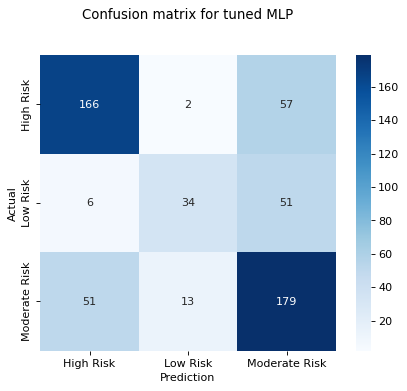

In [111]:
#Creating the confusion matrix for tuned MLP
y_pred_mlptuned = mlp_tuned.predict(X_test_scaled)

knn_matrix = metrics.confusion_matrix(y_test, y_pred_mlptuned)
plt.figure(dpi=80)
sns.heatmap(knn_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for tuned MLP', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

               precision    recall  f1-score   support

    High Risk       0.74      0.74      0.74       225
     Low Risk       0.69      0.37      0.49        91
Moderate Risk       0.62      0.74      0.68       243

     accuracy                           0.68       559
    macro avg       0.69      0.62      0.63       559
 weighted avg       0.68      0.68      0.67       559



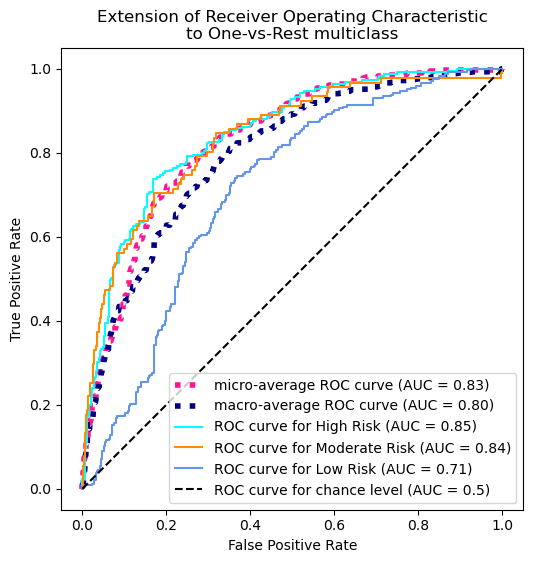

In [112]:
#Showing the MLP Scores
print(classification_report(y_test, y_pred_mlptuned))


y_score = mlp_tuned.predict_proba(X_test_scaled)


label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)


# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])


target_names = ['High Risk', 'Moderate Risk', 'Low Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()
